## For building datasets to put in GNN

### Load dataframe

In [1]:
import pandas as pd

DATA_PATH = "pre-processed/fixtures.csv"
data = pd.read_csv(DATA_PATH)

data.head()

,timestamp,team1,team1_shape,team1_positions_x,team1_positions_y,team1_player1_name,team1_player2_name,team1_player3_name,team1_player4_name,team1_player5_name,...,team2_player4_name,team2_player5_name,team2_player6_name,team2_player7_name,team2_player8_name,team2_player9_name,team2_player10_name,team2_player11_name,result,score
0,2020-09-12 19:30:00,FUL,4-2-3-1_L,"[-24, -19, -21, -21, -19, -15, -15, -11, -9, -...","[0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]",Marek Rodak,Joe Bryan,Tim Ream,Michael Hector,Denis Odoi,...,Rob Holding,Ainsley Maitland-Niles,Granit Xhaka,Mohamed Elneny,Héctor Bellerín,Pierre-Emerick Aubameyang,Alexandre Lacazette,Willian,0,0-3
1,2020-09-12 22:00:00,CRY,4-4-2_L,"[-24, -18, -20, -20, -18, -10, -12, -12, -10, ...","[0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]",Vicente Guaita,Tyrick Mitchell,Scott Dann,Cheikhou Kouyaté,Joel Ward,...,Jack Stephens,Kyle Walker-Peters,Nathan Redmond,Oriol Romeu,James Ward-Prowse,William Smallbone,Danny Ings,Ché Adams,2,1-0
2,2020-09-13 00:30:00,LIV,4-3-3-d_L,"[-24, -18, -20, -20, -18, -12, -14, -12, -6, -...","[0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]",Alisson,Andy Robertson,Virgil van Dijk,Joe Gomez,Trent Alexander-Arnold,...,Robin Koch,Luke Ayling,Kalvin Phillips,Jack Harrison,Mateusz Klich,Pablo Hernández,Hélder Costa,Patrick Bamford,2,4-3
3,2020-09-13 03:00:00,WHU,4-2-3-1_L,"[-24, -19, -21, -21, -19, -15, -15, -11, -9, -...","[0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]",Lukasz Fabianski,Aaron Cresswell,Angelo Ogbonna,Issa Diop,Ryan Fredericks,...,Jamaal Lascelles,Javier Manquillo,Allan Saint-Maximin,Isaac Hayden,Jonjo Shelvey,Jeff Hendrick,Andy Carroll,Callum Wilson,0,0-2
4,2020-09-13 21:00:00,WBA,5-4-1_L,"[-24, -18, -20, -20, -20, -18, -12, -12, -12, ...","[0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]",Sam Johnstone,Kieran Gibbs,Dara O'Shea,Kyle Bartley,Semi Ajayi,...,Wilfred Ndidi,Timothy Castagne,Nampalys Mendy,Harvey Barnes,Dennis Praet,Youri Tielemans,Ayoze Pérez,Jamie Vardy,0,0-3


### General Information About the Data

In [2]:
data.shape

(4264, 33)

In [3]:
data['result'].value_counts()

2    1760
0    1405
1    1099
Name: result, dtype: int64

### Download dependencies

In [4]:
import torch
import torch_geometric

print(torch.__version__)
print(torch.cuda.is_available())
print(torch.version.cuda)

1.11.0+cpu
False
None


In [5]:
%%capture
%pip install torch-scatter torch-sparse torch-cluster torch-spline-conv torch-geometric -f https://data.pyg.org/whl/torch-1.11.0+cpu.html

### Generate a Dataset

In [6]:
%%writefile processedDataset.py
from torch_geometric.data import Dataset, Data
import os, csv, torch
from tqdm import tqdm
import pandas as pd
import ast
import itertools
import numpy as np
from sklearn.preprocessing import StandardScaler


not_unique_names = []

class ProcessedDataset(Dataset):
    def __init__(self, root, filename, test=False, transform=None, pre_transform=None):
        """
        root = Where the dataset should be stored. This folder is split
        into raw_dir (downloaded dataset) and processed_dir (processed data). 
        """
        self.test = test
        self.filename = filename
        super(ProcessedDataset, self).__init__(root, transform, pre_transform)
        
    @property
    def raw_file_names(self):
        """ If this file exists in raw_dir, the download is not triggered.
            (The download func. is not implemented here)  
        """
        return self.filename

    @property
    def processed_file_names(self):
        """ If these files are found in raw_dir, processing is skipped"""
        self.data = pd.read_csv(self.raw_paths[0]).reset_index()

        if self.test:
            return [f'data_test_{i}.pt' for i in list(self.data.index)]
        else:
            return [f'data_{i}.pt' for i in list(self.data.index)]

    def download(self):
        pass

    def process(self):
        self.data = pd.read_csv(self.raw_paths[0])
        for index, match in tqdm(self.data.iterrows(), total=self.data.shape[0]):
            print("starts processing... this is the match")
            print(match)
            scaler = StandardScaler()
            try:
                # Get node features & normalize it
                node_feats = self._get_node_features(match)
                node_feats = scaler.fit_transform(pd.DataFrame(node_feats))
                # Get edge features(adjacent, front-back, opponent etc.)
                #edge_feats = self._get_edge_features([match['home_formation'], match['visiting_formation']])
                # Get adjacency info(whether or not there's an edge)
                edge_index = self._get_adjacency_info(match['team1_shape'], match['team2_shape'])
                # Get labels info
                label = self._get_labels(match['result'])

                # Create data object
                data = Data(x=node_feats, 
                            edge_index=edge_index,
                            #edge_attr=edge_feats,
                            y=label
                            #match=match
                            ) 
            except Exception as msg:
                print("ERROR HAPPENED: DATA", index, " ABANDONED, PLS CHECK ERROR MSG BELOW FOR MORE INFORMATION")
                print(msg)
            
            else:
                # Save datasets
                if self.test:
                    torch.save(data, 
                        os.path.join(self.processed_dir, 
                                     f'data_test_{index}.pt'))
                else:
                    torch.save(data, 
                        os.path.join(self.processed_dir, 
                                     f'data_{index}.pt'))
    def _get_most_recent_player_stat(self, name, date):
        """
        Returns the most recent player stat for a given player
        """
        # Get player stats
        DATA_PATH = "pre-processed/player_stats.csv"
        data_ = pd.read_csv(DATA_PATH)

        # Get player stats for a given player
        player_stats = data_[data_['name'] == name]
        
        # Check if that player is in player stats
        if player_stats.empty == True:
            print("############## ERROR: ", name, " is not in player stats, pls go fetch the datas ##############")
            raise SystemExit("Stop right there!")
            
        # Check if ID is unique
        elif player_stats['ID'].nunique() != 1:
            print(name, " is not unique, pls check which is right")

        # Get the most recent date
        filtered_df = player_stats.loc[(data_['stat_date'] <= date)]
        most_recent_date = filtered_df['stat_date'].max()
        if most_recent_date is np.nan:
            # Get the least recent player stat
            most_recent_date = player_stats['stat_date'].min()
            
            print("there's no most recent date for ", name, " in time ", date, "getting ", most_recent_date, " instead")
        else:
            print("the most recent date for ", name, " in time ", date, "is: ", most_recent_date)

        # Get the most recent player stat
        most_recent_player_stat = player_stats[player_stats['stat_date'] == most_recent_date]

        return most_recent_player_stat

    def _get_node_features(self, match):
        """ 
        This will return a matrix / 2d array of the shape
        [Number of Nodes, Node Feature size]

        # features:
        position: x, y
        general: height, weight, preferred_foot, age
        ball skills: ball_control, dribbling
        defense: marking, slide_tackle, stand_tackle
        mental: aggression, reactions, att_position, interceptions, vision, composure
        passing: crossing, short_pass, long_pass
        physical: acceleration, stamina, strength, balance, sprint_speed, agility, jumping
        shooting: heading, shot_power, finishing, long_shots, curve, fk_acc, penalties, volleys
        goalkeeper: gk_positioning, gk_diving, gk_handling, gk_kicking, gk_reflexes
        """
        # team2 assigned backwards bcs node index starts from the last player to the goalkeper
        total_player_names = list(match[['team1_player1_name', 'team1_player2_name', 'team1_player3_name', 'team1_player4_name', 'team1_player5_name', 'team1_player6_name', 'team1_player7_name', 'team1_player8_name', 'team1_player9_name', 'team1_player10_name', 'team1_player11_name', 
                                         'team2_player11_name', 'team2_player10_name', 'team2_player9_name', 'team2_player8_name', 'team2_player7_name', 'team2_player6_name', 'team2_player5_name', 'team2_player4_name', 'team2_player3_name', 'team2_player2_name', 'team2_player1_name']]
                                 )
        
        # match['team1_positions_x'] has the dtype str, ast.literal_eval converts it back to list
        total_player_x = ast.literal_eval(match['team1_positions_x']) + ast.literal_eval(match['team2_positions_x'])[::-1]
        total_player_y = ast.literal_eval(match['team1_positions_y']) + ast.literal_eval(match['team2_positions_y'])[::-1]
        
        all_node_feats = []

        for index, player in enumerate(total_player_names):
            # Get player stats
            try:
                player_stats = self._get_most_recent_player_stat(player, match['timestamp']).iloc[0]
                
            except Exception as msg:
                print("error happend when fetching player #######", player)
                print(msg)

            node_feats = []
            # Feature 1~2: x, y
            node_feats.append(total_player_x[index])
            node_feats.append(total_player_y[index])
            # Feature 3~6: height, weight, preferred_foot, age -> General
            node_feats.append(player_stats['height'])
            node_feats.append(player_stats['weight'])                
            if player_stats['preferred_foot'] == 'Right':
                node_feats.append(1)
            else:
                node_feats.append(0)           
            node_feats.append(player_stats['age'])
            # Feature 7~8: ball_control, dribbling -> Ball skills
            node_feats.append(player_stats['ball_control'])
            node_feats.append(player_stats['dribbling'])
            # Feature 9~11: marking, slide_tackle, stand_tackle -> Defense
            node_feats.append(player_stats['marking'])
            node_feats.append(player_stats['slide_tackle'])
            node_feats.append(player_stats['stand_tackle'])
            # Feature 12~17: aggression, reactions, att_position, interceptions, vision, composure -> Mental
            node_feats.append(player_stats['aggression'])
            node_feats.append(player_stats['reactions'])
            node_feats.append(player_stats['att_position'])
            node_feats.append(player_stats['interceptions'])
            node_feats.append(player_stats['vision'])
            node_feats.append(player_stats['composure'])
            # Feature 18~20: crossing, short_pass, long_pass -> Passing
            node_feats.append(player_stats['crossing'])
            node_feats.append(player_stats['short_pass'])
            node_feats.append(player_stats['long_pass'])
            # Feature 21~27: acceleration, stamina, strength, balance, sprint_speed, agility, jumping -> Physical
            node_feats.append(player_stats['acceleration'])
            node_feats.append(player_stats['stamina'])
            node_feats.append(player_stats['strength'])
            node_feats.append(player_stats['balance'])
            node_feats.append(player_stats['sprint_speed'])
            node_feats.append(player_stats['agility'])
            node_feats.append(player_stats['jumping'])
            # Feature 28~35: heading, shot_power, finishing, long_shots, curve, fk_acc, penalties, volleys -> Shooting
            node_feats.append(player_stats['heading'])
            node_feats.append(player_stats['shot_power'])
            node_feats.append(player_stats['finishing'])
            node_feats.append(player_stats['long_shots'])
            node_feats.append(player_stats['curve'])
            node_feats.append(player_stats['fk_acc'])
            node_feats.append(player_stats['penalties'])
            node_feats.append(player_stats['volleys'])
            # Feature 36~40: gk_positioning, gk_diving, gk_handling, gk_kicking, gk_reflexes -> Goalkeeper
            node_feats.append(player_stats['gk_positioning'])
            node_feats.append(player_stats['gk_diving'])
            node_feats.append(player_stats['gk_handling'])
            node_feats.append(player_stats['gk_kicking'])
            node_feats.append(player_stats['gk_reflexes'])

            # Append node features to matrix
            all_node_feats.append(node_feats)

        all_node_feats = np.asarray(all_node_feats)
        return torch.tensor(all_node_feats, dtype=torch.float)

#     def _get_edge_features(self, home_formation, visiting_formation):
#         """ 
#         This will return a matrix / 2d array of the shape
#         [Number of edges, Edge Feature size]

#         The edge features should be based on the relative position of each player
#         0: side-by-side
#         1: front-to-back
#         2: goalkeeper-to-defender
#         -1: between opponents

#         """

#         # Split the formations
#         home_formation_split = home_formation.split('-')
#         home_formation_len = len(home_formation_split)
#         visiting_formation_split = visiting_formation.split('-')
#         visiting_formation_len = len(visiting_formation_split)
#         total_formation = "1-" + home_formation + "-" + visiting_formation[::-1] + "-1"
#         total_formation_split = total_formation.split('-')
#         total_formation_len = len(total_formation_split)

#         all_edge_feats = []
#         # add goalkeeper-to-defender
#         for _ in range(int(total_formation_split[1])):
#             edge_feats = []
#             edge_feats.append(2)
#             all_edge_feats += [edge_feats, edge_feats]

#         # home
#         for i, s in enumerate(home_formation_split):
#             # add side-by-sde
#             for times in range(int(s)-1):
#                 edge_feats = []
#                 edge_feats.append(0)
#                 all_edge_feats += [edge_feats, edge_feats]
#             # add front-to-back
#             if i < home_formation_len-1:
#                 for times in range(int(home_formation_split[i]) * int(home_formation_split[i+1])):
#                     edge_feats = []
#                     edge_feats.append(1)
#                     all_edge_feats += [edge_feats, edge_feats]

#         # add between opponents
#         for times in range(int(home_formation_split[-1]) * int(visiting_formation_split[-1])):
#             edge_feats = []
#             edge_feats.append(-1)
#             all_edge_feats += [edge_feats, edge_feats]

#         # visiting
#         reversed = visiting_formation_split[::-1]
#         for i, s in enumerate(reversed):
#             # add side-by-sde
#             for times in range(int(s)-1):
#                 edge_feats = []
#                 edge_feats.append(0)
#                 all_edge_feats += [edge_feats, edge_feats]
#             # add front-to-back
#             if i < visiting_formation_len-1:
#                 for times in range(int(reversed[i]) * int(reversed[i+1])):
#                     edge_feats = []
#                     edge_feats.append(1)
#                     all_edge_feats += [edge_feats, edge_feats]
#         # add goalkeeper-to-defender
#         for _ in range(int(total_formation_split[-2])):
#             edge_feats = []
#             edge_feats.append(2)
#             all_edge_feats += [edge_feats, edge_feats]

#         all_edge_feats = np.asarray(all_edge_feats)
#         return torch.tensor(all_edge_feats, dtype=torch.float)

    def _get_adjacency_info(self, home_formation, visiting_formation):
        """
        The return should be in COO format.
        Make sure that the order of the indices
        matches the order of the edge features!
        """
        
        # Remove the _L or _R in formations
        home_formation = home_formation.replace('_L', '')
        visiting_formation = visiting_formation.replace('_R', '')
        
        # Split the formations
        home_formation_split = home_formation.split('-')
        visiting_formation_split = visiting_formation.split('-')
        
        # Drop alphabets in formation & split
        if home_formation_split[-1].isalpha():
            home_formation = home_formation[:-2]
            home_formation_split = home_formation_split[:-1]
        if visiting_formation_split[-1].isalpha():
            visiting_formation = visiting_formation[:-2]
            visiting_formation_split = visiting_formation_split[:-1]
        
        home_formation_len = len(home_formation_split)
        visiting_formation_len = len(visiting_formation_split)
        
        sum_formation = home_formation + "-" + visiting_formation[::-1]
        sum_formation_split = sum_formation.split('-')

        # Get the level lists( = the index of nodes for each graph)
        # i.e. for 4-2-3-1 vs 4-3-3 -> [[0], [1, 2, 3, 4], [5, 6], [7, 8, 9], [10], [11, 12, 13], [14, 15, 16], [17, 18, 19, 20], [21]]
        level_lists = [[0]]
        start = 1
        for index, s in enumerate(sum_formation_split):
            adding_list = list(range(start, start + int(s)))
            level_lists.append(adding_list)
            start += int(s)
        level_lists.append([start])
        
        edge_indices = []
        for i, _ in enumerate(level_lists[:-1]):
            # side-by-side
            for node in level_lists[i][:-1]:
                edge_indices += [[node, node+1], [node+1, node]]
            # front-to-back
            for r in itertools.product(level_lists[i], level_lists[i+1]): 
                edge_indices += [[r[0], r[1]], [r[1], r[0]]]

        edge_indices = torch.tensor(edge_indices)
        edge_indices = edge_indices.t().to(torch.long).view(2, -1)
        return edge_indices

    def _get_labels(self, label):
        label = np.asarray([label])
        return torch.tensor(label, dtype=torch.int64)

    def len(self):
        return self.data.shape[0]

    def get(self, idx):
        """ - Equivalent to __getitem__ in pytorch
            - Is not needed for PyG's InMemoryDataset
        """
        if self.test:
            data = torch.load(os.path.join(self.processed_dir, 
                                 f'data_test_{idx}.pt'))
        else:
            data = torch.load(os.path.join(self.processed_dir, 
                                 f'data_{idx}.pt'))   
        return data



Overwriting processedDataset.py


In [7]:
from processedDataset import ProcessedDataset

# the fixtures.csv is the one in data/raw
dataset = ProcessedDataset(root = "data/", filename = "fixtures.csv")

Processing...
  0%|          | 0/4264 [00:00<?, ?it/s]

starts processing... this is the match
timestamp                                            2020-09-12 19:30:00
team1                                                                FUL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Marek Rodak
team1_player2_name                                             Joe Bryan
team1_player3_name                                              Tim Ream
team1_player4_name                                        Michael Hector
team1_player5_name                                            Denis Odoi
team1_player6_name                                           Tom Cairney
team1_player7_name                                         Harrison Reed
team1_player8_name                                        Ivan Cavaleiro
team1_player

  0%|          | 1/4264 [00:45<54:00:54, 45.61s/it]

the most recent date for  Bernd Leno  in time  2020-09-12 19:30:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-12 22:00:00
team1                                                                CRY
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Vicente Guaita
team1_player2_name                                       Tyrick Mitchell
team1_player3_name                                            Scott Dann
team1_player4_name                                      Cheikhou Kouyaté
team1_player5_name                                             Joel Ward
team1_player6_name                                          Jeff Schlupp
team1_player7_name                                        James McCarthy
te

  0%|          | 2/4264 [01:31<54:08:50, 45.74s/it]

the most recent date for  Alex McCarthy  in time  2020-09-12 22:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-13 00:30:00
team1                                                                LIV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Alisson
team1_player2_name                                        Andy Robertson
team1_player3_name                                       Virgil van Dijk
team1_player4_name                                             Joe Gomez
team1_player5_name                                Trent Alexander-Arnold
team1_player6_name                                   Georginio Wijnaldum
team1_player7_name                                      Jordan Henderson

  0%|          | 3/4264 [02:09<49:49:06, 42.09s/it]

the most recent date for  Illan Meslier  in time  2020-09-13 00:30:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-13 03:00:00
team1                                                                WHU
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Fabianski
team1_player2_name                                       Aaron Cresswell
team1_player3_name                                        Angelo Ogbonna
team1_player4_name                                             Issa Diop
team1_player5_name                                       Ryan Fredericks
team1_player6_name                                           Declan Rice
team1_player7_name                                          Tomás Soucek

  0%|          | 4/4264 [02:47<48:00:47, 40.57s/it]

the most recent date for  Karl Darlow  in time  2020-09-13 03:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-13 21:00:00
team1                                                                WBA
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                         Sam Johnstone
team1_player2_name                                          Kieran Gibbs
team1_player3_name                                           Dara O'Shea
team1_player4_name                                          Kyle Bartley
team1_player5_name                                            Semi Ajayi
team1_player6_name                                       Darnell Furlong
team1_player7_name                                        Grady Diangana
t

  0%|          | 5/4264 [03:26<47:09:39, 39.86s/it]

the most recent date for  Kasper Schmeichel  in time  2020-09-13 21:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-13 23:30:00
team1                                                                TOT
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Hugo Lloris
team1_player2_name                                           Ben Davies1
team1_player3_name                                             Eric Dier
team1_player4_name                                     Toby Alderweireld
team1_player5_name                                          Matt Doherty
team1_player6_name                                           Harry Winks
team1_player7_name                                 Pierre-Emile Hojb

  0%|          | 6/4264 [04:03<46:17:32, 39.14s/it]

the most recent date for  Jordan Pickford  in time  2020-09-13 23:30:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-15 01:00:00
team1                                                                SHU
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                        Aaron Ramsdale
team1_player2_name                                        Jack O'Connell
team1_player3_name                                             John Egan
team1_player4_name                                          Chris Basham
team1_player5_name                                          Enda Stevens
team1_player6_name                                            John Fleck
team1_player7_name                                        Oliver Norwo

  0%|          | 7/4264 [04:40<45:22:03, 38.37s/it]

the most recent date for  Rui Patrício  in time  2020-09-15 01:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-15 03:15:00
team1                                                                BHA
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                              Mat Ryan
team1_player2_name                                          Adam Webster
team1_player3_name                                            Lewis Dunk
team1_player4_name                                             Ben White
team1_player5_name                                           Solly March
team1_player6_name                                         Steven Alzate
team1_player7_name                                         Yves Bissouma


  0%|          | 8/4264 [05:17<44:51:33, 37.94s/it]

the most recent date for  Kepa Arrizabalaga  in time  2020-09-15 03:15:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-19 19:30:00
team1                                                                EVE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Jordan Pickford
team1_player2_name                                           Lucas Digne
team1_player3_name                                         Michael Keane
team1_player4_name                                            Yerry Mina
team1_player5_name                                        Seamus Coleman
team1_player6_name                                           André Gomes
team1_player7_name                                                 A

  0%|          | 9/4264 [05:54<44:21:04, 37.52s/it]

the most recent date for  Sam Johnstone  in time  2020-09-19 19:30:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-19 22:00:00
team1                                                                LEE
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Illan Meslier
team1_player2_name                                         Stuart Dallas
team1_player3_name                                           Liam Cooper
team1_player4_name                                            Robin Koch
team1_player5_name                                           Luke Ayling
team1_player6_name                                       Kalvin Phillips
team1_player7_name                                         Jack Harrison

  0%|          | 10/4264 [06:30<44:01:38, 37.26s/it]

the most recent date for  Alphonse Areola  in time  2020-09-19 22:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-20 00:30:00
team1                                                                MAN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          David de Gea
team1_player2_name                                             Luke Shaw
team1_player3_name                                         Harry Maguire
team1_player4_name                                       Victor Lindelöf
team1_player5_name                                   Timothy Fosu-Mensah
team1_player6_name                                       Scott McTominay
team1_player7_name                                            Paul Pog

  0%|          | 11/4264 [07:08<44:04:03, 37.30s/it]

the most recent date for  Vicente Guaita  in time  2020-09-20 00:30:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-20 03:00:00
team1                                                                ARS
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                            Bernd Leno
team1_player2_name                                        Sead Kolasinac
team1_player3_name                                              Gabriel1
team1_player4_name                                           Rob Holding
team1_player5_name                                           Bukayo Saka
team1_player6_name                                          Granit Xhaka
team1_player7_name                                         Dani Ceballo

  0%|          | 12/4264 [07:45<44:02:29, 37.29s/it]

the most recent date for  Lukasz Fabianski  in time  2020-09-20 03:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-20 19:00:00
team1                                                                SOU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Alex McCarthy
team1_player2_name                                         Ryan Bertrand
team1_player3_name                                          Jan Bednarek
team1_player4_name                                         Jack Stephens
team1_player5_name                                    Kyle Walker-Peters
team1_player6_name                                        Moussa Djenepo
team1_player7_name                                           Oriol Ro

  0%|          | 13/4264 [08:22<43:52:12, 37.15s/it]

the most recent date for  Hugo Lloris  in time  2020-09-20 19:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-20 21:00:00
team1                                                                NEW
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Karl Darlow
team1_player2_name                                           Jamal Lewis
team1_player3_name                                    Federico Fernández
team1_player4_name                                      Jamaal Lascelles
team1_player5_name                                      Javier Manquillo
team1_player6_name                                   Allan Saint-Maximin
team1_player7_name                                          Isaac Hayden
t

  0%|          | 14/4264 [08:59<43:47:57, 37.10s/it]

the most recent date for  Mat Ryan  in time  2020-09-20 21:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-20 23:30:00
team1                                                                CHE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Kepa Arrizabalaga
team1_player2_name                                         Marcos Alonso
team1_player3_name                                            Kurt Zouma
team1_player4_name                                   Andreas Christensen
team1_player5_name                                           Reece James
team1_player6_name                                         Mateo Kovacic
team1_player7_name                                          N'Golo Kanté
team

  0%|          | 15/4264 [09:36<43:44:48, 37.06s/it]

the most recent date for  Alisson  in time  2020-09-20 23:30:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-21 02:00:00
team1                                                                LEI
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                     Kasper Schmeichel
team1_player2_name                                          James Justin
team1_player3_name                                        Caglar Söyüncü
team1_player4_name                                         Wilfred Ndidi
team1_player5_name                                      Timothy Castagne
team1_player6_name                                        Nampalys Mendy
team1_player7_name                                         Harvey Barnes
team1

  0%|          | 16/4264 [10:14<43:57:53, 37.26s/it]

the most recent date for  Nick Pope  in time  2020-09-21 02:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-22 01:00:00
team1                                                                AVL
team1_shape                                                    4-3-3-a_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -10, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Emiliano Martínez
team1_player2_name                                          Matt Targett
team1_player3_name                                          Tyrone Mings
team1_player4_name                                            Ezri Konsa
team1_player5_name                                          Matthew Cash
team1_player6_name                                          Douglas Luiz
team1_player7_name                                           John McGinn
tea

  0%|          | 17/4264 [10:50<43:44:06, 37.07s/it]

the most recent date for  Aaron Ramsdale  in time  2020-09-22 01:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-22 03:15:00
team1                                                                WOL
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                          Rui Patrício
team1_player2_name                                       Fernando Marçal
team1_player3_name                                          Romain Saïss
team1_player4_name                                           Conor Coady
team1_player5_name                                            Willy Boly
team1_player6_name                                         Adama Traoré2
team1_player7_name                                            Pedro Net

  0%|          | 18/4264 [11:27<43:42:46, 37.06s/it]

the most recent date for  Ederson  in time  2020-09-22 03:15:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-26 19:30:00
team1                                                                BHA
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                              Mat Ryan
team1_player2_name                                          Adam Webster
team1_player3_name                                            Lewis Dunk
team1_player4_name                                             Ben White
team1_player5_name                                           Solly March
team1_player6_name                                         Steven Alzate
team1_player7_name                                          Adam Lallana
team1

  0%|          | 19/4264 [12:05<43:48:34, 37.15s/it]

the most recent date for  David de Gea  in time  2020-09-26 19:30:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-26 22:00:00
team1                                                                CRY
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Vicente Guaita
team1_player2_name                                       Tyrick Mitchell
team1_player3_name                                         Mamadou Sakho
team1_player4_name                                      Cheikhou Kouyaté
team1_player5_name                                             Joel Ward
team1_player6_name                                          Eberechi Eze
team1_player7_name                                        James McArthur


  0%|          | 20/4264 [12:41<43:35:15, 36.97s/it]

the most recent date for  Jordan Pickford  in time  2020-09-26 22:00:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-27 00:30:00
team1                                                                WBA
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                         Sam Johnstone
team1_player2_name                                        Conor Townsend
team1_player3_name                                           Dara O'Shea
team1_player4_name                                          Kyle Bartley
team1_player5_name                                            Semi Ajayi
team1_player6_name                                       Darnell Furlong
team1_player7_name                                        Grady Dianga

  0%|          | 21/4264 [13:18<43:31:03, 36.92s/it]

the most recent date for  Wilfredo Caballero  in time  2020-09-27 00:30:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-27 03:00:00
team1                                                                BUR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Nick Pope
team1_player2_name                                        Charlie Taylor
team1_player3_name                                           Jimmy Dunne
team1_player4_name                                            Kevin Long
team1_player5_name                                         Phil Bardsley
team1_player6_name                                         Dwight McNeil
team1_player7_name                                         Dale Ste

  1%|          | 22/4264 [13:55<43:30:01, 36.92s/it]

the most recent date for  Alex McCarthy  in time  2020-09-27 03:00:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-27 19:00:00
team1                                                                SHU
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                        Aaron Ramsdale
team1_player2_name                                         Jack Robinson
team1_player3_name                                          Ethan Ampadu
team1_player4_name                                          Chris Basham
team1_player5_name                                          Enda Stevens
team1_player6_name                                            Ben Osborn
team1_player7_name                                          Sander Berge

  1%|          | 23/4264 [14:32<43:29:38, 36.92s/it]

the most recent date for  Illan Meslier  in time  2020-09-27 19:00:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-27 21:00:00
team1                                                                TOT
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Hugo Lloris
team1_player2_name                                           Ben Davies1
team1_player3_name                                             Eric Dier
team1_player4_name                                      Davinson Sánchez
team1_player5_name                                          Matt Doherty
team1_player6_name                                           Harry Winks
team1_player7_name                                 Pierre-Emile Hojbjerg

  1%|          | 24/4264 [15:10<43:56:34, 37.31s/it]

the most recent date for  Karl Darlow  in time  2020-09-27 21:00:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-27 23:30:00
team1                                                                MNC
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                               Ederson
team1_player2_name                                        Benjamin Mendy
team1_player3_name                                            Nathan Aké
team1_player4_name                                           Eric García
team1_player5_name                                           Kyle Walker
team1_player6_name                                                 Rodri
team1_player7_name                                           Fernandinho
t

  1%|          | 25/4264 [15:59<48:04:00, 40.82s/it]

the most recent date for  Kasper Schmeichel  in time  2020-09-27 23:30:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-28 02:00:00
team1                                                                WHU
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                      Lukasz Fabianski
team1_player2_name                                        Arthur Masuaku
team1_player3_name                                       Aaron Cresswell
team1_player4_name                                        Angelo Ogbonna
team1_player5_name                                       Fabián Balbuena
team1_player6_name                                       Ryan Fredericks
team1_player7_name                                         Pablo For

  1%|          | 26/4264 [16:51<52:07:25, 44.28s/it]

the most recent date for  Rui Patrício  in time  2020-09-28 02:00:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-29 00:45:00
team1                                                                FUL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                       Alphonse Areola
team1_player2_name                                              Tim Ream
team1_player3_name                                        Michael Hector
team1_player4_name                                            Denis Odoi
team1_player5_name                                             Joe Bryan
team1_player6_name                                           Tom Cairney
team1_player7_name                            André-Frank Zambo Anguissa


  1%|          | 27/4264 [17:43<54:43:12, 46.49s/it]

the most recent date for  Emiliano Martínez  in time  2020-09-29 00:45:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-29 03:00:00
team1                                                                LIV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Alisson
team1_player2_name                                        Andy Robertson
team1_player3_name                                       Virgil van Dijk
team1_player4_name                                             Joe Gomez
team1_player5_name                                Trent Alexander-Arnold
team1_player6_name                                   Georginio Wijnaldum
team1_player7_name                                               Fab

  1%|          | 28/4264 [18:42<59:10:44, 50.29s/it]

the most recent date for  Bernd Leno  in time  2020-09-29 03:00:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-10-03 19:30:00
team1                                                                CHE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Édouard Mendy
team1_player2_name                                          Ben Chilwell
team1_player3_name                                            Kurt Zouma
team1_player4_name                                          Thiago Silva
team1_player5_name                                     César Azpilicueta
team1_player6_name                                              Jorginho
team1_player7_name                                          N'Golo Kanté
te

  1%|          | 29/4264 [19:32<59:02:57, 50.20s/it]

the most recent date for  Vicente Guaita  in time  2020-10-03 19:30:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-03 22:00:00
team1                                                                EVE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Jordan Pickford
team1_player2_name                                           Lucas Digne
team1_player3_name                                         Michael Keane
team1_player4_name                                            Yerry Mina
team1_player5_name                                        Seamus Coleman
team1_player6_name                                      Gylfi Sigurdsson
team1_player7_name                                            Tom Davie

  1%|          | 30/4264 [20:19<57:54:59, 49.24s/it]

the most recent date for  Mat Ryan  in time  2020-10-03 22:00:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-04 00:30:00
team1                                                                LEE
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Illan Meslier
team1_player2_name                                         Stuart Dallas
team1_player3_name                                           Liam Cooper
team1_player4_name                                            Robin Koch
team1_player5_name                                           Luke Ayling
team1_player6_name                                       Kalvin Phillips
team1_player7_name                                        Ezgjan Alioski
team

  1%|          | 31/4264 [21:05<56:50:16, 48.34s/it]

the most recent date for  Ederson  in time  2020-10-04 00:30:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-04 03:00:00
team1                                                                NEW
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Karl Darlow
team1_player2_name                                           Jamal Lewis
team1_player3_name                                    Federico Fernández
team1_player4_name                                          Fabian Schär
team1_player5_name                                           Emil Krafth
team1_player6_name                                   Allan Saint-Maximin
team1_player7_name                                          Isaac Hayden
team1

  1%|          | 32/4264 [21:56<57:29:08, 48.90s/it]

the most recent date for  Nick Pope  in time  2020-10-04 03:00:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-04 19:00:00
team1                                                                LEI
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                     Kasper Schmeichel
team1_player2_name                                        Caglar Söyüncü
team1_player3_name                                           Jonny Evans
team1_player4_name                                        Daniel Amartey
team1_player5_name                                          James Justin
team1_player6_name                                        Nampalys Mendy
team1_player7_name                                       Youri Tielemans
tea

  1%|          | 33/4264 [22:44<57:27:59, 48.90s/it]

the most recent date for  Lukasz Fabianski  in time  2020-10-04 19:00:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-04 19:00:00
team1                                                                SOU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Alex McCarthy
team1_player2_name                                         Ryan Bertrand
team1_player3_name                                    Jannik Vestergaard
team1_player4_name                                          Jan Bednarek
team1_player5_name                                    Kyle Walker-Peters
team1_player6_name                                        Moussa Djenepo
team1_player7_name                                           Oriol Ro

  1%|          | 34/4264 [23:38<59:03:45, 50.27s/it]

the most recent date for  Sam Johnstone  in time  2020-10-04 19:00:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-04 21:00:00
team1                                                                ARS
team1_shape                                                    4-3-3-a_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -10, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Bernd Leno
team1_player2_name                                        Kieran Tierney
team1_player3_name                                              Gabriel1
team1_player4_name                                            David Luiz
team1_player5_name                                       Héctor Bellerín
team1_player6_name                                         Dani Ceballos
team1_player7_name                                           Bukayo Saka

  1%|          | 35/4264 [24:26<58:07:48, 49.48s/it]

the most recent date for  Aaron Ramsdale  in time  2020-10-04 21:00:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-04 21:00:00
team1                                                                WOL
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Rui Patrício
team1_player2_name                                            Max Kilman
team1_player3_name                                           Conor Coady
team1_player4_name                                            Willy Boly
team1_player5_name                                          Romain Saïss
team1_player6_name                                           Rúben Neves
team1_player7_name                                            Pedro Net

  1%|          | 36/4264 [25:13<57:21:46, 48.84s/it]

the most recent date for  Alphonse Areola  in time  2020-10-04 21:00:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-04 23:30:00
team1                                                                MAN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          David de Gea
team1_player2_name                                             Luke Shaw
team1_player3_name                                         Harry Maguire
team1_player4_name                                           Eric Bailly
team1_player5_name                                     Aaron Wan-Bissaka
team1_player6_name                                            Paul Pogba
team1_player7_name                                         Nemanja Mat

  1%|          | 37/4264 [25:56<55:26:29, 47.22s/it]

the most recent date for  Hugo Lloris  in time  2020-10-04 23:30:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-05 02:15:00
team1                                                                AVL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Emiliano Martínez
team1_player2_name                                          Matt Targett
team1_player3_name                                          Tyrone Mings
team1_player4_name                                            Ezri Konsa
team1_player5_name                                          Matthew Cash
team1_player6_name                                           John McGinn
team1_player7_name                                          Douglas Luiz
t

  1%|          | 38/4264 [26:40<54:18:14, 46.26s/it]

the most recent date for  Adrián2  in time  2020-10-05 02:15:00 is:  2020-10-05
starts processing... this is the match
timestamp                                            2020-10-17 19:30:00
team1                                                                EVE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Jordan Pickford
team1_player2_name                                           Lucas Digne
team1_player3_name                                         Michael Keane
team1_player4_name                                            Yerry Mina
team1_player5_name                                        Seamus Coleman
team1_player6_name                                           André Gomes
team1_player7_name                                                 Allan
team1

  1%|          | 39/4264 [27:23<53:10:18, 45.31s/it]

the most recent date for  Adrián2  in time  2020-10-17 19:30:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-17 22:00:00
team1                                                                CHE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Kepa Arrizabalaga
team1_player2_name                                          Ben Chilwell
team1_player3_name                                            Kurt Zouma
team1_player4_name                                   Andreas Christensen
team1_player5_name                                     César Azpilicueta
team1_player6_name                                              Jorginho
team1_player7_name                                          N'Golo Kanté
team1

  1%|          | 40/4264 [28:07<52:38:44, 44.87s/it]

the most recent date for  Alex McCarthy  in time  2020-10-17 22:00:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-18 00:30:00
team1                                                                MNC
team1_shape                                                    3-1-4-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -9, -9, -9, -9, -3, -3]
team1_positions_y                  [0, 8, 0, -8, 0, 9, 3, -3, -9, 3, -3]
team1_player1_name                                               Ederson
team1_player2_name                                            Nathan Aké
team1_player3_name                                            Rúben Dias
team1_player4_name                                           Kyle Walker
team1_player5_name                                                 Rodri
team1_player6_name                                            Phil Foden
team1_player7_name                                        Bernardo Silva

  1%|          | 41/4264 [28:51<52:10:42, 44.48s/it]

the most recent date for  Bernd Leno  in time  2020-10-18 00:30:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-18 03:00:00
team1                                                                NEW
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                           Karl Darlow
team1_player2_name                                           Jamal Lewis
team1_player3_name                                    Federico Fernández
team1_player4_name                                      Jamaal Lascelles
team1_player5_name                                           Emil Krafth
team1_player6_name                                          Isaac Hayden
team1_player7_name                                   Allan Saint-Maximin
te

  1%|          | 42/4264 [29:34<51:46:43, 44.15s/it]

the most recent date for  David de Gea  in time  2020-10-18 03:00:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-18 19:00:00
team1                                                                SHU
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                        Aaron Ramsdale
team1_player2_name                                          Enda Stevens
team1_player3_name                                             John Egan
team1_player4_name                                          Chris Basham
team1_player5_name                                              Max Lowe
team1_player6_name                                        John Lundstram
team1_player7_name                                        Oliver Norwood


  1%|          | 43/4264 [30:20<52:13:27, 44.54s/it]

the most recent date for  Alphonse Areola  in time  2020-10-18 19:00:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-18 21:00:00
team1                                                                CRY
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Vicente Guaita
team1_player2_name                                       Tyrick Mitchell
team1_player3_name                                           Gary Cahill
team1_player4_name                                      Cheikhou Kouyaté
team1_player5_name                                             Joel Ward
team1_player6_name                                          Jeff Schlupp
team1_player7_name                                        James McArth

  1%|          | 44/4264 [31:03<51:52:13, 44.25s/it]

the most recent date for  Mat Ryan  in time  2020-10-18 21:00:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-18 23:30:00
team1                                                                TOT
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Hugo Lloris
team1_player2_name                                       Sergio Reguilón
team1_player3_name                                      Davinson Sánchez
team1_player4_name                                     Toby Alderweireld
team1_player5_name                                          Serge Aurier
team1_player6_name                                 Pierre-Emile Hojbjerg
team1_player7_name                                        Moussa Sissoko
team

  1%|          | 45/4264 [31:50<52:34:30, 44.86s/it]

the most recent date for  Lukasz Fabianski  in time  2020-10-18 23:30:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-19 02:15:00
team1                                                                LEI
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                     Kasper Schmeichel
team1_player2_name                                          James Justin
team1_player3_name                                           Jonny Evans
team1_player4_name                                         Wesley Fofana
team1_player5_name                                      Timothy Castagne
team1_player6_name                                        Nampalys Mendy
team1_player7_name                                         Harvey Bar

  1%|          | 46/4264 [32:33<52:10:18, 44.53s/it]

the most recent date for  Emiliano Martínez  in time  2020-10-19 02:15:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-20 00:30:00
team1                                                                WBA
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Sam Johnstone
team1_player2_name                                        Conor Townsend
team1_player3_name                                          Ahmed Hegazi
team1_player4_name                                    Branislav Ivanovic
team1_player5_name                                       Darnell Furlong
team1_player6_name                                        Jake Livermore
team1_player7_name                                        Grady Dian

  1%|          | 47/4264 [33:18<52:16:24, 44.63s/it]

the most recent date for  Nick Pope  in time  2020-10-20 00:30:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-20 03:00:00
team1                                                                LEE
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Illan Meslier
team1_player2_name                                         Stuart Dallas
team1_player3_name                                        Pascal Struijk
team1_player4_name                                            Robin Koch
team1_player5_name                                           Luke Ayling
team1_player6_name                                       Kalvin Phillips
team1_player7_name                                         Jack Harrison
tea

  1%|          | 48/4264 [34:13<55:42:41, 47.57s/it]

the most recent date for  Rui Patrício  in time  2020-10-20 03:00:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-24 03:00:00
team1                                                                AVL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Emiliano Martínez
team1_player2_name                                          Matt Targett
team1_player3_name                                          Tyrone Mings
team1_player4_name                                            Ezri Konsa
team1_player5_name                                          Matthew Cash
team1_player6_name                                          Douglas Luiz
team1_player7_name                                           John McGinn


  1%|          | 49/4264 [35:05<57:13:56, 48.88s/it]

the most recent date for  Illan Meslier  in time  2020-10-24 03:00:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-24 19:30:00
team1                                                                WHU
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                      Lukasz Fabianski
team1_player2_name                                        Arthur Masuaku
team1_player3_name                                       Aaron Cresswell
team1_player4_name                                        Angelo Ogbonna
team1_player5_name                                       Fabián Balbuena
team1_player6_name                                       Vladimír Coufal
team1_player7_name                                         Pablo Fornals

  1%|          | 50/4264 [35:52<56:33:33, 48.32s/it]

the most recent date for  Ederson  in time  2020-10-24 19:30:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-24 22:00:00
team1                                                                FUL
team1_shape                                                    4-3-2-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -15, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 0, -9, 3, -3, 0]
team1_player1_name                                       Alphonse Areola
team1_player2_name                                      Antonee Robinson
team1_player3_name                                              Tim Ream
team1_player4_name                                      Tosin Adarabioyo
team1_player5_name                                              Ola Aina
team1_player6_name                            André-Frank Zambo Anguissa
team1_player7_name                                          Mario Lemina
team1

  1%|          | 51/4264 [36:36<55:19:36, 47.28s/it]

the most recent date for  Vicente Guaita  in time  2020-10-24 22:00:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-25 00:30:00
team1                                                                MAN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          David de Gea
team1_player2_name                                             Luke Shaw
team1_player3_name                                         Harry Maguire
team1_player4_name                                       Victor Lindelöf
team1_player5_name                                     Aaron Wan-Bissaka
team1_player6_name                                                  Fred
team1_player7_name                                       Scott McTomina

  1%|          | 52/4264 [37:20<53:51:38, 46.03s/it]

the most recent date for  Édouard Mendy  in time  2020-10-25 00:30:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-25 03:00:00
team1                                                                LIV
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                               Alisson
team1_player2_name                                        Andy Robertson
team1_player3_name                                       Virgil van Dijk
team1_player4_name                                               Fabinho
team1_player5_name                                Trent Alexander-Arnold
team1_player6_name                                   Georginio Wijnaldum
team1_player7_name                                      Jordan Henderson

  1%|          | 53/4264 [38:13<56:17:49, 48.13s/it]

the most recent date for  Aaron Ramsdale  in time  2020-10-25 03:00:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-25 22:00:00
team1                                                                SOU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Alex McCarthy
team1_player2_name                                         Ryan Bertrand
team1_player3_name                                    Jannik Vestergaard
team1_player4_name                                          Jan Bednarek
team1_player5_name                                    Kyle Walker-Peters
team1_player6_name                                        Nathan Redmond
team1_player7_name                                           Oriol Rome

  1%|▏         | 54/4264 [39:11<59:46:41, 51.12s/it]

the most recent date for  Jordan Pickford  in time  2020-10-25 22:00:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-26 00:30:00
team1                                                                WOL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                          Rui Patrício
team1_player2_name                                            Max Kilman
team1_player3_name                                           Conor Coady
team1_player4_name                                            Willy Boly
team1_player5_name                                          Romain Saïss
team1_player6_name                                           Rúben Neves
team1_player7_name                                    Leander Dendonck

  1%|▏         | 55/4264 [40:11<63:01:20, 53.90s/it]

the most recent date for  Karl Darlow  in time  2020-10-26 00:30:00 is:  2020-10-26
starts processing... this is the match
timestamp                                            2020-10-26 03:15:00
team1                                                                ARS
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                            Bernd Leno
team1_player2_name                                          Granit Xhaka
team1_player3_name                                              Gabriel1
team1_player4_name                                            David Luiz
team1_player5_name                                        Kieran Tierney
team1_player6_name                                         Dani Ceballos
team1_player7_name                                         Thomas Partey
t

  1%|▏         | 56/4264 [41:03<62:16:09, 53.27s/it]

the most recent date for  Kasper Schmeichel  in time  2020-10-26 03:15:00 is:  2020-10-26
starts processing... this is the match
timestamp                                            2020-10-27 01:30:00
team1                                                                BHA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                              Mat Ryan
team1_player2_name                                              Dan Burn
team1_player3_name                                          Joël Veltman
team1_player4_name                                          Adam Webster
team1_player5_name                                           Solly March
team1_player6_name                                         Yves Bissouma
team1_player7_name                                             Ben W

  1%|▏         | 57/4264 [41:55<61:44:09, 52.83s/it]

the most recent date for  Sam Johnstone  in time  2020-10-27 01:30:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-10-27 04:00:00
team1                                                                BUR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Nick Pope
team1_player2_name                                        Charlie Taylor
team1_player3_name                                       James Tarkowski
team1_player4_name                                            Kevin Long
team1_player5_name                                        Matthew Lowton
team1_player6_name                                         Dwight McNeil
team1_player7_name                                        Josh Brownhill

  1%|▏         | 58/4264 [42:52<63:09:38, 54.06s/it]

the most recent date for  Hugo Lloris  in time  2020-10-27 04:00:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-10-31 04:00:00
team1                                                                WOL
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                          Rui Patrício
team1_player2_name                                            Max Kilman
team1_player3_name                                           Conor Coady
team1_player4_name                                            Willy Boly
team1_player5_name                                       Rayan Aït-Nouri
team1_player6_name                                           Rúben Neves
team1_player7_name                                    Leander Dendoncker
t

  1%|▏         | 59/4264 [43:44<62:36:13, 53.60s/it]

the most recent date for  Vicente Guaita  in time  2020-10-31 04:00:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-10-31 20:30:00
team1                                                                SHU
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                        Aaron Ramsdale
team1_player2_name                                              Max Lowe
team1_player3_name                                          Enda Stevens
team1_player4_name                                             John Egan
team1_player5_name                                          Chris Basham
team1_player6_name                                        George Baldock
team1_player7_name                                            Ben Osbor

  1%|▏         | 60/4264 [44:38<62:42:46, 53.70s/it]

the most recent date for  Ederson  in time  2020-10-31 20:30:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-10-31 23:00:00
team1                                                                BUR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Nick Pope
team1_player2_name                                        Charlie Taylor
team1_player3_name                                       James Tarkowski
team1_player4_name                                            Kevin Long
team1_player5_name                                        Matthew Lowton
team1_player6_name                                         Dwight McNeil
team1_player7_name                                         Dale Stephens
team1

  1%|▏         | 61/4264 [45:27<61:11:01, 52.41s/it]

the most recent date for  Édouard Mendy  in time  2020-10-31 23:00:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-11-01 01:30:00
team1                                                                LIV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Alisson
team1_player2_name                                        Andy Robertson
team1_player3_name                                             Joe Gomez
team1_player4_name                                    Nathaniel Phillips
team1_player5_name                                Trent Alexander-Arnold
team1_player6_name                                   Georginio Wijnaldum
team1_player7_name                                      Jordan Henderson

  1%|▏         | 62/4264 [46:17<60:16:14, 51.64s/it]

the most recent date for  Lukasz Fabianski  in time  2020-11-01 01:30:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-11-01 20:00:00
team1                                                                AVL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Emiliano Martínez
team1_player2_name                                          Matt Targett
team1_player3_name                                          Tyrone Mings
team1_player4_name                                            Ezri Konsa
team1_player5_name                                          Matthew Cash
team1_player6_name                                          Douglas Luiz
team1_player7_name                                           John McG

  1%|▏         | 63/4264 [47:07<59:43:27, 51.18s/it]

the most recent date for  Alex McCarthy  in time  2020-11-01 20:00:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-11-01 22:00:00
team1                                                                NEW
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                           Karl Darlow
team1_player2_name                                           Jamal Lewis
team1_player3_name                                    Federico Fernández
team1_player4_name                                      Jamaal Lascelles
team1_player5_name                                          Fabian Schär
team1_player6_name                                          Jacob Murphy
team1_player7_name                                        Miguel Almirón

  2%|▏         | 64/4264 [47:59<59:44:22, 51.21s/it]

the most recent date for  Jordan Pickford  in time  2020-11-01 22:00:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-11-02 00:30:00
team1                                                                MAN
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                          David de Gea
team1_player2_name                                             Luke Shaw
team1_player3_name                                         Harry Maguire
team1_player4_name                                       Victor Lindelöf
team1_player5_name                                     Aaron Wan-Bissaka
team1_player6_name                                                  Fred
team1_player7_name                                            Paul Pog

  2%|▏         | 65/4264 [48:50<59:50:17, 51.30s/it]

the most recent date for  Bernd Leno  in time  2020-11-02 00:30:00 is:  2020-11-02
starts processing... this is the match
timestamp                                            2020-11-02 03:15:00
team1                                                                TOT
team1_shape                                                    4-3-2-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -15, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 0, -9, 3, -3, 0]
team1_player1_name                                           Hugo Lloris
team1_player2_name                                       Sergio Reguilón
team1_player3_name                                             Eric Dier
team1_player4_name                                     Toby Alderweireld
team1_player5_name                                          Matt Doherty
team1_player6_name                                 Pierre-Emile Hojbjerg
team1_player7_name                                        Moussa Sissoko
te

  2%|▏         | 66/4264 [49:38<58:26:07, 50.11s/it]

the most recent date for  Robert Sánchez  in time  2020-11-02 03:15:00 is:  2020-11-02
starts processing... this is the match
timestamp                                            2020-11-03 01:30:00
team1                                                                FUL
team1_shape                                                    4-3-2-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -15, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 0, -9, 3, -3, 0]
team1_player1_name                                       Alphonse Areola
team1_player2_name                                      Antonee Robinson
team1_player3_name                                              Tim Ream
team1_player4_name                                      Tosin Adarabioyo
team1_player5_name                                              Ola Aina
team1_player6_name                            André-Frank Zambo Anguissa
team1_player7_name                                          Mario Lemin

  2%|▏         | 67/4264 [50:21<56:01:07, 48.05s/it]

the most recent date for  Sam Johnstone  in time  2020-11-03 01:30:00 is:  2020-11-02
starts processing... this is the match
timestamp                                            2020-11-03 04:00:00
team1                                                                LEE
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Illan Meslier
team1_player2_name                                         Stuart Dallas
team1_player3_name                                        Pascal Struijk
team1_player4_name                                            Robin Koch
team1_player5_name                                           Luke Ayling
team1_player6_name                                       Kalvin Phillips
team1_player7_name                                         Jack Harrison

  2%|▏         | 68/4264 [51:04<54:24:42, 46.68s/it]

the most recent date for  Kasper Schmeichel  in time  2020-11-03 04:00:00 is:  2020-11-02
starts processing... this is the match
timestamp                                            2020-11-07 01:30:00
team1                                                                BHA
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                              Mat Ryan
team1_player2_name                                          Adam Webster
team1_player3_name                                            Lewis Dunk
team1_player4_name                                             Ben White
team1_player5_name                                           Solly March
team1_player6_name                                         Steven Alzate
team1_player7_name                                         Yves Biss

  2%|▏         | 69/4264 [51:44<51:57:17, 44.59s/it]

the most recent date for  Nick Pope  in time  2020-11-07 01:30:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-07 04:00:00
team1                                                                SOU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Alex McCarthy
team1_player2_name                                         Ryan Bertrand
team1_player3_name                                    Jannik Vestergaard
team1_player4_name                                          Jan Bednarek
team1_player5_name                                    Kyle Walker-Peters
team1_player6_name                                        Nathan Redmond
team1_player7_name                                           Oriol Romeu
tea

  2%|▏         | 70/4264 [52:23<49:54:55, 42.85s/it]

the most recent date for  Karl Darlow  in time  2020-11-07 04:00:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-07 20:30:00
team1                                                                EVE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Jordan Pickford
team1_player2_name                                           Lucas Digne
team1_player3_name                                         Michael Keane
team1_player4_name                                            Yerry Mina
team1_player5_name                                        Seamus Coleman
team1_player6_name                                           André Gomes
team1_player7_name                                                 Allan
t

  2%|▏         | 71/4264 [53:02<48:31:12, 41.66s/it]

the most recent date for  David de Gea  in time  2020-11-07 20:30:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-07 23:00:00
team1                                                                CRY
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Vicente Guaita
team1_player2_name                                       Tyrick Mitchell
team1_player3_name                                         Mamadou Sakho
team1_player4_name                                      Cheikhou Kouyaté
team1_player5_name                                             Joel Ward
team1_player6_name                                          Eberechi Eze
team1_player7_name                                        James McArthur


  2%|▏         | 72/4264 [53:40<47:26:08, 40.74s/it]

the most recent date for  Illan Meslier  in time  2020-11-07 23:00:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-08 01:30:00
team1                                                                CHE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Édouard Mendy
team1_player2_name                                          Ben Chilwell
team1_player3_name                                          Thiago Silva
team1_player4_name                                            Kurt Zouma
team1_player5_name                                           Reece James
team1_player6_name                                           Mason Mount
team1_player7_name                                          N'Golo Kanté

  2%|▏         | 73/4264 [54:19<46:46:11, 40.17s/it]

the most recent date for  Aaron Ramsdale  in time  2020-11-08 01:30:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-08 04:00:00
team1                                                                WHU
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                      Lukasz Fabianski
team1_player2_name                                        Arthur Masuaku
team1_player3_name                                       Aaron Cresswell
team1_player4_name                                        Angelo Ogbonna
team1_player5_name                                       Fabián Balbuena
team1_player6_name                                       Vladimír Coufal
team1_player7_name                                         Pablo Fornal

  2%|▏         | 74/4264 [54:58<46:22:08, 39.84s/it]

the most recent date for  Alphonse Areola  in time  2020-11-08 04:00:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-08 20:00:00
team1                                                                WBA
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                         Sam Johnstone
team1_player2_name                                          Kieran Gibbs
team1_player3_name                                           Dara O'Shea
team1_player4_name                                          Kyle Bartley
team1_player5_name                                            Semi Ajayi
team1_player6_name                                       Darnell Furlong
team1_player7_name                                        Grady Dianga

  2%|▏         | 75/4264 [55:37<45:58:09, 39.51s/it]

the most recent date for  Hugo Lloris  in time  2020-11-08 20:00:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-08 22:00:00
team1                                                                LEI
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                     Kasper Schmeichel
team1_player2_name                                        Caglar Söyüncü
team1_player3_name                                           Jonny Evans
team1_player4_name                                        Daniel Amartey
team1_player5_name                                          James Justin
team1_player6_name                                        Nampalys Mendy
team1_player7_name                                       Youri Tielemans
t

  2%|▏         | 76/4264 [56:16<45:40:59, 39.27s/it]

the most recent date for  Rui Patrício  in time  2020-11-08 22:00:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-09 00:30:00
team1                                                                MNC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Ederson
team1_player2_name                                          João Cancelo
team1_player3_name                                       Aymeric Laporte
team1_player4_name                                            Rúben Dias
team1_player5_name                                           Kyle Walker
team1_player6_name                                        Bernardo Silva
team1_player7_name                                                 Rodri


  2%|▏         | 77/4264 [56:55<45:44:07, 39.32s/it]

the most recent date for  Alisson  in time  2020-11-09 00:30:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-09 03:15:00
team1                                                                ARS
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                            Bernd Leno
team1_player2_name                                        Kieran Tierney
team1_player3_name                                              Gabriel1
team1_player4_name                                           Rob Holding
team1_player5_name                                           Bukayo Saka
team1_player6_name                                        Mohamed Elneny
team1_player7_name                                         Thomas Partey
team1

  2%|▏         | 78/4264 [57:36<46:09:06, 39.69s/it]

the most recent date for  Emiliano Martínez  in time  2020-11-09 03:15:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-21 20:30:00
team1                                                                NEW
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                           Karl Darlow
team1_player2_name                                           Jamal Lewis
team1_player3_name                                    Federico Fernández
team1_player4_name                                      Jamaal Lascelles
team1_player5_name                                          Fabian Schär
team1_player6_name                                          Jacob Murphy
team1_player7_name                                        Miguel Alm

  2%|▏         | 79/4264 [58:15<45:54:11, 39.49s/it]

the most recent date for  Édouard Mendy  in time  2020-11-21 20:30:00 is:  2020-11-19
starts processing... this is the match
timestamp                                            2020-11-21 23:00:00
team1                                                                AVL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Emiliano Martínez
team1_player2_name                                          Matt Targett
team1_player3_name                                          Tyrone Mings
team1_player4_name                                            Ezri Konsa
team1_player5_name                                          Matthew Cash
team1_player6_name                                          Douglas Luiz
team1_player7_name                                           John McGinn

  2%|▏         | 80/4264 [58:54<45:57:09, 39.54s/it]

the most recent date for  Robert Sánchez  in time  2020-11-21 23:00:00 is:  2020-11-19
starts processing... this is the match
timestamp                                            2020-11-22 01:30:00
team1                                                                TOT
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Hugo Lloris
team1_player2_name                                       Sergio Reguilón
team1_player3_name                                      Davinson Sánchez
team1_player4_name                                     Toby Alderweireld
team1_player5_name                                          Serge Aurier
team1_player6_name                                 Pierre-Emile Hojbjerg
team1_player7_name                                        Moussa Sissok

  2%|▏         | 81/4264 [59:33<45:42:16, 39.33s/it]

the most recent date for  Ederson  in time  2020-11-22 01:30:00 is:  2020-11-19
starts processing... this is the match
timestamp                                            2020-11-22 04:00:00
team1                                                                MAN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          David de Gea
team1_player2_name                                             Luke Shaw
team1_player3_name                                         Harry Maguire
team1_player4_name                                       Victor Lindelöf
team1_player5_name                                     Aaron Wan-Bissaka
team1_player6_name                                                  Fred
team1_player7_name                                       Scott McTominay
team1

  2%|▏         | 82/4264 [1:00:12<45:34:58, 39.24s/it]

the most recent date for  Sam Johnstone  in time  2020-11-22 04:00:00 is:  2020-11-19
starts processing... this is the match
timestamp                                            2020-11-22 20:00:00
team1                                                                FUL
team1_shape                                                    4-3-2-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -15, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 0, -9, 3, -3, 0]
team1_player1_name                                       Alphonse Areola
team1_player2_name                                      Antonee Robinson
team1_player3_name                                              Tim Ream
team1_player4_name                                      Tosin Adarabioyo
team1_player5_name                                              Ola Aina
team1_player6_name                            André-Frank Zambo Anguissa
team1_player7_name                                          Mario Lemina

  2%|▏         | 83/4264 [1:00:51<45:24:03, 39.09s/it]

the most recent date for  Jordan Pickford  in time  2020-11-22 20:00:00 is:  2020-11-19
starts processing... this is the match
timestamp                                            2020-11-22 22:00:00
team1                                                                SHU
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                        Aaron Ramsdale
team1_player2_name                                              Max Lowe
team1_player3_name                                          Enda Stevens
team1_player4_name                                             John Egan
team1_player5_name                                          Chris Basham
team1_player6_name                                        George Baldock
team1_player7_name                                            Ben Osbo

  2%|▏         | 84/4264 [1:01:30<45:16:38, 38.99s/it]

the most recent date for  Lukasz Fabianski  in time  2020-11-22 22:00:00 is:  2020-11-19
starts processing... this is the match
timestamp                                            2020-11-23 00:30:00
team1                                                                LEE
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Illan Meslier
team1_player2_name                                         Stuart Dallas
team1_player3_name                                        Pascal Struijk
team1_player4_name                                            Robin Koch
team1_player5_name                                           Luke Ayling
team1_player6_name                                       Kalvin Phillips
team1_player7_name                                         Jack Harri

  2%|▏         | 85/4264 [1:02:09<45:15:56, 38.99s/it]

the most recent date for  Bernd Leno  in time  2020-11-23 00:30:00 is:  2020-11-23
starts processing... this is the match
timestamp                                            2020-11-23 03:15:00
team1                                                                LIV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Alisson
team1_player2_name                                        Andy Robertson
team1_player3_name                                       Virgil van Dijk
team1_player4_name                                            Joël Matip
team1_player5_name                                Trent Alexander-Arnold
team1_player6_name                                      Thiago Alcántara
team1_player7_name                                               Fabinho
te

  2%|▏         | 86/4264 [1:02:47<45:09:24, 38.91s/it]

the most recent date for  Kasper Schmeichel  in time  2020-11-23 03:15:00 is:  2020-11-23
starts processing... this is the match
timestamp                                            2020-11-24 01:30:00
team1                                                                BUR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Nick Pope
team1_player2_name                                        Charlie Taylor
team1_player3_name                                       James Tarkowski
team1_player4_name                                            Kevin Long
team1_player5_name                                        Matthew Lowton
team1_player6_name                                         Dwight McNeil
team1_player7_name                                         Dale Step

  2%|▏         | 87/4264 [1:03:26<45:04:37, 38.85s/it]

the most recent date for  Vicente Guaita  in time  2020-11-24 01:30:00 is:  2020-11-23
starts processing... this is the match
timestamp                                            2020-11-24 04:00:00
team1                                                                WOL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                          Rui Patrício
team1_player2_name                                            Max Kilman
team1_player3_name                                           Conor Coady
team1_player4_name                                            Willy Boly
team1_player5_name                                          Romain Saïss
team1_player6_name                                           Rúben Neves
team1_player7_name                                    Leander Dendoncke

  2%|▏         | 88/4264 [1:04:05<44:56:11, 38.74s/it]

the most recent date for  Alex McCarthy  in time  2020-11-24 04:00:00 is:  2020-11-23
starts processing... this is the match
timestamp                                            2020-11-28 04:00:00
team1                                                                CRY
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Vicente Guaita
team1_player2_name                                       Tyrick Mitchell
team1_player3_name                                         Mamadou Sakho
team1_player4_name                                      Cheikhou Kouyaté
team1_player5_name                                             Joel Ward
team1_player6_name                                          Eberechi Eze
team1_player7_name                                        James McArthur

  2%|▏         | 89/4264 [1:04:45<45:24:58, 39.16s/it]

the most recent date for  Karl Darlow  in time  2020-11-28 04:00:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-28 20:30:00
team1                                                                BHA
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                              Mat Ryan
team1_player2_name                                          Adam Webster
team1_player3_name                                            Lewis Dunk
team1_player4_name                                             Ben White
team1_player5_name                                           Solly March
team1_player6_name                                         Steven Alzate
team1_player7_name                                         Yves Bissouma
t

  2%|▏         | 90/4264 [1:05:23<45:12:34, 38.99s/it]

the most recent date for  Adrián2  in time  2020-11-28 20:30:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-28 23:00:00
team1                                                                MNC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Ederson
team1_player2_name                                          João Cancelo
team1_player3_name                                       Aymeric Laporte
team1_player4_name                                            Rúben Dias
team1_player5_name                                           Kyle Walker
team1_player6_name                                        Bernardo Silva
team1_player7_name                                                 Rodri
team1

  2%|▏         | 91/4264 [1:06:01<44:41:25, 38.55s/it]

the most recent date for  Nick Pope  in time  2020-11-28 23:00:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-29 01:30:00
team1                                                                EVE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Jordan Pickford
team1_player2_name                                           Lucas Digne
team1_player3_name                                         Michael Keane
team1_player4_name                                            Yerry Mina
team1_player5_name                                        Seamus Coleman
team1_player6_name                                           André Gomes
team1_player7_name                                                 Allan
tea

  2%|▏         | 92/4264 [1:06:38<44:08:13, 38.09s/it]

the most recent date for  Illan Meslier  in time  2020-11-29 01:30:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-29 04:00:00
team1                                                                WBA
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                         Sam Johnstone
team1_player2_name                                          Kieran Gibbs
team1_player3_name                                           Dara O'Shea
team1_player4_name                                          Kyle Bartley
team1_player5_name                                            Semi Ajayi
team1_player6_name                                       Darnell Furlong
team1_player7_name                                        Grady Diangana

  2%|▏         | 93/4264 [1:07:15<43:41:28, 37.71s/it]

the most recent date for  Aaron Ramsdale  in time  2020-11-29 04:00:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-29 22:00:00
team1                                                                SOU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Alex McCarthy
team1_player2_name                                         Ryan Bertrand
team1_player3_name                                    Jannik Vestergaard
team1_player4_name                                          Jan Bednarek
team1_player5_name                                    Kyle Walker-Peters
team1_player6_name                                        Nathan Redmond
team1_player7_name                                           Oriol Rome

  2%|▏         | 94/4264 [1:07:51<43:20:19, 37.41s/it]

the most recent date for  David de Gea  in time  2020-11-29 22:00:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-30 00:30:00
team1                                                                CHE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Édouard Mendy
team1_player2_name                                          Ben Chilwell
team1_player3_name                                          Thiago Silva
team1_player4_name                                            Kurt Zouma
team1_player5_name                                           Reece James
team1_player6_name                                           Mason Mount
team1_player7_name                                          N'Golo Kanté


  2%|▏         | 95/4264 [1:08:28<43:05:38, 37.21s/it]

the most recent date for  Hugo Lloris  in time  2020-11-30 00:30:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-30 03:15:00
team1                                                                ARS
team1_shape                                                    4-3-3-a_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -10, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Bernd Leno
team1_player2_name                                        Kieran Tierney
team1_player3_name                                              Gabriel1
team1_player4_name                                            David Luiz
team1_player5_name                                       Héctor Bellerín
team1_player6_name                                         Dani Ceballos
team1_player7_name                                           Bukayo Saka
t

  2%|▏         | 96/4264 [1:09:05<42:56:13, 37.09s/it]

the most recent date for  Rui Patrício  in time  2020-11-30 03:15:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-12-01 01:30:00
team1                                                                LEI
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                     Kasper Schmeichel
team1_player2_name                                        Caglar Söyüncü
team1_player3_name                                           Jonny Evans
team1_player4_name                                        Daniel Amartey
team1_player5_name                                          James Justin
team1_player6_name                                        Nampalys Mendy
team1_player7_name                                       Youri Tielemans


  2%|▏         | 97/4264 [1:09:42<42:48:13, 36.98s/it]

the most recent date for  Alphonse Areola  in time  2020-12-01 01:30:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-12-01 04:00:00
team1                                                                WHU
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                      Lukasz Fabianski
team1_player2_name                                        Arthur Masuaku
team1_player3_name                                       Aaron Cresswell
team1_player4_name                                        Angelo Ogbonna
team1_player5_name                                       Fabián Balbuena
team1_player6_name                                       Vladimír Coufal
team1_player7_name                                         Pablo Forna

  2%|▏         | 98/4264 [1:10:18<42:44:33, 36.94s/it]

the most recent date for  Emiliano Martínez  in time  2020-12-01 04:00:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-12-05 20:30:00
team1                                                                BUR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Nick Pope
team1_player2_name                                        Charlie Taylor
team1_player3_name                                       James Tarkowski
team1_player4_name                                            Kevin Long
team1_player5_name                                        Matthew Lowton
team1_player6_name                                         Dwight McNeil
team1_player7_name                                         Dale Step

  2%|▏         | 99/4264 [1:10:55<42:45:02, 36.95s/it]

the most recent date for  Jordan Pickford  in time  2020-12-05 20:30:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-05 23:00:00
team1                                                                MNC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Ederson
team1_player2_name                                          João Cancelo
team1_player3_name                                       Aymeric Laporte
team1_player4_name                                            Rúben Dias
team1_player5_name                                           Kyle Walker
team1_player6_name                                        Bernardo Silva
team1_player7_name                                                 Rod

  2%|▏         | 100/4264 [1:11:32<42:40:54, 36.90s/it]

the most recent date for  Alphonse Areola  in time  2020-12-05 23:00:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-06 01:30:00
team1                                                                WHU
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                      Lukasz Fabianski
team1_player2_name                                        Arthur Masuaku
team1_player3_name                                       Aaron Cresswell
team1_player4_name                                        Angelo Ogbonna
team1_player5_name                                       Fabián Balbuena
team1_player6_name                                       Vladimír Coufal
team1_player7_name                                         Pablo Forna

  2%|▏         | 101/4264 [1:12:09<42:41:27, 36.92s/it]

the most recent date for  David de Gea  in time  2020-12-06 01:30:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-06 04:00:00
team1                                                                CHE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Édouard Mendy
team1_player2_name                                          Ben Chilwell
team1_player3_name                                          Thiago Silva
team1_player4_name                                            Kurt Zouma
team1_player5_name                                           Reece James
team1_player6_name                                           Mason Mount
team1_player7_name                                          N'Golo Kanté


  2%|▏         | 102/4264 [1:12:46<42:38:02, 36.88s/it]

the most recent date for  Illan Meslier  in time  2020-12-06 04:00:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-06 20:00:00
team1                                                                WBA
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                         Sam Johnstone
team1_player2_name                                          Kieran Gibbs
team1_player3_name                                           Dara O'Shea
team1_player4_name                                          Kyle Bartley
team1_player5_name                                            Semi Ajayi
team1_player6_name                                       Darnell Furlong
team1_player7_name                                        Grady Diangana

  2%|▏         | 103/4264 [1:13:23<42:33:23, 36.82s/it]

the most recent date for  Vicente Guaita  in time  2020-12-06 20:00:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-06 22:15:00
team1                                                                SHU
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                        Aaron Ramsdale
team1_player2_name                                              Max Lowe
team1_player3_name                                          Enda Stevens
team1_player4_name                                             John Egan
team1_player5_name                                          Chris Basham
team1_player6_name                                        George Baldock
team1_player7_name                                            Ben Osbor

  2%|▏         | 104/4264 [1:13:59<42:31:54, 36.81s/it]

the most recent date for  Kasper Schmeichel  in time  2020-12-06 22:15:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-07 00:30:00
team1                                                                TOT
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Hugo Lloris
team1_player2_name                                       Sergio Reguilón
team1_player3_name                                      Davinson Sánchez
team1_player4_name                                     Toby Alderweireld
team1_player5_name                                          Serge Aurier
team1_player6_name                                 Pierre-Emile Hojbjerg
team1_player7_name                                        Moussa Sis

  2%|▏         | 105/4264 [1:14:36<42:35:51, 36.87s/it]

the most recent date for  Bernd Leno  in time  2020-12-07 00:30:00 is:  2020-12-07
starts processing... this is the match
timestamp                                            2020-12-07 03:15:00
team1                                                                LIV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Alisson
team1_player2_name                                        Andy Robertson
team1_player3_name                                       Virgil van Dijk
team1_player4_name                                            Joël Matip
team1_player5_name                                Trent Alexander-Arnold
team1_player6_name                                      Thiago Alcántara
team1_player7_name                                               Fabinho
te

  2%|▏         | 106/4264 [1:15:13<42:32:41, 36.84s/it]

the most recent date for  Rui Patrício  in time  2020-12-07 03:15:00 is:  2020-12-07
starts processing... this is the match
timestamp                                            2020-12-08 04:00:00
team1                                                                BHA
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                              Mat Ryan
team1_player2_name                                          Adam Webster
team1_player3_name                                            Lewis Dunk
team1_player4_name                                             Ben White
team1_player5_name                                           Solly March
team1_player6_name                                         Steven Alzate
team1_player7_name                                         Yves Bissouma


  3%|▎         | 107/4264 [1:15:50<42:30:02, 36.81s/it]

the most recent date for  Alex McCarthy  in time  2020-12-08 04:00:00 is:  2020-12-07
starts processing... this is the match
timestamp                                            2020-12-12 04:00:00
team1                                                                LEE
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Illan Meslier
team1_player2_name                                         Stuart Dallas
team1_player3_name                                        Pascal Struijk
team1_player4_name                                            Robin Koch
team1_player5_name                                           Luke Ayling
team1_player6_name                                       Kalvin Phillips
team1_player7_name                                         Jack Harrison

  3%|▎         | 108/4264 [1:16:27<42:28:16, 36.79s/it]

the most recent date for  Lukasz Fabianski  in time  2020-12-12 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-12 20:30:00
team1                                                                WOL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                          Rui Patrício
team1_player2_name                                            Max Kilman
team1_player3_name                                           Conor Coady
team1_player4_name                                            Willy Boly
team1_player5_name                                          Romain Saïss
team1_player6_name                                           Rúben Neves
team1_player7_name                                    Leander Dendonc

  3%|▎         | 109/4264 [1:17:04<42:31:02, 36.84s/it]

the most recent date for  Emiliano Martínez  in time  2020-12-12 20:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-12 23:00:00
team1                                                                NEW
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Karl Darlow
team1_player2_name                                           Jamal Lewis
team1_player3_name                                    Federico Fernández
team1_player4_name                                      Jamaal Lascelles
team1_player5_name                                      Javier Manquillo
team1_player6_name                                   Allan Saint-Maximin
team1_player7_name                                          Isaac Ha

  3%|▎         | 110/4264 [1:17:40<42:29:10, 36.82s/it]

the most recent date for  Sam Johnstone  in time  2020-12-12 23:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-13 01:30:00
team1                                                                MAN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          David de Gea
team1_player2_name                                             Luke Shaw
team1_player3_name                                         Harry Maguire
team1_player4_name                                           Eric Bailly
team1_player5_name                                     Aaron Wan-Bissaka
team1_player6_name                                            Paul Pogba
team1_player7_name                                         Nemanja Matic

  3%|▎         | 111/4264 [1:18:17<42:26:19, 36.79s/it]

the most recent date for  Ederson  in time  2020-12-13 01:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-13 04:00:00
team1                                                                EVE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Jordan Pickford
team1_player2_name                                           Lucas Digne
team1_player3_name                                         Michael Keane
team1_player4_name                                            Yerry Mina
team1_player5_name                                        Seamus Coleman
team1_player6_name                                           André Gomes
team1_player7_name                                                 Allan
team1

  3%|▎         | 112/4264 [1:18:54<42:30:23, 36.86s/it]

the most recent date for  Édouard Mendy  in time  2020-12-13 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-13 20:00:00
team1                                                                SOU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Alex McCarthy
team1_player2_name                                         Ryan Bertrand
team1_player3_name                                    Jannik Vestergaard
team1_player4_name                                          Jan Bednarek
team1_player5_name                                    Kyle Walker-Peters
team1_player6_name                                        Nathan Redmond
team1_player7_name                                           Oriol Romeu

  3%|▎         | 113/4264 [1:19:31<42:30:56, 36.87s/it]

the most recent date for  Aaron Ramsdale  in time  2020-12-13 20:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-13 22:15:00
team1                                                                CRY
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Vicente Guaita
team1_player2_name                                       Tyrick Mitchell
team1_player3_name                                         Mamadou Sakho
team1_player4_name                                      Cheikhou Kouyaté
team1_player5_name                                             Joel Ward
team1_player6_name                                          Eberechi Eze
team1_player7_name                                        James McArthu

  3%|▎         | 114/4264 [1:20:08<42:26:58, 36.82s/it]

the most recent date for  Hugo Lloris  in time  2020-12-13 22:15:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-14 00:30:00
team1                                                                FUL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                       Alphonse Areola
team1_player2_name                                              Tim Ream
team1_player3_name                                        Michael Hector
team1_player4_name                                            Denis Odoi
team1_player5_name                                             Joe Bryan
team1_player6_name                                           Tom Cairney
team1_player7_name                            André-Frank Zambo Anguissa
t

  3%|▎         | 115/4264 [1:20:45<42:26:50, 36.83s/it]

the most recent date for  Alisson  in time  2020-12-14 00:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-14 03:15:00
team1                                                                ARS
team1_shape                                                    4-3-3-a_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -10, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Bernd Leno
team1_player2_name                                        Kieran Tierney
team1_player3_name                                              Gabriel1
team1_player4_name                                            David Luiz
team1_player5_name                                       Héctor Bellerín
team1_player6_name                                         Dani Ceballos
team1_player7_name                                           Bukayo Saka
team1

  3%|▎         | 116/4264 [1:21:21<42:24:13, 36.80s/it]

the most recent date for  Nick Pope  in time  2020-12-14 03:15:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-14 03:15:00
team1                                                                LEI
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                     Kasper Schmeichel
team1_player2_name                                        Caglar Söyüncü
team1_player3_name                                           Jonny Evans
team1_player4_name                                        Daniel Amartey
team1_player5_name                                          James Justin
team1_player6_name                                        Nampalys Mendy
team1_player7_name                                       Youri Tielemans
tea

  3%|▎         | 117/4264 [1:21:58<42:20:41, 36.76s/it]

the most recent date for  Robert Sánchez  in time  2020-12-14 03:15:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-16 02:00:00
team1                                                                WOL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                          Rui Patrício
team1_player2_name                                            Max Kilman
team1_player3_name                                           Conor Coady
team1_player4_name                                            Willy Boly
team1_player5_name                                          Romain Saïss
team1_player6_name                                           Rúben Neves
team1_player7_name                                    Leander Dendoncke

  3%|▎         | 118/4264 [1:22:35<42:23:36, 36.81s/it]

the most recent date for  Édouard Mendy  in time  2020-12-16 02:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-16 04:00:00
team1                                                                MNC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Ederson
team1_player2_name                                          João Cancelo
team1_player3_name                                       Aymeric Laporte
team1_player4_name                                            Rúben Dias
team1_player5_name                                           Kyle Walker
team1_player6_name                                        Bernardo Silva
team1_player7_name                                                 Rodri

  3%|▎         | 119/4264 [1:23:12<42:28:53, 36.90s/it]

the most recent date for  Sam Johnstone  in time  2020-12-16 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-17 02:00:00
team1                                                                ARS
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                            Bernd Leno
team1_player2_name                                          Granit Xhaka
team1_player3_name                                              Gabriel1
team1_player4_name                                            David Luiz
team1_player5_name                                        Kieran Tierney
team1_player6_name                                         Dani Ceballos
team1_player7_name                                         Thomas Partey

  3%|▎         | 120/4264 [1:23:49<42:21:42, 36.80s/it]

the most recent date for  Alex McCarthy  in time  2020-12-17 02:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-17 02:00:00
team1                                                                LEE
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Illan Meslier
team1_player2_name                                         Stuart Dallas
team1_player3_name                                        Pascal Struijk
team1_player4_name                                            Robin Koch
team1_player5_name                                           Luke Ayling
team1_player6_name                                       Kalvin Phillips
team1_player7_name                                         Jack Harrison

  3%|▎         | 121/4264 [1:24:25<42:18:19, 36.76s/it]

the most recent date for  Karl Darlow  in time  2020-12-17 02:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-17 02:00:00
team1                                                                LEI
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                     Kasper Schmeichel
team1_player2_name                                          James Justin
team1_player3_name                                        Caglar Söyüncü
team1_player4_name                                         Wilfred Ndidi
team1_player5_name                                      Timothy Castagne
team1_player6_name                                        Nampalys Mendy
team1_player7_name                                         Harvey Barnes
t

  3%|▎         | 122/4264 [1:25:02<42:21:14, 36.81s/it]

the most recent date for  Jordan Pickford  in time  2020-12-17 02:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-17 04:00:00
team1                                                                FUL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                       Alphonse Areola
team1_player2_name                                              Tim Ream
team1_player3_name                                        Michael Hector
team1_player4_name                                            Denis Odoi
team1_player5_name                                             Joe Bryan
team1_player6_name                                           Tom Cairney
team1_player7_name                            André-Frank Zambo Anguis

  3%|▎         | 123/4264 [1:25:39<42:19:53, 36.80s/it]

the most recent date for  Robert Sánchez  in time  2020-12-17 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-17 04:00:00
team1                                                                LIV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Alisson
team1_player2_name                                        Andy Robertson
team1_player3_name                                       Virgil van Dijk
team1_player4_name                                            Joël Matip
team1_player5_name                                Trent Alexander-Arnold
team1_player6_name                                      Thiago Alcántara
team1_player7_name                                               Fabinh

  3%|▎         | 124/4264 [1:26:16<42:18:52, 36.80s/it]

the most recent date for  Hugo Lloris  in time  2020-12-17 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-17 04:00:00
team1                                                                WHU
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Fabianski
team1_player2_name                                       Aaron Cresswell
team1_player3_name                                        Angelo Ogbonna
team1_player4_name                                             Issa Diop
team1_player5_name                                       Ryan Fredericks
team1_player6_name                                           Declan Rice
team1_player7_name                                          Tomás Soucek
t

  3%|▎         | 125/4264 [1:26:52<42:16:36, 36.77s/it]

the most recent date for  Vicente Guaita  in time  2020-12-17 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-18 02:00:00
team1                                                                AVL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Emiliano Martínez
team1_player2_name                                          Matt Targett
team1_player3_name                                          Tyrone Mings
team1_player4_name                                            Ezri Konsa
team1_player5_name                                          Matthew Cash
team1_player6_name                                          Douglas Luiz
team1_player7_name                                           John McGin

  3%|▎         | 126/4264 [1:27:29<42:17:00, 36.79s/it]

the most recent date for  Nick Pope  in time  2020-12-18 02:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-18 04:00:00
team1                                                                SHU
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                        Aaron Ramsdale
team1_player2_name                                              Max Lowe
team1_player3_name                                          Enda Stevens
team1_player4_name                                             John Egan
team1_player5_name                                          Chris Basham
team1_player6_name                                        George Baldock
team1_player7_name                                            Ben Osborn
tea

  3%|▎         | 127/4264 [1:28:06<42:13:37, 36.75s/it]

the most recent date for  David de Gea  in time  2020-12-18 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-19 20:30:00
team1                                                                CRY
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Vicente Guaita
team1_player2_name                                       Tyrick Mitchell
team1_player3_name                                         Mamadou Sakho
team1_player4_name                                      Cheikhou Kouyaté
team1_player5_name                                             Joel Ward
team1_player6_name                                          Eberechi Eze
team1_player7_name                                        James McArthur


  3%|▎         | 128/4264 [1:28:43<42:21:49, 36.87s/it]

the most recent date for  Alisson  in time  2020-12-19 20:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-19 23:00:00
team1                                                                SOU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Alex McCarthy
team1_player2_name                                         Ryan Bertrand
team1_player3_name                                    Jannik Vestergaard
team1_player4_name                                          Jan Bednarek
team1_player5_name                                    Kyle Walker-Peters
team1_player6_name                                        Nathan Redmond
team1_player7_name                                           Oriol Romeu
team1

  3%|▎         | 129/4264 [1:29:20<42:25:05, 36.93s/it]

the most recent date for  Ederson  in time  2020-12-19 23:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-20 01:30:00
team1                                                                EVE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Jordan Pickford
team1_player2_name                                           Lucas Digne
team1_player3_name                                         Michael Keane
team1_player4_name                                            Yerry Mina
team1_player5_name                                        Seamus Coleman
team1_player6_name                                           André Gomes
team1_player7_name                                                 Allan
team1

  3%|▎         | 130/4264 [1:29:57<42:21:56, 36.89s/it]

the most recent date for  Bernd Leno  in time  2020-12-20 01:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-20 04:00:00
team1                                                                NEW
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Karl Darlow
team1_player2_name                                           Jamal Lewis
team1_player3_name                                    Federico Fernández
team1_player4_name                                      Jamaal Lascelles
team1_player5_name                                      Javier Manquillo
team1_player6_name                                   Allan Saint-Maximin
team1_player7_name                                          Isaac Hayden
te

  3%|▎         | 131/4264 [1:30:34<42:20:48, 36.89s/it]

the most recent date for  Alphonse Areola  in time  2020-12-20 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-20 20:00:00
team1                                                                BHA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                              Mat Ryan
team1_player2_name                                              Dan Burn
team1_player3_name                                          Joël Veltman
team1_player4_name                                          Adam Webster
team1_player5_name                                           Solly March
team1_player6_name                                         Yves Bissouma
team1_player7_name                                             Ben Whi

  3%|▎         | 132/4264 [1:31:11<42:19:10, 36.87s/it]

the most recent date for  Aaron Ramsdale  in time  2020-12-20 20:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-20 22:15:00
team1                                                                TOT
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Hugo Lloris
team1_player2_name                                       Sergio Reguilón
team1_player3_name                                      Davinson Sánchez
team1_player4_name                                     Toby Alderweireld
team1_player5_name                                          Serge Aurier
team1_player6_name                                 Pierre-Emile Hojbjerg
team1_player7_name                                        Moussa Sissok

  3%|▎         | 133/4264 [1:31:47<42:13:12, 36.79s/it]

the most recent date for  Kasper Schmeichel  in time  2020-12-20 22:15:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-21 00:30:00
team1                                                                MAN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          David de Gea
team1_player2_name                                             Luke Shaw
team1_player3_name                                         Harry Maguire
team1_player4_name                                           Eric Bailly
team1_player5_name                                     Aaron Wan-Bissaka
team1_player6_name                                            Paul Pogba
team1_player7_name                                         Nemanja M

  3%|▎         | 134/4264 [1:32:24<42:18:38, 36.88s/it]

the most recent date for  Illan Meslier  in time  2020-12-21 00:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-21 03:15:00
team1                                                                WBA
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                         Sam Johnstone
team1_player2_name                                          Kieran Gibbs
team1_player3_name                                           Dara O'Shea
team1_player4_name                                          Kyle Bartley
team1_player5_name                                            Semi Ajayi
team1_player6_name                                       Darnell Furlong
team1_player7_name                                        Grady Diangana

  3%|▎         | 135/4264 [1:33:01<42:16:39, 36.86s/it]

the most recent date for  Emiliano Martínez  in time  2020-12-21 03:15:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-22 01:30:00
team1                                                                BUR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Nick Pope
team1_player2_name                                        Charlie Taylor
team1_player3_name                                       James Tarkowski
team1_player4_name                                            Kevin Long
team1_player5_name                                        Matthew Lowton
team1_player6_name                                         Dwight McNeil
team1_player7_name                                         Dale Step

  3%|▎         | 136/4264 [1:33:38<42:10:03, 36.77s/it]

the most recent date for  Rui Patrício  in time  2020-12-22 01:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-22 04:00:00
team1                                                                CHE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Édouard Mendy
team1_player2_name                                          Ben Chilwell
team1_player3_name                                          Thiago Silva
team1_player4_name                                            Kurt Zouma
team1_player5_name                                           Reece James
team1_player6_name                                           Mason Mount
team1_player7_name                                          N'Golo Kanté


  3%|▎         | 137/4264 [1:34:14<42:06:47, 36.74s/it]

the most recent date for  Lukasz Fabianski  in time  2020-12-22 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-26 20:30:00
team1                                                                LEI
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Kasper Schmeichel
team1_player2_name                                      Timothy Castagne
team1_player3_name                                           Jonny Evans
team1_player4_name                                         Wesley Fofana
team1_player5_name                                          James Justin
team1_player6_name                                       Youri Tielemans
team1_player7_name                                         Wilfred Nd

  3%|▎         | 138/4264 [1:34:51<42:01:03, 36.66s/it]

the most recent date for  David de Gea  in time  2020-12-26 20:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-26 23:00:00
team1                                                                AVL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Emiliano Martínez
team1_player2_name                                          Matt Targett
team1_player3_name                                          Tyrone Mings
team1_player4_name                                            Ezri Konsa
team1_player5_name                                          Matthew Cash
team1_player6_name                                          Douglas Luiz
team1_player7_name                                           John McGinn


  3%|▎         | 139/4264 [1:35:28<42:06:59, 36.76s/it]

the most recent date for  Vicente Guaita  in time  2020-12-26 23:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-26 23:00:00
team1                                                                FUL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                       Alphonse Areola
team1_player2_name                                              Tim Ream
team1_player3_name                                        Michael Hector
team1_player4_name                                            Denis Odoi
team1_player5_name                                             Joe Bryan
team1_player6_name                                           Tom Cairney
team1_player7_name                            André-Frank Zambo Anguiss

  3%|▎         | 140/4264 [1:36:05<42:03:44, 36.72s/it]

the most recent date for  Alex McCarthy  in time  2020-12-26 23:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-27 01:30:00
team1                                                                ARS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Bernd Leno
team1_player2_name                                        Kieran Tierney
team1_player3_name                                              Gabriel1
team1_player4_name                                           Rob Holding
team1_player5_name                                       Héctor Bellerín
team1_player6_name                                          Granit Xhaka
team1_player7_name                                        Mohamed Elneny

  3%|▎         | 141/4264 [1:36:41<42:02:28, 36.71s/it]

the most recent date for  Édouard Mendy  in time  2020-12-27 01:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-27 04:00:00
team1                                                                MNC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Ederson
team1_player2_name                                          João Cancelo
team1_player3_name                                       Aymeric Laporte
team1_player4_name                                            Rúben Dias
team1_player5_name                                           Kyle Walker
team1_player6_name                                        Bernardo Silva
team1_player7_name                                                 Rodri

  3%|▎         | 142/4264 [1:37:18<42:10:05, 36.83s/it]

the most recent date for  Karl Darlow  in time  2020-12-27 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-27 04:00:00
team1                                                                SHU
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                        Aaron Ramsdale
team1_player2_name                                         Jack Robinson
team1_player3_name                                          Ethan Ampadu
team1_player4_name                                          Chris Basham
team1_player5_name                                          Enda Stevens
team1_player6_name                                            Ben Osborn
team1_player7_name                                          Sander Berge
t

  3%|▎         | 143/4264 [1:37:55<42:10:37, 36.84s/it]

the most recent date for  Jordan Pickford  in time  2020-12-27 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-27 20:00:00
team1                                                                LEE
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Illan Meslier
team1_player2_name                                         Stuart Dallas
team1_player3_name                                        Pascal Struijk
team1_player4_name                                            Robin Koch
team1_player5_name                                           Luke Ayling
team1_player6_name                                       Kalvin Phillips
team1_player7_name                                         Jack Harris

  3%|▎         | 144/4264 [1:38:32<42:07:51, 36.81s/it]

the most recent date for  Nick Pope  in time  2020-12-27 20:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-27 22:15:00
team1                                                                WHU
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Fabianski
team1_player2_name                                       Aaron Cresswell
team1_player3_name                                        Angelo Ogbonna
team1_player4_name                                             Issa Diop
team1_player5_name                                       Vladimír Coufal
team1_player6_name                                           Declan Rice
team1_player7_name                                          Tomás Soucek
tea

  3%|▎         | 145/4264 [1:39:09<42:09:25, 36.85s/it]

the most recent date for  Robert Sánchez  in time  2020-12-27 22:15:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-28 00:30:00
team1                                                                LIV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Alisson
team1_player2_name                                        Andy Robertson
team1_player3_name                                       Virgil van Dijk
team1_player4_name                                            Joël Matip
team1_player5_name                                Trent Alexander-Arnold
team1_player6_name                                      Thiago Alcántara
team1_player7_name                                               Fabinh

  3%|▎         | 146/4264 [1:39:46<42:06:27, 36.81s/it]

the most recent date for  Sam Johnstone  in time  2020-12-28 00:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-28 03:15:00
team1                                                                WOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Rui Patrício
team1_player2_name                                       Fernando Marçal
team1_player3_name                                          Romain Saïss
team1_player4_name                                           Conor Coady
team1_player5_name                                         Nélson Semedo
team1_player6_name                                           Rúben Neves
team1_player7_name                                         João Moutinho

  3%|▎         | 147/4264 [1:40:22<42:03:57, 36.78s/it]

the most recent date for  Hugo Lloris  in time  2020-12-28 03:15:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-28 23:00:00
team1                                                                CRY
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Vicente Guaita
team1_player2_name                                       Tyrick Mitchell
team1_player3_name                                         Mamadou Sakho
team1_player4_name                                      Cheikhou Kouyaté
team1_player5_name                                             Joel Ward
team1_player6_name                                          Eberechi Eze
team1_player7_name                                        James McArthur
t

  3%|▎         | 148/4264 [1:40:59<42:02:17, 36.77s/it]

the most recent date for  Kasper Schmeichel  in time  2020-12-28 23:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-29 01:30:00
team1                                                                CHE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Édouard Mendy
team1_player2_name                                          Ben Chilwell
team1_player3_name                                          Thiago Silva
team1_player4_name                                            Kurt Zouma
team1_player5_name                                           Reece James
team1_player6_name                                           Mason Mount
team1_player7_name                                          N'Golo K

  3%|▎         | 149/4264 [1:41:37<42:19:04, 37.02s/it]

the most recent date for  Emiliano Martínez  in time  2020-12-29 01:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-30 02:00:00
team1                                                                BHA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                              Mat Ryan
team1_player2_name                                              Dan Burn
team1_player3_name                                          Joël Veltman
team1_player4_name                                          Adam Webster
team1_player5_name                                           Solly March
team1_player6_name                                         Yves Bissouma
team1_player7_name                                             Ben W

  4%|▎         | 150/4264 [1:42:14<42:25:02, 37.12s/it]

the most recent date for  Bernd Leno  in time  2020-12-30 02:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-30 02:00:00
team1                                                                BUR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Nick Pope
team1_player2_name                                        Charlie Taylor
team1_player3_name                                       James Tarkowski
team1_player4_name                                            Kevin Long
team1_player5_name                                        Matthew Lowton
team1_player6_name                                         Dwight McNeil
team1_player7_name                                         Dale Stephens
te

  4%|▎         | 151/4264 [1:42:51<42:18:28, 37.03s/it]

the most recent date for  Aaron Ramsdale  in time  2020-12-30 02:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-30 02:00:00
team1                                                                SOU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Alex McCarthy
team1_player2_name                                         Ryan Bertrand
team1_player3_name                                    Jannik Vestergaard
team1_player4_name                                          Jan Bednarek
team1_player5_name                                    Kyle Walker-Peters
team1_player6_name                                        Nathan Redmond
team1_player7_name                                           Oriol Rome

  4%|▎         | 152/4264 [1:43:28<42:17:05, 37.02s/it]

the most recent date for  Lukasz Fabianski  in time  2020-12-30 02:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-30 02:00:00
team1                                                                WBA
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                         Sam Johnstone
team1_player2_name                                          Kieran Gibbs
team1_player3_name                                           Dara O'Shea
team1_player4_name                                          Kyle Bartley
team1_player5_name                                            Semi Ajayi
team1_player6_name                                       Darnell Furlong
team1_player7_name                                        Grady Diang

  4%|▎         | 153/4264 [1:44:05<42:09:40, 36.92s/it]

the most recent date for  Illan Meslier  in time  2020-12-30 02:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-30 04:00:00
team1                                                                MAN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          David de Gea
team1_player2_name                                             Luke Shaw
team1_player3_name                                         Harry Maguire
team1_player4_name                                           Eric Bailly
team1_player5_name                                     Aaron Wan-Bissaka
team1_player6_name                                            Paul Pogba
team1_player7_name                                         Nemanja Matic

  4%|▎         | 154/4264 [1:44:41<42:08:10, 36.91s/it]

the most recent date for  Rui Patrício  in time  2020-12-30 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-31 04:00:00
team1                                                                NEW
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Karl Darlow
team1_player2_name                                           Jamal Lewis
team1_player3_name                                    Federico Fernández
team1_player4_name                                      Jamaal Lascelles
team1_player5_name                                      Javier Manquillo
team1_player6_name                                   Allan Saint-Maximin
team1_player7_name                                          Isaac Hayden


  4%|▎         | 155/4264 [1:45:18<42:04:41, 36.87s/it]

the most recent date for  Alisson  in time  2020-12-31 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2021-01-02 01:30:00
team1                                                                EVE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Jordan Pickford
team1_player2_name                                           Lucas Digne
team1_player3_name                                         Michael Keane
team1_player4_name                                            Yerry Mina
team1_player5_name                                        Seamus Coleman
team1_player6_name                                           André Gomes
team1_player7_name                                                 Allan
team1

  4%|▎         | 156/4264 [1:45:55<42:08:18, 36.93s/it]

the most recent date for  Lukasz Fabianski  in time  2021-01-02 01:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2021-01-02 04:00:00
team1                                                                MAN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          David de Gea
team1_player2_name                                             Luke Shaw
team1_player3_name                                         Harry Maguire
team1_player4_name                                           Eric Bailly
team1_player5_name                                     Aaron Wan-Bissaka
team1_player6_name                                            Paul Pogba
team1_player7_name                                         Nemanja Ma

  4%|▎         | 157/4264 [1:46:32<42:06:49, 36.91s/it]

the most recent date for  Emiliano Martínez  in time  2021-01-02 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2021-01-02 20:30:00
team1                                                                TOT
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Hugo Lloris
team1_player2_name                                       Sergio Reguilón
team1_player3_name                                      Davinson Sánchez
team1_player4_name                                     Toby Alderweireld
team1_player5_name                                          Serge Aurier
team1_player6_name                                 Pierre-Emile Hojbjerg
team1_player7_name                                        Moussa Sis

  4%|▎         | 158/4264 [1:47:09<42:06:13, 36.92s/it]

the most recent date for  Illan Meslier  in time  2021-01-02 20:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2021-01-02 23:00:00
team1                                                                CRY
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Vicente Guaita
team1_player2_name                                       Tyrick Mitchell
team1_player3_name                                         Mamadou Sakho
team1_player4_name                                      Cheikhou Kouyaté
team1_player5_name                                             Joel Ward
team1_player6_name                                          Eberechi Eze
team1_player7_name                                        James McArthur

  4%|▎         | 159/4264 [1:47:46<42:03:45, 36.89s/it]

the most recent date for  Aaron Ramsdale  in time  2021-01-02 23:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2021-01-03 01:30:00
team1                                                                BHA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                              Mat Ryan
team1_player2_name                                              Dan Burn
team1_player3_name                                          Joël Veltman
team1_player4_name                                          Adam Webster
team1_player5_name                                           Solly March
team1_player6_name                                         Yves Bissouma
team1_player7_name                                             Ben Whit

  4%|▍         | 160/4264 [1:48:23<42:01:23, 36.86s/it]

the most recent date for  Rui Patrício  in time  2021-01-03 01:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2021-01-03 04:00:00
team1                                                                WBA
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                         Sam Johnstone
team1_player2_name                                          Kieran Gibbs
team1_player3_name                                           Dara O'Shea
team1_player4_name                                          Kyle Bartley
team1_player5_name                                            Semi Ajayi
team1_player6_name                                       Darnell Furlong
team1_player7_name                                        Grady Diangana


  4%|▍         | 161/4264 [1:49:00<42:02:08, 36.88s/it]

the most recent date for  Bernd Leno  in time  2021-01-03 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2021-01-03 22:15:00
team1                                                                NEW
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Karl Darlow
team1_player2_name                                           Jamal Lewis
team1_player3_name                                    Federico Fernández
team1_player4_name                                      Jamaal Lascelles
team1_player5_name                                      Javier Manquillo
team1_player6_name                                   Allan Saint-Maximin
team1_player7_name                                          Isaac Hayden
te

  4%|▍         | 162/4264 [1:49:36<42:00:46, 36.87s/it]

the most recent date for  Kasper Schmeichel  in time  2021-01-03 22:15:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2021-01-04 00:30:00
team1                                                                CHE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Édouard Mendy
team1_player2_name                                          Ben Chilwell
team1_player3_name                                          Thiago Silva
team1_player4_name                                            Kurt Zouma
team1_player5_name                                           Reece James
team1_player6_name                                           Mason Mount
team1_player7_name                                          N'Golo K

  4%|▍         | 163/4264 [1:50:13<41:55:21, 36.80s/it]

the most recent date for  Ederson  in time  2021-01-04 00:30:00 is:  2021-01-04
starts processing... this is the match
timestamp                                            2021-01-05 04:00:00
team1                                                                SOU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Alex McCarthy
team1_player2_name                                         Ryan Bertrand
team1_player3_name                                    Jannik Vestergaard
team1_player4_name                                          Jan Bednarek
team1_player5_name                                    Kyle Walker-Peters
team1_player6_name                                        Nathan Redmond
team1_player7_name                                           Oriol Romeu
team1

  4%|▍         | 164/4264 [1:50:50<41:52:17, 36.77s/it]

the most recent date for  Alisson  in time  2021-01-05 04:00:00 is:  2021-01-04
starts processing... this is the match
timestamp                                            2021-01-13 02:00:00
team1                                                                SHU
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                        Aaron Ramsdale
team1_player2_name                                         Jack Robinson
team1_player3_name                                          Ethan Ampadu
team1_player4_name                                          Chris Basham
team1_player5_name                                          Enda Stevens
team1_player6_name                                            Ben Osborn
team1_player7_name                                          Sander Berge
team1

  4%|▍         | 165/4264 [1:51:27<41:55:58, 36.83s/it]

the most recent date for  Karl Darlow  in time  2021-01-13 02:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-13 04:15:00
team1                                                                BUR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Nick Pope
team1_player2_name                                        Charlie Taylor
team1_player3_name                                       James Tarkowski
team1_player4_name                                            Kevin Long
team1_player5_name                                        Matthew Lowton
team1_player6_name                                         Dwight McNeil
team1_player7_name                                         Dale Stephens
t

  4%|▍         | 166/4264 [1:52:03<41:48:05, 36.72s/it]

the most recent date for  David de Gea  in time  2021-01-13 04:15:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-13 04:15:00
team1                                                                WOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Rui Patrício
team1_player2_name                                       Fernando Marçal
team1_player3_name                                          Romain Saïss
team1_player4_name                                           Conor Coady
team1_player5_name                                         Nélson Semedo
team1_player6_name                                           Rúben Neves
team1_player7_name                                         João Moutinho


  4%|▍         | 167/4264 [1:52:40<41:44:23, 36.68s/it]

the most recent date for  Jordan Pickford  in time  2021-01-13 04:15:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-14 02:00:00
team1                                                                MNC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Ederson
team1_player2_name                                          João Cancelo
team1_player3_name                                       Aymeric Laporte
team1_player4_name                                            Rúben Dias
team1_player5_name                                           Kyle Walker
team1_player6_name                                        Bernardo Silva
team1_player7_name                                                 Rod

  4%|▍         | 168/4264 [1:53:17<41:52:11, 36.80s/it]

the most recent date for  Robert Sánchez  in time  2021-01-14 02:00:00 is:  2021-01-14
starts processing... this is the match
timestamp                                            2021-01-14 04:15:00
team1                                                                TOT
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Hugo Lloris
team1_player2_name                                       Sergio Reguilón
team1_player3_name                                      Davinson Sánchez
team1_player4_name                                     Toby Alderweireld
team1_player5_name                                          Serge Aurier
team1_player6_name                                 Pierre-Emile Hojbjerg
team1_player7_name                                        Moussa Sissok

  4%|▍         | 169/4264 [1:53:54<41:50:12, 36.78s/it]

the most recent date for  Alphonse Areola  in time  2021-01-14 04:15:00 is:  2021-01-14
starts processing... this is the match
timestamp                                            2021-01-15 04:00:00
team1                                                                ARS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Bernd Leno
team1_player2_name                                        Kieran Tierney
team1_player3_name                                              Gabriel1
team1_player4_name                                           Rob Holding
team1_player5_name                                       Héctor Bellerín
team1_player6_name                                          Granit Xhaka
team1_player7_name                                        Mohamed Elne

  4%|▍         | 170/4264 [1:54:30<41:52:25, 36.82s/it]

the most recent date for  Vicente Guaita  in time  2021-01-15 04:00:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-16 20:30:00
team1                                                                WOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Rui Patrício
team1_player2_name                                       Fernando Marçal
team1_player3_name                                          Romain Saïss
team1_player4_name                                           Conor Coady
team1_player5_name                                         Nélson Semedo
team1_player6_name                                           Rúben Neves
team1_player7_name                                         João Moutinh

  4%|▍         | 171/4264 [1:55:07<41:47:07, 36.75s/it]

the most recent date for  Sam Johnstone  in time  2021-01-16 20:30:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-16 23:00:00
team1                                                                LEE
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Illan Meslier
team1_player2_name                                         Stuart Dallas
team1_player3_name                                        Pascal Struijk
team1_player4_name                                            Robin Koch
team1_player5_name                                           Luke Ayling
team1_player6_name                                       Kalvin Phillips
team1_player7_name                                         Jack Harrison

  4%|▍         | 172/4264 [1:55:44<41:50:33, 36.81s/it]

the most recent date for  Robert Sánchez  in time  2021-01-16 23:00:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-16 23:00:00
team1                                                                WHU
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Fabianski
team1_player2_name                                       Aaron Cresswell
team1_player3_name                                        Angelo Ogbonna
team1_player4_name                                             Issa Diop
team1_player5_name                                       Vladimír Coufal
team1_player6_name                                           Declan Rice
team1_player7_name                                          Tomás Souce

  4%|▍         | 173/4264 [1:56:21<41:50:33, 36.82s/it]

the most recent date for  Nick Pope  in time  2021-01-16 23:00:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-17 01:30:00
team1                                                                FUL
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                       Alphonse Areola
team1_player2_name                                      Antonee Robinson
team1_player3_name                                      Tosin Adarabioyo
team1_player4_name                                      Joachim Andersen
team1_player5_name                                              Ola Aina
team1_player6_name                                            Kenny Tete
team1_player7_name                                       Ademola Lookman
tea

  4%|▍         | 174/4264 [1:56:58<41:46:28, 36.77s/it]

the most recent date for  Édouard Mendy  in time  2021-01-17 01:30:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-17 04:00:00
team1                                                                LEI
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Kasper Schmeichel
team1_player2_name                                      Timothy Castagne
team1_player3_name                                           Jonny Evans
team1_player4_name                                         Wesley Fofana
team1_player5_name                                          James Justin
team1_player6_name                                       Youri Tielemans
team1_player7_name                                         Wilfred Ndidi

  4%|▍         | 175/4264 [1:57:36<42:16:41, 37.22s/it]

the most recent date for  Alex McCarthy  in time  2021-01-17 04:00:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-17 22:00:00
team1                                                                SHU
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                        Aaron Ramsdale
team1_player2_name                                         Jack Robinson
team1_player3_name                                          Ethan Ampadu
team1_player4_name                                          Chris Basham
team1_player5_name                                          Enda Stevens
team1_player6_name                                            Ben Osborn
team1_player7_name                                          Sander Berge

  4%|▍         | 176/4264 [1:58:13<42:12:56, 37.18s/it]

the most recent date for  Hugo Lloris  in time  2021-01-17 22:00:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-18 00:30:00
team1                                                                LIV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Alisson
team1_player2_name                                        Andy Robertson
team1_player3_name                                       Virgil van Dijk
team1_player4_name                                            Joël Matip
team1_player5_name                                Trent Alexander-Arnold
team1_player6_name                                      Thiago Alcántara
team1_player7_name                                               Fabinho
t

  4%|▍         | 177/4264 [1:58:50<42:08:51, 37.13s/it]

the most recent date for  David de Gea  in time  2021-01-18 00:30:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-18 03:15:00
team1                                                                MNC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Ederson
team1_player2_name                                          João Cancelo
team1_player3_name                                       Aymeric Laporte
team1_player4_name                                            Rúben Dias
team1_player5_name                                           Kyle Walker
team1_player6_name                                        Bernardo Silva
team1_player7_name                                                 Rodri


  4%|▍         | 178/4264 [1:59:27<42:08:04, 37.12s/it]

the most recent date for  Vicente Guaita  in time  2021-01-18 03:15:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-19 04:00:00
team1                                                                ARS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Bernd Leno
team1_player2_name                                        Kieran Tierney
team1_player3_name                                              Gabriel1
team1_player4_name                                           Rob Holding
team1_player5_name                                       Héctor Bellerín
team1_player6_name                                          Granit Xhaka
team1_player7_name                                        Mohamed Elnen

  4%|▍         | 179/4264 [2:00:04<41:58:24, 36.99s/it]

the most recent date for  Karl Darlow  in time  2021-01-19 04:00:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-20 02:00:00
team1                                                                WHU
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Fabianski
team1_player2_name                                       Aaron Cresswell
team1_player3_name                                        Angelo Ogbonna
team1_player4_name                                             Issa Diop
team1_player5_name                                       Vladimír Coufal
team1_player6_name                                           Declan Rice
team1_player7_name                                          Tomás Soucek
t

  4%|▍         | 180/4264 [2:00:40<41:52:16, 36.91s/it]

the most recent date for  Sam Johnstone  in time  2021-01-20 02:00:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-20 04:15:00
team1                                                                LEI
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                     Kasper Schmeichel
team1_player2_name                                          James Justin
team1_player3_name                                           Jonny Evans
team1_player4_name                                         Wesley Fofana
team1_player5_name                                      Timothy Castagne
team1_player6_name                                         Wilfred Ndidi
team1_player7_name                                         Harvey Barnes

  4%|▍         | 181/4264 [2:01:18<41:59:16, 37.02s/it]

the most recent date for  Édouard Mendy  in time  2021-01-20 04:15:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-21 02:00:00
team1                                                                MNC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Ederson
team1_player2_name                                          João Cancelo
team1_player3_name                                       Aymeric Laporte
team1_player4_name                                            Rúben Dias
team1_player5_name                                           Kyle Walker
team1_player6_name                                        Bernardo Silva
team1_player7_name                                                 Rodri

  4%|▍         | 182/4264 [2:01:54<41:52:31, 36.93s/it]

the most recent date for  Emiliano Martínez  in time  2021-01-21 02:00:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-21 04:15:00
team1                                                                FUL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                       Alphonse Areola
team1_player2_name                                              Tim Ream
team1_player3_name                                        Michael Hector
team1_player4_name                                            Denis Odoi
team1_player5_name                                             Joe Bryan
team1_player6_name                                           Tom Cairney
team1_player7_name                            André-Frank Zambo Angu

  4%|▍         | 183/4264 [2:02:31<41:49:06, 36.89s/it]

the most recent date for  David de Gea  in time  2021-01-21 04:15:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-22 04:00:00
team1                                                                LIV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Alisson
team1_player2_name                                        Andy Robertson
team1_player3_name                                       Virgil van Dijk
team1_player4_name                                            Joël Matip
team1_player5_name                                Trent Alexander-Arnold
team1_player6_name                                      Thiago Alcántara
team1_player7_name                                               Fabinho


  4%|▍         | 184/4264 [2:03:08<41:49:02, 36.90s/it]

the most recent date for  Nick Pope  in time  2021-01-22 04:00:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-24 04:00:00
team1                                                                AVL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Emiliano Martínez
team1_player2_name                                          Matt Targett
team1_player3_name                                          Tyrone Mings
team1_player4_name                                            Ezri Konsa
team1_player5_name                                          Matthew Cash
team1_player6_name                                          Douglas Luiz
team1_player7_name                                           John McGinn
tea

  4%|▍         | 185/4264 [2:03:45<41:47:34, 36.89s/it]

the most recent date for  Karl Darlow  in time  2021-01-24 04:00:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-27 02:00:00
team1                                                                CRY
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Vicente Guaita
team1_player2_name                                       Tyrick Mitchell
team1_player3_name                                         Mamadou Sakho
team1_player4_name                                      Cheikhou Kouyaté
team1_player5_name                                             Joel Ward
team1_player6_name                                          Eberechi Eze
team1_player7_name                                        James McArthur
t

  4%|▍         | 186/4264 [2:04:22<41:45:33, 36.86s/it]

the most recent date for  Lukasz Fabianski  in time  2021-01-27 02:00:00 is:  2021-01-25
starts processing... this is the match
timestamp                                            2021-01-27 02:00:00
team1                                                                NEW
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Karl Darlow
team1_player2_name                                           Jamal Lewis
team1_player3_name                                    Federico Fernández
team1_player4_name                                      Jamaal Lascelles
team1_player5_name                                      Javier Manquillo
team1_player6_name                                   Allan Saint-Maximin
team1_player7_name                                          Isaac Hay

  4%|▍         | 187/4264 [2:04:59<41:43:37, 36.85s/it]

the most recent date for  Illan Meslier  in time  2021-01-27 02:00:00 is:  2021-01-25
starts processing... this is the match
timestamp                                            2021-01-27 04:15:00
team1                                                                SOU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Alex McCarthy
team1_player2_name                                         Ryan Bertrand
team1_player3_name                                    Jannik Vestergaard
team1_player4_name                                          Jan Bednarek
team1_player5_name                                    Kyle Walker-Peters
team1_player6_name                                        Nathan Redmond
team1_player7_name                                           Oriol Romeu

  4%|▍         | 188/4264 [2:05:35<41:43:42, 36.86s/it]

the most recent date for  Bernd Leno  in time  2021-01-27 04:15:00 is:  2021-01-25
starts processing... this is the match
timestamp                                            2021-01-27 04:15:00
team1                                                                WBA
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                         Sam Johnstone
team1_player2_name                                          Kieran Gibbs
team1_player3_name                                           Dara O'Shea
team1_player4_name                                          Kyle Bartley
team1_player5_name                                            Semi Ajayi
team1_player6_name                                       Darnell Furlong
team1_player7_name                                        Grady Diangana
te

  4%|▍         | 189/4264 [2:06:12<41:38:57, 36.79s/it]

the most recent date for  Ederson  in time  2021-01-27 04:15:00 is:  2021-01-25
starts processing... this is the match
timestamp                                            2021-01-28 02:00:00
team1                                                                BUR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Nick Pope
team1_player2_name                                        Charlie Taylor
team1_player3_name                                       James Tarkowski
team1_player4_name                                            Kevin Long
team1_player5_name                                        Matthew Lowton
team1_player6_name                                         Dwight McNeil
team1_player7_name                                         Dale Stephens
team1

  4%|▍         | 190/4264 [2:06:49<41:36:55, 36.77s/it]

the most recent date for  Emiliano Martínez  in time  2021-01-28 02:00:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-28 02:00:00
team1                                                                CHE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Édouard Mendy
team1_player2_name                                          Ben Chilwell
team1_player3_name                                          Thiago Silva
team1_player4_name                                            Kurt Zouma
team1_player5_name                                           Reece James
team1_player6_name                                           Mason Mount
team1_player7_name                                          N'Golo K

  4%|▍         | 191/4264 [2:07:26<41:40:44, 36.84s/it]

the most recent date for  Rui Patrício  in time  2021-01-28 02:00:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-28 03:30:00
team1                                                                BHA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                              Mat Ryan
team1_player2_name                                              Dan Burn
team1_player3_name                                          Joël Veltman
team1_player4_name                                          Adam Webster
team1_player5_name                                           Solly March
team1_player6_name                                         Yves Bissouma
team1_player7_name                                             Ben White


  5%|▍         | 192/4264 [2:08:02<41:34:18, 36.75s/it]

the most recent date for  Alphonse Areola  in time  2021-01-28 03:30:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-28 04:15:00
team1                                                                EVE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Jordan Pickford
team1_player2_name                                           Lucas Digne
team1_player3_name                                         Michael Keane
team1_player4_name                                            Yerry Mina
team1_player5_name                                        Seamus Coleman
team1_player6_name                                           André Gomes
team1_player7_name                                                 All

  5%|▍         | 193/4264 [2:08:39<41:37:22, 36.81s/it]

the most recent date for  Kasper Schmeichel  in time  2021-01-28 04:15:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-28 04:15:00
team1                                                                MAN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          David de Gea
team1_player2_name                                             Luke Shaw
team1_player3_name                                         Harry Maguire
team1_player4_name                                           Eric Bailly
team1_player5_name                                     Aaron Wan-Bissaka
team1_player6_name                                            Paul Pogba
team1_player7_name                                         Nemanja M

  5%|▍         | 194/4264 [2:09:16<41:39:09, 36.84s/it]

the most recent date for  Aaron Ramsdale  in time  2021-01-28 04:15:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-29 04:00:00
team1                                                                TOT
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Hugo Lloris
team1_player2_name                                       Sergio Reguilón
team1_player3_name                                      Davinson Sánchez
team1_player4_name                                     Toby Alderweireld
team1_player5_name                                          Serge Aurier
team1_player6_name                                 Pierre-Emile Hojbjerg
team1_player7_name                                        Moussa Sissok

  5%|▍         | 195/4264 [2:09:53<41:39:41, 36.86s/it]

the most recent date for  Alisson  in time  2021-01-29 04:00:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-30 20:30:00
team1                                                                EVE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Jordan Pickford
team1_player2_name                                           Lucas Digne
team1_player3_name                                         Michael Keane
team1_player4_name                                            Yerry Mina
team1_player5_name                                        Seamus Coleman
team1_player6_name                                      Gylfi Sigurdsson
team1_player7_name                                    Abdoulaye Doucouré
team1

  5%|▍         | 196/4264 [2:10:30<41:35:04, 36.80s/it]

the most recent date for  Karl Darlow  in time  2021-01-30 20:30:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-30 23:00:00
team1                                                                CRY
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Vicente Guaita
team1_player2_name                                       Tyrick Mitchell
team1_player3_name                                         Mamadou Sakho
team1_player4_name                                      Cheikhou Kouyaté
team1_player5_name                                             Joel Ward
team1_player6_name                                          Eberechi Eze
team1_player7_name                                        James McArthur
t

  5%|▍         | 197/4264 [2:11:06<41:31:38, 36.76s/it]

the most recent date for  Rui Patrício  in time  2021-01-30 23:00:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-30 23:00:00
team1                                                                MNC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Ederson
team1_player2_name                                          João Cancelo
team1_player3_name                                       Aymeric Laporte
team1_player4_name                                            Rúben Dias
team1_player5_name                                           Kyle Walker
team1_player6_name                                        Bernardo Silva
team1_player7_name                                                 Rodri


  5%|▍         | 198/4264 [2:11:43<41:33:32, 36.80s/it]

the most recent date for  Aaron Ramsdale  in time  2021-01-30 23:00:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-30 23:00:00
team1                                                                WBA
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                         Sam Johnstone
team1_player2_name                                          Kieran Gibbs
team1_player3_name                                           Dara O'Shea
team1_player4_name                                          Kyle Bartley
team1_player5_name                                            Semi Ajayi
team1_player6_name                                       Darnell Furlong
team1_player7_name                                        Grady Diangan

  5%|▍         | 199/4264 [2:12:20<41:31:35, 36.78s/it]

the most recent date for  Alphonse Areola  in time  2021-01-30 23:00:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-31 01:30:00
team1                                                                ARS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Bernd Leno
team1_player2_name                                        Kieran Tierney
team1_player3_name                                              Gabriel1
team1_player4_name                                           Rob Holding
team1_player5_name                                       Héctor Bellerín
team1_player6_name                                          Granit Xhaka
team1_player7_name                                        Mohamed Elne

  5%|▍         | 200/4264 [2:12:57<41:31:12, 36.78s/it]

the most recent date for  David de Gea  in time  2021-01-31 01:30:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-31 04:00:00
team1                                                                SOU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Alex McCarthy
team1_player2_name                                         Ryan Bertrand
team1_player3_name                                    Jannik Vestergaard
team1_player4_name                                          Jan Bednarek
team1_player5_name                                    Kyle Walker-Peters
team1_player6_name                                        Nathan Redmond
team1_player7_name                                           Oriol Romeu


  5%|▍         | 201/4264 [2:13:34<41:34:53, 36.84s/it]

the most recent date for  Emiliano Martínez  in time  2021-01-31 04:00:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-31 20:00:00
team1                                                                CHE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Édouard Mendy
team1_player2_name                                          Ben Chilwell
team1_player3_name                                          Thiago Silva
team1_player4_name                                            Kurt Zouma
team1_player5_name                                           Reece James
team1_player6_name                                           Mason Mount
team1_player7_name                                          N'Golo K

  5%|▍         | 202/4264 [2:14:11<41:34:04, 36.84s/it]

the most recent date for  Nick Pope  in time  2021-01-31 20:00:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-31 22:00:00
team1                                                                LEI
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                     Kasper Schmeichel
team1_player2_name                                          James Justin
team1_player3_name                                           Jonny Evans
team1_player4_name                                         Wesley Fofana
team1_player5_name                                      Timothy Castagne
team1_player6_name                                         Wilfred Ndidi
team1_player7_name                                         Harvey Barnes
tea

  5%|▍         | 203/4264 [2:14:47<41:26:13, 36.73s/it]

the most recent date for  Illan Meslier  in time  2021-01-31 22:00:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-02-01 00:30:00
team1                                                                WHU
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Fabianski
team1_player2_name                                       Aaron Cresswell
team1_player3_name                                        Angelo Ogbonna
team1_player4_name                                             Issa Diop
team1_player5_name                                       Vladimír Coufal
team1_player6_name                                           Declan Rice
team1_player7_name                                          Tomás Soucek

  5%|▍         | 204/4264 [2:15:24<41:25:52, 36.74s/it]

the most recent date for  Alisson  in time  2021-02-01 00:30:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-02-01 03:15:00
team1                                                                BHA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                              Mat Ryan
team1_player2_name                                              Dan Burn
team1_player3_name                                          Joël Veltman
team1_player4_name                                          Adam Webster
team1_player5_name                                           Solly March
team1_player6_name                                         Yves Bissouma
team1_player7_name                                             Ben White
team1

  5%|▍         | 205/4264 [2:16:01<41:26:53, 36.76s/it]

the most recent date for  Hugo Lloris  in time  2021-02-01 03:15:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-02-03 02:00:00
team1                                                                SHU
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                        Aaron Ramsdale
team1_player2_name                                         Jack Robinson
team1_player3_name                                          Ethan Ampadu
team1_player4_name                                          Chris Basham
team1_player5_name                                          Enda Stevens
team1_player6_name                                            Ben Osborn
team1_player7_name                                          Sander Berge
t

  5%|▍         | 206/4264 [2:16:38<41:27:42, 36.78s/it]

the most recent date for  Sam Johnstone  in time  2021-02-03 02:00:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-02-03 02:00:00
team1                                                                WOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Rui Patrício
team1_player2_name                                       Fernando Marçal
team1_player3_name                                          Romain Saïss
team1_player4_name                                           Conor Coady
team1_player5_name                                         Nélson Semedo
team1_player6_name                                           Rúben Neves
team1_player7_name                                         João Moutinho

  5%|▍         | 207/4264 [2:17:15<41:30:14, 36.83s/it]

the most recent date for  Bernd Leno  in time  2021-02-03 02:00:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-02-03 04:15:00
team1                                                                MAN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          David de Gea
team1_player2_name                                             Luke Shaw
team1_player3_name                                         Harry Maguire
team1_player4_name                                       Victor Lindelöf
team1_player5_name                                     Aaron Wan-Bissaka
team1_player6_name                                                  Fred
team1_player7_name                                       Scott McTominay
te

  5%|▍         | 208/4264 [2:17:51<41:31:54, 36.86s/it]

the most recent date for  Alex McCarthy  in time  2021-02-03 04:15:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-02-03 04:15:00
team1                                                                NEW
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Karl Darlow
team1_player2_name                                           Jamal Lewis
team1_player3_name                                    Federico Fernández
team1_player4_name                                      Jamaal Lascelles
team1_player5_name                                      Javier Manquillo
team1_player6_name                                   Allan Saint-Maximin
team1_player7_name                                          Isaac Hayden

  5%|▍         | 209/4264 [2:18:28<41:27:10, 36.80s/it]

the most recent date for  Vicente Guaita  in time  2021-02-03 04:15:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-02-04 02:00:00
team1                                                                BUR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Nick Pope
team1_player2_name                                        Charlie Taylor
team1_player3_name                                       James Tarkowski
team1_player4_name                                            Kevin Long
team1_player5_name                                        Matthew Lowton
team1_player6_name                                         Dwight McNeil
team1_player7_name                                         Dale Stephen

  5%|▍         | 210/4264 [2:19:05<41:28:19, 36.83s/it]

the most recent date for  Ederson  in time  2021-02-04 02:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-04 02:00:00
team1                                                                FUL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                       Alphonse Areola
team1_player2_name                                              Tim Ream
team1_player3_name                                        Michael Hector
team1_player4_name                                            Denis Odoi
team1_player5_name                                             Joe Bryan
team1_player6_name                                           Tom Cairney
team1_player7_name                            André-Frank Zambo Anguissa
team1

  5%|▍         | 211/4264 [2:19:42<41:32:40, 36.90s/it]

the most recent date for  Kasper Schmeichel  in time  2021-02-04 02:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-04 03:30:00
team1                                                                LEE
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Illan Meslier
team1_player2_name                                         Stuart Dallas
team1_player3_name                                        Pascal Struijk
team1_player4_name                                            Robin Koch
team1_player5_name                                           Luke Ayling
team1_player6_name                                       Kalvin Phillips
team1_player7_name                                         Jack Harr

  5%|▍         | 212/4264 [2:20:19<41:29:22, 36.86s/it]

the most recent date for  Jordan Pickford  in time  2021-02-04 03:30:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-04 04:15:00
team1                                                                AVL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Emiliano Martínez
team1_player2_name                                          Matt Targett
team1_player3_name                                          Tyrone Mings
team1_player4_name                                            Ezri Konsa
team1_player5_name                                          Matthew Cash
team1_player6_name                                          Douglas Luiz
team1_player7_name                                           John McGi

  5%|▍         | 213/4264 [2:20:56<41:24:57, 36.81s/it]

the most recent date for  Lukasz Fabianski  in time  2021-02-04 04:15:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-04 04:15:00
team1                                                                LIV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Alisson
team1_player2_name                                        Andy Robertson
team1_player3_name                                       Virgil van Dijk
team1_player4_name                                            Joël Matip
team1_player5_name                                Trent Alexander-Arnold
team1_player6_name                                      Thiago Alcántara
team1_player7_name                                               Fabi

  5%|▌         | 214/4264 [2:21:33<41:30:06, 36.89s/it]

the most recent date for  Robert Sánchez  in time  2021-02-04 04:15:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-05 04:00:00
team1                                                                TOT
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Hugo Lloris
team1_player2_name                                       Sergio Reguilón
team1_player3_name                                      Davinson Sánchez
team1_player4_name                                     Toby Alderweireld
team1_player5_name                                          Serge Aurier
team1_player6_name                                 Pierre-Emile Hojbjerg
team1_player7_name                                        Moussa Sissok

  5%|▌         | 215/4264 [2:22:09<41:22:02, 36.78s/it]

the most recent date for  Édouard Mendy  in time  2021-02-05 04:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-06 20:30:00
team1                                                                AVL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Emiliano Martínez
team1_player2_name                                          Matt Targett
team1_player3_name                                          Tyrone Mings
team1_player4_name                                            Ezri Konsa
team1_player5_name                                          Matthew Cash
team1_player6_name                                          Douglas Luiz
team1_player7_name                                           John McGinn

  5%|▌         | 216/4264 [2:22:46<41:20:02, 36.76s/it]

the most recent date for  Bernd Leno  in time  2021-02-06 20:30:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-06 23:00:00
team1                                                                BUR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Nick Pope
team1_player2_name                                        Charlie Taylor
team1_player3_name                                       James Tarkowski
team1_player4_name                                            Kevin Long
team1_player5_name                                        Matthew Lowton
team1_player6_name                                         Dwight McNeil
team1_player7_name                                         Dale Stephens
te

  5%|▌         | 217/4264 [2:23:22<41:13:20, 36.67s/it]

the most recent date for  Robert Sánchez  in time  2021-02-06 23:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-06 23:00:00
team1                                                                NEW
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Karl Darlow
team1_player2_name                                           Jamal Lewis
team1_player3_name                                    Federico Fernández
team1_player4_name                                      Jamaal Lascelles
team1_player5_name                                      Javier Manquillo
team1_player6_name                                   Allan Saint-Maximin
team1_player7_name                                          Isaac Hayde

  5%|▌         | 218/4264 [2:23:59<41:19:28, 36.77s/it]

the most recent date for  Alex McCarthy  in time  2021-02-06 23:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-07 01:30:00
team1                                                                FUL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                       Alphonse Areola
team1_player2_name                                              Tim Ream
team1_player3_name                                        Michael Hector
team1_player4_name                                            Denis Odoi
team1_player5_name                                             Joe Bryan
team1_player6_name                                           Tom Cairney
team1_player7_name                            André-Frank Zambo Anguissa

  5%|▌         | 219/4264 [2:24:36<41:26:35, 36.88s/it]

the most recent date for  Lukasz Fabianski  in time  2021-02-07 01:30:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-07 04:00:00
team1                                                                MAN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          David de Gea
team1_player2_name                                             Luke Shaw
team1_player3_name                                         Harry Maguire
team1_player4_name                                           Eric Bailly
team1_player5_name                                     Aaron Wan-Bissaka
team1_player6_name                                            Paul Pogba
team1_player7_name                                         Nemanja Ma

  5%|▌         | 220/4264 [2:25:13<41:24:35, 36.86s/it]

the most recent date for  Jordan Pickford  in time  2021-02-07 04:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-07 20:00:00
team1                                                                TOT
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Hugo Lloris
team1_player2_name                                       Sergio Reguilón
team1_player3_name                                      Davinson Sánchez
team1_player4_name                                     Toby Alderweireld
team1_player5_name                                          Serge Aurier
team1_player6_name                                 Pierre-Emile Hojbjerg
team1_player7_name                                        Moussa Sisso

  5%|▌         | 221/4264 [2:25:50<41:23:56, 36.86s/it]

the most recent date for  Sam Johnstone  in time  2021-02-07 20:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-07 22:00:00
team1                                                                WOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Rui Patrício
team1_player2_name                                       Fernando Marçal
team1_player3_name                                          Romain Saïss
team1_player4_name                                           Conor Coady
team1_player5_name                                         Nélson Semedo
team1_player6_name                                           Rúben Neves
team1_player7_name                                         João Moutinho

  5%|▌         | 222/4264 [2:26:27<41:21:39, 36.84s/it]

the most recent date for  Kasper Schmeichel  in time  2021-02-07 22:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-08 00:30:00
team1                                                                LIV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Alisson
team1_player2_name                                        Andy Robertson
team1_player3_name                                       Virgil van Dijk
team1_player4_name                                            Joël Matip
team1_player5_name                                Trent Alexander-Arnold
team1_player6_name                                      Thiago Alcántara
team1_player7_name                                               Fab

  5%|▌         | 223/4264 [2:27:05<41:45:31, 37.20s/it]

the most recent date for  Ederson  in time  2021-02-08 00:30:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-08 03:15:00
team1                                                                SHU
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                        Aaron Ramsdale
team1_player2_name                                         Jack Robinson
team1_player3_name                                          Ethan Ampadu
team1_player4_name                                          Chris Basham
team1_player5_name                                          Enda Stevens
team1_player6_name                                            Ben Osborn
team1_player7_name                                          Sander Berge
team1

  5%|▌         | 224/4264 [2:27:42<41:39:39, 37.12s/it]

the most recent date for  Édouard Mendy  in time  2021-02-08 03:15:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-09 04:00:00
team1                                                                LEE
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Illan Meslier
team1_player2_name                                         Stuart Dallas
team1_player3_name                                        Pascal Struijk
team1_player4_name                                            Robin Koch
team1_player5_name                                           Luke Ayling
team1_player6_name                                       Kalvin Phillips
team1_player7_name                                         Jack Harrison

  5%|▌         | 225/4264 [2:28:19<41:31:08, 37.01s/it]

the most recent date for  Vicente Guaita  in time  2021-02-09 04:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-13 20:30:00
team1                                                                LEI
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Kasper Schmeichel
team1_player2_name                                          James Justin
team1_player3_name                                           Jonny Evans
team1_player4_name                                         Wesley Fofana
team1_player5_name                                      Timothy Castagne
team1_player6_name                                         Wilfred Ndidi
team1_player7_name                                       Youri Tieleman

  5%|▌         | 226/4264 [2:28:55<41:26:39, 36.95s/it]

the most recent date for  Alisson  in time  2021-02-13 20:30:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-13 23:00:00
team1                                                                CRY
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Vicente Guaita
team1_player2_name                                       Tyrick Mitchell
team1_player3_name                                         Mamadou Sakho
team1_player4_name                                      Cheikhou Kouyaté
team1_player5_name                                             Joel Ward
team1_player6_name                                          Eberechi Eze
team1_player7_name                                        James McArthur
team1

  5%|▌         | 227/4264 [2:29:32<41:26:46, 36.96s/it]

the most recent date for  Nick Pope  in time  2021-02-13 23:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-14 01:30:00
team1                                                                MNC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Ederson
team1_player2_name                                          João Cancelo
team1_player3_name                                       Aymeric Laporte
team1_player4_name                                            Rúben Dias
team1_player5_name                                           Kyle Walker
team1_player6_name                                        Bernardo Silva
team1_player7_name                                                 Rodri
tea

  5%|▌         | 228/4264 [2:30:09<41:22:57, 36.91s/it]

the most recent date for  Hugo Lloris  in time  2021-02-14 01:30:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-14 04:00:00
team1                                                                BHA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                              Mat Ryan
team1_player2_name                                              Dan Burn
team1_player3_name                                          Joël Veltman
team1_player4_name                                          Adam Webster
team1_player5_name                                           Solly March
team1_player6_name                                         Yves Bissouma
team1_player7_name                                             Ben White
t

  5%|▌         | 229/4264 [2:30:46<41:18:42, 36.86s/it]

the most recent date for  Emiliano Martínez  in time  2021-02-14 04:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-14 20:00:00
team1                                                                SOU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Alex McCarthy
team1_player2_name                                         Ryan Bertrand
team1_player3_name                                    Jannik Vestergaard
team1_player4_name                                          Jan Bednarek
team1_player5_name                                    Kyle Walker-Peters
team1_player6_name                                        Nathan Redmond
team1_player7_name                                           Oriol R

  5%|▌         | 230/4264 [2:31:23<41:20:52, 36.90s/it]

the most recent date for  Rui Patrício  in time  2021-02-14 20:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-14 22:00:00
team1                                                                WBA
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                         Sam Johnstone
team1_player2_name                                          Kieran Gibbs
team1_player3_name                                           Dara O'Shea
team1_player4_name                                          Kyle Bartley
team1_player5_name                                            Semi Ajayi
team1_player6_name                                       Darnell Furlong
team1_player7_name                                        Grady Diangana


  5%|▌         | 231/4264 [2:32:00<41:24:42, 36.97s/it]

the most recent date for  David de Gea  in time  2021-02-14 22:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-15 00:30:00
team1                                                                ARS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Bernd Leno
team1_player2_name                                        Kieran Tierney
team1_player3_name                                              Gabriel1
team1_player4_name                                           Rob Holding
team1_player5_name                                       Héctor Bellerín
team1_player6_name                                          Granit Xhaka
team1_player7_name                                        Mohamed Elneny


  5%|▌         | 232/4264 [2:32:37<41:20:17, 36.91s/it]

the most recent date for  Illan Meslier  in time  2021-02-15 00:30:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-15 03:00:00
team1                                                                EVE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Jordan Pickford
team1_player2_name                                           Lucas Digne
team1_player3_name                                         Michael Keane
team1_player4_name                                            Yerry Mina
team1_player5_name                                        Seamus Coleman
team1_player6_name                                           André Gomes
team1_player7_name                                                 Allan

  5%|▌         | 233/4264 [2:33:14<41:16:49, 36.87s/it]

the most recent date for  Alphonse Areola  in time  2021-02-15 03:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-16 02:00:00
team1                                                                WHU
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Fabianski
team1_player2_name                                       Aaron Cresswell
team1_player3_name                                        Angelo Ogbonna
team1_player4_name                                             Issa Diop
team1_player5_name                                       Vladimír Coufal
team1_player6_name                                           Declan Rice
team1_player7_name                                          Tomás Souc

  5%|▌         | 234/4264 [2:33:51<41:19:03, 36.91s/it]

the most recent date for  Aaron Ramsdale  in time  2021-02-16 02:00:00 is:  2021-02-16
starts processing... this is the match
timestamp                                            2021-02-16 04:00:00
team1                                                                CHE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Édouard Mendy
team1_player2_name                                          Ben Chilwell
team1_player3_name                                          Thiago Silva
team1_player4_name                                            Kurt Zouma
team1_player5_name                                           Reece James
team1_player6_name                                           Mason Mount
team1_player7_name                                          N'Golo Kant

  6%|▌         | 235/4264 [2:34:28<41:22:04, 36.96s/it]

the most recent date for  Karl Darlow  in time  2021-02-16 04:00:00 is:  2021-02-16
starts processing... this is the match
timestamp                                            2021-02-18 02:00:00
team1                                                                BUR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Nick Pope
team1_player2_name                                        Charlie Taylor
team1_player3_name                                       James Tarkowski
team1_player4_name                                            Kevin Long
team1_player5_name                                        Matthew Lowton
team1_player6_name                                         Dwight McNeil
team1_player7_name                                         Dale Stephens
t

  6%|▌         | 236/4264 [2:35:04<41:16:19, 36.89s/it]

the most recent date for  Alphonse Areola  in time  2021-02-18 02:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-18 04:15:00
team1                                                                EVE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Jordan Pickford
team1_player2_name                                           Lucas Digne
team1_player3_name                                         Michael Keane
team1_player4_name                                            Yerry Mina
team1_player5_name                                        Seamus Coleman
team1_player6_name                                           André Gomes
team1_player7_name                                                 All

  6%|▌         | 237/4264 [2:35:41<41:15:02, 36.88s/it]

the most recent date for  Ederson  in time  2021-02-18 04:15:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-20 04:00:00
team1                                                                WOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Rui Patrício
team1_player2_name                                       Fernando Marçal
team1_player3_name                                          Romain Saïss
team1_player4_name                                           Conor Coady
team1_player5_name                                         Nélson Semedo
team1_player6_name                                           Rúben Neves
team1_player7_name                                         João Moutinho
team1

  6%|▌         | 238/4264 [2:36:18<41:09:11, 36.80s/it]

the most recent date for  Illan Meslier  in time  2021-02-20 04:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-20 20:30:00
team1                                                                SOU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Alex McCarthy
team1_player2_name                                         Ryan Bertrand
team1_player3_name                                    Jannik Vestergaard
team1_player4_name                                          Jan Bednarek
team1_player5_name                                    Kyle Walker-Peters
team1_player6_name                                        Nathan Redmond
team1_player7_name                                           Oriol Romeu

  6%|▌         | 239/4264 [2:36:55<41:06:20, 36.77s/it]

the most recent date for  Édouard Mendy  in time  2021-02-20 20:30:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-20 23:00:00
team1                                                                BUR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Nick Pope
team1_player2_name                                        Charlie Taylor
team1_player3_name                                       James Tarkowski
team1_player4_name                                            Kevin Long
team1_player5_name                                        Matthew Lowton
team1_player6_name                                         Dwight McNeil
team1_player7_name                                         Dale Stephens

  6%|▌         | 240/4264 [2:37:31<41:02:39, 36.72s/it]

the most recent date for  Sam Johnstone  in time  2021-02-20 23:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-21 01:30:00
team1                                                                LIV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Alisson
team1_player2_name                                        Andy Robertson
team1_player3_name                                       Virgil van Dijk
team1_player4_name                                            Joël Matip
team1_player5_name                                Trent Alexander-Arnold
team1_player6_name                                      Thiago Alcántara
team1_player7_name                                               Fabinho

  6%|▌         | 241/4264 [2:38:08<41:05:58, 36.78s/it]

the most recent date for  Jordan Pickford  in time  2021-02-21 01:30:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-21 04:00:00
team1                                                                FUL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                       Alphonse Areola
team1_player2_name                                              Tim Ream
team1_player3_name                                        Michael Hector
team1_player4_name                                            Denis Odoi
team1_player5_name                                             Joe Bryan
team1_player6_name                                           Tom Cairney
team1_player7_name                            André-Frank Zambo Anguis

  6%|▌         | 242/4264 [2:38:45<41:02:50, 36.74s/it]

the most recent date for  Aaron Ramsdale  in time  2021-02-21 04:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-21 20:00:00
team1                                                                WHU
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Fabianski
team1_player2_name                                       Aaron Cresswell
team1_player3_name                                        Angelo Ogbonna
team1_player4_name                                             Issa Diop
team1_player5_name                                       Vladimír Coufal
team1_player6_name                                           Declan Rice
team1_player7_name                                          Tomás Souce

  6%|▌         | 243/4264 [2:39:21<41:01:22, 36.73s/it]

the most recent date for  Hugo Lloris  in time  2021-02-21 20:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-21 22:05:00
team1                                                                AVL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Emiliano Martínez
team1_player2_name                                          Matt Targett
team1_player3_name                                          Tyrone Mings
team1_player4_name                                            Ezri Konsa
team1_player5_name                                          Matthew Cash
team1_player6_name                                          Douglas Luiz
team1_player7_name                                           John McGinn
t

  6%|▌         | 244/4264 [2:39:59<41:08:53, 36.85s/it]

the most recent date for  Kasper Schmeichel  in time  2021-02-21 22:05:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-22 00:30:00
team1                                                                ARS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Bernd Leno
team1_player2_name                                        Kieran Tierney
team1_player3_name                                              Gabriel1
team1_player4_name                                           Rob Holding
team1_player5_name                                       Héctor Bellerín
team1_player6_name                                          Granit Xhaka
team1_player7_name                                        Mohamed El

  6%|▌         | 245/4264 [2:40:35<41:03:35, 36.78s/it]

the most recent date for  Ederson  in time  2021-02-22 00:30:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-22 03:00:00
team1                                                                MAN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          David de Gea
team1_player2_name                                             Luke Shaw
team1_player3_name                                         Harry Maguire
team1_player4_name                                           Eric Bailly
team1_player5_name                                     Aaron Wan-Bissaka
team1_player6_name                                            Paul Pogba
team1_player7_name                                         Nemanja Matic
team1

  6%|▌         | 246/4264 [2:41:12<41:06:42, 36.83s/it]

the most recent date for  Karl Darlow  in time  2021-02-22 03:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-23 04:00:00
team1                                                                BHA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                              Mat Ryan
team1_player2_name                                              Dan Burn
team1_player3_name                                          Joël Veltman
team1_player4_name                                          Adam Webster
team1_player5_name                                           Solly March
team1_player6_name                                         Yves Bissouma
team1_player7_name                                             Ben White
t

  6%|▌         | 247/4264 [2:41:49<41:06:59, 36.85s/it]

the most recent date for  Vicente Guaita  in time  2021-02-23 04:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-24 02:00:00
team1                                                                LEE
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Illan Meslier
team1_player2_name                                         Stuart Dallas
team1_player3_name                                        Pascal Struijk
team1_player4_name                                            Robin Koch
team1_player5_name                                           Luke Ayling
team1_player6_name                                       Kalvin Phillips
team1_player7_name                                         Jack Harriso

  6%|▌         | 248/4264 [2:42:26<41:08:42, 36.88s/it]

the most recent date for  Alex McCarthy  in time  2021-02-24 02:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-27 20:30:00
team1                                                                MNC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Ederson
team1_player2_name                                          João Cancelo
team1_player3_name                                       Aymeric Laporte
team1_player4_name                                            Rúben Dias
team1_player5_name                                           Kyle Walker
team1_player6_name                                        Bernardo Silva
team1_player7_name                                                 Rodri

  6%|▌         | 249/4264 [2:43:05<41:44:14, 37.42s/it]

the most recent date for  Lukasz Fabianski  in time  2021-02-27 20:30:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-27 23:00:00
team1                                                                WBA
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                         Sam Johnstone
team1_player2_name                                          Kieran Gibbs
team1_player3_name                                           Dara O'Shea
team1_player4_name                                          Kyle Bartley
team1_player5_name                                            Semi Ajayi
team1_player6_name                                       Darnell Furlong
team1_player7_name                                        Grady Diang

  6%|▌         | 250/4264 [2:43:44<42:30:09, 38.12s/it]

the most recent date for  Robert Sánchez  in time  2021-02-27 23:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-28 01:30:00
team1                                                                LEE
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Illan Meslier
team1_player2_name                                         Stuart Dallas
team1_player3_name                                        Pascal Struijk
team1_player4_name                                            Robin Koch
team1_player5_name                                           Luke Ayling
team1_player6_name                                       Kalvin Phillips
team1_player7_name                                         Jack Harriso

  6%|▌         | 251/4264 [2:44:25<43:18:21, 38.85s/it]

the most recent date for  Emiliano Martínez  in time  2021-02-28 01:30:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-28 04:00:00
team1                                                                NEW
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Karl Darlow
team1_player2_name                                           Jamal Lewis
team1_player3_name                                    Federico Fernández
team1_player4_name                                      Jamaal Lascelles
team1_player5_name                                      Javier Manquillo
team1_player6_name                                   Allan Saint-Maximin
team1_player7_name                                          Isaac Ha

  6%|▌         | 252/4264 [2:45:05<43:48:19, 39.31s/it]

the most recent date for  Rui Patrício  in time  2021-02-28 04:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-28 20:00:00
team1                                                                CRY
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Vicente Guaita
team1_player2_name                                       Tyrick Mitchell
team1_player3_name                                         Mamadou Sakho
team1_player4_name                                      Cheikhou Kouyaté
team1_player5_name                                             Joel Ward
team1_player6_name                                          Eberechi Eze
team1_player7_name                                        James McArthur


  6%|▌         | 253/4264 [2:45:45<44:02:00, 39.52s/it]

the most recent date for  Alphonse Areola  in time  2021-02-28 20:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-28 20:00:00
team1                                                                LEI
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Kasper Schmeichel
team1_player2_name                                          James Justin
team1_player3_name                                           Jonny Evans
team1_player4_name                                         Wesley Fofana
team1_player5_name                                      Timothy Castagne
team1_player6_name                                         Wilfred Ndidi
team1_player7_name                                       Youri Tielema

  6%|▌         | 254/4264 [2:46:25<44:11:00, 39.67s/it]

the most recent date for  Bernd Leno  in time  2021-02-28 20:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-28 22:00:00
team1                                                                TOT
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Hugo Lloris
team1_player2_name                                       Sergio Reguilón
team1_player3_name                                      Davinson Sánchez
team1_player4_name                                     Toby Alderweireld
team1_player5_name                                          Serge Aurier
team1_player6_name                                 Pierre-Emile Hojbjerg
team1_player7_name                                        Moussa Sissoko
te

  6%|▌         | 255/4264 [2:47:05<44:16:57, 39.76s/it]

the most recent date for  Nick Pope  in time  2021-02-28 22:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-03-01 00:30:00
team1                                                                CHE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Édouard Mendy
team1_player2_name                                          Ben Chilwell
team1_player3_name                                          Thiago Silva
team1_player4_name                                            Kurt Zouma
team1_player5_name                                           Reece James
team1_player6_name                                           Mason Mount
team1_player7_name                                          N'Golo Kanté
tea

  6%|▌         | 256/4264 [2:47:46<44:23:18, 39.87s/it]

the most recent date for  David de Gea  in time  2021-03-01 00:30:00 is:  2021-03-01
starts processing... this is the match
timestamp                                            2021-03-01 03:15:00
team1                                                                SHU
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                        Aaron Ramsdale
team1_player2_name                                         Jack Robinson
team1_player3_name                                          Ethan Ampadu
team1_player4_name                                          Chris Basham
team1_player5_name                                          Enda Stevens
team1_player6_name                                            Ben Osborn
team1_player7_name                                          Sander Berge


  6%|▌         | 257/4264 [2:48:25<44:24:18, 39.89s/it]

the most recent date for  Alisson  in time  2021-03-01 03:15:00 is:  2021-03-01
starts processing... this is the match
timestamp                                            2021-03-02 04:00:00
team1                                                                EVE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Jordan Pickford
team1_player2_name                                           Lucas Digne
team1_player3_name                                         Michael Keane
team1_player4_name                                            Yerry Mina
team1_player5_name                                        Seamus Coleman
team1_player6_name                                           André Gomes
team1_player7_name                                                 Allan
team1

  6%|▌         | 258/4264 [2:49:06<44:28:56, 39.97s/it]

the most recent date for  Alex McCarthy  in time  2021-03-02 04:00:00 is:  2021-03-02
starts processing... this is the match
timestamp                                            2021-03-03 04:00:00
team1                                                                MNC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Ederson
team1_player2_name                                          João Cancelo
team1_player3_name                                       Aymeric Laporte
team1_player4_name                                            Rúben Dias
team1_player5_name                                           Kyle Walker
team1_player6_name                                        Bernardo Silva
team1_player7_name                                                 Rodri

  6%|▌         | 259/4264 [2:49:56<47:53:50, 43.05s/it]

the most recent date for  Rui Patrício  in time  2021-03-03 04:00:00 is:  2021-03-02
starts processing... this is the match
timestamp                                            2021-03-04 02:00:00
team1                                                                BUR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Nick Pope
team1_player2_name                                        Charlie Taylor
team1_player3_name                                       James Tarkowski
team1_player4_name                                            Kevin Long
team1_player5_name                                        Matthew Lowton
team1_player6_name                                         Dwight McNeil
team1_player7_name                                         Dale Stephens


  6%|▌         | 260/4264 [2:50:34<46:15:23, 41.59s/it]

the most recent date for  Kasper Schmeichel  in time  2021-03-04 02:00:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-04 02:00:00
team1                                                                SHU
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                        Aaron Ramsdale
team1_player2_name                                         Jack Robinson
team1_player3_name                                          Ethan Ampadu
team1_player4_name                                          Chris Basham
team1_player5_name                                          Enda Stevens
team1_player6_name                                            Ben Osborn
team1_player7_name                                          Sander B

  6%|▌         | 261/4264 [2:51:14<45:33:36, 40.97s/it]

the most recent date for  Emiliano Martínez  in time  2021-03-04 02:00:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-04 04:15:00
team1                                                                CRY
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Vicente Guaita
team1_player2_name                                       Tyrick Mitchell
team1_player3_name                                         Mamadou Sakho
team1_player4_name                                      Cheikhou Kouyaté
team1_player5_name                                             Joel Ward
team1_player6_name                                          Eberechi Eze
team1_player7_name                                        James McAr

  6%|▌         | 262/4264 [2:51:58<46:32:08, 41.86s/it]

the most recent date for  David de Gea  in time  2021-03-04 04:15:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-05 02:00:00
team1                                                                FUL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                       Alphonse Areola
team1_player2_name                                              Tim Ream
team1_player3_name                                        Michael Hector
team1_player4_name                                            Denis Odoi
team1_player5_name                                             Joe Bryan
team1_player6_name                                           Tom Cairney
team1_player7_name                            André-Frank Zambo Anguissa


  6%|▌         | 263/4264 [2:52:37<45:37:29, 41.05s/it]

the most recent date for  Hugo Lloris  in time  2021-03-05 02:00:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-05 02:00:00
team1                                                                WBA
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                         Sam Johnstone
team1_player2_name                                          Kieran Gibbs
team1_player3_name                                           Dara O'Shea
team1_player4_name                                          Kyle Bartley
team1_player5_name                                            Semi Ajayi
team1_player6_name                                       Darnell Furlong
team1_player7_name                                        Grady Diangana
t

  6%|▌         | 264/4264 [2:53:16<45:05:32, 40.58s/it]

the most recent date for  Jordan Pickford  in time  2021-03-05 02:00:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-05 04:15:00
team1                                                                LIV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Alisson
team1_player2_name                                        Andy Robertson
team1_player3_name                                       Virgil van Dijk
team1_player4_name                                            Joël Matip
team1_player5_name                                Trent Alexander-Arnold
team1_player6_name                                      Thiago Alcántara
team1_player7_name                                               Fabin

  6%|▌         | 265/4264 [2:53:56<44:54:17, 40.42s/it]

the most recent date for  Édouard Mendy  in time  2021-03-05 04:15:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-06 20:30:00
team1                                                                BUR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Nick Pope
team1_player2_name                                        Charlie Taylor
team1_player3_name                                       James Tarkowski
team1_player4_name                                            Kevin Long
team1_player5_name                                        Matthew Lowton
team1_player6_name                                         Dwight McNeil
team1_player7_name                                         Dale Stephens

  6%|▌         | 266/4264 [2:54:53<50:12:13, 45.21s/it]

the most recent date for  Bernd Leno  in time  2021-03-06 20:30:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-06 23:00:00
team1                                                                SHU
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                        Aaron Ramsdale
team1_player2_name                                         Jack Robinson
team1_player3_name                                          Ethan Ampadu
team1_player4_name                                          Chris Basham
team1_player5_name                                          Enda Stevens
team1_player6_name                                            Ben Osborn
team1_player7_name                                          Sander Berge
te

  6%|▋         | 267/4264 [2:55:53<55:15:19, 49.77s/it]

the most recent date for  Alex McCarthy  in time  2021-03-06 23:00:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-07 01:30:00
team1                                                                AVL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Emiliano Martínez
team1_player2_name                                          Matt Targett
team1_player3_name                                          Tyrone Mings
team1_player4_name                                            Ezri Konsa
team1_player5_name                                          Matthew Cash
team1_player6_name                                          Douglas Luiz
team1_player7_name                                           John McGinn

  6%|▋         | 268/4264 [2:56:54<58:49:40, 53.00s/it]

the most recent date for  Rui Patrício  in time  2021-03-07 01:30:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-07 04:00:00
team1                                                                BHA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                              Mat Ryan
team1_player2_name                                              Dan Burn
team1_player3_name                                          Joël Veltman
team1_player4_name                                          Adam Webster
team1_player5_name                                           Solly March
team1_player6_name                                         Yves Bissouma
team1_player7_name                                             Ben White


  6%|▋         | 269/4264 [2:57:57<62:09:22, 56.01s/it]

the most recent date for  Kasper Schmeichel  in time  2021-03-07 04:00:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-07 20:00:00
team1                                                                WBA
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                         Sam Johnstone
team1_player2_name                                          Kieran Gibbs
team1_player3_name                                           Dara O'Shea
team1_player4_name                                          Kyle Bartley
team1_player5_name                                            Semi Ajayi
team1_player6_name                                       Darnell Furlong
team1_player7_name                                        Grady Dian

  6%|▋         | 270/4264 [2:58:56<63:18:42, 57.07s/it]

the most recent date for  Karl Darlow  in time  2021-03-07 20:00:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-07 22:00:00
team1                                                                LIV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Alisson
team1_player2_name                                        Andy Robertson
team1_player3_name                                         Rhys Williams
team1_player4_name                                    Nathaniel Phillips
team1_player5_name                                         Neco Williams
team1_player6_name                                            Naby Keita
team1_player7_name                                   Georginio Wijnaldum
t

  6%|▋         | 271/4264 [2:59:55<63:50:32, 57.56s/it]

the most recent date for  Alphonse Areola  in time  2021-03-07 22:00:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-08 00:30:00
team1                                                                MNC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Ederson
team1_player2_name                                          João Cancelo
team1_player3_name                                       Aymeric Laporte
team1_player4_name                                            Rúben Dias
team1_player5_name                                           Kyle Walker
team1_player6_name                                        Bernardo Silva
team1_player7_name                                                 Rod

  6%|▋         | 272/4264 [3:00:53<63:58:15, 57.69s/it]

the most recent date for  David de Gea  in time  2021-03-08 00:30:00 is:  2021-03-08
starts processing... this is the match
timestamp                                            2021-03-08 03:15:00
team1                                                                TOT
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Hugo Lloris
team1_player2_name                                       Sergio Reguilón
team1_player3_name                                      Davinson Sánchez
team1_player4_name                                     Toby Alderweireld
team1_player5_name                                          Serge Aurier
team1_player6_name                                 Pierre-Emile Hojbjerg
team1_player7_name                                        Moussa Sissoko


  6%|▋         | 273/4264 [3:01:51<64:00:45, 57.74s/it]

the most recent date for  Vicente Guaita  in time  2021-03-08 03:15:00 is:  2021-03-08
starts processing... this is the match
timestamp                                            2021-03-09 02:00:00
team1                                                                CHE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Édouard Mendy
team1_player2_name                                          Ben Chilwell
team1_player3_name                                          Thiago Silva
team1_player4_name                                            Kurt Zouma
team1_player5_name                                           Reece James
team1_player6_name                                           Mason Mount
team1_player7_name                                          N'Golo Kant

  6%|▋         | 274/4264 [3:02:49<64:13:20, 57.94s/it]

the most recent date for  Jordan Pickford  in time  2021-03-09 02:00:00 is:  2021-03-08
starts processing... this is the match
timestamp                                            2021-03-09 04:00:00
team1                                                                WHU
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Fabianski
team1_player2_name                                       Aaron Cresswell
team1_player3_name                                        Angelo Ogbonna
team1_player4_name                                             Issa Diop
team1_player5_name                                       Vladimír Coufal
team1_player6_name                                           Declan Rice
team1_player7_name                                          Tomás Souc

  6%|▋         | 275/4264 [3:03:54<66:31:04, 60.03s/it]

the most recent date for  Illan Meslier  in time  2021-03-09 04:00:00 is:  2021-03-08
starts processing... this is the match
timestamp                                            2021-03-11 02:00:00
team1                                                                MNC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Ederson
team1_player2_name                                          João Cancelo
team1_player3_name                                       Aymeric Laporte
team1_player4_name                                            Rúben Dias
team1_player5_name                                           Kyle Walker
team1_player6_name                                        Bernardo Silva
team1_player7_name                                                 Rodri

  6%|▋         | 276/4264 [3:04:54<66:36:51, 60.13s/it]

the most recent date for  Alex McCarthy  in time  2021-03-11 02:00:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-13 04:00:00
team1                                                                NEW
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Karl Darlow
team1_player2_name                                           Jamal Lewis
team1_player3_name                                    Federico Fernández
team1_player4_name                                      Jamaal Lascelles
team1_player5_name                                      Javier Manquillo
team1_player6_name                                   Allan Saint-Maximin
team1_player7_name                                          Isaac Hayden

  6%|▋         | 277/4264 [3:05:58<67:49:32, 61.24s/it]

the most recent date for  Emiliano Martínez  in time  2021-03-13 04:00:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-13 20:30:00
team1                                                                LEE
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Illan Meslier
team1_player2_name                                         Stuart Dallas
team1_player3_name                                        Pascal Struijk
team1_player4_name                                            Robin Koch
team1_player5_name                                           Luke Ayling
team1_player6_name                                       Kalvin Phillips
team1_player7_name                                         Jack Harr

  7%|▋         | 278/4264 [3:07:04<69:14:45, 62.54s/it]

the most recent date for  Édouard Mendy  in time  2021-03-13 20:30:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-13 23:00:00
team1                                                                CRY
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Vicente Guaita
team1_player2_name                                       Tyrick Mitchell
team1_player3_name                                         Mamadou Sakho
team1_player4_name                                      Cheikhou Kouyaté
team1_player5_name                                             Joel Ward
team1_player6_name                                          Eberechi Eze
team1_player7_name                                        James McArthur

  7%|▋         | 279/4264 [3:08:06<69:15:43, 62.57s/it]

the most recent date for  Sam Johnstone  in time  2021-03-13 23:00:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-14 01:30:00
team1                                                                EVE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Jordan Pickford
team1_player2_name                                           Lucas Digne
team1_player3_name                                         Michael Keane
team1_player4_name                                            Yerry Mina
team1_player5_name                                         Mason Holgate
team1_player6_name                                           André Gomes
team1_player7_name                                                 Allan

  7%|▋         | 280/4264 [3:09:10<69:39:11, 62.94s/it]

the most recent date for  Nick Pope  in time  2021-03-14 01:30:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-14 04:00:00
team1                                                                FUL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                       Alphonse Areola
team1_player2_name                                              Tim Ream
team1_player3_name                                        Michael Hector
team1_player4_name                                            Denis Odoi
team1_player5_name                                             Joe Bryan
team1_player6_name                                           Tom Cairney
team1_player7_name                            André-Frank Zambo Anguissa
tea

  7%|▋         | 281/4264 [3:10:11<68:51:25, 62.24s/it]

the most recent date for  Ederson  in time  2021-03-14 04:00:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-14 20:00:00
team1                                                                SOU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Alex McCarthy
team1_player2_name                                         Ryan Bertrand
team1_player3_name                                    Jannik Vestergaard
team1_player4_name                                          Jan Bednarek
team1_player5_name                                    Kyle Walker-Peters
team1_player6_name                                        Nathan Redmond
team1_player7_name                                           Oriol Romeu
team1

  7%|▋         | 282/4264 [3:11:16<69:50:30, 63.14s/it]

the most recent date for  Robert Sánchez  in time  2021-03-14 20:00:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-14 22:00:00
team1                                                                LEI
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Kasper Schmeichel
team1_player2_name                                          James Justin
team1_player3_name                                           Jonny Evans
team1_player4_name                                         Wesley Fofana
team1_player5_name                                      Timothy Castagne
team1_player6_name                                         Wilfred Ndidi
team1_player7_name                                       Youri Tieleman

  7%|▋         | 283/4264 [3:12:22<70:44:33, 63.97s/it]

the most recent date for  Aaron Ramsdale  in time  2021-03-14 22:00:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-15 00:30:00
team1                                                                ARS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Bernd Leno
team1_player2_name                                        Kieran Tierney
team1_player3_name                                              Gabriel1
team1_player4_name                                           Rob Holding
team1_player5_name                                       Héctor Bellerín
team1_player6_name                                          Granit Xhaka
team1_player7_name                                        Mohamed Elnen

  7%|▋         | 284/4264 [3:13:28<71:17:04, 64.48s/it]

the most recent date for  Hugo Lloris  in time  2021-03-15 00:30:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-15 03:15:00
team1                                                                MAN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          David de Gea
team1_player2_name                                             Luke Shaw
team1_player3_name                                         Harry Maguire
team1_player4_name                                           Eric Bailly
team1_player5_name                                     Aaron Wan-Bissaka
team1_player6_name                                            Paul Pogba
team1_player7_name                                         Nemanja Matic
t

  7%|▋         | 285/4264 [3:14:34<71:53:42, 65.05s/it]

the most recent date for  Lukasz Fabianski  in time  2021-03-15 03:15:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-16 04:00:00
team1                                                                WOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Rui Patrício
team1_player2_name                                       Fernando Marçal
team1_player3_name                                          Romain Saïss
team1_player4_name                                           Conor Coady
team1_player5_name                                         Nélson Semedo
team1_player6_name                                           Rúben Neves
team1_player7_name                                         João Mouti

  7%|▋         | 286/4264 [3:15:38<71:37:30, 64.82s/it]

the most recent date for  Alisson  in time  2021-03-16 04:00:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-20 04:00:00
team1                                                                FUL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                       Alphonse Areola
team1_player2_name                                              Tim Ream
team1_player3_name                                        Michael Hector
team1_player4_name                                            Denis Odoi
team1_player5_name                                             Joe Bryan
team1_player6_name                                           Tom Cairney
team1_player7_name                            André-Frank Zambo Anguissa
team1

  7%|▋         | 287/4264 [3:16:37<69:40:17, 63.07s/it]

the most recent date for  Illan Meslier  in time  2021-03-20 04:00:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-21 04:00:00
team1                                                                BHA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                              Mat Ryan
team1_player2_name                                              Dan Burn
team1_player3_name                                          Joël Veltman
team1_player4_name                                          Adam Webster
team1_player5_name                                           Solly March
team1_player6_name                                         Yves Bissouma
team1_player7_name                                             Ben White

  7%|▋         | 288/4264 [3:17:27<65:15:13, 59.08s/it]

the most recent date for  Karl Darlow  in time  2021-03-21 04:00:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-21 23:00:00
team1                                                                WHU
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Fabianski
team1_player2_name                                       Aaron Cresswell
team1_player3_name                                        Angelo Ogbonna
team1_player4_name                                             Issa Diop
team1_player5_name                                       Vladimír Coufal
team1_player6_name                                           Declan Rice
team1_player7_name                                          Tomás Soucek
t

  7%|▋         | 289/4264 [3:18:17<62:03:30, 56.20s/it]

the most recent date for  Bernd Leno  in time  2021-03-21 23:00:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-22 03:30:00
team1                                                                AVL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Emiliano Martínez
team1_player2_name                                          Matt Targett
team1_player3_name                                          Tyrone Mings
team1_player4_name                                            Ezri Konsa
team1_player5_name                                          Matthew Cash
team1_player6_name                                          Douglas Luiz
team1_player7_name                                           John McGinn
te

  7%|▋         | 290/4264 [3:19:11<61:20:38, 55.57s/it]

the most recent date for  Hugo Lloris  in time  2021-03-22 03:30:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-04-03 19:30:00
team1                                                                CHE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Édouard Mendy
team1_player2_name                                          Ben Chilwell
team1_player3_name                                          Thiago Silva
team1_player4_name                                            Kurt Zouma
team1_player5_name                                           Reece James
team1_player6_name                                           Mason Mount
team1_player7_name                                          N'Golo Kanté
t

  7%|▋         | 291/4264 [3:19:54<57:11:39, 51.82s/it]

the most recent date for  Sam Johnstone  in time  2021-04-03 19:30:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-03 22:00:00
team1                                                                LEE
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Illan Meslier
team1_player2_name                                         Stuart Dallas
team1_player3_name                                        Pascal Struijk
team1_player4_name                                            Robin Koch
team1_player5_name                                           Luke Ayling
team1_player6_name                                       Kalvin Phillips
team1_player7_name                                         Jack Harrison

  7%|▋         | 292/4264 [3:20:37<54:14:28, 49.16s/it]

the most recent date for  Aaron Ramsdale  in time  2021-04-03 22:00:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-04 00:30:00
team1                                                                LEI
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Kasper Schmeichel
team1_player2_name                                          James Justin
team1_player3_name                                           Jonny Evans
team1_player4_name                                         Wesley Fofana
team1_player5_name                                      Timothy Castagne
team1_player6_name                                         Wilfred Ndidi
team1_player7_name                                       Youri Tieleman

  7%|▋         | 293/4264 [3:21:17<51:24:18, 46.60s/it]

the most recent date for  Ederson  in time  2021-04-04 00:30:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-04 03:00:00
team1                                                                ARS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Bernd Leno
team1_player2_name                                        Kieran Tierney
team1_player3_name                                              Gabriel1
team1_player4_name                                           Rob Holding
team1_player5_name                                       Héctor Bellerín
team1_player6_name                                          Granit Xhaka
team1_player7_name                                         Thomas Partey
team1

  7%|▋         | 294/4264 [3:22:03<51:06:34, 46.35s/it]

the most recent date for  Alisson  in time  2021-04-04 03:00:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-04 19:00:00
team1                                                                SOU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Alex McCarthy
team1_player2_name                                         Ryan Bertrand
team1_player3_name                                    Jannik Vestergaard
team1_player4_name                                          Jan Bednarek
team1_player5_name                                    Kyle Walker-Peters
team1_player6_name                                        Nathan Redmond
team1_player7_name                                           Oriol Romeu
team1

  7%|▋         | 295/4264 [3:22:46<50:07:29, 45.46s/it]

the most recent date for  Nick Pope  in time  2021-04-04 19:00:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-04 21:05:00
team1                                                                NEW
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Karl Darlow
team1_player2_name                                           Jamal Lewis
team1_player3_name                                    Federico Fernández
team1_player4_name                                      Jamaal Lascelles
team1_player5_name                                      Javier Manquillo
team1_player6_name                                   Allan Saint-Maximin
team1_player7_name                                          Isaac Hayden
tea

  7%|▋         | 296/4264 [3:23:30<49:34:46, 44.98s/it]

the most recent date for  Hugo Lloris  in time  2021-04-04 21:05:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-04 23:30:00
team1                                                                AVL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Emiliano Martínez
team1_player2_name                                          Matt Targett
team1_player3_name                                          Tyrone Mings
team1_player4_name                                            Ezri Konsa
team1_player5_name                                          Matthew Cash
team1_player6_name                                          Douglas Luiz
team1_player7_name                                           John McGinn
t

  7%|▋         | 297/4264 [3:24:14<49:06:33, 44.57s/it]

the most recent date for  Alphonse Areola  in time  2021-04-04 23:30:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-05 02:30:00
team1                                                                MAN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          David de Gea
team1_player2_name                                             Luke Shaw
team1_player3_name                                         Harry Maguire
team1_player4_name                                       Victor Lindelöf
team1_player5_name                                     Aaron Wan-Bissaka
team1_player6_name                                            Paul Pogba
team1_player7_name                                                  Fr

  7%|▋         | 298/4264 [3:24:57<48:36:03, 44.12s/it]

the most recent date for  Robert Sánchez  in time  2021-04-05 02:30:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-06 01:00:00
team1                                                                EVE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Jordan Pickford
team1_player2_name                                           Lucas Digne
team1_player3_name                                         Michael Keane
team1_player4_name                                            Yerry Mina
team1_player5_name                                         Mason Holgate
team1_player6_name                                           André Gomes
team1_player7_name                                                 Alla

  7%|▋         | 299/4264 [3:25:40<48:17:28, 43.85s/it]

the most recent date for  Vicente Guaita  in time  2021-04-06 01:00:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-06 03:15:00
team1                                                                WOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Rui Patrício
team1_player2_name                                       Fernando Marçal
team1_player3_name                                          Romain Saïss
team1_player4_name                                           Conor Coady
team1_player5_name                                         Nélson Semedo
team1_player6_name                                           Rúben Neves
team1_player7_name                                         João Moutinh

  7%|▋         | 300/4264 [3:26:24<48:13:39, 43.80s/it]

the most recent date for  Lukasz Fabianski  in time  2021-04-06 03:15:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-10 03:00:00
team1                                                                FUL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                       Alphonse Areola
team1_player2_name                                              Tim Ream
team1_player3_name                                        Michael Hector
team1_player4_name                                      Joachim Andersen
team1_player5_name                                             Joe Bryan
team1_player6_name                                           Tom Cairney
team1_player7_name                            André-Frank Zambo Angui

  7%|▋         | 301/4264 [3:27:08<48:25:19, 43.99s/it]

the most recent date for  Rui Patrício  in time  2021-04-10 03:00:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-10 19:30:00
team1                                                                MNC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Ederson
team1_player2_name                                          João Cancelo
team1_player3_name                                            Nathan Aké
team1_player4_name                                           John Stones
team1_player5_name                                        Benjamin Mendy
team1_player6_name                                        Bernardo Silva
team1_player7_name                                           Fernandinho


  7%|▋         | 302/4264 [3:27:52<48:11:08, 43.78s/it]

the most recent date for  Illan Meslier  in time  2021-04-10 19:30:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-10 22:00:00
team1                                                                LIV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Alisson
team1_player2_name                                        Andy Robertson
team1_player3_name                                         Rhys Williams
team1_player4_name                                    Nathaniel Phillips
team1_player5_name                                         Neco Williams
team1_player6_name                                            Naby Keita
team1_player7_name                                   Georginio Wijnaldum

  7%|▋         | 303/4264 [3:28:35<48:10:24, 43.78s/it]

the most recent date for  Emiliano Martínez  in time  2021-04-10 22:00:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-11 00:30:00
team1                                                                CRY
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Vicente Guaita
team1_player2_name                                       Tyrick Mitchell
team1_player3_name                                         Mamadou Sakho
team1_player4_name                                      Cheikhou Kouyaté
team1_player5_name                                             Joel Ward
team1_player6_name                                          Eberechi Eze
team1_player7_name                                        James McAr

  7%|▋         | 304/4264 [3:29:19<48:02:07, 43.67s/it]

the most recent date for  Édouard Mendy  in time  2021-04-11 00:30:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-11 19:00:00
team1                                                                BUR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Nick Pope
team1_player2_name                                        Charlie Taylor
team1_player3_name                                       James Tarkowski
team1_player4_name                                            Kevin Long
team1_player5_name                                        Matthew Lowton
team1_player6_name                                         Dwight McNeil
team1_player7_name                                         Dale Stephens

  7%|▋         | 305/4264 [3:30:02<47:46:45, 43.45s/it]

the most recent date for  Karl Darlow  in time  2021-04-11 19:00:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-11 21:05:00
team1                                                                WHU
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Fabianski
team1_player2_name                                       Aaron Cresswell
team1_player3_name                                        Angelo Ogbonna
team1_player4_name                                             Issa Diop
team1_player5_name                                       Vladimír Coufal
team1_player6_name                                           Declan Rice
team1_player7_name                                          Tomás Soucek
t

  7%|▋         | 306/4264 [3:30:46<47:53:36, 43.56s/it]

the most recent date for  Kasper Schmeichel  in time  2021-04-11 21:05:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-11 23:30:00
team1                                                                TOT
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Hugo Lloris
team1_player2_name                                       Sergio Reguilón
team1_player3_name                                      Davinson Sánchez
team1_player4_name                                     Toby Alderweireld
team1_player5_name                                          Serge Aurier
team1_player6_name                                 Pierre-Emile Hojbjerg
team1_player7_name                                        Moussa Sis

  7%|▋         | 307/4264 [3:31:29<47:52:20, 43.55s/it]

the most recent date for  David de Gea  in time  2021-04-11 23:30:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-12 02:00:00
team1                                                                SHU
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                        Aaron Ramsdale
team1_player2_name                                         Jack Robinson
team1_player3_name                                          Ethan Ampadu
team1_player4_name                                          Chris Basham
team1_player5_name                                          Enda Stevens
team1_player6_name                                            Ben Osborn
team1_player7_name                                          Sander Berge


  7%|▋         | 308/4264 [3:32:13<47:51:33, 43.55s/it]

the most recent date for  Bernd Leno  in time  2021-04-12 02:00:00 is:  2021-04-12
starts processing... this is the match
timestamp                                            2021-04-13 01:00:00
team1                                                                WBA
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                         Sam Johnstone
team1_player2_name                                        Conor Townsend
team1_player3_name                                           Dara O'Shea
team1_player4_name                                          Kyle Bartley
team1_player5_name                                       Darnell Furlong
team1_player6_name                                       Callum Robinson
team1_player7_name                                        Grady Diangana
te

  7%|▋         | 309/4264 [3:32:56<47:40:07, 43.39s/it]

the most recent date for  Alex McCarthy  in time  2021-04-13 01:00:00 is:  2021-04-12
starts processing... this is the match
timestamp                                            2021-04-13 03:15:00
team1                                                                BHA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                              Mat Ryan
team1_player2_name                                              Dan Burn
team1_player3_name                                          Joël Veltman
team1_player4_name                                          Adam Webster
team1_player5_name                                           Solly March
team1_player6_name                                         Yves Bissouma
team1_player7_name                                             Ben White

  7%|▋         | 310/4264 [3:33:39<47:42:24, 43.44s/it]

the most recent date for  Jordan Pickford  in time  2021-04-13 03:15:00 is:  2021-04-12
starts processing... this is the match
timestamp                                            2021-04-17 03:00:00
team1                                                                EVE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Jordan Pickford
team1_player2_name                                           Lucas Digne
team1_player3_name                                         Michael Keane
team1_player4_name                                            Yerry Mina
team1_player5_name                                         Mason Holgate
team1_player6_name                                      Gylfi Sigurdsson
team1_player7_name                                                 All

  7%|▋         | 311/4264 [3:34:23<47:45:11, 43.49s/it]

the most recent date for  Hugo Lloris  in time  2021-04-17 03:00:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-17 19:30:00
team1                                                                NEW
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Karl Darlow
team1_player2_name                                           Jamal Lewis
team1_player3_name                                    Federico Fernández
team1_player4_name                                      Jamaal Lascelles
team1_player5_name                                      Javier Manquillo
team1_player6_name                                   Allan Saint-Maximin
team1_player7_name                                          Isaac Hayden
t

  7%|▋         | 312/4264 [3:35:06<47:34:59, 43.35s/it]

the most recent date for  Lukasz Fabianski  in time  2021-04-17 19:30:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-18 03:15:00
team1                                                                WOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Rui Patrício
team1_player2_name                                       Fernando Marçal
team1_player3_name                                          Romain Saïss
team1_player4_name                                           Conor Coady
team1_player5_name                                         Nélson Semedo
team1_player6_name                                           Rúben Neves
team1_player7_name                                         João Mouti

  7%|▋         | 313/4264 [3:35:50<47:56:11, 43.68s/it]

the most recent date for  Aaron Ramsdale  in time  2021-04-18 03:15:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-18 20:30:00
team1                                                                ARS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Bernd Leno
team1_player2_name                                        Kieran Tierney
team1_player3_name                                              Gabriel1
team1_player4_name                                           Rob Holding
team1_player5_name                                       Héctor Bellerín
team1_player6_name                                          Granit Xhaka
team1_player7_name                                         Thomas Parte

  7%|▋         | 314/4264 [3:36:43<50:45:48, 46.27s/it]

the most recent date for  Alphonse Areola  in time  2021-04-18 20:30:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-18 23:00:00
team1                                                                MAN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          David de Gea
team1_player2_name                                             Luke Shaw
team1_player3_name                                         Harry Maguire
team1_player4_name                                       Victor Lindelöf
team1_player5_name                                     Aaron Wan-Bissaka
team1_player6_name                                            Paul Pogba
team1_player7_name                                                  Fr

  7%|▋         | 315/4264 [3:37:34<52:35:32, 47.94s/it]

the most recent date for  Nick Pope  in time  2021-04-18 23:00:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-20 03:00:00
team1                                                                LEE
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Illan Meslier
team1_player2_name                                         Stuart Dallas
team1_player3_name                                        Pascal Struijk
team1_player4_name                                            Robin Koch
team1_player5_name                                           Luke Ayling
team1_player6_name                                       Kalvin Phillips
team1_player7_name                                         Jack Harrison
tea

  7%|▋         | 316/4264 [3:38:23<52:47:40, 48.14s/it]

the most recent date for  Alisson  in time  2021-04-20 03:00:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-21 03:15:00
team1                                                                CHE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         Édouard Mendy
team1_player2_name                                       Antonio Rüdiger
team1_player3_name                                            Kurt Zouma
team1_player4_name                                   Andreas Christensen
team1_player5_name                                         Marcos Alonso
team1_player6_name                                           Mason Mount
team1_player7_name                                              Jorginho
team1

  7%|▋         | 317/4264 [3:39:11<52:52:43, 48.23s/it]

the most recent date for  Robert Sánchez  in time  2021-04-21 03:15:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-22 01:00:00
team1                                                                TOT
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Hugo Lloris
team1_player2_name                                       Sergio Reguilón
team1_player3_name                                             Eric Dier
team1_player4_name                                     Toby Alderweireld
team1_player5_name                                          Serge Aurier
team1_player6_name                                 Pierre-Emile Hojbjerg
team1_player7_name                                      Giovani Lo Cels

  7%|▋         | 318/4264 [3:39:59<52:39:39, 48.04s/it]

the most recent date for  Alex McCarthy  in time  2021-04-22 01:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-22 03:15:00
team1                                                                AVL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Emiliano Martínez
team1_player2_name                                          Matt Targett
team1_player3_name                                          Tyrone Mings
team1_player4_name                                            Ezri Konsa
team1_player5_name                                          Matthew Cash
team1_player6_name                                          Douglas Luiz
team1_player7_name                                           John McGinn

  7%|▋         | 319/4264 [3:40:47<52:40:38, 48.07s/it]

the most recent date for  Ederson  in time  2021-04-22 03:15:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-23 03:00:00
team1                                                                LEI
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Kasper Schmeichel
team1_player2_name                                          James Justin
team1_player3_name                                           Jonny Evans
team1_player4_name                                         Wesley Fofana
team1_player5_name                                      Timothy Castagne
team1_player6_name                                         Wilfred Ndidi
team1_player7_name                                       Youri Tielemans
team1

  8%|▊         | 320/4264 [3:41:31<51:10:58, 46.72s/it]

the most recent date for  Sam Johnstone  in time  2021-04-23 03:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-24 03:00:00
team1                                                                ARS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Bernd Leno
team1_player2_name                                        Kieran Tierney
team1_player3_name                                              Gabriel1
team1_player4_name                                           Rob Holding
team1_player5_name                                       Héctor Bellerín
team1_player6_name                                          Granit Xhaka
team1_player7_name                                         Thomas Partey

  8%|▊         | 321/4264 [3:42:09<48:14:42, 44.05s/it]

the most recent date for  Jordan Pickford  in time  2021-04-24 03:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-24 19:30:00
team1                                                                LIV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Alisson
team1_player2_name                                        Andy Robertson
team1_player3_name                                       Virgil van Dijk
team1_player4_name                                            Joël Matip
team1_player5_name                                Trent Alexander-Arnold
team1_player6_name                                      Thiago Alcántara
team1_player7_name                                               Fabin

  8%|▊         | 322/4264 [3:42:46<46:11:11, 42.18s/it]

the most recent date for  Martin Dúbravka  in time  2021-04-24 19:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-25 00:30:00
team1                                                                WHU
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Fabianski
team1_player2_name                                       Aaron Cresswell
team1_player3_name                                        Angelo Ogbonna
team1_player4_name                                             Issa Diop
team1_player5_name                                       Vladimír Coufal
team1_player6_name                                           Declan Rice
team1_player7_name                                          Tomás Souc

  8%|▊         | 323/4264 [3:43:29<46:16:27, 42.27s/it]

the most recent date for  Édouard Mendy  in time  2021-04-25 00:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-25 03:00:00
team1                                                                SHU
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                        Aaron Ramsdale
team1_player2_name                                         Jack Robinson
team1_player3_name                                          Ethan Ampadu
team1_player4_name                                          Chris Basham
team1_player5_name                                          Enda Stevens
team1_player6_name                                            Ben Osborn
team1_player7_name                                          Sander Berge

  8%|▊         | 324/4264 [3:44:11<46:21:37, 42.36s/it]

the most recent date for  Robert Sánchez  in time  2021-04-25 03:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-25 19:00:00
team1                                                                WOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Rui Patrício
team1_player2_name                                       Fernando Marçal
team1_player3_name                                          Romain Saïss
team1_player4_name                                           Conor Coady
team1_player5_name                                         Nélson Semedo
team1_player6_name                                           Rúben Neves
team1_player7_name                                         João Moutinh

  8%|▊         | 325/4264 [3:44:54<46:30:53, 42.51s/it]

the most recent date for  Nick Pope  in time  2021-04-25 19:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-25 21:00:00
team1                                                                LEE
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Illan Meslier
team1_player2_name                                         Stuart Dallas
team1_player3_name                                        Pascal Struijk
team1_player4_name                                            Robin Koch
team1_player5_name                                           Luke Ayling
team1_player6_name                                       Kalvin Phillips
team1_player7_name                                         Jack Harrison
tea

  8%|▊         | 326/4264 [3:45:37<46:31:39, 42.53s/it]

the most recent date for  David de Gea  in time  2021-04-25 21:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-26 02:00:00
team1                                                                AVL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Emiliano Martínez
team1_player2_name                                          Matt Targett
team1_player3_name                                          Tyrone Mings
team1_player4_name                                            Ezri Konsa
team1_player5_name                                          Matthew Cash
team1_player6_name                                          Douglas Luiz
team1_player7_name                                           John McGinn


  8%|▊         | 327/4264 [3:46:18<45:58:04, 42.03s/it]

the most recent date for  Sam Johnstone  in time  2021-04-26 02:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-27 03:00:00
team1                                                                LEI
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Kasper Schmeichel
team1_player2_name                                          James Justin
team1_player3_name                                           Jonny Evans
team1_player4_name                                         Wesley Fofana
team1_player5_name                                      Timothy Castagne
team1_player6_name                                         Wilfred Ndidi
team1_player7_name                                       Youri Tielemans

  8%|▊         | 328/4264 [3:47:04<47:18:39, 43.27s/it]

the most recent date for  Vicente Guaita  in time  2021-04-27 03:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-01 03:00:00
team1                                                                SOU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Alex McCarthy
team1_player2_name                                         Ryan Bertrand
team1_player3_name                                    Jannik Vestergaard
team1_player4_name                                          Jan Bednarek
team1_player5_name                                    Kyle Walker-Peters
team1_player6_name                                        Nathan Redmond
team1_player7_name                                           Oriol Rome

  8%|▊         | 329/4264 [3:47:47<47:22:35, 43.34s/it]

the most recent date for  Kasper Schmeichel  in time  2021-05-01 03:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-01 19:30:00
team1                                                                CRY
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Vicente Guaita
team1_player2_name                                       Tyrick Mitchell
team1_player3_name                                         Mamadou Sakho
team1_player4_name                                      Cheikhou Kouyaté
team1_player5_name                                             Joel Ward
team1_player6_name                                          Eberechi Eze
team1_player7_name                                        James McAr

  8%|▊         | 330/4264 [3:48:31<47:16:27, 43.26s/it]

the most recent date for  Ederson  in time  2021-05-01 19:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-01 22:00:00
team1                                                                BHA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                              Mat Ryan
team1_player2_name                                              Dan Burn
team1_player3_name                                          Joël Veltman
team1_player4_name                                          Adam Webster
team1_player5_name                                           Solly March
team1_player6_name                                         Yves Bissouma
team1_player7_name                                             Ben White
team1

  8%|▊         | 331/4264 [3:49:13<47:00:19, 43.03s/it]

the most recent date for  Illan Meslier  in time  2021-05-01 22:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-02 00:30:00
team1                                                                CHE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         Édouard Mendy
team1_player2_name                                       Antonio Rüdiger
team1_player3_name                                            Kurt Zouma
team1_player4_name                                   Andreas Christensen
team1_player5_name                                          Ben Chilwell
team1_player6_name                                           Mason Mount
team1_player7_name                                              Jorginho

  8%|▊         | 332/4264 [3:50:00<48:27:55, 44.37s/it]

the most recent date for  Alphonse Areola  in time  2021-05-02 00:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-02 03:00:00
team1                                                                EVE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Jordan Pickford
team1_player2_name                                           Lucas Digne
team1_player3_name                                         Michael Keane
team1_player4_name                                            Yerry Mina
team1_player5_name                                         Mason Holgate
team1_player6_name                                      Gylfi Sigurdsson
team1_player7_name                                                 All

  8%|▊         | 333/4264 [3:50:43<47:59:13, 43.95s/it]

the most recent date for  Emiliano Martínez  in time  2021-05-02 03:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-02 21:00:00
team1                                                                NEW
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                       Martin Dúbravka
team1_player2_name                                          Matt Ritchie
team1_player3_name                                          Paul Dummett
team1_player4_name                                          Ciaran Clark
team1_player5_name                                    Federico Fernández
team1_player6_name                                          Jacob Murphy
team1_player7_name                                         Jonjo She

  8%|▊         | 334/4264 [3:51:28<48:09:16, 44.11s/it]

the most recent date for  Bernd Leno  in time  2021-05-02 21:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-03 02:15:00
team1                                                                TOT
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Hugo Lloris
team1_player2_name                                       Sergio Reguilón
team1_player3_name                                             Eric Dier
team1_player4_name                                     Toby Alderweireld
team1_player5_name                                          Serge Aurier
team1_player6_name                                 Pierre-Emile Hojbjerg
team1_player7_name                                      Giovani Lo Celso
te

  8%|▊         | 335/4264 [3:52:11<47:54:54, 43.90s/it]

the most recent date for  Aaron Ramsdale  in time  2021-05-03 02:15:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-04 01:00:00
team1                                                                WBA
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                         Sam Johnstone
team1_player2_name                                        Conor Townsend
team1_player3_name                                           Dara O'Shea
team1_player4_name                                          Kyle Bartley
team1_player5_name                                       Darnell Furlong
team1_player6_name                                       Callum Robinson
team1_player7_name                                        Grady Diangan

  8%|▊         | 336/4264 [3:52:54<47:34:57, 43.61s/it]

the most recent date for  Rui Patrício  in time  2021-05-04 01:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-04 03:15:00
team1                                                                BUR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Nick Pope
team1_player2_name                                        Charlie Taylor
team1_player3_name                                       James Tarkowski
team1_player4_name                                            Kevin Long
team1_player5_name                                        Matthew Lowton
team1_player6_name                                         Dwight McNeil
team1_player7_name                                         Dale Stephens


  8%|▊         | 337/4264 [3:53:37<47:19:44, 43.39s/it]

the most recent date for  Lukasz Fabianski  in time  2021-05-04 03:15:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-08 03:00:00
team1                                                                LEI
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Kasper Schmeichel
team1_player2_name                                          James Justin
team1_player3_name                                           Jonny Evans
team1_player4_name                                         Wesley Fofana
team1_player5_name                                      Timothy Castagne
team1_player6_name                                         Wilfred Ndidi
team1_player7_name                                       Youri Tielem

  8%|▊         | 338/4264 [3:54:20<47:00:33, 43.11s/it]

the most recent date for  Martin Dúbravka  in time  2021-05-08 03:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-08 19:30:00
team1                                                                LEE
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Illan Meslier
team1_player2_name                                         Stuart Dallas
team1_player3_name                                        Pascal Struijk
team1_player4_name                                            Robin Koch
team1_player5_name                                           Luke Ayling
team1_player6_name                                       Kalvin Phillips
team1_player7_name                                         Jack Harris

  8%|▊         | 339/4264 [3:55:06<48:00:10, 44.03s/it]

the most recent date for  Hugo Lloris  in time  2021-05-08 19:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-08 22:00:00
team1                                                                SHU
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                        Aaron Ramsdale
team1_player2_name                                         Jack Robinson
team1_player3_name                                          Ethan Ampadu
team1_player4_name                                          Chris Basham
team1_player5_name                                          Enda Stevens
team1_player6_name                                            Ben Osborn
team1_player7_name                                          Sander Berge
t

  8%|▊         | 340/4264 [3:55:49<47:47:08, 43.84s/it]

the most recent date for  Vicente Guaita  in time  2021-05-08 22:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-09 00:30:00
team1                                                                MNC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Ederson
team1_player2_name                                          João Cancelo
team1_player3_name                                       Aymeric Laporte
team1_player4_name                                            Rúben Dias
team1_player5_name                                           Kyle Walker
team1_player6_name                                        Bernardo Silva
team1_player7_name                                                 Rodr

  8%|▊         | 341/4264 [3:56:32<47:34:41, 43.66s/it]

the most recent date for  Édouard Mendy  in time  2021-05-09 00:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-09 03:15:00
team1                                                                LIV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Alisson
team1_player2_name                                        Andy Robertson
team1_player3_name                                       Virgil van Dijk
team1_player4_name                                            Joël Matip
team1_player5_name                                Trent Alexander-Arnold
team1_player6_name                                      Thiago Alcántara
team1_player7_name                                               Fabinho

  8%|▊         | 342/4264 [3:57:16<47:26:12, 43.54s/it]

the most recent date for  Alex McCarthy  in time  2021-05-09 03:15:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-09 19:00:00
team1                                                                WOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Rui Patrício
team1_player2_name                                       Fernando Marçal
team1_player3_name                                          Romain Saïss
team1_player4_name                                           Conor Coady
team1_player5_name                                         Nélson Semedo
team1_player6_name                                           Rúben Neves
team1_player7_name                                         João Moutinho

  8%|▊         | 343/4264 [3:58:01<48:02:39, 44.11s/it]

the most recent date for  Robert Sánchez  in time  2021-05-09 19:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-09 21:05:00
team1                                                                AVL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Emiliano Martínez
team1_player2_name                                          Matt Targett
team1_player3_name                                          Tyrone Mings
team1_player4_name                                            Ezri Konsa
team1_player5_name                                          Matthew Cash
team1_player6_name                                          Douglas Luiz
team1_player7_name                                           John McGin

  8%|▊         | 344/4264 [3:58:44<47:37:36, 43.74s/it]

the most recent date for  David de Gea  in time  2021-05-09 21:05:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-09 23:30:00
team1                                                                WHU
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Fabianski
team1_player2_name                                       Aaron Cresswell
team1_player3_name                                        Angelo Ogbonna
team1_player4_name                                             Issa Diop
team1_player5_name                                       Vladimír Coufal
team1_player6_name                                           Declan Rice
team1_player7_name                                          Tomás Soucek


  8%|▊         | 345/4264 [3:59:27<47:25:37, 43.57s/it]

the most recent date for  Jordan Pickford  in time  2021-05-09 23:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-10 02:00:00
team1                                                                ARS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Bernd Leno
team1_player2_name                                        Kieran Tierney
team1_player3_name                                              Gabriel1
team1_player4_name                                           Rob Holding
team1_player5_name                                       Héctor Bellerín
team1_player6_name                                          Granit Xhaka
team1_player7_name                                         Thomas Part

  8%|▊         | 346/4264 [4:00:10<47:11:33, 43.36s/it]

the most recent date for  Sam Johnstone  in time  2021-05-10 02:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-11 03:00:00
team1                                                                FUL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                       Alphonse Areola
team1_player2_name                                              Tim Ream
team1_player3_name                                        Michael Hector
team1_player4_name                                      Joachim Andersen
team1_player5_name                                             Joe Bryan
team1_player6_name                                           Tom Cairney
team1_player7_name                            André-Frank Zambo Anguissa

  8%|▊         | 347/4264 [4:00:53<47:04:25, 43.26s/it]

the most recent date for  Nick Pope  in time  2021-05-11 03:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-12 01:00:00
team1                                                                MAN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          David de Gea
team1_player2_name                                             Luke Shaw
team1_player3_name                                         Harry Maguire
team1_player4_name                                       Victor Lindelöf
team1_player5_name                                     Aaron Wan-Bissaka
team1_player6_name                                            Paul Pogba
team1_player7_name                                                  Fred
tea

  8%|▊         | 348/4264 [4:01:36<46:56:32, 43.15s/it]

the most recent date for  Kasper Schmeichel  in time  2021-05-12 01:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-12 03:15:00
team1                                                                SOU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Alex McCarthy
team1_player2_name                                         Ryan Bertrand
team1_player3_name                                    Jannik Vestergaard
team1_player4_name                                          Jan Bednarek
team1_player5_name                                    Kyle Walker-Peters
team1_player6_name                                        Nathan Redmond
team1_player7_name                                           Oriol R

  8%|▊         | 349/4264 [4:02:20<47:07:14, 43.33s/it]

the most recent date for  Vicente Guaita  in time  2021-05-12 03:15:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-13 03:15:00
team1                                                                CHE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         Édouard Mendy
team1_player2_name                                       Antonio Rüdiger
team1_player3_name                                            Kurt Zouma
team1_player4_name                                   Andreas Christensen
team1_player5_name                                          Ben Chilwell
team1_player6_name                                           Mason Mount
team1_player7_name                                              Jorginh

  8%|▊         | 350/4264 [4:03:02<46:52:00, 43.11s/it]

the most recent date for  Bernd Leno  in time  2021-05-13 03:15:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-14 01:00:00
team1                                                                AVL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Emiliano Martínez
team1_player2_name                                          Matt Targett
team1_player3_name                                          Tyrone Mings
team1_player4_name                                            Ezri Konsa
team1_player5_name                                          Matthew Cash
team1_player6_name                                          Douglas Luiz
team1_player7_name                                           John McGinn
te

  8%|▊         | 351/4264 [4:03:45<46:44:18, 43.00s/it]

the most recent date for  Vicente Guaita  in time  2021-05-14 01:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-14 03:15:00
team1                                                                MAN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          David de Gea
team1_player2_name                                             Luke Shaw
team1_player3_name                                         Harry Maguire
team1_player4_name                                       Victor Lindelöf
team1_player5_name                                     Aaron Wan-Bissaka
team1_player6_name                                            Paul Pogba
team1_player7_name                                                  Fre

  8%|▊         | 352/4264 [4:04:28<46:35:37, 42.88s/it]

the most recent date for  Alisson  in time  2021-05-14 03:15:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-15 03:00:00
team1                                                                NEW
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                       Martin Dúbravka
team1_player2_name                                          Matt Ritchie
team1_player3_name                                          Paul Dummett
team1_player4_name                                          Ciaran Clark
team1_player5_name                                    Federico Fernández
team1_player6_name                                          Jacob Murphy
team1_player7_name                                         Jonjo Shelvey
team1

  8%|▊         | 353/4264 [4:05:10<46:33:21, 42.85s/it]

the most recent date for  Ederson  in time  2021-05-15 03:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-15 19:30:00
team1                                                                BUR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Nick Pope
team1_player2_name                                        Charlie Taylor
team1_player3_name                                       James Tarkowski
team1_player4_name                                            Kevin Long
team1_player5_name                                        Matthew Lowton
team1_player6_name                                         Dwight McNeil
team1_player7_name                                         Dale Stephens
team1

  8%|▊         | 354/4264 [4:05:53<46:35:52, 42.90s/it]

the most recent date for  Illan Meslier  in time  2021-05-15 19:30:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-15 22:00:00
team1                                                                SOU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Alex McCarthy
team1_player2_name                                         Ryan Bertrand
team1_player3_name                                    Jannik Vestergaard
team1_player4_name                                          Jan Bednarek
team1_player5_name                                    Kyle Walker-Peters
team1_player6_name                                        Nathan Redmond
team1_player7_name                                           Oriol Romeu

  8%|▊         | 355/4264 [4:06:36<46:34:24, 42.89s/it]

the most recent date for  Alphonse Areola  in time  2021-05-15 22:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-16 03:00:00
team1                                                                BHA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                              Mat Ryan
team1_player2_name                                              Dan Burn
team1_player3_name                                          Joël Veltman
team1_player4_name                                          Adam Webster
team1_player5_name                                           Solly March
team1_player6_name                                         Yves Bissouma
team1_player7_name                                             Ben Whi

  8%|▊         | 356/4264 [4:07:19<46:32:15, 42.87s/it]

the most recent date for  Lukasz Fabianski  in time  2021-05-16 03:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-16 19:00:00
team1                                                                CRY
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Vicente Guaita
team1_player2_name                                       Tyrick Mitchell
team1_player3_name                                         Mamadou Sakho
team1_player4_name                                      Cheikhou Kouyaté
team1_player5_name                                             Joel Ward
team1_player6_name                                          Eberechi Eze
team1_player7_name                                        James McArt

  8%|▊         | 357/4264 [4:08:02<46:34:46, 42.92s/it]

the most recent date for  Emiliano Martínez  in time  2021-05-16 19:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-16 21:05:00
team1                                                                TOT
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Hugo Lloris
team1_player2_name                                       Sergio Reguilón
team1_player3_name                                             Eric Dier
team1_player4_name                                     Toby Alderweireld
team1_player5_name                                          Serge Aurier
team1_player6_name                                 Pierre-Emile Hojbjerg
team1_player7_name                                      Giovani Lo C

  8%|▊         | 358/4264 [4:08:46<46:58:12, 43.29s/it]

the most recent date for  Rui Patrício  in time  2021-05-16 21:05:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-16 23:30:00
team1                                                                WBA
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                         Sam Johnstone
team1_player2_name                                        Conor Townsend
team1_player3_name                                           Dara O'Shea
team1_player4_name                                          Kyle Bartley
team1_player5_name                                       Darnell Furlong
team1_player6_name                                       Callum Robinson
team1_player7_name                                        Grady Diangana


  8%|▊         | 359/4264 [4:09:33<47:55:23, 44.18s/it]

the most recent date for  Alisson  in time  2021-05-16 23:30:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-17 02:00:00
team1                                                                EVE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Jordan Pickford
team1_player2_name                                           Lucas Digne
team1_player3_name                                         Michael Keane
team1_player4_name                                            Yerry Mina
team1_player5_name                                         Mason Holgate
team1_player6_name                                      Gylfi Sigurdsson
team1_player7_name                                                 Allan
team1

  8%|▊         | 360/4264 [4:10:16<47:37:17, 43.91s/it]

the most recent date for  Aaron Ramsdale  in time  2021-05-17 02:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-19 01:00:00
team1                                                                MAN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          David de Gea
team1_player2_name                                             Luke Shaw
team1_player3_name                                         Harry Maguire
team1_player4_name                                       Victor Lindelöf
team1_player5_name                                     Aaron Wan-Bissaka
team1_player6_name                                            Paul Pogba
team1_player7_name                                                  Fre

  8%|▊         | 361/4264 [4:10:59<47:28:57, 43.80s/it]

the most recent date for  Alphonse Areola  in time  2021-05-19 01:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-19 01:00:00
team1                                                                SOU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Alex McCarthy
team1_player2_name                                         Ryan Bertrand
team1_player3_name                                    Jannik Vestergaard
team1_player4_name                                          Jan Bednarek
team1_player5_name                                    Kyle Walker-Peters
team1_player6_name                                        Nathan Redmond
team1_player7_name                                           Oriol Rom

  8%|▊         | 362/4264 [4:11:43<47:24:58, 43.75s/it]

the most recent date for  Illan Meslier  in time  2021-05-19 01:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-19 02:00:00
team1                                                                BHA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                              Mat Ryan
team1_player2_name                                              Dan Burn
team1_player3_name                                          Joël Veltman
team1_player4_name                                          Adam Webster
team1_player5_name                                           Solly March
team1_player6_name                                         Yves Bissouma
team1_player7_name                                             Ben White

  9%|▊         | 363/4264 [4:12:28<47:41:34, 44.01s/it]

the most recent date for  Ederson  in time  2021-05-19 02:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-19 03:15:00
team1                                                                CHE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         Édouard Mendy
team1_player2_name                                       Antonio Rüdiger
team1_player3_name                                            Kurt Zouma
team1_player4_name                                   Andreas Christensen
team1_player5_name                                          Ben Chilwell
team1_player6_name                                           Mason Mount
team1_player7_name                                              Jorginho
team1

  9%|▊         | 364/4264 [4:13:13<48:02:27, 44.35s/it]

the most recent date for  Kasper Schmeichel  in time  2021-05-19 03:15:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-20 01:00:00
team1                                                                EVE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Jordan Pickford
team1_player2_name                                           Lucas Digne
team1_player3_name                                         Michael Keane
team1_player4_name                                            Yerry Mina
team1_player5_name                                         Mason Holgate
team1_player6_name                                      Gylfi Sigurdsson
team1_player7_name                                                 A

  9%|▊         | 365/4264 [4:13:54<46:53:39, 43.30s/it]

the most recent date for  Rui Patrício  in time  2021-05-20 01:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-20 01:00:00
team1                                                                NEW
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                       Martin Dúbravka
team1_player2_name                                          Matt Ritchie
team1_player3_name                                          Paul Dummett
team1_player4_name                                          Ciaran Clark
team1_player5_name                                    Federico Fernández
team1_player6_name                                          Jacob Murphy
team1_player7_name                                         Jonjo Shelvey


  9%|▊         | 366/4264 [4:14:33<45:39:08, 42.16s/it]

the most recent date for  Aaron Ramsdale  in time  2021-05-20 01:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-20 01:00:00
team1                                                                TOT
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Hugo Lloris
team1_player2_name                                       Sergio Reguilón
team1_player3_name                                             Eric Dier
team1_player4_name                                     Toby Alderweireld
team1_player5_name                                          Serge Aurier
team1_player6_name                                 Pierre-Emile Hojbjerg
team1_player7_name                                      Giovani Lo Cels

  9%|▊         | 367/4264 [4:15:12<44:32:23, 41.15s/it]

the most recent date for  Emiliano Martínez  in time  2021-05-20 01:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-20 02:00:00
team1                                                                CRY
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Vicente Guaita
team1_player2_name                                       Tyrick Mitchell
team1_player3_name                                         Mamadou Sakho
team1_player4_name                                      Cheikhou Kouyaté
team1_player5_name                                             Joel Ward
team1_player6_name                                          Eberechi Eze
team1_player7_name                                        James McAr

  9%|▊         | 368/4264 [4:15:51<43:51:39, 40.53s/it]

the most recent date for  Bernd Leno  in time  2021-05-20 02:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-20 03:15:00
team1                                                                BUR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Nick Pope
team1_player2_name                                        Charlie Taylor
team1_player3_name                                       James Tarkowski
team1_player4_name                                            Kevin Long
team1_player5_name                                        Matthew Lowton
team1_player6_name                                         Dwight McNeil
team1_player7_name                                         Dale Stephens
te

  9%|▊         | 369/4264 [4:16:33<44:17:52, 40.94s/it]

the most recent date for  Alisson  in time  2021-05-20 03:15:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-20 03:15:00
team1                                                                WBA
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                         Sam Johnstone
team1_player2_name                                        Conor Townsend
team1_player3_name                                           Dara O'Shea
team1_player4_name                                          Kyle Bartley
team1_player5_name                                       Darnell Furlong
team1_player6_name                                       Callum Robinson
team1_player7_name                                        Grady Diangana
team1

  9%|▊         | 370/4264 [4:17:13<44:00:47, 40.69s/it]

the most recent date for  Lukasz Fabianski  in time  2021-05-20 03:15:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-23 23:00:00
team1                                                                ARS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Bernd Leno
team1_player2_name                                        Kieran Tierney
team1_player3_name                                              Gabriel1
team1_player4_name                                           Rob Holding
team1_player5_name                                       Héctor Bellerín
team1_player6_name                                          Granit Xhaka
team1_player7_name                                         Thomas Par

  9%|▊         | 371/4264 [4:17:56<44:45:24, 41.39s/it]

the most recent date for  Robert Sánchez  in time  2021-05-23 23:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-23 23:00:00
team1                                                                AVL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Emiliano Martínez
team1_player2_name                                          Matt Targett
team1_player3_name                                          Tyrone Mings
team1_player4_name                                            Ezri Konsa
team1_player5_name                                          Matthew Cash
team1_player6_name                                          Douglas Luiz
team1_player7_name                                           John McGin

  9%|▊         | 372/4264 [4:18:43<46:27:52, 42.98s/it]

the most recent date for  Édouard Mendy  in time  2021-05-23 23:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-23 23:00:00
team1                                                                FUL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                       Alphonse Areola
team1_player2_name                                              Tim Ream
team1_player3_name                                        Michael Hector
team1_player4_name                                      Joachim Andersen
team1_player5_name                                             Joe Bryan
team1_player6_name                                           Tom Cairney
team1_player7_name                            André-Frank Zambo Anguissa

  9%|▊         | 373/4264 [4:19:30<47:41:34, 44.13s/it]

the most recent date for  Martin Dúbravka  in time  2021-05-23 23:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-23 23:00:00
team1                                                                LEE
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Illan Meslier
team1_player2_name                                         Stuart Dallas
team1_player3_name                                        Pascal Struijk
team1_player4_name                                            Robin Koch
team1_player5_name                                           Luke Ayling
team1_player6_name                                       Kalvin Phillips
team1_player7_name                                         Jack Harris

  9%|▉         | 374/4264 [4:20:06<45:17:44, 41.92s/it]

the most recent date for  Sam Johnstone  in time  2021-05-23 23:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-23 23:00:00
team1                                                                LEI
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Kasper Schmeichel
team1_player2_name                                          James Justin
team1_player3_name                                           Jonny Evans
team1_player4_name                                         Wesley Fofana
team1_player5_name                                      Timothy Castagne
team1_player6_name                                         Wilfred Ndidi
team1_player7_name                                       Youri Tielemans

  9%|▉         | 375/4264 [4:20:43<43:43:59, 40.48s/it]

the most recent date for  Hugo Lloris  in time  2021-05-23 23:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-23 23:00:00
team1                                                                LIV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Alisson
team1_player2_name                                        Andy Robertson
team1_player3_name                                       Virgil van Dijk
team1_player4_name                                            Joël Matip
team1_player5_name                                Trent Alexander-Arnold
team1_player6_name                                      Thiago Alcántara
team1_player7_name                                               Fabinho
t

  9%|▉         | 376/4264 [4:21:20<42:35:08, 39.43s/it]

the most recent date for  Vicente Guaita  in time  2021-05-23 23:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-23 23:00:00
team1                                                                MNC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Ederson
team1_player2_name                                          João Cancelo
team1_player3_name                                       Aymeric Laporte
team1_player4_name                                            Rúben Dias
team1_player5_name                                           Kyle Walker
team1_player6_name                                        Bernardo Silva
team1_player7_name                                                 Rodr

  9%|▉         | 377/4264 [4:21:57<41:32:24, 38.47s/it]

the most recent date for  Jordan Pickford  in time  2021-05-23 23:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-23 23:00:00
team1                                                                SHU
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                        Aaron Ramsdale
team1_player2_name                                         Jack Robinson
team1_player3_name                                          Ethan Ampadu
team1_player4_name                                          Chris Basham
team1_player5_name                                          Enda Stevens
team1_player6_name                                            Ben Osborn
team1_player7_name                                          Sander Ber

  9%|▉         | 378/4264 [4:22:33<40:51:25, 37.85s/it]

the most recent date for  Nick Pope  in time  2021-05-23 23:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-23 23:00:00
team1                                                                WHU
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Fabianski
team1_player2_name                                       Aaron Cresswell
team1_player3_name                                        Angelo Ogbonna
team1_player4_name                                          Craig Dawson
team1_player5_name                                       Vladimír Coufal
team1_player6_name                                           Declan Rice
team1_player7_name                                          Tomás Soucek
tea

  9%|▉         | 379/4264 [4:23:10<40:27:00, 37.48s/it]

the most recent date for  Alex McCarthy  in time  2021-05-23 23:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-23 23:00:00
team1                                                                WOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Rui Patrício
team1_player2_name                                       Fernando Marçal
team1_player3_name                                          Romain Saïss
team1_player4_name                                           Conor Coady
team1_player5_name                                         Nélson Semedo
team1_player6_name                                           Rúben Neves
team1_player7_name                                         João Moutinho

  9%|▉         | 380/4264 [4:23:46<40:12:28, 37.27s/it]

the most recent date for  David de Gea  in time  2021-05-23 23:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-08-14 03:00:00
team1                                                                BRE
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            David Raya
team1_player2_name                                         Ethan Pinnock
team1_player3_name                                        Pontus Jansson
team1_player4_name                                       Kristoffer Ajer
team1_player5_name                                            Rico Henry
team1_player6_name                                         Vitaly Janelt
team1_player7_name                                    Christian Norgaard


  9%|▉         | 381/4264 [4:24:23<39:55:07, 37.01s/it]

the most recent date for  Bernd Leno  in time  2021-08-14 03:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-14 19:30:00
team1                                                                MAN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          David de Gea
team1_player2_name                                             Luke Shaw
team1_player3_name                                         Harry Maguire
team1_player4_name                                       Victor Lindelöf
team1_player5_name                                     Aaron Wan-Bissaka
team1_player6_name                                                  Fred
team1_player7_name                                       Scott McTominay
te

  9%|▉         | 382/4264 [4:25:01<40:08:20, 37.22s/it]

the most recent date for  Illan Meslier  in time  2021-08-14 19:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-14 22:00:00
team1                                                                BUR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Nick Pope
team1_player2_name                                        Charlie Taylor
team1_player3_name                                               Ben Mee
team1_player4_name                                       James Tarkowski
team1_player5_name                                        Matthew Lowton
team1_player6_name                                         Dwight McNeil
team1_player7_name                                             Jack Cork

  9%|▉         | 383/4264 [4:25:37<39:51:08, 36.97s/it]

the most recent date for  Robert Sánchez  in time  2021-08-14 22:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-14 22:00:00
team1                                                                CHE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         Édouard Mendy
team1_player2_name                                       Antonio Rüdiger
team1_player3_name                                   Andreas Christensen
team1_player4_name                                       Trevoh Chalobah
team1_player5_name                                         Marcos Alonso
team1_player6_name                                         Mateo Kovacic
team1_player7_name                                              Jorginh

  9%|▉         | 384/4264 [4:26:13<39:33:52, 36.71s/it]

the most recent date for  Vicente Guaita  in time  2021-08-14 22:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-14 22:00:00
team1                                                                EVE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Jordan Pickford
team1_player2_name                                           Lucas Digne
team1_player3_name                                         Michael Keane
team1_player4_name                                         Mason Holgate
team1_player5_name                                        Seamus Coleman
team1_player6_name                                    Abdoulaye Doucouré
team1_player7_name                                                 Alla

  9%|▉         | 385/4264 [4:26:49<39:23:31, 36.56s/it]

the most recent date for  Alex McCarthy  in time  2021-08-14 22:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-14 22:00:00
team1                                                                LEI
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Kasper Schmeichel
team1_player2_name                                           Luke Thomas
team1_player3_name                                        Caglar Söyüncü
team1_player4_name                                        Daniel Amartey
team1_player5_name                                       Ricardo Pereira
team1_player6_name                                         Wilfred Ndidi
team1_player7_name                                       Youri Tielemans

  9%|▉         | 386/4264 [4:27:26<39:22:01, 36.54s/it]

there's no most recent date for  José Sá  in time  2021-08-14 22:00:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-08-14 22:00:00
team1                                                                WAT
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                       Daniel Bachmann
team1_player2_name                                           Adam Masina
team1_player3_name                                    Christian Kabasele
team1_player4_name                                  William Troost-Ekong
team1_player5_name                                        Craig Cathcart
team1_player6_name                                           Peter Etebo
team1_player7_name                                        

  9%|▉         | 387/4264 [4:28:02<39:21:41, 36.55s/it]

the most recent date for  Emiliano Martínez  in time  2021-08-14 22:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-15 00:30:00
team1                                                                NOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                              Tim Krul
team1_player2_name                                   Dimitris Giannoulis
team1_player3_name                                            Ben Gibson
team1_player4_name                                          Grant Hanley
team1_player5_name                                            Max Aarons
team1_player6_name                                            Lukas Rupp
team1_player7_name                                         Billy Gil

  9%|▉         | 388/4264 [4:28:39<39:17:57, 36.50s/it]

the most recent date for  Alisson  in time  2021-08-15 00:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-15 21:00:00
team1                                                                NEW
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                       Freddie Woodman
team1_player2_name                                          Matt Ritchie
team1_player3_name                                          Ciaran Clark
team1_player4_name                                    Federico Fernández
team1_player5_name                                           Emil Krafth
team1_player6_name                                          Jacob Murphy
team1_player7_name                                        Miguel Almirón
team1

  9%|▉         | 389/4264 [4:29:15<39:15:11, 36.47s/it]

the most recent date for  Lukasz Fabianski  in time  2021-08-15 21:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-15 23:30:00
team1                                                                TOT
team1_shape                                                    4-3-3-a_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -10, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                           Hugo Lloris
team1_player2_name                                       Sergio Reguilón
team1_player3_name                                             Eric Dier
team1_player4_name                                      Davinson Sánchez
team1_player5_name                                       Japhet Tanganga
team1_player6_name                                          Oliver Skipp
team1_player7_name                                             Dele A

  9%|▉         | 390/4264 [4:29:52<39:17:51, 36.52s/it]

the most recent date for  Ederson  in time  2021-08-15 23:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-21 19:30:00
team1                                                                LIV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Alisson
team1_player2_name                                 Konstantinos Tsimikas
team1_player3_name                                       Virgil van Dijk
team1_player4_name                                            Joël Matip
team1_player5_name                                Trent Alexander-Arnold
team1_player6_name                                            Naby Keita
team1_player7_name                                      Jordan Henderson
team1

  9%|▉         | 391/4264 [4:30:28<39:13:36, 36.46s/it]

the most recent date for  Nick Pope  in time  2021-08-21 19:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-21 22:00:00
team1                                                                AVL
team1_shape                                                    4-3-3-a_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -10, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Emiliano Martínez
team1_player2_name                                          Ashley Young
team1_player3_name                                          Tyrone Mings
team1_player4_name                                            Ezri Konsa
team1_player5_name                                          Matthew Cash
team1_player6_name                                          Jacob Ramsey
team1_player7_name                                          Douglas Luiz
tea

  9%|▉         | 392/4264 [4:31:04<39:09:11, 36.40s/it]

the most recent date for  Freddie Woodman  in time  2021-08-21 22:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-21 22:00:00
team1                                                                CRY
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Vicente Guaita
team1_player2_name                                       Tyrick Mitchell
team1_player3_name                                            Marc Guehi
team1_player4_name                                      Joachim Andersen
team1_player5_name                                             Joel Ward
team1_player6_name                                        James McArthur
team1_player7_name                                       Conor Gallagh

  9%|▉         | 393/4264 [4:31:41<39:07:37, 36.39s/it]

there's no most recent date for  David Raya  in time  2021-08-21 22:00:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-08-21 22:00:00
team1                                                                LEE
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Illan Meslier
team1_player2_name                                         Stuart Dallas
team1_player3_name                                           Liam Cooper
team1_player4_name                                        Pascal Struijk
team1_player5_name                                           Luke Ayling
team1_player6_name                                       Kalvin Phillips
team1_player7_name                                     

  9%|▉         | 394/4264 [4:32:17<39:07:06, 36.39s/it]

the most recent date for  Jordan Pickford  in time  2021-08-21 22:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-21 22:00:00
team1                                                                MNC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Ederson
team1_player2_name                                          João Cancelo
team1_player3_name                                       Aymeric Laporte
team1_player4_name                                            Rúben Dias
team1_player5_name                                           Kyle Walker
team1_player6_name                                        Ilkay Gündogan
team1_player7_name                                                 Rod

  9%|▉         | 395/4264 [4:32:53<39:03:34, 36.34s/it]

there's no most recent date for  Tim Krul  in time  2021-08-21 22:00:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-08-22 00:30:00
team1                                                                BHA
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                        Robert Sánchez
team1_player2_name                                           Solly March
team1_player3_name                                            Lewis Dunk
team1_player4_name                                           Shane Duffy
team1_player5_name                                          Adam Webster
team1_player6_name                                   Alexis Mac Allister
team1_player7_name                                       

  9%|▉         | 396/4264 [4:33:30<39:03:37, 36.35s/it]

there's no most recent date for  Daniel Bachmann  in time  2021-08-22 00:30:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-08-22 21:00:00
team1                                                                SOU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Alex McCarthy
team1_player2_name                                        Romain Perraud
team1_player3_name                                       Mohammed Salisu
team1_player4_name                                         Jack Stephens
team1_player5_name                                  Valentino Livramento
team1_player6_name                                        Moussa Djenepo
team1_player7_name                                

  9%|▉         | 397/4264 [4:34:06<39:03:19, 36.36s/it]

the most recent date for  David de Gea  in time  2021-08-22 21:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-22 21:00:00
team1                                                                WOL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                               José Sá
team1_player2_name                                          Romain Saïss
team1_player3_name                                           Conor Coady
team1_player4_name                                            Max Kilman
team1_player5_name                                       Fernando Marçal
team1_player6_name                                         João Moutinho
team1_player7_name                                           Rúben Neves


  9%|▉         | 398/4264 [4:34:43<39:17:26, 36.59s/it]

the most recent date for  Hugo Lloris  in time  2021-08-22 21:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-22 23:30:00
team1                                                                ARS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Bernd Leno
team1_player2_name                                        Kieran Tierney
team1_player3_name                                            Pablo Marí
team1_player4_name                                           Rob Holding
team1_player5_name                                         Cédric Soares
team1_player6_name                                          Granit Xhaka
team1_player7_name                                  Albert Sambi Lokonga
t

  9%|▉         | 399/4264 [4:35:19<39:08:07, 36.45s/it]

the most recent date for  Édouard Mendy  in time  2021-08-22 23:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-24 03:00:00
team1                                                                WHU
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Fabianski
team1_player2_name                                       Aaron Cresswell
team1_player3_name                                        Angelo Ogbonna
team1_player4_name                                          Craig Dawson
team1_player5_name                                       Vladimír Coufal
team1_player6_name                                          Tomás Soucek
team1_player7_name                                           Declan Rice

  9%|▉         | 400/4264 [4:35:56<39:05:49, 36.43s/it]

the most recent date for  Kasper Schmeichel  in time  2021-08-24 03:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-28 19:30:00
team1                                                                MNC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Ederson
team1_player2_name                                          João Cancelo
team1_player3_name                                       Aymeric Laporte
team1_player4_name                                            Rúben Dias
team1_player5_name                                           Kyle Walker
team1_player6_name                                        Ilkay Gündogan
team1_player7_name                                                 R

  9%|▉         | 401/4264 [4:36:32<39:04:22, 36.41s/it]

the most recent date for  Bernd Leno  in time  2021-08-28 19:30:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-28 22:00:00
team1                                                                AVL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Emiliano Martínez
team1_player2_name                                          Matt Targett
team1_player3_name                                         Axel Tuanzebe
team1_player4_name                                            Ezri Konsa
team1_player5_name                                          Matthew Cash
team1_player6_name                                          Douglas Luiz
team1_player7_name                                        Anwar El Ghazi
te

  9%|▉         | 402/4264 [4:37:08<38:54:51, 36.27s/it]

there's no most recent date for  David Raya  in time  2021-08-28 22:00:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-08-28 22:00:00
team1                                                                BHA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                        Robert Sánchez
team1_player2_name                                            Lewis Dunk
team1_player3_name                                           Shane Duffy
team1_player4_name                                          Adam Webster
team1_player5_name                                           Jakub Moder
team1_player6_name                                         Yves Bissouma
team1_player7_name                                     

  9%|▉         | 403/4264 [4:37:44<38:47:56, 36.18s/it]

the most recent date for  Jordan Pickford  in time  2021-08-28 22:00:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-28 22:00:00
team1                                                                NEW
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                       Freddie Woodman
team1_player2_name                                          Matt Ritchie
team1_player3_name                                          Fabian Schär
team1_player4_name                                      Jamaal Lascelles
team1_player5_name                                    Federico Fernández
team1_player6_name                                          Jacob Murphy
team1_player7_name                                        Miguel Almir

  9%|▉         | 404/4264 [4:38:20<38:48:53, 36.20s/it]

the most recent date for  Alex McCarthy  in time  2021-08-28 22:00:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-28 22:00:00
team1                                                                NOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                              Tim Krul
team1_player2_name                                      Brandon Williams
team1_player3_name                                            Ben Gibson
team1_player4_name                                          Grant Hanley
team1_player5_name                                            Max Aarons
team1_player6_name                                          Kenny McLean
team1_player7_name                                         Billy Gilmour

  9%|▉         | 405/4264 [4:38:56<38:47:24, 36.19s/it]

the most recent date for  Kasper Schmeichel  in time  2021-08-28 22:00:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-28 22:00:00
team1                                                                WHU
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Fabianski
team1_player2_name                                       Aaron Cresswell
team1_player3_name                                        Angelo Ogbonna
team1_player4_name                                          Craig Dawson
team1_player5_name                                       Vladimír Coufal
team1_player6_name                                          Tomás Soucek
team1_player7_name                                           Declan 

 10%|▉         | 406/4264 [4:39:32<38:41:52, 36.11s/it]

the most recent date for  Vicente Guaita  in time  2021-08-28 22:00:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-29 00:30:00
team1                                                                LIV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Alisson
team1_player2_name                                        Andy Robertson
team1_player3_name                                       Virgil van Dijk
team1_player4_name                                            Joël Matip
team1_player5_name                                Trent Alexander-Arnold
team1_player6_name                                      Jordan Henderson
team1_player7_name                                               Fabinh

 10%|▉         | 407/4264 [4:40:08<38:40:42, 36.10s/it]

the most recent date for  Édouard Mendy  in time  2021-08-29 00:30:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-29 21:00:00
team1                                                                BUR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Nick Pope
team1_player2_name                                        Charlie Taylor
team1_player3_name                                               Ben Mee
team1_player4_name                                       James Tarkowski
team1_player5_name                                        Matthew Lowton
team1_player6_name                                         Dwight McNeil
team1_player7_name                                        Josh Brownhill

 10%|▉         | 408/4264 [4:40:45<38:45:04, 36.18s/it]

the most recent date for  Illan Meslier  in time  2021-08-29 21:00:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-29 21:00:00
team1                                                                TOT
team1_shape                                                    4-3-3-a_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -10, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                           Hugo Lloris
team1_player2_name                                       Sergio Reguilón
team1_player3_name                                             Eric Dier
team1_player4_name                                      Davinson Sánchez
team1_player5_name                                       Japhet Tanganga
team1_player6_name                                          Oliver Skipp
team1_player7_name                                             Dele Alli

 10%|▉         | 409/4264 [4:41:21<38:39:12, 36.10s/it]

there's no most recent date for  Daniel Bachmann  in time  2021-08-29 21:00:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-08-29 23:30:00
team1                                                                WOL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                               José Sá
team1_player2_name                                          Romain Saïss
team1_player3_name                                           Conor Coady
team1_player4_name                                            Max Kilman
team1_player5_name                                       Fernando Marçal
team1_player6_name                                         João Moutinho
team1_player7_name                                

 10%|▉         | 410/4264 [4:41:57<38:36:11, 36.06s/it]

the most recent date for  David de Gea  in time  2021-08-29 23:30:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-09-11 19:30:00
team1                                                                CRY
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Vicente Guaita
team1_player2_name                                       Tyrick Mitchell
team1_player3_name                                            Marc Guehi
team1_player4_name                                      Joachim Andersen
team1_player5_name                                             Joel Ward
team1_player6_name                                        James McArthur
team1_player7_name                                       Conor Gallagher


 10%|▉         | 411/4264 [4:42:34<39:06:50, 36.55s/it]

the most recent date for  Hugo Lloris  in time  2021-09-11 19:30:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-11 22:00:00
team1                                                                ARS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Aaron Ramsdale
team1_player2_name                                        Kieran Tierney
team1_player3_name                                              Gabriel1
team1_player4_name                                             Ben White
team1_player5_name                                     Takehiro Tomiyasu
team1_player6_name                                Ainsley Maitland-Niles
team1_player7_name                                  Albert Sambi Lokonga
t

 10%|▉         | 412/4264 [4:43:14<40:13:24, 37.59s/it]

there's no most recent date for  Tim Krul  in time  2021-09-11 22:00:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-09-11 22:00:00
team1                                                                BRE
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            David Raya
team1_player2_name                                         Ethan Pinnock
team1_player3_name                                        Pontus Jansson
team1_player4_name                                       Kristoffer Ajer
team1_player5_name                                            Rico Henry
team1_player6_name                                         Vitaly Janelt
team1_player7_name                                    Chr

 10%|▉         | 413/4264 [4:44:00<42:45:10, 39.97s/it]

the most recent date for  Robert Sánchez  in time  2021-09-11 22:00:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-11 22:00:00
team1                                                                LEI
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Kasper Schmeichel
team1_player2_name                                         Ryan Bertrand
team1_player3_name                                    Jannik Vestergaard
team1_player4_name                                        Caglar Söyüncü
team1_player5_name                                      Timothy Castagne
team1_player6_name                                         Wilfred Ndidi
team1_player7_name                                       Youri Tieleman

 10%|▉         | 414/4264 [4:44:44<44:07:14, 41.26s/it]

the most recent date for  Ederson  in time  2021-09-11 22:00:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-11 22:00:00
team1                                                                MAN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          David de Gea
team1_player2_name                                             Luke Shaw
team1_player3_name                                         Harry Maguire
team1_player4_name                                        Raphaël Varane
team1_player5_name                                     Aaron Wan-Bissaka
team1_player6_name                                         Nemanja Matic
team1_player7_name                                            Paul Pogba
team1

 10%|▉         | 415/4264 [4:45:23<43:26:30, 40.63s/it]

the most recent date for  Freddie Woodman  in time  2021-09-11 22:00:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-11 22:00:00
team1                                                                SOU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Alex McCarthy
team1_player2_name                                        Romain Perraud
team1_player3_name                                       Mohammed Salisu
team1_player4_name                                         Jack Stephens
team1_player5_name                                  Valentino Livramento
team1_player6_name                                           Oriol Romeu
team1_player7_name                                        Moussa Djene

 10%|▉         | 416/4264 [4:46:02<42:56:00, 40.17s/it]

the most recent date for  Lukasz Fabianski  in time  2021-09-11 22:00:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-11 22:00:00
team1                                                                WAT
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                       Daniel Bachmann
team1_player2_name                                            Danny Rose
team1_player3_name                                   Francisco Sierralta
team1_player4_name                                  William Troost-Ekong
team1_player5_name                                         Jeremy Ngakia
team1_player6_name                                           Peter Etebo
team1_player7_name                                       Emmanuel Den

 10%|▉         | 417/4264 [4:46:42<42:35:11, 39.85s/it]

there's no most recent date for  José Sá  in time  2021-09-11 22:00:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-09-12 00:30:00
team1                                                                CHE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         Édouard Mendy
team1_player2_name                                       Antonio Rüdiger
team1_player3_name                                          Thiago Silva
team1_player4_name                                       Trevoh Chalobah
team1_player5_name                                         Marcos Alonso
team1_player6_name                                           Saúl Ñíguez
team1_player7_name                                        

 10%|▉         | 418/4264 [4:47:20<42:17:59, 39.59s/it]

the most recent date for  Jed Steer  in time  2021-09-12 00:30:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-12 23:30:00
team1                                                                LEE
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Illan Meslier
team1_player2_name                                          Júnior Firpo
team1_player3_name                                           Liam Cooper
team1_player4_name                                        Diego Llorente
team1_player5_name                                           Luke Ayling
team1_player6_name                                       Kalvin Phillips
team1_player7_name                                         Jack Harrison
tea

 10%|▉         | 419/4264 [4:48:00<42:09:25, 39.47s/it]

the most recent date for  Alisson  in time  2021-09-12 23:30:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-14 03:00:00
team1                                                                EVE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                       Jordan Pickford
team1_player2_name                                         Michael Keane
team1_player3_name                                           Ben Godfrey
team1_player4_name                                            Yerry Mina
team1_player5_name                                           Lucas Digne
team1_player6_name                                    Abdoulaye Doucouré
team1_player7_name                                                 Allan
team1

 10%|▉         | 420/4264 [4:48:39<41:58:12, 39.31s/it]

the most recent date for  Nick Pope  in time  2021-09-14 03:00:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-18 03:00:00
team1                                                                NEW
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                           Karl Darlow
team1_player2_name                                          Matt Ritchie
team1_player3_name                                          Ciaran Clark
team1_player4_name                                      Jamaal Lascelles
team1_player5_name                                          Isaac Hayden
team1_player6_name                                      Javier Manquillo
team1_player7_name                                             Joelinton
tea

 10%|▉         | 421/4264 [4:49:18<41:59:25, 39.34s/it]

the most recent date for  Illan Meslier  in time  2021-09-18 03:00:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-18 19:30:00
team1                                                                WOL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                               José Sá
team1_player2_name                                          Romain Saïss
team1_player3_name                                           Conor Coady
team1_player4_name                                            Max Kilman
team1_player5_name                                       Fernando Marçal
team1_player6_name                                         João Moutinho
team1_player7_name                                           Rúben Neves

 10%|▉         | 422/4264 [4:49:57<41:55:13, 39.28s/it]

the most recent date for  David Raya  in time  2021-09-18 19:30:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-18 22:00:00
team1                                                                BUR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Nick Pope
team1_player2_name                                        Charlie Taylor
team1_player3_name                                               Ben Mee
team1_player4_name                                       James Tarkowski
team1_player5_name                                        Matthew Lowton
team1_player6_name                                         Dwight McNeil
team1_player7_name                                        Josh Brownhill
te

 10%|▉         | 423/4264 [4:50:36<41:52:09, 39.24s/it]

the most recent date for  Aaron Ramsdale  in time  2021-09-18 22:00:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-18 22:00:00
team1                                                                LIV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Alisson
team1_player2_name                                 Konstantinos Tsimikas
team1_player3_name                                       Virgil van Dijk
team1_player4_name                                       Ibrahima Konaté
team1_player5_name                                          James Milner
team1_player6_name                                      Thiago Alcántara
team1_player7_name                                               Fabinh

 10%|▉         | 424/4264 [4:51:15<41:43:44, 39.12s/it]

the most recent date for  Vicente Guaita  in time  2021-09-18 22:00:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-18 22:00:00
team1                                                                MNC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Ederson
team1_player2_name                                          João Cancelo
team1_player3_name                                            Nathan Aké
team1_player4_name                                            Rúben Dias
team1_player5_name                                           Kyle Walker
team1_player6_name                                        Bernardo Silva
team1_player7_name                                                 Rodr

 10%|▉         | 425/4264 [4:51:54<41:35:40, 39.00s/it]

the most recent date for  Alex McCarthy  in time  2021-09-18 22:00:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-18 22:00:00
team1                                                                NOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                              Tim Krul
team1_player2_name                                      Brandon Williams
team1_player3_name                                          Grant Hanley
team1_player4_name                                            Ozan Kabak
team1_player5_name                                            Max Aarons
team1_player6_name                                          Kenny McLean
team1_player7_name                                       Mathias Normann

 10%|▉         | 426/4264 [4:52:33<41:38:40, 39.06s/it]

the most recent date for  Ben Foster  in time  2021-09-18 22:00:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-19 00:30:00
team1                                                                AVL
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                     Emiliano Martínez
team1_player2_name                                          Matt Targett
team1_player3_name                                          Tyrone Mings
team1_player4_name                                         Axel Tuanzebe
team1_player5_name                                            Ezri Konsa
team1_player6_name                                          Matthew Cash
team1_player7_name                                           John McGinn
te

 10%|█         | 427/4264 [4:53:12<41:35:07, 39.02s/it]

the most recent date for  Asmir Begovic  in time  2021-09-19 00:30:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-19 21:00:00
team1                                                                BHA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Robert Sánchez
team1_player2_name                                        Marc Cucurella
team1_player3_name                                            Lewis Dunk
team1_player4_name                                           Shane Duffy
team1_player5_name                                          Joël Veltman
team1_player6_name                                         Danny Welbeck
team1_player7_name                                          Adam Lallana

 10%|█         | 428/4264 [4:53:51<41:43:34, 39.16s/it]

the most recent date for  Kasper Schmeichel  in time  2021-09-19 21:00:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-19 21:00:00
team1                                                                WHU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Lukasz Fabianski
team1_player2_name                                       Aaron Cresswell
team1_player3_name                                        Angelo Ogbonna
team1_player4_name                                            Kurt Zouma
team1_player5_name                                       Vladimír Coufal
team1_player6_name                                         Nikola Vlasic
team1_player7_name                                           Declan 

 10%|█         | 429/4264 [4:54:31<41:44:58, 39.19s/it]

the most recent date for  David de Gea  in time  2021-09-19 21:00:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-19 23:30:00
team1                                                                TOT
team1_shape                                                    4-3-2-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -15, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 0, -9, 3, -3, 0]
team1_player1_name                                           Hugo Lloris
team1_player2_name                                       Sergio Reguilón
team1_player3_name                                             Eric Dier
team1_player4_name                                       Cristian Romero
team1_player5_name                                         Emerson Royal
team1_player6_name                                       Tanguy Ndombele
team1_player7_name                                 Pierre-Emile Hojbjerg


 10%|█         | 430/4264 [4:55:10<41:41:07, 39.14s/it]

the most recent date for  Édouard Mendy  in time  2021-09-19 23:30:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-25 19:30:00
team1                                                                CHE
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                         Édouard Mendy
team1_player2_name                                       Antonio Rüdiger
team1_player3_name                                   Andreas Christensen
team1_player4_name                                     César Azpilicueta
team1_player5_name                                         Marcos Alonso
team1_player6_name                                         Mateo Kovacic
team1_player7_name                                              Jorginho

 10%|█         | 431/4264 [4:55:49<41:36:56, 39.09s/it]

the most recent date for  Ederson  in time  2021-09-25 19:30:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-25 19:30:00
team1                                                                MAN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          David de Gea
team1_player2_name                                             Luke Shaw
team1_player3_name                                         Harry Maguire
team1_player4_name                                        Raphaël Varane
team1_player5_name                                     Aaron Wan-Bissaka
team1_player6_name                                                  Fred
team1_player7_name                                       Scott McTominay
team1

 10%|█         | 432/4264 [4:56:28<41:31:28, 39.01s/it]

the most recent date for  Emiliano Martínez  in time  2021-09-25 19:30:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-25 22:00:00
team1                                                                EVE
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                       Jordan Pickford
team1_player2_name                                           Lucas Digne
team1_player3_name                                         Michael Keane
team1_player4_name                                            Yerry Mina
team1_player5_name                                           Ben Godfrey
team1_player6_name                                            Alex Iwobi
team1_player7_name                                                 A

 10%|█         | 433/4264 [4:57:08<42:04:05, 39.53s/it]

the most recent date for  Tim Krul  in time  2021-09-25 22:00:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-25 22:00:00
team1                                                                LEE
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Illan Meslier
team1_player2_name                                          Júnior Firpo
team1_player3_name                                           Liam Cooper
team1_player4_name                                        Diego Llorente
team1_player5_name                                           Luke Ayling
team1_player6_name                                       Kalvin Phillips
team1_player7_name                                          Daniel James
team

 10%|█         | 434/4264 [4:57:47<41:53:24, 39.37s/it]

the most recent date for  Lukasz Fabianski  in time  2021-09-25 22:00:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-25 22:00:00
team1                                                                LEI
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Kasper Schmeichel
team1_player2_name                                         Ryan Bertrand
team1_player3_name                                    Jannik Vestergaard
team1_player4_name                                        Caglar Söyüncü
team1_player5_name                                       Ricardo Pereira
team1_player6_name                                         Wilfred Ndidi
team1_player7_name                                       Youri Tielem

 10%|█         | 435/4264 [4:58:28<42:20:48, 39.81s/it]

the most recent date for  Nick Pope  in time  2021-09-25 22:00:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-25 22:00:00
team1                                                                WAT
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Ben Foster
team1_player2_name                                            Danny Rose
team1_player3_name                                        Craig Cathcart
team1_player4_name                                  William Troost-Ekong
team1_player5_name                                          Kiko Femenía
team1_player6_name                                        Moussa Sissoko
team1_player7_name                                           Juraj Kucka
tea

 10%|█         | 436/4264 [4:59:05<41:15:53, 38.81s/it]

the most recent date for  Karl Darlow  in time  2021-09-25 22:00:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-26 00:30:00
team1                                                                BRE
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            David Raya
team1_player2_name                                         Ethan Pinnock
team1_player3_name                                        Pontus Jansson
team1_player4_name                                       Kristoffer Ajer
team1_player5_name                                            Rico Henry
team1_player6_name                                         Vitaly Janelt
team1_player7_name                                    Christian Norgaard
t

 10%|█         | 437/4264 [4:59:42<40:57:00, 38.52s/it]

the most recent date for  Alisson  in time  2021-09-26 00:30:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-26 21:00:00
team1                                                                SOU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Alex McCarthy
team1_player2_name                                    Kyle Walker-Peters
team1_player3_name                                       Mohammed Salisu
team1_player4_name                                          Jan Bednarek
team1_player5_name                                  Valentino Livramento
team1_player6_name                                        Nathan Redmond
team1_player7_name                                     James Ward-Prowse
team1

 10%|█         | 438/4264 [5:00:22<41:09:43, 38.73s/it]

the most recent date for  José Sá  in time  2021-09-26 21:00:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-26 23:30:00
team1                                                                ARS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Aaron Ramsdale
team1_player2_name                                        Kieran Tierney
team1_player3_name                                              Gabriel1
team1_player4_name                                             Ben White
team1_player5_name                                     Takehiro Tomiyasu
team1_player6_name                                          Granit Xhaka
team1_player7_name                                         Thomas Partey
team1

 10%|█         | 439/4264 [5:01:01<41:22:21, 38.94s/it]

the most recent date for  Hugo Lloris  in time  2021-09-26 23:30:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-28 03:00:00
team1                                                                CRY
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Vicente Guaita
team1_player2_name                                       Tyrick Mitchell
team1_player3_name                                            Marc Guehi
team1_player4_name                                      Joachim Andersen
team1_player5_name                                             Joel Ward
team1_player6_name                                        James McArthur
team1_player7_name                                       Conor Gallagher
t

 10%|█         | 440/4264 [5:01:40<41:24:32, 38.98s/it]

the most recent date for  Robert Sánchez  in time  2021-09-28 03:00:00 is:  2021-09-27
starts processing... this is the match
timestamp                                            2021-10-02 19:30:00
team1                                                                MAN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          David de Gea
team1_player2_name                                             Luke Shaw
team1_player3_name                                         Harry Maguire
team1_player4_name                                        Raphaël Varane
team1_player5_name                                     Aaron Wan-Bissaka
team1_player6_name                                                  Fred
team1_player7_name                                       Scott McTomina

 10%|█         | 441/4264 [5:02:19<41:24:12, 38.99s/it]

the most recent date for  Jordan Pickford  in time  2021-10-02 19:30:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-02 22:00:00
team1                                                                BUR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Nick Pope
team1_player2_name                                        Charlie Taylor
team1_player3_name                                               Ben Mee
team1_player4_name                                       James Tarkowski
team1_player5_name                                        Matthew Lowton
team1_player6_name                                         Dwight McNeil
team1_player7_name                                        Josh Brownhi

 10%|█         | 442/4264 [5:02:59<41:31:34, 39.11s/it]

the most recent date for  Tim Krul  in time  2021-10-02 22:00:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-02 22:00:00
team1                                                                CHE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         Édouard Mendy
team1_player2_name                                       Antonio Rüdiger
team1_player3_name                                          Thiago Silva
team1_player4_name                                       Trevoh Chalobah
team1_player5_name                                          Ben Chilwell
team1_player6_name                                         Mateo Kovacic
team1_player7_name                                    Ruben Loftus-Cheek
team

 10%|█         | 443/4264 [5:03:37<41:24:47, 39.02s/it]

the most recent date for  Alex McCarthy  in time  2021-10-02 22:00:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-02 22:00:00
team1                                                                LEE
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Illan Meslier
team1_player2_name                                          Júnior Firpo
team1_player3_name                                           Liam Cooper
team1_player4_name                                        Diego Llorente
team1_player5_name                                           Luke Ayling
team1_player6_name                                       Kalvin Phillips
team1_player7_name                                          Daniel James

 10%|█         | 444/4264 [5:04:17<41:29:38, 39.10s/it]

the most recent date for  Ben Foster  in time  2021-10-02 22:00:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-02 22:00:00
team1                                                                WOL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                               José Sá
team1_player2_name                                          Romain Saïss
team1_player3_name                                           Conor Coady
team1_player4_name                                            Max Kilman
team1_player5_name                                       Fernando Marçal
team1_player6_name                                         João Moutinho
team1_player7_name                                           Rúben Neves
te

 10%|█         | 445/4264 [5:04:58<42:19:02, 39.89s/it]

the most recent date for  Karl Darlow  in time  2021-10-02 22:00:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-03 00:30:00
team1                                                                BHA
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                        Robert Sánchez
team1_player2_name                                              Dan Burn
team1_player3_name                                            Lewis Dunk
team1_player4_name                                           Shane Duffy
team1_player5_name                                        Marc Cucurella
team1_player6_name                                         Danny Welbeck
team1_player7_name                                          Adam Lallana
t

 10%|█         | 446/4264 [5:05:46<44:38:14, 42.09s/it]

the most recent date for  Aaron Ramsdale  in time  2021-10-03 00:30:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-03 21:00:00
team1                                                                CRY
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Vicente Guaita
team1_player2_name                                       Tyrick Mitchell
team1_player3_name                                            Marc Guehi
team1_player4_name                                      Joachim Andersen
team1_player5_name                                             Joel Ward
team1_player6_name                                        James McArthur
team1_player7_name                                       Conor Gallaghe

 10%|█         | 447/4264 [5:06:41<48:49:26, 46.05s/it]

the most recent date for  Kasper Schmeichel  in time  2021-10-03 21:00:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-03 21:00:00
team1                                                                TOT
team1_shape                                                    4-3-3-a_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -10, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                           Hugo Lloris
team1_player2_name                                       Sergio Reguilón
team1_player3_name                                             Eric Dier
team1_player4_name                                       Cristian Romero
team1_player5_name                                         Emerson Royal
team1_player6_name                                          Oliver Skipp
team1_player7_name                                       Tanguy Ndom

 11%|█         | 448/4264 [5:07:39<52:45:07, 49.77s/it]

the most recent date for  Emiliano Martínez  in time  2021-10-03 21:00:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-03 21:00:00
team1                                                                WHU
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Fabianski
team1_player2_name                                       Aaron Cresswell
team1_player3_name                                        Angelo Ogbonna
team1_player4_name                                            Kurt Zouma
team1_player5_name                                       Vladimír Coufal
team1_player6_name                                          Tomás Soucek
team1_player7_name                                           Declan 

 11%|█         | 449/4264 [5:08:39<55:46:11, 52.63s/it]

the most recent date for  David Raya  in time  2021-10-03 21:00:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-03 23:30:00
team1                                                                LIV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Alisson
team1_player2_name                                        Andy Robertson
team1_player3_name                                       Virgil van Dijk
team1_player4_name                                            Joël Matip
team1_player5_name                                Trent Alexander-Arnold
team1_player6_name                                      Thiago Alcántara
team1_player7_name                                               Fabinho
te

 11%|█         | 450/4264 [5:09:38<57:57:37, 54.71s/it]

the most recent date for  Ederson  in time  2021-10-03 23:30:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-16 19:30:00
team1                                                                WAT
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Ben Foster
team1_player2_name                                            Danny Rose
team1_player3_name                                        Craig Cathcart
team1_player4_name                                  William Troost-Ekong
team1_player5_name                                          Kiko Femenía
team1_player6_name                                        Moussa Sissoko
team1_player7_name                                           Juraj Kucka
team1

 11%|█         | 451/4264 [5:10:29<56:46:08, 53.60s/it]

the most recent date for  Alisson  in time  2021-10-16 19:30:00 is:  2021-10-08
starts processing... this is the match
timestamp                                            2021-10-16 22:00:00
team1                                                                AVL
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                     Emiliano Martínez
team1_player2_name                                          Matt Targett
team1_player3_name                                          Tyrone Mings
team1_player4_name                                         Axel Tuanzebe
team1_player5_name                                            Ezri Konsa
team1_player6_name                                          Matthew Cash
team1_player7_name                                           John McGinn
team1

 11%|█         | 452/4264 [5:11:18<55:12:33, 52.14s/it]

the most recent date for  José Sá  in time  2021-10-16 22:00:00 is:  2021-10-08
starts processing... this is the match
timestamp                                            2021-10-16 22:00:00
team1                                                                LEI
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Kasper Schmeichel
team1_player2_name                                         Ryan Bertrand
team1_player3_name                                    Jannik Vestergaard
team1_player4_name                                        Caglar Söyüncü
team1_player5_name                                       Ricardo Pereira
team1_player6_name                                         Wilfred Ndidi
team1_player7_name                                       Youri Tielemans
team1

 11%|█         | 453/4264 [5:11:55<50:28:46, 47.68s/it]

the most recent date for  David de Gea  in time  2021-10-16 22:00:00 is:  2021-10-08
starts processing... this is the match
timestamp                                            2021-10-16 22:00:00
team1                                                                MNC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Ederson
team1_player2_name                                          João Cancelo
team1_player3_name                                       Aymeric Laporte
team1_player4_name                                            Rúben Dias
team1_player5_name                                           Kyle Walker
team1_player6_name                                        Bernardo Silva
team1_player7_name                                                 Rodri


 11%|█         | 454/4264 [5:12:33<47:12:11, 44.60s/it]

the most recent date for  Nick Pope  in time  2021-10-16 22:00:00 is:  2021-10-08
starts processing... this is the match
timestamp                                            2021-10-16 22:00:00
team1                                                                NOR
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                              Tim Krul
team1_player2_name                                   Dimitris Giannoulis
team1_player3_name                                            Ben Gibson
team1_player4_name                                          Grant Hanley
team1_player5_name                                            Ozan Kabak
team1_player6_name                                            Max Aarons
team1_player7_name                                          Kenny McLean
tea

 11%|█         | 455/4264 [5:13:09<44:39:23, 42.21s/it]

the most recent date for  Robert Sánchez  in time  2021-10-16 22:00:00 is:  2021-10-08
starts processing... this is the match
timestamp                                            2021-10-16 22:00:00
team1                                                                SOU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Alex McCarthy
team1_player2_name                                    Kyle Walker-Peters
team1_player3_name                                       Mohammed Salisu
team1_player4_name                                          Jan Bednarek
team1_player5_name                                  Valentino Livramento
team1_player6_name                                        Nathan Redmond
team1_player7_name                                     James Ward-Prows

 11%|█         | 456/4264 [5:13:45<42:41:33, 40.36s/it]

the most recent date for  Illan Meslier  in time  2021-10-16 22:00:00 is:  2021-10-08
starts processing... this is the match
timestamp                                            2021-10-17 00:30:00
team1                                                                BRE
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            David Raya
team1_player2_name                                         Ethan Pinnock
team1_player3_name                                        Pontus Jansson
team1_player4_name                                       Kristoffer Ajer
team1_player5_name                                            Rico Henry
team1_player6_name                                         Vitaly Janelt
team1_player7_name                                    Christian Norgaard

 11%|█         | 457/4264 [5:14:22<41:25:57, 39.18s/it]

the most recent date for  Édouard Mendy  in time  2021-10-17 00:30:00 is:  2021-10-08
starts processing... this is the match
timestamp                                            2021-10-17 21:00:00
team1                                                                EVE
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                       Jordan Pickford
team1_player2_name                                           Lucas Digne
team1_player3_name                                         Michael Keane
team1_player4_name                                            Yerry Mina
team1_player5_name                                           Ben Godfrey
team1_player6_name                                            Alex Iwobi
team1_player7_name                                                 Allan

 11%|█         | 458/4264 [5:14:58<40:33:17, 38.36s/it]

the most recent date for  Lukasz Fabianski  in time  2021-10-17 21:00:00 is:  2021-10-08
starts processing... this is the match
timestamp                                            2021-10-17 23:30:00
team1                                                                NEW
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                           Karl Darlow
team1_player2_name                                          Matt Ritchie
team1_player3_name                                          Ciaran Clark
team1_player4_name                                      Jamaal Lascelles
team1_player5_name                                          Isaac Hayden
team1_player6_name                                      Javier Manquillo
team1_player7_name                                             Joelin

 11%|█         | 459/4264 [5:15:34<39:51:14, 37.71s/it]

the most recent date for  Hugo Lloris  in time  2021-10-17 23:30:00 is:  2021-10-08
starts processing... this is the match
timestamp                                            2021-10-19 03:00:00
team1                                                                ARS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Aaron Ramsdale
team1_player2_name                                        Kieran Tierney
team1_player3_name                                              Gabriel1
team1_player4_name                                             Ben White
team1_player5_name                                     Takehiro Tomiyasu
team1_player6_name                                          Granit Xhaka
team1_player7_name                                         Thomas Partey
t

 11%|█         | 460/4264 [5:16:11<39:20:38, 37.23s/it]

the most recent date for  Vicente Guaita  in time  2021-10-19 03:00:00 is:  2021-10-19
starts processing... this is the match
timestamp                                            2021-10-23 03:00:00
team1                                                                ARS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Aaron Ramsdale
team1_player2_name                                        Kieran Tierney
team1_player3_name                                              Gabriel1
team1_player4_name                                             Ben White
team1_player5_name                                     Takehiro Tomiyasu
team1_player6_name                                          Granit Xhaka
team1_player7_name                                         Thomas Parte

 11%|█         | 461/4264 [5:16:47<39:10:10, 37.08s/it]

the most recent date for  Emiliano Martínez  in time  2021-10-23 03:00:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-23 19:30:00
team1                                                                CHE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         Édouard Mendy
team1_player2_name                                       Antonio Rüdiger
team1_player3_name                                          Thiago Silva
team1_player4_name                                       Trevoh Chalobah
team1_player5_name                                          Ben Chilwell
team1_player6_name                                         Mateo Kovacic
team1_player7_name                                              Jorg

 11%|█         | 462/4264 [5:17:24<38:56:23, 36.87s/it]

the most recent date for  Tim Krul  in time  2021-10-23 19:30:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-23 22:00:00
team1                                                                CRY
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Vicente Guaita
team1_player2_name                                       Tyrick Mitchell
team1_player3_name                                            Marc Guehi
team1_player4_name                                      Joachim Andersen
team1_player5_name                                             Joel Ward
team1_player6_name                                        James McArthur
team1_player7_name                                       Conor Gallagher
team

 11%|█         | 463/4264 [5:18:00<38:46:05, 36.72s/it]

the most recent date for  Freddie Woodman  in time  2021-10-23 22:00:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-23 22:00:00
team1                                                                EVE
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                       Jordan Pickford
team1_player2_name                                           Lucas Digne
team1_player3_name                                         Michael Keane
team1_player4_name                                            Yerry Mina
team1_player5_name                                           Ben Godfrey
team1_player6_name                                            Alex Iwobi
team1_player7_name                                                 All

 11%|█         | 464/4264 [5:18:36<38:39:22, 36.62s/it]

the most recent date for  Ben Foster  in time  2021-10-23 22:00:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-23 22:00:00
team1                                                                LEE
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Illan Meslier
team1_player2_name                                         Stuart Dallas
team1_player3_name                                           Liam Cooper
team1_player4_name                                        Diego Llorente
team1_player5_name                                           Luke Ayling
team1_player6_name                                       Kalvin Phillips
team1_player7_name                                          Daniel James
te

 11%|█         | 465/4264 [5:19:12<38:28:15, 36.46s/it]

the most recent date for  José Sá  in time  2021-10-23 22:00:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-23 22:00:00
team1                                                                SOU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Alex McCarthy
team1_player2_name                                    Kyle Walker-Peters
team1_player3_name                                       Mohammed Salisu
team1_player4_name                                          Jan Bednarek
team1_player5_name                                  Valentino Livramento
team1_player6_name                                        Nathan Redmond
team1_player7_name                                     James Ward-Prowse
team1

 11%|█         | 466/4264 [5:19:49<38:24:25, 36.40s/it]

the most recent date for  Nick Pope  in time  2021-10-23 22:00:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-24 00:30:00
team1                                                                BHA
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                        Robert Sánchez
team1_player2_name                                              Dan Burn
team1_player3_name                                            Lewis Dunk
team1_player4_name                                           Shane Duffy
team1_player5_name                                        Marc Cucurella
team1_player6_name                                         Danny Welbeck
team1_player7_name                                          Adam Lallana
tea

 11%|█         | 467/4264 [5:20:25<38:21:59, 36.38s/it]

the most recent date for  Ederson  in time  2021-10-24 00:30:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-24 21:00:00
team1                                                                BRE
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            David Raya
team1_player2_name                                         Ethan Pinnock
team1_player3_name                                        Pontus Jansson
team1_player4_name                                       Kristoffer Ajer
team1_player5_name                                            Rico Henry
team1_player6_name                                         Vitaly Janelt
team1_player7_name                                    Christian Norgaard
team1

 11%|█         | 468/4264 [5:21:02<38:23:05, 36.40s/it]

the most recent date for  Kasper Schmeichel  in time  2021-10-24 21:00:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-24 21:00:00
team1                                                                WHU
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Fabianski
team1_player2_name                                       Aaron Cresswell
team1_player3_name                                        Angelo Ogbonna
team1_player4_name                                            Kurt Zouma
team1_player5_name                                       Vladimír Coufal
team1_player6_name                                          Tomás Soucek
team1_player7_name                                           Declan 

 11%|█         | 469/4264 [5:21:38<38:15:39, 36.30s/it]

the most recent date for  Hugo Lloris  in time  2021-10-24 21:00:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-24 23:30:00
team1                                                                MAN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          David de Gea
team1_player2_name                                             Luke Shaw
team1_player3_name                                         Harry Maguire
team1_player4_name                                        Raphaël Varane
team1_player5_name                                     Aaron Wan-Bissaka
team1_player6_name                                                  Fred
team1_player7_name                                       Scott McTominay
t

 11%|█         | 470/4264 [5:22:14<38:15:10, 36.30s/it]

the most recent date for  Alisson  in time  2021-10-24 23:30:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-30 19:30:00
team1                                                                LEI
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Kasper Schmeichel
team1_player2_name                                         Ryan Bertrand
team1_player3_name                                    Jannik Vestergaard
team1_player4_name                                        Caglar Söyüncü
team1_player5_name                                      Timothy Castagne
team1_player6_name                                         Wilfred Ndidi
team1_player7_name                                       Youri Tielemans
team1

 11%|█         | 471/4264 [5:22:50<38:15:44, 36.32s/it]

the most recent date for  Aaron Ramsdale  in time  2021-10-30 19:30:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-30 22:00:00
team1                                                                BUR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Nick Pope
team1_player2_name                                        Charlie Taylor
team1_player3_name                                               Ben Mee
team1_player4_name                                       James Tarkowski
team1_player5_name                                        Matthew Lowton
team1_player6_name                                         Dwight McNeil
team1_player7_name                                        Josh Brownhil

 11%|█         | 472/4264 [5:23:27<38:18:05, 36.36s/it]

the most recent date for  David Raya  in time  2021-10-30 22:00:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-30 22:00:00
team1                                                                LIV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Alisson
team1_player2_name                                        Andy Robertson
team1_player3_name                                       Virgil van Dijk
team1_player4_name                                            Joël Matip
team1_player5_name                                Trent Alexander-Arnold
team1_player6_name                                      Thiago Alcántara
team1_player7_name                                               Fabinho
te

 11%|█         | 473/4264 [5:24:03<38:13:20, 36.30s/it]

the most recent date for  Robert Sánchez  in time  2021-10-30 22:00:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-30 22:00:00
team1                                                                MNC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Ederson
team1_player2_name                                          João Cancelo
team1_player3_name                                       Aymeric Laporte
team1_player4_name                                            Rúben Dias
team1_player5_name                                           Kyle Walker
team1_player6_name                                        Bernardo Silva
team1_player7_name                                                 Rodr

 11%|█         | 474/4264 [5:24:39<38:14:51, 36.33s/it]

the most recent date for  Vicente Guaita  in time  2021-10-30 22:00:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-30 22:00:00
team1                                                                NEW
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                           Karl Darlow
team1_player2_name                                          Matt Ritchie
team1_player3_name                                    Federico Fernández
team1_player4_name                                      Jamaal Lascelles
team1_player5_name                                          Fabian Schär
team1_player6_name                                          Jacob Murphy
team1_player7_name                                        Miguel Almiró

 11%|█         | 475/4264 [5:25:16<38:17:05, 36.38s/it]

the most recent date for  Édouard Mendy  in time  2021-10-30 22:00:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-30 22:00:00
team1                                                                WAT
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Ben Foster
team1_player2_name                                            Danny Rose
team1_player3_name                                        Craig Cathcart
team1_player4_name                                  William Troost-Ekong
team1_player5_name                                          Kiko Femenía
team1_player6_name                                        Moussa Sissoko
team1_player7_name                                           Juraj Kucka

 11%|█         | 476/4264 [5:25:52<38:17:38, 36.39s/it]

the most recent date for  Alex McCarthy  in time  2021-10-30 22:00:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-31 00:30:00
team1                                                                TOT
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Hugo Lloris
team1_player2_name                                       Sergio Reguilón
team1_player3_name                                             Eric Dier
team1_player4_name                                       Cristian Romero
team1_player5_name                                         Emerson Royal
team1_player6_name                                          Oliver Skipp
team1_player7_name                                 Pierre-Emile Hojbjerg

 11%|█         | 477/4264 [5:26:29<38:32:31, 36.64s/it]

the most recent date for  David de Gea  in time  2021-10-31 00:30:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-31 22:00:00
team1                                                                NOR
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                              Tim Krul
team1_player2_name                                   Dimitris Giannoulis
team1_player3_name                                            Ben Gibson
team1_player4_name                                          Grant Hanley
team1_player5_name                                            Ozan Kabak
team1_player6_name                                            Max Aarons
team1_player7_name                                          Kenny McLean


 11%|█         | 478/4264 [5:27:06<38:22:18, 36.49s/it]

the most recent date for  Illan Meslier  in time  2021-10-31 22:00:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-11-01 00:30:00
team1                                                                AVL
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                     Emiliano Martínez
team1_player2_name                                          Matt Targett
team1_player3_name                                          Tyrone Mings
team1_player4_name                                         Axel Tuanzebe
team1_player5_name                                            Ezri Konsa
team1_player6_name                                          Matthew Cash
team1_player7_name                                           John McGinn

 11%|█         | 479/4264 [5:27:42<38:23:31, 36.52s/it]

the most recent date for  Lukasz Fabianski  in time  2021-11-01 00:30:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-11-02 04:00:00
team1                                                                WOL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                               José Sá
team1_player2_name                                          Romain Saïss
team1_player3_name                                           Conor Coady
team1_player4_name                                            Max Kilman
team1_player5_name                                       Fernando Marçal
team1_player6_name                                         João Moutinho
team1_player7_name                                           Rúben Ne

 11%|█▏        | 480/4264 [5:28:18<38:13:24, 36.36s/it]

the most recent date for  Jordan Pickford  in time  2021-11-02 04:00:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-11-06 04:00:00
team1                                                                SOU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Alex McCarthy
team1_player2_name                                    Kyle Walker-Peters
team1_player3_name                                       Mohammed Salisu
team1_player4_name                                          Jan Bednarek
team1_player5_name                                  Valentino Livramento
team1_player6_name                                        Nathan Redmond
team1_player7_name                                     James Ward-Prow

 11%|█▏        | 481/4264 [5:28:54<38:13:06, 36.37s/it]

the most recent date for  Emiliano Martínez  in time  2021-11-06 04:00:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-06 20:30:00
team1                                                                MAN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          David de Gea
team1_player2_name                                             Luke Shaw
team1_player3_name                                         Harry Maguire
team1_player4_name                                        Raphaël Varane
team1_player5_name                                     Aaron Wan-Bissaka
team1_player6_name                                                  Fred
team1_player7_name                                       Scott McTom

 11%|█▏        | 482/4264 [5:29:30<38:03:43, 36.23s/it]

the most recent date for  Ederson  in time  2021-11-06 20:30:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-06 23:00:00
team1                                                                BRE
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            David Raya
team1_player2_name                                         Ethan Pinnock
team1_player3_name                                        Pontus Jansson
team1_player4_name                                       Kristoffer Ajer
team1_player5_name                                            Rico Henry
team1_player6_name                                         Vitaly Janelt
team1_player7_name                                    Christian Norgaard
team1

 11%|█▏        | 483/4264 [5:30:07<38:03:31, 36.24s/it]

the most recent date for  Tim Krul  in time  2021-11-06 23:00:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-06 23:00:00
team1                                                                CHE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         Édouard Mendy
team1_player2_name                                       Antonio Rüdiger
team1_player3_name                                          Thiago Silva
team1_player4_name                                     César Azpilicueta
team1_player5_name                                          Ben Chilwell
team1_player6_name                                              Jorginho
team1_player7_name                                          N'Golo Kanté
team

 11%|█▏        | 484/4264 [5:30:43<38:03:22, 36.24s/it]

the most recent date for  Nick Pope  in time  2021-11-06 23:00:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-06 23:00:00
team1                                                                CRY
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Vicente Guaita
team1_player2_name                                       Tyrick Mitchell
team1_player3_name                                            Marc Guehi
team1_player4_name                                      Joachim Andersen
team1_player5_name                                             Joel Ward
team1_player6_name                                        James McArthur
team1_player7_name                                       Conor Gallagher
tea

 11%|█▏        | 485/4264 [5:31:19<37:58:43, 36.18s/it]

the most recent date for  José Sá  in time  2021-11-06 23:00:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-07 01:30:00
team1                                                                BHA
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                        Robert Sánchez
team1_player2_name                                              Dan Burn
team1_player3_name                                            Lewis Dunk
team1_player4_name                                           Shane Duffy
team1_player5_name                                        Marc Cucurella
team1_player6_name                                         Danny Welbeck
team1_player7_name                                          Adam Lallana
team1

 11%|█▏        | 486/4264 [5:31:55<37:52:13, 36.09s/it]

the most recent date for  Freddie Woodman  in time  2021-11-07 01:30:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-07 22:00:00
team1                                                                ARS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Aaron Ramsdale
team1_player2_name                                        Kieran Tierney
team1_player3_name                                              Gabriel1
team1_player4_name                                             Ben White
team1_player5_name                                     Takehiro Tomiyasu
team1_player6_name                                          Granit Xhaka
team1_player7_name                                         Thomas Part

 11%|█▏        | 487/4264 [5:32:31<37:54:40, 36.13s/it]

the most recent date for  Ben Foster  in time  2021-11-07 22:00:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-07 22:00:00
team1                                                                EVE
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                       Jordan Pickford
team1_player2_name                                           Lucas Digne
team1_player3_name                                         Michael Keane
team1_player4_name                                            Yerry Mina
team1_player5_name                                           Ben Godfrey
team1_player6_name                                            Alex Iwobi
team1_player7_name                                                 Allan
te

 11%|█▏        | 488/4264 [5:33:07<37:51:54, 36.10s/it]

the most recent date for  Hugo Lloris  in time  2021-11-07 22:00:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-07 22:00:00
team1                                                                LEE
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Illan Meslier
team1_player2_name                                         Stuart Dallas
team1_player3_name                                           Liam Cooper
team1_player4_name                                        Diego Llorente
team1_player5_name                                           Luke Ayling
team1_player6_name                                       Kalvin Phillips
team1_player7_name                                          Daniel James
t

 11%|█▏        | 489/4264 [5:33:43<37:50:59, 36.10s/it]

the most recent date for  Kasper Schmeichel  in time  2021-11-07 22:00:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-08 00:30:00
team1                                                                WHU
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Fabianski
team1_player2_name                                       Aaron Cresswell
team1_player3_name                                        Angelo Ogbonna
team1_player4_name                                            Kurt Zouma
team1_player5_name                                       Vladimír Coufal
team1_player6_name                                          Tomás Soucek
team1_player7_name                                           Declan 

 11%|█▏        | 490/4264 [5:34:19<37:46:04, 36.03s/it]

the most recent date for  Alisson  in time  2021-11-08 00:30:00 is:  2021-11-08
starts processing... this is the match
timestamp                                            2021-11-20 20:30:00
team1                                                                LEI
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Kasper Schmeichel
team1_player2_name                                         Ryan Bertrand
team1_player3_name                                    Jannik Vestergaard
team1_player4_name                                        Caglar Söyüncü
team1_player5_name                                      Timothy Castagne
team1_player6_name                                         Wilfred Ndidi
team1_player7_name                                       Youri Tielemans
team1

 12%|█▏        | 491/4264 [5:34:55<37:49:57, 36.10s/it]

the most recent date for  Édouard Mendy  in time  2021-11-20 20:30:00 is:  2021-11-18
starts processing... this is the match
timestamp                                            2021-11-20 23:00:00
team1                                                                AVL
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                     Emiliano Martínez
team1_player2_name                                          Matt Targett
team1_player3_name                                          Tyrone Mings
team1_player4_name                                         Axel Tuanzebe
team1_player5_name                                            Ezri Konsa
team1_player6_name                                          Matthew Cash
team1_player7_name                                           John McGinn

 12%|█▏        | 492/4264 [5:35:31<37:49:17, 36.10s/it]

the most recent date for  Robert Sánchez  in time  2021-11-20 23:00:00 is:  2021-11-18
starts processing... this is the match
timestamp                                            2021-11-20 23:00:00
team1                                                                BUR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Nick Pope
team1_player2_name                                        Charlie Taylor
team1_player3_name                                               Ben Mee
team1_player4_name                                       James Tarkowski
team1_player5_name                                        Matthew Lowton
team1_player6_name                                         Dwight McNeil
team1_player7_name                                        Josh Brownhil

 12%|█▏        | 493/4264 [5:36:07<37:48:13, 36.09s/it]

the most recent date for  Vicente Guaita  in time  2021-11-20 23:00:00 is:  2021-11-18
starts processing... this is the match
timestamp                                            2021-11-20 23:00:00
team1                                                                NEW
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                           Karl Darlow
team1_player2_name                                          Matt Ritchie
team1_player3_name                                    Federico Fernández
team1_player4_name                                      Jamaal Lascelles
team1_player5_name                                          Fabian Schär
team1_player6_name                                          Jacob Murphy
team1_player7_name                                        Miguel Almiró

 12%|█▏        | 494/4264 [5:36:43<37:41:51, 36.00s/it]

the most recent date for  David Raya  in time  2021-11-20 23:00:00 is:  2021-11-18
starts processing... this is the match
timestamp                                            2021-11-20 23:00:00
team1                                                                NOR
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                              Tim Krul
team1_player2_name                                   Dimitris Giannoulis
team1_player3_name                                            Ben Gibson
team1_player4_name                                          Grant Hanley
team1_player5_name                                            Ozan Kabak
team1_player6_name                                            Max Aarons
team1_player7_name                                          Kenny McLean
te

 12%|█▏        | 495/4264 [5:37:25<39:23:46, 37.63s/it]

the most recent date for  Alex McCarthy  in time  2021-11-20 23:00:00 is:  2021-11-18
starts processing... this is the match
timestamp                                            2021-11-20 23:00:00
team1                                                                WAT
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Ben Foster
team1_player2_name                                            Danny Rose
team1_player3_name                                        Craig Cathcart
team1_player4_name                                  William Troost-Ekong
team1_player5_name                                          Kiko Femenía
team1_player6_name                                        Moussa Sissoko
team1_player7_name                                           Juraj Kucka

 12%|█▏        | 496/4264 [5:38:04<39:52:36, 38.10s/it]

the most recent date for  David de Gea  in time  2021-11-20 23:00:00 is:  2021-11-18
starts processing... this is the match
timestamp                                            2021-11-20 23:00:00
team1                                                                WOL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                               José Sá
team1_player2_name                                          Romain Saïss
team1_player3_name                                           Conor Coady
team1_player4_name                                            Max Kilman
team1_player5_name                                       Fernando Marçal
team1_player6_name                                         João Moutinho
team1_player7_name                                           Rúben Neves


 12%|█▏        | 497/4264 [5:38:43<40:08:28, 38.36s/it]

the most recent date for  Lukasz Fabianski  in time  2021-11-20 23:00:00 is:  2021-11-18
starts processing... this is the match
timestamp                                            2021-11-21 01:30:00
team1                                                                LIV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Alisson
team1_player2_name                                        Andy Robertson
team1_player3_name                                       Virgil van Dijk
team1_player4_name                                            Joël Matip
team1_player5_name                                Trent Alexander-Arnold
team1_player6_name                                      Thiago Alcántara
team1_player7_name                                               Fabi

 12%|█▏        | 498/4264 [5:39:22<40:20:31, 38.56s/it]

the most recent date for  Aaron Ramsdale  in time  2021-11-21 01:30:00 is:  2021-11-18
starts processing... this is the match
timestamp                                            2021-11-21 22:00:00
team1                                                                MNC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Ederson
team1_player2_name                                          João Cancelo
team1_player3_name                                       Aymeric Laporte
team1_player4_name                                            Rúben Dias
team1_player5_name                                           Kyle Walker
team1_player6_name                                        Bernardo Silva
team1_player7_name                                                 Rodr

 12%|█▏        | 499/4264 [5:40:01<40:24:06, 38.63s/it]

the most recent date for  Jordan Pickford  in time  2021-11-21 22:00:00 is:  2021-11-18
starts processing... this is the match
timestamp                                            2021-11-22 00:30:00
team1                                                                TOT
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Hugo Lloris
team1_player2_name                                           Ben Davies1
team1_player3_name                                             Eric Dier
team1_player4_name                                       Cristian Romero
team1_player5_name                                       Sergio Reguilón
team1_player6_name                                          Oliver Skipp
team1_player7_name                                 Pierre-Emile Hojbje

 12%|█▏        | 500/4264 [5:40:39<40:25:41, 38.67s/it]

the most recent date for  Illan Meslier  in time  2021-11-22 00:30:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-27 20:30:00
team1                                                                ARS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Aaron Ramsdale
team1_player2_name                                        Kieran Tierney
team1_player3_name                                              Gabriel1
team1_player4_name                                             Ben White
team1_player5_name                                     Takehiro Tomiyasu
team1_player6_name                                          Granit Xhaka
team1_player7_name                                         Thomas Partey

 12%|█▏        | 501/4264 [5:41:19<40:39:34, 38.90s/it]

the most recent date for  Freddie Woodman  in time  2021-11-27 20:30:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-27 23:00:00
team1                                                                CRY
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Vicente Guaita
team1_player2_name                                       Tyrick Mitchell
team1_player3_name                                            Marc Guehi
team1_player4_name                                      Joachim Andersen
team1_player5_name                                             Joel Ward
team1_player6_name                                        James McArthur
team1_player7_name                                       Conor Gallagh

 12%|█▏        | 502/4264 [5:41:59<40:53:37, 39.13s/it]

the most recent date for  Emiliano Martínez  in time  2021-11-27 23:00:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-27 23:00:00
team1                                                                LIV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Alisson
team1_player2_name                                        Andy Robertson
team1_player3_name                                       Virgil van Dijk
team1_player4_name                                            Joël Matip
team1_player5_name                                Trent Alexander-Arnold
team1_player6_name                                      Thiago Alcántara
team1_player7_name                                               Fab

 12%|█▏        | 503/4264 [5:42:38<41:05:58, 39.34s/it]

the most recent date for  Alex McCarthy  in time  2021-11-27 23:00:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-27 23:00:00
team1                                                                NOR
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                              Tim Krul
team1_player2_name                                   Dimitris Giannoulis
team1_player3_name                                            Ben Gibson
team1_player4_name                                          Grant Hanley
team1_player5_name                                            Ozan Kabak
team1_player6_name                                            Max Aarons
team1_player7_name                                          Kenny McLean

 12%|█▏        | 504/4264 [5:43:17<40:59:06, 39.24s/it]

the most recent date for  José Sá  in time  2021-11-27 23:00:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-28 01:30:00
team1                                                                BHA
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                        Robert Sánchez
team1_player2_name                                              Dan Burn
team1_player3_name                                            Lewis Dunk
team1_player4_name                                           Shane Duffy
team1_player5_name                                        Marc Cucurella
team1_player6_name                                         Danny Welbeck
team1_player7_name                                          Adam Lallana
team1

 12%|█▏        | 505/4264 [5:43:56<40:53:39, 39.16s/it]

the most recent date for  Illan Meslier  in time  2021-11-28 01:30:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-28 22:00:00
team1                                                                BRE
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            David Raya
team1_player2_name                                         Ethan Pinnock
team1_player3_name                                        Pontus Jansson
team1_player4_name                                       Kristoffer Ajer
team1_player5_name                                            Rico Henry
team1_player6_name                                         Vitaly Janelt
team1_player7_name                                    Christian Norgaard

 12%|█▏        | 506/4264 [5:44:35<40:51:51, 39.15s/it]

the most recent date for  Jordan Pickford  in time  2021-11-28 22:00:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-28 22:00:00
team1                                                                LEI
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Kasper Schmeichel
team1_player2_name                                         Ryan Bertrand
team1_player3_name                                    Jannik Vestergaard
team1_player4_name                                        Caglar Söyüncü
team1_player5_name                                      Timothy Castagne
team1_player6_name                                         Wilfred Ndidi
team1_player7_name                                       Youri Tielema

 12%|█▏        | 507/4264 [5:45:14<40:46:23, 39.07s/it]

the most recent date for  Ben Foster  in time  2021-11-28 22:00:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-28 22:00:00
team1                                                                MNC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Ederson
team1_player2_name                                          João Cancelo
team1_player3_name                                       Aymeric Laporte
team1_player4_name                                            Rúben Dias
team1_player5_name                                           Kyle Walker
team1_player6_name                                        Bernardo Silva
team1_player7_name                                                 Rodri
te

 12%|█▏        | 508/4264 [5:45:54<41:05:02, 39.38s/it]

the most recent date for  Lukasz Fabianski  in time  2021-11-28 22:00:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-29 00:30:00
team1                                                                CHE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         Édouard Mendy
team1_player2_name                                       Antonio Rüdiger
team1_player3_name                                          Thiago Silva
team1_player4_name                                     César Azpilicueta
team1_player5_name                                          Ben Chilwell
team1_player6_name                                              Jorginho
team1_player7_name                                          N'Golo Ka

 12%|█▏        | 509/4264 [5:46:33<40:57:57, 39.28s/it]

the most recent date for  David de Gea  in time  2021-11-29 00:30:00 is:  2021-11-29
starts processing... this is the match
timestamp                                            2021-12-01 03:30:00
team1                                                                NEW
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                           Karl Darlow
team1_player2_name                                          Matt Ritchie
team1_player3_name                                    Federico Fernández
team1_player4_name                                      Jamaal Lascelles
team1_player5_name                                          Fabian Schär
team1_player6_name                                          Jacob Murphy
team1_player7_name                                        Miguel Almirón


 12%|█▏        | 510/4264 [5:47:13<40:57:10, 39.27s/it]

the most recent date for  Tim Krul  in time  2021-12-01 03:30:00 is:  2021-11-29
starts processing... this is the match
timestamp                                            2021-12-01 04:15:00
team1                                                                LEE
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Illan Meslier
team1_player2_name                                         Stuart Dallas
team1_player3_name                                           Liam Cooper
team1_player4_name                                        Diego Llorente
team1_player5_name                                           Luke Ayling
team1_player6_name                                       Kalvin Phillips
team1_player7_name                                          Daniel James
team

 12%|█▏        | 511/4264 [5:47:52<40:54:06, 39.23s/it]

the most recent date for  Vicente Guaita  in time  2021-12-01 04:15:00 is:  2021-11-29
starts processing... this is the match
timestamp                                            2021-12-02 03:30:00
team1                                                                SOU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Alex McCarthy
team1_player2_name                                    Kyle Walker-Peters
team1_player3_name                                       Mohammed Salisu
team1_player4_name                                          Jan Bednarek
team1_player5_name                                  Valentino Livramento
team1_player6_name                                        Nathan Redmond
team1_player7_name                                     James Ward-Prows

 12%|█▏        | 512/4264 [5:48:31<40:49:44, 39.18s/it]

the most recent date for  Kasper Schmeichel  in time  2021-12-02 03:30:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-02 03:30:00
team1                                                                WAT
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Ben Foster
team1_player2_name                                            Danny Rose
team1_player3_name                                        Craig Cathcart
team1_player4_name                                  William Troost-Ekong
team1_player5_name                                          Kiko Femenía
team1_player6_name                                        Moussa Sissoko
team1_player7_name                                           Juraj K

 12%|█▏        | 513/4264 [5:49:12<41:23:24, 39.72s/it]

the most recent date for  Édouard Mendy  in time  2021-12-02 03:30:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-02 03:30:00
team1                                                                WHU
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Fabianski
team1_player2_name                                       Aaron Cresswell
team1_player3_name                                        Angelo Ogbonna
team1_player4_name                                            Kurt Zouma
team1_player5_name                                       Vladimír Coufal
team1_player6_name                                          Tomás Soucek
team1_player7_name                                           Declan Rice

 12%|█▏        | 514/4264 [5:49:55<42:26:14, 40.74s/it]

the most recent date for  Robert Sánchez  in time  2021-12-02 03:30:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-02 03:30:00
team1                                                                WOL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                               José Sá
team1_player2_name                                          Romain Saïss
team1_player3_name                                           Conor Coady
team1_player4_name                                            Max Kilman
team1_player5_name                                       Fernando Marçal
team1_player6_name                                         João Moutinho
team1_player7_name                                           Rúben Neve

 12%|█▏        | 515/4264 [5:50:37<42:55:46, 41.22s/it]

the most recent date for  Nick Pope  in time  2021-12-02 03:30:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-02 04:15:00
team1                                                                AVL
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                     Emiliano Martínez
team1_player2_name                                          Matt Targett
team1_player3_name                                          Tyrone Mings
team1_player4_name                                         Axel Tuanzebe
team1_player5_name                                            Ezri Konsa
team1_player6_name                                          Matthew Cash
team1_player7_name                                           John McGinn
tea

 12%|█▏        | 516/4264 [5:51:20<43:11:44, 41.49s/it]

the most recent date for  Ederson  in time  2021-12-02 04:15:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-02 04:15:00
team1                                                                EVE
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                       Jordan Pickford
team1_player2_name                                           Lucas Digne
team1_player3_name                                         Michael Keane
team1_player4_name                                            Yerry Mina
team1_player5_name                                           Ben Godfrey
team1_player6_name                                            Alex Iwobi
team1_player7_name                                                 Allan
team1

 12%|█▏        | 517/4264 [5:52:07<45:11:31, 43.42s/it]

the most recent date for  Alisson  in time  2021-12-02 04:15:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-03 03:30:00
team1                                                                TOT
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Hugo Lloris
team1_player2_name                                           Ben Davies1
team1_player3_name                                             Eric Dier
team1_player4_name                                       Cristian Romero
team1_player5_name                                       Sergio Reguilón
team1_player6_name                                          Oliver Skipp
team1_player7_name                                 Pierre-Emile Hojbjerg
team1

 12%|█▏        | 518/4264 [5:53:00<48:11:16, 46.31s/it]

the most recent date for  David Raya  in time  2021-12-03 03:30:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-03 04:15:00
team1                                                                MAN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          David de Gea
team1_player2_name                                             Luke Shaw
team1_player3_name                                         Harry Maguire
team1_player4_name                                        Raphaël Varane
team1_player5_name                                     Aaron Wan-Bissaka
team1_player6_name                                                  Fred
team1_player7_name                                       Scott McTominay
te

 12%|█▏        | 519/4264 [5:53:58<51:32:34, 49.55s/it]

the most recent date for  Aaron Ramsdale  in time  2021-12-03 04:15:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-04 20:30:00
team1                                                                WHU
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Fabianski
team1_player2_name                                       Aaron Cresswell
team1_player3_name                                        Angelo Ogbonna
team1_player4_name                                            Kurt Zouma
team1_player5_name                                       Vladimír Coufal
team1_player6_name                                          Tomás Soucek
team1_player7_name                                           Declan Ric

 12%|█▏        | 520/4264 [5:54:44<50:29:13, 48.55s/it]

the most recent date for  Édouard Mendy  in time  2021-12-04 20:30:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-04 23:00:00
team1                                                                NEW
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                           Karl Darlow
team1_player2_name                                          Matt Ritchie
team1_player3_name                                    Federico Fernández
team1_player4_name                                      Jamaal Lascelles
team1_player5_name                                          Fabian Schär
team1_player6_name                                          Jacob Murphy
team1_player7_name                                        Miguel Almirón

 12%|█▏        | 521/4264 [5:55:31<50:07:32, 48.21s/it]

the most recent date for  Nick Pope  in time  2021-12-04 23:00:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-04 23:00:00
team1                                                                SOU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Alex McCarthy
team1_player2_name                                    Kyle Walker-Peters
team1_player3_name                                       Mohammed Salisu
team1_player4_name                                          Jan Bednarek
team1_player5_name                                  Valentino Livramento
team1_player6_name                                        Nathan Redmond
team1_player7_name                                     James Ward-Prowse
tea

 12%|█▏        | 522/4264 [5:56:21<50:43:09, 48.79s/it]

the most recent date for  Robert Sánchez  in time  2021-12-04 23:00:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-04 23:00:00
team1                                                                WOL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                               José Sá
team1_player2_name                                          Romain Saïss
team1_player3_name                                           Conor Coady
team1_player4_name                                            Max Kilman
team1_player5_name                                       Fernando Marçal
team1_player6_name                                         João Moutinho
team1_player7_name                                           Rúben Neve

 12%|█▏        | 523/4264 [5:57:09<50:20:07, 48.44s/it]

the most recent date for  Alisson  in time  2021-12-04 23:00:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-05 01:30:00
team1                                                                WAT
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                       Daniel Bachmann
team1_player2_name                                            Danny Rose
team1_player3_name                                        Craig Cathcart
team1_player4_name                                  William Troost-Ekong
team1_player5_name                                          Kiko Femenía
team1_player6_name                                        Moussa Sissoko
team1_player7_name                                           João Pedro4
team1

 12%|█▏        | 524/4264 [5:57:58<50:37:46, 48.73s/it]

the most recent date for  Ederson  in time  2021-12-05 01:30:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-05 22:00:00
team1                                                                LEE
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Illan Meslier
team1_player2_name                                         Stuart Dallas
team1_player3_name                                           Liam Cooper
team1_player4_name                                        Diego Llorente
team1_player5_name                                           Luke Ayling
team1_player6_name                                       Kalvin Phillips
team1_player7_name                                          Daniel James
team1

 12%|█▏        | 525/4264 [5:58:56<53:29:35, 51.50s/it]

the most recent date for  David Raya  in time  2021-12-05 22:00:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-05 22:00:00
team1                                                                MAN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          David de Gea
team1_player2_name                                             Luke Shaw
team1_player3_name                                         Harry Maguire
team1_player4_name                                        Raphaël Varane
team1_player5_name                                     Aaron Wan-Bissaka
team1_player6_name                                                  Fred
team1_player7_name                                       Scott McTominay
te

 12%|█▏        | 526/4264 [5:59:47<53:08:12, 51.17s/it]

the most recent date for  Vicente Guaita  in time  2021-12-05 22:00:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-05 22:00:00
team1                                                                TOT
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Hugo Lloris
team1_player2_name                                           Ben Davies1
team1_player3_name                                             Eric Dier
team1_player4_name                                       Cristian Romero
team1_player5_name                                       Sergio Reguilón
team1_player6_name                                          Oliver Skipp
team1_player7_name                                 Pierre-Emile Hojbjer

 12%|█▏        | 527/4264 [6:00:35<52:08:06, 50.22s/it]

the most recent date for  Tim Krul  in time  2021-12-05 22:00:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-06 00:30:00
team1                                                                AVL
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Emiliano Martínez
team1_player2_name                                          Ashley Young
team1_player3_name                                          Tyrone Mings
team1_player4_name                                            Ezri Konsa
team1_player5_name                                          Matthew Cash
team1_player6_name                                          Douglas Luiz
team1_player7_name                                     Marvelous Nakamba
team

 12%|█▏        | 528/4264 [6:01:25<52:02:36, 50.15s/it]

the most recent date for  Kasper Schmeichel  in time  2021-12-06 00:30:00 is:  2021-12-06
starts processing... this is the match
timestamp                                            2021-12-07 04:00:00
team1                                                                EVE
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                       Jordan Pickford
team1_player2_name                                           Lucas Digne
team1_player3_name                                         Michael Keane
team1_player4_name                                            Yerry Mina
team1_player5_name                                           Ben Godfrey
team1_player6_name                                            Alex Iwobi
team1_player7_name                                                 A

 12%|█▏        | 529/4264 [6:02:09<50:16:19, 48.46s/it]

the most recent date for  Aaron Ramsdale  in time  2021-12-07 04:00:00 is:  2021-12-06
starts processing... this is the match
timestamp                                            2021-12-11 04:00:00
team1                                                                BRE
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            David Raya
team1_player2_name                                         Ethan Pinnock
team1_player3_name                                        Pontus Jansson
team1_player4_name                                       Kristoffer Ajer
team1_player5_name                                            Rico Henry
team1_player6_name                                         Vitaly Janelt
team1_player7_name                                    Christian Norgaar

 12%|█▏        | 530/4264 [6:03:02<51:27:54, 49.62s/it]

the most recent date for  Ben Foster  in time  2021-12-11 04:00:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-11 20:30:00
team1                                                                MNC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Ederson
team1_player2_name                                          João Cancelo
team1_player3_name                                       Aymeric Laporte
team1_player4_name                                            Rúben Dias
team1_player5_name                                           Kyle Walker
team1_player6_name                                        Bernardo Silva
team1_player7_name                                                 Rodri
te

 12%|█▏        | 531/4264 [6:03:55<52:42:39, 50.83s/it]

the most recent date for  José Sá  in time  2021-12-11 20:30:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-11 23:00:00
team1                                                                ARS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Aaron Ramsdale
team1_player2_name                                        Kieran Tierney
team1_player3_name                                              Gabriel1
team1_player4_name                                             Ben White
team1_player5_name                                     Takehiro Tomiyasu
team1_player6_name                                          Granit Xhaka
team1_player7_name                                         Thomas Partey
team1

 12%|█▏        | 532/4264 [6:04:55<55:29:05, 53.52s/it]

the most recent date for  Alex McCarthy  in time  2021-12-11 23:00:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-11 23:00:00
team1                                                                CHE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         Édouard Mendy
team1_player2_name                                       Antonio Rüdiger
team1_player3_name                                          Thiago Silva
team1_player4_name                                     César Azpilicueta
team1_player5_name                                          Ben Chilwell
team1_player6_name                                              Jorginho
team1_player7_name                                          N'Golo Kanté

 12%|█▎        | 533/4264 [6:05:43<53:37:04, 51.74s/it]

the most recent date for  Illan Meslier  in time  2021-12-11 23:00:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-11 23:00:00
team1                                                                LIV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Alisson
team1_player2_name                                        Andy Robertson
team1_player3_name                                       Virgil van Dijk
team1_player4_name                                            Joël Matip
team1_player5_name                                Trent Alexander-Arnold
team1_player6_name                                      Thiago Alcántara
team1_player7_name                                               Fabinho

 13%|█▎        | 534/4264 [6:06:34<53:24:24, 51.55s/it]

the most recent date for  Emiliano Martínez  in time  2021-12-11 23:00:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-12 01:30:00
team1                                                                NOR
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                              Tim Krul
team1_player2_name                                   Dimitris Giannoulis
team1_player3_name                                            Ben Gibson
team1_player4_name                                          Grant Hanley
team1_player5_name                                            Ozan Kabak
team1_player6_name                                            Max Aarons
team1_player7_name                                          Kenny Mc

 13%|█▎        | 535/4264 [6:07:32<55:23:58, 53.48s/it]

the most recent date for  David de Gea  in time  2021-12-12 01:30:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-12 22:00:00
team1                                                                BUR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Nick Pope
team1_player2_name                                        Charlie Taylor
team1_player3_name                                               Ben Mee
team1_player4_name                                       James Tarkowski
team1_player5_name                                        Matthew Lowton
team1_player6_name                                         Dwight McNeil
team1_player7_name                                        Josh Brownhill


 13%|█▎        | 536/4264 [6:08:24<55:03:18, 53.16s/it]

the most recent date for  Lukasz Fabianski  in time  2021-12-12 22:00:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-12 22:00:00
team1                                                                LEI
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Kasper Schmeichel
team1_player2_name                                         Ryan Bertrand
team1_player3_name                                    Jannik Vestergaard
team1_player4_name                                        Caglar Söyüncü
team1_player5_name                                      Timothy Castagne
team1_player6_name                                         Wilfred Ndidi
team1_player7_name                                       Youri Tielem

 13%|█▎        | 537/4264 [6:09:13<53:43:13, 51.89s/it]

the most recent date for  Freddie Woodman  in time  2021-12-12 22:00:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-13 00:30:00
team1                                                                CRY
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Vicente Guaita
team1_player2_name                                       Tyrick Mitchell
team1_player3_name                                            Marc Guehi
team1_player4_name                                      Joachim Andersen
team1_player5_name                                             Joel Ward
team1_player6_name                                        James McArthur
team1_player7_name                                       Conor Gallagh

 13%|█▎        | 538/4264 [6:10:07<54:21:02, 52.51s/it]

the most recent date for  Jordan Pickford  in time  2021-12-13 00:30:00 is:  2021-12-13
starts processing... this is the match
timestamp                                            2021-12-15 03:45:00
team1                                                                NOR
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                              Tim Krul
team1_player2_name                                   Dimitris Giannoulis
team1_player3_name                                            Ben Gibson
team1_player4_name                                          Grant Hanley
team1_player5_name                                            Ozan Kabak
team1_player6_name                                            Max Aarons
team1_player7_name                                          Kenny McLe

 13%|█▎        | 539/4264 [6:10:51<51:42:27, 49.97s/it]

the most recent date for  Emiliano Martínez  in time  2021-12-15 03:45:00 is:  2021-12-13
starts processing... this is the match
timestamp                                            2021-12-15 04:00:00
team1                                                                MNC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Ederson
team1_player2_name                                          João Cancelo
team1_player3_name                                       Aymeric Laporte
team1_player4_name                                            Rúben Dias
team1_player5_name                                           Kyle Walker
team1_player6_name                                        Bernardo Silva
team1_player7_name                                                 R

 13%|█▎        | 540/4264 [6:11:37<50:21:32, 48.68s/it]

the most recent date for  Illan Meslier  in time  2021-12-15 04:00:00 is:  2021-12-13
starts processing... this is the match
timestamp                                            2021-12-16 03:30:00
team1                                                                BHA
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                        Robert Sánchez
team1_player2_name                                              Dan Burn
team1_player3_name                                            Lewis Dunk
team1_player4_name                                           Shane Duffy
team1_player5_name                                        Marc Cucurella
team1_player6_name                                         Danny Welbeck
team1_player7_name                                          Adam Lallana

 13%|█▎        | 541/4264 [6:12:21<49:06:13, 47.48s/it]

the most recent date for  José Sá  in time  2021-12-16 03:30:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-16 03:30:00
team1                                                                CRY
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Vicente Guaita
team1_player2_name                                       Tyrick Mitchell
team1_player3_name                                            Marc Guehi
team1_player4_name                                      Joachim Andersen
team1_player5_name                                             Joel Ward
team1_player6_name                                        James McArthur
team1_player7_name                                       Conor Gallagher
team1

 13%|█▎        | 542/4264 [6:13:08<48:44:27, 47.14s/it]

the most recent date for  Alex McCarthy  in time  2021-12-16 03:30:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-16 04:00:00
team1                                                                ARS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Aaron Ramsdale
team1_player2_name                                        Kieran Tierney
team1_player3_name                                              Gabriel1
team1_player4_name                                             Ben White
team1_player5_name                                     Takehiro Tomiyasu
team1_player6_name                                          Granit Xhaka
team1_player7_name                                         Thomas Partey

 13%|█▎        | 543/4264 [6:14:01<50:28:17, 48.83s/it]

the most recent date for  Lukasz Fabianski  in time  2021-12-16 04:00:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-17 03:45:00
team1                                                                CHE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         Édouard Mendy
team1_player2_name                                       Antonio Rüdiger
team1_player3_name                                          Thiago Silva
team1_player4_name                                     César Azpilicueta
team1_player5_name                                          Ben Chilwell
team1_player6_name                                              Jorginho
team1_player7_name                                          N'Golo Ka

 13%|█▎        | 544/4264 [6:14:48<50:02:31, 48.43s/it]

the most recent date for  Jordan Pickford  in time  2021-12-17 03:45:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-17 04:00:00
team1                                                                LIV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Alisson
team1_player2_name                                        Andy Robertson
team1_player3_name                                       Virgil van Dijk
team1_player4_name                                            Joël Matip
team1_player5_name                                Trent Alexander-Arnold
team1_player6_name                                      Thiago Alcántara
team1_player7_name                                               Fabin

 13%|█▎        | 545/4264 [6:15:34<49:12:07, 47.63s/it]

the most recent date for  Freddie Woodman  in time  2021-12-17 04:00:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-19 01:30:00
team1                                                                LEE
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Illan Meslier
team1_player2_name                                         Stuart Dallas
team1_player3_name                                           Liam Cooper
team1_player4_name                                        Diego Llorente
team1_player5_name                                           Luke Ayling
team1_player6_name                                       Kalvin Phillips
team1_player7_name                                          Daniel Jam

 13%|█▎        | 546/4264 [6:16:18<47:59:23, 46.47s/it]

the most recent date for  Aaron Ramsdale  in time  2021-12-19 01:30:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-19 22:00:00
team1                                                                NEW
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                           Karl Darlow
team1_player2_name                                          Matt Ritchie
team1_player3_name                                    Federico Fernández
team1_player4_name                                      Jamaal Lascelles
team1_player5_name                                          Fabian Schär
team1_player6_name                                          Jacob Murphy
team1_player7_name                                        Miguel Almiró

 13%|█▎        | 547/4264 [6:17:09<49:31:08, 47.96s/it]

the most recent date for  Ederson  in time  2021-12-19 22:00:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-19 22:00:00
team1                                                                WOL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                               José Sá
team1_player2_name                                          Romain Saïss
team1_player3_name                                           Conor Coady
team1_player4_name                                            Max Kilman
team1_player5_name                                       Fernando Marçal
team1_player6_name                                         João Moutinho
team1_player7_name                                           Rúben Neves
team1

 13%|█▎        | 548/4264 [6:18:03<51:15:37, 49.66s/it]

the most recent date for  Édouard Mendy  in time  2021-12-19 22:00:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-20 00:30:00
team1                                                                TOT
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Hugo Lloris
team1_player2_name                                           Ben Davies1
team1_player3_name                                             Eric Dier
team1_player4_name                                       Cristian Romero
team1_player5_name                                       Sergio Reguilón
team1_player6_name                                          Oliver Skipp
team1_player7_name                                 Pierre-Emile Hojbjerg

 13%|█▎        | 549/4264 [6:18:50<50:39:49, 49.10s/it]

the most recent date for  Alisson  in time  2021-12-20 00:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-26 23:00:00
team1                                                                MNC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Ederson
team1_player2_name                                          João Cancelo
team1_player3_name                                       Aymeric Laporte
team1_player4_name                                            Rúben Dias
team1_player5_name                                           Kyle Walker
team1_player6_name                                        Bernardo Silva
team1_player7_name                                                 Rodri
team1

 13%|█▎        | 550/4264 [6:19:36<49:34:56, 48.06s/it]

the most recent date for  Kasper Schmeichel  in time  2021-12-26 23:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-26 23:00:00
team1                                                                NOR
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                              Tim Krul
team1_player2_name                                   Dimitris Giannoulis
team1_player3_name                                            Ben Gibson
team1_player4_name                                          Grant Hanley
team1_player5_name                                            Ozan Kabak
team1_player6_name                                            Max Aarons
team1_player7_name                                          Kenny Mc

 13%|█▎        | 551/4264 [6:20:26<50:05:17, 48.56s/it]

the most recent date for  Aaron Ramsdale  in time  2021-12-26 23:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-26 23:00:00
team1                                                                TOT
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Hugo Lloris
team1_player2_name                                           Ben Davies1
team1_player3_name                                             Eric Dier
team1_player4_name                                       Cristian Romero
team1_player5_name                                       Sergio Reguilón
team1_player6_name                                          Oliver Skipp
team1_player7_name                                 Pierre-Emile Hojbjer

 13%|█▎        | 552/4264 [6:21:13<49:36:01, 48.10s/it]

the most recent date for  Vicente Guaita  in time  2021-12-26 23:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-26 23:00:00
team1                                                                WHU
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Fabianski
team1_player2_name                                       Aaron Cresswell
team1_player3_name                                        Angelo Ogbonna
team1_player4_name                                            Kurt Zouma
team1_player5_name                                       Vladimír Coufal
team1_player6_name                                          Tomás Soucek
team1_player7_name                                           Declan Ric

 13%|█▎        | 553/4264 [6:22:03<50:12:47, 48.71s/it]

the most recent date for  Alex McCarthy  in time  2021-12-26 23:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-27 01:30:00
team1                                                                AVL
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Emiliano Martínez
team1_player2_name                                          Ashley Young
team1_player3_name                                          Tyrone Mings
team1_player4_name                                            Ezri Konsa
team1_player5_name                                          Matthew Cash
team1_player6_name                                          Douglas Luiz
team1_player7_name                                     Marvelous Nakamba

 13%|█▎        | 554/4264 [6:22:46<48:30:28, 47.07s/it]

the most recent date for  Édouard Mendy  in time  2021-12-27 01:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-27 04:00:00
team1                                                                BHA
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                        Robert Sánchez
team1_player2_name                                              Dan Burn
team1_player3_name                                            Lewis Dunk
team1_player4_name                                           Shane Duffy
team1_player5_name                                        Marc Cucurella
team1_player6_name                                         Danny Welbeck
team1_player7_name                                          Adam Lallana

 13%|█▎        | 555/4264 [6:23:28<46:52:27, 45.50s/it]

the most recent date for  David Raya  in time  2021-12-27 04:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-28 04:00:00
team1                                                                NEW
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                           Karl Darlow
team1_player2_name                                          Matt Ritchie
team1_player3_name                                    Federico Fernández
team1_player4_name                                      Jamaal Lascelles
team1_player5_name                                          Fabian Schär
team1_player6_name                                          Jacob Murphy
team1_player7_name                                        Miguel Almirón
te

 13%|█▎        | 556/4264 [6:24:09<45:31:30, 44.20s/it]

the most recent date for  David de Gea  in time  2021-12-28 04:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-28 23:00:00
team1                                                                CRY
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Vicente Guaita
team1_player2_name                                       Tyrick Mitchell
team1_player3_name                                            Marc Guehi
team1_player4_name                                      Joachim Andersen
team1_player5_name                                             Joel Ward
team1_player6_name                                        James McArthur
team1_player7_name                                       Conor Gallagher


 13%|█▎        | 557/4264 [6:24:52<44:57:20, 43.66s/it]

the most recent date for  Tim Krul  in time  2021-12-28 23:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-28 23:00:00
team1                                                                SOU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Alex McCarthy
team1_player2_name                                    Kyle Walker-Peters
team1_player3_name                                       Mohammed Salisu
team1_player4_name                                          Jan Bednarek
team1_player5_name                                  Valentino Livramento
team1_player6_name                                        Nathan Redmond
team1_player7_name                                     James Ward-Prowse
team

 13%|█▎        | 558/4264 [6:26:04<53:48:13, 52.26s/it]

the most recent date for  Hugo Lloris  in time  2021-12-28 23:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-28 23:00:00
team1                                                                WAT
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                       Daniel Bachmann
team1_player2_name                                            Danny Rose
team1_player3_name                                        Craig Cathcart
team1_player4_name                                  William Troost-Ekong
team1_player5_name                                          Kiko Femenía
team1_player6_name                                        Moussa Sissoko
team1_player7_name                                           João Pedro4
t

 13%|█▎        | 559/4264 [6:27:10<57:58:38, 56.33s/it]

the most recent date for  Lukasz Fabianski  in time  2021-12-28 23:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-29 04:00:00
team1                                                                LEI
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Kasper Schmeichel
team1_player2_name                                         Ryan Bertrand
team1_player3_name                                    Jannik Vestergaard
team1_player4_name                                        Caglar Söyüncü
team1_player5_name                                      Timothy Castagne
team1_player6_name                                         Wilfred Ndidi
team1_player7_name                                       Youri Tielem

 13%|█▎        | 560/4264 [6:28:07<58:18:24, 56.67s/it]

the most recent date for  Alisson  in time  2021-12-29 04:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-30 03:30:00
team1                                                                CHE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         Édouard Mendy
team1_player2_name                                       Antonio Rüdiger
team1_player3_name                                          Thiago Silva
team1_player4_name                                     César Azpilicueta
team1_player5_name                                          Ben Chilwell
team1_player6_name                                              Jorginho
team1_player7_name                                          N'Golo Kanté
team1

 13%|█▎        | 561/4264 [6:29:00<57:06:12, 55.52s/it]

the most recent date for  Robert Sánchez  in time  2021-12-30 03:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-30 04:15:00
team1                                                                BRE
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            David Raya
team1_player2_name                                         Ethan Pinnock
team1_player3_name                                        Pontus Jansson
team1_player4_name                                       Kristoffer Ajer
team1_player5_name                                            Rico Henry
team1_player6_name                                         Vitaly Janelt
team1_player7_name                                    Christian Norgaar

 13%|█▎        | 562/4264 [6:29:57<57:27:24, 55.87s/it]

the most recent date for  Ederson  in time  2021-12-30 04:15:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-31 04:15:00
team1                                                                MAN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          David de Gea
team1_player2_name                                             Luke Shaw
team1_player3_name                                         Harry Maguire
team1_player4_name                                        Raphaël Varane
team1_player5_name                                     Aaron Wan-Bissaka
team1_player6_name                                                  Fred
team1_player7_name                                       Scott McTominay
team1

 13%|█▎        | 563/4264 [6:30:51<56:57:08, 55.40s/it]

the most recent date for  Nick Pope  in time  2021-12-31 04:15:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-01 20:30:00
team1                                                                ARS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Aaron Ramsdale
team1_player2_name                                        Kieran Tierney
team1_player3_name                                              Gabriel1
team1_player4_name                                             Ben White
team1_player5_name                                     Takehiro Tomiyasu
team1_player6_name                                          Granit Xhaka
team1_player7_name                                         Thomas Partey
tea

 13%|█▎        | 564/4264 [6:31:42<55:42:28, 54.20s/it]

the most recent date for  Ederson  in time  2022-01-01 20:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-01 23:00:00
team1                                                                WAT
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                       Daniel Bachmann
team1_player2_name                                            Danny Rose
team1_player3_name                                        Craig Cathcart
team1_player4_name                                  William Troost-Ekong
team1_player5_name                                          Kiko Femenía
team1_player6_name                                        Moussa Sissoko
team1_player7_name                                           João Pedro4
team1

 13%|█▎        | 565/4264 [6:32:37<55:42:49, 54.22s/it]

the most recent date for  Hugo Lloris  in time  2022-01-01 23:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-02 01:30:00
team1                                                                CRY
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Vicente Guaita
team1_player2_name                                       Tyrick Mitchell
team1_player3_name                                            Marc Guehi
team1_player4_name                                      Joachim Andersen
team1_player5_name                                             Joel Ward
team1_player6_name                                        James McArthur
team1_player7_name                                       Conor Gallagher
t

 13%|█▎        | 566/4264 [6:33:31<55:50:50, 54.37s/it]

the most recent date for  Lukasz Fabianski  in time  2022-01-02 01:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-02 22:00:00
team1                                                                BRE
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            David Raya
team1_player2_name                                         Ethan Pinnock
team1_player3_name                                        Pontus Jansson
team1_player4_name                                       Kristoffer Ajer
team1_player5_name                                            Rico Henry
team1_player6_name                                         Vitaly Janelt
team1_player7_name                                    Christian Norga

 13%|█▎        | 567/4264 [6:34:27<56:19:26, 54.85s/it]

the most recent date for  Emiliano Martínez  in time  2022-01-02 22:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-02 22:00:00
team1                                                                EVE
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                       Jordan Pickford
team1_player2_name                                           Lucas Digne
team1_player3_name                                         Michael Keane
team1_player4_name                                            Yerry Mina
team1_player5_name                                           Ben Godfrey
team1_player6_name                                            Alex Iwobi
team1_player7_name                                                 A

 13%|█▎        | 568/4264 [6:35:21<55:56:48, 54.49s/it]

the most recent date for  Robert Sánchez  in time  2022-01-02 22:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-02 22:00:00
team1                                                                LEE
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Illan Meslier
team1_player2_name                                         Stuart Dallas
team1_player3_name                                           Liam Cooper
team1_player4_name                                        Diego Llorente
team1_player5_name                                           Luke Ayling
team1_player6_name                                       Kalvin Phillips
team1_player7_name                                          Daniel Jame

 13%|█▎        | 569/4264 [6:36:12<54:42:09, 53.30s/it]

the most recent date for  Nick Pope  in time  2022-01-02 22:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-03 00:30:00
team1                                                                CHE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         Édouard Mendy
team1_player2_name                                       Antonio Rüdiger
team1_player3_name                                          Thiago Silva
team1_player4_name                                     César Azpilicueta
team1_player5_name                                          Ben Chilwell
team1_player6_name                                              Jorginho
team1_player7_name                                          N'Golo Kanté
tea

 13%|█▎        | 570/4264 [6:37:01<53:39:00, 52.28s/it]

the most recent date for  Alisson  in time  2022-01-03 00:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-04 01:30:00
team1                                                                MAN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          David de Gea
team1_player2_name                                             Luke Shaw
team1_player3_name                                         Harry Maguire
team1_player4_name                                        Raphaël Varane
team1_player5_name                                     Aaron Wan-Bissaka
team1_player6_name                                                  Fred
team1_player7_name                                       Scott McTominay
team1

 13%|█▎        | 571/4264 [6:37:45<51:04:30, 49.79s/it]

the most recent date for  José Sá  in time  2022-01-04 01:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-12 03:45:00
team1                                                                SOU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Alex McCarthy
team1_player2_name                                    Kyle Walker-Peters
team1_player3_name                                       Mohammed Salisu
team1_player4_name                                          Jan Bednarek
team1_player5_name                                  Valentino Livramento
team1_player6_name                                        Nathan Redmond
team1_player7_name                                     James Ward-Prowse
team1

 13%|█▎        | 572/4264 [6:38:44<53:46:36, 52.44s/it]

the most recent date for  David Raya  in time  2022-01-12 03:45:00 is:  2022-01-10
starts processing... this is the match
timestamp                                            2022-01-13 03:45:00
team1                                                                WHU
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Fabianski
team1_player2_name                                       Aaron Cresswell
team1_player3_name                                        Angelo Ogbonna
team1_player4_name                                            Kurt Zouma
team1_player5_name                                       Vladimír Coufal
team1_player6_name                                          Tomás Soucek
team1_player7_name                                           Declan Rice
te

 13%|█▎        | 573/4264 [6:39:36<53:44:12, 52.41s/it]

the most recent date for  Tim Krul  in time  2022-01-13 03:45:00 is:  2022-01-13
starts processing... this is the match
timestamp                                            2022-01-15 04:00:00
team1                                                                BHA
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                        Robert Sánchez
team1_player2_name                                              Dan Burn
team1_player3_name                                            Lewis Dunk
team1_player4_name                                           Shane Duffy
team1_player5_name                                        Marc Cucurella
team1_player6_name                                         Danny Welbeck
team1_player7_name                                          Adam Lallana
team

 13%|█▎        | 574/4264 [6:40:28<53:30:11, 52.20s/it]

the most recent date for  Vicente Guaita  in time  2022-01-15 04:00:00 is:  2022-01-13
starts processing... this is the match
timestamp                                            2022-01-15 20:30:00
team1                                                                MNC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Ederson
team1_player2_name                                          João Cancelo
team1_player3_name                                       Aymeric Laporte
team1_player4_name                                            Rúben Dias
team1_player5_name                                           Kyle Walker
team1_player6_name                                        Bernardo Silva
team1_player7_name                                                 Rodr

 13%|█▎        | 575/4264 [6:41:20<53:18:56, 52.03s/it]

the most recent date for  Édouard Mendy  in time  2022-01-15 20:30:00 is:  2022-01-13
starts processing... this is the match
timestamp                                            2022-01-15 23:00:00
team1                                                                NEW
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                           Karl Darlow
team1_player2_name                                          Matt Ritchie
team1_player3_name                                    Federico Fernández
team1_player4_name                                      Jamaal Lascelles
team1_player5_name                                          Fabian Schär
team1_player6_name                                          Jacob Murphy
team1_player7_name                                        Miguel Almirón

 14%|█▎        | 576/4264 [6:42:11<53:06:04, 51.83s/it]

the most recent date for  Ben Foster  in time  2022-01-15 23:00:00 is:  2022-01-13
starts processing... this is the match
timestamp                                            2022-01-15 23:00:00
team1                                                                NOR
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                              Tim Krul
team1_player2_name                                   Dimitris Giannoulis
team1_player3_name                                            Ben Gibson
team1_player4_name                                          Grant Hanley
team1_player5_name                                            Ozan Kabak
team1_player6_name                                            Max Aarons
team1_player7_name                                          Kenny McLean
te

 14%|█▎        | 577/4264 [6:43:07<54:12:49, 52.93s/it]

the most recent date for  Jordan Pickford  in time  2022-01-15 23:00:00 is:  2022-01-13
starts processing... this is the match
timestamp                                            2022-01-15 23:00:00
team1                                                                WOL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                               José Sá
team1_player2_name                                          Romain Saïss
team1_player3_name                                           Conor Coady
team1_player4_name                                            Max Kilman
team1_player5_name                                       Fernando Marçal
team1_player6_name                                         João Moutinho
team1_player7_name                                           Rúben Nev

 14%|█▎        | 578/4264 [6:43:57<53:19:03, 52.07s/it]

the most recent date for  Alex McCarthy  in time  2022-01-15 23:00:00 is:  2022-01-13
starts processing... this is the match
timestamp                                            2022-01-16 01:30:00
team1                                                                AVL
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Emiliano Martínez
team1_player2_name                                          Ashley Young
team1_player3_name                                          Tyrone Mings
team1_player4_name                                            Ezri Konsa
team1_player5_name                                          Matthew Cash
team1_player6_name                                          Douglas Luiz
team1_player7_name                                     Marvelous Nakamba

 14%|█▎        | 579/4264 [6:44:47<52:47:11, 51.57s/it]

the most recent date for  David de Gea  in time  2022-01-16 01:30:00 is:  2022-01-13
starts processing... this is the match
timestamp                                            2022-01-16 22:00:00
team1                                                                LIV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Alisson
team1_player2_name                                        Andy Robertson
team1_player3_name                                       Virgil van Dijk
team1_player4_name                                            Joël Matip
team1_player5_name                                Trent Alexander-Arnold
team1_player6_name                                      Thiago Alcántara
team1_player7_name                                               Fabinho


 14%|█▎        | 580/4264 [6:45:38<52:33:29, 51.36s/it]

the most recent date for  David Raya  in time  2022-01-16 22:00:00 is:  2022-01-13
starts processing... this is the match
timestamp                                            2022-01-16 22:00:00
team1                                                                WHU
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Fabianski
team1_player2_name                                       Aaron Cresswell
team1_player3_name                                        Angelo Ogbonna
team1_player4_name                                            Kurt Zouma
team1_player5_name                                       Vladimír Coufal
team1_player6_name                                          Tomás Soucek
team1_player7_name                                           Declan Rice
te

 14%|█▎        | 581/4264 [6:46:29<52:23:05, 51.20s/it]

the most recent date for  Illan Meslier  in time  2022-01-16 22:00:00 is:  2022-01-13
starts processing... this is the match
timestamp                                            2022-01-19 04:00:00
team1                                                                BHA
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                        Robert Sánchez
team1_player2_name                                              Dan Burn
team1_player3_name                                            Lewis Dunk
team1_player4_name                                           Shane Duffy
team1_player5_name                                        Marc Cucurella
team1_player6_name                                         Danny Welbeck
team1_player7_name                                          Adam Lallana

 14%|█▎        | 582/4264 [6:47:20<52:21:01, 51.18s/it]

the most recent date for  Édouard Mendy  in time  2022-01-19 04:00:00 is:  2022-01-18
starts processing... this is the match
timestamp                                            2022-01-20 03:30:00
team1                                                                LEI
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Kasper Schmeichel
team1_player2_name                                         Ryan Bertrand
team1_player3_name                                    Jannik Vestergaard
team1_player4_name                                        Caglar Söyüncü
team1_player5_name                                      Timothy Castagne
team1_player6_name                                         Wilfred Ndidi
team1_player7_name                                       Youri Tielemans

 14%|█▎        | 583/4264 [6:48:11<52:15:19, 51.11s/it]

the most recent date for  Hugo Lloris  in time  2022-01-20 03:30:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-20 04:00:00
team1                                                                BRE
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            David Raya
team1_player2_name                                         Ethan Pinnock
team1_player3_name                                        Pontus Jansson
team1_player4_name                                       Kristoffer Ajer
team1_player5_name                                            Rico Henry
team1_player6_name                                         Vitaly Janelt
team1_player7_name                                    Christian Norgaard
t

 14%|█▎        | 584/4264 [6:49:01<51:51:14, 50.73s/it]

the most recent date for  David de Gea  in time  2022-01-20 04:00:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-22 04:00:00
team1                                                                WAT
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                       Daniel Bachmann
team1_player2_name                                            Danny Rose
team1_player3_name                                        Craig Cathcart
team1_player4_name                                  William Troost-Ekong
team1_player5_name                                          Kiko Femenía
team1_player6_name                                        Moussa Sissoko
team1_player7_name                                           João Pedro4


 14%|█▎        | 585/4264 [6:49:51<51:35:48, 50.49s/it]

the most recent date for  Tim Krul  in time  2022-01-22 04:00:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-22 20:30:00
team1                                                                EVE
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                       Jordan Pickford
team1_player2_name                                           Lucas Digne
team1_player3_name                                         Michael Keane
team1_player4_name                                            Yerry Mina
team1_player5_name                                           Ben Godfrey
team1_player6_name                                            Alex Iwobi
team1_player7_name                                                 Allan
team

 14%|█▎        | 586/4264 [6:50:41<51:35:39, 50.50s/it]

the most recent date for  Emiliano Martínez  in time  2022-01-22 20:30:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-22 23:00:00
team1                                                                BRE
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            David Raya
team1_player2_name                                         Ethan Pinnock
team1_player3_name                                        Pontus Jansson
team1_player4_name                                       Kristoffer Ajer
team1_player5_name                                            Rico Henry
team1_player6_name                                         Vitaly Janelt
team1_player7_name                                    Christian Norg

 14%|█▍        | 587/4264 [6:51:32<51:41:09, 50.60s/it]

the most recent date for  José Sá  in time  2022-01-22 23:00:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-22 23:00:00
team1                                                                LEE
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Illan Meslier
team1_player2_name                                         Stuart Dallas
team1_player3_name                                           Liam Cooper
team1_player4_name                                        Diego Llorente
team1_player5_name                                           Luke Ayling
team1_player6_name                                       Kalvin Phillips
team1_player7_name                                          Daniel James
team1

 14%|█▍        | 588/4264 [6:52:23<51:41:05, 50.62s/it]

the most recent date for  Freddie Woodman  in time  2022-01-22 23:00:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-22 23:00:00
team1                                                                MAN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          David de Gea
team1_player2_name                                             Luke Shaw
team1_player3_name                                         Harry Maguire
team1_player4_name                                        Raphaël Varane
team1_player5_name                                     Aaron Wan-Bissaka
team1_player6_name                                                  Fred
team1_player7_name                                       Scott McTomin

 14%|█▍        | 589/4264 [6:53:13<51:43:59, 50.68s/it]

the most recent date for  Lukasz Fabianski  in time  2022-01-22 23:00:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-23 01:30:00
team1                                                                SOU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Alex McCarthy
team1_player2_name                                    Kyle Walker-Peters
team1_player3_name                                       Mohammed Salisu
team1_player4_name                                          Jan Bednarek
team1_player5_name                                  Valentino Livramento
team1_player6_name                                        Nathan Redmond
team1_player7_name                                     James Ward-Pro

 14%|█▍        | 590/4264 [6:54:04<51:49:01, 50.77s/it]

the most recent date for  Ederson  in time  2022-01-23 01:30:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-23 22:00:00
team1                                                                ARS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Aaron Ramsdale
team1_player2_name                                        Kieran Tierney
team1_player3_name                                              Gabriel1
team1_player4_name                                             Ben White
team1_player5_name                                     Takehiro Tomiyasu
team1_player6_name                                          Granit Xhaka
team1_player7_name                                         Thomas Partey
team1

 14%|█▍        | 591/4264 [6:54:55<51:38:18, 50.61s/it]

the most recent date for  Nick Pope  in time  2022-01-23 22:00:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-23 22:00:00
team1                                                                CRY
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Vicente Guaita
team1_player2_name                                       Tyrick Mitchell
team1_player3_name                                            Marc Guehi
team1_player4_name                                      Joachim Andersen
team1_player5_name                                             Joel Ward
team1_player6_name                                        James McArthur
team1_player7_name                                       Conor Gallagher
tea

 14%|█▍        | 592/4264 [6:55:46<51:58:15, 50.95s/it]

the most recent date for  Alisson  in time  2022-01-23 22:00:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-23 22:00:00
team1                                                                LEI
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Kasper Schmeichel
team1_player2_name                                         Ryan Bertrand
team1_player3_name                                    Jannik Vestergaard
team1_player4_name                                        Caglar Söyüncü
team1_player5_name                                      Timothy Castagne
team1_player6_name                                         Wilfred Ndidi
team1_player7_name                                       Youri Tielemans
team1

 14%|█▍        | 593/4264 [6:56:34<50:59:40, 50.01s/it]

the most recent date for  Robert Sánchez  in time  2022-01-23 22:00:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-24 00:30:00
team1                                                                CHE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         Édouard Mendy
team1_player2_name                                       Antonio Rüdiger
team1_player3_name                                          Thiago Silva
team1_player4_name                                     César Azpilicueta
team1_player5_name                                          Ben Chilwell
team1_player6_name                                              Jorginho
team1_player7_name                                          N'Golo Kant

 14%|█▍        | 594/4264 [6:57:16<48:33:12, 47.63s/it]

the most recent date for  Hugo Lloris  in time  2022-01-24 00:30:00 is:  2022-01-24
starts processing... this is the match
timestamp                                            2022-02-06 02:00:00
team1                                                                BUR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Nick Pope
team1_player2_name                                        Charlie Taylor
team1_player3_name                                               Ben Mee
team1_player4_name                                       James Tarkowski
team1_player5_name                                        Matthew Lowton
team1_player6_name                                         Dwight McNeil
team1_player7_name                                        Josh Brownhill
t

 14%|█▍        | 595/4264 [6:57:56<46:14:30, 45.37s/it]

the most recent date for  Ben Foster  in time  2022-02-06 02:00:00 is:  2022-02-03
starts processing... this is the match
timestamp                                            2022-02-09 03:45:00
team1                                                                NEW
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                           Karl Darlow
team1_player2_name                                          Matt Ritchie
team1_player3_name                                    Federico Fernández
team1_player4_name                                      Jamaal Lascelles
team1_player5_name                                          Fabian Schär
team1_player6_name                                          Jacob Murphy
team1_player7_name                                        Miguel Almirón
te

 14%|█▍        | 596/4264 [6:58:38<44:54:49, 44.08s/it]

the most recent date for  Jordan Pickford  in time  2022-02-09 03:45:00 is:  2022-02-07
starts processing... this is the match
timestamp                                            2022-02-09 03:45:00
team1                                                                WHU
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Fabianski
team1_player2_name                                       Aaron Cresswell
team1_player3_name                                        Angelo Ogbonna
team1_player4_name                                            Kurt Zouma
team1_player5_name                                       Vladimír Coufal
team1_player6_name                                          Tomás Soucek
team1_player7_name                                           Declan Ri

 14%|█▍        | 597/4264 [6:59:16<43:13:08, 42.43s/it]

the most recent date for  Ben Foster  in time  2022-02-09 03:45:00 is:  2022-02-07
starts processing... this is the match
timestamp                                            2022-02-09 04:00:00
team1                                                                BUR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Nick Pope
team1_player2_name                                        Charlie Taylor
team1_player3_name                                               Ben Mee
team1_player4_name                                       James Tarkowski
team1_player5_name                                        Matthew Lowton
team1_player6_name                                         Dwight McNeil
team1_player7_name                                        Josh Brownhill
te

 14%|█▍        | 598/4264 [6:59:54<41:56:02, 41.18s/it]

the most recent date for  David de Gea  in time  2022-02-09 04:00:00 is:  2022-02-07
starts processing... this is the match
timestamp                                            2022-02-10 03:45:00
team1                                                                MNC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Ederson
team1_player2_name                                          João Cancelo
team1_player3_name                                       Aymeric Laporte
team1_player4_name                                            Rúben Dias
team1_player5_name                                           Kyle Walker
team1_player6_name                                        Bernardo Silva
team1_player7_name                                                 Rodri


 14%|█▍        | 599/4264 [7:00:32<40:47:01, 40.06s/it]

the most recent date for  David Raya  in time  2022-02-10 03:45:00 is:  2022-02-10
starts processing... this is the match
timestamp                                            2022-02-10 03:45:00
team1                                                                NOR
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                              Tim Krul
team1_player2_name                                   Dimitris Giannoulis
team1_player3_name                                            Ben Gibson
team1_player4_name                                          Grant Hanley
team1_player5_name                                            Ozan Kabak
team1_player6_name                                            Max Aarons
team1_player7_name                                          Kenny McLean
te

 14%|█▍        | 600/4264 [7:01:09<39:52:05, 39.17s/it]

the most recent date for  Vicente Guaita  in time  2022-02-10 03:45:00 is:  2022-02-10
starts processing... this is the match
timestamp                                            2022-02-10 03:45:00
team1                                                                TOT
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Hugo Lloris
team1_player2_name                                           Ben Davies1
team1_player3_name                                             Eric Dier
team1_player4_name                                       Cristian Romero
team1_player5_name                                       Sergio Reguilón
team1_player6_name                                          Oliver Skipp
team1_player7_name                                 Pierre-Emile Hojbjer

 14%|█▍        | 601/4264 [7:01:46<39:15:58, 38.59s/it]

the most recent date for  Alex McCarthy  in time  2022-02-10 03:45:00 is:  2022-02-10
starts processing... this is the match
timestamp                                            2022-02-10 04:00:00
team1                                                                AVL
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Emiliano Martínez
team1_player2_name                                           Lucas Digne
team1_player3_name                                          Tyrone Mings
team1_player4_name                                            Ezri Konsa
team1_player5_name                                          Matthew Cash
team1_player6_name                                          Jacob Ramsey
team1_player7_name                                          Douglas Luiz

 14%|█▍        | 602/4264 [7:02:24<38:57:07, 38.29s/it]

the most recent date for  Illan Meslier  in time  2022-02-10 04:00:00 is:  2022-02-10
starts processing... this is the match
timestamp                                            2022-02-11 03:45:00
team1                                                                LIV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Alisson
team1_player2_name                                        Andy Robertson
team1_player3_name                                       Virgil van Dijk
team1_player4_name                                            Joël Matip
team1_player5_name                                Trent Alexander-Arnold
team1_player6_name                                      Thiago Alcántara
team1_player7_name                                               Fabinho

 14%|█▍        | 603/4264 [7:03:01<38:38:06, 37.99s/it]

the most recent date for  Kasper Schmeichel  in time  2022-02-11 03:45:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-11 03:45:00
team1                                                                WOL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                               José Sá
team1_player2_name                                          Romain Saïss
team1_player3_name                                           Conor Coady
team1_player4_name                                            Max Kilman
team1_player5_name                                       Fernando Marçal
team1_player6_name                                         João Moutinho
team1_player7_name                                           Rúben N

 14%|█▍        | 604/4264 [7:03:38<38:25:45, 37.80s/it]

the most recent date for  Aaron Ramsdale  in time  2022-02-11 03:45:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-12 20:30:00
team1                                                                MAN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          David de Gea
team1_player2_name                                             Luke Shaw
team1_player3_name                                         Harry Maguire
team1_player4_name                                        Raphaël Varane
team1_player5_name                                     Aaron Wan-Bissaka
team1_player6_name                                                  Fred
team1_player7_name                                       Scott McTomina

 14%|█▍        | 605/4264 [7:04:16<38:20:03, 37.72s/it]

the most recent date for  Alex McCarthy  in time  2022-02-12 20:30:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-12 23:00:00
team1                                                                BRE
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            David Raya
team1_player2_name                                         Ethan Pinnock
team1_player3_name                                        Pontus Jansson
team1_player4_name                                       Kristoffer Ajer
team1_player5_name                                            Rico Henry
team1_player6_name                                         Vitaly Janelt
team1_player7_name                                    Christian Norgaard

 14%|█▍        | 606/4264 [7:04:53<38:07:43, 37.52s/it]

the most recent date for  Vicente Guaita  in time  2022-02-12 23:00:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-12 23:00:00
team1                                                                EVE
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                       Jordan Pickford
team1_player2_name                                           Lucas Digne
team1_player3_name                                         Michael Keane
team1_player4_name                                            Yerry Mina
team1_player5_name                                           Ben Godfrey
team1_player6_name                                            Alex Iwobi
team1_player7_name                                                 Alla

 14%|█▍        | 607/4264 [7:05:30<37:59:46, 37.40s/it]

the most recent date for  Illan Meslier  in time  2022-02-12 23:00:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-12 23:00:00
team1                                                                WAT
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                       Daniel Bachmann
team1_player2_name                                            Danny Rose
team1_player3_name                                        Craig Cathcart
team1_player4_name                                  William Troost-Ekong
team1_player5_name                                          Kiko Femenía
team1_player6_name                                        Moussa Sissoko
team1_player7_name                                           João Pedro4

 14%|█▍        | 608/4264 [7:06:08<38:00:04, 37.42s/it]

the most recent date for  Robert Sánchez  in time  2022-02-12 23:00:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-13 01:30:00
team1                                                                NOR
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                              Tim Krul
team1_player2_name                                   Dimitris Giannoulis
team1_player3_name                                            Ben Gibson
team1_player4_name                                          Grant Hanley
team1_player5_name                                            Ozan Kabak
team1_player6_name                                            Max Aarons
team1_player7_name                                          Kenny McLea

 14%|█▍        | 609/4264 [7:06:45<38:00:11, 37.43s/it]

the most recent date for  Ederson  in time  2022-02-13 01:30:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-13 22:00:00
team1                                                                BUR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Nick Pope
team1_player2_name                                        Charlie Taylor
team1_player3_name                                               Ben Mee
team1_player4_name                                       James Tarkowski
team1_player5_name                                        Matthew Lowton
team1_player6_name                                         Dwight McNeil
team1_player7_name                                        Josh Brownhill
team1

 14%|█▍        | 610/4264 [7:07:22<37:56:59, 37.39s/it]

the most recent date for  Alisson  in time  2022-02-13 22:00:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-13 22:00:00
team1                                                                NEW
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                           Karl Darlow
team1_player2_name                                          Matt Ritchie
team1_player3_name                                    Federico Fernández
team1_player4_name                                      Jamaal Lascelles
team1_player5_name                                          Fabian Schär
team1_player6_name                                          Jacob Murphy
team1_player7_name                                        Miguel Almirón
team1

 14%|█▍        | 611/4264 [7:08:00<37:55:31, 37.38s/it]

the most recent date for  Emiliano Martínez  in time  2022-02-13 22:00:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-13 22:00:00
team1                                                                TOT
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Hugo Lloris
team1_player2_name                                           Ben Davies1
team1_player3_name                                             Eric Dier
team1_player4_name                                       Cristian Romero
team1_player5_name                                       Sergio Reguilón
team1_player6_name                                          Oliver Skipp
team1_player7_name                                 Pierre-Emile Hojb

 14%|█▍        | 612/4264 [7:08:37<37:53:46, 37.36s/it]

the most recent date for  José Sá  in time  2022-02-13 22:00:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-14 00:30:00
team1                                                                LEI
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Kasper Schmeichel
team1_player2_name                                         Ryan Bertrand
team1_player3_name                                    Jannik Vestergaard
team1_player4_name                                        Caglar Söyüncü
team1_player5_name                                      Timothy Castagne
team1_player6_name                                         Wilfred Ndidi
team1_player7_name                                       Youri Tielemans
team1

 14%|█▍        | 613/4264 [7:09:15<37:57:32, 37.43s/it]

the most recent date for  Lukasz Fabianski  in time  2022-02-14 00:30:00 is:  2022-02-14
starts processing... this is the match
timestamp                                            2022-02-16 04:15:00
team1                                                                MAN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          David de Gea
team1_player2_name                                             Luke Shaw
team1_player3_name                                         Harry Maguire
team1_player4_name                                        Raphaël Varane
team1_player5_name                                     Aaron Wan-Bissaka
team1_player6_name                                                  Fred
team1_player7_name                                       Scott McTomi

 14%|█▍        | 614/4264 [7:09:52<37:59:37, 37.47s/it]

the most recent date for  Robert Sánchez  in time  2022-02-16 04:15:00 is:  2022-02-14
starts processing... this is the match
timestamp                                            2022-02-19 20:30:00
team1                                                                WHU
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Fabianski
team1_player2_name                                       Aaron Cresswell
team1_player3_name                                        Angelo Ogbonna
team1_player4_name                                            Kurt Zouma
team1_player5_name                                       Vladimír Coufal
team1_player6_name                                          Tomás Soucek
team1_player7_name                                           Declan Ric

 14%|█▍        | 615/4264 [7:10:29<37:54:47, 37.40s/it]

the most recent date for  Freddie Woodman  in time  2022-02-19 20:30:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-19 23:00:00
team1                                                                ARS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Aaron Ramsdale
team1_player2_name                                        Kieran Tierney
team1_player3_name                                              Gabriel1
team1_player4_name                                             Ben White
team1_player5_name                                     Takehiro Tomiyasu
team1_player6_name                                          Granit Xhaka
team1_player7_name                                         Thomas Part

 14%|█▍        | 616/4264 [7:11:06<37:47:16, 37.29s/it]

the most recent date for  David Raya  in time  2022-02-19 23:00:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-19 23:00:00
team1                                                                AVL
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Emiliano Martínez
team1_player2_name                                           Lucas Digne
team1_player3_name                                          Tyrone Mings
team1_player4_name                                            Ezri Konsa
team1_player5_name                                          Matthew Cash
team1_player6_name                                          Jacob Ramsey
team1_player7_name                                          Douglas Luiz
te

 14%|█▍        | 617/4264 [7:11:44<37:49:25, 37.34s/it]

the most recent date for  Ben Foster  in time  2022-02-19 23:00:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-19 23:00:00
team1                                                                BHA
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                        Robert Sánchez
team1_player2_name                                              Dan Burn
team1_player3_name                                            Lewis Dunk
team1_player4_name                                           Shane Duffy
team1_player5_name                                        Marc Cucurella
team1_player6_name                                         Danny Welbeck
team1_player7_name                                          Adam Lallana
te

 14%|█▍        | 618/4264 [7:12:21<37:42:12, 37.23s/it]

the most recent date for  Nick Pope  in time  2022-02-19 23:00:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-19 23:00:00
team1                                                                CRY
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Vicente Guaita
team1_player2_name                                       Tyrick Mitchell
team1_player3_name                                            Marc Guehi
team1_player4_name                                      Joachim Andersen
team1_player5_name                                             Joel Ward
team1_player6_name                                        James McArthur
team1_player7_name                                       Conor Gallagher
tea

 15%|█▍        | 619/4264 [7:13:02<38:51:41, 38.38s/it]

the most recent date for  Édouard Mendy  in time  2022-02-19 23:00:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-19 23:00:00
team1                                                                LIV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Alisson
team1_player2_name                                        Andy Robertson
team1_player3_name                                       Virgil van Dijk
team1_player4_name                                            Joël Matip
team1_player5_name                                Trent Alexander-Arnold
team1_player6_name                                      Thiago Alcántara
team1_player7_name                                               Fabinho

 15%|█▍        | 620/4264 [7:13:38<38:17:19, 37.83s/it]

the most recent date for  Tim Krul  in time  2022-02-19 23:00:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-19 23:00:00
team1                                                                SOU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Alex McCarthy
team1_player2_name                                    Kyle Walker-Peters
team1_player3_name                                       Mohammed Salisu
team1_player4_name                                          Jan Bednarek
team1_player5_name                                  Valentino Livramento
team1_player6_name                                        Nathan Redmond
team1_player7_name                                     James Ward-Prowse
team

 15%|█▍        | 621/4264 [7:14:14<37:44:05, 37.29s/it]

the most recent date for  Jordan Pickford  in time  2022-02-19 23:00:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-20 01:30:00
team1                                                                MNC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Ederson
team1_player2_name                                          João Cancelo
team1_player3_name                                       Aymeric Laporte
team1_player4_name                                            Rúben Dias
team1_player5_name                                           Kyle Walker
team1_player6_name                                        Bernardo Silva
team1_player7_name                                                 Rod

 15%|█▍        | 622/4264 [7:14:50<37:19:11, 36.89s/it]

the most recent date for  Hugo Lloris  in time  2022-02-20 01:30:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-20 22:00:00
team1                                                                LEE
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Illan Meslier
team1_player2_name                                         Stuart Dallas
team1_player3_name                                           Liam Cooper
team1_player4_name                                        Diego Llorente
team1_player5_name                                           Luke Ayling
team1_player6_name                                       Kalvin Phillips
team1_player7_name                                          Daniel James
t

 15%|█▍        | 623/4264 [7:15:27<37:04:11, 36.65s/it]

the most recent date for  David de Gea  in time  2022-02-20 22:00:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-21 00:30:00
team1                                                                WOL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                               José Sá
team1_player2_name                                          Romain Saïss
team1_player3_name                                           Conor Coady
team1_player4_name                                            Max Kilman
team1_player5_name                                       Fernando Marçal
team1_player6_name                                         João Moutinho
team1_player7_name                                           Rúben Neves


 15%|█▍        | 624/4264 [7:16:03<36:52:06, 36.46s/it]

the most recent date for  Kasper Schmeichel  in time  2022-02-21 00:30:00 is:  2022-02-21
starts processing... this is the match
timestamp                                            2022-02-24 03:30:00
team1                                                                BUR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Nick Pope
team1_player2_name                                        Charlie Taylor
team1_player3_name                                               Ben Mee
team1_player4_name                                       James Tarkowski
team1_player5_name                                        Matthew Lowton
team1_player6_name                                         Dwight McNeil
team1_player7_name                                        Josh Brown

 15%|█▍        | 625/4264 [7:16:38<36:39:46, 36.27s/it]

the most recent date for  Hugo Lloris  in time  2022-02-24 03:30:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-24 03:30:00
team1                                                                WAT
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                       Daniel Bachmann
team1_player2_name                                            Danny Rose
team1_player3_name                                        Craig Cathcart
team1_player4_name                                  William Troost-Ekong
team1_player5_name                                          Kiko Femenía
team1_player6_name                                        Moussa Sissoko
team1_player7_name                                           João Pedro4
t

 15%|█▍        | 626/4264 [7:17:15<36:48:07, 36.42s/it]

the most recent date for  Vicente Guaita  in time  2022-02-24 03:30:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-24 03:45:00
team1                                                                LIV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Alisson
team1_player2_name                                        Andy Robertson
team1_player3_name                                       Virgil van Dijk
team1_player4_name                                            Joël Matip
team1_player5_name                                Trent Alexander-Arnold
team1_player6_name                                      Thiago Alcántara
team1_player7_name                                               Fabinh

 15%|█▍        | 627/4264 [7:17:51<36:45:06, 36.38s/it]

the most recent date for  Illan Meslier  in time  2022-02-24 03:45:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-25 03:45:00
team1                                                                ARS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Aaron Ramsdale
team1_player2_name                                        Kieran Tierney
team1_player3_name                                              Gabriel1
team1_player4_name                                             Ben White
team1_player5_name                                     Takehiro Tomiyasu
team1_player6_name                                          Granit Xhaka
team1_player7_name                                         Thomas Partey

 15%|█▍        | 628/4264 [7:18:27<36:32:56, 36.19s/it]

the most recent date for  José Sá  in time  2022-02-25 03:45:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-26 04:00:00
team1                                                                SOU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Alex McCarthy
team1_player2_name                                    Kyle Walker-Peters
team1_player3_name                                       Mohammed Salisu
team1_player4_name                                          Jan Bednarek
team1_player5_name                                  Valentino Livramento
team1_player6_name                                        Nathan Redmond
team1_player7_name                                     James Ward-Prowse
team1

 15%|█▍        | 629/4264 [7:19:03<36:28:17, 36.12s/it]

the most recent date for  Tim Krul  in time  2022-02-26 04:00:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-26 20:30:00
team1                                                                LEE
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Illan Meslier
team1_player2_name                                         Stuart Dallas
team1_player3_name                                           Liam Cooper
team1_player4_name                                        Diego Llorente
team1_player5_name                                           Luke Ayling
team1_player6_name                                       Kalvin Phillips
team1_player7_name                                         Jack Harrison
team

 15%|█▍        | 630/4264 [7:19:39<36:23:59, 36.06s/it]

the most recent date for  Hugo Lloris  in time  2022-02-26 20:30:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-26 23:00:00
team1                                                                BRE
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            David Raya
team1_player2_name                                         Ethan Pinnock
team1_player3_name                                        Pontus Jansson
team1_player4_name                                       Kristoffer Ajer
team1_player5_name                                            Rico Henry
team1_player6_name                                         Vitaly Janelt
team1_player7_name                                    Christian Norgaard
t

 15%|█▍        | 631/4264 [7:20:15<36:25:28, 36.09s/it]

the most recent date for  Freddie Woodman  in time  2022-02-26 23:00:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-26 23:00:00
team1                                                                CRY
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Vicente Guaita
team1_player2_name                                       Tyrick Mitchell
team1_player3_name                                            Marc Guehi
team1_player4_name                                      Joachim Andersen
team1_player5_name                                             Joel Ward
team1_player6_name                                        James McArthur
team1_player7_name                                       Conor Gallagh

 15%|█▍        | 632/4264 [7:20:51<36:20:13, 36.02s/it]

the most recent date for  Nick Pope  in time  2022-02-26 23:00:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-26 23:00:00
team1                                                                MAN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          David de Gea
team1_player2_name                                             Luke Shaw
team1_player3_name                                         Harry Maguire
team1_player4_name                                        Raphaël Varane
team1_player5_name                                     Aaron Wan-Bissaka
team1_player6_name                                                  Fred
team1_player7_name                                       Scott McTominay
tea

 15%|█▍        | 633/4264 [7:21:27<36:21:56, 36.06s/it]

the most recent date for  Ben Foster  in time  2022-02-26 23:00:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-26 23:30:00
team1                                                                BHA
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                        Robert Sánchez
team1_player2_name                                              Dan Burn
team1_player3_name                                            Lewis Dunk
team1_player4_name                                           Shane Duffy
team1_player5_name                                        Marc Cucurella
team1_player6_name                                         Danny Welbeck
team1_player7_name                                          Adam Lallana
te

 15%|█▍        | 634/4264 [7:22:05<36:45:27, 36.45s/it]

the most recent date for  Emiliano Martínez  in time  2022-02-26 23:30:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-27 01:30:00
team1                                                                EVE
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                       Jordan Pickford
team1_player2_name                                           Lucas Digne
team1_player3_name                                         Michael Keane
team1_player4_name                                            Yerry Mina
team1_player5_name                                           Ben Godfrey
team1_player6_name                                            Alex Iwobi
team1_player7_name                                                 A

 15%|█▍        | 635/4264 [7:22:41<36:37:36, 36.33s/it]

the most recent date for  Ederson  in time  2022-02-27 01:30:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-27 22:00:00
team1                                                                WHU
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Fabianski
team1_player2_name                                       Aaron Cresswell
team1_player3_name                                        Angelo Ogbonna
team1_player4_name                                            Kurt Zouma
team1_player5_name                                       Vladimír Coufal
team1_player6_name                                          Tomás Soucek
team1_player7_name                                           Declan Rice
team1

 15%|█▍        | 636/4264 [7:23:17<36:28:39, 36.20s/it]

the most recent date for  José Sá  in time  2022-02-27 22:00:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-03-02 03:45:00
team1                                                                BUR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Nick Pope
team1_player2_name                                        Charlie Taylor
team1_player3_name                                               Ben Mee
team1_player4_name                                       James Tarkowski
team1_player5_name                                        Matthew Lowton
team1_player6_name                                         Dwight McNeil
team1_player7_name                                        Josh Brownhill
team1

 15%|█▍        | 637/4264 [7:23:53<36:25:04, 36.15s/it]

the most recent date for  Kasper Schmeichel  in time  2022-03-02 03:45:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-05 20:30:00
team1                                                                LEI
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Kasper Schmeichel
team1_player2_name                                         Ryan Bertrand
team1_player3_name                                    Jannik Vestergaard
team1_player4_name                                        Caglar Söyüncü
team1_player5_name                                      Timothy Castagne
team1_player6_name                                         Wilfred Ndidi
team1_player7_name                                       Youri Tiele

 15%|█▍        | 638/4264 [7:24:29<36:23:37, 36.13s/it]

the most recent date for  Illan Meslier  in time  2022-03-05 20:30:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-05 23:00:00
team1                                                                AVL
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Emiliano Martínez
team1_player2_name                                           Lucas Digne
team1_player3_name                                          Tyrone Mings
team1_player4_name                                            Ezri Konsa
team1_player5_name                                          Matthew Cash
team1_player6_name                                          Jacob Ramsey
team1_player7_name                                          Douglas Luiz

 15%|█▍        | 639/4264 [7:25:05<36:18:46, 36.06s/it]

the most recent date for  Alex McCarthy  in time  2022-03-05 23:00:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-05 23:00:00
team1                                                                BUR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Nick Pope
team1_player2_name                                        Charlie Taylor
team1_player3_name                                               Ben Mee
team1_player4_name                                       James Tarkowski
team1_player5_name                                        Matthew Lowton
team1_player6_name                                         Dwight McNeil
team1_player7_name                                        Josh Brownhill

 15%|█▌        | 640/4264 [7:25:41<36:18:31, 36.07s/it]

the most recent date for  Édouard Mendy  in time  2022-03-05 23:00:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-05 23:00:00
team1                                                                NEW
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                           Karl Darlow
team1_player2_name                                          Matt Ritchie
team1_player3_name                                    Federico Fernández
team1_player4_name                                      Jamaal Lascelles
team1_player5_name                                          Fabian Schär
team1_player6_name                                          Jacob Murphy
team1_player7_name                                        Miguel Almirón

 15%|█▌        | 641/4264 [7:26:16<36:12:28, 35.98s/it]

the most recent date for  Robert Sánchez  in time  2022-03-05 23:00:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-05 23:00:00
team1                                                                NOR
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                              Tim Krul
team1_player2_name                                   Dimitris Giannoulis
team1_player3_name                                            Ben Gibson
team1_player4_name                                          Grant Hanley
team1_player5_name                                            Ozan Kabak
team1_player6_name                                            Max Aarons
team1_player7_name                                          Kenny McLea

 15%|█▌        | 642/4264 [7:26:52<36:11:46, 35.98s/it]

the most recent date for  David Raya  in time  2022-03-05 23:00:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-05 23:00:00
team1                                                                WOL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                               José Sá
team1_player2_name                                          Romain Saïss
team1_player3_name                                           Conor Coady
team1_player4_name                                            Max Kilman
team1_player5_name                                       Fernando Marçal
team1_player6_name                                         João Moutinho
team1_player7_name                                           Rúben Neves
te

 15%|█▌        | 643/4264 [7:27:28<36:13:23, 36.01s/it]

the most recent date for  Vicente Guaita  in time  2022-03-05 23:00:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-06 01:30:00
team1                                                                LIV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Alisson
team1_player2_name                                        Andy Robertson
team1_player3_name                                       Virgil van Dijk
team1_player4_name                                            Joël Matip
team1_player5_name                                Trent Alexander-Arnold
team1_player6_name                                      Thiago Alcántara
team1_player7_name                                               Fabinh

 15%|█▌        | 644/4264 [7:28:04<36:06:53, 35.92s/it]

the most recent date for  Lukasz Fabianski  in time  2022-03-06 01:30:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-06 22:00:00
team1                                                                WAT
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                       Daniel Bachmann
team1_player2_name                                            Danny Rose
team1_player3_name                                        Craig Cathcart
team1_player4_name                                  William Troost-Ekong
team1_player5_name                                          Kiko Femenía
team1_player6_name                                        Moussa Sissoko
team1_player7_name                                           João Ped

 15%|█▌        | 645/4264 [7:28:40<36:06:40, 35.92s/it]

the most recent date for  Aaron Ramsdale  in time  2022-03-06 22:00:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-07 00:30:00
team1                                                                MNC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Ederson
team1_player2_name                                          João Cancelo
team1_player3_name                                       Aymeric Laporte
team1_player4_name                                            Rúben Dias
team1_player5_name                                           Kyle Walker
team1_player6_name                                        Bernardo Silva
team1_player7_name                                                 Rodr

 15%|█▌        | 646/4264 [7:29:16<36:05:21, 35.91s/it]

the most recent date for  David de Gea  in time  2022-03-07 00:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-08 04:00:00
team1                                                                TOT
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Hugo Lloris
team1_player2_name                                           Ben Davies1
team1_player3_name                                             Eric Dier
team1_player4_name                                       Cristian Romero
team1_player5_name                                       Sergio Reguilón
team1_player6_name                                 Pierre-Emile Hojbjerg
team1_player7_name                                     Rodrigo Bentancur


 15%|█▌        | 647/4264 [7:29:52<36:08:19, 35.97s/it]

the most recent date for  Jordan Pickford  in time  2022-03-08 04:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-11 03:30:00
team1                                                                NOR
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                              Tim Krul
team1_player2_name                                   Dimitris Giannoulis
team1_player3_name                                            Ben Gibson
team1_player4_name                                          Grant Hanley
team1_player5_name                                            Ozan Kabak
team1_player6_name                                            Max Aarons
team1_player7_name                                          Kenny McLe

 15%|█▌        | 648/4264 [7:30:28<36:06:08, 35.94s/it]

the most recent date for  Édouard Mendy  in time  2022-03-11 03:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-11 03:30:00
team1                                                                SOU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Alex McCarthy
team1_player2_name                                    Kyle Walker-Peters
team1_player3_name                                       Mohammed Salisu
team1_player4_name                                          Jan Bednarek
team1_player5_name                                  Valentino Livramento
team1_player6_name                                        Nathan Redmond
team1_player7_name                                     James Ward-Prowse

 15%|█▌        | 649/4264 [7:31:04<36:03:40, 35.91s/it]

the most recent date for  Freddie Woodman  in time  2022-03-11 03:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-11 03:30:00
team1                                                                WOL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                               José Sá
team1_player2_name                                          Romain Saïss
team1_player3_name                                           Conor Coady
team1_player4_name                                            Max Kilman
team1_player5_name                                       Fernando Marçal
team1_player6_name                                         João Moutinho
team1_player7_name                                           Rúben Nev

 15%|█▌        | 650/4264 [7:31:40<36:07:30, 35.99s/it]

the most recent date for  Ben Foster  in time  2022-03-11 03:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-11 03:45:00
team1                                                                LEE
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Illan Meslier
team1_player2_name                                         Stuart Dallas
team1_player3_name                                           Liam Cooper
team1_player4_name                                        Diego Llorente
team1_player5_name                                           Luke Ayling
team1_player6_name                                       Kalvin Phillips
team1_player7_name                                         Jack Harrison
te

 15%|█▌        | 651/4264 [7:32:16<36:11:24, 36.06s/it]

the most recent date for  Emiliano Martínez  in time  2022-03-11 03:45:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-12 20:30:00
team1                                                                BHA
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                        Robert Sánchez
team1_player2_name                                              Dan Burn
team1_player3_name                                            Lewis Dunk
team1_player4_name                                           Shane Duffy
team1_player5_name                                        Marc Cucurella
team1_player6_name                                         Danny Welbeck
team1_player7_name                                          Adam Lal

 15%|█▌        | 652/4264 [7:32:52<36:08:34, 36.02s/it]

the most recent date for  Alisson  in time  2022-03-12 20:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-12 23:00:00
team1                                                                BRE
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            David Raya
team1_player2_name                                         Ethan Pinnock
team1_player3_name                                        Pontus Jansson
team1_player4_name                                       Kristoffer Ajer
team1_player5_name                                            Rico Henry
team1_player6_name                                         Vitaly Janelt
team1_player7_name                                    Christian Norgaard
team1

 15%|█▌        | 653/4264 [7:33:28<36:02:08, 35.93s/it]

the most recent date for  Nick Pope  in time  2022-03-12 23:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-13 01:30:00
team1                                                                MAN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          David de Gea
team1_player2_name                                             Luke Shaw
team1_player3_name                                         Harry Maguire
team1_player4_name                                        Raphaël Varane
team1_player5_name                                     Aaron Wan-Bissaka
team1_player6_name                                                  Fred
team1_player7_name                                       Scott McTominay
tea

 15%|█▌        | 654/4264 [7:34:04<36:03:24, 35.96s/it]

the most recent date for  Hugo Lloris  in time  2022-03-13 01:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-13 22:00:00
team1                                                                CHE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         Édouard Mendy
team1_player2_name                                       Antonio Rüdiger
team1_player3_name                                          Thiago Silva
team1_player4_name                                     César Azpilicueta
team1_player5_name                                          Ben Chilwell
team1_player6_name                                              Jorginho
team1_player7_name                                          N'Golo Kanté
t

 15%|█▌        | 655/4264 [7:34:40<36:00:45, 35.92s/it]

the most recent date for  Freddie Woodman  in time  2022-03-13 22:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-13 22:00:00
team1                                                                EVE
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                       Jordan Pickford
team1_player2_name                                           Ben Godfrey
team1_player3_name                                         Michael Keane
team1_player4_name                                            Yerry Mina
team1_player5_name                                           Ben Godfrey
team1_player6_name                                            Alex Iwobi
team1_player7_name                                                 All

 15%|█▌        | 656/4264 [7:35:15<35:56:26, 35.86s/it]

the most recent date for  José Sá  in time  2022-03-13 22:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-13 22:00:00
team1                                                                LEE
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Illan Meslier
team1_player2_name                                         Stuart Dallas
team1_player3_name                                           Liam Cooper
team1_player4_name                                        Diego Llorente
team1_player5_name                                           Luke Ayling
team1_player6_name                                       Kalvin Phillips
team1_player7_name                                          Daniel James
team1

 15%|█▌        | 657/4264 [7:35:51<35:56:09, 35.87s/it]

the most recent date for  Tim Krul  in time  2022-03-13 22:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-13 22:00:00
team1                                                                SOU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Alex McCarthy
team1_player2_name                                    Kyle Walker-Peters
team1_player3_name                                       Mohammed Salisu
team1_player4_name                                          Jan Bednarek
team1_player5_name                                  Valentino Livramento
team1_player6_name                                        Nathan Redmond
team1_player7_name                                     James Ward-Prowse
team

 15%|█▌        | 658/4264 [7:36:27<35:53:43, 35.84s/it]

the most recent date for  Ben Foster  in time  2022-03-13 22:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-13 22:00:00
team1                                                                WHU
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Fabianski
team1_player2_name                                       Aaron Cresswell
team1_player3_name                                        Angelo Ogbonna
team1_player4_name                                            Kurt Zouma
team1_player5_name                                       Vladimír Coufal
team1_player6_name                                          Tomás Soucek
team1_player7_name                                           Declan Rice
te

 15%|█▌        | 659/4264 [7:37:03<35:57:52, 35.91s/it]

the most recent date for  Emiliano Martínez  in time  2022-03-13 22:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-14 00:30:00
team1                                                                ARS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Aaron Ramsdale
team1_player2_name                                        Kieran Tierney
team1_player3_name                                              Gabriel1
team1_player4_name                                             Ben White
team1_player5_name                                     Takehiro Tomiyasu
team1_player6_name                                          Granit Xhaka
team1_player7_name                                         Thomas Pa

 15%|█▌        | 660/4264 [7:37:39<35:57:33, 35.92s/it]

the most recent date for  Kasper Schmeichel  in time  2022-03-14 00:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-15 04:00:00
team1                                                                CRY
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Vicente Guaita
team1_player2_name                                       Tyrick Mitchell
team1_player3_name                                            Marc Guehi
team1_player4_name                                      Joachim Andersen
team1_player5_name                                             Joel Ward
team1_player6_name                                        James McArthur
team1_player7_name                                       Conor Galla

 16%|█▌        | 661/4264 [7:38:15<35:58:14, 35.94s/it]

the most recent date for  Ederson  in time  2022-03-15 04:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-17 03:30:00
team1                                                                BHA
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                        Robert Sánchez
team1_player2_name                                              Dan Burn
team1_player3_name                                            Lewis Dunk
team1_player4_name                                           Shane Duffy
team1_player5_name                                        Marc Cucurella
team1_player6_name                                         Danny Welbeck
team1_player7_name                                          Adam Lallana
team1

 16%|█▌        | 662/4264 [7:38:51<35:54:46, 35.89s/it]

the most recent date for  Hugo Lloris  in time  2022-03-17 03:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-17 04:15:00
team1                                                                ARS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Aaron Ramsdale
team1_player2_name                                        Kieran Tierney
team1_player3_name                                              Gabriel1
team1_player4_name                                             Ben White
team1_player5_name                                     Takehiro Tomiyasu
team1_player6_name                                          Granit Xhaka
team1_player7_name                                         Thomas Partey
t

 16%|█▌        | 663/4264 [7:39:27<36:01:08, 36.01s/it]

the most recent date for  Alisson  in time  2022-03-17 04:15:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-18 03:45:00
team1                                                                EVE
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                       Jordan Pickford
team1_player2_name                                           Ben Godfrey
team1_player3_name                                         Michael Keane
team1_player4_name                                            Yerry Mina
team1_player5_name                                           Ben Godfrey
team1_player6_name                                            Alex Iwobi
team1_player7_name                                                 Allan
team1

 16%|█▌        | 664/4264 [7:40:03<35:54:07, 35.90s/it]

the most recent date for  Freddie Woodman  in time  2022-03-18 03:45:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-19 04:00:00
team1                                                                WOL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                               José Sá
team1_player2_name                                          Romain Saïss
team1_player3_name                                           Conor Coady
team1_player4_name                                            Max Kilman
team1_player5_name                                       Fernando Marçal
team1_player6_name                                         João Moutinho
team1_player7_name                                           Rúben Nev

 16%|█▌        | 665/4264 [7:40:39<35:51:45, 35.87s/it]

the most recent date for  Illan Meslier  in time  2022-03-19 04:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-19 20:30:00
team1                                                                AVL
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Emiliano Martínez
team1_player2_name                                           Lucas Digne
team1_player3_name                                          Tyrone Mings
team1_player4_name                                            Ezri Konsa
team1_player5_name                                          Matthew Cash
team1_player6_name                                          Jacob Ramsey
team1_player7_name                                          Douglas Luiz

 16%|█▌        | 666/4264 [7:41:14<35:46:24, 35.79s/it]

the most recent date for  Aaron Ramsdale  in time  2022-03-19 20:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-20 22:00:00
team1                                                                LEI
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Kasper Schmeichel
team1_player2_name                                         Ryan Bertrand
team1_player3_name                                    Jannik Vestergaard
team1_player4_name                                        Caglar Söyüncü
team1_player5_name                                      Timothy Castagne
team1_player6_name                                         Wilfred Ndidi
team1_player7_name                                       Youri Tieleman

 16%|█▌        | 667/4264 [7:41:50<35:51:59, 35.90s/it]

the most recent date for  David Raya  in time  2022-03-20 22:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-21 00:30:00
team1                                                                TOT
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Hugo Lloris
team1_player2_name                                           Ben Davies1
team1_player3_name                                             Eric Dier
team1_player4_name                                       Cristian Romero
team1_player5_name                                       Sergio Reguilón
team1_player6_name                                 Pierre-Emile Hojbjerg
team1_player7_name                                     Rodrigo Bentancur
te

 16%|█▌        | 668/4264 [7:42:26<35:48:54, 35.86s/it]

the most recent date for  Lukasz Fabianski  in time  2022-03-21 00:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-02 19:30:00
team1                                                                LIV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Alisson
team1_player2_name                                        Andy Robertson
team1_player3_name                                       Virgil van Dijk
team1_player4_name                                            Joël Matip
team1_player5_name                                Trent Alexander-Arnold
team1_player6_name                                      Thiago Alcántara
team1_player7_name                                               Fabi

 16%|█▌        | 669/4264 [7:43:02<35:47:04, 35.83s/it]

the most recent date for  Ben Foster  in time  2022-04-02 19:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-02 22:00:00
team1                                                                BHA
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                        Robert Sánchez
team1_player2_name                                              Dan Burn
team1_player3_name                                            Lewis Dunk
team1_player4_name                                           Shane Duffy
team1_player5_name                                        Marc Cucurella
team1_player6_name                                         Danny Welbeck
team1_player7_name                                          Adam Lallana
te

 16%|█▌        | 670/4264 [7:43:38<35:49:32, 35.89s/it]

the most recent date for  Tim Krul  in time  2022-04-02 22:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-02 22:00:00
team1                                                                BUR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Nick Pope
team1_player2_name                                        Charlie Taylor
team1_player3_name                                               Ben Mee
team1_player4_name                                       James Tarkowski
team1_player5_name                                        Matthew Lowton
team1_player6_name                                         Dwight McNeil
team1_player7_name                                        Josh Brownhill
team

 16%|█▌        | 671/4264 [7:44:14<35:50:43, 35.92s/it]

the most recent date for  Ederson  in time  2022-04-02 22:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-02 22:00:00
team1                                                                CHE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         Édouard Mendy
team1_player2_name                                       Antonio Rüdiger
team1_player3_name                                          Thiago Silva
team1_player4_name                                     César Azpilicueta
team1_player5_name                                          Ben Chilwell
team1_player6_name                                              Jorginho
team1_player7_name                                          N'Golo Kanté
team1

 16%|█▌        | 672/4264 [7:44:50<35:47:00, 35.86s/it]

the most recent date for  David Raya  in time  2022-04-02 22:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-02 22:00:00
team1                                                                LEE
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Illan Meslier
team1_player2_name                                         Stuart Dallas
team1_player3_name                                           Liam Cooper
team1_player4_name                                        Diego Llorente
team1_player5_name                                           Luke Ayling
team1_player6_name                                       Kalvin Phillips
team1_player7_name                                          Daniel James
te

 16%|█▌        | 673/4264 [7:45:25<35:44:01, 35.82s/it]

the most recent date for  Alex McCarthy  in time  2022-04-02 22:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-02 22:00:00
team1                                                                WOL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                               José Sá
team1_player2_name                                          Romain Saïss
team1_player3_name                                           Conor Coady
team1_player4_name                                            Max Kilman
team1_player5_name                                       Fernando Marçal
team1_player6_name                                         João Moutinho
team1_player7_name                                           Rúben Neves

 16%|█▌        | 674/4264 [7:46:01<35:44:41, 35.84s/it]

the most recent date for  Emiliano Martínez  in time  2022-04-02 22:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-03 00:30:00
team1                                                                MAN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          David de Gea
team1_player2_name                                             Luke Shaw
team1_player3_name                                         Harry Maguire
team1_player4_name                                        Raphaël Varane
team1_player5_name                                     Aaron Wan-Bissaka
team1_player6_name                                                  Fred
team1_player7_name                                       Scott McTom

 16%|█▌        | 675/4264 [7:46:38<35:52:20, 35.98s/it]

the most recent date for  Kasper Schmeichel  in time  2022-04-03 00:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-03 21:00:00
team1                                                                WHU
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Fabianski
team1_player2_name                                       Aaron Cresswell
team1_player3_name                                        Angelo Ogbonna
team1_player4_name                                            Kurt Zouma
team1_player5_name                                       Vladimír Coufal
team1_player6_name                                          Tomás Soucek
team1_player7_name                                           Declan 

 16%|█▌        | 676/4264 [7:47:13<35:48:41, 35.93s/it]

the most recent date for  Jordan Pickford  in time  2022-04-03 21:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-03 23:30:00
team1                                                                TOT
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Hugo Lloris
team1_player2_name                                           Ben Davies1
team1_player3_name                                             Eric Dier
team1_player4_name                                       Cristian Romero
team1_player5_name                                       Sergio Reguilón
team1_player6_name                                 Pierre-Emile Hojbjerg
team1_player7_name                                     Rodrigo Bentanc

 16%|█▌        | 677/4264 [7:47:49<35:51:39, 35.99s/it]

the most recent date for  Freddie Woodman  in time  2022-04-03 23:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-05 03:00:00
team1                                                                CRY
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Vicente Guaita
team1_player2_name                                       Tyrick Mitchell
team1_player3_name                                            Marc Guehi
team1_player4_name                                      Joachim Andersen
team1_player5_name                                             Joel Ward
team1_player6_name                                        James McArthur
team1_player7_name                                       Conor Gallagh

 16%|█▌        | 678/4264 [7:48:25<35:45:33, 35.90s/it]

the most recent date for  Aaron Ramsdale  in time  2022-04-05 03:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-07 02:30:00
team1                                                                BUR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Nick Pope
team1_player2_name                                        Charlie Taylor
team1_player3_name                                               Ben Mee
team1_player4_name                                       James Tarkowski
team1_player5_name                                        Matthew Lowton
team1_player6_name                                         Dwight McNeil
team1_player7_name                                        Josh Brownhil

 16%|█▌        | 679/4264 [7:49:01<35:44:46, 35.90s/it]

the most recent date for  Jordan Pickford  in time  2022-04-07 02:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-09 03:00:00
team1                                                                NEW
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                           Karl Darlow
team1_player2_name                                          Matt Ritchie
team1_player3_name                                    Federico Fernández
team1_player4_name                                      Jamaal Lascelles
team1_player5_name                                          Fabian Schär
team1_player6_name                                          Jacob Murphy
team1_player7_name                                        Miguel Almir

 16%|█▌        | 680/4264 [7:49:37<35:46:53, 35.94s/it]

the most recent date for  José Sá  in time  2022-04-09 03:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-09 19:30:00
team1                                                                EVE
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                       Jordan Pickford
team1_player2_name                                           Ben Godfrey
team1_player3_name                                         Michael Keane
team1_player4_name                                            Yerry Mina
team1_player5_name                                           Ben Godfrey
team1_player6_name                                            Alex Iwobi
team1_player7_name                                                 Allan
team1

 16%|█▌        | 681/4264 [7:50:13<35:44:48, 35.92s/it]

the most recent date for  David de Gea  in time  2022-04-09 19:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-09 22:00:00
team1                                                                ARS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Aaron Ramsdale
team1_player2_name                                        Kieran Tierney
team1_player3_name                                              Gabriel1
team1_player4_name                                             Ben White
team1_player5_name                                     Takehiro Tomiyasu
team1_player6_name                                          Granit Xhaka
team1_player7_name                                         Thomas Partey


 16%|█▌        | 682/4264 [7:50:49<35:46:06, 35.95s/it]

the most recent date for  Robert Sánchez  in time  2022-04-09 22:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-09 22:00:00
team1                                                                SOU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Alex McCarthy
team1_player2_name                                    Kyle Walker-Peters
team1_player3_name                                       Mohammed Salisu
team1_player4_name                                          Jan Bednarek
team1_player5_name                                  Valentino Livramento
team1_player6_name                                        Nathan Redmond
team1_player7_name                                     James Ward-Prows

 16%|█▌        | 683/4264 [7:51:25<35:43:11, 35.91s/it]

the most recent date for  Édouard Mendy  in time  2022-04-09 22:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-09 22:00:00
team1                                                                WAT
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                       Daniel Bachmann
team1_player2_name                                            Danny Rose
team1_player3_name                                        Craig Cathcart
team1_player4_name                                  William Troost-Ekong
team1_player5_name                                          Kiko Femenía
team1_player6_name                                        Moussa Sissoko
team1_player7_name                                           João Pedro4

 16%|█▌        | 684/4264 [7:52:01<35:44:32, 35.94s/it]

the most recent date for  Illan Meslier  in time  2022-04-09 22:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-10 00:30:00
team1                                                                AVL
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Emiliano Martínez
team1_player2_name                                           Lucas Digne
team1_player3_name                                          Tyrone Mings
team1_player4_name                                            Ezri Konsa
team1_player5_name                                          Matthew Cash
team1_player6_name                                          Jacob Ramsey
team1_player7_name                                          Douglas Luiz

 16%|█▌        | 685/4264 [7:52:37<35:42:26, 35.92s/it]

the most recent date for  Hugo Lloris  in time  2022-04-10 00:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-10 21:00:00
team1                                                                BRE
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            David Raya
team1_player2_name                                         Ethan Pinnock
team1_player3_name                                        Pontus Jansson
team1_player4_name                                       Kristoffer Ajer
team1_player5_name                                            Rico Henry
team1_player6_name                                         Vitaly Janelt
team1_player7_name                                    Christian Norgaard
t

 16%|█▌        | 686/4264 [7:53:13<35:40:55, 35.90s/it]

the most recent date for  Lukasz Fabianski  in time  2022-04-10 21:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-10 21:00:00
team1                                                                LEI
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Kasper Schmeichel
team1_player2_name                                         Ryan Bertrand
team1_player3_name                                    Jannik Vestergaard
team1_player4_name                                        Caglar Söyüncü
team1_player5_name                                      Timothy Castagne
team1_player6_name                                         Wilfred Ndidi
team1_player7_name                                       Youri Tielem

 16%|█▌        | 687/4264 [7:53:49<35:43:10, 35.95s/it]

the most recent date for  Vicente Guaita  in time  2022-04-10 21:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-10 21:00:00
team1                                                                NOR
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                              Tim Krul
team1_player2_name                                   Dimitris Giannoulis
team1_player3_name                                            Ben Gibson
team1_player4_name                                          Grant Hanley
team1_player5_name                                            Ozan Kabak
team1_player6_name                                            Max Aarons
team1_player7_name                                          Kenny McLea

 16%|█▌        | 688/4264 [7:54:25<35:45:14, 35.99s/it]

the most recent date for  Nick Pope  in time  2022-04-10 21:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-10 23:30:00
team1                                                                MNC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Ederson
team1_player2_name                                          João Cancelo
team1_player3_name                                       Aymeric Laporte
team1_player4_name                                            Rúben Dias
team1_player5_name                                           Kyle Walker
team1_player6_name                                        Bernardo Silva
team1_player7_name                                                 Rodri
tea

 16%|█▌        | 689/4264 [7:55:01<35:43:27, 35.97s/it]

the most recent date for  Alisson  in time  2022-04-10 23:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-16 19:30:00
team1                                                                TOT
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Hugo Lloris
team1_player2_name                                           Ben Davies1
team1_player3_name                                             Eric Dier
team1_player4_name                                       Cristian Romero
team1_player5_name                                       Sergio Reguilón
team1_player6_name                                 Pierre-Emile Hojbjerg
team1_player7_name                                     Rodrigo Bentancur
team1

 16%|█▌        | 690/4264 [7:55:37<35:44:14, 36.00s/it]

the most recent date for  Robert Sánchez  in time  2022-04-16 19:30:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-16 22:00:00
team1                                                                MAN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          David de Gea
team1_player2_name                                             Luke Shaw
team1_player3_name                                         Harry Maguire
team1_player4_name                                        Raphaël Varane
team1_player5_name                                     Aaron Wan-Bissaka
team1_player6_name                                                  Fred
team1_player7_name                                       Scott McTomina

 16%|█▌        | 691/4264 [7:56:13<35:47:19, 36.06s/it]

the most recent date for  Tim Krul  in time  2022-04-16 22:00:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-16 22:00:00
team1                                                                SOU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Alex McCarthy
team1_player2_name                                    Kyle Walker-Peters
team1_player3_name                                       Mohammed Salisu
team1_player4_name                                          Jan Bednarek
team1_player5_name                                  Valentino Livramento
team1_player6_name                                        Nathan Redmond
team1_player7_name                                     James Ward-Prowse
team

 16%|█▌        | 692/4264 [7:56:49<35:43:34, 36.01s/it]

the most recent date for  Aaron Ramsdale  in time  2022-04-16 22:00:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-16 22:00:00
team1                                                                WAT
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                       Daniel Bachmann
team1_player2_name                                            Danny Rose
team1_player3_name                                        Craig Cathcart
team1_player4_name                                  William Troost-Ekong
team1_player5_name                                          Kiko Femenía
team1_player6_name                                        Moussa Sissoko
team1_player7_name                                           João Pedro

 16%|█▋        | 693/4264 [7:57:25<35:43:08, 36.01s/it]

the most recent date for  David Raya  in time  2022-04-16 22:00:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-17 21:15:00
team1                                                                NEW
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                           Karl Darlow
team1_player2_name                                          Matt Ritchie
team1_player3_name                                    Federico Fernández
team1_player4_name                                      Jamaal Lascelles
team1_player5_name                                          Fabian Schär
team1_player6_name                                          Jacob Murphy
team1_player7_name                                        Miguel Almirón
te

 16%|█▋        | 694/4264 [7:58:01<35:53:58, 36.20s/it]

the most recent date for  Kasper Schmeichel  in time  2022-04-17 21:15:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-17 21:15:00
team1                                                                WHU
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Fabianski
team1_player2_name                                       Aaron Cresswell
team1_player3_name                                        Angelo Ogbonna
team1_player4_name                                            Kurt Zouma
team1_player5_name                                       Vladimír Coufal
team1_player6_name                                          Tomás Soucek
team1_player7_name                                           Declan 

 16%|█▋        | 695/4264 [7:58:39<36:24:06, 36.72s/it]

the most recent date for  Nick Pope  in time  2022-04-17 21:15:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-20 03:00:00
team1                                                                LIV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Alisson
team1_player2_name                                        Andy Robertson
team1_player3_name                                       Virgil van Dijk
team1_player4_name                                            Joël Matip
team1_player5_name                                Trent Alexander-Arnold
team1_player6_name                                      Thiago Alcántara
team1_player7_name                                               Fabinho
tea

 16%|█▋        | 696/4264 [7:59:15<36:09:36, 36.48s/it]

the most recent date for  David de Gea  in time  2022-04-20 03:00:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-21 02:45:00
team1                                                                CHE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         Édouard Mendy
team1_player2_name                                       Antonio Rüdiger
team1_player3_name                                          Thiago Silva
team1_player4_name                                     César Azpilicueta
team1_player5_name                                          Ben Chilwell
team1_player6_name                                              Jorginho
team1_player7_name                                          N'Golo Kanté


 16%|█▋        | 697/4264 [7:59:51<36:03:07, 36.39s/it]

the most recent date for  Aaron Ramsdale  in time  2022-04-21 02:45:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-21 02:45:00
team1                                                                EVE
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                       Jordan Pickford
team1_player2_name                                           Ben Godfrey
team1_player3_name                                         Michael Keane
team1_player4_name                                            Yerry Mina
team1_player5_name                                           Ben Godfrey
team1_player6_name                                            Alex Iwobi
team1_player7_name                                                 Alla

 16%|█▋        | 698/4264 [8:00:27<35:54:19, 36.25s/it]

the most recent date for  Kasper Schmeichel  in time  2022-04-21 02:45:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-21 02:45:00
team1                                                                NEW
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                           Karl Darlow
team1_player2_name                                          Matt Ritchie
team1_player3_name                                    Federico Fernández
team1_player4_name                                      Jamaal Lascelles
team1_player5_name                                          Fabian Schär
team1_player6_name                                          Jacob Murphy
team1_player7_name                                        Miguel Alm

 16%|█▋        | 699/4264 [8:01:03<35:45:31, 36.11s/it]

the most recent date for  Vicente Guaita  in time  2022-04-21 02:45:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-21 03:00:00
team1                                                                MNC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Ederson
team1_player2_name                                          João Cancelo
team1_player3_name                                       Aymeric Laporte
team1_player4_name                                            Rúben Dias
team1_player5_name                                           Kyle Walker
team1_player6_name                                        Bernardo Silva
team1_player7_name                                                 Rodr

 16%|█▋        | 700/4264 [8:01:39<35:37:14, 35.98s/it]

the most recent date for  Robert Sánchez  in time  2022-04-21 03:00:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-22 02:45:00
team1                                                                BUR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Nick Pope
team1_player2_name                                        Charlie Taylor
team1_player3_name                                               Ben Mee
team1_player4_name                                       James Tarkowski
team1_player5_name                                        Matthew Lowton
team1_player6_name                                         Dwight McNeil
team1_player7_name                                        Josh Brownhil

 16%|█▋        | 701/4264 [8:02:15<35:36:06, 35.97s/it]

the most recent date for  Alex McCarthy  in time  2022-04-22 02:45:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-23 19:30:00
team1                                                                ARS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Aaron Ramsdale
team1_player2_name                                        Kieran Tierney
team1_player3_name                                              Gabriel1
team1_player4_name                                             Ben White
team1_player5_name                                     Takehiro Tomiyasu
team1_player6_name                                          Granit Xhaka
team1_player7_name                                         Thomas Partey

 16%|█▋        | 702/4264 [8:02:51<35:39:47, 36.04s/it]

the most recent date for  David de Gea  in time  2022-04-23 19:30:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-23 22:00:00
team1                                                                LEI
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Kasper Schmeichel
team1_player2_name                                         Ryan Bertrand
team1_player3_name                                    Jannik Vestergaard
team1_player4_name                                        Caglar Söyüncü
team1_player5_name                                      Timothy Castagne
team1_player6_name                                         Wilfred Ndidi
team1_player7_name                                       Youri Tielemans


 16%|█▋        | 703/4264 [8:03:27<35:40:08, 36.06s/it]

the most recent date for  Emiliano Martínez  in time  2022-04-23 22:00:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-23 22:00:00
team1                                                                MNC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Ederson
team1_player2_name                                          João Cancelo
team1_player3_name                                       Aymeric Laporte
team1_player4_name                                            Rúben Dias
team1_player5_name                                           Kyle Walker
team1_player6_name                                        Bernardo Silva
team1_player7_name                                                 R

 17%|█▋        | 704/4264 [8:04:03<35:39:16, 36.06s/it]

the most recent date for  Ben Foster  in time  2022-04-23 22:00:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-23 22:00:00
team1                                                                NOR
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                              Tim Krul
team1_player2_name                                   Dimitris Giannoulis
team1_player3_name                                            Ben Gibson
team1_player4_name                                          Grant Hanley
team1_player5_name                                            Ozan Kabak
team1_player6_name                                            Max Aarons
team1_player7_name                                          Kenny McLean
te

 17%|█▋        | 705/4264 [8:04:39<35:36:03, 36.01s/it]

the most recent date for  Freddie Woodman  in time  2022-04-23 22:00:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-24 00:30:00
team1                                                                BRE
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            David Raya
team1_player2_name                                         Ethan Pinnock
team1_player3_name                                        Pontus Jansson
team1_player4_name                                       Kristoffer Ajer
team1_player5_name                                            Rico Henry
team1_player6_name                                         Vitaly Janelt
team1_player7_name                                    Christian Norgaa

 17%|█▋        | 706/4264 [8:05:15<35:32:37, 35.96s/it]

the most recent date for  Hugo Lloris  in time  2022-04-24 00:30:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-24 21:00:00
team1                                                                BHA
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                        Robert Sánchez
team1_player2_name                                              Dan Burn
team1_player3_name                                            Lewis Dunk
team1_player4_name                                           Shane Duffy
team1_player5_name                                        Marc Cucurella
team1_player6_name                                         Danny Welbeck
team1_player7_name                                          Adam Lallana
t

 17%|█▋        | 707/4264 [8:05:51<35:34:23, 36.00s/it]

the most recent date for  Alex McCarthy  in time  2022-04-24 21:00:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-24 21:00:00
team1                                                                BUR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Nick Pope
team1_player2_name                                        Charlie Taylor
team1_player3_name                                               Ben Mee
team1_player4_name                                       James Tarkowski
team1_player5_name                                        Matthew Lowton
team1_player6_name                                         Dwight McNeil
team1_player7_name                                        Josh Brownhill

 17%|█▋        | 708/4264 [8:06:27<35:29:22, 35.93s/it]

the most recent date for  José Sá  in time  2022-04-24 21:00:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-24 21:00:00
team1                                                                CHE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         Édouard Mendy
team1_player2_name                                       Antonio Rüdiger
team1_player3_name                                          Thiago Silva
team1_player4_name                                     César Azpilicueta
team1_player5_name                                          Ben Chilwell
team1_player6_name                                              Jorginho
team1_player7_name                                          N'Golo Kanté
team1

 17%|█▋        | 709/4264 [8:07:02<35:24:27, 35.86s/it]

the most recent date for  Lukasz Fabianski  in time  2022-04-24 21:00:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-24 23:30:00
team1                                                                LIV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Alisson
team1_player2_name                                        Andy Robertson
team1_player3_name                                       Virgil van Dijk
team1_player4_name                                            Joël Matip
team1_player5_name                                Trent Alexander-Arnold
team1_player6_name                                      Thiago Alcántara
team1_player7_name                                               Fabi

 17%|█▋        | 710/4264 [8:07:38<35:25:57, 35.89s/it]

the most recent date for  Jordan Pickford  in time  2022-04-24 23:30:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-26 03:00:00
team1                                                                CRY
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Vicente Guaita
team1_player2_name                                       Tyrick Mitchell
team1_player3_name                                            Marc Guehi
team1_player4_name                                      Joachim Andersen
team1_player5_name                                             Joel Ward
team1_player6_name                                        James McArthur
team1_player7_name                                       Conor Gallagh

 17%|█▋        | 711/4264 [8:08:15<35:28:56, 35.95s/it]

the most recent date for  Illan Meslier  in time  2022-04-26 03:00:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-04-29 02:45:00
team1                                                                MAN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          David de Gea
team1_player2_name                                             Luke Shaw
team1_player3_name                                         Harry Maguire
team1_player4_name                                        Raphaël Varane
team1_player5_name                                     Aaron Wan-Bissaka
team1_player6_name                                                  Fred
team1_player7_name                                       Scott McTominay

 17%|█▋        | 712/4264 [8:08:51<35:30:26, 35.99s/it]

the most recent date for  Édouard Mendy  in time  2022-04-29 02:45:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-04-30 19:30:00
team1                                                                NEW
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                           Karl Darlow
team1_player2_name                                          Matt Ritchie
team1_player3_name                                    Federico Fernández
team1_player4_name                                      Jamaal Lascelles
team1_player5_name                                          Fabian Schär
team1_player6_name                                          Jacob Murphy
team1_player7_name                                        Miguel Almirón

 17%|█▋        | 713/4264 [8:09:27<35:28:55, 35.97s/it]

the most recent date for  Alisson  in time  2022-04-30 19:30:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-04-30 22:00:00
team1                                                                AVL
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Emiliano Martínez
team1_player2_name                                           Lucas Digne
team1_player3_name                                          Tyrone Mings
team1_player4_name                                            Ezri Konsa
team1_player5_name                                          Matthew Cash
team1_player6_name                                          Jacob Ramsey
team1_player7_name                                          Douglas Luiz
team1

 17%|█▋        | 714/4264 [8:10:02<35:28:23, 35.97s/it]

the most recent date for  Tim Krul  in time  2022-04-30 22:00:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-04-30 22:00:00
team1                                                                SOU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Alex McCarthy
team1_player2_name                                    Kyle Walker-Peters
team1_player3_name                                       Mohammed Salisu
team1_player4_name                                          Jan Bednarek
team1_player5_name                                  Valentino Livramento
team1_player6_name                                        Nathan Redmond
team1_player7_name                                     James Ward-Prowse
team

 17%|█▋        | 715/4264 [8:10:38<35:26:28, 35.95s/it]

the most recent date for  Vicente Guaita  in time  2022-04-30 22:00:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-04-30 22:00:00
team1                                                                WAT
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                       Daniel Bachmann
team1_player2_name                                            Danny Rose
team1_player3_name                                        Craig Cathcart
team1_player4_name                                  William Troost-Ekong
team1_player5_name                                          Kiko Femenía
team1_player6_name                                        Moussa Sissoko
team1_player7_name                                           João Pedro

 17%|█▋        | 716/4264 [8:11:14<35:24:18, 35.92s/it]

the most recent date for  Nick Pope  in time  2022-04-30 22:00:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-04-30 22:00:00
team1                                                                WOL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                               José Sá
team1_player2_name                                          Romain Saïss
team1_player3_name                                           Conor Coady
team1_player4_name                                            Max Kilman
team1_player5_name                                       Fernando Marçal
team1_player6_name                                         João Moutinho
team1_player7_name                                           Rúben Neves
tea

 17%|█▋        | 717/4264 [8:11:50<35:21:38, 35.89s/it]

the most recent date for  Robert Sánchez  in time  2022-04-30 22:00:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-05-01 00:30:00
team1                                                                LEE
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Illan Meslier
team1_player2_name                                         Stuart Dallas
team1_player3_name                                           Liam Cooper
team1_player4_name                                        Diego Llorente
team1_player5_name                                           Luke Ayling
team1_player6_name                                       Kalvin Phillips
team1_player7_name                                          Daniel Jame

 17%|█▋        | 718/4264 [8:12:26<35:23:32, 35.93s/it]

the most recent date for  Ederson  in time  2022-05-01 00:30:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-05-01 21:00:00
team1                                                                EVE
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                       Jordan Pickford
team1_player2_name                                           Ben Godfrey
team1_player3_name                                         Michael Keane
team1_player4_name                                            Yerry Mina
team1_player5_name                                           Ben Godfrey
team1_player6_name                                            Alex Iwobi
team1_player7_name                                                 Allan
team1

 17%|█▋        | 719/4264 [8:13:03<35:46:35, 36.33s/it]

the most recent date for  Édouard Mendy  in time  2022-05-01 21:00:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-05-01 21:00:00
team1                                                                TOT
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Hugo Lloris
team1_player2_name                                           Ben Davies1
team1_player3_name                                             Eric Dier
team1_player4_name                                       Cristian Romero
team1_player5_name                                       Sergio Reguilón
team1_player6_name                                 Pierre-Emile Hojbjerg
team1_player7_name                                     Rodrigo Bentancur

 17%|█▋        | 720/4264 [8:13:39<35:42:33, 36.27s/it]

the most recent date for  Kasper Schmeichel  in time  2022-05-01 21:00:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-05-01 23:30:00
team1                                                                WHU
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Fabianski
team1_player2_name                                       Aaron Cresswell
team1_player3_name                                        Angelo Ogbonna
team1_player4_name                                            Kurt Zouma
team1_player5_name                                       Vladimír Coufal
team1_player6_name                                          Tomás Soucek
team1_player7_name                                           Declan 

 17%|█▋        | 721/4264 [8:14:15<35:36:44, 36.19s/it]

the most recent date for  Aaron Ramsdale  in time  2022-05-01 23:30:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-05-03 03:00:00
team1                                                                MAN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          David de Gea
team1_player2_name                                             Luke Shaw
team1_player3_name                                         Harry Maguire
team1_player4_name                                        Raphaël Varane
team1_player5_name                                     Aaron Wan-Bissaka
team1_player6_name                                                  Fred
team1_player7_name                                       Scott McTomina

 17%|█▋        | 722/4264 [8:14:51<35:29:06, 36.07s/it]

the most recent date for  David Raya  in time  2022-05-03 03:00:00 is:  2022-05-02
starts processing... this is the match
timestamp                                            2022-05-07 22:00:00
team1                                                                BRE
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            David Raya
team1_player2_name                                         Ethan Pinnock
team1_player3_name                                        Pontus Jansson
team1_player4_name                                       Kristoffer Ajer
team1_player5_name                                            Rico Henry
team1_player6_name                                         Vitaly Janelt
team1_player7_name                                    Christian Norgaard
te

 17%|█▋        | 723/4264 [8:15:28<35:32:30, 36.13s/it]

the most recent date for  Alex McCarthy  in time  2022-05-07 22:00:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-07 22:00:00
team1                                                                BUR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Nick Pope
team1_player2_name                                        Charlie Taylor
team1_player3_name                                               Ben Mee
team1_player4_name                                       James Tarkowski
team1_player5_name                                        Matthew Lowton
team1_player6_name                                         Dwight McNeil
team1_player7_name                                        Josh Brownhill

 17%|█▋        | 724/4264 [8:16:04<35:28:54, 36.08s/it]

the most recent date for  Emiliano Martínez  in time  2022-05-07 22:00:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-07 22:00:00
team1                                                                CHE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         Édouard Mendy
team1_player2_name                                       Antonio Rüdiger
team1_player3_name                                          Thiago Silva
team1_player4_name                                     César Azpilicueta
team1_player5_name                                          Ben Chilwell
team1_player6_name                                              Jorginho
team1_player7_name                                          N'Golo K

 17%|█▋        | 725/4264 [8:16:39<35:20:57, 35.96s/it]

the most recent date for  José Sá  in time  2022-05-07 22:00:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-07 22:00:00
team1                                                                CRY
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Vicente Guaita
team1_player2_name                                       Tyrick Mitchell
team1_player3_name                                            Marc Guehi
team1_player4_name                                      Joachim Andersen
team1_player5_name                                             Joel Ward
team1_player6_name                                        James McArthur
team1_player7_name                                       Conor Gallagher
team1

 17%|█▋        | 726/4264 [8:17:15<35:21:34, 35.98s/it]

the most recent date for  Ben Foster  in time  2022-05-07 22:00:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-08 00:30:00
team1                                                                BHA
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                        Robert Sánchez
team1_player2_name                                              Dan Burn
team1_player3_name                                            Lewis Dunk
team1_player4_name                                           Shane Duffy
team1_player5_name                                        Marc Cucurella
team1_player6_name                                         Danny Welbeck
team1_player7_name                                          Adam Lallana
te

 17%|█▋        | 727/4264 [8:17:51<35:24:22, 36.04s/it]

the most recent date for  David de Gea  in time  2022-05-08 00:30:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-08 02:45:00
team1                                                                LIV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Alisson
team1_player2_name                                        Andy Robertson
team1_player3_name                                       Virgil van Dijk
team1_player4_name                                            Joël Matip
team1_player5_name                                Trent Alexander-Arnold
team1_player6_name                                      Thiago Alcántara
team1_player7_name                                               Fabinho


 17%|█▋        | 728/4264 [8:18:27<35:23:16, 36.03s/it]

the most recent date for  Hugo Lloris  in time  2022-05-08 02:45:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-08 21:00:00
team1                                                                ARS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Aaron Ramsdale
team1_player2_name                                        Kieran Tierney
team1_player3_name                                              Gabriel1
team1_player4_name                                             Ben White
team1_player5_name                                     Takehiro Tomiyasu
team1_player6_name                                          Granit Xhaka
team1_player7_name                                         Thomas Partey
t

 17%|█▋        | 729/4264 [8:19:03<35:17:01, 35.93s/it]

the most recent date for  Illan Meslier  in time  2022-05-08 21:00:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-08 21:00:00
team1                                                                LEI
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Kasper Schmeichel
team1_player2_name                                         Ryan Bertrand
team1_player3_name                                    Jannik Vestergaard
team1_player4_name                                        Caglar Söyüncü
team1_player5_name                                      Timothy Castagne
team1_player6_name                                         Wilfred Ndidi
team1_player7_name                                       Youri Tielemans

 17%|█▋        | 730/4264 [8:19:39<35:15:38, 35.92s/it]

the most recent date for  Jordan Pickford  in time  2022-05-08 21:00:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-08 21:00:00
team1                                                                NOR
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                              Tim Krul
team1_player2_name                                   Dimitris Giannoulis
team1_player3_name                                            Ben Gibson
team1_player4_name                                          Grant Hanley
team1_player5_name                                            Ozan Kabak
team1_player6_name                                            Max Aarons
team1_player7_name                                          Kenny McLe

 17%|█▋        | 731/4264 [8:20:15<35:19:19, 35.99s/it]

the most recent date for  Lukasz Fabianski  in time  2022-05-08 21:00:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-08 23:30:00
team1                                                                MNC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Ederson
team1_player2_name                                          João Cancelo
team1_player3_name                                       Aymeric Laporte
team1_player4_name                                            Rúben Dias
team1_player5_name                                           Kyle Walker
team1_player6_name                                        Bernardo Silva
team1_player7_name                                                 Ro

 17%|█▋        | 732/4264 [8:20:51<35:19:02, 36.00s/it]

the most recent date for  Freddie Woodman  in time  2022-05-08 23:30:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-11 03:00:00
team1                                                                AVL
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Emiliano Martínez
team1_player2_name                                           Lucas Digne
team1_player3_name                                          Tyrone Mings
team1_player4_name                                            Ezri Konsa
team1_player5_name                                          Matthew Cash
team1_player6_name                                          Jacob Ramsey
team1_player7_name                                          Douglas Lu

 17%|█▋        | 733/4264 [8:21:27<35:15:52, 35.95s/it]

the most recent date for  Alisson  in time  2022-05-11 03:00:00 is:  2022-05-09
starts processing... this is the match
timestamp                                            2022-05-12 02:30:00
team1                                                                LEE
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Illan Meslier
team1_player2_name                                         Stuart Dallas
team1_player3_name                                           Liam Cooper
team1_player4_name                                        Diego Llorente
team1_player5_name                                           Luke Ayling
team1_player6_name                                       Kalvin Phillips
team1_player7_name                                          Daniel James
team1

 17%|█▋        | 734/4264 [8:22:03<35:14:50, 35.95s/it]

the most recent date for  Édouard Mendy  in time  2022-05-12 02:30:00 is:  2022-05-12
starts processing... this is the match
timestamp                                            2022-05-12 02:45:00
team1                                                                LEI
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Kasper Schmeichel
team1_player2_name                                         Ryan Bertrand
team1_player3_name                                    Jannik Vestergaard
team1_player4_name                                        Caglar Söyüncü
team1_player5_name                                      Timothy Castagne
team1_player6_name                                         Wilfred Ndidi
team1_player7_name                                       Youri Tielemans

 17%|█▋        | 735/4264 [8:22:39<35:14:25, 35.95s/it]

the most recent date for  Tim Krul  in time  2022-05-12 02:45:00 is:  2022-05-12
starts processing... this is the match
timestamp                                            2022-05-12 02:45:00
team1                                                                WAT
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                       Daniel Bachmann
team1_player2_name                                            Danny Rose
team1_player3_name                                        Craig Cathcart
team1_player4_name                                  William Troost-Ekong
team1_player5_name                                          Kiko Femenía
team1_player6_name                                        Moussa Sissoko
team1_player7_name                                           João Pedro4
team

 17%|█▋        | 736/4264 [8:23:15<35:11:30, 35.91s/it]

the most recent date for  Jordan Pickford  in time  2022-05-12 02:45:00 is:  2022-05-12
starts processing... this is the match
timestamp                                            2022-05-12 03:15:00
team1                                                                WOL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                               José Sá
team1_player2_name                                          Romain Saïss
team1_player3_name                                           Conor Coady
team1_player4_name                                            Max Kilman
team1_player5_name                                       Fernando Marçal
team1_player6_name                                         João Moutinho
team1_player7_name                                           Rúben Nev

 17%|█▋        | 737/4264 [8:23:51<35:12:32, 35.94s/it]

the most recent date for  Ederson  in time  2022-05-12 03:15:00 is:  2022-05-12
starts processing... this is the match
timestamp                                            2022-05-13 02:45:00
team1                                                                TOT
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Hugo Lloris
team1_player2_name                                           Ben Davies1
team1_player3_name                                             Eric Dier
team1_player4_name                                       Cristian Romero
team1_player5_name                                       Sergio Reguilón
team1_player6_name                                 Pierre-Emile Hojbjerg
team1_player7_name                                     Rodrigo Bentancur
team1

 17%|█▋        | 738/4264 [8:24:27<35:10:15, 35.91s/it]

the most recent date for  Aaron Ramsdale  in time  2022-05-13 02:45:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-15 19:00:00
team1                                                                TOT
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Hugo Lloris
team1_player2_name                                           Ben Davies1
team1_player3_name                                             Eric Dier
team1_player4_name                                       Cristian Romero
team1_player5_name                                       Sergio Reguilón
team1_player6_name                                 Pierre-Emile Hojbjerg
team1_player7_name                                     Rodrigo Bentancu

 17%|█▋        | 739/4264 [8:25:03<35:11:44, 35.94s/it]

the most recent date for  Nick Pope  in time  2022-05-15 19:00:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-15 21:00:00
team1                                                                AVL
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Emiliano Martínez
team1_player2_name                                           Lucas Digne
team1_player3_name                                          Tyrone Mings
team1_player4_name                                            Ezri Konsa
team1_player5_name                                          Matthew Cash
team1_player6_name                                          Jacob Ramsey
team1_player7_name                                          Douglas Luiz
tea

 17%|█▋        | 740/4264 [8:25:38<35:06:56, 35.87s/it]

the most recent date for  Vicente Guaita  in time  2022-05-15 21:00:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-15 21:00:00
team1                                                                LEE
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Illan Meslier
team1_player2_name                                         Stuart Dallas
team1_player3_name                                           Liam Cooper
team1_player4_name                                        Diego Llorente
team1_player5_name                                           Luke Ayling
team1_player6_name                                       Kalvin Phillips
team1_player7_name                                          Daniel Jame

 17%|█▋        | 741/4264 [8:26:14<35:07:37, 35.89s/it]

the most recent date for  Robert Sánchez  in time  2022-05-15 21:00:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-15 21:00:00
team1                                                                WAT
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                       Daniel Bachmann
team1_player2_name                                            Danny Rose
team1_player3_name                                        Craig Cathcart
team1_player4_name                                  William Troost-Ekong
team1_player5_name                                          Kiko Femenía
team1_player6_name                                        Moussa Sissoko
team1_player7_name                                           João Pedro

 17%|█▋        | 742/4264 [8:26:50<35:11:20, 35.97s/it]

the most recent date for  Kasper Schmeichel  in time  2022-05-15 21:00:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-15 21:00:00
team1                                                                WHU
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Fabianski
team1_player2_name                                       Aaron Cresswell
team1_player3_name                                        Angelo Ogbonna
team1_player4_name                                            Kurt Zouma
team1_player5_name                                       Vladimír Coufal
team1_player6_name                                          Tomás Soucek
team1_player7_name                                           Declan 

 17%|█▋        | 743/4264 [8:27:27<35:14:39, 36.04s/it]

the most recent date for  Ederson  in time  2022-05-15 21:00:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-15 21:00:00
team1                                                                WOL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                               José Sá
team1_player2_name                                          Romain Saïss
team1_player3_name                                           Conor Coady
team1_player4_name                                            Max Kilman
team1_player5_name                                       Fernando Marçal
team1_player6_name                                         João Moutinho
team1_player7_name                                           Rúben Neves
team1

 17%|█▋        | 744/4264 [8:28:03<35:13:41, 36.03s/it]

the most recent date for  Tim Krul  in time  2022-05-15 21:00:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-15 23:30:00
team1                                                                EVE
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                       Jordan Pickford
team1_player2_name                                           Ben Godfrey
team1_player3_name                                         Michael Keane
team1_player4_name                                            Yerry Mina
team1_player5_name                                           Ben Godfrey
team1_player6_name                                            Alex Iwobi
team1_player7_name                                                 Allan
team

 17%|█▋        | 745/4264 [8:28:39<35:14:12, 36.05s/it]

the most recent date for  David Raya  in time  2022-05-15 23:30:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-17 03:00:00
team1                                                                NEW
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                           Karl Darlow
team1_player2_name                                          Matt Ritchie
team1_player3_name                                    Federico Fernández
team1_player4_name                                      Jamaal Lascelles
team1_player5_name                                          Fabian Schär
team1_player6_name                                          Jacob Murphy
team1_player7_name                                        Miguel Almirón
te

 17%|█▋        | 746/4264 [8:29:14<35:09:42, 35.98s/it]

the most recent date for  Aaron Ramsdale  in time  2022-05-17 03:00:00 is:  2022-05-16
starts processing... this is the match
timestamp                                            2022-05-18 02:45:00
team1                                                                SOU
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Alex McCarthy
team1_player2_name                                    Kyle Walker-Peters
team1_player3_name                                       Mohammed Salisu
team1_player4_name                                          Jan Bednarek
team1_player5_name                                  Valentino Livramento
team1_player6_name                                        Nathan Redmond
team1_player7_name                                     James Ward-Prows

 18%|█▊        | 747/4264 [8:29:50<35:06:44, 35.94s/it]

the most recent date for  Alisson  in time  2022-05-18 02:45:00 is:  2022-05-16
starts processing... this is the match
timestamp                                            2022-05-20 02:45:00
team1                                                                EVE
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                       Jordan Pickford
team1_player2_name                                           Ben Godfrey
team1_player3_name                                         Michael Keane
team1_player4_name                                            Yerry Mina
team1_player5_name                                           Ben Godfrey
team1_player6_name                                            Alex Iwobi
team1_player7_name                                                 Allan
team1

 18%|█▊        | 748/4264 [8:30:26<35:03:40, 35.90s/it]

the most recent date for  Vicente Guaita  in time  2022-05-20 02:45:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-20 03:00:00
team1                                                                AVL
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Emiliano Martínez
team1_player2_name                                           Lucas Digne
team1_player3_name                                          Tyrone Mings
team1_player4_name                                            Ezri Konsa
team1_player5_name                                          Matthew Cash
team1_player6_name                                          Jacob Ramsey
team1_player7_name                                          Douglas Lui

 18%|█▊        | 749/4264 [8:31:02<35:05:23, 35.94s/it]

the most recent date for  Nick Pope  in time  2022-05-20 03:00:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-20 03:00:00
team1                                                                CHE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         Édouard Mendy
team1_player2_name                                       Antonio Rüdiger
team1_player3_name                                          Thiago Silva
team1_player4_name                                     César Azpilicueta
team1_player5_name                                          Ben Chilwell
team1_player6_name                                              Jorginho
team1_player7_name                                          N'Golo Kanté
tea

 18%|█▊        | 750/4264 [8:31:38<35:02:26, 35.90s/it]

the most recent date for  Kasper Schmeichel  in time  2022-05-20 03:00:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-22 23:00:00
team1                                                                ARS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Aaron Ramsdale
team1_player2_name                                        Kieran Tierney
team1_player3_name                                              Gabriel1
team1_player4_name                                             Ben White
team1_player5_name                                     Takehiro Tomiyasu
team1_player6_name                                          Granit Xhaka
team1_player7_name                                         Thomas Pa

 18%|█▊        | 751/4264 [8:32:14<35:07:18, 35.99s/it]

the most recent date for  Jordan Pickford  in time  2022-05-22 23:00:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-22 23:00:00
team1                                                                BRE
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            David Raya
team1_player2_name                                         Ethan Pinnock
team1_player3_name                                        Pontus Jansson
team1_player4_name                                       Kristoffer Ajer
team1_player5_name                                            Rico Henry
team1_player6_name                                         Vitaly Janelt
team1_player7_name                                    Christian Norgaa

 18%|█▊        | 752/4264 [8:32:50<35:00:44, 35.89s/it]

the most recent date for  Illan Meslier  in time  2022-05-22 23:00:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-22 23:00:00
team1                                                                BHA
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                        Robert Sánchez
team1_player2_name                                              Dan Burn
team1_player3_name                                            Lewis Dunk
team1_player4_name                                           Shane Duffy
team1_player5_name                                        Marc Cucurella
team1_player6_name                                         Danny Welbeck
team1_player7_name                                          Adam Lallana

 18%|█▊        | 753/4264 [8:33:26<34:59:51, 35.88s/it]

the most recent date for  Lukasz Fabianski  in time  2022-05-22 23:00:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-22 23:00:00
team1                                                                BUR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Nick Pope
team1_player2_name                                        Charlie Taylor
team1_player3_name                                               Ben Mee
team1_player4_name                                       James Tarkowski
team1_player5_name                                        Matthew Lowton
team1_player6_name                                         Dwight McNeil
team1_player7_name                                        Josh Brownh

 18%|█▊        | 754/4264 [8:34:01<34:57:19, 35.85s/it]

the most recent date for  Freddie Woodman  in time  2022-05-22 23:00:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-22 23:00:00
team1                                                                CHE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         Édouard Mendy
team1_player2_name                                       Antonio Rüdiger
team1_player3_name                                          Thiago Silva
team1_player4_name                                     César Azpilicueta
team1_player5_name                                          Ben Chilwell
team1_player6_name                                              Jorginho
team1_player7_name                                          N'Golo Kan

 18%|█▊        | 755/4264 [8:34:38<35:00:28, 35.92s/it]

the most recent date for  Ben Foster  in time  2022-05-22 23:00:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-22 23:00:00
team1                                                                CRY
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Vicente Guaita
team1_player2_name                                       Tyrick Mitchell
team1_player3_name                                            Marc Guehi
team1_player4_name                                      Joachim Andersen
team1_player5_name                                             Joel Ward
team1_player6_name                                        James McArthur
team1_player7_name                                       Conor Gallagher
te

 18%|█▊        | 756/4264 [8:35:13<34:59:48, 35.91s/it]

the most recent date for  David de Gea  in time  2022-05-22 23:00:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-22 23:00:00
team1                                                                LEI
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                     Kasper Schmeichel
team1_player2_name                                         Ryan Bertrand
team1_player3_name                                    Jannik Vestergaard
team1_player4_name                                        Caglar Söyüncü
team1_player5_name                                      Timothy Castagne
team1_player6_name                                         Wilfred Ndidi
team1_player7_name                                       Youri Tielemans


 18%|█▊        | 757/4264 [8:35:49<34:55:34, 35.85s/it]

the most recent date for  Alex McCarthy  in time  2022-05-22 23:00:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-22 23:00:00
team1                                                                LIV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Alisson
team1_player2_name                                        Andy Robertson
team1_player3_name                                       Virgil van Dijk
team1_player4_name                                            Joël Matip
team1_player5_name                                Trent Alexander-Arnold
team1_player6_name                                      Thiago Alcántara
team1_player7_name                                               Fabinho

 18%|█▊        | 758/4264 [8:36:25<34:58:42, 35.92s/it]

the most recent date for  José Sá  in time  2022-05-22 23:00:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-22 23:00:00
team1                                                                MNC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                               Ederson
team1_player2_name                                          João Cancelo
team1_player3_name                                       Aymeric Laporte
team1_player4_name                                            Rúben Dias
team1_player5_name                                           Kyle Walker
team1_player6_name                                        Bernardo Silva
team1_player7_name                                                 Rodri
team1

 18%|█▊        | 759/4264 [8:37:01<34:59:47, 35.94s/it]

the most recent date for  Emiliano Martínez  in time  2022-05-22 23:00:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-22 23:00:00
team1                                                                NOR
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                              Tim Krul
team1_player2_name                                   Dimitris Giannoulis
team1_player3_name                                            Ben Gibson
team1_player4_name                                          Grant Hanley
team1_player5_name                                            Ozan Kabak
team1_player6_name                                            Max Aarons
team1_player7_name                                          Kenny Mc

 18%|█▊        | 760/4264 [8:37:37<34:58:59, 35.94s/it]

the most recent date for  Hugo Lloris  in time  2022-05-22 23:00:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2020-09-12 22:00:00
team1                                                                EIB
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Marko Dmitrovic
team1_player2_name                                           Pedro Bigas
team1_player3_name                                        Paulo Oliveira
team1_player4_name                                       Sergio Álvarez2
team1_player5_name                                          Rober Correa
team1_player6_name                                          Takashi Inui
team1_player7_name                                          Edu Expósito
t

 18%|█▊        | 761/4264 [8:38:13<34:59:26, 35.96s/it]

the most recent date for  Iván Villar  in time  2020-09-12 22:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-13 00:30:00
team1                                                                GRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Rui Silva
team1_player2_name                                           Carlos Neva
team1_player3_name                                       Domingos Duarte
team1_player4_name                                                Germán
team1_player5_name                                     Dimitri Foulquier
team1_player6_name                                         Ángel Montoro
team1_player7_name                                            Luis Milla
t

 18%|█▊        | 762/4264 [8:38:49<34:55:39, 35.90s/it]

the most recent date for  Unai Simón  in time  2020-09-13 00:30:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-13 03:00:00
team1                                                                CAD
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                    David Gil Mohedano
team1_player2_name                                        Alfonso Espino
team1_player3_name                                                  Cala
team1_player4_name                                          Marcos Mauro
team1_player5_name                                                 Isaac
team1_player6_name                                             José Marí
team1_player7_name                                       Sergio González
te

 18%|█▊        | 763/4264 [8:39:25<34:57:56, 35.95s/it]

the most recent date for  Sergio Herrera  in time  2020-09-13 03:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-13 20:00:00
team1                                                                ALA
team1_shape                                                    3-1-4-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -9, -9, -9, -9, -3, -3]
team1_positions_y                  [0, 8, 0, -8, 0, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Fernando Pacheco
team1_player2_name                                          Rubén Duarte
team1_player3_name                                           Rodrigo Ely
team1_player4_name                                      Víctor Laguardia
team1_player5_name                                     Rodrigo Battaglia
team1_player6_name                                            Luis Rioja
team1_player7_name                                             Pere Pon

 18%|█▊        | 764/4264 [8:40:01<34:55:46, 35.93s/it]

the most recent date for  Claudio Bravo  in time  2020-09-13 20:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-13 22:00:00
team1                                                                VLL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Jordi Masip
team1_player2_name                                        Nacho Martínez
team1_player3_name                                                Bruno2
team1_player4_name                                              Joaquín1
team1_player5_name                                           Javi Moyano
team1_player6_name                                                  Fede
team1_player7_name                                                Míchel

 18%|█▊        | 765/4264 [8:40:37<34:56:32, 35.95s/it]

the most recent date for  Álex Remiro  in time  2020-09-13 22:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-14 00:30:00
team1                                                                VIL
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                         Sergio Asenjo
team1_player2_name                                       Alfonso Pedraza
team1_player3_name                                            Pau Torres
team1_player4_name                                           Raúl Albiol
team1_player5_name                                            Rubén Peña
team1_player6_name                                             Moi Gómez
team1_player7_name                                           Dani Parejo
t

 18%|█▊        | 766/4264 [8:41:13<34:55:40, 35.95s/it]

the most recent date for  Andrés Fernández  in time  2020-09-14 00:30:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-14 03:00:00
team1                                                                VAL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Jaume Doménech
team1_player2_name                                             José Gayà
team1_player3_name                                      Eliaquim Mangala
team1_player4_name                                              Gabriel2
team1_player5_name                                           Daniel Wass
team1_player6_name                                        Goncalo Guedes
team1_player7_name                                    Geoffrey Kondog

 18%|█▊        | 767/4264 [8:41:49<34:56:20, 35.97s/it]

the most recent date for  Aitor Fernández  in time  2020-09-14 03:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-19 22:00:00
team1                                                                VIL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Sergio Asenjo
team1_player2_name                                       Alfonso Pedraza
team1_player3_name                                            Pau Torres
team1_player4_name                                           Raúl Albiol
team1_player5_name                                                 Mario
team1_player6_name                                             Moi Gómez
team1_player7_name                                           Dani Pare

 18%|█▊        | 768/4264 [8:42:25<34:53:19, 35.93s/it]

the most recent date for  Marko Dmitrovic  in time  2020-09-19 22:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-20 00:30:00
team1                                                                GET
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           David Soria
team1_player2_name                                       Mathías Olivera
team1_player3_name                                        Xabier Etxeita
team1_player4_name                                         Djené Dakonam
team1_player5_name                                         Damián Suárez
team1_player6_name                                        Marc Cucurella
team1_player7_name                                       Mauro Arambar

 18%|█▊        | 769/4264 [8:43:00<34:50:12, 35.88s/it]

the most recent date for  Sergio Herrera  in time  2020-09-20 00:30:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-20 03:00:00
team1                                                                CEL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Iván Villar
team1_player2_name                                           Lucas Olaza
team1_player3_name                                        Jeison Murillo
team1_player4_name                                          Joseph Aidoo
team1_player5_name                                            Hugo Mallo
team1_player6_name                                                Nolito
team1_player7_name                                          Fran Beltrá

 18%|█▊        | 770/4264 [8:43:36<34:48:03, 35.86s/it]

the most recent date for  Jaume Doménech  in time  2020-09-20 03:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-20 22:00:00
team1                                                                HUE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Andrés Fernández
team1_player2_name                                          Javier Galán
team1_player3_name                                      Dimitrios Siovas
team1_player4_name                                          Jorge Pulido
team1_player5_name                                          Pablo Maffeo
team1_player6_name                                        Pedro Mosquera
team1_player7_name                                     Eugeni Valderram

 18%|█▊        | 771/4264 [8:44:12<34:51:44, 35.93s/it]

the most recent date for  Alberto Cifuentes  in time  2020-09-20 22:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-21 00:30:00
team1                                                                GRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Rui Silva
team1_player2_name                                           Carlos Neva
team1_player3_name                                       Domingos Duarte
team1_player4_name                                         Jesús Vallejo
team1_player5_name                                     Dimitri Foulquier
team1_player6_name                                       Maxime Gonalons
team1_player7_name                                            Luis M

 18%|█▊        | 772/4264 [8:44:48<34:51:28, 35.94s/it]

the most recent date for  Fernando Pacheco  in time  2020-09-21 00:30:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-21 00:30:00
team1                                                                BET
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Claudio Bravo
team1_player2_name                                           Álex Moreno
team1_player3_name                                           Marc Bartra
team1_player4_name                                           Aïssa Mandi
team1_player5_name                                         Emerson Royal
team1_player6_name                                      William Carvalho
team1_player7_name                                       Guido Rodríg

 18%|█▊        | 773/4264 [8:45:24<34:48:26, 35.89s/it]

the most recent date for  Roberto  in time  2020-09-21 00:30:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-21 03:00:00
team1                                                                RSO
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Álex Remiro
team1_player2_name                                           Aihen Muñoz
team1_player3_name                                      Robin Le Normand
team1_player4_name                                       Aritz Elustondo
team1_player5_name                                             Gorosabel
team1_player6_name                                     Ander Barrenetxea
team1_player7_name                                          Mikel Merino
team1

 18%|█▊        | 774/4264 [8:46:00<34:47:49, 35.89s/it]

the most recent date for  Thibaut Courtois  in time  2020-09-21 03:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-26 19:00:00
team1                                                                ALA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Fernando Pacheco
team1_player2_name                                          Rubén Duarte
team1_player3_name                                       Florian Lejeune
team1_player4_name                                      Víctor Laguardia
team1_player5_name                                          Ximo Navarro
team1_player6_name                                            Luis Rioja
team1_player7_name                                             Pere P

 18%|█▊        | 775/4264 [8:46:36<34:53:05, 35.99s/it]

the most recent date for  David Soria  in time  2020-09-26 19:00:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-26 22:00:00
team1                                                                VAL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Jaume Doménech
team1_player2_name                                             José Gayà
team1_player3_name                                        Hugo Guillamón
team1_player4_name                                      Mouctar Diakhaby
team1_player5_name                                           Daniel Wass
team1_player6_name                                        Goncalo Guedes
team1_player7_name                                    Geoffrey Kondogbia
t

 18%|█▊        | 776/4264 [8:47:12<34:52:51, 36.00s/it]

the most recent date for  Andrés Fernández  in time  2020-09-26 22:00:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-27 00:30:00
team1                                                                ELC
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                           Edgar Badía
team1_player2_name                                                 Fidel
team1_player3_name                                                Josema
team1_player4_name                                         Gonzalo Verdú
team1_player5_name                                          Daniel Calvo
team1_player6_name                                             Cifuentes
team1_player7_name                                  José Antonio More

 18%|█▊        | 777/4264 [8:47:48<34:52:47, 36.01s/it]

the most recent date for  Álex Remiro  in time  2020-09-27 00:30:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-27 03:00:00
team1                                                                BET
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Claudio Bravo
team1_player2_name                                           Álex Moreno
team1_player3_name                                           Marc Bartra
team1_player4_name                                           Aïssa Mandi
team1_player5_name                                         Emerson Royal
team1_player6_name                                      William Carvalho
team1_player7_name                                       Guido Rodríguez
t

 18%|█▊        | 778/4264 [8:48:24<34:51:59, 36.01s/it]

the most recent date for  Thibaut Courtois  in time  2020-09-27 03:00:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-27 18:00:00
team1                                                                OSA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Sergio Herrera
team1_player2_name                                            Juan Cruz2
team1_player3_name                                          David García
team1_player4_name                                     Aridane Hernández
team1_player5_name                                           Nacho Vidal
team1_player6_name                                           Iñigo Pérez
team1_player7_name                                                  O

 18%|█▊        | 779/4264 [8:49:00<34:51:14, 36.00s/it]

the most recent date for  Aitor Fernández  in time  2020-09-27 18:00:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-27 20:00:00
team1                                                                EIB
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Marko Dmitrovic
team1_player2_name                                           Pedro Bigas
team1_player3_name                                        Paulo Oliveira
team1_player4_name                                       Sergio Álvarez2
team1_player5_name                                          Rober Correa
team1_player6_name                                          Takashi Inui
team1_player7_name                                          Edu Expósi

 18%|█▊        | 780/4264 [8:49:36<34:49:29, 35.98s/it]

the most recent date for  Unai Simón  in time  2020-09-27 20:00:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-27 22:00:00
team1                                                                ATL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Jan Oblak
team1_player2_name                                            Renan Lodi
team1_player3_name                                                Felipe
team1_player4_name                                          Stefan Savic
team1_player5_name                                       Kieran Trippier
team1_player6_name                                      Yannick Carrasco
team1_player7_name                                           Saúl Ñíguez
te

 18%|█▊        | 781/4264 [8:50:12<34:47:11, 35.95s/it]

the most recent date for  Rui Silva  in time  2020-09-27 22:00:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-28 00:30:00
team1                                                                CAD
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                    David Gil Mohedano
team1_player2_name                                        Alfonso Espino
team1_player3_name                                                  Cala
team1_player4_name                                          Marcos Mauro
team1_player5_name                                                 Isaac
team1_player6_name                                             José Marí
team1_player7_name                                       Sergio González
tea

 18%|█▊        | 782/4264 [8:50:48<34:44:31, 35.92s/it]

the most recent date for  Bono  in time  2020-09-28 00:30:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-28 00:30:00
team1                                                                VLL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Jordi Masip
team1_player2_name                                        Nacho Martínez
team1_player3_name                                                Bruno2
team1_player4_name                                              Joaquín1
team1_player5_name                                           Javi Moyano
team1_player6_name                                                  Fede
team1_player7_name                                                Míchel
team1_pl

 18%|█▊        | 783/4264 [8:51:24<34:46:03, 35.96s/it]

the most recent date for  Iván Villar  in time  2020-09-28 00:30:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-28 03:00:00
team1                                                                BAR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                                  Neto
team1_player2_name                                            Jordi Alba
team1_player3_name                                       Clément Lenglet
team1_player4_name                                          Gerard Piqué
team1_player5_name                                         Sergi Roberto
team1_player6_name                                       Frenkie de Jong
team1_player7_name                                       Sergio Busquets
t

 18%|█▊        | 784/4264 [8:52:00<34:44:29, 35.94s/it]

the most recent date for  Sergio Asenjo  in time  2020-09-28 03:00:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-30 01:00:00
team1                                                                RSO
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Álex Remiro
team1_player2_name                                           Aihen Muñoz
team1_player3_name                                      Robin Le Normand
team1_player4_name                                       Aritz Elustondo
team1_player5_name                                             Gorosabel
team1_player6_name                                     Ander Barrenetxea
team1_player7_name                                          Mikel Merino

 18%|█▊        | 785/4264 [8:52:36<34:44:54, 35.96s/it]

the most recent date for  Jaume Doménech  in time  2020-09-30 01:00:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-30 03:30:00
team1                                                                GET
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           David Soria
team1_player2_name                                       Mathías Olivera
team1_player3_name                                        Xabier Etxeita
team1_player4_name                                         Djené Dakonam
team1_player5_name                                         Damián Suárez
team1_player6_name                                        Marc Cucurella
team1_player7_name                                       Mauro Arambarr

 18%|█▊        | 786/4264 [8:53:12<34:41:12, 35.90s/it]

the most recent date for  Claudio Bravo  in time  2020-09-30 03:30:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-10-01 01:00:00
team1                                                                HUE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Andrés Fernández
team1_player2_name                                          Javier Galán
team1_player3_name                                      Dimitrios Siovas
team1_player4_name                                          Jorge Pulido
team1_player5_name                                          Pablo Maffeo
team1_player6_name                                        Pedro Mosquera
team1_player7_name                                     Eugeni Valderrama

 18%|█▊        | 787/4264 [8:53:47<34:39:23, 35.88s/it]

the most recent date for  Jan Oblak  in time  2020-10-01 01:00:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-01 01:00:00
team1                                                                VIL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Sergio Asenjo
team1_player2_name                                       Alfonso Pedraza
team1_player3_name                                            Pau Torres
team1_player4_name                                           Raúl Albiol
team1_player5_name                                                 Mario
team1_player6_name                                             Moi Gómez
team1_player7_name                                           Dani Parejo
tea

 18%|█▊        | 788/4264 [8:54:24<34:42:06, 35.94s/it]

the most recent date for  Fernando Pacheco  in time  2020-10-01 01:00:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-01 03:30:00
team1                                                                EIB
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Marko Dmitrovic
team1_player2_name                                           Pedro Bigas
team1_player3_name                                        Paulo Oliveira
team1_player4_name                                       Sergio Álvarez2
team1_player5_name                                          Rober Correa
team1_player6_name                                          Takashi Inui
team1_player7_name                                          Edu Expós

 19%|█▊        | 789/4264 [8:54:59<34:39:28, 35.90s/it]

the most recent date for  Edgar Badía  in time  2020-10-01 03:30:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-01 03:30:00
team1                                                                RMA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Thibaut Courtois
team1_player2_name                                         Ferland Mendy
team1_player3_name                                          Sergio Ramos
team1_player4_name                                        Raphaël Varane
team1_player5_name                                         Dani Carvajal
team1_player6_name                                            Toni Kroos
team1_player7_name                                              Casemiro
t

 19%|█▊        | 790/4264 [8:55:35<34:38:14, 35.89s/it]

the most recent date for  Roberto  in time  2020-10-01 03:30:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-02 01:00:00
team1                                                                ATH
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Unai Simón
team1_player2_name                                      Mikel Balenziaga
team1_player3_name                                        Iñigo Martínez
team1_player4_name                                                 Yeray
team1_player5_name                                            Ander Capa
team1_player6_name                                           Mikel Vesga
team1_player7_name                                           Dani García
team1

 19%|█▊        | 791/4264 [8:56:11<34:36:45, 35.88s/it]

the most recent date for  Alberto Cifuentes  in time  2020-10-02 01:00:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-02 01:00:00
team1                                                                SEV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                                  Bono
team1_player2_name                                          Marcos Acuña
team1_player3_name                                          Diego Carlos
team1_player4_name                                           Sergi Gómez
team1_player5_name                                           Jesús Navas
team1_player6_name                                          Ivan Rakitic
team1_player7_name                                        Nemanja Gu

 19%|█▊        | 792/4264 [8:56:48<34:47:38, 36.08s/it]

the most recent date for  Aitor Fernández  in time  2020-10-02 01:00:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-02 03:30:00
team1                                                                CEL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Iván Villar
team1_player2_name                                           Lucas Olaza
team1_player3_name                                        Jeison Murillo
team1_player4_name                                          Joseph Aidoo
team1_player5_name                                            Hugo Mallo
team1_player6_name                                                Nolito
team1_player7_name                                          Fran Beltr

 19%|█▊        | 793/4264 [8:57:24<34:46:14, 36.06s/it]

the most recent date for  Neto  in time  2020-10-02 03:30:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-03 19:00:00
team1                                                                VLL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Jordi Masip
team1_player2_name                                        Nacho Martínez
team1_player3_name                                                Bruno2
team1_player4_name                                              Joaquín1
team1_player5_name                                           Javi Moyano
team1_player6_name                                                  Fede
team1_player7_name                                                Míchel
team1_pl

 19%|█▊        | 794/4264 [8:57:59<34:40:01, 35.97s/it]

the most recent date for  Marko Dmitrovic  in time  2020-10-03 19:00:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-03 22:00:00
team1                                                                ATL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Jan Oblak
team1_player2_name                                            Renan Lodi
team1_player3_name                                                Felipe
team1_player4_name                                          Stefan Savic
team1_player5_name                                       Kieran Trippier
team1_player6_name                                      Yannick Carrasco
team1_player7_name                                           Saúl Ñígu

 19%|█▊        | 795/4264 [8:58:37<35:05:53, 36.42s/it]

the most recent date for  Sergio Asenjo  in time  2020-10-03 22:00:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-04 00:30:00
team1                                                                ELC
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                           Edgar Badía
team1_player2_name                                                 Fidel
team1_player3_name                                                Josema
team1_player4_name                                         Gonzalo Verdú
team1_player5_name                                          Daniel Calvo
team1_player6_name                                             Cifuentes
team1_player7_name                                  José Antonio Morente

 19%|█▊        | 796/4264 [8:59:13<34:51:57, 36.19s/it]

the most recent date for  Andrés Fernández  in time  2020-10-04 00:30:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-04 00:30:00
team1                                                                RSO
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Álex Remiro
team1_player2_name                                           Aihen Muñoz
team1_player3_name                                      Robin Le Normand
team1_player4_name                                       Aritz Elustondo
team1_player5_name                                             Gorosabel
team1_player6_name                                     Ander Barrenetxea
team1_player7_name                                          Mikel Mer

 19%|█▊        | 797/4264 [8:59:48<34:45:51, 36.10s/it]

the most recent date for  David Soria  in time  2020-10-04 00:30:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-04 03:00:00
team1                                                                VAL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Jaume Doménech
team1_player2_name                                             José Gayà
team1_player3_name                                        Hugo Guillamón
team1_player4_name                                      Mouctar Diakhaby
team1_player5_name                                           Daniel Wass
team1_player6_name                                        Goncalo Guedes
team1_player7_name                                    Geoffrey Kondogbia
t

 19%|█▊        | 798/4264 [9:00:24<34:42:05, 36.04s/it]

the most recent date for  Claudio Bravo  in time  2020-10-04 03:00:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-04 18:00:00
team1                                                                OSA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Sergio Herrera
team1_player2_name                                            Juan Cruz2
team1_player3_name                                          David García
team1_player4_name                                     Aridane Hernández
team1_player5_name                                           Nacho Vidal
team1_player6_name                                           Iñigo Pérez
team1_player7_name                                                  Oier

 19%|█▊        | 799/4264 [9:01:00<34:43:06, 36.07s/it]

the most recent date for  Iván Villar  in time  2020-10-04 18:00:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-04 20:00:00
team1                                                                ALA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Fernando Pacheco
team1_player2_name                                          Rubén Duarte
team1_player3_name                                       Florian Lejeune
team1_player4_name                                      Víctor Laguardia
team1_player5_name                                          Ximo Navarro
team1_player6_name                                            Luis Rioja
team1_player7_name                                             Pere Pons
t

 19%|█▉        | 800/4264 [9:01:36<34:40:09, 36.03s/it]

the most recent date for  Unai Simón  in time  2020-10-04 20:00:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-04 22:00:00
team1                                                                LEV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Aitor Fernández
team1_player2_name                                          Carlos Clerc
team1_player3_name                                                 Róber
team1_player4_name                                          Óscar Duarte
team1_player5_name                                         Jorge Miramón
team1_player6_name                                           Enis Bardhi
team1_player7_name                                        Gonzalo Melero
te

 19%|█▉        | 801/4264 [9:02:13<34:40:50, 36.05s/it]

the most recent date for  Thibaut Courtois  in time  2020-10-04 22:00:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-05 00:30:00
team1                                                                CAD
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                    David Gil Mohedano
team1_player2_name                                        Alfonso Espino
team1_player3_name                                                  Cala
team1_player4_name                                          Marcos Mauro
team1_player5_name                                                 Isaac
team1_player6_name                                             José Marí
team1_player7_name                                       Sergio Gonzá

 19%|█▉        | 802/4264 [9:02:49<34:41:32, 36.08s/it]

the most recent date for  Rui Silva  in time  2020-10-05 00:30:00 is:  2020-10-05
starts processing... this is the match
timestamp                                            2020-10-05 03:00:00
team1                                                                BAR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                                  Neto
team1_player2_name                                            Jordi Alba
team1_player3_name                                       Clément Lenglet
team1_player4_name                                          Gerard Piqué
team1_player5_name                                         Sergi Roberto
team1_player6_name                                       Frenkie de Jong
team1_player7_name                                       Sergio Busquets
tea

 19%|█▉        | 803/4264 [9:03:25<34:39:51, 36.06s/it]

the most recent date for  Bono  in time  2020-10-05 03:00:00 is:  2020-10-05
starts processing... this is the match
timestamp                                            2020-10-17 19:00:00
team1                                                                GRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Rui Silva
team1_player2_name                                           Carlos Neva
team1_player3_name                                       Domingos Duarte
team1_player4_name                                         Jesús Vallejo
team1_player5_name                                     Dimitri Foulquier
team1_player6_name                                       Maxime Gonalons
team1_player7_name                                            Luis Milla
team1_pl

 19%|█▉        | 804/4264 [9:04:00<34:33:49, 35.96s/it]

the most recent date for  Bono  in time  2020-10-17 19:00:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-17 22:00:00
team1                                                                CEL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Iván Villar
team1_player2_name                                           Lucas Olaza
team1_player3_name                                        Jeison Murillo
team1_player4_name                                          Joseph Aidoo
team1_player5_name                                            Hugo Mallo
team1_player6_name                                                Nolito
team1_player7_name                                          Fran Beltrán
team1_pl

 19%|█▉        | 805/4264 [9:04:36<34:35:25, 36.00s/it]

the most recent date for  Jan Oblak  in time  2020-10-17 22:00:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-18 00:30:00
team1                                                                RMA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Thibaut Courtois
team1_player2_name                                         Ferland Mendy
team1_player3_name                                          Sergio Ramos
team1_player4_name                                        Raphaël Varane
team1_player5_name                                         Dani Carvajal
team1_player6_name                                            Toni Kroos
team1_player7_name                                              Casemiro
tea

 19%|█▉        | 806/4264 [9:05:12<34:32:52, 35.97s/it]

the most recent date for  Alberto Cifuentes  in time  2020-10-18 00:30:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-18 03:00:00
team1                                                                GET
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           David Soria
team1_player2_name                                       Mathías Olivera
team1_player3_name                                        Xabier Etxeita
team1_player4_name                                         Djené Dakonam
team1_player5_name                                         Damián Suárez
team1_player6_name                                        Marc Cucurella
team1_player7_name                                       Mauro Aramb

 19%|█▉        | 807/4264 [9:05:48<34:29:53, 35.93s/it]

the most recent date for  Neto  in time  2020-10-18 03:00:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-18 18:00:00
team1                                                                EIB
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Marko Dmitrovic
team1_player2_name                                           Pedro Bigas
team1_player3_name                                        Paulo Oliveira
team1_player4_name                                       Sergio Álvarez2
team1_player5_name                                          Rober Correa
team1_player6_name                                          Takashi Inui
team1_player7_name                                          Edu Expósito
team1_pl

 19%|█▉        | 808/4264 [9:06:24<34:31:22, 35.96s/it]

the most recent date for  Sergio Herrera  in time  2020-10-18 18:00:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-18 20:00:00
team1                                                                ATH
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Unai Simón
team1_player2_name                                      Mikel Balenziaga
team1_player3_name                                        Iñigo Martínez
team1_player4_name                                                 Yeray
team1_player5_name                                            Ander Capa
team1_player6_name                                           Mikel Vesga
team1_player7_name                                           Dani Garcí

 19%|█▉        | 809/4264 [9:07:00<34:32:36, 35.99s/it]

the most recent date for  Aitor Fernández  in time  2020-10-18 20:00:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-18 22:00:00
team1                                                                VIL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Sergio Asenjo
team1_player2_name                                       Alfonso Pedraza
team1_player3_name                                            Pau Torres
team1_player4_name                                           Raúl Albiol
team1_player5_name                                                 Mario
team1_player6_name                                             Moi Gómez
team1_player7_name                                           Dani Pare

 19%|█▉        | 810/4264 [9:07:36<34:28:07, 35.93s/it]

the most recent date for  Jaume Doménech  in time  2020-10-18 22:00:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-19 00:30:00
team1                                                                ALA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Fernando Pacheco
team1_player2_name                                          Rubén Duarte
team1_player3_name                                       Florian Lejeune
team1_player4_name                                      Víctor Laguardia
team1_player5_name                                          Ximo Navarro
team1_player6_name                                            Luis Rioja
team1_player7_name                                             Pere Pon

 19%|█▉        | 811/4264 [9:08:12<34:32:41, 36.02s/it]

the most recent date for  Edgar Badía  in time  2020-10-19 00:30:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-19 00:30:00
team1                                                                HUE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Andrés Fernández
team1_player2_name                                          Javier Galán
team1_player3_name                                      Dimitrios Siovas
team1_player4_name                                          Jorge Pulido
team1_player5_name                                          Pablo Maffeo
team1_player6_name                                        Pedro Mosquera
team1_player7_name                                     Eugeni Valderrama
t

 19%|█▉        | 812/4264 [9:08:48<34:31:47, 36.01s/it]

the most recent date for  Roberto  in time  2020-10-19 00:30:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-19 03:00:00
team1                                                                BET
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Claudio Bravo
team1_player2_name                                           Álex Moreno
team1_player3_name                                           Marc Bartra
team1_player4_name                                           Aïssa Mandi
team1_player5_name                                         Emerson Royal
team1_player6_name                                      William Carvalho
team1_player7_name                                       Guido Rodríguez
team1

 19%|█▉        | 813/4264 [9:09:24<34:29:34, 35.98s/it]

the most recent date for  Álex Remiro  in time  2020-10-19 03:00:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-24 03:00:00
team1                                                                ELC
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                           Edgar Badía
team1_player2_name                                                 Fidel
team1_player3_name                                                Josema
team1_player4_name                                         Gonzalo Verdú
team1_player5_name                                          Daniel Calvo
team1_player6_name                                             Cifuentes
team1_player7_name                                  José Antonio Morente
t

 19%|█▉        | 814/4264 [9:10:00<34:26:24, 35.94s/it]

the most recent date for  Jaume Doménech  in time  2020-10-24 03:00:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-24 22:00:00
team1                                                                BAR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                                  Neto
team1_player2_name                                            Jordi Alba
team1_player3_name                                       Clément Lenglet
team1_player4_name                                          Gerard Piqué
team1_player5_name                                         Sergi Roberto
team1_player6_name                                       Frenkie de Jong
team1_player7_name                                       Sergio Busquet

 19%|█▉        | 815/4264 [9:10:36<34:25:30, 35.93s/it]

the most recent date for  Thibaut Courtois  in time  2020-10-24 22:00:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-25 00:30:00
team1                                                                OSA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Sergio Herrera
team1_player2_name                                            Juan Cruz2
team1_player3_name                                          David García
team1_player4_name                                     Aridane Hernández
team1_player5_name                                           Nacho Vidal
team1_player6_name                                           Iñigo Pérez
team1_player7_name                                                  O

 19%|█▉        | 816/4264 [9:11:12<34:25:01, 35.93s/it]

the most recent date for  Unai Simón  in time  2020-10-25 00:30:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-25 00:30:00
team1                                                                SEV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                                  Bono
team1_player2_name                                          Marcos Acuña
team1_player3_name                                          Diego Carlos
team1_player4_name                                           Sergi Gómez
team1_player5_name                                           Jesús Navas
team1_player6_name                                          Ivan Rakitic
team1_player7_name                                        Nemanja Gudelj
te

 19%|█▉        | 817/4264 [9:11:48<34:19:41, 35.85s/it]

the most recent date for  Marko Dmitrovic  in time  2020-10-25 00:30:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-25 03:00:00
team1                                                                ATL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Jan Oblak
team1_player2_name                                            Renan Lodi
team1_player3_name                                                Felipe
team1_player4_name                                          Stefan Savic
team1_player5_name                                       Kieran Trippier
team1_player6_name                                      Yannick Carrasco
team1_player7_name                                           Saúl Ñígu

 19%|█▉        | 818/4264 [9:12:24<34:22:59, 35.92s/it]

the most recent date for  Claudio Bravo  in time  2020-10-25 03:00:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-25 21:00:00
team1                                                                VLL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Jordi Masip
team1_player2_name                                        Nacho Martínez
team1_player3_name                                                Bruno2
team1_player4_name                                              Joaquín1
team1_player5_name                                           Javi Moyano
team1_player6_name                                                  Fede
team1_player7_name                                                Míchel

 19%|█▉        | 819/4264 [9:13:00<34:23:18, 35.94s/it]

the most recent date for  Fernando Pacheco  in time  2020-10-25 21:00:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-25 23:00:00
team1                                                                CAD
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                    David Gil Mohedano
team1_player2_name                                        Alfonso Espino
team1_player3_name                                                  Cala
team1_player4_name                                          Marcos Mauro
team1_player5_name                                                 Isaac
team1_player6_name                                             José Marí
team1_player7_name                                       Sergio Gonzá

 19%|█▉        | 820/4264 [9:13:37<34:41:32, 36.26s/it]

the most recent date for  Sergio Asenjo  in time  2020-10-25 23:00:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-26 01:30:00
team1                                                                GET
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           David Soria
team1_player2_name                                       Mathías Olivera
team1_player3_name                                        Xabier Etxeita
team1_player4_name                                         Djené Dakonam
team1_player5_name                                         Damián Suárez
team1_player6_name                                        Marc Cucurella
team1_player7_name                                       Mauro Arambarri

 19%|█▉        | 821/4264 [9:14:12<34:30:53, 36.09s/it]

the most recent date for  Rui Silva  in time  2020-10-26 01:30:00 is:  2020-10-26
starts processing... this is the match
timestamp                                            2020-10-26 04:00:00
team1                                                                RSO
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Álex Remiro
team1_player2_name                                           Aihen Muñoz
team1_player3_name                                      Robin Le Normand
team1_player4_name                                       Aritz Elustondo
team1_player5_name                                             Gorosabel
team1_player6_name                                     Ander Barrenetxea
team1_player7_name                                          Mikel Merino
tea

 19%|█▉        | 822/4264 [9:14:48<34:27:49, 36.05s/it]

the most recent date for  Andrés Fernández  in time  2020-10-26 04:00:00 is:  2020-10-26
starts processing... this is the match
timestamp                                            2020-10-27 04:00:00
team1                                                                LEV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Aitor Fernández
team1_player2_name                                          Carlos Clerc
team1_player3_name                                                 Róber
team1_player4_name                                          Óscar Duarte
team1_player5_name                                         Jorge Miramón
team1_player6_name                                           Enis Bardhi
team1_player7_name                                        Gonzalo Mel

 19%|█▉        | 823/4264 [9:15:24<34:29:16, 36.08s/it]

the most recent date for  Iván Villar  in time  2020-10-27 04:00:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-10-31 04:00:00
team1                                                                EIB
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Marko Dmitrovic
team1_player2_name                                           Pedro Bigas
team1_player3_name                                        Paulo Oliveira
team1_player4_name                                       Sergio Álvarez2
team1_player5_name                                          Rober Correa
team1_player6_name                                          Takashi Inui
team1_player7_name                                          Edu Expósito
t

 19%|█▉        | 824/4264 [9:16:00<34:23:30, 35.99s/it]

the most recent date for  Alberto Cifuentes  in time  2020-10-31 04:00:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-10-31 21:00:00
team1                                                                RMA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Thibaut Courtois
team1_player2_name                                         Ferland Mendy
team1_player3_name                                          Sergio Ramos
team1_player4_name                                        Raphaël Varane
team1_player5_name                                         Dani Carvajal
team1_player6_name                                            Toni Kroos
team1_player7_name                                              Case

 19%|█▉        | 825/4264 [9:16:36<34:20:09, 35.94s/it]

the most recent date for  Andrés Fernández  in time  2020-10-31 21:00:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-10-31 23:15:00
team1                                                                ATH
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Unai Simón
team1_player2_name                                      Mikel Balenziaga
team1_player3_name                                        Iñigo Martínez
team1_player4_name                                                 Yeray
team1_player5_name                                            Ander Capa
team1_player6_name                                           Mikel Vesga
team1_player7_name                                           Dani Gar

 19%|█▉        | 826/4264 [9:17:12<34:18:09, 35.92s/it]

the most recent date for  Bono  in time  2020-10-31 23:15:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-11-01 01:30:00
team1                                                                OSA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Sergio Herrera
team1_player2_name                                            Juan Cruz2
team1_player3_name                                          David García
team1_player4_name                                     Aridane Hernández
team1_player5_name                                           Nacho Vidal
team1_player6_name                                           Iñigo Pérez
team1_player7_name                                                  Oier
team1_pl

 19%|█▉        | 827/4264 [9:17:48<34:22:06, 36.00s/it]

the most recent date for  Jan Oblak  in time  2020-11-01 01:30:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-11-01 04:00:00
team1                                                                ALA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Fernando Pacheco
team1_player2_name                                          Rubén Duarte
team1_player3_name                                       Florian Lejeune
team1_player4_name                                      Víctor Laguardia
team1_player5_name                                          Ximo Navarro
team1_player6_name                                            Luis Rioja
team1_player7_name                                             Pere Pons
tea

 19%|█▉        | 828/4264 [9:18:24<34:18:13, 35.94s/it]

the most recent date for  Neto  in time  2020-11-01 04:00:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-11-01 21:00:00
team1                                                                BET
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Claudio Bravo
team1_player2_name                                           Álex Moreno
team1_player3_name                                           Marc Bartra
team1_player4_name                                           Aïssa Mandi
team1_player5_name                                         Emerson Royal
team1_player6_name                                      William Carvalho
team1_player7_name                                       Guido Rodríguez
team1_pl

 19%|█▉        | 829/4264 [9:19:00<34:17:05, 35.93s/it]

the most recent date for  Edgar Badía  in time  2020-11-01 21:00:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-11-01 23:00:00
team1                                                                CEL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Iván Villar
team1_player2_name                                           Lucas Olaza
team1_player3_name                                        Jeison Murillo
team1_player4_name                                          Joseph Aidoo
team1_player5_name                                            Hugo Mallo
team1_player6_name                                                Nolito
team1_player7_name                                          Fran Beltrán
t

 19%|█▉        | 830/4264 [9:19:36<34:15:26, 35.91s/it]

the most recent date for  Álex Remiro  in time  2020-11-01 23:00:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-11-02 01:30:00
team1                                                                GRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Rui Silva
team1_player2_name                                           Carlos Neva
team1_player3_name                                       Domingos Duarte
team1_player4_name                                         Jesús Vallejo
team1_player5_name                                     Dimitri Foulquier
team1_player6_name                                       Maxime Gonalons
team1_player7_name                                            Luis Milla
t

 19%|█▉        | 831/4264 [9:20:12<34:13:34, 35.89s/it]

the most recent date for  Aitor Fernández  in time  2020-11-02 01:30:00 is:  2020-11-02
starts processing... this is the match
timestamp                                            2020-11-02 04:00:00
team1                                                                VAL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Jaume Doménech
team1_player2_name                                             José Gayà
team1_player3_name                                        Hugo Guillamón
team1_player4_name                                      Mouctar Diakhaby
team1_player5_name                                           Daniel Wass
team1_player6_name                                        Goncalo Guedes
team1_player7_name                                    Geoffrey Kondogb

 20%|█▉        | 832/4264 [9:20:48<34:15:55, 35.94s/it]

the most recent date for  David Soria  in time  2020-11-02 04:00:00 is:  2020-11-02
starts processing... this is the match
timestamp                                            2020-11-03 04:00:00
team1                                                                VIL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Sergio Asenjo
team1_player2_name                                       Alfonso Pedraza
team1_player3_name                                            Pau Torres
team1_player4_name                                           Raúl Albiol
team1_player5_name                                                 Mario
team1_player6_name                                             Moi Gómez
team1_player7_name                                           Dani Parejo
t

 20%|█▉        | 833/4264 [9:21:23<34:11:57, 35.88s/it]

the most recent date for  Roberto  in time  2020-11-03 04:00:00 is:  2020-11-02
starts processing... this is the match
timestamp                                            2020-11-07 04:00:00
team1                                                                ELC
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                           Edgar Badía
team1_player2_name                                                 Fidel
team1_player3_name                                                Josema
team1_player4_name                                         Gonzalo Verdú
team1_player5_name                                          Daniel Calvo
team1_player6_name                                             Cifuentes
team1_player7_name                                  José Antonio Morente
team1

 20%|█▉        | 834/4264 [9:21:59<34:12:26, 35.90s/it]

the most recent date for  Iván Villar  in time  2020-11-07 04:00:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-07 21:00:00
team1                                                                HUE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Andrés Fernández
team1_player2_name                                          Javier Galán
team1_player3_name                                      Dimitrios Siovas
team1_player4_name                                          Jorge Pulido
team1_player5_name                                          Pablo Maffeo
team1_player6_name                                        Pedro Mosquera
team1_player7_name                                     Eugeni Valderrama
t

 20%|█▉        | 835/4264 [9:22:35<34:14:01, 35.94s/it]

the most recent date for  Marko Dmitrovic  in time  2020-11-07 21:00:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-07 23:15:00
team1                                                                BAR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                                  Neto
team1_player2_name                                            Jordi Alba
team1_player3_name                                       Clément Lenglet
team1_player4_name                                          Gerard Piqué
team1_player5_name                                         Sergi Roberto
team1_player6_name                                       Frenkie de Jong
team1_player7_name                                       Sergio Busque

 20%|█▉        | 836/4264 [9:23:11<34:15:37, 35.98s/it]

the most recent date for  Claudio Bravo  in time  2020-11-07 23:15:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-08 01:30:00
team1                                                                SEV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                                  Bono
team1_player2_name                                          Marcos Acuña
team1_player3_name                                          Diego Carlos
team1_player4_name                                           Sergi Gómez
team1_player5_name                                           Jesús Navas
team1_player6_name                                          Ivan Rakitic
team1_player7_name                                        Nemanja Gudelj

 20%|█▉        | 837/4264 [9:23:47<34:12:54, 35.94s/it]

the most recent date for  Sergio Herrera  in time  2020-11-08 01:30:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-08 04:00:00
team1                                                                ATL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Jan Oblak
team1_player2_name                                            Renan Lodi
team1_player3_name                                                Felipe
team1_player4_name                                          Stefan Savic
team1_player5_name                                       Kieran Trippier
team1_player6_name                                      Yannick Carrasco
team1_player7_name                                           Saúl Ñígue

 20%|█▉        | 838/4264 [9:24:23<34:12:21, 35.94s/it]

the most recent date for  Alberto Cifuentes  in time  2020-11-08 04:00:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-08 21:00:00
team1                                                                GET
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           David Soria
team1_player2_name                                       Mathías Olivera
team1_player3_name                                        Xabier Etxeita
team1_player4_name                                         Djené Dakonam
team1_player5_name                                         Damián Suárez
team1_player6_name                                        Marc Cucurella
team1_player7_name                                       Mauro Aramb

 20%|█▉        | 839/4264 [9:24:59<34:11:04, 35.93s/it]

the most recent date for  Sergio Asenjo  in time  2020-11-08 21:00:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-08 23:15:00
team1                                                                RSO
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Álex Remiro
team1_player2_name                                           Aihen Muñoz
team1_player3_name                                      Robin Le Normand
team1_player4_name                                       Aritz Elustondo
team1_player5_name                                             Gorosabel
team1_player6_name                                     Ander Barrenetxea
team1_player7_name                                          Mikel Merino

 20%|█▉        | 840/4264 [9:25:35<34:13:57, 35.99s/it]

the most recent date for  Rui Silva  in time  2020-11-08 23:15:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-09 01:30:00
team1                                                                LEV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Aitor Fernández
team1_player2_name                                          Carlos Clerc
team1_player3_name                                                 Róber
team1_player4_name                                          Óscar Duarte
team1_player5_name                                         Jorge Miramón
team1_player6_name                                           Enis Bardhi
team1_player7_name                                        Gonzalo Melero
tea

 20%|█▉        | 841/4264 [9:26:11<34:10:13, 35.94s/it]

the most recent date for  Fernando Pacheco  in time  2020-11-09 01:30:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-09 01:30:00
team1                                                                VLL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Jordi Masip
team1_player2_name                                        Nacho Martínez
team1_player3_name                                                Bruno2
team1_player4_name                                              Joaquín1
team1_player5_name                                           Javi Moyano
team1_player6_name                                                  Fede
team1_player7_name                                                Míc

 20%|█▉        | 842/4264 [9:26:47<34:12:15, 35.98s/it]

the most recent date for  Unai Simón  in time  2020-11-09 01:30:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-09 04:00:00
team1                                                                VAL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Jaume Doménech
team1_player2_name                                             José Gayà
team1_player3_name                                        Hugo Guillamón
team1_player4_name                                      Mouctar Diakhaby
team1_player5_name                                           Daniel Wass
team1_player6_name                                        Goncalo Guedes
team1_player7_name                                    Geoffrey Kondogbia
te

 20%|█▉        | 843/4264 [9:27:23<34:11:20, 35.98s/it]

the most recent date for  Thibaut Courtois  in time  2020-11-09 04:00:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-21 04:00:00
team1                                                                OSA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Sergio Herrera
team1_player2_name                                            Juan Cruz2
team1_player3_name                                          David García
team1_player4_name                                     Aridane Hernández
team1_player5_name                                           Nacho Vidal
team1_player6_name                                           Iñigo Pérez
team1_player7_name                                                  O

 20%|█▉        | 844/4264 [9:27:59<34:12:09, 36.00s/it]

the most recent date for  Andrés Fernández  in time  2020-11-21 04:00:00 is:  2020-11-19
starts processing... this is the match
timestamp                                            2020-11-21 21:00:00
team1                                                                LEV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Aitor Fernández
team1_player2_name                                          Carlos Clerc
team1_player3_name                                                 Róber
team1_player4_name                                          Óscar Duarte
team1_player5_name                                         Jorge Miramón
team1_player6_name                                           Enis Bardhi
team1_player7_name                                        Gonzalo Mel

 20%|█▉        | 845/4264 [9:28:35<34:15:33, 36.07s/it]

the most recent date for  Edgar Badía  in time  2020-11-21 21:00:00 is:  2020-11-19
starts processing... this is the match
timestamp                                            2020-11-21 23:15:00
team1                                                                VIL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Sergio Asenjo
team1_player2_name                                       Alfonso Pedraza
team1_player3_name                                            Pau Torres
team1_player4_name                                           Raúl Albiol
team1_player5_name                                                 Mario
team1_player6_name                                             Moi Gómez
team1_player7_name                                           Dani Parejo
t

 20%|█▉        | 846/4264 [9:29:11<34:11:45, 36.02s/it]

the most recent date for  Thibaut Courtois  in time  2020-11-21 23:15:00 is:  2020-11-19
starts processing... this is the match
timestamp                                            2020-11-22 01:30:00
team1                                                                SEV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                                  Bono
team1_player2_name                                          Marcos Acuña
team1_player3_name                                          Diego Carlos
team1_player4_name                                           Sergi Gómez
team1_player5_name                                           Jesús Navas
team1_player6_name                                          Ivan Rakitic
team1_player7_name                                        Nemanja Gud

 20%|█▉        | 847/4264 [9:29:47<34:06:33, 35.94s/it]

the most recent date for  Iván Villar  in time  2020-11-22 01:30:00 is:  2020-11-19
starts processing... this is the match
timestamp                                            2020-11-22 04:00:00
team1                                                                ATL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Jan Oblak
team1_player2_name                                            Renan Lodi
team1_player3_name                                                Felipe
team1_player4_name                                          Stefan Savic
team1_player5_name                                       Kieran Trippier
team1_player6_name                                      Yannick Carrasco
team1_player7_name                                           Saúl Ñíguez
t

 20%|█▉        | 848/4264 [9:30:23<34:09:27, 36.00s/it]

the most recent date for  Marc-André ter Stegen  in time  2020-11-22 04:00:00 is:  2020-11-19
starts processing... this is the match
timestamp                                            2020-11-22 21:00:00
team1                                                                EIB
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Marko Dmitrovic
team1_player2_name                                           Pedro Bigas
team1_player3_name                                        Paulo Oliveira
team1_player4_name                                       Sergio Álvarez2
team1_player5_name                                          Rober Correa
team1_player6_name                                          Takashi Inui
team1_player7_name                                          Edu 

 20%|█▉        | 849/4264 [9:30:59<34:09:33, 36.01s/it]

the most recent date for  David Soria  in time  2020-11-22 21:00:00 is:  2020-11-19
starts processing... this is the match
timestamp                                            2020-11-22 23:15:00
team1                                                                CAD
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                    David Gil Mohedano
team1_player2_name                                        Alfonso Espino
team1_player3_name                                                  Cala
team1_player4_name                                          Marcos Mauro
team1_player5_name                                                 Isaac
team1_player6_name                                             José Marí
team1_player7_name                                       Sergio González
t

 20%|█▉        | 850/4264 [9:31:35<34:10:44, 36.04s/it]

the most recent date for  Álex Remiro  in time  2020-11-22 23:15:00 is:  2020-11-19
starts processing... this is the match
timestamp                                            2020-11-23 01:30:00
team1                                                                GRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Rui Silva
team1_player2_name                                           Carlos Neva
team1_player3_name                                       Domingos Duarte
team1_player4_name                                         Jesús Vallejo
team1_player5_name                                     Dimitri Foulquier
team1_player6_name                                       Maxime Gonalons
team1_player7_name                                            Luis Milla
t

 20%|█▉        | 851/4264 [9:32:11<34:06:43, 35.98s/it]

the most recent date for  Roberto  in time  2020-11-23 01:30:00 is:  2020-11-23
starts processing... this is the match
timestamp                                            2020-11-23 04:00:00
team1                                                                ALA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Fernando Pacheco
team1_player2_name                                          Rubén Duarte
team1_player3_name                                       Florian Lejeune
team1_player4_name                                      Víctor Laguardia
team1_player5_name                                          Ximo Navarro
team1_player6_name                                            Luis Rioja
team1_player7_name                                             Pere Pons
team1

 20%|█▉        | 852/4264 [9:32:47<34:11:14, 36.07s/it]

the most recent date for  Jaume Doménech  in time  2020-11-23 04:00:00 is:  2020-11-23
starts processing... this is the match
timestamp                                            2020-11-24 04:00:00
team1                                                                ATH
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Unai Simón
team1_player2_name                                      Mikel Balenziaga
team1_player3_name                                        Iñigo Martínez
team1_player4_name                                                 Yeray
team1_player5_name                                            Ander Capa
team1_player6_name                                           Mikel Vesga
team1_player7_name                                           Dani Garcí

 20%|██        | 853/4264 [9:33:23<34:08:28, 36.03s/it]

the most recent date for  Claudio Bravo  in time  2020-11-24 04:00:00 is:  2020-11-23
starts processing... this is the match
timestamp                                            2020-11-28 04:00:00
team1                                                                VLL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Jordi Masip
team1_player2_name                                        Nacho Martínez
team1_player3_name                                                Bruno2
team1_player4_name                                              Joaquín1
team1_player5_name                                           Javi Moyano
team1_player6_name                                                  Fede
team1_player7_name                                                Míchel

 20%|██        | 854/4264 [9:33:59<34:04:33, 35.97s/it]

the most recent date for  Aitor Fernández  in time  2020-11-28 04:00:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-28 21:00:00
team1                                                                ELC
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                           Edgar Badía
team1_player2_name                                                 Fidel
team1_player3_name                                                Josema
team1_player4_name                                         Gonzalo Verdú
team1_player5_name                                          Daniel Calvo
team1_player6_name                                             Cifuentes
team1_player7_name                                  José Antonio Moren

 20%|██        | 855/4264 [9:34:35<34:04:10, 35.98s/it]

the most recent date for  Alberto Cifuentes  in time  2020-11-28 21:00:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-28 23:15:00
team1                                                                VAL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Jaume Doménech
team1_player2_name                                             José Gayà
team1_player3_name                                        Hugo Guillamón
team1_player4_name                                      Mouctar Diakhaby
team1_player5_name                                           Daniel Wass
team1_player6_name                                        Goncalo Guedes
team1_player7_name                                    Geoffrey Kondo

 20%|██        | 856/4264 [9:35:11<34:04:19, 35.99s/it]

the most recent date for  Jan Oblak  in time  2020-11-28 23:15:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-29 01:30:00
team1                                                                HUE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Andrés Fernández
team1_player2_name                                          Javier Galán
team1_player3_name                                      Dimitrios Siovas
team1_player4_name                                          Jorge Pulido
team1_player5_name                                          Pablo Maffeo
team1_player6_name                                        Pedro Mosquera
team1_player7_name                                     Eugeni Valderrama
tea

 20%|██        | 857/4264 [9:35:47<34:01:47, 35.96s/it]

the most recent date for  Bono  in time  2020-11-29 01:30:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-29 04:00:00
team1                                                                RMA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Thibaut Courtois
team1_player2_name                                         Ferland Mendy
team1_player3_name                                          Sergio Ramos
team1_player4_name                                        Raphaël Varane
team1_player5_name                                         Dani Carvajal
team1_player6_name                                            Toni Kroos
team1_player7_name                                              Casemiro
team1_pl

 20%|██        | 858/4264 [9:36:23<34:00:36, 35.95s/it]

the most recent date for  Fernando Pacheco  in time  2020-11-29 04:00:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-29 21:00:00
team1                                                                BAR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                 Marc-André ter Stegen
team1_player2_name                                            Jordi Alba
team1_player3_name                                       Clément Lenglet
team1_player4_name                                          Gerard Piqué
team1_player5_name                                         Sergi Roberto
team1_player6_name                                       Frenkie de Jong
team1_player7_name                                       Sergio Busqu

 20%|██        | 859/4264 [9:36:59<34:01:35, 35.98s/it]

the most recent date for  Sergio Herrera  in time  2020-11-29 21:00:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-29 23:15:00
team1                                                                GET
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           David Soria
team1_player2_name                                       Mathías Olivera
team1_player3_name                                        Xabier Etxeita
team1_player4_name                                         Djené Dakonam
team1_player5_name                                         Damián Suárez
team1_player6_name                                        Marc Cucurella
team1_player7_name                                       Mauro Arambarr

 20%|██        | 860/4264 [9:37:35<34:01:54, 35.99s/it]

the most recent date for  Unai Simón  in time  2020-11-29 23:15:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-30 01:30:00
team1                                                                CEL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Iván Villar
team1_player2_name                                           Lucas Olaza
team1_player3_name                                        Jeison Murillo
team1_player4_name                                          Joseph Aidoo
team1_player5_name                                            Hugo Mallo
team1_player6_name                                                Nolito
team1_player7_name                                          Fran Beltrán
te

 20%|██        | 861/4264 [9:38:11<33:58:30, 35.94s/it]

the most recent date for  Rui Silva  in time  2020-11-30 01:30:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-30 04:00:00
team1                                                                RSO
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Álex Remiro
team1_player2_name                                           Aihen Muñoz
team1_player3_name                                      Robin Le Normand
team1_player4_name                                       Aritz Elustondo
team1_player5_name                                             Gorosabel
team1_player6_name                                     Ander Barrenetxea
team1_player7_name                                          Mikel Merino
tea

 20%|██        | 862/4264 [9:38:47<33:55:41, 35.90s/it]

the most recent date for  Sergio Asenjo  in time  2020-11-30 04:00:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-12-01 04:00:00
team1                                                                BET
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Claudio Bravo
team1_player2_name                                           Álex Moreno
team1_player3_name                                           Marc Bartra
team1_player4_name                                           Aïssa Mandi
team1_player5_name                                         Emerson Royal
team1_player6_name                                      William Carvalho
team1_player7_name                                       Guido Rodríguez

 20%|██        | 863/4264 [9:39:22<33:51:52, 35.85s/it]

the most recent date for  Marko Dmitrovic  in time  2020-12-01 04:00:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-12-05 04:00:00
team1                                                                ATH
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Unai Simón
team1_player2_name                                      Mikel Balenziaga
team1_player3_name                                        Iñigo Martínez
team1_player4_name                                                 Yeray
team1_player5_name                                            Ander Capa
team1_player6_name                                           Mikel Vesga
team1_player7_name                                           Dani Garc

 20%|██        | 864/4264 [9:39:58<33:54:04, 35.90s/it]

the most recent date for  Iván Villar  in time  2020-12-05 04:00:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-05 21:00:00
team1                                                                LEV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Aitor Fernández
team1_player2_name                                          Carlos Clerc
team1_player3_name                                                 Róber
team1_player4_name                                          Óscar Duarte
team1_player5_name                                         Jorge Miramón
team1_player6_name                                           Enis Bardhi
team1_player7_name                                        Gonzalo Melero
t

 20%|██        | 865/4264 [9:40:34<33:52:24, 35.88s/it]

the most recent date for  David Soria  in time  2020-12-05 21:00:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-05 23:15:00
team1                                                                SEV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                                  Bono
team1_player2_name                                          Marcos Acuña
team1_player3_name                                          Diego Carlos
team1_player4_name                                           Sergi Gómez
team1_player5_name                                           Jesús Navas
team1_player6_name                                          Ivan Rakitic
team1_player7_name                                        Nemanja Gudelj
t

 20%|██        | 866/4264 [9:41:10<33:52:20, 35.89s/it]

the most recent date for  Thibaut Courtois  in time  2020-12-05 23:15:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-06 01:30:00
team1                                                                ATL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Jan Oblak
team1_player2_name                                            Renan Lodi
team1_player3_name                                                Felipe
team1_player4_name                                          Stefan Savic
team1_player5_name                                       Kieran Trippier
team1_player6_name                                      Yannick Carrasco
team1_player7_name                                           Saúl Ñíg

 20%|██        | 867/4264 [9:41:46<33:57:07, 35.98s/it]

the most recent date for  Roberto  in time  2020-12-06 01:30:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-06 04:00:00
team1                                                                CAD
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                    David Gil Mohedano
team1_player2_name                                        Alfonso Espino
team1_player3_name                                                  Cala
team1_player4_name                                          Marcos Mauro
team1_player5_name                                                 Isaac
team1_player6_name                                             José Marí
team1_player7_name                                       Sergio González
team1

 20%|██        | 868/4264 [9:42:23<33:58:24, 36.01s/it]

the most recent date for  Marc-André ter Stegen  in time  2020-12-06 04:00:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-06 21:00:00
team1                                                                GRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Rui Silva
team1_player2_name                                           Carlos Neva
team1_player3_name                                       Domingos Duarte
team1_player4_name                                         Jesús Vallejo
team1_player5_name                                     Dimitri Foulquier
team1_player6_name                                       Maxime Gonalons
team1_player7_name                                            Lu

 20%|██        | 869/4264 [9:42:59<33:58:19, 36.02s/it]

the most recent date for  Andrés Fernández  in time  2020-12-06 21:00:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-06 23:15:00
team1                                                                OSA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Sergio Herrera
team1_player2_name                                            Juan Cruz2
team1_player3_name                                          David García
team1_player4_name                                     Aridane Hernández
team1_player5_name                                           Nacho Vidal
team1_player6_name                                           Iñigo Pérez
team1_player7_name                                                  O

 20%|██        | 870/4264 [9:43:34<33:55:55, 35.99s/it]

the most recent date for  Claudio Bravo  in time  2020-12-06 23:15:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-07 01:30:00
team1                                                                VIL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Sergio Asenjo
team1_player2_name                                       Alfonso Pedraza
team1_player3_name                                            Pau Torres
team1_player4_name                                           Raúl Albiol
team1_player5_name                                                 Mario
team1_player6_name                                             Moi Gómez
team1_player7_name                                           Dani Parejo

 20%|██        | 871/4264 [9:44:10<33:55:09, 35.99s/it]

the most recent date for  Edgar Badía  in time  2020-12-07 01:30:00 is:  2020-12-07
starts processing... this is the match
timestamp                                            2020-12-07 04:00:00
team1                                                                ALA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Fernando Pacheco
team1_player2_name                                          Rubén Duarte
team1_player3_name                                       Florian Lejeune
team1_player4_name                                      Víctor Laguardia
team1_player5_name                                          Ximo Navarro
team1_player6_name                                            Luis Rioja
team1_player7_name                                             Pere Pons
t

 20%|██        | 872/4264 [9:44:47<34:01:36, 36.11s/it]

the most recent date for  Álex Remiro  in time  2020-12-07 04:00:00 is:  2020-12-07
starts processing... this is the match
timestamp                                            2020-12-08 04:00:00
team1                                                                EIB
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Marko Dmitrovic
team1_player2_name                                           Pedro Bigas
team1_player3_name                                        Paulo Oliveira
team1_player4_name                                       Sergio Álvarez2
team1_player5_name                                          Rober Correa
team1_player6_name                                          Takashi Inui
team1_player7_name                                          Edu Expósito
t

 20%|██        | 873/4264 [9:45:23<33:58:56, 36.08s/it]

the most recent date for  Jaume Doménech  in time  2020-12-08 04:00:00 is:  2020-12-07
starts processing... this is the match
timestamp                                            2020-12-12 04:00:00
team1                                                                VLL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Jordi Masip
team1_player2_name                                        Nacho Martínez
team1_player3_name                                                Bruno2
team1_player4_name                                              Joaquín1
team1_player5_name                                           Javi Moyano
team1_player6_name                                                  Fede
team1_player7_name                                                Míche

 20%|██        | 874/4264 [9:45:59<33:55:29, 36.03s/it]

the most recent date for  Sergio Herrera  in time  2020-12-12 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-12 21:00:00
team1                                                                VAL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Jaume Doménech
team1_player2_name                                             José Gayà
team1_player3_name                                        Hugo Guillamón
team1_player4_name                                      Mouctar Diakhaby
team1_player5_name                                           Daniel Wass
team1_player6_name                                        Goncalo Guedes
team1_player7_name                                    Geoffrey Kondogbi

 21%|██        | 875/4264 [9:46:35<33:52:35, 35.99s/it]

the most recent date for  Unai Simón  in time  2020-12-12 21:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-12 23:15:00
team1                                                                GET
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           David Soria
team1_player2_name                                       Mathías Olivera
team1_player3_name                                        Xabier Etxeita
team1_player4_name                                         Djené Dakonam
team1_player5_name                                         Damián Suárez
team1_player6_name                                        Marc Cucurella
team1_player7_name                                       Mauro Arambarri
te

 21%|██        | 876/4264 [9:47:11<33:56:47, 36.07s/it]

the most recent date for  Bono  in time  2020-12-12 23:15:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-13 01:30:00
team1                                                                HUE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Andrés Fernández
team1_player2_name                                          Javier Galán
team1_player3_name                                      Dimitrios Siovas
team1_player4_name                                          Jorge Pulido
team1_player5_name                                          Pablo Maffeo
team1_player6_name                                        Pedro Mosquera
team1_player7_name                                     Eugeni Valderrama
team1_pl

 21%|██        | 877/4264 [9:47:47<33:54:04, 36.03s/it]

the most recent date for  Fernando Pacheco  in time  2020-12-13 01:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-13 04:00:00
team1                                                                RMA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Thibaut Courtois
team1_player2_name                                         Ferland Mendy
team1_player3_name                                          Sergio Ramos
team1_player4_name                                        Raphaël Varane
team1_player5_name                                         Dani Carvajal
team1_player6_name                                            Toni Kroos
team1_player7_name                                              Casem

 21%|██        | 878/4264 [9:48:23<33:52:13, 36.01s/it]

the most recent date for  Jan Oblak  in time  2020-12-13 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-13 21:00:00
team1                                                                RSO
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Álex Remiro
team1_player2_name                                           Aihen Muñoz
team1_player3_name                                      Robin Le Normand
team1_player4_name                                       Aritz Elustondo
team1_player5_name                                             Gorosabel
team1_player6_name                                     Ander Barrenetxea
team1_player7_name                                          Mikel Merino
tea

 21%|██        | 879/4264 [9:48:59<33:51:09, 36.00s/it]

the most recent date for  Marko Dmitrovic  in time  2020-12-13 21:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-13 23:15:00
team1                                                                BET
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Claudio Bravo
team1_player2_name                                           Álex Moreno
team1_player3_name                                           Marc Bartra
team1_player4_name                                           Aïssa Mandi
team1_player5_name                                         Emerson Royal
team1_player6_name                                      William Carvalho
team1_player7_name                                       Guido Rodrígu

 21%|██        | 880/4264 [9:49:35<33:51:24, 36.02s/it]

the most recent date for  Sergio Asenjo  in time  2020-12-13 23:15:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-14 01:30:00
team1                                                                ELC
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                           Edgar Badía
team1_player2_name                                                 Fidel
team1_player3_name                                                Josema
team1_player4_name                                         Gonzalo Verdú
team1_player5_name                                          Daniel Calvo
team1_player6_name                                             Cifuentes
team1_player7_name                                  José Antonio Morente

 21%|██        | 881/4264 [9:50:11<33:46:19, 35.94s/it]

the most recent date for  Rui Silva  in time  2020-12-14 01:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-14 04:00:00
team1                                                                BAR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                 Marc-André ter Stegen
team1_player2_name                                            Jordi Alba
team1_player3_name                                       Clément Lenglet
team1_player4_name                                          Gerard Piqué
team1_player5_name                                         Sergi Roberto
team1_player6_name                                       Frenkie de Jong
team1_player7_name                                       Sergio Busquets
tea

 21%|██        | 882/4264 [9:50:46<33:43:57, 35.91s/it]

the most recent date for  Aitor Fernández  in time  2020-12-14 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-15 04:00:00
team1                                                                CEL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Iván Villar
team1_player2_name                                           Lucas Olaza
team1_player3_name                                        Jeison Murillo
team1_player4_name                                          Joseph Aidoo
team1_player5_name                                            Hugo Mallo
team1_player6_name                                                Nolito
team1_player7_name                                          Fran Beltr

 21%|██        | 883/4264 [9:51:22<33:41:21, 35.87s/it]

the most recent date for  Alberto Cifuentes  in time  2020-12-15 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-16 05:00:00
team1                                                                RMA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Thibaut Courtois
team1_player2_name                                         Ferland Mendy
team1_player3_name                                          Sergio Ramos
team1_player4_name                                        Raphaël Varane
team1_player5_name                                         Dani Carvajal
team1_player6_name                                            Toni Kroos
team1_player7_name                                              Case

 21%|██        | 884/4264 [9:51:58<33:45:03, 35.95s/it]

the most recent date for  Unai Simón  in time  2020-12-16 05:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-17 04:00:00
team1                                                                BAR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                 Marc-André ter Stegen
team1_player2_name                                            Jordi Alba
team1_player3_name                                       Clément Lenglet
team1_player4_name                                          Gerard Piqué
team1_player5_name                                         Sergi Roberto
team1_player6_name                                       Frenkie de Jong
team1_player7_name                                       Sergio Busquets
te

 21%|██        | 885/4264 [9:52:34<33:46:29, 35.98s/it]

the most recent date for  Álex Remiro  in time  2020-12-17 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-19 04:00:00
team1                                                                ATH
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Unai Simón
team1_player2_name                                      Mikel Balenziaga
team1_player3_name                                        Iñigo Martínez
team1_player4_name                                                 Yeray
team1_player5_name                                            Ander Capa
team1_player6_name                                           Mikel Vesga
team1_player7_name                                           Dani García
t

 21%|██        | 886/4264 [9:53:10<33:43:18, 35.94s/it]

the most recent date for  Andrés Fernández  in time  2020-12-19 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-19 21:00:00
team1                                                                ATL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Jan Oblak
team1_player2_name                                            Renan Lodi
team1_player3_name                                                Felipe
team1_player4_name                                          Stefan Savic
team1_player5_name                                       Kieran Trippier
team1_player6_name                                      Yannick Carrasco
team1_player7_name                                           Saúl Ñíg

 21%|██        | 887/4264 [9:53:46<33:40:47, 35.90s/it]

the most recent date for  Edgar Badía  in time  2020-12-19 21:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-19 23:15:00
team1                                                                BAR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                 Marc-André ter Stegen
team1_player2_name                                            Jordi Alba
team1_player3_name                                       Clément Lenglet
team1_player4_name                                          Gerard Piqué
team1_player5_name                                         Sergi Roberto
team1_player6_name                                       Frenkie de Jong
team1_player7_name                                       Sergio Busquets
t

 21%|██        | 888/4264 [9:54:22<33:40:11, 35.90s/it]

the most recent date for  Jaume Doménech  in time  2020-12-19 23:15:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-20 01:30:00
team1                                                                LEV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Aitor Fernández
team1_player2_name                                          Carlos Clerc
team1_player3_name                                                 Róber
team1_player4_name                                          Óscar Duarte
team1_player5_name                                         Jorge Miramón
team1_player6_name                                           Enis Bardhi
team1_player7_name                                        Gonzalo Meler

 21%|██        | 889/4264 [9:54:58<33:39:27, 35.90s/it]

the most recent date for  Álex Remiro  in time  2020-12-20 01:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-20 01:30:00
team1                                                                OSA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Sergio Herrera
team1_player2_name                                            Juan Cruz2
team1_player3_name                                          David García
team1_player4_name                                     Aridane Hernández
team1_player5_name                                           Nacho Vidal
team1_player6_name                                           Iñigo Pérez
team1_player7_name                                                  Oier
t

 21%|██        | 890/4264 [9:55:34<33:37:34, 35.88s/it]

the most recent date for  Sergio Asenjo  in time  2020-12-20 01:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-20 04:00:00
team1                                                                SEV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                                  Bono
team1_player2_name                                          Marcos Acuña
team1_player3_name                                          Diego Carlos
team1_player4_name                                           Sergi Gómez
team1_player5_name                                           Jesús Navas
team1_player6_name                                          Ivan Rakitic
team1_player7_name                                        Nemanja Gudelj

 21%|██        | 891/4264 [9:56:09<33:34:41, 35.84s/it]

the most recent date for  Roberto  in time  2020-12-20 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-20 21:00:00
team1                                                                CEL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Iván Villar
team1_player2_name                                           Lucas Olaza
team1_player3_name                                        Jeison Murillo
team1_player4_name                                          Joseph Aidoo
team1_player5_name                                            Hugo Mallo
team1_player6_name                                                Nolito
team1_player7_name                                          Fran Beltrán
team1

 21%|██        | 892/4264 [9:56:51<35:10:24, 37.55s/it]

the most recent date for  Fernando Pacheco  in time  2020-12-20 21:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-20 23:15:00
team1                                                                GRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Rui Silva
team1_player2_name                                           Carlos Neva
team1_player3_name                                       Domingos Duarte
team1_player4_name                                         Jesús Vallejo
team1_player5_name                                     Dimitri Foulquier
team1_player6_name                                       Maxime Gonalons
team1_player7_name                                            Luis Mi

 21%|██        | 893/4264 [9:57:27<34:44:14, 37.10s/it]

the most recent date for  Claudio Bravo  in time  2020-12-20 23:15:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-21 01:30:00
team1                                                                CAD
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                    David Gil Mohedano
team1_player2_name                                        Alfonso Espino
team1_player3_name                                                  Cala
team1_player4_name                                          Marcos Mauro
team1_player5_name                                                 Isaac
team1_player6_name                                             José Marí
team1_player7_name                                       Sergio González

 21%|██        | 894/4264 [9:58:03<34:31:55, 36.89s/it]

the most recent date for  David Soria  in time  2020-12-21 01:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-21 04:00:00
team1                                                                EIB
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Marko Dmitrovic
team1_player2_name                                           Pedro Bigas
team1_player3_name                                        Paulo Oliveira
team1_player4_name                                       Sergio Álvarez2
team1_player5_name                                          Rober Correa
team1_player6_name                                          Takashi Inui
team1_player7_name                                          Edu Expósito
t

 21%|██        | 895/4264 [9:58:41<34:41:31, 37.07s/it]

the most recent date for  Thibaut Courtois  in time  2020-12-21 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-23 00:30:00
team1                                                                ELC
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                           Edgar Badía
team1_player2_name                                                 Fidel
team1_player3_name                                                Josema
team1_player4_name                                         Gonzalo Verdú
team1_player5_name                                          Daniel Calvo
team1_player6_name                                             Cifuentes
team1_player7_name                                  José Antonio More

 21%|██        | 896/4264 [9:59:17<34:24:48, 36.78s/it]

the most recent date for  Sergio Herrera  in time  2020-12-23 00:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-23 00:30:00
team1                                                                VAL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Jaume Doménech
team1_player2_name                                             José Gayà
team1_player3_name                                        Hugo Guillamón
team1_player4_name                                      Mouctar Diakhaby
team1_player5_name                                           Daniel Wass
team1_player6_name                                        Goncalo Guedes
team1_player7_name                                    Geoffrey Kondogbi

 21%|██        | 897/4264 [9:59:53<34:09:42, 36.53s/it]

the most recent date for  Bono  in time  2020-12-23 00:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-23 02:45:00
team1                                                                HUE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Andrés Fernández
team1_player2_name                                          Javier Galán
team1_player3_name                                      Dimitrios Siovas
team1_player4_name                                          Jorge Pulido
team1_player5_name                                          Pablo Maffeo
team1_player6_name                                        Pedro Mosquera
team1_player7_name                                     Eugeni Valderrama
team1_pl

 21%|██        | 898/4264 [10:00:29<34:03:10, 36.42s/it]

the most recent date for  Aitor Fernández  in time  2020-12-23 02:45:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-23 02:45:00
team1                                                                RSO
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Álex Remiro
team1_player2_name                                           Aihen Muñoz
team1_player3_name                                      Robin Le Normand
team1_player4_name                                       Aritz Elustondo
team1_player5_name                                             Gorosabel
team1_player6_name                                     Ander Barrenetxea
team1_player7_name                                          Mikel Meri

 21%|██        | 899/4264 [10:01:05<33:55:48, 36.30s/it]

the most recent date for  Jan Oblak  in time  2020-12-23 02:45:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-23 05:00:00
team1                                                                VLL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Jordi Masip
team1_player2_name                                        Nacho Martínez
team1_player3_name                                                Bruno2
team1_player4_name                                              Joaquín1
team1_player5_name                                           Javi Moyano
team1_player6_name                                                  Fede
team1_player7_name                                                Míchel
tea

 21%|██        | 900/4264 [10:01:41<33:48:29, 36.18s/it]

the most recent date for  Marc-André ter Stegen  in time  2020-12-23 05:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-23 05:00:00
team1                                                                VIL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Sergio Asenjo
team1_player2_name                                       Alfonso Pedraza
team1_player3_name                                            Pau Torres
team1_player4_name                                           Raúl Albiol
team1_player5_name                                                 Mario
team1_player6_name                                             Moi Gómez
team1_player7_name                                           Dan

 21%|██        | 901/4264 [10:02:17<33:42:25, 36.08s/it]

the most recent date for  Unai Simón  in time  2020-12-23 05:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-24 00:30:00
team1                                                                GET
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           David Soria
team1_player2_name                                       Mathías Olivera
team1_player3_name                                        Xabier Etxeita
team1_player4_name                                         Djené Dakonam
team1_player5_name                                         Damián Suárez
team1_player6_name                                        Marc Cucurella
team1_player7_name                                       Mauro Arambarri
te

 21%|██        | 902/4264 [10:02:53<33:48:46, 36.21s/it]

the most recent date for  Iván Villar  in time  2020-12-24 00:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-24 02:45:00
team1                                                                RMA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Thibaut Courtois
team1_player2_name                                         Ferland Mendy
team1_player3_name                                          Sergio Ramos
team1_player4_name                                        Raphaël Varane
team1_player5_name                                         Dani Carvajal
team1_player6_name                                            Toni Kroos
team1_player7_name                                              Casemiro
t

 21%|██        | 903/4264 [10:03:29<33:44:24, 36.14s/it]

the most recent date for  Rui Silva  in time  2020-12-24 02:45:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-24 05:00:00
team1                                                                ALA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Fernando Pacheco
team1_player2_name                                          Rubén Duarte
team1_player3_name                                       Florian Lejeune
team1_player4_name                                      Víctor Laguardia
team1_player5_name                                          Ximo Navarro
team1_player6_name                                            Luis Rioja
team1_player7_name                                             Pere Pons
tea

 21%|██        | 904/4264 [10:04:05<33:38:55, 36.05s/it]

the most recent date for  Marko Dmitrovic  in time  2020-12-24 05:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-24 05:00:00
team1                                                                BET
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Claudio Bravo
team1_player2_name                                           Álex Moreno
team1_player3_name                                           Marc Bartra
team1_player4_name                                           Aïssa Mandi
team1_player5_name                                         Emerson Royal
team1_player6_name                                      William Carvalho
team1_player7_name                                       Guido Rodrígu

 21%|██        | 905/4264 [10:04:41<33:35:18, 36.00s/it]

the most recent date for  Alberto Cifuentes  in time  2020-12-24 05:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-30 00:00:00
team1                                                                SEV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                                  Bono
team1_player2_name                                          Marcos Acuña
team1_player3_name                                          Diego Carlos
team1_player4_name                                           Sergi Gómez
team1_player5_name                                           Jesús Navas
team1_player6_name                                          Ivan Rakitic
team1_player7_name                                        Nemanja Gu

 21%|██        | 906/4264 [10:05:17<33:39:11, 36.08s/it]

the most recent date for  Sergio Asenjo  in time  2020-12-30 00:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-30 02:15:00
team1                                                                BAR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                 Marc-André ter Stegen
team1_player2_name                                            Jordi Alba
team1_player3_name                                       Clément Lenglet
team1_player4_name                                          Gerard Piqué
team1_player5_name                                         Sergi Roberto
team1_player6_name                                       Frenkie de Jong
team1_player7_name                                       Sergio Busquets

 21%|██▏       | 907/4264 [10:05:53<33:33:49, 35.99s/it]

the most recent date for  Marko Dmitrovic  in time  2020-12-30 02:15:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-30 04:30:00
team1                                                                CAD
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                    David Gil Mohedano
team1_player2_name                                        Alfonso Espino
team1_player3_name                                                  Cala
team1_player4_name                                          Marcos Mauro
team1_player5_name                                                 Isaac
team1_player6_name                                             José Marí
team1_player7_name                                       Sergio Gonzál

 21%|██▏       | 908/4264 [10:06:29<33:31:57, 35.97s/it]

the most recent date for  Roberto  in time  2020-12-30 04:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-30 04:30:00
team1                                                                LEV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Aitor Fernández
team1_player2_name                                          Carlos Clerc
team1_player3_name                                                 Róber
team1_player4_name                                          Óscar Duarte
team1_player5_name                                         Jorge Miramón
team1_player6_name                                           Enis Bardhi
team1_player7_name                                        Gonzalo Melero
team1

 21%|██▏       | 909/4264 [10:07:05<33:33:57, 36.02s/it]

the most recent date for  Claudio Bravo  in time  2020-12-30 04:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-31 00:00:00
team1                                                                GRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Rui Silva
team1_player2_name                                           Carlos Neva
team1_player3_name                                       Domingos Duarte
team1_player4_name                                         Jesús Vallejo
team1_player5_name                                     Dimitri Foulquier
team1_player6_name                                       Maxime Gonalons
team1_player7_name                                            Luis Milla

 21%|██▏       | 910/4264 [10:07:41<33:33:39, 36.02s/it]

the most recent date for  Jaume Doménech  in time  2020-12-31 00:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-31 02:15:00
team1                                                                ATL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Jan Oblak
team1_player2_name                                            Renan Lodi
team1_player3_name                                                Felipe
team1_player4_name                                          Stefan Savic
team1_player5_name                                       Kieran Trippier
team1_player6_name                                      Yannick Carrasco
team1_player7_name                                           Saúl Ñígue

 21%|██▏       | 911/4264 [10:08:17<33:29:08, 35.95s/it]

the most recent date for  David Soria  in time  2020-12-31 02:15:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-31 02:15:00
team1                                                                CEL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Iván Villar
team1_player2_name                                           Lucas Olaza
team1_player3_name                                        Jeison Murillo
team1_player4_name                                          Joseph Aidoo
team1_player5_name                                            Hugo Mallo
team1_player6_name                                                Nolito
team1_player7_name                                          Fran Beltrán
t

 21%|██▏       | 912/4264 [10:08:53<33:32:10, 36.02s/it]

the most recent date for  Andrés Fernández  in time  2020-12-31 02:15:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-31 04:30:00
team1                                                                ELC
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                           Edgar Badía
team1_player2_name                                                 Fidel
team1_player3_name                                                Josema
team1_player4_name                                         Gonzalo Verdú
team1_player5_name                                          Daniel Calvo
team1_player6_name                                             Cifuentes
team1_player7_name                                  José Antonio More

 21%|██▏       | 913/4264 [10:09:29<33:29:48, 35.99s/it]

the most recent date for  Thibaut Courtois  in time  2020-12-31 04:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-31 21:00:00
team1                                                                ATH
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Unai Simón
team1_player2_name                                      Mikel Balenziaga
team1_player3_name                                        Iñigo Martínez
team1_player4_name                                                 Yeray
team1_player5_name                                            Ander Capa
team1_player6_name                                           Mikel Vesga
team1_player7_name                                           Dani Gar

 21%|██▏       | 914/4264 [10:10:05<33:28:15, 35.97s/it]

the most recent date for  Álex Remiro  in time  2020-12-31 21:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-31 23:15:00
team1                                                                OSA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Sergio Herrera
team1_player2_name                                            Juan Cruz2
team1_player3_name                                          David García
team1_player4_name                                     Aridane Hernández
team1_player5_name                                           Nacho Vidal
team1_player6_name                                           Iñigo Pérez
team1_player7_name                                                  Oier
t

 21%|██▏       | 915/4264 [10:10:41<33:24:55, 35.92s/it]

the most recent date for  Fernando Pacheco  in time  2020-12-31 23:15:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2021-01-02 21:00:00
team1                                                                VIL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Sergio Asenjo
team1_player2_name                                       Alfonso Pedraza
team1_player3_name                                            Pau Torres
team1_player4_name                                           Raúl Albiol
team1_player5_name                                                 Mario
team1_player6_name                                             Moi Gómez
team1_player7_name                                           Dani Par

 21%|██▏       | 916/4264 [10:11:17<33:27:39, 35.98s/it]

the most recent date for  Aitor Fernández  in time  2021-01-02 21:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2021-01-02 23:15:00
team1                                                                BET
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Claudio Bravo
team1_player2_name                                           Álex Moreno
team1_player3_name                                           Marc Bartra
team1_player4_name                                           Aïssa Mandi
team1_player5_name                                         Emerson Royal
team1_player6_name                                      William Carvalho
team1_player7_name                                       Guido Rodrígu

 22%|██▏       | 917/4264 [10:11:53<33:30:58, 36.05s/it]

the most recent date for  Bono  in time  2021-01-02 23:15:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2021-01-03 01:30:00
team1                                                                GET
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           David Soria
team1_player2_name                                       Mathías Olivera
team1_player3_name                                        Xabier Etxeita
team1_player4_name                                         Djené Dakonam
team1_player5_name                                         Damián Suárez
team1_player6_name                                        Marc Cucurella
team1_player7_name                                       Mauro Arambarri
team1_pl

 22%|██▏       | 918/4264 [10:12:29<33:30:31, 36.05s/it]

the most recent date for  Roberto  in time  2021-01-03 01:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2021-01-03 04:00:00
team1                                                                RMA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Thibaut Courtois
team1_player2_name                                         Ferland Mendy
team1_player3_name                                          Sergio Ramos
team1_player4_name                                        Raphaël Varane
team1_player5_name                                         Dani Carvajal
team1_player6_name                                            Toni Kroos
team1_player7_name                                              Casemiro
team1

 22%|██▏       | 919/4264 [10:13:05<33:28:02, 36.02s/it]

the most recent date for  Iván Villar  in time  2021-01-03 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2021-01-03 21:00:00
team1                                                                ATH
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Unai Simón
team1_player2_name                                      Mikel Balenziaga
team1_player3_name                                        Iñigo Martínez
team1_player4_name                                                 Yeray
team1_player5_name                                            Ander Capa
team1_player6_name                                           Mikel Vesga
team1_player7_name                                           Dani García
t

 22%|██▏       | 920/4264 [10:13:43<34:01:10, 36.62s/it]

the most recent date for  Edgar Badía  in time  2021-01-03 21:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2021-01-03 23:15:00
team1                                                                ALA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Fernando Pacheco
team1_player2_name                                          Rubén Duarte
team1_player3_name                                       Florian Lejeune
team1_player4_name                                      Víctor Laguardia
team1_player5_name                                          Ximo Navarro
team1_player6_name                                            Luis Rioja
team1_player7_name                                             Pere Pons
t

 22%|██▏       | 921/4264 [10:14:19<33:53:25, 36.50s/it]

the most recent date for  Jan Oblak  in time  2021-01-03 23:15:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2021-01-04 01:30:00
team1                                                                EIB
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Marko Dmitrovic
team1_player2_name                                           Pedro Bigas
team1_player3_name                                        Paulo Oliveira
team1_player4_name                                       Sergio Álvarez2
team1_player5_name                                          Rober Correa
team1_player6_name                                          Takashi Inui
team1_player7_name                                          Edu Expósito
tea

 22%|██▏       | 922/4264 [10:14:56<33:47:42, 36.40s/it]

the most recent date for  Rui Silva  in time  2021-01-04 01:30:00 is:  2021-01-04
starts processing... this is the match
timestamp                                            2021-01-04 01:30:00
team1                                                                RSO
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Álex Remiro
team1_player2_name                                           Aihen Muñoz
team1_player3_name                                      Robin Le Normand
team1_player4_name                                       Aritz Elustondo
team1_player5_name                                             Gorosabel
team1_player6_name                                     Ander Barrenetxea
team1_player7_name                                          Mikel Merino
tea

 22%|██▏       | 923/4264 [10:15:32<33:39:53, 36.27s/it]

the most recent date for  Sergio Herrera  in time  2021-01-04 01:30:00 is:  2021-01-04
starts processing... this is the match
timestamp                                            2021-01-04 04:00:00
team1                                                                HUE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Andrés Fernández
team1_player2_name                                          Javier Galán
team1_player3_name                                      Dimitrios Siovas
team1_player4_name                                          Jorge Pulido
team1_player5_name                                          Pablo Maffeo
team1_player6_name                                        Pedro Mosquera
team1_player7_name                                     Eugeni Valderram

 22%|██▏       | 924/4264 [10:16:08<33:34:18, 36.19s/it]

the most recent date for  Marc-André ter Stegen  in time  2021-01-04 04:00:00 is:  2021-01-04
starts processing... this is the match
timestamp                                            2021-01-05 04:00:00
team1                                                                VAL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Jaume Doménech
team1_player2_name                                             José Gayà
team1_player3_name                                        Hugo Guillamón
team1_player4_name                                      Mouctar Diakhaby
team1_player5_name                                           Daniel Wass
team1_player6_name                                        Goncalo Guedes
team1_player7_name                                    Geoffrey K

 22%|██▏       | 925/4264 [10:16:43<33:29:16, 36.11s/it]

the most recent date for  Alberto Cifuentes  in time  2021-01-05 04:00:00 is:  2021-01-04
starts processing... this is the match
timestamp                                            2021-01-07 04:00:00
team1                                                                ATH
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Unai Simón
team1_player2_name                                      Mikel Balenziaga
team1_player3_name                                        Iñigo Martínez
team1_player4_name                                                 Yeray
team1_player5_name                                            Ander Capa
team1_player6_name                                           Mikel Vesga
team1_player7_name                                           Dani Ga

 22%|██▏       | 926/4264 [10:17:20<33:32:28, 36.17s/it]

the most recent date for  Marc-André ter Stegen  in time  2021-01-07 04:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-09 04:00:00
team1                                                                CEL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Iván Villar
team1_player2_name                                           Lucas Olaza
team1_player3_name                                        Jeison Murillo
team1_player4_name                                          Joseph Aidoo
team1_player5_name                                            Hugo Mallo
team1_player6_name                                                Nolito
team1_player7_name                                          Fran

 22%|██▏       | 927/4264 [10:17:56<33:26:35, 36.08s/it]

the most recent date for  Sergio Asenjo  in time  2021-01-09 04:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-09 21:00:00
team1                                                                SEV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                                  Bono
team1_player2_name                                          Marcos Acuña
team1_player3_name                                          Diego Carlos
team1_player4_name                                           Sergi Gómez
team1_player5_name                                           Jesús Navas
team1_player6_name                                          Ivan Rakitic
team1_player7_name                                        Nemanja Gudelj

 22%|██▏       | 928/4264 [10:18:32<33:22:11, 36.01s/it]

the most recent date for  Álex Remiro  in time  2021-01-09 21:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-10 01:30:00
team1                                                                GRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Rui Silva
team1_player2_name                                           Carlos Neva
team1_player3_name                                       Domingos Duarte
team1_player4_name                                         Jesús Vallejo
team1_player5_name                                     Dimitri Foulquier
team1_player6_name                                       Maxime Gonalons
team1_player7_name                                            Luis Milla
t

 22%|██▏       | 929/4264 [10:19:08<33:22:29, 36.03s/it]

the most recent date for  Marc-André ter Stegen  in time  2021-01-10 01:30:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-10 04:00:00
team1                                                                OSA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Sergio Herrera
team1_player2_name                                            Juan Cruz2
team1_player3_name                                          David García
team1_player4_name                                     Aridane Hernández
team1_player5_name                                           Nacho Vidal
team1_player6_name                                           Iñigo Pérez
team1_player7_name                                              

 22%|██▏       | 930/4264 [10:19:44<33:23:45, 36.06s/it]

the most recent date for  Thibaut Courtois  in time  2021-01-10 04:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-10 21:00:00
team1                                                                LEV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Aitor Fernández
team1_player2_name                                          Carlos Clerc
team1_player3_name                                                 Róber
team1_player4_name                                          Óscar Duarte
team1_player5_name                                         Jorge Miramón
team1_player6_name                                           Enis Bardhi
team1_player7_name                                        Gonzalo Mel

 22%|██▏       | 931/4264 [10:20:20<33:19:06, 35.99s/it]

the most recent date for  Marko Dmitrovic  in time  2021-01-10 21:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-10 23:15:00
team1                                                                CAD
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                    David Gil Mohedano
team1_player2_name                                        Alfonso Espino
team1_player3_name                                                  Cala
team1_player4_name                                          Marcos Mauro
team1_player5_name                                                 Isaac
team1_player6_name                                             José Marí
team1_player7_name                                       Sergio Gonzál

 22%|██▏       | 932/4264 [10:20:55<33:17:17, 35.97s/it]

the most recent date for  Fernando Pacheco  in time  2021-01-10 23:15:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-11 04:00:00
team1                                                                VLL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Jordi Masip
team1_player2_name                                        Nacho Martínez
team1_player3_name                                                Bruno2
team1_player4_name                                              Joaquín1
team1_player5_name                                           Javi Moyano
team1_player6_name                                                  Fede
team1_player7_name                                                Míc

 22%|██▏       | 933/4264 [10:21:32<33:18:51, 36.00s/it]

the most recent date for  Jaume Doménech  in time  2021-01-11 04:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-12 02:00:00
team1                                                                ELC
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                           Edgar Badía
team1_player2_name                                                 Fidel
team1_player3_name                                                Josema
team1_player4_name                                         Gonzalo Verdú
team1_player5_name                                          Daniel Calvo
team1_player6_name                                             Cifuentes
team1_player7_name                                  José Antonio Morent

 22%|██▏       | 934/4264 [10:22:07<33:16:05, 35.97s/it]

the most recent date for  David Soria  in time  2021-01-12 02:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-12 04:00:00
team1                                                                HUE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Andrés Fernández
team1_player2_name                                          Javier Galán
team1_player3_name                                      Dimitrios Siovas
team1_player4_name                                          Jorge Pulido
team1_player5_name                                          Pablo Maffeo
team1_player6_name                                        Pedro Mosquera
team1_player7_name                                     Eugeni Valderrama
t

 22%|██▏       | 935/4264 [10:22:43<33:14:58, 35.96s/it]

the most recent date for  Claudio Bravo  in time  2021-01-12 04:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-13 02:00:00
team1                                                                GRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Rui Silva
team1_player2_name                                           Carlos Neva
team1_player3_name                                       Domingos Duarte
team1_player4_name                                         Jesús Vallejo
team1_player5_name                                     Dimitri Foulquier
team1_player6_name                                       Maxime Gonalons
team1_player7_name                                            Luis Milla

 22%|██▏       | 936/4264 [10:23:19<33:16:14, 35.99s/it]

the most recent date for  Sergio Herrera  in time  2021-01-13 02:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-13 04:30:00
team1                                                                ATL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Jan Oblak
team1_player2_name                                            Renan Lodi
team1_player3_name                                                Felipe
team1_player4_name                                          Stefan Savic
team1_player5_name                                       Kieran Trippier
team1_player6_name                                      Yannick Carrasco
team1_player7_name                                           Saúl Ñígue

 22%|██▏       | 937/4264 [10:23:55<33:13:28, 35.95s/it]

the most recent date for  Bono  in time  2021-01-13 04:30:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-20 02:00:00
team1                                                                CAD
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                    David Gil Mohedano
team1_player2_name                                        Alfonso Espino
team1_player3_name                                                  Cala
team1_player4_name                                          Marcos Mauro
team1_player5_name                                                 Isaac
team1_player6_name                                             José Marí
team1_player7_name                                       Sergio González
team1_pl

 22%|██▏       | 938/4264 [10:24:31<33:16:15, 36.01s/it]

the most recent date for  Aitor Fernández  in time  2021-01-20 02:00:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-20 02:00:00
team1                                                                VLL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Jordi Masip
team1_player2_name                                        Nacho Martínez
team1_player3_name                                                Bruno2
team1_player4_name                                              Joaquín1
team1_player5_name                                           Javi Moyano
team1_player6_name                                                  Fede
team1_player7_name                                                Mích

 22%|██▏       | 939/4264 [10:25:08<33:17:00, 36.04s/it]

the most recent date for  Edgar Badía  in time  2021-01-20 02:00:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-20 04:30:00
team1                                                                ALA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Fernando Pacheco
team1_player2_name                                          Rubén Duarte
team1_player3_name                                       Florian Lejeune
team1_player4_name                                      Víctor Laguardia
team1_player5_name                                          Ximo Navarro
team1_player6_name                                            Luis Rioja
team1_player7_name                                             Pere Pons
t

 22%|██▏       | 940/4264 [10:25:43<33:11:45, 35.95s/it]

the most recent date for  Bono  in time  2021-01-20 04:30:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-21 02:00:00
team1                                                                GET
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           David Soria
team1_player2_name                                       Mathías Olivera
team1_player3_name                                        Xabier Etxeita
team1_player4_name                                         Djené Dakonam
team1_player5_name                                         Damián Suárez
team1_player6_name                                        Marc Cucurella
team1_player7_name                                       Mauro Arambarri
team1_pl

 22%|██▏       | 941/4264 [10:26:19<33:07:24, 35.88s/it]

the most recent date for  Andrés Fernández  in time  2021-01-21 02:00:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-21 04:00:00
team1                                                                BET
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Claudio Bravo
team1_player2_name                                           Álex Moreno
team1_player3_name                                           Marc Bartra
team1_player4_name                                           Aïssa Mandi
team1_player5_name                                         Emerson Royal
team1_player6_name                                      William Carvalho
team1_player7_name                                       Guido Rodríg

 22%|██▏       | 942/4264 [10:26:55<33:12:01, 35.98s/it]

the most recent date for  Iván Villar  in time  2021-01-21 04:00:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-21 04:30:00
team1                                                                VIL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Sergio Asenjo
team1_player2_name                                       Alfonso Pedraza
team1_player3_name                                            Pau Torres
team1_player4_name                                           Raúl Albiol
team1_player5_name                                                 Mario
team1_player6_name                                             Moi Gómez
team1_player7_name                                           Dani Parejo
t

 22%|██▏       | 943/4264 [10:27:31<33:10:34, 35.96s/it]

the most recent date for  Rui Silva  in time  2021-01-21 04:30:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-22 02:00:00
team1                                                                VAL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Jaume Doménech
team1_player2_name                                             José Gayà
team1_player3_name                                        Hugo Guillamón
team1_player4_name                                      Mouctar Diakhaby
team1_player5_name                                           Daniel Wass
team1_player6_name                                        Goncalo Guedes
team1_player7_name                                    Geoffrey Kondogbia
tea

 22%|██▏       | 944/4264 [10:28:07<33:06:14, 35.90s/it]

the most recent date for  Sergio Herrera  in time  2021-01-22 02:00:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-22 04:30:00
team1                                                                EIB
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Marko Dmitrovic
team1_player2_name                                           Pedro Bigas
team1_player3_name                                        Paulo Oliveira
team1_player4_name                                       Sergio Álvarez2
team1_player5_name                                          Rober Correa
team1_player6_name                                          Takashi Inui
team1_player7_name                                          Edu Expósit

 22%|██▏       | 945/4264 [10:28:43<33:04:23, 35.87s/it]

the most recent date for  Jan Oblak  in time  2021-01-22 04:30:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-23 04:00:00
team1                                                                LEV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Aitor Fernández
team1_player2_name                                          Carlos Clerc
team1_player3_name                                                 Róber
team1_player4_name                                          Óscar Duarte
team1_player5_name                                         Jorge Miramón
team1_player6_name                                           Enis Bardhi
team1_player7_name                                        Gonzalo Melero
tea

 22%|██▏       | 946/4264 [10:29:19<33:10:01, 35.99s/it]

the most recent date for  Roberto  in time  2021-01-23 04:00:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-23 21:00:00
team1                                                                HUE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Andrés Fernández
team1_player2_name                                          Javier Galán
team1_player3_name                                      Dimitrios Siovas
team1_player4_name                                          Jorge Pulido
team1_player5_name                                          Pablo Maffeo
team1_player6_name                                        Pedro Mosquera
team1_player7_name                                     Eugeni Valderrama
team1

 22%|██▏       | 947/4264 [10:29:55<33:11:00, 36.01s/it]

the most recent date for  Sergio Asenjo  in time  2021-01-23 21:00:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-23 23:15:00
team1                                                                SEV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                                  Bono
team1_player2_name                                          Marcos Acuña
team1_player3_name                                          Diego Carlos
team1_player4_name                                           Sergi Gómez
team1_player5_name                                           Jesús Navas
team1_player6_name                                          Ivan Rakitic
team1_player7_name                                        Nemanja Gudelj

 22%|██▏       | 948/4264 [10:30:31<33:05:42, 35.93s/it]

the most recent date for  Alberto Cifuentes  in time  2021-01-23 23:15:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-24 01:30:00
team1                                                                RSO
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Álex Remiro
team1_player2_name                                           Aihen Muñoz
team1_player3_name                                      Robin Le Normand
team1_player4_name                                       Aritz Elustondo
team1_player5_name                                             Gorosabel
team1_player6_name                                     Ander Barrenetxea
team1_player7_name                                          Mikel Me

 22%|██▏       | 949/4264 [10:31:07<33:06:39, 35.96s/it]

the most recent date for  Claudio Bravo  in time  2021-01-24 01:30:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-24 04:00:00
team1                                                                ALA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Fernando Pacheco
team1_player2_name                                          Rubén Duarte
team1_player3_name                                       Florian Lejeune
team1_player4_name                                      Víctor Laguardia
team1_player5_name                                          Ximo Navarro
team1_player6_name                                            Luis Rioja
team1_player7_name                                             Pere Pons

 22%|██▏       | 950/4264 [10:31:43<33:08:15, 36.00s/it]

the most recent date for  Thibaut Courtois  in time  2021-01-24 04:00:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-24 21:00:00
team1                                                                OSA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Sergio Herrera
team1_player2_name                                            Juan Cruz2
team1_player3_name                                          David García
team1_player4_name                                     Aridane Hernández
team1_player5_name                                           Nacho Vidal
team1_player6_name                                           Iñigo Pérez
team1_player7_name                                                  O

 22%|██▏       | 951/4264 [10:32:19<33:05:16, 35.95s/it]

the most recent date for  Rui Silva  in time  2021-01-24 21:00:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-24 23:15:00
team1                                                                ELC
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                           Edgar Badía
team1_player2_name                                                 Fidel
team1_player3_name                                                Josema
team1_player4_name                                         Gonzalo Verdú
team1_player5_name                                          Daniel Calvo
team1_player6_name                                             Cifuentes
team1_player7_name                                  José Antonio Morente
tea

 22%|██▏       | 952/4264 [10:32:55<33:07:28, 36.01s/it]

the most recent date for  Marc-André ter Stegen  in time  2021-01-24 23:15:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-25 01:30:00
team1                                                                CEL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Iván Villar
team1_player2_name                                           Lucas Olaza
team1_player3_name                                        Jeison Murillo
team1_player4_name                                          Joseph Aidoo
team1_player5_name                                            Hugo Mallo
team1_player6_name                                                Nolito
team1_player7_name                                          Fran

 22%|██▏       | 953/4264 [10:33:31<33:05:25, 35.98s/it]

the most recent date for  Marko Dmitrovic  in time  2021-01-25 01:30:00 is:  2021-01-25
starts processing... this is the match
timestamp                                            2021-01-25 04:00:00
team1                                                                ATL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Jan Oblak
team1_player2_name                                            Renan Lodi
team1_player3_name                                                Felipe
team1_player4_name                                          Stefan Savic
team1_player5_name                                       Kieran Trippier
team1_player6_name                                      Yannick Carrasco
team1_player7_name                                           Saúl Ñígu

 22%|██▏       | 954/4264 [10:34:07<33:04:11, 35.97s/it]

the most recent date for  Jaume Doménech  in time  2021-01-25 04:00:00 is:  2021-01-25
starts processing... this is the match
timestamp                                            2021-01-26 04:00:00
team1                                                                ATH
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Unai Simón
team1_player2_name                                      Mikel Balenziaga
team1_player3_name                                        Iñigo Martínez
team1_player4_name                                                 Yeray
team1_player5_name                                            Ander Capa
team1_player6_name                                           Mikel Vesga
team1_player7_name                                           Dani Garcí

 22%|██▏       | 955/4264 [10:34:43<33:03:36, 35.97s/it]

the most recent date for  David Soria  in time  2021-01-26 04:00:00 is:  2021-01-25
starts processing... this is the match
timestamp                                            2021-01-30 04:00:00
team1                                                                VLL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Jordi Masip
team1_player2_name                                        Nacho Martínez
team1_player3_name                                                Bruno2
team1_player4_name                                              Joaquín1
team1_player5_name                                           Javi Moyano
team1_player6_name                                                  Fede
team1_player7_name                                                Míchel
t

 22%|██▏       | 956/4264 [10:35:19<33:13:13, 36.15s/it]

the most recent date for  Andrés Fernández  in time  2021-01-30 04:00:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-30 21:00:00
team1                                                                EIB
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Marko Dmitrovic
team1_player2_name                                           Pedro Bigas
team1_player3_name                                        Paulo Oliveira
team1_player4_name                                       Sergio Álvarez2
team1_player5_name                                          Rober Correa
team1_player6_name                                          Takashi Inui
team1_player7_name                                          Edu Expós

 22%|██▏       | 957/4264 [10:35:58<33:52:21, 36.87s/it]

the most recent date for  Bono  in time  2021-01-30 21:00:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-30 23:15:00
team1                                                                RMA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Thibaut Courtois
team1_player2_name                                         Ferland Mendy
team1_player3_name                                          Sergio Ramos
team1_player4_name                                        Raphaël Varane
team1_player5_name                                         Dani Carvajal
team1_player6_name                                            Toni Kroos
team1_player7_name                                              Casemiro
team1_pl

 22%|██▏       | 958/4264 [10:36:34<33:34:59, 36.57s/it]

the most recent date for  Aitor Fernández  in time  2021-01-30 23:15:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-31 01:30:00
team1                                                                VAL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Jaume Doménech
team1_player2_name                                             José Gayà
team1_player3_name                                        Hugo Guillamón
team1_player4_name                                      Mouctar Diakhaby
team1_player5_name                                           Daniel Wass
team1_player6_name                                        Goncalo Guedes
team1_player7_name                                    Geoffrey Kondogb

 22%|██▏       | 959/4264 [10:37:10<33:25:02, 36.40s/it]

the most recent date for  Edgar Badía  in time  2021-01-31 01:30:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-31 04:00:00
team1                                                                VIL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Sergio Asenjo
team1_player2_name                                       Alfonso Pedraza
team1_player3_name                                            Pau Torres
team1_player4_name                                           Raúl Albiol
team1_player5_name                                                 Mario
team1_player6_name                                             Moi Gómez
team1_player7_name                                           Dani Parejo
t

 23%|██▎       | 960/4264 [10:37:46<33:15:10, 36.23s/it]

the most recent date for  Álex Remiro  in time  2021-01-31 04:00:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-31 21:00:00
team1                                                                GET
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           David Soria
team1_player2_name                                       Mathías Olivera
team1_player3_name                                        Xabier Etxeita
team1_player4_name                                         Djené Dakonam
team1_player5_name                                         Damián Suárez
team1_player6_name                                        Marc Cucurella
team1_player7_name                                       Mauro Arambarri
t

 23%|██▎       | 961/4264 [10:38:22<33:10:21, 36.16s/it]

the most recent date for  Fernando Pacheco  in time  2021-01-31 21:00:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-31 23:15:00
team1                                                                CAD
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                    David Gil Mohedano
team1_player2_name                                        Alfonso Espino
team1_player3_name                                                  Cala
team1_player4_name                                          Marcos Mauro
team1_player5_name                                                 Isaac
team1_player6_name                                             José Marí
team1_player7_name                                       Sergio Gonzá

 23%|██▎       | 962/4264 [10:38:57<33:02:55, 36.03s/it]

the most recent date for  Jan Oblak  in time  2021-01-31 23:15:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-02-01 01:30:00
team1                                                                GRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Rui Silva
team1_player2_name                                           Carlos Neva
team1_player3_name                                       Domingos Duarte
team1_player4_name                                         Jesús Vallejo
team1_player5_name                                     Dimitri Foulquier
team1_player6_name                                       Maxime Gonalons
team1_player7_name                                            Luis Milla
tea

 23%|██▎       | 963/4264 [10:39:33<33:01:46, 36.02s/it]

the most recent date for  Iván Villar  in time  2021-02-01 01:30:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-02-01 04:00:00
team1                                                                BAR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                 Marc-André ter Stegen
team1_player2_name                                            Jordi Alba
team1_player3_name                                       Clément Lenglet
team1_player4_name                                          Gerard Piqué
team1_player5_name                                         Sergi Roberto
team1_player6_name                                       Frenkie de Jong
team1_player7_name                                       Sergio Busquets
t

 23%|██▎       | 964/4264 [10:40:09<32:58:13, 35.97s/it]

the most recent date for  Unai Simón  in time  2021-02-01 04:00:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-02-02 04:00:00
team1                                                                BET
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Claudio Bravo
team1_player2_name                                           Álex Moreno
team1_player3_name                                           Marc Bartra
team1_player4_name                                           Aïssa Mandi
team1_player5_name                                         Emerson Royal
team1_player6_name                                      William Carvalho
team1_player7_name                                       Guido Rodríguez
te

 23%|██▎       | 965/4264 [10:40:45<32:57:13, 35.96s/it]

the most recent date for  Sergio Herrera  in time  2021-02-02 04:00:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-02-06 04:00:00
team1                                                                ALA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Fernando Pacheco
team1_player2_name                                          Rubén Duarte
team1_player3_name                                       Florian Lejeune
team1_player4_name                                      Víctor Laguardia
team1_player5_name                                          Ximo Navarro
team1_player6_name                                            Luis Rioja
team1_player7_name                                             Pere Pon

 23%|██▎       | 966/4264 [10:41:21<32:59:23, 36.01s/it]

the most recent date for  Roberto  in time  2021-02-06 04:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-06 21:00:00
team1                                                                LEV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Aitor Fernández
team1_player2_name                                          Carlos Clerc
team1_player3_name                                                 Róber
team1_player4_name                                          Óscar Duarte
team1_player5_name                                         Jorge Miramón
team1_player6_name                                           Enis Bardhi
team1_player7_name                                        Gonzalo Melero
team1

 23%|██▎       | 967/4264 [10:41:57<32:53:32, 35.92s/it]

the most recent date for  Rui Silva  in time  2021-02-06 21:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-06 23:15:00
team1                                                                HUE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Andrés Fernández
team1_player2_name                                          Javier Galán
team1_player3_name                                      Dimitrios Siovas
team1_player4_name                                          Jorge Pulido
team1_player5_name                                          Pablo Maffeo
team1_player6_name                                        Pedro Mosquera
team1_player7_name                                     Eugeni Valderrama
tea

 23%|██▎       | 968/4264 [10:42:33<32:54:03, 35.94s/it]

the most recent date for  Thibaut Courtois  in time  2021-02-06 23:15:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-07 01:30:00
team1                                                                ELC
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                           Edgar Badía
team1_player2_name                                                 Fidel
team1_player3_name                                                Josema
team1_player4_name                                         Gonzalo Verdú
team1_player5_name                                          Daniel Calvo
team1_player6_name                                             Cifuentes
team1_player7_name                                  José Antonio More

 23%|██▎       | 969/4264 [10:43:09<32:57:28, 36.01s/it]

the most recent date for  Sergio Asenjo  in time  2021-02-07 01:30:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-07 04:00:00
team1                                                                SEV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                                  Bono
team1_player2_name                                          Marcos Acuña
team1_player3_name                                          Diego Carlos
team1_player4_name                                           Sergi Gómez
team1_player5_name                                           Jesús Navas
team1_player6_name                                          Ivan Rakitic
team1_player7_name                                        Nemanja Gudelj

 23%|██▎       | 970/4264 [10:43:45<32:52:54, 35.94s/it]

the most recent date for  David Soria  in time  2021-02-07 04:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-07 21:00:00
team1                                                                RSO
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Álex Remiro
team1_player2_name                                           Aihen Muñoz
team1_player3_name                                      Robin Le Normand
team1_player4_name                                       Aritz Elustondo
team1_player5_name                                             Gorosabel
team1_player6_name                                     Ander Barrenetxea
team1_player7_name                                          Mikel Merino
t

 23%|██▎       | 971/4264 [10:44:21<32:48:48, 35.87s/it]

the most recent date for  Alberto Cifuentes  in time  2021-02-07 21:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-07 23:15:00
team1                                                                ATH
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Unai Simón
team1_player2_name                                      Mikel Balenziaga
team1_player3_name                                        Iñigo Martínez
team1_player4_name                                                 Yeray
team1_player5_name                                            Ander Capa
team1_player6_name                                           Mikel Vesga
team1_player7_name                                           Dani Ga

 23%|██▎       | 972/4264 [10:44:56<32:49:11, 35.89s/it]

the most recent date for  Jaume Doménech  in time  2021-02-07 23:15:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-08 01:30:00
team1                                                                OSA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Sergio Herrera
team1_player2_name                                            Juan Cruz2
team1_player3_name                                          David García
team1_player4_name                                     Aridane Hernández
team1_player5_name                                           Nacho Vidal
team1_player6_name                                           Iñigo Pérez
team1_player7_name                                                  Oie

 23%|██▎       | 973/4264 [10:45:33<32:56:37, 36.04s/it]

the most recent date for  Marko Dmitrovic  in time  2021-02-08 01:30:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-08 04:00:00
team1                                                                BET
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Claudio Bravo
team1_player2_name                                           Álex Moreno
team1_player3_name                                           Marc Bartra
team1_player4_name                                           Aïssa Mandi
team1_player5_name                                         Emerson Royal
team1_player6_name                                      William Carvalho
team1_player7_name                                       Guido Rodrígu

 23%|██▎       | 974/4264 [10:46:09<32:52:19, 35.97s/it]

the most recent date for  Marc-André ter Stegen  in time  2021-02-08 04:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-09 04:00:00
team1                                                                ATL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Jan Oblak
team1_player2_name                                            Renan Lodi
team1_player3_name                                                Felipe
team1_player4_name                                          Stefan Savic
team1_player5_name                                       Kieran Trippier
team1_player6_name                                      Yannick Carrasco
team1_player7_name                                           Saú

 23%|██▎       | 975/4264 [10:46:45<32:50:20, 35.94s/it]

the most recent date for  Iván Villar  in time  2021-02-09 04:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-10 04:00:00
team1                                                                RMA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Thibaut Courtois
team1_player2_name                                         Ferland Mendy
team1_player3_name                                          Sergio Ramos
team1_player4_name                                        Raphaël Varane
team1_player5_name                                         Dani Carvajal
team1_player6_name                                            Toni Kroos
team1_player7_name                                              Casemiro
t

 23%|██▎       | 976/4264 [10:47:21<32:51:13, 35.97s/it]

the most recent date for  David Soria  in time  2021-02-10 04:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-13 04:00:00
team1                                                                CEL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Iván Villar
team1_player2_name                                           Lucas Olaza
team1_player3_name                                        Jeison Murillo
team1_player4_name                                          Joseph Aidoo
team1_player5_name                                            Hugo Mallo
team1_player6_name                                                Nolito
team1_player7_name                                          Fran Beltrán
t

 23%|██▎       | 977/4264 [10:47:57<32:54:15, 36.04s/it]

the most recent date for  Edgar Badía  in time  2021-02-13 04:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-13 21:00:00
team1                                                                GRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Rui Silva
team1_player2_name                                           Carlos Neva
team1_player3_name                                       Domingos Duarte
team1_player4_name                                         Jesús Vallejo
team1_player5_name                                     Dimitri Foulquier
team1_player6_name                                       Maxime Gonalons
team1_player7_name                                            Luis Milla
t

 23%|██▎       | 978/4264 [10:48:33<32:49:52, 35.97s/it]

the most recent date for  Jan Oblak  in time  2021-02-13 21:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-13 23:15:00
team1                                                                SEV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                                  Bono
team1_player2_name                                          Marcos Acuña
team1_player3_name                                          Diego Carlos
team1_player4_name                                           Sergi Gómez
team1_player5_name                                           Jesús Navas
team1_player6_name                                          Ivan Rakitic
team1_player7_name                                        Nemanja Gudelj
tea

 23%|██▎       | 979/4264 [10:49:08<32:47:25, 35.93s/it]

the most recent date for  Andrés Fernández  in time  2021-02-13 23:15:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-14 01:30:00
team1                                                                EIB
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Marko Dmitrovic
team1_player2_name                                           Pedro Bigas
team1_player3_name                                        Paulo Oliveira
team1_player4_name                                       Sergio Álvarez2
team1_player5_name                                          Rober Correa
team1_player6_name                                          Takashi Inui
team1_player7_name                                          Edu Expós

 23%|██▎       | 980/4264 [10:49:44<32:46:42, 35.93s/it]

the most recent date for  Roberto  in time  2021-02-14 01:30:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-14 04:00:00
team1                                                                BAR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                 Marc-André ter Stegen
team1_player2_name                                            Jordi Alba
team1_player3_name                                       Clément Lenglet
team1_player4_name                                          Gerard Piqué
team1_player5_name                                         Sergi Roberto
team1_player6_name                                       Frenkie de Jong
team1_player7_name                                       Sergio Busquets
team1

 23%|██▎       | 981/4264 [10:50:20<32:48:34, 35.98s/it]

the most recent date for  Fernando Pacheco  in time  2021-02-14 04:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-14 21:00:00
team1                                                                GET
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           David Soria
team1_player2_name                                       Mathías Olivera
team1_player3_name                                        Xabier Etxeita
team1_player4_name                                         Djené Dakonam
team1_player5_name                                         Damián Suárez
team1_player6_name                                        Marc Cucurella
team1_player7_name                                       Mauro Aramba

 23%|██▎       | 982/4264 [10:50:56<32:47:33, 35.97s/it]

the most recent date for  Álex Remiro  in time  2021-02-14 21:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-14 23:15:00
team1                                                                RMA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Thibaut Courtois
team1_player2_name                                         Ferland Mendy
team1_player3_name                                          Sergio Ramos
team1_player4_name                                        Raphaël Varane
team1_player5_name                                         Dani Carvajal
team1_player6_name                                            Toni Kroos
team1_player7_name                                              Casemiro
t

 23%|██▎       | 983/4264 [10:51:32<32:45:10, 35.94s/it]

the most recent date for  Jaume Doménech  in time  2021-02-14 23:15:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-15 01:30:00
team1                                                                LEV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Aitor Fernández
team1_player2_name                                          Carlos Clerc
team1_player3_name                                                 Róber
team1_player4_name                                          Óscar Duarte
team1_player5_name                                         Jorge Miramón
team1_player6_name                                           Enis Bardhi
team1_player7_name                                        Gonzalo Meler

 23%|██▎       | 984/4264 [10:52:08<32:46:04, 35.96s/it]

the most recent date for  Sergio Herrera  in time  2021-02-15 01:30:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-15 04:00:00
team1                                                                VIL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Sergio Asenjo
team1_player2_name                                       Alfonso Pedraza
team1_player3_name                                            Pau Torres
team1_player4_name                                           Raúl Albiol
team1_player5_name                                                 Mario
team1_player6_name                                             Moi Gómez
team1_player7_name                                           Dani Parej

 23%|██▎       | 985/4264 [10:52:44<32:44:13, 35.94s/it]

the most recent date for  Claudio Bravo  in time  2021-02-15 04:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-16 04:00:00
team1                                                                CAD
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                    David Gil Mohedano
team1_player2_name                                        Alfonso Espino
team1_player3_name                                                  Cala
team1_player4_name                                          Marcos Mauro
team1_player5_name                                                 Isaac
team1_player6_name                                             José Marí
team1_player7_name                                       Sergio González

 23%|██▎       | 986/4264 [10:53:20<32:46:13, 35.99s/it]

the most recent date for  Unai Simón  in time  2021-02-16 04:00:00 is:  2021-02-16
starts processing... this is the match
timestamp                                            2021-02-18 02:00:00
team1                                                                LEV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Aitor Fernández
team1_player2_name                                          Carlos Clerc
team1_player3_name                                                 Róber
team1_player4_name                                          Óscar Duarte
team1_player5_name                                         Jorge Miramón
team1_player6_name                                           Enis Bardhi
team1_player7_name                                        Gonzalo Melero
te

 23%|██▎       | 987/4264 [10:53:56<32:43:50, 35.96s/it]

the most recent date for  Jan Oblak  in time  2021-02-18 02:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-20 04:00:00
team1                                                                BET
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Claudio Bravo
team1_player2_name                                           Álex Moreno
team1_player3_name                                           Marc Bartra
team1_player4_name                                           Aïssa Mandi
team1_player5_name                                         Emerson Royal
team1_player6_name                                      William Carvalho
team1_player7_name                                       Guido Rodríguez
tea

 23%|██▎       | 988/4264 [10:54:32<32:43:16, 35.96s/it]

the most recent date for  David Soria  in time  2021-02-20 04:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-20 21:00:00
team1                                                                ELC
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                           Edgar Badía
team1_player2_name                                                 Fidel
team1_player3_name                                                Josema
team1_player4_name                                         Gonzalo Verdú
team1_player5_name                                          Daniel Calvo
team1_player6_name                                             Cifuentes
team1_player7_name                                  José Antonio Morente
t

 23%|██▎       | 989/4264 [10:55:08<32:43:09, 35.97s/it]

the most recent date for  Marko Dmitrovic  in time  2021-02-20 21:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-20 23:15:00
team1                                                                ATL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Jan Oblak
team1_player2_name                                            Renan Lodi
team1_player3_name                                                Felipe
team1_player4_name                                          Stefan Savic
team1_player5_name                                       Kieran Trippier
team1_player6_name                                      Yannick Carrasco
team1_player7_name                                           Saúl Ñígu

 23%|██▎       | 990/4264 [10:55:44<32:43:49, 35.99s/it]

the most recent date for  Aitor Fernández  in time  2021-02-20 23:15:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-21 01:30:00
team1                                                                VAL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Jaume Doménech
team1_player2_name                                             José Gayà
team1_player3_name                                        Hugo Guillamón
team1_player4_name                                      Mouctar Diakhaby
team1_player5_name                                           Daniel Wass
team1_player6_name                                        Goncalo Guedes
team1_player7_name                                    Geoffrey Kondogb

 23%|██▎       | 991/4264 [10:56:20<32:37:09, 35.88s/it]

the most recent date for  Iván Villar  in time  2021-02-21 01:30:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-21 04:00:00
team1                                                                VLL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Jordi Masip
team1_player2_name                                        Nacho Martínez
team1_player3_name                                                Bruno2
team1_player4_name                                              Joaquín1
team1_player5_name                                           Javi Moyano
team1_player6_name                                                  Fede
team1_player7_name                                                Míchel
t

 23%|██▎       | 992/4264 [10:56:56<32:34:35, 35.84s/it]

the most recent date for  Thibaut Courtois  in time  2021-02-21 04:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-21 21:00:00
team1                                                                BAR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                 Marc-André ter Stegen
team1_player2_name                                            Jordi Alba
team1_player3_name                                       Clément Lenglet
team1_player4_name                                          Gerard Piqué
team1_player5_name                                         Sergi Roberto
team1_player6_name                                       Frenkie de Jong
team1_player7_name                                       Sergio Busqu

 23%|██▎       | 993/4264 [10:57:32<32:47:02, 36.08s/it]

the most recent date for  Alberto Cifuentes  in time  2021-02-21 21:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-21 23:15:00
team1                                                                RSO
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Álex Remiro
team1_player2_name                                           Aihen Muñoz
team1_player3_name                                      Robin Le Normand
team1_player4_name                                       Aritz Elustondo
team1_player5_name                                             Gorosabel
team1_player6_name                                     Ander Barrenetxea
team1_player7_name                                          Mikel Me

 23%|██▎       | 994/4264 [10:58:08<32:50:30, 36.16s/it]

the most recent date for  Fernando Pacheco  in time  2021-02-21 23:15:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-22 01:30:00
team1                                                                HUE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Andrés Fernández
team1_player2_name                                          Javier Galán
team1_player3_name                                      Dimitrios Siovas
team1_player4_name                                          Jorge Pulido
team1_player5_name                                          Pablo Maffeo
team1_player6_name                                        Pedro Mosquera
team1_player7_name                                     Eugeni Valderr

 23%|██▎       | 995/4264 [10:58:46<33:09:16, 36.51s/it]

the most recent date for  Rui Silva  in time  2021-02-22 01:30:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-22 04:00:00
team1                                                                ATH
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Unai Simón
team1_player2_name                                      Mikel Balenziaga
team1_player3_name                                        Iñigo Martínez
team1_player4_name                                                 Yeray
team1_player5_name                                            Ander Capa
team1_player6_name                                           Mikel Vesga
team1_player7_name                                           Dani García
tea

 23%|██▎       | 996/4264 [10:59:22<33:01:12, 36.37s/it]

the most recent date for  Sergio Asenjo  in time  2021-02-22 04:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-23 04:00:00
team1                                                                OSA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Sergio Herrera
team1_player2_name                                            Juan Cruz2
team1_player3_name                                          David García
team1_player4_name                                     Aridane Hernández
team1_player5_name                                           Nacho Vidal
team1_player6_name                                           Iñigo Pérez
team1_player7_name                                                  Oier

 23%|██▎       | 997/4264 [10:59:58<32:56:38, 36.30s/it]

the most recent date for  Bono  in time  2021-02-23 04:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-25 02:00:00
team1                                                                BAR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                 Marc-André ter Stegen
team1_player2_name                                            Jordi Alba
team1_player3_name                                       Clément Lenglet
team1_player4_name                                          Gerard Piqué
team1_player5_name                                         Sergi Roberto
team1_player6_name                                       Frenkie de Jong
team1_player7_name                                       Sergio Busquets
team1_pl

 23%|██▎       | 998/4264 [11:00:34<32:51:12, 36.21s/it]

the most recent date for  Edgar Badía  in time  2021-02-25 02:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-27 04:00:00
team1                                                                LEV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Aitor Fernández
team1_player2_name                                          Carlos Clerc
team1_player3_name                                                 Róber
team1_player4_name                                          Óscar Duarte
team1_player5_name                                         Jorge Miramón
team1_player6_name                                           Enis Bardhi
team1_player7_name                                        Gonzalo Melero
t

 23%|██▎       | 999/4264 [11:01:10<32:47:32, 36.16s/it]

the most recent date for  Unai Simón  in time  2021-02-27 04:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-27 21:00:00
team1                                                                EIB
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Marko Dmitrovic
team1_player2_name                                           Pedro Bigas
team1_player3_name                                        Paulo Oliveira
team1_player4_name                                       Sergio Álvarez2
team1_player5_name                                          Rober Correa
team1_player6_name                                          Takashi Inui
team1_player7_name                                          Edu Expósito
te

 23%|██▎       | 1000/4264 [11:01:46<32:45:18, 36.13s/it]

the most recent date for  Andrés Fernández  in time  2021-02-27 21:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-27 23:15:00
team1                                                                SEV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                                  Bono
team1_player2_name                                          Marcos Acuña
team1_player3_name                                          Diego Carlos
team1_player4_name                                           Sergi Gómez
team1_player5_name                                           Jesús Navas
team1_player6_name                                          Ivan Rakitic
team1_player7_name                                        Nemanja Gud

 23%|██▎       | 1001/4264 [11:02:22<32:43:39, 36.11s/it]

the most recent date for  Marc-André ter Stegen  in time  2021-02-27 23:15:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-28 01:30:00
team1                                                                ALA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Fernando Pacheco
team1_player2_name                                          Rubén Duarte
team1_player3_name                                       Florian Lejeune
team1_player4_name                                      Víctor Laguardia
team1_player5_name                                          Ximo Navarro
team1_player6_name                                            Luis Rioja
team1_player7_name                                             P

 23%|██▎       | 1002/4264 [11:02:58<32:39:51, 36.05s/it]

the most recent date for  Sergio Herrera  in time  2021-02-28 01:30:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-28 04:00:00
team1                                                                GET
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           David Soria
team1_player2_name                                       Mathías Olivera
team1_player3_name                                        Xabier Etxeita
team1_player4_name                                         Djené Dakonam
team1_player5_name                                         Damián Suárez
team1_player6_name                                        Marc Cucurella
team1_player7_name                                       Mauro Arambarr

 24%|██▎       | 1003/4264 [11:03:34<32:37:57, 36.03s/it]

the most recent date for  Jaume Doménech  in time  2021-02-28 04:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-28 21:00:00
team1                                                                CEL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Iván Villar
team1_player2_name                                           Lucas Olaza
team1_player3_name                                        Jeison Murillo
team1_player4_name                                          Joseph Aidoo
team1_player5_name                                            Hugo Mallo
team1_player6_name                                                Nolito
team1_player7_name                                          Fran Beltrá

 24%|██▎       | 1004/4264 [11:04:10<32:35:32, 35.99s/it]

the most recent date for  Roberto  in time  2021-02-28 21:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-28 23:15:00
team1                                                                CAD
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                    David Gil Mohedano
team1_player2_name                                        Alfonso Espino
team1_player3_name                                                  Cala
team1_player4_name                                          Marcos Mauro
team1_player5_name                                                 Isaac
team1_player6_name                                             José Marí
team1_player7_name                                       Sergio González
team1

 24%|██▎       | 1005/4264 [11:04:46<32:36:29, 36.02s/it]

the most recent date for  Claudio Bravo  in time  2021-02-28 23:15:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-03-01 01:30:00
team1                                                                GRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Rui Silva
team1_player2_name                                           Carlos Neva
team1_player3_name                                       Domingos Duarte
team1_player4_name                                         Jesús Vallejo
team1_player5_name                                     Dimitri Foulquier
team1_player6_name                                       Maxime Gonalons
team1_player7_name                                            Luis Milla

 24%|██▎       | 1006/4264 [11:05:22<32:35:23, 36.01s/it]

the most recent date for  Edgar Badía  in time  2021-03-01 01:30:00 is:  2021-03-01
starts processing... this is the match
timestamp                                            2021-03-01 04:00:00
team1                                                                VIL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Sergio Asenjo
team1_player2_name                                       Alfonso Pedraza
team1_player3_name                                            Pau Torres
team1_player4_name                                           Raúl Albiol
team1_player5_name                                                 Mario
team1_player6_name                                             Moi Gómez
team1_player7_name                                           Dani Parejo
t

 24%|██▎       | 1007/4264 [11:05:58<32:32:55, 35.98s/it]

the most recent date for  Jan Oblak  in time  2021-03-01 04:00:00 is:  2021-03-01
starts processing... this is the match
timestamp                                            2021-03-02 04:00:00
team1                                                                RMA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Thibaut Courtois
team1_player2_name                                         Ferland Mendy
team1_player3_name                                          Sergio Ramos
team1_player4_name                                        Raphaël Varane
team1_player5_name                                         Dani Carvajal
team1_player6_name                                            Toni Kroos
team1_player7_name                                              Casemiro
tea

 24%|██▎       | 1008/4264 [11:06:34<32:29:32, 35.93s/it]

the most recent date for  Álex Remiro  in time  2021-03-02 04:00:00 is:  2021-03-02
starts processing... this is the match
timestamp                                            2021-03-06 04:00:00
team1                                                                VAL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Jaume Doménech
team1_player2_name                                             José Gayà
team1_player3_name                                        Hugo Guillamón
team1_player4_name                                      Mouctar Diakhaby
team1_player5_name                                           Daniel Wass
team1_player6_name                                        Goncalo Guedes
team1_player7_name                                    Geoffrey Kondogbia
t

 24%|██▎       | 1009/4264 [11:07:10<32:34:49, 36.03s/it]

the most recent date for  Sergio Asenjo  in time  2021-03-06 04:00:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-06 21:00:00
team1                                                                VLL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Jordi Masip
team1_player2_name                                        Nacho Martínez
team1_player3_name                                                Bruno2
team1_player4_name                                              Joaquín1
team1_player5_name                                           Javi Moyano
team1_player6_name                                                  Fede
team1_player7_name                                                Míchel

 24%|██▎       | 1010/4264 [11:07:46<32:31:50, 35.99s/it]

the most recent date for  David Soria  in time  2021-03-06 21:00:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-06 23:15:00
team1                                                                ELC
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                           Edgar Badía
team1_player2_name                                                 Fidel
team1_player3_name                                                Josema
team1_player4_name                                         Gonzalo Verdú
team1_player5_name                                          Daniel Calvo
team1_player6_name                                             Cifuentes
team1_player7_name                                  José Antonio Morente
t

 24%|██▎       | 1011/4264 [11:08:22<32:31:09, 35.99s/it]

the most recent date for  Bono  in time  2021-03-06 23:15:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-07 01:30:00
team1                                                                CAD
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                    David Gil Mohedano
team1_player2_name                                        Alfonso Espino
team1_player3_name                                                  Cala
team1_player4_name                                          Marcos Mauro
team1_player5_name                                                 Isaac
team1_player6_name                                             José Marí
team1_player7_name                                       Sergio González
team1_pl

 24%|██▎       | 1012/4264 [11:08:58<32:29:20, 35.97s/it]

the most recent date for  Marko Dmitrovic  in time  2021-03-07 01:30:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-07 04:00:00
team1                                                                OSA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Sergio Herrera
team1_player2_name                                            Juan Cruz2
team1_player3_name                                          David García
team1_player4_name                                     Aridane Hernández
team1_player5_name                                           Nacho Vidal
team1_player6_name                                           Iñigo Pérez
team1_player7_name                                                  Oi

 24%|██▍       | 1013/4264 [11:09:34<32:32:26, 36.03s/it]

the most recent date for  Marc-André ter Stegen  in time  2021-03-07 04:00:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-07 21:00:00
team1                                                                HUE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Andrés Fernández
team1_player2_name                                          Javier Galán
team1_player3_name                                      Dimitrios Siovas
team1_player4_name                                          Jorge Pulido
team1_player5_name                                          Pablo Maffeo
team1_player6_name                                        Pedro Mosquera
team1_player7_name                                     Eugeni Va

 24%|██▍       | 1014/4264 [11:10:10<32:31:57, 36.04s/it]

the most recent date for  Iván Villar  in time  2021-03-07 21:00:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-07 23:15:00
team1                                                                ATL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Jan Oblak
team1_player2_name                                            Renan Lodi
team1_player3_name                                                Felipe
team1_player4_name                                          Stefan Savic
team1_player5_name                                       Kieran Trippier
team1_player6_name                                      Yannick Carrasco
team1_player7_name                                           Saúl Ñíguez
t

 24%|██▍       | 1015/4264 [11:10:46<32:31:51, 36.05s/it]

the most recent date for  Thibaut Courtois  in time  2021-03-07 23:15:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-08 01:30:00
team1                                                                RSO
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Álex Remiro
team1_player2_name                                           Aihen Muñoz
team1_player3_name                                      Robin Le Normand
team1_player4_name                                       Aritz Elustondo
team1_player5_name                                             Gorosabel
team1_player6_name                                     Ander Barrenetxea
team1_player7_name                                          Mikel Mer

 24%|██▍       | 1016/4264 [11:11:23<32:37:57, 36.17s/it]

the most recent date for  Aitor Fernández  in time  2021-03-08 01:30:00 is:  2021-03-08
starts processing... this is the match
timestamp                                            2021-03-08 04:00:00
team1                                                                ATH
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Unai Simón
team1_player2_name                                      Mikel Balenziaga
team1_player3_name                                        Iñigo Martínez
team1_player4_name                                                 Yeray
team1_player5_name                                            Ander Capa
team1_player6_name                                           Mikel Vesga
team1_player7_name                                           Dani Garc

 24%|██▍       | 1017/4264 [11:11:58<32:33:14, 36.09s/it]

the most recent date for  Rui Silva  in time  2021-03-08 04:00:00 is:  2021-03-08
starts processing... this is the match
timestamp                                            2021-03-09 04:00:00
team1                                                                BET
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Claudio Bravo
team1_player2_name                                           Álex Moreno
team1_player3_name                                           Marc Bartra
team1_player4_name                                           Aïssa Mandi
team1_player5_name                                         Emerson Royal
team1_player6_name                                      William Carvalho
team1_player7_name                                       Guido Rodríguez
tea

 24%|██▍       | 1018/4264 [11:12:34<32:26:55, 35.99s/it]

the most recent date for  Fernando Pacheco  in time  2021-03-09 04:00:00 is:  2021-03-08
starts processing... this is the match
timestamp                                            2021-03-11 02:00:00
team1                                                                ATL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Jan Oblak
team1_player2_name                                            Renan Lodi
team1_player3_name                                                Felipe
team1_player4_name                                          Stefan Savic
team1_player5_name                                       Kieran Trippier
team1_player6_name                                      Yannick Carrasco
team1_player7_name                                           Saúl Ñíg

 24%|██▍       | 1019/4264 [11:13:10<32:24:14, 35.95s/it]

the most recent date for  Unai Simón  in time  2021-03-11 02:00:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-13 04:00:00
team1                                                                LEV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Aitor Fernández
team1_player2_name                                          Carlos Clerc
team1_player3_name                                                 Róber
team1_player4_name                                          Óscar Duarte
team1_player5_name                                         Jorge Miramón
team1_player6_name                                           Enis Bardhi
team1_player7_name                                        Gonzalo Melero
te

 24%|██▍       | 1020/4264 [11:13:48<32:59:06, 36.61s/it]

the most recent date for  Jaume Doménech  in time  2021-03-13 04:00:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-13 21:00:00
team1                                                                ALA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Fernando Pacheco
team1_player2_name                                          Rubén Duarte
team1_player3_name                                       Florian Lejeune
team1_player4_name                                      Víctor Laguardia
team1_player5_name                                          Ximo Navarro
team1_player6_name                                            Luis Rioja
team1_player7_name                                             Pere Pon

 24%|██▍       | 1021/4264 [11:14:24<32:44:47, 36.35s/it]

the most recent date for  Alberto Cifuentes  in time  2021-03-13 21:00:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-13 23:15:00
team1                                                                RMA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Thibaut Courtois
team1_player2_name                                         Ferland Mendy
team1_player3_name                                          Sergio Ramos
team1_player4_name                                        Raphaël Varane
team1_player5_name                                         Dani Carvajal
team1_player6_name                                            Toni Kroos
team1_player7_name                                              Case

 24%|██▍       | 1022/4264 [11:15:00<32:35:42, 36.19s/it]

the most recent date for  Edgar Badía  in time  2021-03-13 23:15:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-14 01:30:00
team1                                                                OSA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Sergio Herrera
team1_player2_name                                            Juan Cruz2
team1_player3_name                                          David García
team1_player4_name                                     Aridane Hernández
team1_player5_name                                           Nacho Vidal
team1_player6_name                                           Iñigo Pérez
team1_player7_name                                                  Oier
t

 24%|██▍       | 1023/4264 [11:15:36<32:32:33, 36.15s/it]

the most recent date for  Roberto  in time  2021-03-14 01:30:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-14 04:00:00
team1                                                                GET
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           David Soria
team1_player2_name                                       Mathías Olivera
team1_player3_name                                        Xabier Etxeita
team1_player4_name                                         Djené Dakonam
team1_player5_name                                         Damián Suárez
team1_player6_name                                        Marc Cucurella
team1_player7_name                                       Mauro Arambarri
team1

 24%|██▍       | 1024/4264 [11:16:12<32:25:46, 36.03s/it]

the most recent date for  Jan Oblak  in time  2021-03-14 04:00:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-14 21:00:00
team1                                                                CEL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Iván Villar
team1_player2_name                                           Lucas Olaza
team1_player3_name                                        Jeison Murillo
team1_player4_name                                          Joseph Aidoo
team1_player5_name                                            Hugo Mallo
team1_player6_name                                                Nolito
team1_player7_name                                          Fran Beltrán
tea

 24%|██▍       | 1025/4264 [11:16:48<32:23:46, 36.01s/it]

the most recent date for  Unai Simón  in time  2021-03-14 21:00:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-14 23:15:00
team1                                                                GRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Rui Silva
team1_player2_name                                           Carlos Neva
team1_player3_name                                       Domingos Duarte
team1_player4_name                                         Jesús Vallejo
team1_player5_name                                     Dimitri Foulquier
team1_player6_name                                       Maxime Gonalons
team1_player7_name                                            Luis Milla
te

 24%|██▍       | 1026/4264 [11:17:24<32:23:52, 36.02s/it]

the most recent date for  Álex Remiro  in time  2021-03-14 23:15:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-15 01:30:00
team1                                                                EIB
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Marko Dmitrovic
team1_player2_name                                           Pedro Bigas
team1_player3_name                                        Paulo Oliveira
team1_player4_name                                       Sergio Álvarez2
team1_player5_name                                          Rober Correa
team1_player6_name                                          Takashi Inui
team1_player7_name                                          Edu Expósito
t

 24%|██▍       | 1027/4264 [11:18:00<32:22:53, 36.01s/it]

the most recent date for  Sergio Asenjo  in time  2021-03-15 01:30:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-15 04:00:00
team1                                                                SEV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                                  Bono
team1_player2_name                                          Marcos Acuña
team1_player3_name                                          Diego Carlos
team1_player4_name                                           Sergi Gómez
team1_player5_name                                           Jesús Navas
team1_player6_name                                          Ivan Rakitic
team1_player7_name                                        Nemanja Gudelj

 24%|██▍       | 1028/4264 [11:18:35<32:19:19, 35.96s/it]

the most recent date for  Claudio Bravo  in time  2021-03-15 04:00:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-16 04:00:00
team1                                                                BAR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                 Marc-André ter Stegen
team1_player2_name                                            Jordi Alba
team1_player3_name                                       Clément Lenglet
team1_player4_name                                          Gerard Piqué
team1_player5_name                                         Sergi Roberto
team1_player6_name                                       Frenkie de Jong
team1_player7_name                                       Sergio Busquets

 24%|██▍       | 1029/4264 [11:19:11<32:15:22, 35.90s/it]

the most recent date for  Andrés Fernández  in time  2021-03-16 04:00:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-18 02:00:00
team1                                                                SEV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                                  Bono
team1_player2_name                                          Marcos Acuña
team1_player3_name                                          Diego Carlos
team1_player4_name                                           Sergi Gómez
team1_player5_name                                           Jesús Navas
team1_player6_name                                          Ivan Rakitic
team1_player7_name                                        Nemanja Gud

 24%|██▍       | 1030/4264 [11:19:47<32:18:59, 35.97s/it]

the most recent date for  Edgar Badía  in time  2021-03-18 02:00:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-20 04:00:00
team1                                                                BET
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Claudio Bravo
team1_player2_name                                           Álex Moreno
team1_player3_name                                           Marc Bartra
team1_player4_name                                           Aïssa Mandi
team1_player5_name                                         Emerson Royal
team1_player6_name                                      William Carvalho
team1_player7_name                                       Guido Rodríguez
t

 24%|██▍       | 1031/4264 [11:20:23<32:16:59, 35.95s/it]

the most recent date for  Aitor Fernández  in time  2021-03-20 04:00:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-20 21:00:00
team1                                                                ATH
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Unai Simón
team1_player2_name                                      Mikel Balenziaga
team1_player3_name                                        Iñigo Martínez
team1_player4_name                                                 Yeray
team1_player5_name                                            Ander Capa
team1_player6_name                                           Mikel Vesga
team1_player7_name                                           Dani Garc

 24%|██▍       | 1032/4264 [11:20:59<32:13:37, 35.90s/it]

the most recent date for  Marko Dmitrovic  in time  2021-03-20 21:00:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-20 23:15:00
team1                                                                CEL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Iván Villar
team1_player2_name                                           Lucas Olaza
team1_player3_name                                        Jeison Murillo
team1_player4_name                                          Joseph Aidoo
team1_player5_name                                            Hugo Mallo
team1_player6_name                                                Nolito
team1_player7_name                                          Fran Beltr

 24%|██▍       | 1033/4264 [11:21:35<32:20:26, 36.03s/it]

the most recent date for  Thibaut Courtois  in time  2021-03-20 23:15:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-21 01:30:00
team1                                                                HUE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Andrés Fernández
team1_player2_name                                          Javier Galán
team1_player3_name                                      Dimitrios Siovas
team1_player4_name                                          Jorge Pulido
team1_player5_name                                          Pablo Maffeo
team1_player6_name                                        Pedro Mosquera
team1_player7_name                                     Eugeni Valderr

 24%|██▍       | 1034/4264 [11:22:11<32:16:15, 35.97s/it]

the most recent date for  Sergio Herrera  in time  2021-03-21 01:30:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-21 04:00:00
team1                                                                VLL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Jordi Masip
team1_player2_name                                        Nacho Martínez
team1_player3_name                                                Bruno2
team1_player4_name                                              Joaquín1
team1_player5_name                                           Javi Moyano
team1_player6_name                                                  Fede
team1_player7_name                                                Míche

 24%|██▍       | 1035/4264 [11:22:47<32:12:39, 35.91s/it]

the most recent date for  Bono  in time  2021-03-21 04:00:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-21 21:00:00
team1                                                                GET
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           David Soria
team1_player2_name                                       Mathías Olivera
team1_player3_name                                        Xabier Etxeita
team1_player4_name                                         Djené Dakonam
team1_player5_name                                         Damián Suárez
team1_player6_name                                        Marc Cucurella
team1_player7_name                                       Mauro Arambarri
team1_pl

 24%|██▍       | 1036/4264 [11:23:23<32:11:13, 35.90s/it]

the most recent date for  Edgar Badía  in time  2021-03-21 21:00:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-21 23:15:00
team1                                                                VAL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Jaume Doménech
team1_player2_name                                             José Gayà
team1_player3_name                                        Hugo Guillamón
team1_player4_name                                      Mouctar Diakhaby
team1_player5_name                                           Daniel Wass
team1_player6_name                                        Goncalo Guedes
team1_player7_name                                    Geoffrey Kondogbia
t

 24%|██▍       | 1037/4264 [11:23:59<32:16:52, 36.01s/it]

the most recent date for  Rui Silva  in time  2021-03-21 23:15:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-21 23:15:00
team1                                                                VIL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Sergio Asenjo
team1_player2_name                                       Alfonso Pedraza
team1_player3_name                                            Pau Torres
team1_player4_name                                           Raúl Albiol
team1_player5_name                                                 Mario
team1_player6_name                                             Moi Gómez
team1_player7_name                                           Dani Parejo
tea

 24%|██▍       | 1038/4264 [11:24:35<32:10:14, 35.90s/it]

the most recent date for  Alberto Cifuentes  in time  2021-03-21 23:15:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-22 01:30:00
team1                                                                ATL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Jan Oblak
team1_player2_name                                            Renan Lodi
team1_player3_name                                                Felipe
team1_player4_name                                          Stefan Savic
team1_player5_name                                       Kieran Trippier
team1_player6_name                                      Yannick Carrasco
team1_player7_name                                           Saúl Ñí

 24%|██▍       | 1039/4264 [11:25:11<32:09:12, 35.89s/it]

the most recent date for  Fernando Pacheco  in time  2021-03-22 01:30:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-22 04:00:00
team1                                                                RSO
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Álex Remiro
team1_player2_name                                           Aihen Muñoz
team1_player3_name                                      Robin Le Normand
team1_player4_name                                       Aritz Elustondo
team1_player5_name                                             Gorosabel
team1_player6_name                                     Ander Barrenetxea
team1_player7_name                                          Mikel Mer

 24%|██▍       | 1040/4264 [11:25:47<32:09:47, 35.91s/it]

the most recent date for  Marc-André ter Stegen  in time  2021-03-22 04:00:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-04-03 03:00:00
team1                                                                LEV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Aitor Fernández
team1_player2_name                                          Carlos Clerc
team1_player3_name                                                 Róber
team1_player4_name                                          Óscar Duarte
team1_player5_name                                         Jorge Miramón
team1_player6_name                                           Enis Bardhi
team1_player7_name                                        Gonzal

 24%|██▍       | 1041/4264 [11:26:23<32:09:51, 35.93s/it]

the most recent date for  Andrés Fernández  in time  2021-04-03 03:00:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-03 20:00:00
team1                                                                GRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Rui Silva
team1_player2_name                                           Carlos Neva
team1_player3_name                                       Domingos Duarte
team1_player4_name                                         Jesús Vallejo
team1_player5_name                                     Dimitri Foulquier
team1_player6_name                                       Maxime Gonalons
team1_player7_name                                            Luis Mi

 24%|██▍       | 1042/4264 [11:26:59<32:11:10, 35.96s/it]

the most recent date for  Sergio Asenjo  in time  2021-04-03 20:00:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-03 22:15:00
team1                                                                RMA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Thibaut Courtois
team1_player2_name                                         Ferland Mendy
team1_player3_name                                          Sergio Ramos
team1_player4_name                                        Raphaël Varane
team1_player5_name                                         Dani Carvajal
team1_player6_name                                            Toni Kroos
team1_player7_name                                              Casemiro

 24%|██▍       | 1043/4264 [11:27:34<32:09:43, 35.95s/it]

the most recent date for  Marko Dmitrovic  in time  2021-04-03 22:15:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-04 00:30:00
team1                                                                OSA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Sergio Herrera
team1_player2_name                                            Juan Cruz2
team1_player3_name                                          David García
team1_player4_name                                     Aridane Hernández
team1_player5_name                                           Nacho Vidal
team1_player6_name                                           Iñigo Pérez
team1_player7_name                                                  Oi

 24%|██▍       | 1044/4264 [11:28:10<32:08:03, 35.93s/it]

the most recent date for  David Soria  in time  2021-04-04 00:30:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-04 20:00:00
team1                                                                ALA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Fernando Pacheco
team1_player2_name                                          Rubén Duarte
team1_player3_name                                       Florian Lejeune
team1_player4_name                                      Víctor Laguardia
team1_player5_name                                          Ximo Navarro
team1_player6_name                                            Luis Rioja
team1_player7_name                                             Pere Pons
t

 25%|██▍       | 1045/4264 [11:28:47<32:11:54, 36.01s/it]

the most recent date for  Iván Villar  in time  2021-04-04 20:00:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-04 22:15:00
team1                                                                ELC
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                           Edgar Badía
team1_player2_name                                                 Fidel
team1_player3_name                                                Josema
team1_player4_name                                         Gonzalo Verdú
team1_player5_name                                          Daniel Calvo
team1_player6_name                                             Cifuentes
team1_player7_name                                  José Antonio Morente
t

 25%|██▍       | 1046/4264 [11:29:23<32:12:13, 36.03s/it]

the most recent date for  Claudio Bravo  in time  2021-04-04 22:15:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-05 00:30:00
team1                                                                CAD
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                    David Gil Mohedano
team1_player2_name                                        Alfonso Espino
team1_player3_name                                                  Cala
team1_player4_name                                          Marcos Mauro
team1_player5_name                                                 Isaac
team1_player6_name                                             José Marí
team1_player7_name                                       Sergio González

 25%|██▍       | 1047/4264 [11:29:59<32:10:11, 36.00s/it]

the most recent date for  Jaume Doménech  in time  2021-04-05 00:30:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-05 03:00:00
team1                                                                SEV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                                  Bono
team1_player2_name                                          Marcos Acuña
team1_player3_name                                          Diego Carlos
team1_player4_name                                           Sergi Gómez
team1_player5_name                                           Jesús Navas
team1_player6_name                                          Ivan Rakitic
team1_player7_name                                        Nemanja Gudel

 25%|██▍       | 1048/4264 [11:30:34<32:05:26, 35.92s/it]

the most recent date for  Jan Oblak  in time  2021-04-05 03:00:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-06 03:00:00
team1                                                                BAR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                 Marc-André ter Stegen
team1_player2_name                                            Jordi Alba
team1_player3_name                                       Clément Lenglet
team1_player4_name                                          Gerard Piqué
team1_player5_name                                         Sergi Roberto
team1_player6_name                                       Frenkie de Jong
team1_player7_name                                       Sergio Busquets
tea

 25%|██▍       | 1049/4264 [11:31:10<32:04:23, 35.91s/it]

the most recent date for  Roberto  in time  2021-04-06 03:00:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-08 03:00:00
team1                                                                RSO
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Álex Remiro
team1_player2_name                                           Aihen Muñoz
team1_player3_name                                      Robin Le Normand
team1_player4_name                                       Aritz Elustondo
team1_player5_name                                             Gorosabel
team1_player6_name                                     Ander Barrenetxea
team1_player7_name                                          Mikel Merino
team1

 25%|██▍       | 1050/4264 [11:31:46<32:05:57, 35.95s/it]

the most recent date for  Unai Simón  in time  2021-04-08 03:00:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-10 03:00:00
team1                                                                HUE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Andrés Fernández
team1_player2_name                                          Javier Galán
team1_player3_name                                      Dimitrios Siovas
team1_player4_name                                          Jorge Pulido
team1_player5_name                                          Pablo Maffeo
team1_player6_name                                        Pedro Mosquera
team1_player7_name                                     Eugeni Valderrama
te

 25%|██▍       | 1051/4264 [11:32:22<32:03:27, 35.92s/it]

the most recent date for  Edgar Badía  in time  2021-04-10 03:00:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-10 20:00:00
team1                                                                GET
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           David Soria
team1_player2_name                                       Mathías Olivera
team1_player3_name                                        Xabier Etxeita
team1_player4_name                                         Djené Dakonam
team1_player5_name                                         Damián Suárez
team1_player6_name                                        Marc Cucurella
team1_player7_name                                       Mauro Arambarri
t

 25%|██▍       | 1052/4264 [11:32:58<32:03:08, 35.92s/it]

the most recent date for  Alberto Cifuentes  in time  2021-04-10 20:00:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-10 22:15:00
team1                                                                ATH
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Unai Simón
team1_player2_name                                      Mikel Balenziaga
team1_player3_name                                        Iñigo Martínez
team1_player4_name                                                 Yeray
team1_player5_name                                            Ander Capa
team1_player6_name                                           Mikel Vesga
team1_player7_name                                           Dani Ga

 25%|██▍       | 1053/4264 [11:33:34<32:06:50, 36.00s/it]

the most recent date for  Fernando Pacheco  in time  2021-04-10 22:15:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-11 00:30:00
team1                                                                EIB
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Marko Dmitrovic
team1_player2_name                                           Pedro Bigas
team1_player3_name                                        Paulo Oliveira
team1_player4_name                                       Sergio Álvarez2
team1_player5_name                                          Rober Correa
team1_player6_name                                          Takashi Inui
team1_player7_name                                          Edu Expós

 25%|██▍       | 1054/4264 [11:34:10<32:03:40, 35.96s/it]

the most recent date for  Aitor Fernández  in time  2021-04-11 00:30:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-11 03:00:00
team1                                                                RMA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Thibaut Courtois
team1_player2_name                                         Ferland Mendy
team1_player3_name                                          Sergio Ramos
team1_player4_name                                        Raphaël Varane
team1_player5_name                                         Dani Carvajal
team1_player6_name                                            Toni Kroos
team1_player7_name                                              Casemi

 25%|██▍       | 1055/4264 [11:34:46<32:00:05, 35.90s/it]

the most recent date for  Marc-André ter Stegen  in time  2021-04-11 03:00:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-11 20:00:00
team1                                                                VIL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Sergio Asenjo
team1_player2_name                                       Alfonso Pedraza
team1_player3_name                                            Pau Torres
team1_player4_name                                           Raúl Albiol
team1_player5_name                                                 Mario
team1_player6_name                                             Moi Gómez
team1_player7_name                                           Dan

 25%|██▍       | 1056/4264 [11:35:22<31:58:53, 35.89s/it]

the most recent date for  Sergio Herrera  in time  2021-04-11 20:00:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-11 22:15:00
team1                                                                VAL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Jaume Doménech
team1_player2_name                                             José Gayà
team1_player3_name                                        Hugo Guillamón
team1_player4_name                                      Mouctar Diakhaby
team1_player5_name                                           Daniel Wass
team1_player6_name                                        Goncalo Guedes
team1_player7_name                                    Geoffrey Kondogbi

 25%|██▍       | 1057/4264 [11:35:58<32:03:49, 35.99s/it]

the most recent date for  Álex Remiro  in time  2021-04-11 22:15:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-12 00:30:00
team1                                                                VLL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Jordi Masip
team1_player2_name                                        Nacho Martínez
team1_player3_name                                                Bruno2
team1_player4_name                                              Joaquín1
team1_player5_name                                           Javi Moyano
team1_player6_name                                                  Fede
team1_player7_name                                                Míchel
t

 25%|██▍       | 1058/4264 [11:36:35<32:14:29, 36.20s/it]

the most recent date for  Rui Silva  in time  2021-04-12 00:30:00 is:  2021-04-12
starts processing... this is the match
timestamp                                            2021-04-12 03:00:00
team1                                                                BET
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Claudio Bravo
team1_player2_name                                           Álex Moreno
team1_player3_name                                           Marc Bartra
team1_player4_name                                           Aïssa Mandi
team1_player5_name                                         Emerson Royal
team1_player6_name                                      William Carvalho
team1_player7_name                                       Guido Rodríguez
tea

 25%|██▍       | 1059/4264 [11:37:11<32:12:17, 36.17s/it]

the most recent date for  Jan Oblak  in time  2021-04-12 03:00:00 is:  2021-04-12
starts processing... this is the match
timestamp                                            2021-04-13 03:00:00
team1                                                                CEL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Iván Villar
team1_player2_name                                           Lucas Olaza
team1_player3_name                                        Jeison Murillo
team1_player4_name                                          Joseph Aidoo
team1_player5_name                                            Hugo Mallo
team1_player6_name                                                Nolito
team1_player7_name                                          Fran Beltrán
tea

 25%|██▍       | 1060/4264 [11:37:47<32:10:20, 36.15s/it]

the most recent date for  Bono  in time  2021-04-13 03:00:00 is:  2021-04-12
starts processing... this is the match
timestamp                                            2021-04-18 20:00:00
team1                                                                OSA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Sergio Herrera
team1_player2_name                                            Juan Cruz2
team1_player3_name                                          David García
team1_player4_name                                     Aridane Hernández
team1_player5_name                                           Nacho Vidal
team1_player6_name                                           Iñigo Pérez
team1_player7_name                                                  Oier
team1_pl

 25%|██▍       | 1061/4264 [11:38:23<32:08:11, 36.12s/it]

the most recent date for  Edgar Badía  in time  2021-04-18 20:00:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-18 20:00:00
team1                                                                RSO
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Álex Remiro
team1_player2_name                                           Aihen Muñoz
team1_player3_name                                      Robin Le Normand
team1_player4_name                                       Aritz Elustondo
team1_player5_name                                             Gorosabel
team1_player6_name                                     Ander Barrenetxea
team1_player7_name                                          Mikel Merino
t

 25%|██▍       | 1062/4264 [11:38:59<32:03:49, 36.05s/it]

the most recent date for  Bono  in time  2021-04-18 20:00:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-18 22:15:00
team1                                                                ALA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Fernando Pacheco
team1_player2_name                                          Rubén Duarte
team1_player3_name                                       Florian Lejeune
team1_player4_name                                      Víctor Laguardia
team1_player5_name                                          Ximo Navarro
team1_player6_name                                            Luis Rioja
team1_player7_name                                             Pere Pons
team1_pl

 25%|██▍       | 1063/4264 [11:39:35<32:00:58, 36.01s/it]

the most recent date for  Andrés Fernández  in time  2021-04-18 22:15:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-18 22:15:00
team1                                                                ATL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Jan Oblak
team1_player2_name                                            Renan Lodi
team1_player3_name                                                Felipe
team1_player4_name                                          Stefan Savic
team1_player5_name                                       Kieran Trippier
team1_player6_name                                      Yannick Carrasco
team1_player7_name                                           Saúl Ñíg

 25%|██▍       | 1064/4264 [11:40:10<31:55:27, 35.91s/it]

the most recent date for  Marko Dmitrovic  in time  2021-04-18 22:15:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-19 00:30:00
team1                                                                CAD
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                    David Gil Mohedano
team1_player2_name                                        Alfonso Espino
team1_player3_name                                                  Cala
team1_player4_name                                          Marcos Mauro
team1_player5_name                                                 Isaac
team1_player6_name                                             José Marí
team1_player7_name                                       Sergio Gonzál

 25%|██▍       | 1065/4264 [11:40:46<31:55:43, 35.93s/it]

the most recent date for  Iván Villar  in time  2021-04-19 00:30:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-19 00:30:00
team1                                                                BET
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Claudio Bravo
team1_player2_name                                           Álex Moreno
team1_player3_name                                           Marc Bartra
team1_player4_name                                           Aïssa Mandi
team1_player5_name                                         Emerson Royal
team1_player6_name                                      William Carvalho
team1_player7_name                                       Guido Rodríguez
t

 25%|██▌       | 1066/4264 [11:41:22<31:53:39, 35.90s/it]

the most recent date for  Jaume Doménech  in time  2021-04-19 00:30:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-19 03:00:00
team1                                                                GET
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           David Soria
team1_player2_name                                       Mathías Olivera
team1_player3_name                                        Xabier Etxeita
team1_player4_name                                         Djené Dakonam
team1_player5_name                                         Damián Suárez
team1_player6_name                                        Marc Cucurella
team1_player7_name                                       Mauro Arambarr

 25%|██▌       | 1067/4264 [11:41:58<31:56:59, 35.98s/it]

the most recent date for  Thibaut Courtois  in time  2021-04-19 03:00:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-19 03:00:00
team1                                                                LEV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Aitor Fernández
team1_player2_name                                          Carlos Clerc
team1_player3_name                                                 Róber
team1_player4_name                                          Óscar Duarte
team1_player5_name                                         Jorge Miramón
team1_player6_name                                           Enis Bardhi
team1_player7_name                                        Gonzalo Mel

 25%|██▌       | 1068/4264 [11:42:34<31:57:17, 35.99s/it]

the most recent date for  Sergio Asenjo  in time  2021-04-19 03:00:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-22 01:00:00
team1                                                                LEV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Aitor Fernández
team1_player2_name                                          Carlos Clerc
team1_player3_name                                                 Róber
team1_player4_name                                          Óscar Duarte
team1_player5_name                                         Jorge Miramón
team1_player6_name                                           Enis Bardhi
team1_player7_name                                        Gonzalo Melero

 25%|██▌       | 1069/4264 [11:43:10<31:55:20, 35.97s/it]

the most recent date for  Bono  in time  2021-04-22 01:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-22 01:00:00
team1                                                                OSA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Sergio Herrera
team1_player2_name                                            Juan Cruz2
team1_player3_name                                          David García
team1_player4_name                                     Aridane Hernández
team1_player5_name                                           Nacho Vidal
team1_player6_name                                           Iñigo Pérez
team1_player7_name                                                  Oier
team1_pl

 25%|██▌       | 1070/4264 [11:43:46<31:56:22, 36.00s/it]

the most recent date for  Jaume Doménech  in time  2021-04-22 01:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-22 02:00:00
team1                                                                BET
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Claudio Bravo
team1_player2_name                                           Álex Moreno
team1_player3_name                                           Marc Bartra
team1_player4_name                                           Aïssa Mandi
team1_player5_name                                         Emerson Royal
team1_player6_name                                      William Carvalho
team1_player7_name                                       Guido Rodrígue

 25%|██▌       | 1071/4264 [11:44:22<31:52:43, 35.94s/it]

the most recent date for  Unai Simón  in time  2021-04-22 02:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-22 03:00:00
team1                                                                ALA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Fernando Pacheco
team1_player2_name                                          Rubén Duarte
team1_player3_name                                       Florian Lejeune
team1_player4_name                                      Víctor Laguardia
team1_player5_name                                          Ximo Navarro
team1_player6_name                                            Luis Rioja
team1_player7_name                                             Pere Pons
te

 25%|██▌       | 1072/4264 [11:44:58<31:50:51, 35.92s/it]

the most recent date for  Sergio Asenjo  in time  2021-04-22 03:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-22 03:00:00
team1                                                                ELC
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                           Edgar Badía
team1_player2_name                                                 Fidel
team1_player3_name                                                Josema
team1_player4_name                                         Gonzalo Verdú
team1_player5_name                                          Daniel Calvo
team1_player6_name                                             Cifuentes
team1_player7_name                                  José Antonio Morente

 25%|██▌       | 1073/4264 [11:45:34<31:51:11, 35.94s/it]

the most recent date for  Roberto  in time  2021-04-22 03:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-22 04:00:00
team1                                                                CAD
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                    David Gil Mohedano
team1_player2_name                                        Alfonso Espino
team1_player3_name                                                  Cala
team1_player4_name                                          Marcos Mauro
team1_player5_name                                                 Isaac
team1_player6_name                                             José Marí
team1_player7_name                                       Sergio González
team1

 25%|██▌       | 1074/4264 [11:46:10<31:50:13, 35.93s/it]

the most recent date for  Thibaut Courtois  in time  2021-04-22 04:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-23 01:00:00
team1                                                                ATL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Jan Oblak
team1_player2_name                                            Renan Lodi
team1_player3_name                                                Felipe
team1_player4_name                                          Stefan Savic
team1_player5_name                                       Kieran Trippier
team1_player6_name                                      Yannick Carrasco
team1_player7_name                                           Saúl Ñíg

 25%|██▌       | 1075/4264 [11:46:46<31:48:29, 35.91s/it]

the most recent date for  Andrés Fernández  in time  2021-04-23 01:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-23 03:00:00
team1                                                                GRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Rui Silva
team1_player2_name                                           Carlos Neva
team1_player3_name                                       Domingos Duarte
team1_player4_name                                         Jesús Vallejo
team1_player5_name                                     Dimitri Foulquier
team1_player6_name                                       Maxime Gonalons
team1_player7_name                                            Luis Mi

 25%|██▌       | 1076/4264 [11:47:22<31:48:35, 35.92s/it]

the most recent date for  Marko Dmitrovic  in time  2021-04-23 03:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-23 03:00:00
team1                                                                RSO
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Álex Remiro
team1_player2_name                                           Aihen Muñoz
team1_player3_name                                      Robin Le Normand
team1_player4_name                                       Aritz Elustondo
team1_player5_name                                             Gorosabel
team1_player6_name                                     Ander Barrenetxea
team1_player7_name                                          Mikel Meri

 25%|██▌       | 1077/4264 [11:47:58<31:54:06, 36.04s/it]

the most recent date for  Iván Villar  in time  2021-04-23 03:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-23 04:00:00
team1                                                                BAR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                 Marc-André ter Stegen
team1_player2_name                                            Jordi Alba
team1_player3_name                                       Clément Lenglet
team1_player4_name                                          Gerard Piqué
team1_player5_name                                         Sergi Roberto
team1_player6_name                                       Frenkie de Jong
team1_player7_name                                       Sergio Busquets
t

 25%|██▌       | 1078/4264 [11:48:34<31:51:22, 36.00s/it]

the most recent date for  David Soria  in time  2021-04-23 04:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-24 20:00:00
team1                                                                ELC
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                           Edgar Badía
team1_player2_name                                                 Fidel
team1_player3_name                                                Josema
team1_player4_name                                         Gonzalo Verdú
team1_player5_name                                          Daniel Calvo
team1_player6_name                                             Cifuentes
team1_player7_name                                  José Antonio Morente
t

 25%|██▌       | 1079/4264 [11:49:10<31:46:22, 35.91s/it]

the most recent date for  Aitor Fernández  in time  2021-04-24 20:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-24 22:15:00
team1                                                                VLL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Jordi Masip
team1_player2_name                                        Nacho Martínez
team1_player3_name                                                Bruno2
team1_player4_name                                              Joaquín1
team1_player5_name                                           Javi Moyano
team1_player6_name                                                  Fede
team1_player7_name                                                Mích

 25%|██▌       | 1080/4264 [11:49:46<31:46:14, 35.92s/it]

the most recent date for  Alberto Cifuentes  in time  2021-04-24 22:15:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-25 00:30:00
team1                                                                VAL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Jaume Doménech
team1_player2_name                                             José Gayà
team1_player3_name                                        Hugo Guillamón
team1_player4_name                                      Mouctar Diakhaby
team1_player5_name                                           Daniel Wass
team1_player6_name                                        Goncalo Guedes
team1_player7_name                                    Geoffrey Kondo

 25%|██▌       | 1081/4264 [11:50:22<31:46:05, 35.93s/it]

the most recent date for  Fernando Pacheco  in time  2021-04-25 00:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-25 03:00:00
team1                                                                RMA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Thibaut Courtois
team1_player2_name                                         Ferland Mendy
team1_player3_name                                          Sergio Ramos
team1_player4_name                                        Raphaël Varane
team1_player5_name                                         Dani Carvajal
team1_player6_name                                            Toni Kroos
team1_player7_name                                              Casem

 25%|██▌       | 1082/4264 [11:50:57<31:41:41, 35.86s/it]

the most recent date for  Claudio Bravo  in time  2021-04-25 03:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-25 20:00:00
team1                                                                HUE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Andrés Fernández
team1_player2_name                                          Javier Galán
team1_player3_name                                      Dimitrios Siovas
team1_player4_name                                          Jorge Pulido
team1_player5_name                                          Pablo Maffeo
team1_player6_name                                        Pedro Mosquera
team1_player7_name                                     Eugeni Valderrama

 25%|██▌       | 1083/4264 [11:51:33<31:43:11, 35.90s/it]

the most recent date for  David Soria  in time  2021-04-25 20:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-25 22:15:00
team1                                                                VIL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Sergio Asenjo
team1_player2_name                                       Alfonso Pedraza
team1_player3_name                                            Pau Torres
team1_player4_name                                           Raúl Albiol
team1_player5_name                                                 Mario
team1_player6_name                                             Moi Gómez
team1_player7_name                                           Dani Parejo
t

 25%|██▌       | 1084/4264 [11:52:09<31:42:02, 35.89s/it]

the most recent date for  Marc-André ter Stegen  in time  2021-04-25 22:15:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-26 00:30:00
team1                                                                CEL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Iván Villar
team1_player2_name                                           Lucas Olaza
team1_player3_name                                        Jeison Murillo
team1_player4_name                                          Joseph Aidoo
team1_player5_name                                            Hugo Mallo
team1_player6_name                                                Nolito
team1_player7_name                                          Fran

 25%|██▌       | 1085/4264 [11:52:45<31:46:25, 35.98s/it]

the most recent date for  Sergio Herrera  in time  2021-04-26 00:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-26 00:30:00
team1                                                                SEV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                                  Bono
team1_player2_name                                          Marcos Acuña
team1_player3_name                                          Diego Carlos
team1_player4_name                                           Sergi Gómez
team1_player5_name                                           Jesús Navas
team1_player6_name                                          Ivan Rakitic
team1_player7_name                                        Nemanja Gudel

 25%|██▌       | 1086/4264 [11:53:21<31:43:15, 35.93s/it]

the most recent date for  Rui Silva  in time  2021-04-26 00:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-26 03:00:00
team1                                                                ATH
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Unai Simón
team1_player2_name                                      Mikel Balenziaga
team1_player3_name                                        Iñigo Martínez
team1_player4_name                                                 Yeray
team1_player5_name                                            Ander Capa
team1_player6_name                                           Mikel Vesga
team1_player7_name                                           Dani García
tea

 25%|██▌       | 1087/4264 [11:53:57<31:42:51, 35.94s/it]

the most recent date for  Jan Oblak  in time  2021-04-26 03:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-27 03:00:00
team1                                                                EIB
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Marko Dmitrovic
team1_player2_name                                           Pedro Bigas
team1_player3_name                                        Paulo Oliveira
team1_player4_name                                       Sergio Álvarez2
team1_player5_name                                          Rober Correa
team1_player6_name                                          Takashi Inui
team1_player7_name                                          Edu Expósito
tea

 26%|██▌       | 1088/4264 [11:54:33<31:38:08, 35.86s/it]

the most recent date for  Álex Remiro  in time  2021-04-27 03:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-29 01:00:00
team1                                                                ATH
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Unai Simón
team1_player2_name                                      Mikel Balenziaga
team1_player3_name                                        Iñigo Martínez
team1_player4_name                                                 Yeray
team1_player5_name                                            Ander Capa
team1_player6_name                                           Mikel Vesga
team1_player7_name                                           Dani García
t

 26%|██▌       | 1089/4264 [11:55:09<31:39:08, 35.89s/it]

the most recent date for  Roberto  in time  2021-04-29 01:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-30 01:00:00
team1                                                                BAR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                 Marc-André ter Stegen
team1_player2_name                                            Jordi Alba
team1_player3_name                                       Clément Lenglet
team1_player4_name                                          Gerard Piqué
team1_player5_name                                         Sergi Roberto
team1_player6_name                                       Frenkie de Jong
team1_player7_name                                       Sergio Busquets
team1

 26%|██▌       | 1090/4264 [11:55:45<31:40:23, 35.92s/it]

the most recent date for  Rui Silva  in time  2021-04-30 01:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-01 03:00:00
team1                                                                CEL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Iván Villar
team1_player2_name                                           Lucas Olaza
team1_player3_name                                        Jeison Murillo
team1_player4_name                                          Joseph Aidoo
team1_player5_name                                            Hugo Mallo
team1_player6_name                                                Nolito
team1_player7_name                                          Fran Beltrán
tea

 26%|██▌       | 1091/4264 [11:56:20<31:35:41, 35.85s/it]

the most recent date for  Aitor Fernández  in time  2021-05-01 03:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-01 20:00:00
team1                                                                EIB
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Marko Dmitrovic
team1_player2_name                                           Pedro Bigas
team1_player3_name                                        Paulo Oliveira
team1_player4_name                                       Sergio Álvarez2
team1_player5_name                                          Rober Correa
team1_player6_name                                          Takashi Inui
team1_player7_name                                          Edu Expósi

 26%|██▌       | 1092/4264 [11:56:56<31:34:32, 35.84s/it]

the most recent date for  Fernando Pacheco  in time  2021-05-01 20:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-01 22:15:00
team1                                                                ELC
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                           Edgar Badía
team1_player2_name                                                 Fidel
team1_player3_name                                                Josema
team1_player4_name                                         Gonzalo Verdú
team1_player5_name                                          Daniel Calvo
team1_player6_name                                             Cifuentes
team1_player7_name                                  José Antonio More

 26%|██▌       | 1093/4264 [11:57:33<31:42:24, 36.00s/it]

the most recent date for  Jan Oblak  in time  2021-05-01 22:15:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-02 00:30:00
team1                                                                HUE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Andrés Fernández
team1_player2_name                                          Javier Galán
team1_player3_name                                      Dimitrios Siovas
team1_player4_name                                          Jorge Pulido
team1_player5_name                                          Pablo Maffeo
team1_player6_name                                        Pedro Mosquera
team1_player7_name                                     Eugeni Valderrama
tea

 26%|██▌       | 1094/4264 [11:58:09<31:44:36, 36.05s/it]

the most recent date for  Álex Remiro  in time  2021-05-02 00:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-02 03:00:00
team1                                                                RMA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Thibaut Courtois
team1_player2_name                                         Ferland Mendy
team1_player3_name                                          Sergio Ramos
team1_player4_name                                        Raphaël Varane
team1_player5_name                                         Dani Carvajal
team1_player6_name                                            Toni Kroos
team1_player7_name                                              Casemiro
t

 26%|██▌       | 1095/4264 [11:58:46<32:01:36, 36.38s/it]

the most recent date for  Sergio Herrera  in time  2021-05-02 03:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-02 20:00:00
team1                                                                VLL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Jordi Masip
team1_player2_name                                        Nacho Martínez
team1_player3_name                                                Bruno2
team1_player4_name                                              Joaquín1
team1_player5_name                                           Javi Moyano
team1_player6_name                                                  Fede
team1_player7_name                                                Míche

 26%|██▌       | 1096/4264 [11:59:22<31:51:45, 36.21s/it]

the most recent date for  Claudio Bravo  in time  2021-05-02 20:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-02 22:15:00
team1                                                                VIL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Sergio Asenjo
team1_player2_name                                       Alfonso Pedraza
team1_player3_name                                            Pau Torres
team1_player4_name                                           Raúl Albiol
team1_player5_name                                                 Mario
team1_player6_name                                             Moi Gómez
team1_player7_name                                           Dani Parejo

 26%|██▌       | 1097/4264 [11:59:58<31:50:05, 36.19s/it]

the most recent date for  David Soria  in time  2021-05-02 22:15:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-03 00:30:00
team1                                                                GRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Rui Silva
team1_player2_name                                           Carlos Neva
team1_player3_name                                       Domingos Duarte
team1_player4_name                                         Jesús Vallejo
team1_player5_name                                     Dimitri Foulquier
team1_player6_name                                       Maxime Gonalons
team1_player7_name                                            Luis Milla
t

 26%|██▌       | 1098/4264 [12:00:34<31:42:04, 36.05s/it]

the most recent date for  Alberto Cifuentes  in time  2021-05-03 00:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-03 03:00:00
team1                                                                VAL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Jaume Doménech
team1_player2_name                                             José Gayà
team1_player3_name                                        Hugo Guillamón
team1_player4_name                                      Mouctar Diakhaby
team1_player5_name                                           Daniel Wass
team1_player6_name                                        Goncalo Guedes
team1_player7_name                                    Geoffrey Kondo

 26%|██▌       | 1099/4264 [12:01:09<31:38:50, 36.00s/it]

the most recent date for  Marc-André ter Stegen  in time  2021-05-03 03:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-04 03:00:00
team1                                                                SEV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                                  Bono
team1_player2_name                                          Marcos Acuña
team1_player3_name                                          Diego Carlos
team1_player4_name                                           Sergi Gómez
team1_player5_name                                           Jesús Navas
team1_player6_name                                          Ivan Rakitic
team1_player7_name                                        Nemanj

 26%|██▌       | 1100/4264 [12:01:45<31:34:24, 35.92s/it]

the most recent date for  Unai Simón  in time  2021-05-04 03:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-08 03:00:00
team1                                                                RSO
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Álex Remiro
team1_player2_name                                           Aihen Muñoz
team1_player3_name                                      Robin Le Normand
team1_player4_name                                       Aritz Elustondo
team1_player5_name                                             Gorosabel
team1_player6_name                                     Ander Barrenetxea
team1_player7_name                                          Mikel Merino
te

 26%|██▌       | 1101/4264 [12:02:21<31:36:22, 35.97s/it]

the most recent date for  Edgar Badía  in time  2021-05-08 03:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-08 20:00:00
team1                                                                ALA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Fernando Pacheco
team1_player2_name                                          Rubén Duarte
team1_player3_name                                       Florian Lejeune
team1_player4_name                                      Víctor Laguardia
team1_player5_name                                          Ximo Navarro
team1_player6_name                                            Luis Rioja
team1_player7_name                                             Pere Pons
t

 26%|██▌       | 1102/4264 [12:02:57<31:39:11, 36.04s/it]

the most recent date for  Aitor Fernández  in time  2021-05-08 20:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-08 22:15:00
team1                                                                BAR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                 Marc-André ter Stegen
team1_player2_name                                            Jordi Alba
team1_player3_name                                       Clément Lenglet
team1_player4_name                                          Gerard Piqué
team1_player5_name                                         Sergi Roberto
team1_player6_name                                       Frenkie de Jong
team1_player7_name                                       Sergio Busque

 26%|██▌       | 1103/4264 [12:03:33<31:35:08, 35.97s/it]

the most recent date for  Jan Oblak  in time  2021-05-08 22:15:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-09 00:30:00
team1                                                                CAD
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                    David Gil Mohedano
team1_player2_name                                        Alfonso Espino
team1_player3_name                                                  Cala
team1_player4_name                                          Marcos Mauro
team1_player5_name                                                 Isaac
team1_player6_name                                             José Marí
team1_player7_name                                       Sergio González
tea

 26%|██▌       | 1104/4264 [12:04:09<31:36:28, 36.01s/it]

the most recent date for  Andrés Fernández  in time  2021-05-09 00:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-09 03:00:00
team1                                                                ATH
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Unai Simón
team1_player2_name                                      Mikel Balenziaga
team1_player3_name                                        Iñigo Martínez
team1_player4_name                                                 Yeray
team1_player5_name                                            Ander Capa
team1_player6_name                                           Mikel Vesga
team1_player7_name                                           Dani Gar

 26%|██▌       | 1105/4264 [12:04:45<31:34:07, 35.98s/it]

the most recent date for  Sergio Herrera  in time  2021-05-09 03:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-09 20:00:00
team1                                                                GET
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           David Soria
team1_player2_name                                       Mathías Olivera
team1_player3_name                                        Xabier Etxeita
team1_player4_name                                         Djené Dakonam
team1_player5_name                                         Damián Suárez
team1_player6_name                                        Marc Cucurella
team1_player7_name                                       Mauro Arambarr

 26%|██▌       | 1106/4264 [12:05:21<31:30:43, 35.92s/it]

the most recent date for  Marko Dmitrovic  in time  2021-05-09 20:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-09 22:15:00
team1                                                                VAL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Jaume Doménech
team1_player2_name                                             José Gayà
team1_player3_name                                        Hugo Guillamón
team1_player4_name                                      Mouctar Diakhaby
team1_player5_name                                           Daniel Wass
team1_player6_name                                        Goncalo Guedes
team1_player7_name                                    Geoffrey Kondogb

 26%|██▌       | 1107/4264 [12:05:57<31:31:56, 35.96s/it]

the most recent date for  Roberto  in time  2021-05-09 22:15:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-10 00:30:00
team1                                                                VIL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Sergio Asenjo
team1_player2_name                                       Alfonso Pedraza
team1_player3_name                                            Pau Torres
team1_player4_name                                           Raúl Albiol
team1_player5_name                                                 Mario
team1_player6_name                                             Moi Gómez
team1_player7_name                                           Dani Parejo
team1

 26%|██▌       | 1108/4264 [12:06:33<31:30:05, 35.93s/it]

the most recent date for  Iván Villar  in time  2021-05-10 00:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-10 03:00:00
team1                                                                RMA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Thibaut Courtois
team1_player2_name                                         Ferland Mendy
team1_player3_name                                          Sergio Ramos
team1_player4_name                                        Raphaël Varane
team1_player5_name                                         Dani Carvajal
team1_player6_name                                            Toni Kroos
team1_player7_name                                              Casemiro
t

 26%|██▌       | 1109/4264 [12:07:09<31:32:34, 35.99s/it]

the most recent date for  Bono  in time  2021-05-10 03:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-11 03:00:00
team1                                                                BET
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Claudio Bravo
team1_player2_name                                           Álex Moreno
team1_player3_name                                           Marc Bartra
team1_player4_name                                           Aïssa Mandi
team1_player5_name                                         Emerson Royal
team1_player6_name                                      William Carvalho
team1_player7_name                                       Guido Rodríguez
team1_pl

 26%|██▌       | 1110/4264 [12:07:45<31:32:11, 36.00s/it]

the most recent date for  Rui Silva  in time  2021-05-11 03:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-12 01:00:00
team1                                                                OSA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Sergio Herrera
team1_player2_name                                            Juan Cruz2
team1_player3_name                                          David García
team1_player4_name                                     Aridane Hernández
team1_player5_name                                           Nacho Vidal
team1_player6_name                                           Iñigo Pérez
team1_player7_name                                                  Oier
tea

 26%|██▌       | 1111/4264 [12:08:21<31:30:46, 35.98s/it]

the most recent date for  Alberto Cifuentes  in time  2021-05-12 01:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-12 02:00:00
team1                                                                ELC
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                           Edgar Badía
team1_player2_name                                                 Fidel
team1_player3_name                                                Josema
team1_player4_name                                         Gonzalo Verdú
team1_player5_name                                          Daniel Calvo
team1_player6_name                                             Cifuentes
team1_player7_name                                  José Antonio Mor

 26%|██▌       | 1112/4264 [12:08:57<31:27:53, 35.94s/it]

the most recent date for  Fernando Pacheco  in time  2021-05-12 02:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-12 04:00:00
team1                                                                LEV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Aitor Fernández
team1_player2_name                                          Carlos Clerc
team1_player3_name                                                 Róber
team1_player4_name                                          Óscar Duarte
team1_player5_name                                         Jorge Miramón
team1_player6_name                                           Enis Bardhi
team1_player7_name                                        Gonzalo Mel

 26%|██▌       | 1113/4264 [12:09:33<31:30:00, 35.99s/it]

the most recent date for  Marc-André ter Stegen  in time  2021-05-12 04:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-13 01:00:00
team1                                                                SEV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                                  Bono
team1_player2_name                                          Marcos Acuña
team1_player3_name                                          Diego Carlos
team1_player4_name                                           Sergi Gómez
team1_player5_name                                           Jesús Navas
team1_player6_name                                          Ivan Rakitic
team1_player7_name                                        Nemanj

 26%|██▌       | 1114/4264 [12:10:09<31:26:04, 35.93s/it]

the most recent date for  Jaume Doménech  in time  2021-05-13 01:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-13 02:00:00
team1                                                                CEL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Iván Villar
team1_player2_name                                           Lucas Olaza
team1_player3_name                                        Jeison Murillo
team1_player4_name                                          Joseph Aidoo
team1_player5_name                                            Hugo Mallo
team1_player6_name                                                Nolito
team1_player7_name                                          Fran Beltrá

 26%|██▌       | 1115/4264 [12:10:45<31:26:04, 35.94s/it]

the most recent date for  David Soria  in time  2021-05-13 02:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-13 02:00:00
team1                                                                HUE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Andrés Fernández
team1_player2_name                                          Javier Galán
team1_player3_name                                      Dimitrios Siovas
team1_player4_name                                          Jorge Pulido
team1_player5_name                                          Pablo Maffeo
team1_player6_name                                        Pedro Mosquera
team1_player7_name                                     Eugeni Valderrama
t

 26%|██▌       | 1116/4264 [12:11:21<31:24:08, 35.91s/it]

the most recent date for  Unai Simón  in time  2021-05-13 02:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-13 04:00:00
team1                                                                ATL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Jan Oblak
team1_player2_name                                            Renan Lodi
team1_player3_name                                                Felipe
team1_player4_name                                          Stefan Savic
team1_player5_name                                       Kieran Trippier
team1_player6_name                                      Yannick Carrasco
team1_player7_name                                           Saúl Ñíguez
te

 26%|██▌       | 1117/4264 [12:11:57<31:28:19, 36.00s/it]

the most recent date for  Álex Remiro  in time  2021-05-13 04:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-14 01:00:00
team1                                                                VLL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Jordi Masip
team1_player2_name                                        Nacho Martínez
team1_player3_name                                                Bruno2
team1_player4_name                                              Joaquín1
team1_player5_name                                           Javi Moyano
team1_player6_name                                                  Fede
team1_player7_name                                                Míchel
t

 26%|██▌       | 1118/4264 [12:12:33<31:26:47, 35.98s/it]

the most recent date for  Sergio Asenjo  in time  2021-05-14 01:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-14 02:00:00
team1                                                                EIB
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Marko Dmitrovic
team1_player2_name                                           Pedro Bigas
team1_player3_name                                        Paulo Oliveira
team1_player4_name                                       Sergio Álvarez2
team1_player5_name                                          Rober Correa
team1_player6_name                                          Takashi Inui
team1_player7_name                                          Edu Expósito

 26%|██▌       | 1119/4264 [12:13:09<31:24:03, 35.94s/it]

the most recent date for  Claudio Bravo  in time  2021-05-14 02:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-14 04:00:00
team1                                                                GRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Rui Silva
team1_player2_name                                           Carlos Neva
team1_player3_name                                       Domingos Duarte
team1_player4_name                                         Jesús Vallejo
team1_player5_name                                     Dimitri Foulquier
team1_player6_name                                       Maxime Gonalons
team1_player7_name                                            Luis Milla

 26%|██▋       | 1120/4264 [12:13:47<31:55:39, 36.56s/it]

the most recent date for  Thibaut Courtois  in time  2021-05-14 04:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-17 00:30:00
team1                                                                ALA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Fernando Pacheco
team1_player2_name                                          Rubén Duarte
team1_player3_name                                       Florian Lejeune
team1_player4_name                                      Víctor Laguardia
team1_player5_name                                          Ximo Navarro
team1_player6_name                                            Luis Rioja
team1_player7_name                                             Pere P

 26%|██▋       | 1121/4264 [12:14:23<31:48:45, 36.44s/it]

the most recent date for  Rui Silva  in time  2021-05-17 00:30:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-17 00:30:00
team1                                                                ATH
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Unai Simón
team1_player2_name                                      Mikel Balenziaga
team1_player3_name                                        Iñigo Martínez
team1_player4_name                                                 Yeray
team1_player5_name                                            Ander Capa
team1_player6_name                                           Mikel Vesga
team1_player7_name                                           Dani García
tea

 26%|██▋       | 1122/4264 [12:14:58<31:36:07, 36.21s/it]

the most recent date for  Thibaut Courtois  in time  2021-05-17 00:30:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-17 00:30:00
team1                                                                ATL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Jan Oblak
team1_player2_name                                            Renan Lodi
team1_player3_name                                                Felipe
team1_player4_name                                          Stefan Savic
team1_player5_name                                       Kieran Trippier
team1_player6_name                                      Yannick Carrasco
team1_player7_name                                           Saúl Ñíg

 26%|██▋       | 1123/4264 [12:15:34<31:31:12, 36.13s/it]

the most recent date for  Sergio Herrera  in time  2021-05-17 00:30:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-17 00:30:00
team1                                                                BAR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                 Marc-André ter Stegen
team1_player2_name                                            Jordi Alba
team1_player3_name                                       Clément Lenglet
team1_player4_name                                          Gerard Piqué
team1_player5_name                                         Sergi Roberto
team1_player6_name                                       Frenkie de Jong
team1_player7_name                                       Sergio Busquet

 26%|██▋       | 1124/4264 [12:16:10<31:29:48, 36.11s/it]

the most recent date for  Iván Villar  in time  2021-05-17 00:30:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-17 00:30:00
team1                                                                CAD
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                    David Gil Mohedano
team1_player2_name                                        Alfonso Espino
team1_player3_name                                                  Cala
team1_player4_name                                          Marcos Mauro
team1_player5_name                                                 Isaac
team1_player6_name                                             José Marí
team1_player7_name                                       Sergio González
t

 26%|██▋       | 1125/4264 [12:16:46<31:28:19, 36.09s/it]

the most recent date for  Edgar Badía  in time  2021-05-17 00:30:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-17 00:30:00
team1                                                                GET
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           David Soria
team1_player2_name                                       Mathías Olivera
team1_player3_name                                        Xabier Etxeita
team1_player4_name                                         Djené Dakonam
team1_player5_name                                         Damián Suárez
team1_player6_name                                        Marc Cucurella
team1_player7_name                                       Mauro Arambarri
t

 26%|██▋       | 1126/4264 [12:17:22<31:26:28, 36.07s/it]

the most recent date for  Aitor Fernández  in time  2021-05-17 00:30:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-17 00:30:00
team1                                                                BET
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Claudio Bravo
team1_player2_name                                           Álex Moreno
team1_player3_name                                           Marc Bartra
team1_player4_name                                           Aïssa Mandi
team1_player5_name                                         Emerson Royal
team1_player6_name                                      William Carvalho
team1_player7_name                                       Guido Rodrígu

 26%|██▋       | 1127/4264 [12:17:59<31:26:47, 36.09s/it]

the most recent date for  Andrés Fernández  in time  2021-05-17 00:30:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-17 00:30:00
team1                                                                RSO
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Álex Remiro
team1_player2_name                                           Aihen Muñoz
team1_player3_name                                      Robin Le Normand
team1_player4_name                                       Aritz Elustondo
team1_player5_name                                             Gorosabel
team1_player6_name                                     Ander Barrenetxea
team1_player7_name                                          Mikel Mer

 26%|██▋       | 1128/4264 [12:18:35<31:23:29, 36.04s/it]

the most recent date for  Roberto  in time  2021-05-17 00:30:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-17 00:30:00
team1                                                                VAL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Jaume Doménech
team1_player2_name                                             José Gayà
team1_player3_name                                        Hugo Guillamón
team1_player4_name                                      Mouctar Diakhaby
team1_player5_name                                           Daniel Wass
team1_player6_name                                        Goncalo Guedes
team1_player7_name                                    Geoffrey Kondogbia
team1

 26%|██▋       | 1129/4264 [12:19:10<31:20:06, 35.98s/it]

the most recent date for  Marko Dmitrovic  in time  2021-05-17 00:30:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-17 00:30:00
team1                                                                VIL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Sergio Asenjo
team1_player2_name                                       Alfonso Pedraza
team1_player3_name                                            Pau Torres
team1_player4_name                                           Raúl Albiol
team1_player5_name                                                 Mario
team1_player6_name                                             Moi Gómez
team1_player7_name                                           Dani Pare

 27%|██▋       | 1130/4264 [12:19:46<31:17:42, 35.95s/it]

the most recent date for  Bono  in time  2021-05-17 00:30:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-22 03:00:00
team1                                                                LEV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Aitor Fernández
team1_player2_name                                          Carlos Clerc
team1_player3_name                                                 Róber
team1_player4_name                                          Óscar Duarte
team1_player5_name                                         Jorge Miramón
team1_player6_name                                           Enis Bardhi
team1_player7_name                                        Gonzalo Melero
team1_pl

 27%|██▋       | 1131/4264 [12:20:22<31:17:04, 35.95s/it]

the most recent date for  Alberto Cifuentes  in time  2021-05-22 03:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-23 00:00:00
team1                                                                CEL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Iván Villar
team1_player2_name                                           Lucas Olaza
team1_player3_name                                        Jeison Murillo
team1_player4_name                                          Joseph Aidoo
team1_player5_name                                            Hugo Mallo
team1_player6_name                                                Nolito
team1_player7_name                                          Fran Bel

 27%|██▋       | 1132/4264 [12:20:58<31:16:12, 35.94s/it]

the most recent date for  Claudio Bravo  in time  2021-05-23 00:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-23 00:00:00
team1                                                                EIB
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Marko Dmitrovic
team1_player2_name                                           Pedro Bigas
team1_player3_name                                        Paulo Oliveira
team1_player4_name                                       Sergio Álvarez2
team1_player5_name                                          Rober Correa
team1_player6_name                                          Takashi Inui
team1_player7_name                                          Edu Expósito

 27%|██▋       | 1133/4264 [12:21:34<31:16:16, 35.96s/it]

the most recent date for  Marc-André ter Stegen  in time  2021-05-23 00:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-23 00:00:00
team1                                                                ELC
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                           Edgar Badía
team1_player2_name                                                 Fidel
team1_player3_name                                                Josema
team1_player4_name                                         Gonzalo Verdú
team1_player5_name                                          Daniel Calvo
team1_player6_name                                             Cifuentes
team1_player7_name                                  José Antonio

 27%|██▋       | 1134/4264 [12:22:10<31:15:37, 35.95s/it]

the most recent date for  Unai Simón  in time  2021-05-23 00:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-23 00:00:00
team1                                                                HUE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Andrés Fernández
team1_player2_name                                          Javier Galán
team1_player3_name                                      Dimitrios Siovas
team1_player4_name                                          Jorge Pulido
team1_player5_name                                          Pablo Maffeo
team1_player6_name                                        Pedro Mosquera
team1_player7_name                                     Eugeni Valderrama
te

 27%|██▋       | 1135/4264 [12:22:46<31:12:21, 35.90s/it]

the most recent date for  Jaume Doménech  in time  2021-05-23 00:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-23 00:00:00
team1                                                                OSA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Sergio Herrera
team1_player2_name                                            Juan Cruz2
team1_player3_name                                          David García
team1_player4_name                                     Aridane Hernández
team1_player5_name                                           Nacho Vidal
team1_player6_name                                           Iñigo Pérez
team1_player7_name                                                  Oie

 27%|██▋       | 1136/4264 [12:23:22<31:10:45, 35.88s/it]

the most recent date for  Álex Remiro  in time  2021-05-23 00:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-23 00:00:00
team1                                                                RMA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Thibaut Courtois
team1_player2_name                                         Ferland Mendy
team1_player3_name                                          Sergio Ramos
team1_player4_name                                        Raphaël Varane
team1_player5_name                                         Dani Carvajal
team1_player6_name                                            Toni Kroos
team1_player7_name                                              Casemiro
t

 27%|██▋       | 1137/4264 [12:23:58<31:15:09, 35.98s/it]

the most recent date for  Sergio Asenjo  in time  2021-05-23 00:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-23 00:00:00
team1                                                                VLL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Jordi Masip
team1_player2_name                                        Nacho Martínez
team1_player3_name                                                Bruno2
team1_player4_name                                              Joaquín1
team1_player5_name                                           Javi Moyano
team1_player6_name                                                  Fede
team1_player7_name                                                Míchel

 27%|██▋       | 1138/4264 [12:24:34<31:11:23, 35.92s/it]

the most recent date for  Jan Oblak  in time  2021-05-23 00:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-24 00:30:00
team1                                                                GRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Rui Silva
team1_player2_name                                           Carlos Neva
team1_player3_name                                       Domingos Duarte
team1_player4_name                                         Jesús Vallejo
team1_player5_name                                     Dimitri Foulquier
team1_player6_name                                       Maxime Gonalons
team1_player7_name                                            Luis Milla
tea

 27%|██▋       | 1139/4264 [12:25:09<31:07:31, 35.86s/it]

the most recent date for  David Soria  in time  2021-05-24 00:30:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-24 03:00:00
team1                                                                SEV
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                                  Bono
team1_player2_name                                          Marcos Acuña
team1_player3_name                                          Diego Carlos
team1_player4_name                                           Sergi Gómez
team1_player5_name                                           Jesús Navas
team1_player6_name                                          Ivan Rakitic
team1_player7_name                                        Nemanja Gudelj
t

 27%|██▋       | 1140/4264 [12:25:45<31:04:13, 35.80s/it]

the most recent date for  Fernando Pacheco  in time  2021-05-24 03:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-08-14 03:00:00
team1                                                                VAL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                  Giorgi Mamardashvili
team1_player2_name                                             José Gayà
team1_player3_name                                         Omar Alderete
team1_player4_name                                              Gabriel2
team1_player5_name                                       Thierry Correia
team1_player6_name                                       Denis Cheryshev
team1_player7_name                                        Hugo Guilla

 27%|██▋       | 1141/4264 [12:26:21<31:10:15, 35.93s/it]

the most recent date for  David Soria  in time  2021-08-14 03:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-15 01:30:00
team1                                                                CAD
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Jeremias Ledesma
team1_player2_name                                        Alfonso Espino
team1_player3_name                                          Fali Jiménez
team1_player4_name                                      Varazdat Haroyan
team1_player5_name                                          Carlos Akapo
team1_player6_name                                          Jens Jonsson
team1_player7_name                                         Tomás Alarcón
t

 27%|██▋       | 1142/4264 [12:26:57<31:07:28, 35.89s/it]

the most recent date for  Aitor Fernández  in time  2021-08-15 01:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-15 01:30:00
team1                                                                MLL
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Manolo Reina
team1_player2_name                                          Brian Oliván
team1_player3_name                                        Antonio Raillo
team1_player4_name                                        Martin Valjent
team1_player5_name                                          Pablo Maffeo
team1_player6_name                               Iñigo Ruiz de Galarreta
team1_player7_name                                          Iddrisu Ba

 27%|██▋       | 1143/4264 [12:27:33<31:11:06, 35.97s/it]

the most recent date for  Rui Silva  in time  2021-08-15 01:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-15 04:00:00
team1                                                                ALA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Fernando Pacheco
team1_player2_name                                          Rubén Duarte
team1_player3_name                                       Florian Lejeune
team1_player4_name                                      Víctor Laguardia
team1_player5_name                                 Martín Aguirregabiria
team1_player6_name                                             Pere Pons
team1_player7_name                                            Tomás Pina
tea

 27%|██▋       | 1144/4264 [12:28:09<31:08:54, 35.94s/it]

the most recent date for  Thibaut Courtois  in time  2021-08-15 04:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-15 04:00:00
team1                                                                OSA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Sergio Herrera
team1_player2_name                                          Rubén García
team1_player3_name                                          David García
team1_player4_name                                           Unai García
team1_player5_name                                           Nacho Vidal
team1_player6_name                                        Enrique García
team1_player7_name                                           Lucas To

 27%|██▋       | 1145/4264 [12:28:45<31:13:54, 36.05s/it]

there's no most recent date for  Diego López  in time  2021-08-15 04:00:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-08-15 23:30:00
team1                                                                CEL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Matías Dituro
team1_player2_name                                          Javier Galán
team1_player3_name                                    José Manuel Fontán
team1_player4_name                                         Néstor Araujo
team1_player5_name                                            Hugo Mallo
team1_player6_name                                                Nolito
team1_player7_name                                    

 27%|██▋       | 1146/4264 [12:29:21<31:09:21, 35.97s/it]

the most recent date for  Jan Oblak  in time  2021-08-15 23:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-16 02:00:00
team1                                                                BAR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                 Marc-André ter Stegen
team1_player2_name                                            Jordi Alba
team1_player3_name                                          Gerard Piqué
team1_player4_name                                         Ronald Araújo
team1_player5_name                                          Sergiño Dest
team1_player6_name                                       Frenkie de Jong
team1_player7_name                                       Sergio Busquets
tea

 27%|██▋       | 1147/4264 [12:29:57<31:06:55, 35.94s/it]

the most recent date for  Álex Remiro  in time  2021-08-16 02:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-16 04:15:00
team1                                                                SEV
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Marko Dmitrovic
team1_player2_name                                           Karim Rekik
team1_player3_name                                          Diego Carlos
team1_player4_name                                          Jules Koundé
team1_player5_name                                          Marcos Acuña
team1_player6_name                                           Joan Jordán
team1_player7_name                                             Fernando1
t

 27%|██▋       | 1148/4264 [12:30:33<31:05:50, 35.93s/it]

there's no most recent date for  Luca Zidane  in time  2021-08-16 04:15:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-08-17 02:00:00
team1                                                                VIL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Sergio Asenjo
team1_player2_name                                       Alfonso Pedraza
team1_player3_name                                            Pau Torres
team1_player4_name                                           Raúl Albiol
team1_player5_name                                                 Mario
team1_player6_name                                             Moi Gómez
team1_player7_name                                    

 27%|██▋       | 1149/4264 [12:31:09<31:06:31, 35.95s/it]

the most recent date for  Aarón Escandell  in time  2021-08-17 02:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-17 04:00:00
team1                                                                ELC
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Kiko Casilla
team1_player2_name                                           Pedro Bigas
team1_player3_name                                         Gonzalo Verdú
team1_player4_name                                             Enzo Roco
team1_player5_name                                          Johan Mojica
team1_player6_name                                          Iván Marcone
team1_player7_name                                                 Fid

 27%|██▋       | 1150/4264 [12:31:45<31:01:57, 35.88s/it]

the most recent date for  Unai Simón  in time  2021-08-17 04:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-21 03:00:00
team1                                                                BET
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Rui Silva
team1_player2_name                                           Álex Moreno
team1_player3_name                                           Víctor Ruiz
team1_player4_name                                        Edgar González
team1_player5_name                                        Martín Montoya
team1_player6_name                                        Sergio Canales
team1_player7_name                                         Paul Akouokou
te

 27%|██▋       | 1151/4264 [12:32:21<31:01:37, 35.88s/it]

the most recent date for  Jeremias Ledesma  in time  2021-08-21 03:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-21 23:00:00
team1                                                                ALA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Fernando Pacheco
team1_player2_name                                          Rubén Duarte
team1_player3_name                                       Florian Lejeune
team1_player4_name                                      Víctor Laguardia
team1_player5_name                                 Martín Aguirregabiria
team1_player6_name                                             Pere Pons
team1_player7_name                                            Tomás P

 27%|██▋       | 1152/4264 [12:32:57<31:05:09, 35.96s/it]

there's no most recent date for  Manolo Reina  in time  2021-08-21 23:00:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-08-22 01:30:00
team1                                                                ESP
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Diego López
team1_player2_name                                         Adriá Pedrosa
team1_player3_name                                       Leandro Cabrera
team1_player4_name                                           Sergi Gómez
team1_player5_name                                             Óscar Gil
team1_player6_name                                       Nicolás Melamed
team1_player7_name                                   

 27%|██▋       | 1153/4264 [12:33:33<31:06:34, 36.00s/it]

the most recent date for  Sergio Asenjo  in time  2021-08-22 01:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-22 01:30:00
team1                                                                GRA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Aarón Escandell
team1_player2_name                                           Carlos Neva
team1_player3_name                                       Domingos Duarte
team1_player4_name                                                Germán
team1_player5_name                                     Dimitri Foulquier
team1_player6_name                                            Luis Milla
team1_player7_name                                       Maxime Gonalons

 27%|██▋       | 1154/4264 [12:34:09<31:03:36, 35.95s/it]

there's no most recent date for  Giorgi Mamardashvili  in time  2021-08-22 01:30:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-08-22 04:00:00
team1                                                                ATH
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                            Unai Simón
team1_player2_name                                      Mikel Balenziaga
team1_player3_name                                        Iñigo Martínez
team1_player4_name                                           Dani Vivian
team1_player5_name                                       Óscar de Marcos
team1_player6_name                                          Iker Muniain
team1_player7_name                           

 27%|██▋       | 1155/4264 [12:34:44<31:01:08, 35.92s/it]

the most recent date for  Marc-André ter Stegen  in time  2021-08-22 04:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-22 23:00:00
team1                                                                RSO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Álex Remiro
team1_player2_name                                           Aihen Muñoz
team1_player3_name                                      Robin Le Normand
team1_player4_name                                       Aritz Elustondo
team1_player5_name                                         Joseba Zaldúa
team1_player6_name                                      Martín Zubimendi
team1_player7_name                                          Mike

 27%|██▋       | 1156/4264 [12:35:20<31:00:03, 35.91s/it]

there's no most recent date for  Luca Zidane  in time  2021-08-22 23:00:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-08-23 01:30:00
team1                                                                ATL
team1_shape                                                    3-1-4-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -9, -9, -9, -9, -3, -3]
team1_positions_y                  [0, 8, 0, -8, 0, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Jan Oblak
team1_player2_name                                         Mario Hermoso
team1_player3_name                                          José Giménez
team1_player4_name                                          Stefan Savic
team1_player5_name                                                  Koke
team1_player6_name                                      Yannick Carrasco
team1_player7_name                                    

 27%|██▋       | 1157/4264 [12:35:56<31:00:59, 35.94s/it]

the most recent date for  Kiko Casilla  in time  2021-08-23 01:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-23 04:00:00
team1                                                                LEV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Aitor Fernández
team1_player2_name                                          Carlos Clerc
team1_player3_name                                                 Róber
team1_player4_name                                          Óscar Duarte
team1_player5_name                                                   Son
team1_player6_name                                     José Luis Morales
team1_player7_name                                        Gonzalo Melero


 27%|██▋       | 1158/4264 [12:36:32<30:59:32, 35.92s/it]

the most recent date for  Thibaut Courtois  in time  2021-08-23 04:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-24 02:00:00
team1                                                                GET
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                           David Soria
team1_player2_name                                       Mathías Olivera
team1_player3_name                                       Stefan Mitrovic
team1_player4_name                                          Erick Cabaco
team1_player5_name                                         Djené Dakonam
team1_player6_name                                         Damián Suárez
team1_player7_name                                          Carles Al

 27%|██▋       | 1159/4264 [12:37:08<30:57:32, 35.89s/it]

the most recent date for  Marko Dmitrovic  in time  2021-08-24 02:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-24 04:00:00
team1                                                                OSA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Sergio Herrera
team1_player2_name                                          Rubén García
team1_player3_name                                          David García
team1_player4_name                                           Unai García
team1_player5_name                                           Nacho Vidal
team1_player6_name                                        Enrique García
team1_player7_name                                           Lucas Tor

 27%|██▋       | 1160/4264 [12:37:44<30:55:45, 35.87s/it]

there's no most recent date for  Matías Dituro  in time  2021-08-24 04:00:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-08-28 02:00:00
team1                                                                MLL
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Manolo Reina
team1_player2_name                                          Brian Oliván
team1_player3_name                                        Antonio Raillo
team1_player4_name                                        Martin Valjent
team1_player5_name                                          Pablo Maffeo
team1_player6_name                               Iñigo Ruiz de Galarreta
team1_player7_name                                  

 27%|██▋       | 1161/4264 [12:38:20<31:00:49, 35.98s/it]

there's no most recent date for  Diego López  in time  2021-08-28 02:00:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-08-28 04:15:00
team1                                                                VAL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                  Giorgi Mamardashvili
team1_player2_name                                             José Gayà
team1_player3_name                                         Omar Alderete
team1_player4_name                                              Gabriel2
team1_player5_name                                       Thierry Correia
team1_player6_name                                       Denis Cheryshev
team1_player7_name                                    

 27%|██▋       | 1162/4264 [12:38:56<31:01:45, 36.01s/it]

the most recent date for  Fernando Pacheco  in time  2021-08-28 04:15:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-28 23:00:00
team1                                                                CEL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Matías Dituro
team1_player2_name                                          Javier Galán
team1_player3_name                                    José Manuel Fontán
team1_player4_name                                         Néstor Araujo
team1_player5_name                                            Hugo Mallo
team1_player6_name                                                Nolito
team1_player7_name                                          Denis Suá

 27%|██▋       | 1163/4264 [12:39:32<30:57:44, 35.94s/it]

the most recent date for  Unai Simón  in time  2021-08-28 23:00:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-29 01:30:00
team1                                                                ELC
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Kiko Casilla
team1_player2_name                                           Pedro Bigas
team1_player3_name                                         Gonzalo Verdú
team1_player4_name                                             Enzo Roco
team1_player5_name                                          Johan Mojica
team1_player6_name                                          Iván Marcone
team1_player7_name                                                 Fidel
te

 27%|██▋       | 1164/4264 [12:40:08<30:59:01, 35.98s/it]

the most recent date for  Marko Dmitrovic  in time  2021-08-29 01:30:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-29 01:30:00
team1                                                                RSO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Álex Remiro
team1_player2_name                                           Aihen Muñoz
team1_player3_name                                      Robin Le Normand
team1_player4_name                                       Aritz Elustondo
team1_player5_name                                         Joseba Zaldúa
team1_player6_name                                      Martín Zubimendi
team1_player7_name                                          Mikel Meri

 27%|██▋       | 1165/4264 [12:40:44<30:55:40, 35.93s/it]

the most recent date for  Aitor Fernández  in time  2021-08-29 01:30:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-29 04:00:00
team1                                                                BET
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Rui Silva
team1_player2_name                                           Álex Moreno
team1_player3_name                                           Víctor Ruiz
team1_player4_name                                        Edgar González
team1_player5_name                                        Martín Montoya
team1_player6_name                                        Sergio Canales
team1_player7_name                                         Paul Akouok

 27%|██▋       | 1166/4264 [12:41:20<30:53:51, 35.90s/it]

the most recent date for  Thibaut Courtois  in time  2021-08-29 04:00:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-29 23:00:00
team1                                                                BAR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                 Marc-André ter Stegen
team1_player2_name                                            Jordi Alba
team1_player3_name                                          Gerard Piqué
team1_player4_name                                         Ronald Araújo
team1_player5_name                                          Sergiño Dest
team1_player6_name                                       Frenkie de Jong
team1_player7_name                                       Sergio Busqu

 27%|██▋       | 1167/4264 [12:41:56<30:52:20, 35.89s/it]

the most recent date for  David Soria  in time  2021-08-29 23:00:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-30 01:30:00
team1                                                                CAD
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Jeremias Ledesma
team1_player2_name                                        Alfonso Espino
team1_player3_name                                          Fali Jiménez
team1_player4_name                                      Varazdat Haroyan
team1_player5_name                                          Carlos Akapo
team1_player6_name                                          Jens Jonsson
team1_player7_name                                         Tomás Alarcón
t

 27%|██▋       | 1168/4264 [12:42:32<30:54:14, 35.93s/it]

the most recent date for  Sergio Herrera  in time  2021-08-30 01:30:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-30 01:30:00
team1                                                                RAY
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Luca Zidane
team1_player2_name                                           Fran García
team1_player3_name                                      Alejandro Catena
team1_player4_name                                          Mario Suárez
team1_player5_name                                           Iván Balliu
team1_player6_name                                     Santiago Comesaña
team1_player7_name                                        Óscar Valentí

 27%|██▋       | 1169/4264 [12:43:07<30:52:30, 35.91s/it]

the most recent date for  Aarón Escandell  in time  2021-08-30 01:30:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-30 04:00:00
team1                                                                ATL
team1_shape                                                    3-1-4-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -9, -9, -9, -9, -3, -3]
team1_positions_y                  [0, 8, 0, -8, 0, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Jan Oblak
team1_player2_name                                         Mario Hermoso
team1_player3_name                                          José Giménez
team1_player4_name                                          Stefan Savic
team1_player5_name                                                  Koke
team1_player6_name                                      Yannick Carrasco
team1_player7_name                                       Marcos Lloren

 27%|██▋       | 1170/4264 [12:43:43<30:53:16, 35.94s/it]

the most recent date for  Sergio Asenjo  in time  2021-08-30 04:00:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-09-12 00:30:00
team1                                                                LEV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Aitor Fernández
team1_player2_name                                          Carlos Clerc
team1_player3_name                                                 Róber
team1_player4_name                                          Óscar Duarte
team1_player5_name                                                   Son
team1_player6_name                                     José Luis Morales
team1_player7_name                                        Gonzalo Melero

 27%|██▋       | 1171/4264 [12:44:20<30:55:48, 36.00s/it]

there's no most recent date for  Luca Zidane  in time  2021-09-12 00:30:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-09-12 03:00:00
team1                                                                ATH
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                            Unai Simón
team1_player2_name                                      Mikel Balenziaga
team1_player3_name                                        Iñigo Martínez
team1_player4_name                                           Dani Vivian
team1_player5_name                                       Óscar de Marcos
team1_player6_name                                          Iker Muniain
team1_player7_name                                    

 27%|██▋       | 1172/4264 [12:44:56<30:53:27, 35.97s/it]

there's no most recent date for  Manolo Reina  in time  2021-09-12 03:00:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-09-12 20:00:00
team1                                                                ESP
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Diego López
team1_player2_name                                         Adriá Pedrosa
team1_player3_name                                       Leandro Cabrera
team1_player4_name                                           Sergi Gómez
team1_player5_name                                             Óscar Gil
team1_player6_name                                       Nicolás Melamed
team1_player7_name                                   

 28%|██▊       | 1173/4264 [12:45:31<30:50:27, 35.92s/it]

the most recent date for  Jan Oblak  in time  2021-09-12 20:00:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-12 22:15:00
team1                                                                OSA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Sergio Herrera
team1_player2_name                                          Rubén García
team1_player3_name                                          David García
team1_player4_name                                           Unai García
team1_player5_name                                           Nacho Vidal
team1_player6_name                                        Enrique García
team1_player7_name                                           Lucas Torró
tea

 28%|██▊       | 1174/4264 [12:46:07<30:51:54, 35.96s/it]

there's no most recent date for  Giorgi Mamardashvili  in time  2021-09-12 22:15:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-09-13 00:30:00
team1                                                                CAD
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Jeremias Ledesma
team1_player2_name                                        Alfonso Espino
team1_player3_name                                          Fali Jiménez
team1_player4_name                                      Varazdat Haroyan
team1_player5_name                                          Carlos Akapo
team1_player6_name                                          Jens Jonsson
team1_player7_name                           

 28%|██▊       | 1175/4264 [12:46:43<30:46:30, 35.87s/it]

the most recent date for  Álex Remiro  in time  2021-09-13 00:30:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-13 03:00:00
team1                                                                RMA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Thibaut Courtois
team1_player2_name                                         Ferland Mendy
team1_player3_name                                           David Alaba
team1_player4_name                                          Éder Militão
team1_player5_name                                         Dani Carvajal
team1_player6_name                                            Toni Kroos
team1_player7_name                                              Casemiro
t

 28%|██▊       | 1176/4264 [12:47:19<30:46:01, 35.87s/it]

there's no most recent date for  Matías Dituro  in time  2021-09-13 03:00:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-09-14 02:00:00
team1                                                                GET
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                           David Soria
team1_player2_name                                       Mathías Olivera
team1_player3_name                                       Stefan Mitrovic
team1_player4_name                                          Erick Cabaco
team1_player5_name                                         Djené Dakonam
team1_player6_name                                         Damián Suárez
team1_player7_name                                  

 28%|██▊       | 1177/4264 [12:47:55<30:44:05, 35.84s/it]

the most recent date for  Kiko Casilla  in time  2021-09-14 02:00:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-14 04:00:00
team1                                                                GRA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Aarón Escandell
team1_player2_name                                           Carlos Neva
team1_player3_name                                       Domingos Duarte
team1_player4_name                                                Germán
team1_player5_name                                     Dimitri Foulquier
team1_player6_name                                            Luis Milla
team1_player7_name                                       Maxime Gonalons


 28%|██▊       | 1178/4264 [12:48:31<30:50:17, 35.97s/it]

the most recent date for  Rui Silva  in time  2021-09-14 04:00:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-18 03:00:00
team1                                                                CEL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Matías Dituro
team1_player2_name                                          Javier Galán
team1_player3_name                                    José Manuel Fontán
team1_player4_name                                         Néstor Araujo
team1_player5_name                                            Hugo Mallo
team1_player6_name                                                Nolito
team1_player7_name                                          Denis Suárez
tea

 28%|██▊       | 1179/4264 [12:49:07<30:47:21, 35.93s/it]

the most recent date for  Jeremias Ledesma  in time  2021-09-18 03:00:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-18 20:00:00
team1                                                                RAY
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Luca Zidane
team1_player2_name                                           Fran García
team1_player3_name                                      Alejandro Catena
team1_player4_name                                          Mario Suárez
team1_player5_name                                           Iván Balliu
team1_player6_name                                     Santiago Comesaña
team1_player7_name                                        Óscar Valen

 28%|██▊       | 1180/4264 [12:49:43<30:45:39, 35.91s/it]

the most recent date for  David Soria  in time  2021-09-18 20:00:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-18 22:15:00
team1                                                                ATL
team1_shape                                                    3-1-4-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -9, -9, -9, -9, -3, -3]
team1_positions_y                  [0, 8, 0, -8, 0, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Jan Oblak
team1_player2_name                                         Mario Hermoso
team1_player3_name                                          José Giménez
team1_player4_name                                          Stefan Savic
team1_player5_name                                                  Koke
team1_player6_name                                      Yannick Carrasco
team1_player7_name                                       Marcos Llorente
t

 28%|██▊       | 1181/4264 [12:50:19<30:46:40, 35.94s/it]

the most recent date for  Unai Simón  in time  2021-09-18 22:15:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-19 00:30:00
team1                                                                ELC
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Kiko Casilla
team1_player2_name                                           Pedro Bigas
team1_player3_name                                         Gonzalo Verdú
team1_player4_name                                             Enzo Roco
team1_player5_name                                          Johan Mojica
team1_player6_name                                          Iván Marcone
team1_player7_name                                                 Fidel
te

 28%|██▊       | 1182/4264 [12:50:55<30:47:52, 35.97s/it]

the most recent date for  Aitor Fernández  in time  2021-09-19 00:30:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-19 03:00:00
team1                                                                ALA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Fernando Pacheco
team1_player2_name                                          Rubén Duarte
team1_player3_name                                       Florian Lejeune
team1_player4_name                                      Víctor Laguardia
team1_player5_name                                 Martín Aguirregabiria
team1_player6_name                                             Pere Pons
team1_player7_name                                            Tomás Pi

 28%|██▊       | 1183/4264 [12:51:31<30:44:31, 35.92s/it]

the most recent date for  Sergio Herrera  in time  2021-09-19 03:00:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-19 20:00:00
team1                                                                MLL
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Manolo Reina
team1_player2_name                                          Brian Oliván
team1_player3_name                                        Antonio Raillo
team1_player4_name                                        Martin Valjent
team1_player5_name                                          Pablo Maffeo
team1_player6_name                               Iñigo Ruiz de Galarreta
team1_player7_name                                          Iddrisu Bab

 28%|██▊       | 1184/4264 [12:52:06<30:42:44, 35.90s/it]

the most recent date for  Sergio Asenjo  in time  2021-09-19 20:00:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-19 22:15:00
team1                                                                RSO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Álex Remiro
team1_player2_name                                           Aihen Muñoz
team1_player3_name                                      Robin Le Normand
team1_player4_name                                       Aritz Elustondo
team1_player5_name                                         Joseba Zaldúa
team1_player6_name                                      Martín Zubimendi
team1_player7_name                                          Mikel Merino

 28%|██▊       | 1185/4264 [12:52:42<30:43:40, 35.93s/it]

the most recent date for  Marko Dmitrovic  in time  2021-09-19 22:15:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-20 00:30:00
team1                                                                BET
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Rui Silva
team1_player2_name                                           Álex Moreno
team1_player3_name                                           Víctor Ruiz
team1_player4_name                                        Edgar González
team1_player5_name                                        Martín Montoya
team1_player6_name                                        Sergio Canales
team1_player7_name                                         Paul Akouok

 28%|██▊       | 1186/4264 [12:53:18<30:44:12, 35.95s/it]

the most recent date for  Diego López  in time  2021-09-20 00:30:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-20 03:00:00
team1                                                                VAL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                  Giorgi Mamardashvili
team1_player2_name                                             José Gayà
team1_player3_name                                         Omar Alderete
team1_player4_name                                              Gabriel2
team1_player5_name                                       Thierry Correia
team1_player6_name                                       Denis Cheryshev
team1_player7_name                                        Hugo Guillamón
t

 28%|██▊       | 1187/4264 [12:53:54<30:44:15, 35.96s/it]

the most recent date for  Thibaut Courtois  in time  2021-09-20 03:00:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-21 03:00:00
team1                                                                BAR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                 Marc-André ter Stegen
team1_player2_name                                            Jordi Alba
team1_player3_name                                          Gerard Piqué
team1_player4_name                                         Ronald Araújo
team1_player5_name                                          Sergiño Dest
team1_player6_name                                       Frenkie de Jong
team1_player7_name                                       Sergio Busqu

 28%|██▊       | 1188/4264 [12:54:30<30:43:18, 35.96s/it]

the most recent date for  Aarón Escandell  in time  2021-09-21 03:00:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-22 01:30:00
team1                                                                GET
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                           David Soria
team1_player2_name                                       Mathías Olivera
team1_player3_name                                       Stefan Mitrovic
team1_player4_name                                          Erick Cabaco
team1_player5_name                                         Djené Dakonam
team1_player6_name                                         Damián Suárez
team1_player7_name                                          Carles Ale

 28%|██▊       | 1189/4264 [12:55:06<30:41:02, 35.92s/it]

the most recent date for  Jan Oblak  in time  2021-09-22 01:30:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-22 04:00:00
team1                                                                ATH
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                            Unai Simón
team1_player2_name                                      Mikel Balenziaga
team1_player3_name                                        Iñigo Martínez
team1_player4_name                                           Dani Vivian
team1_player5_name                                       Óscar de Marcos
team1_player6_name                                          Iker Muniain
team1_player7_name                                           Dani García
tea

 28%|██▊       | 1190/4264 [12:55:42<30:41:56, 35.95s/it]

the most recent date for  Luca Zidane  in time  2021-09-22 04:00:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-22 04:00:00
team1                                                                LEV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Aitor Fernández
team1_player2_name                                          Carlos Clerc
team1_player3_name                                                 Róber
team1_player4_name                                          Óscar Duarte
team1_player5_name                                                   Son
team1_player6_name                                     José Luis Morales
team1_player7_name                                        Gonzalo Melero
t

 28%|██▊       | 1191/4264 [12:56:18<30:38:51, 35.90s/it]

the most recent date for  Matías Dituro  in time  2021-09-22 04:00:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-23 01:30:00
team1                                                                ESP
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Diego López
team1_player2_name                                         Adriá Pedrosa
team1_player3_name                                       Leandro Cabrera
team1_player4_name                                           Sergi Gómez
team1_player5_name                                             Óscar Gil
team1_player6_name                                       Nicolás Melamed
team1_player7_name                                           Fran Mérida

 28%|██▊       | 1192/4264 [12:56:54<30:36:04, 35.86s/it]

the most recent date for  Fernando Pacheco  in time  2021-09-23 01:30:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-23 01:30:00
team1                                                                SEV
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Marko Dmitrovic
team1_player2_name                                           Karim Rekik
team1_player3_name                                          Diego Carlos
team1_player4_name                                          Jules Koundé
team1_player5_name                                          Marcos Acuña
team1_player6_name                                           Joan Jordán
team1_player7_name                                             Fernan

 28%|██▊       | 1193/4264 [12:57:29<30:34:20, 35.84s/it]

the most recent date for  Giorgi Mamardashvili  in time  2021-09-23 01:30:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-23 04:00:00
team1                                                                RMA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Thibaut Courtois
team1_player2_name                                         Ferland Mendy
team1_player3_name                                           David Alaba
team1_player4_name                                          Éder Militão
team1_player5_name                                         Dani Carvajal
team1_player6_name                                            Toni Kroos
team1_player7_name                                              C

 28%|██▊       | 1194/4264 [12:58:06<30:40:24, 35.97s/it]

the most recent date for  Manolo Reina  in time  2021-09-23 04:00:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-23 04:00:00
team1                                                                VIL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Sergio Asenjo
team1_player2_name                                       Alfonso Pedraza
team1_player3_name                                            Pau Torres
team1_player4_name                                           Raúl Albiol
team1_player5_name                                                 Mario
team1_player6_name                                             Moi Gómez
team1_player7_name                                           Dani Parejo


 28%|██▊       | 1195/4264 [12:58:42<30:49:37, 36.16s/it]

the most recent date for  Kiko Casilla  in time  2021-09-23 04:00:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-24 01:30:00
team1                                                                GRA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Aarón Escandell
team1_player2_name                                           Carlos Neva
team1_player3_name                                       Domingos Duarte
team1_player4_name                                                Germán
team1_player5_name                                     Dimitri Foulquier
team1_player6_name                                            Luis Milla
team1_player7_name                                       Maxime Gonalons


 28%|██▊       | 1196/4264 [12:59:20<31:04:30, 36.46s/it]

the most recent date for  Álex Remiro  in time  2021-09-24 01:30:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-24 01:30:00
team1                                                                OSA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Sergio Herrera
team1_player2_name                                          Rubén García
team1_player3_name                                          David García
team1_player4_name                                           Unai García
team1_player5_name                                           Nacho Vidal
team1_player6_name                                        Enrique García
team1_player7_name                                           Lucas Torró
t

 28%|██▊       | 1197/4264 [12:59:55<30:55:57, 36.31s/it]

the most recent date for  Rui Silva  in time  2021-09-24 01:30:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-24 04:00:00
team1                                                                CAD
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Jeremias Ledesma
team1_player2_name                                        Alfonso Espino
team1_player3_name                                          Fali Jiménez
team1_player4_name                                      Varazdat Haroyan
team1_player5_name                                          Carlos Akapo
team1_player6_name                                          Jens Jonsson
team1_player7_name                                         Tomás Alarcón
tea

 28%|██▊       | 1198/4264 [13:00:31<30:50:43, 36.22s/it]

the most recent date for  Marc-André ter Stegen  in time  2021-09-24 04:00:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2021-09-25 20:00:00
team1                                                                ALA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Fernando Pacheco
team1_player2_name                                          Rubén Duarte
team1_player3_name                                       Florian Lejeune
team1_player4_name                                      Víctor Laguardia
team1_player5_name                                 Martín Aguirregabiria
team1_player6_name                                             Pere Pons
team1_player7_name                                            To

 28%|██▊       | 1199/4264 [13:01:07<30:45:10, 36.12s/it]

the most recent date for  Jan Oblak  in time  2021-09-25 20:00:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-25 22:15:00
team1                                                                VAL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                  Giorgi Mamardashvili
team1_player2_name                                             José Gayà
team1_player3_name                                         Omar Alderete
team1_player4_name                                              Gabriel2
team1_player5_name                                       Thierry Correia
team1_player6_name                                       Denis Cheryshev
team1_player7_name                                        Hugo Guillamón
tea

 28%|██▊       | 1200/4264 [13:01:43<30:37:27, 35.98s/it]

the most recent date for  Unai Simón  in time  2021-09-25 22:15:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-26 00:30:00
team1                                                                SEV
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Marko Dmitrovic
team1_player2_name                                           Karim Rekik
team1_player3_name                                          Diego Carlos
team1_player4_name                                          Jules Koundé
team1_player5_name                                          Marcos Acuña
team1_player6_name                                           Joan Jordán
team1_player7_name                                             Fernando1
te

 28%|██▊       | 1201/4264 [13:02:19<30:38:12, 36.01s/it]

the most recent date for  Diego López  in time  2021-09-26 00:30:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-26 03:00:00
team1                                                                RMA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Thibaut Courtois
team1_player2_name                                         Ferland Mendy
team1_player3_name                                           David Alaba
team1_player4_name                                          Éder Militão
team1_player5_name                                         Dani Carvajal
team1_player6_name                                            Toni Kroos
team1_player7_name                                              Casemiro
t

 28%|██▊       | 1202/4264 [13:02:55<30:38:30, 36.03s/it]

the most recent date for  Sergio Asenjo  in time  2021-09-26 03:00:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-26 20:00:00
team1                                                                MLL
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Manolo Reina
team1_player2_name                                          Brian Oliván
team1_player3_name                                        Antonio Raillo
team1_player4_name                                        Martin Valjent
team1_player5_name                                          Pablo Maffeo
team1_player6_name                               Iñigo Ruiz de Galarreta
team1_player7_name                                          Iddrisu Baba

 28%|██▊       | 1203/4264 [13:03:31<30:38:39, 36.04s/it]

the most recent date for  Sergio Herrera  in time  2021-09-26 20:00:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-26 22:15:00
team1                                                                BAR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                 Marc-André ter Stegen
team1_player2_name                                            Jordi Alba
team1_player3_name                                          Gerard Piqué
team1_player4_name                                         Ronald Araújo
team1_player5_name                                          Sergiño Dest
team1_player6_name                                       Frenkie de Jong
team1_player7_name                                       Sergio Busquet

 28%|██▊       | 1204/4264 [13:04:07<30:35:02, 35.98s/it]

the most recent date for  Aitor Fernández  in time  2021-09-26 22:15:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-27 00:30:00
team1                                                                RAY
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Luca Zidane
team1_player2_name                                           Fran García
team1_player3_name                                      Alejandro Catena
team1_player4_name                                          Mario Suárez
team1_player5_name                                           Iván Balliu
team1_player6_name                                     Santiago Comesaña
team1_player7_name                                        Óscar Valent

 28%|██▊       | 1205/4264 [13:04:43<30:37:55, 36.05s/it]

the most recent date for  Jeremias Ledesma  in time  2021-09-27 00:30:00 is:  2021-09-27
starts processing... this is the match
timestamp                                            2021-09-27 00:30:00
team1                                                                RSO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Álex Remiro
team1_player2_name                                           Aihen Muñoz
team1_player3_name                                      Robin Le Normand
team1_player4_name                                       Aritz Elustondo
team1_player5_name                                         Joseba Zaldúa
team1_player6_name                                      Martín Zubimendi
team1_player7_name                                          Mikel Mer

 28%|██▊       | 1206/4264 [13:05:19<30:35:56, 36.02s/it]

the most recent date for  Kiko Casilla  in time  2021-09-27 00:30:00 is:  2021-09-27
starts processing... this is the match
timestamp                                            2021-09-27 03:00:00
team1                                                                BET
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Rui Silva
team1_player2_name                                           Álex Moreno
team1_player3_name                                           Víctor Ruiz
team1_player4_name                                        Edgar González
team1_player5_name                                        Martín Montoya
team1_player6_name                                        Sergio Canales
team1_player7_name                                         Paul Akouokou


 28%|██▊       | 1207/4264 [13:05:55<30:34:01, 36.00s/it]

the most recent date for  David Soria  in time  2021-09-27 03:00:00 is:  2021-09-27
starts processing... this is the match
timestamp                                            2021-09-28 03:00:00
team1                                                                CEL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Matías Dituro
team1_player2_name                                          Javier Galán
team1_player3_name                                    José Manuel Fontán
team1_player4_name                                         Néstor Araujo
team1_player5_name                                            Hugo Mallo
team1_player6_name                                                Nolito
team1_player7_name                                          Denis Suárez
t

 28%|██▊       | 1208/4264 [13:06:31<30:32:08, 35.97s/it]

the most recent date for  Aarón Escandell  in time  2021-09-28 03:00:00 is:  2021-09-27
starts processing... this is the match
timestamp                                            2021-10-02 03:00:00
team1                                                                ATH
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                            Unai Simón
team1_player2_name                                      Mikel Balenziaga
team1_player3_name                                        Iñigo Martínez
team1_player4_name                                           Dani Vivian
team1_player5_name                                       Óscar de Marcos
team1_player6_name                                          Iker Muniain
team1_player7_name                                           Dani Garc

 28%|██▊       | 1209/4264 [13:07:07<30:30:32, 35.95s/it]

the most recent date for  Fernando Pacheco  in time  2021-10-02 03:00:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-02 20:00:00
team1                                                                OSA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Sergio Herrera
team1_player2_name                                          Rubén García
team1_player3_name                                          David García
team1_player4_name                                           Unai García
team1_player5_name                                           Nacho Vidal
team1_player6_name                                        Enrique García
team1_player7_name                                           Lucas To

 28%|██▊       | 1210/4264 [13:07:43<30:32:07, 35.99s/it]

the most recent date for  Luca Zidane  in time  2021-10-02 20:00:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-02 22:15:00
team1                                                                MLL
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Manolo Reina
team1_player2_name                                          Brian Oliván
team1_player3_name                                        Antonio Raillo
team1_player4_name                                        Martin Valjent
team1_player5_name                                          Pablo Maffeo
team1_player6_name                               Iñigo Ruiz de Galarreta
team1_player7_name                                          Iddrisu Baba
t

 28%|██▊       | 1211/4264 [13:08:19<30:30:22, 35.97s/it]

the most recent date for  Aitor Fernández  in time  2021-10-02 22:15:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-03 00:30:00
team1                                                                CAD
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Jeremias Ledesma
team1_player2_name                                        Alfonso Espino
team1_player3_name                                          Fali Jiménez
team1_player4_name                                      Varazdat Haroyan
team1_player5_name                                          Carlos Akapo
team1_player6_name                                          Jens Jonsson
team1_player7_name                                         Tomás Alarc

 28%|██▊       | 1212/4264 [13:08:55<30:27:06, 35.92s/it]

the most recent date for  Giorgi Mamardashvili  in time  2021-10-03 00:30:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-03 03:00:00
team1                                                                ATL
team1_shape                                                    3-1-4-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -9, -9, -9, -9, -3, -3]
team1_positions_y                  [0, 8, 0, -8, 0, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Jan Oblak
team1_player2_name                                         Mario Hermoso
team1_player3_name                                          José Giménez
team1_player4_name                                          Stefan Savic
team1_player5_name                                                  Koke
team1_player6_name                                      Yannick Carrasco
team1_player7_name                                       Marcos L

 28%|██▊       | 1213/4264 [13:09:31<30:26:00, 35.91s/it]

the most recent date for  Marc-André ter Stegen  in time  2021-10-03 03:00:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2021-10-03 20:00:00
team1                                                                ELC
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Kiko Casilla
team1_player2_name                                           Pedro Bigas
team1_player3_name                                         Gonzalo Verdú
team1_player4_name                                             Enzo Roco
team1_player5_name                                          Johan Mojica
team1_player6_name                                          Iván Marcone
team1_player7_name                                              

 28%|██▊       | 1214/4264 [13:10:07<30:30:00, 36.00s/it]

the most recent date for  Matías Dituro  in time  2021-10-03 20:00:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-03 22:15:00
team1                                                                ESP
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Diego López
team1_player2_name                                         Adriá Pedrosa
team1_player3_name                                       Leandro Cabrera
team1_player4_name                                           Sergi Gómez
team1_player5_name                                             Óscar Gil
team1_player6_name                                       Nicolás Melamed
team1_player7_name                                           Fran Mérida

 28%|██▊       | 1215/4264 [13:10:43<30:31:29, 36.04s/it]

the most recent date for  Thibaut Courtois  in time  2021-10-03 22:15:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-04 00:30:00
team1                                                                GET
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                           David Soria
team1_player2_name                                       Mathías Olivera
team1_player3_name                                       Stefan Mitrovic
team1_player4_name                                          Erick Cabaco
team1_player5_name                                         Djené Dakonam
team1_player6_name                                         Damián Suárez
team1_player7_name                                          Carles Al

 29%|██▊       | 1216/4264 [13:11:19<30:26:53, 35.96s/it]

the most recent date for  Álex Remiro  in time  2021-10-04 00:30:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-04 00:30:00
team1                                                                VIL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Sergio Asenjo
team1_player2_name                                       Alfonso Pedraza
team1_player3_name                                            Pau Torres
team1_player4_name                                           Raúl Albiol
team1_player5_name                                                 Mario
team1_player6_name                                             Moi Gómez
team1_player7_name                                           Dani Parejo
t

 29%|██▊       | 1217/4264 [13:11:55<30:23:18, 35.90s/it]

the most recent date for  Rui Silva  in time  2021-10-04 00:30:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-04 03:00:00
team1                                                                GRA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Aarón Escandell
team1_player2_name                                           Carlos Neva
team1_player3_name                                       Domingos Duarte
team1_player4_name                                                Germán
team1_player5_name                                     Dimitri Foulquier
team1_player6_name                                            Luis Milla
team1_player7_name                                       Maxime Gonalons
tea

 29%|██▊       | 1218/4264 [13:12:31<30:27:13, 35.99s/it]

the most recent date for  Marko Dmitrovic  in time  2021-10-04 03:00:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-17 00:30:00
team1                                                                LEV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Aitor Fernández
team1_player2_name                                          Carlos Clerc
team1_player3_name                                                 Róber
team1_player4_name                                          Óscar Duarte
team1_player5_name                                                   Son
team1_player6_name                                     José Luis Morales
team1_player7_name                                        Gonzalo Mele

 29%|██▊       | 1219/4264 [13:13:07<30:25:01, 35.96s/it]

the most recent date for  David Soria  in time  2021-10-17 00:30:00 is:  2021-10-08
starts processing... this is the match
timestamp                                            2021-10-17 03:00:00
team1                                                                RSO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Álex Remiro
team1_player2_name                                           Aihen Muñoz
team1_player3_name                                      Robin Le Normand
team1_player4_name                                       Aritz Elustondo
team1_player5_name                                         Joseba Zaldúa
team1_player6_name                                      Martín Zubimendi
team1_player7_name                                          Mikel Merino
t

 29%|██▊       | 1220/4264 [13:13:43<30:34:15, 36.15s/it]

the most recent date for  Manolo Reina  in time  2021-10-17 03:00:00 is:  2021-10-08
starts processing... this is the match
timestamp                                            2021-10-17 20:00:00
team1                                                                RAY
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Luca Zidane
team1_player2_name                                           Fran García
team1_player3_name                                      Alejandro Catena
team1_player4_name                                          Mario Suárez
team1_player5_name                                           Iván Balliu
team1_player6_name                                     Santiago Comesaña
team1_player7_name                                        Óscar Valentín


 29%|██▊       | 1221/4264 [13:14:21<30:50:55, 36.50s/it]

the most recent date for  Kiko Casilla  in time  2021-10-17 20:00:00 is:  2021-10-08
starts processing... this is the match
timestamp                                            2021-10-17 22:15:00
team1                                                                CEL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Matías Dituro
team1_player2_name                                          Javier Galán
team1_player3_name                                    José Manuel Fontán
team1_player4_name                                         Néstor Araujo
team1_player5_name                                            Hugo Mallo
team1_player6_name                                                Nolito
team1_player7_name                                          Denis Suárez


 29%|██▊       | 1222/4264 [13:14:57<30:42:22, 36.34s/it]

the most recent date for  Marko Dmitrovic  in time  2021-10-17 22:15:00 is:  2021-10-08
starts processing... this is the match
timestamp                                            2021-10-18 00:30:00
team1                                                                VIL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Sergio Asenjo
team1_player2_name                                       Alfonso Pedraza
team1_player3_name                                            Pau Torres
team1_player4_name                                           Raúl Albiol
team1_player5_name                                                 Mario
team1_player6_name                                             Moi Gómez
team1_player7_name                                           Dani Pare

 29%|██▊       | 1223/4264 [13:15:32<30:34:32, 36.20s/it]

the most recent date for  Sergio Herrera  in time  2021-10-18 00:30:00 is:  2021-10-18
starts processing... this is the match
timestamp                                            2021-10-18 03:00:00
team1                                                                BAR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                 Marc-André ter Stegen
team1_player2_name                                            Jordi Alba
team1_player3_name                                          Gerard Piqué
team1_player4_name                                         Ronald Araújo
team1_player5_name                                          Sergiño Dest
team1_player6_name                                       Frenkie de Jong
team1_player7_name                                       Sergio Busquet

 29%|██▊       | 1224/4264 [13:16:08<30:28:19, 36.09s/it]

the most recent date for  Giorgi Mamardashvili  in time  2021-10-18 03:00:00 is:  2021-10-18
starts processing... this is the match
timestamp                                            2021-10-19 01:00:00
team1                                                                ALA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Fernando Pacheco
team1_player2_name                                          Rubén Duarte
team1_player3_name                                       Florian Lejeune
team1_player4_name                                      Víctor Laguardia
team1_player5_name                                 Martín Aguirregabiria
team1_player6_name                                             Pere Pons
team1_player7_name                                            Tom

 29%|██▊       | 1225/4264 [13:16:44<30:29:45, 36.13s/it]

the most recent date for  Rui Silva  in time  2021-10-19 01:00:00 is:  2021-10-19
starts processing... this is the match
timestamp                                            2021-10-19 03:00:00
team1                                                                ESP
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Diego López
team1_player2_name                                         Adriá Pedrosa
team1_player3_name                                       Leandro Cabrera
team1_player4_name                                           Sergi Gómez
team1_player5_name                                             Óscar Gil
team1_player6_name                                       Nicolás Melamed
team1_player7_name                                           Fran Mérida
tea

 29%|██▉       | 1226/4264 [13:17:20<30:25:50, 36.06s/it]

the most recent date for  Jeremias Ledesma  in time  2021-10-19 03:00:00 is:  2021-10-19
starts processing... this is the match
timestamp                                            2021-10-23 03:00:00
team1                                                                OSA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Sergio Herrera
team1_player2_name                                          Rubén García
team1_player3_name                                          David García
team1_player4_name                                           Unai García
team1_player5_name                                           Nacho Vidal
team1_player6_name                                        Enrique García
team1_player7_name                                           Lucas To

 29%|██▉       | 1227/4264 [13:17:56<30:23:48, 36.03s/it]

the most recent date for  Aarón Escandell  in time  2021-10-23 03:00:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-23 20:00:00
team1                                                                VAL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                  Giorgi Mamardashvili
team1_player2_name                                             José Gayà
team1_player3_name                                         Omar Alderete
team1_player4_name                                              Gabriel2
team1_player5_name                                       Thierry Correia
team1_player6_name                                       Denis Cheryshev
team1_player7_name                                        Hugo Guillam

 29%|██▉       | 1228/4264 [13:18:33<30:25:35, 36.08s/it]

the most recent date for  Manolo Reina  in time  2021-10-23 20:00:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-23 22:15:00
team1                                                                CAD
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Jeremias Ledesma
team1_player2_name                                        Alfonso Espino
team1_player3_name                                          Fali Jiménez
team1_player4_name                                      Varazdat Haroyan
team1_player5_name                                          Carlos Akapo
team1_player6_name                                          Jens Jonsson
team1_player7_name                                         Tomás Alarcón


 29%|██▉       | 1229/4264 [13:19:09<30:24:33, 36.07s/it]

the most recent date for  Fernando Pacheco  in time  2021-10-23 22:15:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-24 00:30:00
team1                                                                ELC
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Kiko Casilla
team1_player2_name                                           Pedro Bigas
team1_player3_name                                         Gonzalo Verdú
team1_player4_name                                             Enzo Roco
team1_player5_name                                          Johan Mojica
team1_player6_name                                          Iván Marcone
team1_player7_name                                                 Fi

 29%|██▉       | 1230/4264 [13:19:44<30:20:22, 36.00s/it]

the most recent date for  Diego López  in time  2021-10-24 00:30:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-24 03:00:00
team1                                                                ATH
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                            Unai Simón
team1_player2_name                                      Mikel Balenziaga
team1_player3_name                                        Iñigo Martínez
team1_player4_name                                           Dani Vivian
team1_player5_name                                       Óscar de Marcos
team1_player6_name                                          Iker Muniain
team1_player7_name                                           Dani García
t

 29%|██▉       | 1231/4264 [13:20:20<30:19:08, 35.99s/it]

the most recent date for  Sergio Asenjo  in time  2021-10-24 03:00:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-24 20:00:00
team1                                                                SEV
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Marko Dmitrovic
team1_player2_name                                           Karim Rekik
team1_player3_name                                          Diego Carlos
team1_player4_name                                          Jules Koundé
team1_player5_name                                          Marcos Acuña
team1_player6_name                                           Joan Jordán
team1_player7_name                                             Fernando1

 29%|██▉       | 1232/4264 [13:20:56<30:16:42, 35.95s/it]

the most recent date for  Aitor Fernández  in time  2021-10-24 20:00:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-24 22:15:00
team1                                                                BAR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                 Marc-André ter Stegen
team1_player2_name                                            Jordi Alba
team1_player3_name                                          Gerard Piqué
team1_player4_name                                         Ronald Araújo
team1_player5_name                                          Sergiño Dest
team1_player6_name                                       Frenkie de Jong
team1_player7_name                                       Sergio Busque

 29%|██▉       | 1233/4264 [13:21:32<30:15:27, 35.94s/it]

the most recent date for  Thibaut Courtois  in time  2021-10-24 22:15:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-25 00:30:00
team1                                                                BET
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Rui Silva
team1_player2_name                                           Álex Moreno
team1_player3_name                                           Víctor Ruiz
team1_player4_name                                        Edgar González
team1_player5_name                                        Martín Montoya
team1_player6_name                                        Sergio Canales
team1_player7_name                                         Paul Akouo

 29%|██▉       | 1234/4264 [13:22:08<30:16:18, 35.97s/it]

the most recent date for  Luca Zidane  in time  2021-10-25 00:30:00 is:  2021-10-25
starts processing... this is the match
timestamp                                            2021-10-25 03:00:00
team1                                                                ATL
team1_shape                                                    3-1-4-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -9, -9, -9, -9, -3, -3]
team1_positions_y                  [0, 8, 0, -8, 0, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Jan Oblak
team1_player2_name                                         Mario Hermoso
team1_player3_name                                          José Giménez
team1_player4_name                                          Stefan Savic
team1_player5_name                                                  Koke
team1_player6_name                                      Yannick Carrasco
team1_player7_name                                       Marcos Llorente
t

 29%|██▉       | 1235/4264 [13:22:44<30:15:03, 35.95s/it]

the most recent date for  Álex Remiro  in time  2021-10-25 03:00:00 is:  2021-10-25
starts processing... this is the match
timestamp                                            2021-10-26 03:00:00
team1                                                                GET
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                           David Soria
team1_player2_name                                       Mathías Olivera
team1_player3_name                                       Stefan Mitrovic
team1_player4_name                                          Erick Cabaco
team1_player5_name                                         Djené Dakonam
team1_player6_name                                         Damián Suárez
team1_player7_name                                          Carles Aleñá
t

 29%|██▉       | 1236/4264 [13:23:20<30:12:49, 35.92s/it]

the most recent date for  Matías Dituro  in time  2021-10-26 03:00:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-27 01:00:00
team1                                                                ALA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Fernando Pacheco
team1_player2_name                                          Rubén Duarte
team1_player3_name                                       Florian Lejeune
team1_player4_name                                      Víctor Laguardia
team1_player5_name                                 Martín Aguirregabiria
team1_player6_name                                             Pere Pons
team1_player7_name                                            Tomás Pina

 29%|██▉       | 1237/4264 [13:23:56<30:12:22, 35.92s/it]

the most recent date for  Kiko Casilla  in time  2021-10-27 01:00:00 is:  2021-10-25
starts processing... this is the match
timestamp                                            2021-10-27 03:00:00
team1                                                                ESP
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Diego López
team1_player2_name                                         Adriá Pedrosa
team1_player3_name                                       Leandro Cabrera
team1_player4_name                                           Sergi Gómez
team1_player5_name                                             Óscar Gil
team1_player6_name                                       Nicolás Melamed
team1_player7_name                                           Fran Mérida


 29%|██▉       | 1238/4264 [13:24:32<30:14:25, 35.98s/it]

the most recent date for  Unai Simón  in time  2021-10-27 03:00:00 is:  2021-10-25
starts processing... this is the match
timestamp                                            2021-10-27 03:30:00
team1                                                                VIL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Sergio Asenjo
team1_player2_name                                       Alfonso Pedraza
team1_player3_name                                            Pau Torres
team1_player4_name                                           Raúl Albiol
team1_player5_name                                                 Mario
team1_player6_name                                             Moi Gómez
team1_player7_name                                           Dani Parejo
te

 29%|██▉       | 1239/4264 [13:25:08<30:11:34, 35.93s/it]

the most recent date for  Jeremias Ledesma  in time  2021-10-27 03:30:00 is:  2021-10-25
starts processing... this is the match
timestamp                                            2021-10-28 01:00:00
team1                                                                MLL
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Manolo Reina
team1_player2_name                                          Brian Oliván
team1_player3_name                                        Antonio Raillo
team1_player4_name                                        Martin Valjent
team1_player5_name                                          Pablo Maffeo
team1_player6_name                               Iñigo Ruiz de Galarreta
team1_player7_name                                          Iddrisu B

 29%|██▉       | 1240/4264 [13:25:44<30:10:05, 35.91s/it]

the most recent date for  Marko Dmitrovic  in time  2021-10-28 01:00:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-28 01:00:00
team1                                                                RAY
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Luca Zidane
team1_player2_name                                           Fran García
team1_player3_name                                      Alejandro Catena
team1_player4_name                                          Mario Suárez
team1_player5_name                                           Iván Balliu
team1_player6_name                                     Santiago Comesaña
team1_player7_name                                        Óscar Valent

 29%|██▉       | 1241/4264 [13:26:20<30:10:35, 35.94s/it]

the most recent date for  Marc-André ter Stegen  in time  2021-10-28 01:00:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2021-10-28 02:00:00
team1                                                                BET
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Rui Silva
team1_player2_name                                           Álex Moreno
team1_player3_name                                           Víctor Ruiz
team1_player4_name                                        Edgar González
team1_player5_name                                        Martín Montoya
team1_player6_name                                        Sergio Canales
team1_player7_name                                         Paul 

 29%|██▉       | 1242/4264 [13:26:56<30:10:39, 35.95s/it]

the most recent date for  Giorgi Mamardashvili  in time  2021-10-28 02:00:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-28 03:30:00
team1                                                                RMA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Thibaut Courtois
team1_player2_name                                         Ferland Mendy
team1_player3_name                                           David Alaba
team1_player4_name                                          Éder Militão
team1_player5_name                                         Dani Carvajal
team1_player6_name                                            Toni Kroos
team1_player7_name                                              C

 29%|██▉       | 1243/4264 [13:27:32<30:10:23, 35.96s/it]

the most recent date for  Sergio Herrera  in time  2021-10-28 03:30:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-29 01:00:00
team1                                                                CEL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Matías Dituro
team1_player2_name                                          Javier Galán
team1_player3_name                                    José Manuel Fontán
team1_player4_name                                         Néstor Araujo
team1_player5_name                                            Hugo Mallo
team1_player6_name                                                Nolito
team1_player7_name                                          Denis Suáre

 29%|██▉       | 1244/4264 [13:28:08<30:09:27, 35.95s/it]

the most recent date for  Álex Remiro  in time  2021-10-29 01:00:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-29 02:00:00
team1                                                                GRA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Aarón Escandell
team1_player2_name                                           Carlos Neva
team1_player3_name                                       Domingos Duarte
team1_player4_name                                                Germán
team1_player5_name                                     Dimitri Foulquier
team1_player6_name                                            Luis Milla
team1_player7_name                                       Maxime Gonalons
t

 29%|██▉       | 1245/4264 [13:28:44<30:13:50, 36.05s/it]

the most recent date for  David Soria  in time  2021-10-29 02:00:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-29 03:30:00
team1                                                                LEV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Aitor Fernández
team1_player2_name                                          Carlos Clerc
team1_player3_name                                                 Róber
team1_player4_name                                          Óscar Duarte
team1_player5_name                                                   Son
team1_player6_name                                     José Luis Morales
team1_player7_name                                        Gonzalo Melero
t

 29%|██▉       | 1246/4264 [13:29:20<30:12:21, 36.03s/it]

the most recent date for  Jan Oblak  in time  2021-10-29 03:30:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-30 20:00:00
team1                                                                ELC
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Kiko Casilla
team1_player2_name                                           Pedro Bigas
team1_player3_name                                         Gonzalo Verdú
team1_player4_name                                             Enzo Roco
team1_player5_name                                          Johan Mojica
team1_player6_name                                          Iván Marcone
team1_player7_name                                                 Fidel
tea

 29%|██▉       | 1247/4264 [13:29:56<30:10:31, 36.01s/it]

the most recent date for  Thibaut Courtois  in time  2021-10-30 20:00:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-30 22:15:00
team1                                                                SEV
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Marko Dmitrovic
team1_player2_name                                           Karim Rekik
team1_player3_name                                          Diego Carlos
team1_player4_name                                          Jules Koundé
team1_player5_name                                          Marcos Acuña
team1_player6_name                                           Joan Jordán
team1_player7_name                                             Fernan

 29%|██▉       | 1248/4264 [13:30:32<30:10:33, 36.02s/it]

the most recent date for  Sergio Herrera  in time  2021-10-30 22:15:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-31 00:30:00
team1                                                                VAL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                  Giorgi Mamardashvili
team1_player2_name                                             José Gayà
team1_player3_name                                         Omar Alderete
team1_player4_name                                              Gabriel2
team1_player5_name                                       Thierry Correia
team1_player6_name                                       Denis Cheryshev
team1_player7_name                                        Hugo Guillamó

 29%|██▉       | 1249/4264 [13:31:08<30:09:32, 36.01s/it]

the most recent date for  Sergio Asenjo  in time  2021-10-31 00:30:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-31 03:00:00
team1                                                                BAR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                 Marc-André ter Stegen
team1_player2_name                                            Jordi Alba
team1_player3_name                                          Gerard Piqué
team1_player4_name                                         Ronald Araújo
team1_player5_name                                          Sergiño Dest
team1_player6_name                                       Frenkie de Jong
team1_player7_name                                       Sergio Busquets

 29%|██▉       | 1250/4264 [13:31:44<30:07:37, 35.98s/it]

the most recent date for  Fernando Pacheco  in time  2021-10-31 03:00:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-31 21:00:00
team1                                                                CAD
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Jeremias Ledesma
team1_player2_name                                        Alfonso Espino
team1_player3_name                                          Fali Jiménez
team1_player4_name                                      Varazdat Haroyan
team1_player5_name                                          Carlos Akapo
team1_player6_name                                          Jens Jonsson
team1_player7_name                                         Tomás Alar

 29%|██▉       | 1251/4264 [13:32:20<30:05:44, 35.96s/it]

the most recent date for  Manolo Reina  in time  2021-10-31 21:00:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-31 23:15:00
team1                                                                ATL
team1_shape                                                    3-1-4-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -9, -9, -9, -9, -3, -3]
team1_positions_y                  [0, 8, 0, -8, 0, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Jan Oblak
team1_player2_name                                         Mario Hermoso
team1_player3_name                                          José Giménez
team1_player4_name                                          Stefan Savic
team1_player5_name                                                  Koke
team1_player6_name                                      Yannick Carrasco
team1_player7_name                                       Marcos Llorente


 29%|██▉       | 1252/4264 [13:32:56<30:05:25, 35.96s/it]

the most recent date for  Rui Silva  in time  2021-10-31 23:15:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-11-01 01:30:00
team1                                                                GET
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                           David Soria
team1_player2_name                                       Mathías Olivera
team1_player3_name                                       Stefan Mitrovic
team1_player4_name                                          Erick Cabaco
team1_player5_name                                         Djené Dakonam
team1_player6_name                                         Damián Suárez
team1_player7_name                                          Carles Aleñá
tea

 29%|██▉       | 1253/4264 [13:33:32<30:03:24, 35.94s/it]

the most recent date for  Diego López  in time  2021-11-01 01:30:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-11-01 04:00:00
team1                                                                RSO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Álex Remiro
team1_player2_name                                           Aihen Muñoz
team1_player3_name                                      Robin Le Normand
team1_player4_name                                       Aritz Elustondo
team1_player5_name                                         Joseba Zaldúa
team1_player6_name                                      Martín Zubimendi
team1_player7_name                                          Mikel Merino
t

 29%|██▉       | 1254/4264 [13:34:08<30:04:55, 35.98s/it]

the most recent date for  Unai Simón  in time  2021-11-01 04:00:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-11-02 01:30:00
team1                                                                RAY
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Luca Zidane
team1_player2_name                                           Fran García
team1_player3_name                                      Alejandro Catena
team1_player4_name                                          Mario Suárez
team1_player5_name                                           Iván Balliu
team1_player6_name                                     Santiago Comesaña
team1_player7_name                                        Óscar Valentín
te

 29%|██▉       | 1255/4264 [13:34:44<30:10:19, 36.10s/it]

the most recent date for  Matías Dituro  in time  2021-11-02 01:30:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-11-02 04:00:00
team1                                                                LEV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Aitor Fernández
team1_player2_name                                          Carlos Clerc
team1_player3_name                                                 Róber
team1_player4_name                                          Óscar Duarte
team1_player5_name                                                   Son
team1_player6_name                                     José Luis Morales
team1_player7_name                                        Gonzalo Melero

 29%|██▉       | 1256/4264 [13:35:20<30:06:17, 36.03s/it]

the most recent date for  Aarón Escandell  in time  2021-11-02 04:00:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-11-06 04:00:00
team1                                                                ATH
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                            Unai Simón
team1_player2_name                                      Mikel Balenziaga
team1_player3_name                                        Iñigo Martínez
team1_player4_name                                           Dani Vivian
team1_player5_name                                       Óscar de Marcos
team1_player6_name                                          Iker Muniain
team1_player7_name                                           Dani Garc

 29%|██▉       | 1257/4264 [13:35:56<30:05:55, 36.03s/it]

the most recent date for  Jeremias Ledesma  in time  2021-11-06 04:00:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-06 21:00:00
team1                                                                ESP
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Diego López
team1_player2_name                                         Adriá Pedrosa
team1_player3_name                                       Leandro Cabrera
team1_player4_name                                           Sergi Gómez
team1_player5_name                                             Óscar Gil
team1_player6_name                                       Nicolás Melamed
team1_player7_name                                           Fran Mér

 30%|██▉       | 1258/4264 [13:36:32<30:04:07, 36.01s/it]

the most recent date for  Aarón Escandell  in time  2021-11-06 21:00:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-06 23:15:00
team1                                                                CEL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Matías Dituro
team1_player2_name                                          Javier Galán
team1_player3_name                                    José Manuel Fontán
team1_player4_name                                         Néstor Araujo
team1_player5_name                                            Hugo Mallo
team1_player6_name                                                Nolito
team1_player7_name                                          Denis Suár

 30%|██▉       | 1259/4264 [13:37:08<30:07:27, 36.09s/it]

the most recent date for  Marc-André ter Stegen  in time  2021-11-06 23:15:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2021-11-07 01:30:00
team1                                                                ALA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Fernando Pacheco
team1_player2_name                                          Rubén Duarte
team1_player3_name                                       Florian Lejeune
team1_player4_name                                      Víctor Laguardia
team1_player5_name                                 Martín Aguirregabiria
team1_player6_name                                             Pere Pons
team1_player7_name                                            To

 30%|██▉       | 1260/4264 [13:37:44<30:02:14, 36.00s/it]

the most recent date for  Aitor Fernández  in time  2021-11-07 01:30:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-07 04:00:00
team1                                                                RMA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Thibaut Courtois
team1_player2_name                                         Ferland Mendy
team1_player3_name                                           David Alaba
team1_player4_name                                          Éder Militão
team1_player5_name                                         Dani Carvajal
team1_player6_name                                            Toni Kroos
team1_player7_name                                              Casemi

 30%|██▉       | 1261/4264 [13:38:20<30:03:09, 36.03s/it]

the most recent date for  Luca Zidane  in time  2021-11-07 04:00:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-07 21:00:00
team1                                                                VIL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Sergio Asenjo
team1_player2_name                                       Alfonso Pedraza
team1_player3_name                                            Pau Torres
team1_player4_name                                           Raúl Albiol
team1_player5_name                                                 Mario
team1_player6_name                                             Moi Gómez
team1_player7_name                                           Dani Parejo
t

 30%|██▉       | 1262/4264 [13:38:57<30:10:09, 36.18s/it]

the most recent date for  David Soria  in time  2021-11-07 21:00:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-07 23:15:00
team1                                                                VAL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                  Giorgi Mamardashvili
team1_player2_name                                             José Gayà
team1_player3_name                                         Omar Alderete
team1_player4_name                                              Gabriel2
team1_player5_name                                       Thierry Correia
team1_player6_name                                       Denis Cheryshev
team1_player7_name                                        Hugo Guillamón
t

 30%|██▉       | 1263/4264 [13:39:32<30:06:05, 36.11s/it]

the most recent date for  Jan Oblak  in time  2021-11-07 23:15:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-08 01:30:00
team1                                                                MLL
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Manolo Reina
team1_player2_name                                          Brian Oliván
team1_player3_name                                        Antonio Raillo
team1_player4_name                                        Martin Valjent
team1_player5_name                                          Pablo Maffeo
team1_player6_name                               Iñigo Ruiz de Galarreta
team1_player7_name                                          Iddrisu Baba
tea

 30%|██▉       | 1264/4264 [13:40:08<30:03:36, 36.07s/it]

the most recent date for  Kiko Casilla  in time  2021-11-08 01:30:00 is:  2021-11-08
starts processing... this is the match
timestamp                                            2021-11-08 01:30:00
team1                                                                OSA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Sergio Herrera
team1_player2_name                                          Rubén García
team1_player3_name                                          David García
team1_player4_name                                           Unai García
team1_player5_name                                           Nacho Vidal
team1_player6_name                                        Enrique García
team1_player7_name                                           Lucas Torró


 30%|██▉       | 1265/4264 [13:40:45<30:08:39, 36.19s/it]

the most recent date for  Álex Remiro  in time  2021-11-08 01:30:00 is:  2021-11-08
starts processing... this is the match
timestamp                                            2021-11-08 04:00:00
team1                                                                BET
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Rui Silva
team1_player2_name                                           Álex Moreno
team1_player3_name                                           Víctor Ruiz
team1_player4_name                                        Edgar González
team1_player5_name                                        Martín Montoya
team1_player6_name                                        Sergio Canales
team1_player7_name                                         Paul Akouokou
t

 30%|██▉       | 1266/4264 [13:41:21<30:03:56, 36.10s/it]

the most recent date for  Marko Dmitrovic  in time  2021-11-08 04:00:00 is:  2021-11-08
starts processing... this is the match
timestamp                                            2021-11-20 04:00:00
team1                                                                LEV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Aitor Fernández
team1_player2_name                                          Carlos Clerc
team1_player3_name                                                 Róber
team1_player4_name                                          Óscar Duarte
team1_player5_name                                                   Son
team1_player6_name                                     José Luis Morales
team1_player7_name                                        Gonzalo Mele

 30%|██▉       | 1267/4264 [13:41:57<29:59:37, 36.03s/it]

the most recent date for  Unai Simón  in time  2021-11-20 04:00:00 is:  2021-11-18
starts processing... this is the match
timestamp                                            2021-11-20 21:00:00
team1                                                                CEL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Matías Dituro
team1_player2_name                                          Javier Galán
team1_player3_name                                    José Manuel Fontán
team1_player4_name                                         Néstor Araujo
team1_player5_name                                            Hugo Mallo
team1_player6_name                                                Nolito
team1_player7_name                                          Denis Suárez
te

 30%|██▉       | 1268/4264 [13:42:33<30:00:23, 36.06s/it]

the most recent date for  Sergio Asenjo  in time  2021-11-20 21:00:00 is:  2021-11-18
starts processing... this is the match
timestamp                                            2021-11-20 23:15:00
team1                                                                SEV
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Marko Dmitrovic
team1_player2_name                                           Karim Rekik
team1_player3_name                                          Diego Carlos
team1_player4_name                                          Jules Koundé
team1_player5_name                                          Marcos Acuña
team1_player6_name                                           Joan Jordán
team1_player7_name                                             Fernando1

 30%|██▉       | 1269/4264 [13:43:09<29:58:28, 36.03s/it]

the most recent date for  Fernando Pacheco  in time  2021-11-20 23:15:00 is:  2021-11-18
starts processing... this is the match
timestamp                                            2021-11-21 01:30:00
team1                                                                ATL
team1_shape                                                    3-1-4-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -9, -9, -9, -9, -3, -3]
team1_positions_y                  [0, 8, 0, -8, 0, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Jan Oblak
team1_player2_name                                         Mario Hermoso
team1_player3_name                                          José Giménez
team1_player4_name                                          Stefan Savic
team1_player5_name                                                  Koke
team1_player6_name                                      Yannick Carrasco
team1_player7_name                                       Marcos Llore

 30%|██▉       | 1270/4264 [13:43:45<29:55:23, 35.98s/it]

the most recent date for  Sergio Herrera  in time  2021-11-21 01:30:00 is:  2021-11-18
starts processing... this is the match
timestamp                                            2021-11-21 04:00:00
team1                                                                BAR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                 Marc-André ter Stegen
team1_player2_name                                            Jordi Alba
team1_player3_name                                          Gerard Piqué
team1_player4_name                                         Ronald Araújo
team1_player5_name                                          Sergiño Dest
team1_player6_name                                       Frenkie de Jong
team1_player7_name                                       Sergio Busquet

 30%|██▉       | 1271/4264 [13:44:20<29:50:31, 35.89s/it]

the most recent date for  Diego López  in time  2021-11-21 04:00:00 is:  2021-11-18
starts processing... this is the match
timestamp                                            2021-11-21 21:00:00
team1                                                                GET
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                           David Soria
team1_player2_name                                       Mathías Olivera
team1_player3_name                                       Stefan Mitrovic
team1_player4_name                                          Erick Cabaco
team1_player5_name                                         Djené Dakonam
team1_player6_name                                         Damián Suárez
team1_player7_name                                          Carles Aleñá
t

 30%|██▉       | 1272/4264 [13:44:56<29:51:12, 35.92s/it]

the most recent date for  Jeremias Ledesma  in time  2021-11-21 21:00:00 is:  2021-11-18
starts processing... this is the match
timestamp                                            2021-11-21 23:15:00
team1                                                                GRA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Aarón Escandell
team1_player2_name                                           Carlos Neva
team1_player3_name                                       Domingos Duarte
team1_player4_name                                                Germán
team1_player5_name                                     Dimitri Foulquier
team1_player6_name                                            Luis Milla
team1_player7_name                                       Maxime Gonal

 30%|██▉       | 1273/4264 [13:45:32<29:50:29, 35.92s/it]

the most recent date for  Thibaut Courtois  in time  2021-11-21 23:15:00 is:  2021-11-18
starts processing... this is the match
timestamp                                            2021-11-22 01:30:00
team1                                                                ELC
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Kiko Casilla
team1_player2_name                                           Pedro Bigas
team1_player3_name                                         Gonzalo Verdú
team1_player4_name                                             Enzo Roco
team1_player5_name                                          Johan Mojica
team1_player6_name                                          Iván Marcone
team1_player7_name                                                 Fi

 30%|██▉       | 1274/4264 [13:46:08<29:48:14, 35.88s/it]

the most recent date for  Rui Silva  in time  2021-11-22 01:30:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-22 04:00:00
team1                                                                RSO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Álex Remiro
team1_player2_name                                           Aihen Muñoz
team1_player3_name                                      Robin Le Normand
team1_player4_name                                       Aritz Elustondo
team1_player5_name                                         Joseba Zaldúa
team1_player6_name                                      Martín Zubimendi
team1_player7_name                                          Mikel Merino
tea

 30%|██▉       | 1275/4264 [13:46:44<29:49:43, 35.93s/it]

the most recent date for  Giorgi Mamardashvili  in time  2021-11-22 04:00:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-23 04:00:00
team1                                                                RAY
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Luca Zidane
team1_player2_name                                           Fran García
team1_player3_name                                      Alejandro Catena
team1_player4_name                                          Mario Suárez
team1_player5_name                                           Iván Balliu
team1_player6_name                                     Santiago Comesaña
team1_player7_name                                        Óscar V

 30%|██▉       | 1276/4264 [13:47:20<29:47:15, 35.89s/it]

the most recent date for  Manolo Reina  in time  2021-11-23 04:00:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-27 04:00:00
team1                                                                ATH
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                            Unai Simón
team1_player2_name                                      Mikel Balenziaga
team1_player3_name                                        Iñigo Martínez
team1_player4_name                                           Dani Vivian
team1_player5_name                                       Óscar de Marcos
team1_player6_name                                          Iker Muniain
team1_player7_name                                           Dani García


 30%|██▉       | 1277/4264 [13:47:56<29:50:01, 35.96s/it]

the most recent date for  Aarón Escandell  in time  2021-11-27 04:00:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-27 21:00:00
team1                                                                ALA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Fernando Pacheco
team1_player2_name                                          Rubén Duarte
team1_player3_name                                       Florian Lejeune
team1_player4_name                                      Víctor Laguardia
team1_player5_name                                 Martín Aguirregabiria
team1_player6_name                                             Pere Pons
team1_player7_name                                            Tomás Pi

 30%|██▉       | 1278/4264 [13:48:32<29:57:59, 36.13s/it]

the most recent date for  Matías Dituro  in time  2021-11-27 21:00:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-27 23:15:00
team1                                                                VAL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                  Giorgi Mamardashvili
team1_player2_name                                             José Gayà
team1_player3_name                                         Omar Alderete
team1_player4_name                                              Gabriel2
team1_player5_name                                       Thierry Correia
team1_player6_name                                       Denis Cheryshev
team1_player7_name                                        Hugo Guillamón

 30%|██▉       | 1279/4264 [13:49:08<29:55:36, 36.09s/it]

the most recent date for  Luca Zidane  in time  2021-11-27 23:15:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-28 01:30:00
team1                                                                MLL
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Manolo Reina
team1_player2_name                                          Brian Oliván
team1_player3_name                                        Antonio Raillo
team1_player4_name                                        Martin Valjent
team1_player5_name                                          Pablo Maffeo
team1_player6_name                               Iñigo Ruiz de Galarreta
team1_player7_name                                          Iddrisu Baba
t

 30%|███       | 1280/4264 [13:49:44<29:53:10, 36.06s/it]

the most recent date for  David Soria  in time  2021-11-28 01:30:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-28 04:00:00
team1                                                                VIL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Sergio Asenjo
team1_player2_name                                       Alfonso Pedraza
team1_player3_name                                            Pau Torres
team1_player4_name                                           Raúl Albiol
team1_player5_name                                                 Mario
team1_player6_name                                             Moi Gómez
team1_player7_name                                           Dani Parejo
t

 30%|███       | 1281/4264 [13:50:20<29:51:22, 36.03s/it]

the most recent date for  Marc-André ter Stegen  in time  2021-11-28 04:00:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2021-11-28 21:00:00
team1                                                                BET
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Rui Silva
team1_player2_name                                           Álex Moreno
team1_player3_name                                           Víctor Ruiz
team1_player4_name                                        Edgar González
team1_player5_name                                        Martín Montoya
team1_player6_name                                        Sergio Canales
team1_player7_name                                         Paul 

 30%|███       | 1282/4264 [13:50:56<29:48:41, 35.99s/it]

the most recent date for  Aitor Fernández  in time  2021-11-28 21:00:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-28 23:15:00
team1                                                                ESP
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Diego López
team1_player2_name                                         Adriá Pedrosa
team1_player3_name                                       Leandro Cabrera
team1_player4_name                                           Sergi Gómez
team1_player5_name                                             Óscar Gil
team1_player6_name                                       Nicolás Melamed
team1_player7_name                                           Fran Méri

 30%|███       | 1283/4264 [13:51:32<29:45:02, 35.93s/it]

the most recent date for  Álex Remiro  in time  2021-11-28 23:15:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-29 01:30:00
team1                                                                CAD
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Jeremias Ledesma
team1_player2_name                                        Alfonso Espino
team1_player3_name                                          Fali Jiménez
team1_player4_name                                      Varazdat Haroyan
team1_player5_name                                          Carlos Akapo
team1_player6_name                                          Jens Jonsson
team1_player7_name                                         Tomás Alarcón
t

 30%|███       | 1284/4264 [13:52:08<29:43:05, 35.90s/it]

the most recent date for  Jan Oblak  in time  2021-11-29 01:30:00 is:  2021-11-29
starts processing... this is the match
timestamp                                            2021-11-29 04:00:00
team1                                                                RMA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Thibaut Courtois
team1_player2_name                                         Ferland Mendy
team1_player3_name                                           David Alaba
team1_player4_name                                          Éder Militão
team1_player5_name                                         Dani Carvajal
team1_player6_name                                            Toni Kroos
team1_player7_name                                              Casemiro
tea

 30%|███       | 1285/4264 [13:52:44<29:45:54, 35.97s/it]

the most recent date for  Marko Dmitrovic  in time  2021-11-29 04:00:00 is:  2021-11-29
starts processing... this is the match
timestamp                                            2021-11-30 04:00:00
team1                                                                OSA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Sergio Herrera
team1_player2_name                                          Rubén García
team1_player3_name                                          David García
team1_player4_name                                           Unai García
team1_player5_name                                           Nacho Vidal
team1_player6_name                                        Enrique García
team1_player7_name                                           Lucas Tor

 30%|███       | 1286/4264 [13:53:20<29:47:00, 36.00s/it]

the most recent date for  Kiko Casilla  in time  2021-11-30 04:00:00 is:  2021-11-29
starts processing... this is the match
timestamp                                            2021-12-02 04:00:00
team1                                                                RMA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Thibaut Courtois
team1_player2_name                                         Ferland Mendy
team1_player3_name                                           David Alaba
team1_player4_name                                          Éder Militão
team1_player5_name                                         Dani Carvajal
team1_player6_name                                            Toni Kroos
team1_player7_name                                              Casemiro


 30%|███       | 1287/4264 [13:53:56<29:45:28, 35.99s/it]

the most recent date for  Unai Simón  in time  2021-12-02 04:00:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-04 04:00:00
team1                                                                GRA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Aarón Escandell
team1_player2_name                                           Carlos Neva
team1_player3_name                                       Domingos Duarte
team1_player4_name                                                Germán
team1_player5_name                                     Dimitri Foulquier
team1_player6_name                                            Luis Milla
team1_player7_name                                       Maxime Gonalons
te

 30%|███       | 1288/4264 [13:54:32<29:42:32, 35.94s/it]

the most recent date for  Fernando Pacheco  in time  2021-12-04 04:00:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-04 21:00:00
team1                                                                SEV
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Marko Dmitrovic
team1_player2_name                                           Karim Rekik
team1_player3_name                                          Diego Carlos
team1_player4_name                                          Jules Koundé
team1_player5_name                                          Marcos Acuña
team1_player6_name                                           Joan Jordán
team1_player7_name                                             Fernan

 30%|███       | 1289/4264 [13:55:08<29:44:42, 35.99s/it]

the most recent date for  Sergio Asenjo  in time  2021-12-04 21:00:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-04 23:15:00
team1                                                                BAR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                 Marc-André ter Stegen
team1_player2_name                                            Jordi Alba
team1_player3_name                                          Gerard Piqué
team1_player4_name                                         Ronald Araújo
team1_player5_name                                          Sergiño Dest
team1_player6_name                                       Frenkie de Jong
team1_player7_name                                       Sergio Busquets

 30%|███       | 1290/4264 [13:55:44<29:43:57, 35.99s/it]

the most recent date for  Rui Silva  in time  2021-12-04 23:15:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-05 01:30:00
team1                                                                ATL
team1_shape                                                    3-1-4-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -9, -9, -9, -9, -3, -3]
team1_positions_y                  [0, 8, 0, -8, 0, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Jan Oblak
team1_player2_name                                         Mario Hermoso
team1_player3_name                                          José Giménez
team1_player4_name                                          Stefan Savic
team1_player5_name                                                  Koke
team1_player6_name                                      Yannick Carrasco
team1_player7_name                                       Marcos Llorente
tea

 30%|███       | 1291/4264 [13:56:20<29:43:42, 36.00s/it]

the most recent date for  Manolo Reina  in time  2021-12-05 01:30:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-05 04:00:00
team1                                                                RSO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Álex Remiro
team1_player2_name                                           Aihen Muñoz
team1_player3_name                                      Robin Le Normand
team1_player4_name                                       Aritz Elustondo
team1_player5_name                                         Joseba Zaldúa
team1_player6_name                                      Martín Zubimendi
team1_player7_name                                          Mikel Merino


 30%|███       | 1292/4264 [13:56:56<29:44:43, 36.03s/it]

the most recent date for  Thibaut Courtois  in time  2021-12-05 04:00:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-05 21:00:00
team1                                                                RAY
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Luca Zidane
team1_player2_name                                           Fran García
team1_player3_name                                      Alejandro Catena
team1_player4_name                                          Mario Suárez
team1_player5_name                                           Iván Balliu
team1_player6_name                                     Santiago Comesaña
team1_player7_name                                        Óscar Valen

 30%|███       | 1293/4264 [13:57:32<29:44:31, 36.04s/it]

the most recent date for  Diego López  in time  2021-12-05 21:00:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-05 23:15:00
team1                                                                ELC
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Kiko Casilla
team1_player2_name                                           Pedro Bigas
team1_player3_name                                         Gonzalo Verdú
team1_player4_name                                             Enzo Roco
team1_player5_name                                          Johan Mojica
team1_player6_name                                          Iván Marcone
team1_player7_name                                                 Fidel
t

 30%|███       | 1294/4264 [13:58:08<29:44:44, 36.06s/it]

the most recent date for  Jeremias Ledesma  in time  2021-12-05 23:15:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-06 01:30:00
team1                                                                LEV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Aitor Fernández
team1_player2_name                                          Carlos Clerc
team1_player3_name                                                 Róber
team1_player4_name                                          Óscar Duarte
team1_player5_name                                                   Son
team1_player6_name                                     José Luis Morales
team1_player7_name                                        Gonzalo Mel

 30%|███       | 1295/4264 [13:58:44<29:44:01, 36.05s/it]

the most recent date for  Sergio Herrera  in time  2021-12-06 01:30:00 is:  2021-12-06
starts processing... this is the match
timestamp                                            2021-12-06 04:00:00
team1                                                                CEL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Matías Dituro
team1_player2_name                                          Javier Galán
team1_player3_name                                    José Manuel Fontán
team1_player4_name                                         Néstor Araujo
team1_player5_name                                            Hugo Mallo
team1_player6_name                                                Nolito
team1_player7_name                                          Denis Suáre

 30%|███       | 1296/4264 [13:59:22<29:59:42, 36.38s/it]

the most recent date for  Giorgi Mamardashvili  in time  2021-12-06 04:00:00 is:  2021-12-06
starts processing... this is the match
timestamp                                            2021-12-07 04:00:00
team1                                                                GET
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                           David Soria
team1_player2_name                                       Mathías Olivera
team1_player3_name                                       Stefan Mitrovic
team1_player4_name                                          Erick Cabaco
team1_player5_name                                         Djené Dakonam
team1_player6_name                                         Damián Suárez
team1_player7_name                                          Carle

 30%|███       | 1297/4264 [13:59:58<29:55:10, 36.30s/it]

the most recent date for  Unai Simón  in time  2021-12-07 04:00:00 is:  2021-12-06
starts processing... this is the match
timestamp                                            2021-12-11 04:00:00
team1                                                                MLL
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Manolo Reina
team1_player2_name                                          Brian Oliván
team1_player3_name                                        Antonio Raillo
team1_player4_name                                        Martin Valjent
team1_player5_name                                          Pablo Maffeo
team1_player6_name                               Iñigo Ruiz de Galarreta
team1_player7_name                                          Iddrisu Baba
te

 30%|███       | 1298/4264 [14:00:34<29:49:03, 36.19s/it]

the most recent date for  Matías Dituro  in time  2021-12-11 04:00:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-11 21:00:00
team1                                                                ESP
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Diego López
team1_player2_name                                         Adriá Pedrosa
team1_player3_name                                       Leandro Cabrera
team1_player4_name                                           Sergi Gómez
team1_player5_name                                             Óscar Gil
team1_player6_name                                       Nicolás Melamed
team1_player7_name                                           Fran Mérida

 30%|███       | 1299/4264 [14:01:09<29:44:21, 36.11s/it]

the most recent date for  Aitor Fernández  in time  2021-12-11 21:00:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-11 23:15:00
team1                                                                ALA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Fernando Pacheco
team1_player2_name                                          Rubén Duarte
team1_player3_name                                       Florian Lejeune
team1_player4_name                                      Víctor Laguardia
team1_player5_name                                 Martín Aguirregabiria
team1_player6_name                                             Pere Pons
team1_player7_name                                            Tomás Pi

 30%|███       | 1300/4264 [14:01:45<29:39:57, 36.03s/it]

the most recent date for  David Soria  in time  2021-12-11 23:15:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-12 01:30:00
team1                                                                VAL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                  Giorgi Mamardashvili
team1_player2_name                                             José Gayà
team1_player3_name                                         Omar Alderete
team1_player4_name                                              Gabriel2
team1_player5_name                                       Thierry Correia
team1_player6_name                                       Denis Cheryshev
team1_player7_name                                        Hugo Guillamón
t

 31%|███       | 1301/4264 [14:02:21<29:39:29, 36.03s/it]

the most recent date for  Kiko Casilla  in time  2021-12-12 01:30:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-12 04:00:00
team1                                                                ATH
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                            Unai Simón
team1_player2_name                                      Mikel Balenziaga
team1_player3_name                                        Iñigo Martínez
team1_player4_name                                           Dani Vivian
team1_player5_name                                       Óscar de Marcos
team1_player6_name                                          Iker Muniain
team1_player7_name                                           Dani García


 31%|███       | 1302/4264 [14:02:57<29:40:09, 36.06s/it]

the most recent date for  Marko Dmitrovic  in time  2021-12-12 04:00:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-12 21:00:00
team1                                                                VIL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Sergio Asenjo
team1_player2_name                                       Alfonso Pedraza
team1_player3_name                                            Pau Torres
team1_player4_name                                           Raúl Albiol
team1_player5_name                                                 Mario
team1_player6_name                                             Moi Gómez
team1_player7_name                                           Dani Pare

 31%|███       | 1303/4264 [14:03:33<29:38:26, 36.04s/it]

the most recent date for  Luca Zidane  in time  2021-12-12 21:00:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-12 23:15:00
team1                                                                OSA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Sergio Herrera
team1_player2_name                                          Rubén García
team1_player3_name                                          David García
team1_player4_name                                           Unai García
team1_player5_name                                           Nacho Vidal
team1_player6_name                                        Enrique García
team1_player7_name                                           Lucas Torró
t

 31%|███       | 1304/4264 [14:04:09<29:34:43, 35.97s/it]

the most recent date for  Marc-André ter Stegen  in time  2021-12-12 23:15:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2021-12-13 01:30:00
team1                                                                BET
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Rui Silva
team1_player2_name                                           Álex Moreno
team1_player3_name                                           Víctor Ruiz
team1_player4_name                                        Edgar González
team1_player5_name                                        Martín Montoya
team1_player6_name                                        Sergio Canales
team1_player7_name                                         Paul 

 31%|███       | 1305/4264 [14:04:46<29:38:32, 36.06s/it]

the most recent date for  Álex Remiro  in time  2021-12-13 01:30:00 is:  2021-12-13
starts processing... this is the match
timestamp                                            2021-12-13 04:00:00
team1                                                                RMA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Thibaut Courtois
team1_player2_name                                         Ferland Mendy
team1_player3_name                                           David Alaba
team1_player4_name                                          Éder Militão
team1_player5_name                                         Dani Carvajal
team1_player6_name                                            Toni Kroos
team1_player7_name                                              Casemiro
t

 31%|███       | 1306/4264 [14:05:21<29:34:34, 36.00s/it]

the most recent date for  Jan Oblak  in time  2021-12-13 04:00:00 is:  2021-12-13
starts processing... this is the match
timestamp                                            2021-12-14 04:00:00
team1                                                                CAD
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Jeremias Ledesma
team1_player2_name                                        Alfonso Espino
team1_player3_name                                          Fali Jiménez
team1_player4_name                                      Varazdat Haroyan
team1_player5_name                                          Carlos Akapo
team1_player6_name                                          Jens Jonsson
team1_player7_name                                         Tomás Alarcón
tea

 31%|███       | 1307/4264 [14:05:57<29:32:38, 35.97s/it]

the most recent date for  Aarón Escandell  in time  2021-12-14 04:00:00 is:  2021-12-13
starts processing... this is the match
timestamp                                            2021-12-18 04:00:00
team1                                                                CEL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Matías Dituro
team1_player2_name                                          Javier Galán
team1_player3_name                                    José Manuel Fontán
team1_player4_name                                         Néstor Araujo
team1_player5_name                                            Hugo Mallo
team1_player6_name                                                Nolito
team1_player7_name                                          Denis Suár

 31%|███       | 1308/4264 [14:06:33<29:27:03, 35.87s/it]

the most recent date for  Diego López  in time  2021-12-18 04:00:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-18 21:00:00
team1                                                                RAY
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Luca Zidane
team1_player2_name                                           Fran García
team1_player3_name                                      Alejandro Catena
team1_player4_name                                          Mario Suárez
team1_player5_name                                           Iván Balliu
team1_player6_name                                     Santiago Comesaña
team1_player7_name                                        Óscar Valentín
t

 31%|███       | 1309/4264 [14:07:09<29:36:23, 36.07s/it]

the most recent date for  Fernando Pacheco  in time  2021-12-18 21:00:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-18 23:15:00
team1                                                                RSO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Álex Remiro
team1_player2_name                                           Aihen Muñoz
team1_player3_name                                      Robin Le Normand
team1_player4_name                                       Aritz Elustondo
team1_player5_name                                         Joseba Zaldúa
team1_player6_name                                      Martín Zubimendi
team1_player7_name                                          Mikel Mer

 31%|███       | 1310/4264 [14:07:45<29:31:07, 35.97s/it]

the most recent date for  Sergio Asenjo  in time  2021-12-18 23:15:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-19 01:30:00
team1                                                                BAR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                 Marc-André ter Stegen
team1_player2_name                                            Jordi Alba
team1_player3_name                                          Gerard Piqué
team1_player4_name                                         Ronald Araújo
team1_player5_name                                          Sergiño Dest
team1_player6_name                                       Frenkie de Jong
team1_player7_name                                       Sergio Busquets

 31%|███       | 1311/4264 [14:08:21<29:30:22, 35.97s/it]

the most recent date for  Kiko Casilla  in time  2021-12-19 01:30:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-19 04:00:00
team1                                                                SEV
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Marko Dmitrovic
team1_player2_name                                           Karim Rekik
team1_player3_name                                          Diego Carlos
team1_player4_name                                          Jules Koundé
team1_player5_name                                          Marcos Acuña
team1_player6_name                                           Joan Jordán
team1_player7_name                                             Fernando1


 31%|███       | 1312/4264 [14:08:57<29:32:30, 36.03s/it]

the most recent date for  Jan Oblak  in time  2021-12-19 04:00:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-19 21:00:00
team1                                                                GRA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Aarón Escandell
team1_player2_name                                           Carlos Neva
team1_player3_name                                       Domingos Duarte
team1_player4_name                                                Germán
team1_player5_name                                     Dimitri Foulquier
team1_player6_name                                            Luis Milla
team1_player7_name                                       Maxime Gonalons
tea

 31%|███       | 1313/4264 [14:09:33<29:31:55, 36.03s/it]

the most recent date for  Manolo Reina  in time  2021-12-19 21:00:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-19 23:15:00
team1                                                                ATH
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                            Unai Simón
team1_player2_name                                      Mikel Balenziaga
team1_player3_name                                        Iñigo Martínez
team1_player4_name                                           Dani Vivian
team1_player5_name                                       Óscar de Marcos
team1_player6_name                                          Iker Muniain
team1_player7_name                                           Dani García


 31%|███       | 1314/4264 [14:10:09<29:29:49, 36.00s/it]

the most recent date for  Rui Silva  in time  2021-12-19 23:15:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-20 01:30:00
team1                                                                GET
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                           David Soria
team1_player2_name                                       Mathías Olivera
team1_player3_name                                       Stefan Mitrovic
team1_player4_name                                          Erick Cabaco
team1_player5_name                                         Djené Dakonam
team1_player6_name                                         Damián Suárez
team1_player7_name                                          Carles Aleñá
tea

 31%|███       | 1315/4264 [14:10:45<29:28:11, 35.98s/it]

the most recent date for  Sergio Herrera  in time  2021-12-20 01:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-20 04:00:00
team1                                                                RMA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Thibaut Courtois
team1_player2_name                                         Ferland Mendy
team1_player3_name                                           David Alaba
team1_player4_name                                          Éder Militão
team1_player5_name                                         Dani Carvajal
team1_player6_name                                            Toni Kroos
team1_player7_name                                              Casemir

 31%|███       | 1316/4264 [14:11:21<29:25:57, 35.94s/it]

the most recent date for  Jeremias Ledesma  in time  2021-12-20 04:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-21 04:00:00
team1                                                                LEV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Aitor Fernández
team1_player2_name                                          Carlos Clerc
team1_player3_name                                                 Róber
team1_player4_name                                          Óscar Duarte
team1_player5_name                                                   Son
team1_player6_name                                     José Luis Morales
team1_player7_name                                        Gonzalo Mel

 31%|███       | 1317/4264 [14:11:57<29:31:02, 36.06s/it]

the most recent date for  Giorgi Mamardashvili  in time  2021-12-21 04:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-22 02:00:00
team1                                                                VIL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Sergio Asenjo
team1_player2_name                                       Alfonso Pedraza
team1_player3_name                                            Pau Torres
team1_player4_name                                           Raúl Albiol
team1_player5_name                                                 Mario
team1_player6_name                                             Moi Gómez
team1_player7_name                                           Dani

 31%|███       | 1318/4264 [14:12:33<29:28:09, 36.01s/it]

the most recent date for  Fernando Pacheco  in time  2021-12-22 02:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-22 04:30:00
team1                                                                SEV
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Marko Dmitrovic
team1_player2_name                                           Karim Rekik
team1_player3_name                                          Diego Carlos
team1_player4_name                                          Jules Koundé
team1_player5_name                                          Marcos Acuña
team1_player6_name                                           Joan Jordán
team1_player7_name                                             Fernan

 31%|███       | 1319/4264 [14:13:09<29:28:14, 36.03s/it]

the most recent date for  Marc-André ter Stegen  in time  2021-12-22 04:30:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2021-12-23 02:00:00
team1                                                                GRA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Aarón Escandell
team1_player2_name                                           Carlos Neva
team1_player3_name                                       Domingos Duarte
team1_player4_name                                                Germán
team1_player5_name                                     Dimitri Foulquier
team1_player6_name                                            Luis Milla
team1_player7_name                                       Maxime 

 31%|███       | 1320/4264 [14:13:45<29:24:58, 35.97s/it]

the most recent date for  Jan Oblak  in time  2021-12-23 02:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-23 04:30:00
team1                                                                ATH
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                            Unai Simón
team1_player2_name                                      Mikel Balenziaga
team1_player3_name                                        Iñigo Martínez
team1_player4_name                                           Dani Vivian
team1_player5_name                                       Óscar de Marcos
team1_player6_name                                          Iker Muniain
team1_player7_name                                           Dani García
tea

 31%|███       | 1321/4264 [14:14:23<29:56:53, 36.63s/it]

the most recent date for  Thibaut Courtois  in time  2021-12-23 04:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-31 23:15:00
team1                                                                VAL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                  Giorgi Mamardashvili
team1_player2_name                                             José Gayà
team1_player3_name                                         Omar Alderete
team1_player4_name                                              Gabriel2
team1_player5_name                                       Thierry Correia
team1_player6_name                                       Denis Cheryshev
team1_player7_name                                        Hugo Guilla

 31%|███       | 1322/4264 [14:14:59<29:47:05, 36.45s/it]

the most recent date for  Diego López  in time  2021-12-31 23:15:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-02 21:00:00
team1                                                                GET
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                           David Soria
team1_player2_name                                       Mathías Olivera
team1_player3_name                                       Stefan Mitrovic
team1_player4_name                                          Erick Cabaco
team1_player5_name                                         Djené Dakonam
team1_player6_name                                         Damián Suárez
team1_player7_name                                          Carles Aleñá
t

 31%|███       | 1323/4264 [14:15:35<29:40:18, 36.32s/it]

the most recent date for  Thibaut Courtois  in time  2022-01-02 21:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-02 23:15:00
team1                                                                ATL
team1_shape                                                    3-1-4-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -9, -9, -9, -9, -3, -3]
team1_positions_y                  [0, 8, 0, -8, 0, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Jan Oblak
team1_player2_name                                         Mario Hermoso
team1_player3_name                                          José Giménez
team1_player4_name                                          Stefan Savic
team1_player5_name                                                  Koke
team1_player6_name                                      Yannick Carrasco
team1_player7_name                                       Marcos Llore

 31%|███       | 1324/4264 [14:16:11<29:32:32, 36.17s/it]

the most recent date for  Luca Zidane  in time  2022-01-02 23:15:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-02 23:15:00
team1                                                                ELC
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Kiko Casilla
team1_player2_name                                           Pedro Bigas
team1_player3_name                                         Gonzalo Verdú
team1_player4_name                                             Enzo Roco
team1_player5_name                                          Johan Mojica
team1_player6_name                                          Iván Marcone
team1_player7_name                                                 Fidel
t

 31%|███       | 1325/4264 [14:16:48<29:35:36, 36.25s/it]

the most recent date for  Aarón Escandell  in time  2022-01-02 23:15:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-03 01:30:00
team1                                                                ALA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Fernando Pacheco
team1_player2_name                                          Rubén Duarte
team1_player3_name                                       Florian Lejeune
team1_player4_name                                      Víctor Laguardia
team1_player5_name                                 Martín Aguirregabiria
team1_player6_name                                             Pere Pons
team1_player7_name                                            Tomás Pi

 31%|███       | 1326/4264 [14:17:24<29:33:58, 36.23s/it]

the most recent date for  Álex Remiro  in time  2022-01-03 01:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-03 01:30:00
team1                                                                BET
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Rui Silva
team1_player2_name                                           Álex Moreno
team1_player3_name                                           Víctor Ruiz
team1_player4_name                                        Edgar González
team1_player5_name                                        Martín Montoya
team1_player6_name                                        Sergio Canales
team1_player7_name                                         Paul Akouokou
t

 31%|███       | 1327/4264 [14:18:00<29:27:56, 36.12s/it]

the most recent date for  Matías Dituro  in time  2022-01-03 01:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-03 04:00:00
team1                                                                MLL
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Manolo Reina
team1_player2_name                                          Brian Oliván
team1_player3_name                                        Antonio Raillo
team1_player4_name                                        Martin Valjent
team1_player5_name                                          Pablo Maffeo
team1_player6_name                               Iñigo Ruiz de Galarreta
team1_player7_name                                          Iddrisu Baba

 31%|███       | 1328/4264 [14:18:36<29:30:30, 36.18s/it]

the most recent date for  Marc-André ter Stegen  in time  2022-01-03 04:00:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2022-01-04 02:00:00
team1                                                                VIL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Sergio Asenjo
team1_player2_name                                       Alfonso Pedraza
team1_player3_name                                            Pau Torres
team1_player4_name                                           Raúl Albiol
team1_player5_name                                                 Mario
team1_player6_name                                             Moi Gómez
team1_player7_name                                           Dan

 31%|███       | 1329/4264 [14:19:12<29:27:59, 36.14s/it]

the most recent date for  Aitor Fernández  in time  2022-01-04 02:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-04 04:00:00
team1                                                                OSA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Sergio Herrera
team1_player2_name                                          Rubén García
team1_player3_name                                          David García
team1_player4_name                                           Unai García
team1_player5_name                                           Nacho Vidal
team1_player6_name                                        Enrique García
team1_player7_name                                           Lucas Tor

 31%|███       | 1330/4264 [14:19:48<29:23:48, 36.07s/it]

the most recent date for  Unai Simón  in time  2022-01-04 04:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-04 04:15:00
team1                                                                CAD
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Jeremias Ledesma
team1_player2_name                                        Alfonso Espino
team1_player3_name                                          Fali Jiménez
team1_player4_name                                      Varazdat Haroyan
team1_player5_name                                          Carlos Akapo
team1_player6_name                                          Jens Jonsson
team1_player7_name                                         Tomás Alarcón
te

 31%|███       | 1331/4264 [14:20:24<29:20:12, 36.01s/it]

the most recent date for  Marko Dmitrovic  in time  2022-01-04 04:15:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-08 21:00:00
team1                                                                LEV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Aitor Fernández
team1_player2_name                                          Carlos Clerc
team1_player3_name                                                 Róber
team1_player4_name                                          Óscar Duarte
team1_player5_name                                                   Son
team1_player6_name                                     José Luis Morales
team1_player7_name                                        Gonzalo Mele

 31%|███       | 1332/4264 [14:21:00<29:19:47, 36.01s/it]

the most recent date for  Manolo Reina  in time  2022-01-08 21:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-08 23:15:00
team1                                                                RSO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Álex Remiro
team1_player2_name                                           Aihen Muñoz
team1_player3_name                                      Robin Le Normand
team1_player4_name                                       Aritz Elustondo
team1_player5_name                                         Joseba Zaldúa
team1_player6_name                                      Martín Zubimendi
team1_player7_name                                          Mikel Merino


 31%|███▏      | 1333/4264 [14:21:36<29:19:39, 36.02s/it]

the most recent date for  Matías Dituro  in time  2022-01-08 23:15:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-09 01:30:00
team1                                                                GRA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Aarón Escandell
team1_player2_name                                           Carlos Neva
team1_player3_name                                       Domingos Duarte
team1_player4_name                                                Germán
team1_player5_name                                     Dimitri Foulquier
team1_player6_name                                            Luis Milla
team1_player7_name                                       Maxime Gonalons

 31%|███▏      | 1334/4264 [14:22:12<29:18:13, 36.00s/it]

the most recent date for  Marc-André ter Stegen  in time  2022-01-09 01:30:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2022-01-09 04:00:00
team1                                                                RMA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Thibaut Courtois
team1_player2_name                                         Ferland Mendy
team1_player3_name                                           David Alaba
team1_player4_name                                          Éder Militão
team1_player5_name                                         Dani Carvajal
team1_player6_name                                            Toni Kroos
team1_player7_name                                              

 31%|███▏      | 1335/4264 [14:22:48<29:17:36, 36.00s/it]

the most recent date for  Giorgi Mamardashvili  in time  2022-01-09 04:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-09 21:00:00
team1                                                                RAY
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Luca Zidane
team1_player2_name                                           Fran García
team1_player3_name                                      Alejandro Catena
team1_player4_name                                          Mario Suárez
team1_player5_name                                           Iván Balliu
team1_player6_name                                     Santiago Comesaña
team1_player7_name                                        Óscar V

 31%|███▏      | 1336/4264 [14:23:24<29:17:24, 36.01s/it]

the most recent date for  Rui Silva  in time  2022-01-09 21:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-09 23:15:00
team1                                                                SEV
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Marko Dmitrovic
team1_player2_name                                           Karim Rekik
team1_player3_name                                          Diego Carlos
team1_player4_name                                          Jules Koundé
team1_player5_name                                          Marcos Acuña
team1_player6_name                                           Joan Jordán
team1_player7_name                                             Fernando1
tea

 31%|███▏      | 1337/4264 [14:24:00<29:16:02, 36.00s/it]

the most recent date for  David Soria  in time  2022-01-09 23:15:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-10 01:30:00
team1                                                                ALA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Fernando Pacheco
team1_player2_name                                          Rubén Duarte
team1_player3_name                                       Florian Lejeune
team1_player4_name                                      Víctor Laguardia
team1_player5_name                                 Martín Aguirregabiria
team1_player6_name                                             Pere Pons
team1_player7_name                                            Tomás Pina
t

 31%|███▏      | 1338/4264 [14:24:36<29:12:33, 35.94s/it]

the most recent date for  Unai Simón  in time  2022-01-10 01:30:00 is:  2022-01-10
starts processing... this is the match
timestamp                                            2022-01-10 01:30:00
team1                                                                OSA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Sergio Herrera
team1_player2_name                                          Rubén García
team1_player3_name                                          David García
team1_player4_name                                           Unai García
team1_player5_name                                           Nacho Vidal
team1_player6_name                                        Enrique García
team1_player7_name                                           Lucas Torró
te

 31%|███▏      | 1339/4264 [14:25:12<29:13:33, 35.97s/it]

the most recent date for  Jeremias Ledesma  in time  2022-01-10 01:30:00 is:  2022-01-10
starts processing... this is the match
timestamp                                            2022-01-10 04:00:00
team1                                                                VIL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Sergio Asenjo
team1_player2_name                                       Alfonso Pedraza
team1_player3_name                                            Pau Torres
team1_player4_name                                           Raúl Albiol
team1_player5_name                                                 Mario
team1_player6_name                                             Moi Gómez
team1_player7_name                                           Dani Par

 31%|███▏      | 1340/4264 [14:25:48<29:10:51, 35.93s/it]

the most recent date for  Jan Oblak  in time  2022-01-10 04:00:00 is:  2022-01-10
starts processing... this is the match
timestamp                                            2022-01-11 04:00:00
team1                                                                ESP
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Diego López
team1_player2_name                                         Adriá Pedrosa
team1_player3_name                                       Leandro Cabrera
team1_player4_name                                           Sergi Gómez
team1_player5_name                                             Óscar Gil
team1_player6_name                                       Nicolás Melamed
team1_player7_name                                           Fran Mérida
tea

 31%|███▏      | 1341/4264 [14:26:24<29:10:27, 35.93s/it]

the most recent date for  Kiko Casilla  in time  2022-01-11 04:00:00 is:  2022-01-10
starts processing... this is the match
timestamp                                            2022-01-16 21:00:00
team1                                                                ELC
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Kiko Casilla
team1_player2_name                                           Pedro Bigas
team1_player3_name                                         Gonzalo Verdú
team1_player4_name                                             Enzo Roco
team1_player5_name                                          Johan Mojica
team1_player6_name                                          Iván Marcone
team1_player7_name                                                 Fidel


 31%|███▏      | 1342/4264 [14:27:00<29:13:07, 36.00s/it]

the most recent date for  Sergio Asenjo  in time  2022-01-16 21:00:00 is:  2022-01-13
starts processing... this is the match
timestamp                                            2022-01-19 03:00:00
team1                                                                BET
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Rui Silva
team1_player2_name                                           Álex Moreno
team1_player3_name                                           Víctor Ruiz
team1_player4_name                                        Edgar González
team1_player5_name                                        Martín Montoya
team1_player6_name                                        Sergio Canales
team1_player7_name                                         Paul Akouokou

 31%|███▏      | 1343/4264 [14:27:36<29:12:36, 36.00s/it]

the most recent date for  Fernando Pacheco  in time  2022-01-19 03:00:00 is:  2022-01-18
starts processing... this is the match
timestamp                                            2022-01-19 04:30:00
team1                                                                CAD
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Jeremias Ledesma
team1_player2_name                                        Alfonso Espino
team1_player3_name                                          Fali Jiménez
team1_player4_name                                      Varazdat Haroyan
team1_player5_name                                          Carlos Akapo
team1_player6_name                                          Jens Jonsson
team1_player7_name                                         Tomás Alar

 32%|███▏      | 1344/4264 [14:28:12<29:12:46, 36.02s/it]

the most recent date for  Diego López  in time  2022-01-19 04:30:00 is:  2022-01-18
starts processing... this is the match
timestamp                                            2022-01-20 02:00:00
team1                                                                CEL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Matías Dituro
team1_player2_name                                          Javier Galán
team1_player3_name                                    José Manuel Fontán
team1_player4_name                                         Néstor Araujo
team1_player5_name                                            Hugo Mallo
team1_player6_name                                                Nolito
team1_player7_name                                          Denis Suárez
t

 32%|███▏      | 1345/4264 [14:28:48<29:12:58, 36.03s/it]

the most recent date for  Sergio Herrera  in time  2022-01-20 02:00:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-20 04:30:00
team1                                                                VAL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                  Giorgi Mamardashvili
team1_player2_name                                             José Gayà
team1_player3_name                                         Omar Alderete
team1_player4_name                                              Gabriel2
team1_player5_name                                       Thierry Correia
team1_player6_name                                       Denis Cheryshev
team1_player7_name                                        Hugo Guillamó

 32%|███▏      | 1346/4264 [14:29:24<29:12:37, 36.04s/it]

the most recent date for  Marko Dmitrovic  in time  2022-01-20 04:30:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-21 02:00:00
team1                                                                GET
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                           David Soria
team1_player2_name                                       Mathías Olivera
team1_player3_name                                       Stefan Mitrovic
team1_player4_name                                          Erick Cabaco
team1_player5_name                                         Djené Dakonam
team1_player6_name                                         Damián Suárez
team1_player7_name                                          Carles Ale

 32%|███▏      | 1347/4264 [14:30:00<29:09:13, 35.98s/it]

the most recent date for  Aarón Escandell  in time  2022-01-21 02:00:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-22 04:00:00
team1                                                                ESP
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Diego López
team1_player2_name                                         Adriá Pedrosa
team1_player3_name                                       Leandro Cabrera
team1_player4_name                                           Sergi Gómez
team1_player5_name                                             Óscar Gil
team1_player6_name                                       Nicolás Melamed
team1_player7_name                                           Fran Méri

 32%|███▏      | 1348/4264 [14:30:36<29:09:01, 35.99s/it]

the most recent date for  Rui Silva  in time  2022-01-22 04:00:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-22 21:00:00
team1                                                                LEV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Aitor Fernández
team1_player2_name                                          Carlos Clerc
team1_player3_name                                                 Róber
team1_player4_name                                          Óscar Duarte
team1_player5_name                                                   Son
team1_player6_name                                     José Luis Morales
team1_player7_name                                        Gonzalo Melero
tea

 32%|███▏      | 1349/4264 [14:31:12<29:12:36, 36.07s/it]

the most recent date for  Jeremias Ledesma  in time  2022-01-22 21:00:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-22 23:15:00
team1                                                                VIL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Sergio Asenjo
team1_player2_name                                       Alfonso Pedraza
team1_player3_name                                            Pau Torres
team1_player4_name                                           Raúl Albiol
team1_player5_name                                                 Mario
team1_player6_name                                             Moi Gómez
team1_player7_name                                           Dani Par

 32%|███▏      | 1350/4264 [14:31:48<29:09:23, 36.02s/it]

the most recent date for  Manolo Reina  in time  2022-01-22 23:15:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-23 01:30:00
team1                                                                SEV
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Marko Dmitrovic
team1_player2_name                                           Karim Rekik
team1_player3_name                                          Diego Carlos
team1_player4_name                                          Jules Koundé
team1_player5_name                                          Marcos Acuña
team1_player6_name                                           Joan Jordán
team1_player7_name                                             Fernando1


 32%|███▏      | 1351/4264 [14:32:24<29:07:42, 36.00s/it]

the most recent date for  Matías Dituro  in time  2022-01-23 01:30:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-23 04:00:00
team1                                                                ATL
team1_shape                                                    3-1-4-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -9, -9, -9, -9, -3, -3]
team1_positions_y                  [0, 8, 0, -8, 0, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Jan Oblak
team1_player2_name                                         Mario Hermoso
team1_player3_name                                          José Giménez
team1_player4_name                                          Stefan Savic
team1_player5_name                                                  Koke
team1_player6_name                                      Yannick Carrasco
team1_player7_name                                       Marcos Llorente

 32%|███▏      | 1352/4264 [14:33:00<29:09:17, 36.04s/it]

the most recent date for  Giorgi Mamardashvili  in time  2022-01-23 04:00:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-23 21:00:00
team1                                                                GRA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Aarón Escandell
team1_player2_name                                           Carlos Neva
team1_player3_name                                       Domingos Duarte
team1_player4_name                                                Germán
team1_player5_name                                     Dimitri Foulquier
team1_player6_name                                            Luis Milla
team1_player7_name                                       Maxime G

 32%|███▏      | 1353/4264 [14:33:36<29:11:33, 36.10s/it]

the most recent date for  Sergio Herrera  in time  2022-01-23 21:00:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-23 23:15:00
team1                                                                RMA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Thibaut Courtois
team1_player2_name                                         Ferland Mendy
team1_player3_name                                           David Alaba
team1_player4_name                                          Éder Militão
team1_player5_name                                         Dani Carvajal
team1_player6_name                                            Toni Kroos
team1_player7_name                                              Casemir

 32%|███▏      | 1354/4264 [14:34:12<29:06:24, 36.01s/it]

the most recent date for  Kiko Casilla  in time  2022-01-23 23:15:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-24 01:30:00
team1                                                                RAY
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Luca Zidane
team1_player2_name                                           Fran García
team1_player3_name                                      Alejandro Catena
team1_player4_name                                          Mario Suárez
team1_player5_name                                           Iván Balliu
team1_player6_name                                     Santiago Comesaña
team1_player7_name                                        Óscar Valentín


 32%|███▏      | 1355/4264 [14:34:48<29:05:09, 36.00s/it]

the most recent date for  Unai Simón  in time  2022-01-24 01:30:00 is:  2022-01-24
starts processing... this is the match
timestamp                                            2022-01-24 01:30:00
team1                                                                RSO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Álex Remiro
team1_player2_name                                           Aihen Muñoz
team1_player3_name                                      Robin Le Normand
team1_player4_name                                       Aritz Elustondo
team1_player5_name                                         Joseba Zaldúa
team1_player6_name                                      Martín Zubimendi
team1_player7_name                                          Mikel Merino
te

 32%|███▏      | 1356/4264 [14:35:24<29:05:31, 36.01s/it]

the most recent date for  David Soria  in time  2022-01-24 01:30:00 is:  2022-01-24
starts processing... this is the match
timestamp                                            2022-01-24 04:00:00
team1                                                                ALA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Fernando Pacheco
team1_player2_name                                          Rubén Duarte
team1_player3_name                                       Florian Lejeune
team1_player4_name                                      Víctor Laguardia
team1_player5_name                                 Martín Aguirregabiria
team1_player6_name                                             Pere Pons
team1_player7_name                                            Tomás Pina
t

 32%|███▏      | 1357/4264 [14:36:00<29:03:01, 35.98s/it]

the most recent date for  Marc-André ter Stegen  in time  2022-01-24 04:00:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2022-02-05 04:00:00
team1                                                                GET
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                           David Soria
team1_player2_name                                       Mathías Olivera
team1_player3_name                                       Stefan Mitrovic
team1_player4_name                                          Erick Cabaco
team1_player5_name                                         Djené Dakonam
team1_player6_name                                         Damián Suárez
team1_player7_name                                          Carl

 32%|███▏      | 1358/4264 [14:36:36<29:00:18, 35.93s/it]

the most recent date for  Aitor Fernández  in time  2022-02-05 04:00:00 is:  2022-02-03
starts processing... this is the match
timestamp                                            2022-02-05 21:00:00
team1                                                                ELC
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Kiko Casilla
team1_player2_name                                           Pedro Bigas
team1_player3_name                                         Gonzalo Verdú
team1_player4_name                                             Enzo Roco
team1_player5_name                                          Johan Mojica
team1_player6_name                                          Iván Marcone
team1_player7_name                                                 Fid

 32%|███▏      | 1359/4264 [14:37:12<28:59:27, 35.93s/it]

the most recent date for  Fernando Pacheco  in time  2022-02-05 21:00:00 is:  2022-02-03
starts processing... this is the match
timestamp                                            2022-02-05 23:15:00
team1                                                                MLL
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Manolo Reina
team1_player2_name                                          Brian Oliván
team1_player3_name                                        Antonio Raillo
team1_player4_name                                        Martin Valjent
team1_player5_name                                          Pablo Maffeo
team1_player6_name                               Iñigo Ruiz de Galarreta
team1_player7_name                                          Iddrisu B

 32%|███▏      | 1360/4264 [14:37:48<28:59:57, 35.95s/it]

the most recent date for  Jeremias Ledesma  in time  2022-02-05 23:15:00 is:  2022-02-03
starts processing... this is the match
timestamp                                            2022-02-06 01:30:00
team1                                                                CEL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Matías Dituro
team1_player2_name                                          Javier Galán
team1_player3_name                                    José Manuel Fontán
team1_player4_name                                         Néstor Araujo
team1_player5_name                                            Hugo Mallo
team1_player6_name                                                Nolito
team1_player7_name                                          Denis Suá

 32%|███▏      | 1361/4264 [14:38:24<29:02:23, 36.01s/it]

the most recent date for  Luca Zidane  in time  2022-02-06 01:30:00 is:  2022-02-03
starts processing... this is the match
timestamp                                            2022-02-06 04:00:00
team1                                                                OSA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Sergio Herrera
team1_player2_name                                          Rubén García
team1_player3_name                                          David García
team1_player4_name                                           Unai García
team1_player5_name                                           Nacho Vidal
team1_player6_name                                        Enrique García
team1_player7_name                                           Lucas Torró
t

 32%|███▏      | 1362/4264 [14:39:00<29:00:22, 35.98s/it]

the most recent date for  Marko Dmitrovic  in time  2022-02-06 04:00:00 is:  2022-02-03
starts processing... this is the match
timestamp                                            2022-02-06 21:00:00
team1                                                                VAL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                  Giorgi Mamardashvili
team1_player2_name                                             José Gayà
team1_player3_name                                         Omar Alderete
team1_player4_name                                              Gabriel2
team1_player5_name                                       Thierry Correia
team1_player6_name                                       Denis Cheryshev
team1_player7_name                                        Hugo Guillam

 32%|███▏      | 1363/4264 [14:39:36<28:57:51, 35.94s/it]

the most recent date for  Álex Remiro  in time  2022-02-06 21:00:00 is:  2022-02-03
starts processing... this is the match
timestamp                                            2022-02-06 23:15:00
team1                                                                BAR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                 Marc-André ter Stegen
team1_player2_name                                            Jordi Alba
team1_player3_name                                          Gerard Piqué
team1_player4_name                                         Ronald Araújo
team1_player5_name                                          Sergiño Dest
team1_player6_name                                       Frenkie de Jong
team1_player7_name                                       Sergio Busquets
t

 32%|███▏      | 1364/4264 [14:40:11<28:56:34, 35.93s/it]

the most recent date for  Jan Oblak  in time  2022-02-06 23:15:00 is:  2022-02-03
starts processing... this is the match
timestamp                                            2022-02-07 01:30:00
team1                                                                BET
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Rui Silva
team1_player2_name                                           Álex Moreno
team1_player3_name                                           Víctor Ruiz
team1_player4_name                                        Edgar González
team1_player5_name                                        Martín Montoya
team1_player6_name                                        Sergio Canales
team1_player7_name                                         Paul Akouokou
tea

 32%|███▏      | 1365/4264 [14:40:47<28:55:45, 35.92s/it]

the most recent date for  Sergio Asenjo  in time  2022-02-07 01:30:00 is:  2022-02-07
starts processing... this is the match
timestamp                                            2022-02-07 04:00:00
team1                                                                RMA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Thibaut Courtois
team1_player2_name                                         Ferland Mendy
team1_player3_name                                           David Alaba
team1_player4_name                                          Éder Militão
team1_player5_name                                         Dani Carvajal
team1_player6_name                                            Toni Kroos
team1_player7_name                                              Casemiro

 32%|███▏      | 1366/4264 [14:41:23<28:55:55, 35.94s/it]

the most recent date for  Aarón Escandell  in time  2022-02-07 04:00:00 is:  2022-02-07
starts processing... this is the match
timestamp                                            2022-02-08 04:00:00
team1                                                                ATH
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                            Unai Simón
team1_player2_name                                      Mikel Balenziaga
team1_player3_name                                        Iñigo Martínez
team1_player4_name                                           Dani Vivian
team1_player5_name                                       Óscar de Marcos
team1_player6_name                                          Iker Muniain
team1_player7_name                                           Dani Garc

 32%|███▏      | 1367/4264 [14:41:59<28:54:19, 35.92s/it]

the most recent date for  Diego López  in time  2022-02-08 04:00:00 is:  2022-02-07
starts processing... this is the match
timestamp                                            2022-02-12 04:00:00
team1                                                                SEV
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Marko Dmitrovic
team1_player2_name                                           Karim Rekik
team1_player3_name                                          Diego Carlos
team1_player4_name                                          Jules Koundé
team1_player5_name                                          Marcos Acuña
team1_player6_name                                           Joan Jordán
team1_player7_name                                             Fernando1
t

 32%|███▏      | 1368/4264 [14:42:35<28:52:18, 35.89s/it]

the most recent date for  Kiko Casilla  in time  2022-02-12 04:00:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-12 21:00:00
team1                                                                CAD
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Jeremias Ledesma
team1_player2_name                                        Alfonso Espino
team1_player3_name                                          Fali Jiménez
team1_player4_name                                      Varazdat Haroyan
team1_player5_name                                          Carlos Akapo
team1_player6_name                                          Jens Jonsson
team1_player7_name                                         Tomás Alarcón


 32%|███▏      | 1369/4264 [14:43:11<28:56:16, 35.98s/it]

the most recent date for  Matías Dituro  in time  2022-02-12 21:00:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-12 23:15:00
team1                                                                VIL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Sergio Asenjo
team1_player2_name                                       Alfonso Pedraza
team1_player3_name                                            Pau Torres
team1_player4_name                                           Raúl Albiol
team1_player5_name                                                 Mario
team1_player6_name                                             Moi Gómez
team1_player7_name                                           Dani Parejo

 32%|███▏      | 1370/4264 [14:43:47<28:54:58, 35.97s/it]

the most recent date for  Thibaut Courtois  in time  2022-02-12 23:15:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-13 01:30:00
team1                                                                RAY
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Luca Zidane
team1_player2_name                                           Fran García
team1_player3_name                                      Alejandro Catena
team1_player4_name                                          Mario Suárez
team1_player5_name                                           Iván Balliu
team1_player6_name                                     Santiago Comesaña
team1_player7_name                                        Óscar Valen

 32%|███▏      | 1371/4264 [14:44:23<28:51:19, 35.91s/it]

the most recent date for  Sergio Herrera  in time  2022-02-13 01:30:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-13 04:00:00
team1                                                                ATL
team1_shape                                                    3-1-4-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -9, -9, -9, -9, -3, -3]
team1_positions_y                  [0, 8, 0, -8, 0, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Jan Oblak
team1_player2_name                                         Mario Hermoso
team1_player3_name                                          José Giménez
team1_player4_name                                          Stefan Savic
team1_player5_name                                                  Koke
team1_player6_name                                      Yannick Carrasco
team1_player7_name                                       Marcos Llorent

 32%|███▏      | 1372/4264 [14:44:59<28:51:17, 35.92s/it]

the most recent date for  David Soria  in time  2022-02-13 04:00:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-13 21:00:00
team1                                                                ALA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Fernando Pacheco
team1_player2_name                                          Rubén Duarte
team1_player3_name                                       Florian Lejeune
team1_player4_name                                      Víctor Laguardia
team1_player5_name                                 Martín Aguirregabiria
team1_player6_name                                             Pere Pons
team1_player7_name                                            Tomás Pina
t

 32%|███▏      | 1373/4264 [14:45:35<28:52:03, 35.95s/it]

the most recent date for  Giorgi Mamardashvili  in time  2022-02-13 21:00:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-13 23:15:00
team1                                                                LEV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Aitor Fernández
team1_player2_name                                          Carlos Clerc
team1_player3_name                                                 Róber
team1_player4_name                                          Óscar Duarte
team1_player5_name                                                   Son
team1_player6_name                                     José Luis Morales
team1_player7_name                                        Gonzalo

 32%|███▏      | 1374/4264 [14:46:11<28:51:50, 35.96s/it]

the most recent date for  Rui Silva  in time  2022-02-13 23:15:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-14 01:30:00
team1                                                                RSO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Álex Remiro
team1_player2_name                                           Aihen Muñoz
team1_player3_name                                      Robin Le Normand
team1_player4_name                                       Aritz Elustondo
team1_player5_name                                         Joseba Zaldúa
team1_player6_name                                      Martín Zubimendi
team1_player7_name                                          Mikel Merino
tea

 32%|███▏      | 1375/4264 [14:46:47<28:48:57, 35.91s/it]

the most recent date for  Aarón Escandell  in time  2022-02-14 01:30:00 is:  2022-02-14
starts processing... this is the match
timestamp                                            2022-02-14 04:00:00
team1                                                                ESP
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Diego López
team1_player2_name                                         Adriá Pedrosa
team1_player3_name                                       Leandro Cabrera
team1_player4_name                                           Sergi Gómez
team1_player5_name                                             Óscar Gil
team1_player6_name                                       Nicolás Melamed
team1_player7_name                                           Fran Méri

 32%|███▏      | 1376/4264 [14:47:23<28:52:36, 36.00s/it]

the most recent date for  Marc-André ter Stegen  in time  2022-02-14 04:00:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2022-02-15 04:00:00
team1                                                                MLL
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Manolo Reina
team1_player2_name                                          Brian Oliván
team1_player3_name                                        Antonio Raillo
team1_player4_name                                        Martin Valjent
team1_player5_name                                          Pablo Maffeo
team1_player6_name                               Iñigo Ruiz de Galarreta
team1_player7_name                                          Iddr

 32%|███▏      | 1377/4264 [14:47:59<28:51:41, 35.99s/it]

the most recent date for  Unai Simón  in time  2022-02-15 04:00:00 is:  2022-02-14
starts processing... this is the match
timestamp                                            2022-02-17 02:00:00
team1                                                                ATL
team1_shape                                                    3-1-4-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -9, -9, -9, -9, -3, -3]
team1_positions_y                  [0, 8, 0, -8, 0, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Jan Oblak
team1_player2_name                                         Mario Hermoso
team1_player3_name                                          José Giménez
team1_player4_name                                          Stefan Savic
team1_player5_name                                                  Koke
team1_player6_name                                      Yannick Carrasco
team1_player7_name                                       Marcos Llorente
te

 32%|███▏      | 1378/4264 [14:48:35<28:51:01, 35.99s/it]

the most recent date for  Aitor Fernández  in time  2022-02-17 02:00:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-19 04:00:00
team1                                                                ELC
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Kiko Casilla
team1_player2_name                                           Pedro Bigas
team1_player3_name                                         Gonzalo Verdú
team1_player4_name                                             Enzo Roco
team1_player5_name                                          Johan Mojica
team1_player6_name                                          Iván Marcone
team1_player7_name                                                 Fid

 32%|███▏      | 1379/4264 [14:49:11<28:50:31, 35.99s/it]

the most recent date for  Luca Zidane  in time  2022-02-19 04:00:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-19 21:00:00
team1                                                                GRA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Aarón Escandell
team1_player2_name                                           Carlos Neva
team1_player3_name                                       Domingos Duarte
team1_player4_name                                                Germán
team1_player5_name                                     Dimitri Foulquier
team1_player6_name                                            Luis Milla
team1_player7_name                                       Maxime Gonalons
t

 32%|███▏      | 1380/4264 [14:49:47<28:50:47, 36.01s/it]

the most recent date for  Sergio Asenjo  in time  2022-02-19 21:00:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-19 23:15:00
team1                                                                OSA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Sergio Herrera
team1_player2_name                                          Rubén García
team1_player3_name                                          David García
team1_player4_name                                           Unai García
team1_player5_name                                           Nacho Vidal
team1_player6_name                                        Enrique García
team1_player7_name                                           Lucas Torró

 32%|███▏      | 1381/4264 [14:50:23<28:51:29, 36.04s/it]

the most recent date for  Jan Oblak  in time  2022-02-19 23:15:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-20 01:30:00
team1                                                                CAD
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Jeremias Ledesma
team1_player2_name                                        Alfonso Espino
team1_player3_name                                          Fali Jiménez
team1_player4_name                                      Varazdat Haroyan
team1_player5_name                                          Carlos Akapo
team1_player6_name                                          Jens Jonsson
team1_player7_name                                         Tomás Alarcón
tea

 32%|███▏      | 1382/4264 [14:50:59<28:47:02, 35.95s/it]

the most recent date for  David Soria  in time  2022-02-20 01:30:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-20 04:00:00
team1                                                                RMA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Thibaut Courtois
team1_player2_name                                         Ferland Mendy
team1_player3_name                                           David Alaba
team1_player4_name                                          Éder Militão
team1_player5_name                                         Dani Carvajal
team1_player6_name                                            Toni Kroos
team1_player7_name                                              Casemiro
t

 32%|███▏      | 1383/4264 [14:51:35<28:46:38, 35.96s/it]

the most recent date for  Fernando Pacheco  in time  2022-02-20 04:00:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-20 21:00:00
team1                                                                ESP
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Diego López
team1_player2_name                                         Adriá Pedrosa
team1_player3_name                                       Leandro Cabrera
team1_player4_name                                           Sergi Gómez
team1_player5_name                                             Óscar Gil
team1_player6_name                                       Nicolás Melamed
team1_player7_name                                           Fran Mér

 32%|███▏      | 1384/4264 [14:52:11<28:44:01, 35.92s/it]

the most recent date for  Marko Dmitrovic  in time  2022-02-20 21:00:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-20 23:15:00
team1                                                                VAL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                  Giorgi Mamardashvili
team1_player2_name                                             José Gayà
team1_player3_name                                         Omar Alderete
team1_player4_name                                              Gabriel2
team1_player5_name                                       Thierry Correia
team1_player6_name                                       Denis Cheryshev
team1_player7_name                                        Hugo Guillam

 32%|███▏      | 1385/4264 [14:52:47<28:46:40, 35.98s/it]

the most recent date for  Marc-André ter Stegen  in time  2022-02-20 23:15:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2022-02-21 01:30:00
team1                                                                BET
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Rui Silva
team1_player2_name                                           Álex Moreno
team1_player3_name                                           Víctor Ruiz
team1_player4_name                                        Edgar González
team1_player5_name                                        Martín Montoya
team1_player6_name                                        Sergio Canales
team1_player7_name                                         Paul 

 33%|███▎      | 1386/4264 [14:53:23<28:46:39, 36.00s/it]

the most recent date for  Manolo Reina  in time  2022-02-21 01:30:00 is:  2022-02-21
starts processing... this is the match
timestamp                                            2022-02-21 04:00:00
team1                                                                ATH
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                            Unai Simón
team1_player2_name                                      Mikel Balenziaga
team1_player3_name                                        Iñigo Martínez
team1_player4_name                                           Dani Vivian
team1_player5_name                                       Óscar de Marcos
team1_player6_name                                          Iker Muniain
team1_player7_name                                           Dani García


 33%|███▎      | 1387/4264 [14:53:59<28:43:59, 35.95s/it]

the most recent date for  Álex Remiro  in time  2022-02-21 04:00:00 is:  2022-02-21
starts processing... this is the match
timestamp                                            2022-02-22 04:00:00
team1                                                                CEL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Matías Dituro
team1_player2_name                                          Javier Galán
team1_player3_name                                    José Manuel Fontán
team1_player4_name                                         Néstor Araujo
team1_player5_name                                            Hugo Mallo
team1_player6_name                                                Nolito
team1_player7_name                                          Denis Suárez
t

 33%|███▎      | 1388/4264 [14:54:34<28:42:17, 35.93s/it]

the most recent date for  Aitor Fernández  in time  2022-02-22 04:00:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-26 04:00:00
team1                                                                LEV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Aitor Fernández
team1_player2_name                                          Carlos Clerc
team1_player3_name                                                 Róber
team1_player4_name                                          Óscar Duarte
team1_player5_name                                                   Son
team1_player6_name                                     José Luis Morales
team1_player7_name                                        Gonzalo Mele

 33%|███▎      | 1389/4264 [14:55:11<28:44:48, 36.00s/it]

the most recent date for  Kiko Casilla  in time  2022-02-26 04:00:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-26 21:00:00
team1                                                                MLL
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Manolo Reina
team1_player2_name                                          Brian Oliván
team1_player3_name                                        Antonio Raillo
team1_player4_name                                        Martin Valjent
team1_player5_name                                          Pablo Maffeo
team1_player6_name                               Iñigo Ruiz de Galarreta
team1_player7_name                                          Iddrisu Baba


 33%|███▎      | 1390/4264 [14:55:46<28:42:24, 35.96s/it]

the most recent date for  Giorgi Mamardashvili  in time  2022-02-26 21:00:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-26 23:15:00
team1                                                                GET
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                           David Soria
team1_player2_name                                       Mathías Olivera
team1_player3_name                                       Stefan Mitrovic
team1_player4_name                                          Erick Cabaco
team1_player5_name                                         Djené Dakonam
team1_player6_name                                         Damián Suárez
team1_player7_name                                          Carle

 33%|███▎      | 1391/4264 [14:56:22<28:39:31, 35.91s/it]

the most recent date for  Fernando Pacheco  in time  2022-02-26 23:15:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-27 01:30:00
team1                                                                RAY
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Luca Zidane
team1_player2_name                                           Fran García
team1_player3_name                                      Alejandro Catena
team1_player4_name                                          Mario Suárez
team1_player5_name                                           Iván Balliu
team1_player6_name                                     Santiago Comesaña
team1_player7_name                                        Óscar Valen

 33%|███▎      | 1392/4264 [14:56:58<28:39:28, 35.92s/it]

the most recent date for  Thibaut Courtois  in time  2022-02-27 01:30:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-27 04:00:00
team1                                                                ATL
team1_shape                                                    3-1-4-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -9, -9, -9, -9, -3, -3]
team1_positions_y                  [0, 8, 0, -8, 0, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Jan Oblak
team1_player2_name                                         Mario Hermoso
team1_player3_name                                          José Giménez
team1_player4_name                                          Stefan Savic
team1_player5_name                                                  Koke
team1_player6_name                                      Yannick Carrasco
team1_player7_name                                       Marcos Llore

 33%|███▎      | 1393/4264 [14:57:35<28:44:01, 36.03s/it]

the most recent date for  Matías Dituro  in time  2022-02-27 04:00:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-27 21:00:00
team1                                                                VIL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Sergio Asenjo
team1_player2_name                                       Alfonso Pedraza
team1_player3_name                                            Pau Torres
team1_player4_name                                           Raúl Albiol
team1_player5_name                                                 Mario
team1_player6_name                                             Moi Gómez
team1_player7_name                                           Dani Parejo

 33%|███▎      | 1394/4264 [14:58:11<28:43:21, 36.03s/it]

the most recent date for  Diego López  in time  2022-02-27 21:00:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-27 23:15:00
team1                                                                SEV
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Marko Dmitrovic
team1_player2_name                                           Karim Rekik
team1_player3_name                                          Diego Carlos
team1_player4_name                                          Jules Koundé
team1_player5_name                                          Marcos Acuña
team1_player6_name                                           Joan Jordán
team1_player7_name                                             Fernando1
t

 33%|███▎      | 1395/4264 [14:58:47<28:47:46, 36.13s/it]

the most recent date for  Rui Silva  in time  2022-02-27 23:15:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-28 01:30:00
team1                                                                RSO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Álex Remiro
team1_player2_name                                           Aihen Muñoz
team1_player3_name                                      Robin Le Normand
team1_player4_name                                       Aritz Elustondo
team1_player5_name                                         Joseba Zaldúa
team1_player6_name                                      Martín Zubimendi
team1_player7_name                                          Mikel Merino
tea

 33%|███▎      | 1396/4264 [14:59:24<29:05:35, 36.52s/it]

the most recent date for  Sergio Herrera  in time  2022-02-28 01:30:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-02-28 04:00:00
team1                                                                BAR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                 Marc-André ter Stegen
team1_player2_name                                            Jordi Alba
team1_player3_name                                          Gerard Piqué
team1_player4_name                                         Ronald Araújo
team1_player5_name                                          Sergiño Dest
team1_player6_name                                       Frenkie de Jong
team1_player7_name                                       Sergio Busquet

 33%|███▎      | 1397/4264 [15:00:00<28:57:21, 36.36s/it]

the most recent date for  Unai Simón  in time  2022-02-28 04:00:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-01 04:00:00
team1                                                                GRA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Aarón Escandell
team1_player2_name                                           Carlos Neva
team1_player3_name                                       Domingos Duarte
team1_player4_name                                                Germán
team1_player5_name                                     Dimitri Foulquier
team1_player6_name                                            Luis Milla
team1_player7_name                                       Maxime Gonalons
te

 33%|███▎      | 1398/4264 [15:00:36<28:48:23, 36.18s/it]

the most recent date for  Jeremias Ledesma  in time  2022-03-01 04:00:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-03 04:00:00
team1                                                                MLL
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Manolo Reina
team1_player2_name                                          Brian Oliván
team1_player3_name                                        Antonio Raillo
team1_player4_name                                        Martin Valjent
team1_player5_name                                          Pablo Maffeo
team1_player6_name                               Iñigo Ruiz de Galarreta
team1_player7_name                                          Iddrisu B

 33%|███▎      | 1399/4264 [15:01:12<28:45:52, 36.14s/it]

the most recent date for  Álex Remiro  in time  2022-03-03 04:00:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-05 04:00:00
team1                                                                ALA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Fernando Pacheco
team1_player2_name                                          Rubén Duarte
team1_player3_name                                       Florian Lejeune
team1_player4_name                                      Víctor Laguardia
team1_player5_name                                 Martín Aguirregabiria
team1_player6_name                                             Pere Pons
team1_player7_name                                            Tomás Pina
t

 33%|███▎      | 1400/4264 [15:01:48<28:46:02, 36.16s/it]

the most recent date for  Marko Dmitrovic  in time  2022-03-05 04:00:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-05 21:00:00
team1                                                                OSA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Sergio Herrera
team1_player2_name                                          Rubén García
team1_player3_name                                          David García
team1_player4_name                                           Unai García
team1_player5_name                                           Nacho Vidal
team1_player6_name                                        Enrique García
team1_player7_name                                           Lucas Tor

 33%|███▎      | 1401/4264 [15:02:24<28:43:02, 36.11s/it]

the most recent date for  Sergio Asenjo  in time  2022-03-05 21:00:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-05 23:15:00
team1                                                                ESP
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Diego López
team1_player2_name                                         Adriá Pedrosa
team1_player3_name                                       Leandro Cabrera
team1_player4_name                                           Sergi Gómez
team1_player5_name                                             Óscar Gil
team1_player6_name                                       Nicolás Melamed
team1_player7_name                                           Fran Mérida

 33%|███▎      | 1402/4264 [15:03:00<28:40:42, 36.07s/it]

the most recent date for  David Soria  in time  2022-03-05 23:15:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-06 01:30:00
team1                                                                VAL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                  Giorgi Mamardashvili
team1_player2_name                                             José Gayà
team1_player3_name                                         Omar Alderete
team1_player4_name                                              Gabriel2
team1_player5_name                                       Thierry Correia
team1_player6_name                                       Denis Cheryshev
team1_player7_name                                        Hugo Guillamón
t

 33%|███▎      | 1403/4264 [15:03:37<28:45:42, 36.19s/it]

the most recent date for  Aarón Escandell  in time  2022-03-06 01:30:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-06 04:00:00
team1                                                                RMA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Thibaut Courtois
team1_player2_name                                         Ferland Mendy
team1_player3_name                                           David Alaba
team1_player4_name                                          Éder Militão
team1_player5_name                                         Dani Carvajal
team1_player6_name                                            Toni Kroos
team1_player7_name                                              Casemi

 33%|███▎      | 1404/4264 [15:04:13<28:42:08, 36.13s/it]

the most recent date for  Álex Remiro  in time  2022-03-06 04:00:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-06 21:00:00
team1                                                                CAD
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Jeremias Ledesma
team1_player2_name                                        Alfonso Espino
team1_player3_name                                          Fali Jiménez
team1_player4_name                                      Varazdat Haroyan
team1_player5_name                                          Carlos Akapo
team1_player6_name                                          Jens Jonsson
team1_player7_name                                         Tomás Alarcón
t

 33%|███▎      | 1405/4264 [15:04:49<28:38:15, 36.06s/it]

the most recent date for  Luca Zidane  in time  2022-03-06 21:00:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-06 23:15:00
team1                                                                ELC
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Kiko Casilla
team1_player2_name                                           Pedro Bigas
team1_player3_name                                         Gonzalo Verdú
team1_player4_name                                             Enzo Roco
team1_player5_name                                          Johan Mojica
team1_player6_name                                          Iván Marcone
team1_player7_name                                                 Fidel
t

 33%|███▎      | 1406/4264 [15:05:25<28:38:05, 36.07s/it]

the most recent date for  Marc-André ter Stegen  in time  2022-03-06 23:15:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2022-03-07 01:30:00
team1                                                                CEL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Matías Dituro
team1_player2_name                                          Javier Galán
team1_player3_name                                    José Manuel Fontán
team1_player4_name                                         Néstor Araujo
team1_player5_name                                            Hugo Mallo
team1_player6_name                                                Nolito
team1_player7_name                                          Deni

 33%|███▎      | 1407/4264 [15:06:00<28:30:45, 35.93s/it]

the most recent date for  Manolo Reina  in time  2022-03-07 01:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-07 04:00:00
team1                                                                BET
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Rui Silva
team1_player2_name                                           Álex Moreno
team1_player3_name                                           Víctor Ruiz
team1_player4_name                                        Edgar González
team1_player5_name                                        Martín Montoya
team1_player6_name                                        Sergio Canales
team1_player7_name                                         Paul Akouokou


 33%|███▎      | 1408/4264 [15:06:36<28:31:16, 35.95s/it]

the most recent date for  Jan Oblak  in time  2022-03-07 04:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-08 04:00:00
team1                                                                ATH
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                            Unai Simón
team1_player2_name                                      Mikel Balenziaga
team1_player3_name                                        Iñigo Martínez
team1_player4_name                                           Dani Vivian
team1_player5_name                                       Óscar de Marcos
team1_player6_name                                          Iker Muniain
team1_player7_name                                           Dani García
tea

 33%|███▎      | 1409/4264 [15:07:12<28:32:17, 35.99s/it]

the most recent date for  Aitor Fernández  in time  2022-03-08 04:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-12 04:00:00
team1                                                                ATL
team1_shape                                                    3-1-4-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -9, -9, -9, -9, -3, -3]
team1_positions_y                  [0, 8, 0, -8, 0, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Jan Oblak
team1_player2_name                                         Mario Hermoso
team1_player3_name                                          José Giménez
team1_player4_name                                          Stefan Savic
team1_player5_name                                                  Koke
team1_player6_name                                      Yannick Carrasco
team1_player7_name                                       Marcos Lloren

 33%|███▎      | 1410/4264 [15:07:48<28:31:40, 35.98s/it]

the most recent date for  Jeremias Ledesma  in time  2022-03-12 04:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-12 21:00:00
team1                                                                LEV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Aitor Fernández
team1_player2_name                                          Carlos Clerc
team1_player3_name                                                 Róber
team1_player4_name                                          Óscar Duarte
team1_player5_name                                                   Son
team1_player6_name                                     José Luis Morales
team1_player7_name                                        Gonzalo Mel

 33%|███▎      | 1411/4264 [15:08:24<28:29:18, 35.95s/it]

the most recent date for  Diego López  in time  2022-03-12 21:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-12 23:15:00
team1                                                                GRA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Aarón Escandell
team1_player2_name                                           Carlos Neva
team1_player3_name                                       Domingos Duarte
team1_player4_name                                                Germán
team1_player5_name                                     Dimitri Foulquier
team1_player6_name                                            Luis Milla
team1_player7_name                                       Maxime Gonalons
t

 33%|███▎      | 1412/4264 [15:09:00<28:31:21, 36.00s/it]

the most recent date for  Kiko Casilla  in time  2022-03-12 23:15:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-13 01:30:00
team1                                                                VIL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Sergio Asenjo
team1_player2_name                                       Alfonso Pedraza
team1_player3_name                                            Pau Torres
team1_player4_name                                           Raúl Albiol
team1_player5_name                                                 Mario
team1_player6_name                                             Moi Gómez
team1_player7_name                                           Dani Parejo


 33%|███▎      | 1413/4264 [15:09:37<28:33:14, 36.06s/it]

the most recent date for  Matías Dituro  in time  2022-03-13 01:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-13 04:00:00
team1                                                                GET
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                           David Soria
team1_player2_name                                       Mathías Olivera
team1_player3_name                                       Stefan Mitrovic
team1_player4_name                                          Erick Cabaco
team1_player5_name                                         Djené Dakonam
team1_player6_name                                         Damián Suárez
team1_player7_name                                          Carles Aleñá

 33%|███▎      | 1414/4264 [15:10:13<28:32:35, 36.05s/it]

the most recent date for  Giorgi Mamardashvili  in time  2022-03-13 04:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-13 21:00:00
team1                                                                RAY
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Luca Zidane
team1_player2_name                                           Fran García
team1_player3_name                                      Alejandro Catena
team1_player4_name                                          Mario Suárez
team1_player5_name                                           Iván Balliu
team1_player6_name                                     Santiago Comesaña
team1_player7_name                                        Óscar V

 33%|███▎      | 1415/4264 [15:10:49<28:32:09, 36.06s/it]

the most recent date for  Marko Dmitrovic  in time  2022-03-13 21:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-13 23:15:00
team1                                                                BET
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Rui Silva
team1_player2_name                                           Álex Moreno
team1_player3_name                                           Víctor Ruiz
team1_player4_name                                        Edgar González
team1_player5_name                                        Martín Montoya
team1_player6_name                                        Sergio Canales
team1_player7_name                                         Paul Akouok

 33%|███▎      | 1416/4264 [15:11:25<28:33:22, 36.10s/it]

the most recent date for  Unai Simón  in time  2022-03-13 23:15:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-14 01:30:00
team1                                                                RSO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Álex Remiro
team1_player2_name                                           Aihen Muñoz
team1_player3_name                                      Robin Le Normand
team1_player4_name                                       Aritz Elustondo
team1_player5_name                                         Joseba Zaldúa
team1_player6_name                                      Martín Zubimendi
team1_player7_name                                          Mikel Merino
te

 33%|███▎      | 1417/4264 [15:12:01<28:26:51, 35.97s/it]

the most recent date for  Fernando Pacheco  in time  2022-03-14 01:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-14 04:00:00
team1                                                                BAR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                 Marc-André ter Stegen
team1_player2_name                                            Jordi Alba
team1_player3_name                                          Gerard Piqué
team1_player4_name                                         Ronald Araújo
team1_player5_name                                          Sergiño Dest
team1_player6_name                                       Frenkie de Jong
team1_player7_name                                       Sergio Busqu

 33%|███▎      | 1418/4264 [15:12:36<28:24:26, 35.93s/it]

the most recent date for  Sergio Herrera  in time  2022-03-14 04:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-15 04:00:00
team1                                                                MLL
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Manolo Reina
team1_player2_name                                          Brian Oliván
team1_player3_name                                        Antonio Raillo
team1_player4_name                                        Martin Valjent
team1_player5_name                                          Pablo Maffeo
team1_player6_name                               Iñigo Ruiz de Galarreta
team1_player7_name                                          Iddrisu Bab

 33%|███▎      | 1419/4264 [15:13:12<28:25:45, 35.97s/it]

the most recent date for  Thibaut Courtois  in time  2022-03-15 04:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-19 04:00:00
team1                                                                ATH
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                            Unai Simón
team1_player2_name                                      Mikel Balenziaga
team1_player3_name                                        Iñigo Martínez
team1_player4_name                                           Dani Vivian
team1_player5_name                                       Óscar de Marcos
team1_player6_name                                          Iker Muniain
team1_player7_name                                           Dani Gar

 33%|███▎      | 1420/4264 [15:13:49<28:25:56, 35.99s/it]

the most recent date for  David Soria  in time  2022-03-19 04:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-19 21:00:00
team1                                                                ALA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Fernando Pacheco
team1_player2_name                                          Rubén Duarte
team1_player3_name                                       Florian Lejeune
team1_player4_name                                      Víctor Laguardia
team1_player5_name                                 Martín Aguirregabiria
team1_player6_name                                             Pere Pons
team1_player7_name                                            Tomás Pina
t

 33%|███▎      | 1421/4264 [15:14:26<28:50:19, 36.52s/it]

the most recent date for  Aarón Escandell  in time  2022-03-19 21:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-19 23:15:00
team1                                                                ELC
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Kiko Casilla
team1_player2_name                                           Pedro Bigas
team1_player3_name                                         Gonzalo Verdú
team1_player4_name                                             Enzo Roco
team1_player5_name                                          Johan Mojica
team1_player6_name                                          Iván Marcone
team1_player7_name                                                 Fid

 33%|███▎      | 1422/4264 [15:15:02<28:39:26, 36.30s/it]

the most recent date for  Giorgi Mamardashvili  in time  2022-03-19 23:15:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-20 01:30:00
team1                                                                OSA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Sergio Herrera
team1_player2_name                                          Rubén García
team1_player3_name                                          David García
team1_player4_name                                           Unai García
team1_player5_name                                           Nacho Vidal
team1_player6_name                                        Enrique García
team1_player7_name                                           Luca

 33%|███▎      | 1423/4264 [15:15:38<28:34:10, 36.20s/it]

the most recent date for  Aitor Fernández  in time  2022-03-20 01:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-20 04:00:00
team1                                                                RAY
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Luca Zidane
team1_player2_name                                           Fran García
team1_player3_name                                      Alejandro Catena
team1_player4_name                                          Mario Suárez
team1_player5_name                                           Iván Balliu
team1_player6_name                                     Santiago Comesaña
team1_player7_name                                        Óscar Valent

 33%|███▎      | 1424/4264 [15:16:14<28:31:15, 36.15s/it]

the most recent date for  Jan Oblak  in time  2022-03-20 04:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-20 21:00:00
team1                                                                ESP
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Diego López
team1_player2_name                                         Adriá Pedrosa
team1_player3_name                                       Leandro Cabrera
team1_player4_name                                           Sergi Gómez
team1_player5_name                                             Óscar Gil
team1_player6_name                                       Nicolás Melamed
team1_player7_name                                           Fran Mérida
tea

 33%|███▎      | 1425/4264 [15:16:50<28:26:21, 36.06s/it]

the most recent date for  Manolo Reina  in time  2022-03-20 21:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-20 23:15:00
team1                                                                CAD
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Jeremias Ledesma
team1_player2_name                                        Alfonso Espino
team1_player3_name                                          Fali Jiménez
team1_player4_name                                      Varazdat Haroyan
team1_player5_name                                          Carlos Akapo
team1_player6_name                                          Jens Jonsson
team1_player7_name                                         Tomás Alarcón


 33%|███▎      | 1426/4264 [15:17:26<28:26:35, 36.08s/it]

the most recent date for  Sergio Asenjo  in time  2022-03-20 23:15:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-20 23:15:00
team1                                                                CEL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Matías Dituro
team1_player2_name                                          Javier Galán
team1_player3_name                                    José Manuel Fontán
team1_player4_name                                         Néstor Araujo
team1_player5_name                                            Hugo Mallo
team1_player6_name                                                Nolito
team1_player7_name                                          Denis Suárez

 33%|███▎      | 1427/4264 [15:18:02<28:22:28, 36.01s/it]

the most recent date for  Rui Silva  in time  2022-03-20 23:15:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-21 01:30:00
team1                                                                SEV
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Marko Dmitrovic
team1_player2_name                                           Karim Rekik
team1_player3_name                                          Diego Carlos
team1_player4_name                                          Jules Koundé
team1_player5_name                                          Marcos Acuña
team1_player6_name                                           Joan Jordán
team1_player7_name                                             Fernando1
tea

 33%|███▎      | 1428/4264 [15:18:38<28:22:27, 36.02s/it]

the most recent date for  Álex Remiro  in time  2022-03-21 01:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-21 04:00:00
team1                                                                RMA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Thibaut Courtois
team1_player2_name                                         Ferland Mendy
team1_player3_name                                           David Alaba
team1_player4_name                                          Éder Militão
team1_player5_name                                         Dani Carvajal
team1_player6_name                                            Toni Kroos
team1_player7_name                                              Casemiro
t

 34%|███▎      | 1429/4264 [15:19:14<28:21:37, 36.01s/it]

the most recent date for  Marc-André ter Stegen  in time  2022-03-21 04:00:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2022-04-02 20:00:00
team1                                                                GET
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                           David Soria
team1_player2_name                                       Mathías Olivera
team1_player3_name                                       Stefan Mitrovic
team1_player4_name                                          Erick Cabaco
team1_player5_name                                         Djené Dakonam
team1_player6_name                                         Damián Suárez
team1_player7_name                                          Carl

 34%|███▎      | 1430/4264 [15:19:50<28:20:31, 36.00s/it]

the most recent date for  Manolo Reina  in time  2022-04-02 20:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-02 22:15:00
team1                                                                LEV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Aitor Fernández
team1_player2_name                                          Carlos Clerc
team1_player3_name                                                 Róber
team1_player4_name                                          Óscar Duarte
team1_player5_name                                                   Son
team1_player6_name                                     José Luis Morales
team1_player7_name                                        Gonzalo Melero


 34%|███▎      | 1431/4264 [15:20:26<28:18:01, 35.96s/it]

the most recent date for  Sergio Asenjo  in time  2022-04-02 22:15:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-03 00:30:00
team1                                                                CEL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Matías Dituro
team1_player2_name                                          Javier Galán
team1_player3_name                                    José Manuel Fontán
team1_player4_name                                         Néstor Araujo
team1_player5_name                                            Hugo Mallo
team1_player6_name                                                Nolito
team1_player7_name                                          Denis Suárez

 34%|███▎      | 1432/4264 [15:21:02<28:19:42, 36.01s/it]

the most recent date for  Thibaut Courtois  in time  2022-04-03 00:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-03 03:00:00
team1                                                                ATL
team1_shape                                                    3-1-4-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -9, -9, -9, -9, -3, -3]
team1_positions_y                  [0, 8, 0, -8, 0, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Jan Oblak
team1_player2_name                                         Mario Hermoso
team1_player3_name                                          José Giménez
team1_player4_name                                          Stefan Savic
team1_player5_name                                                  Koke
team1_player6_name                                      Yannick Carrasco
team1_player7_name                                       Marcos Llore

 34%|███▎      | 1433/4264 [15:21:38<28:17:29, 35.98s/it]

the most recent date for  Fernando Pacheco  in time  2022-04-03 03:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-03 20:00:00
team1                                                                ATH
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                            Unai Simón
team1_player2_name                                      Mikel Balenziaga
team1_player3_name                                        Iñigo Martínez
team1_player4_name                                           Dani Vivian
team1_player5_name                                       Óscar de Marcos
team1_player6_name                                          Iker Muniain
team1_player7_name                                           Dani Gar

 34%|███▎      | 1434/4264 [15:22:14<28:14:23, 35.92s/it]

the most recent date for  Kiko Casilla  in time  2022-04-03 20:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-03 22:15:00
team1                                                                BET
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Rui Silva
team1_player2_name                                           Álex Moreno
team1_player3_name                                           Víctor Ruiz
team1_player4_name                                        Edgar González
team1_player5_name                                        Martín Montoya
team1_player6_name                                        Sergio Canales
team1_player7_name                                         Paul Akouokou


 34%|███▎      | 1435/4264 [15:22:49<28:13:05, 35.91s/it]

the most recent date for  Sergio Herrera  in time  2022-04-03 22:15:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-04 00:30:00
team1                                                                GRA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Aarón Escandell
team1_player2_name                                           Carlos Neva
team1_player3_name                                       Domingos Duarte
team1_player4_name                                                Germán
team1_player5_name                                     Dimitri Foulquier
team1_player6_name                                            Luis Milla
team1_player7_name                                       Maxime Gonalon

 34%|███▎      | 1436/4264 [15:23:26<28:18:27, 36.04s/it]

the most recent date for  Luca Zidane  in time  2022-04-04 00:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-04 00:30:00
team1                                                                VAL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                  Giorgi Mamardashvili
team1_player2_name                                             José Gayà
team1_player3_name                                         Omar Alderete
team1_player4_name                                              Gabriel2
team1_player5_name                                       Thierry Correia
team1_player6_name                                       Denis Cheryshev
team1_player7_name                                        Hugo Guillamón
t

 34%|███▎      | 1437/4264 [15:24:02<28:15:07, 35.98s/it]

the most recent date for  Jeremias Ledesma  in time  2022-04-04 00:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-04 03:00:00
team1                                                                BAR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                 Marc-André ter Stegen
team1_player2_name                                            Jordi Alba
team1_player3_name                                          Gerard Piqué
team1_player4_name                                         Ronald Araújo
team1_player5_name                                          Sergiño Dest
team1_player6_name                                       Frenkie de Jong
team1_player7_name                                       Sergio Busqu

 34%|███▎      | 1438/4264 [15:24:38<28:13:08, 35.95s/it]

the most recent date for  Marko Dmitrovic  in time  2022-04-04 03:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-05 03:00:00
team1                                                                RSO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Álex Remiro
team1_player2_name                                           Aihen Muñoz
team1_player3_name                                      Robin Le Normand
team1_player4_name                                       Aritz Elustondo
team1_player5_name                                         Joseba Zaldúa
team1_player6_name                                      Martín Zubimendi
team1_player7_name                                          Mikel Meri

 34%|███▎      | 1439/4264 [15:25:13<28:09:53, 35.89s/it]

the most recent date for  Diego López  in time  2022-04-05 03:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-09 03:00:00
team1                                                                SEV
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Marko Dmitrovic
team1_player2_name                                           Karim Rekik
team1_player3_name                                          Diego Carlos
team1_player4_name                                          Jules Koundé
team1_player5_name                                          Marcos Acuña
team1_player6_name                                           Joan Jordán
team1_player7_name                                             Fernando1
t

 34%|███▍      | 1440/4264 [15:25:50<28:14:37, 36.00s/it]

the most recent date for  Aarón Escandell  in time  2022-04-09 03:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-09 20:00:00
team1                                                                CAD
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Jeremias Ledesma
team1_player2_name                                        Alfonso Espino
team1_player3_name                                          Fali Jiménez
team1_player4_name                                      Varazdat Haroyan
team1_player5_name                                          Carlos Akapo
team1_player6_name                                          Jens Jonsson
team1_player7_name                                         Tomás Alarc

 34%|███▍      | 1441/4264 [15:26:25<28:11:00, 35.94s/it]

the most recent date for  Rui Silva  in time  2022-04-09 20:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-09 22:15:00
team1                                                                MLL
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Manolo Reina
team1_player2_name                                          Brian Oliván
team1_player3_name                                        Antonio Raillo
team1_player4_name                                        Martin Valjent
team1_player5_name                                          Pablo Maffeo
team1_player6_name                               Iñigo Ruiz de Galarreta
team1_player7_name                                          Iddrisu Baba
tea

 34%|███▍      | 1442/4264 [15:27:01<28:09:08, 35.91s/it]

the most recent date for  Jan Oblak  in time  2022-04-09 22:15:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-10 00:30:00
team1                                                                VIL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Sergio Asenjo
team1_player2_name                                       Alfonso Pedraza
team1_player3_name                                            Pau Torres
team1_player4_name                                           Raúl Albiol
team1_player5_name                                                 Mario
team1_player6_name                                             Moi Gómez
team1_player7_name                                           Dani Parejo
tea

 34%|███▍      | 1443/4264 [15:27:37<28:11:56, 35.99s/it]

the most recent date for  Unai Simón  in time  2022-04-10 00:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-10 03:00:00
team1                                                                RMA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Thibaut Courtois
team1_player2_name                                         Ferland Mendy
team1_player3_name                                           David Alaba
team1_player4_name                                          Éder Militão
team1_player5_name                                         Dani Carvajal
team1_player6_name                                            Toni Kroos
team1_player7_name                                              Casemiro
te

 34%|███▍      | 1444/4264 [15:28:13<28:10:26, 35.97s/it]

the most recent date for  David Soria  in time  2022-04-10 03:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-10 20:00:00
team1                                                                OSA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Sergio Herrera
team1_player2_name                                          Rubén García
team1_player3_name                                          David García
team1_player4_name                                           Unai García
team1_player5_name                                           Nacho Vidal
team1_player6_name                                        Enrique García
team1_player7_name                                           Lucas Torró
t

 34%|███▍      | 1445/4264 [15:28:49<28:10:58, 35.99s/it]

the most recent date for  Fernando Pacheco  in time  2022-04-10 20:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-10 22:15:00
team1                                                                ESP
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Diego López
team1_player2_name                                         Adriá Pedrosa
team1_player3_name                                       Leandro Cabrera
team1_player4_name                                           Sergi Gómez
team1_player5_name                                             Óscar Gil
team1_player6_name                                       Nicolás Melamed
team1_player7_name                                           Fran Mér

 34%|███▍      | 1446/4264 [15:29:25<28:10:11, 35.99s/it]

the most recent date for  Matías Dituro  in time  2022-04-10 22:15:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-11 00:30:00
team1                                                                ELC
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Kiko Casilla
team1_player2_name                                           Pedro Bigas
team1_player3_name                                         Gonzalo Verdú
team1_player4_name                                             Enzo Roco
team1_player5_name                                          Johan Mojica
team1_player6_name                                          Iván Marcone
team1_player7_name                                                 Fidel

 34%|███▍      | 1447/4264 [15:30:01<28:07:25, 35.94s/it]

the most recent date for  Álex Remiro  in time  2022-04-11 00:30:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-11 03:00:00
team1                                                                LEV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Aitor Fernández
team1_player2_name                                          Carlos Clerc
team1_player3_name                                                 Róber
team1_player4_name                                          Óscar Duarte
team1_player5_name                                                   Son
team1_player6_name                                     José Luis Morales
team1_player7_name                                        Gonzalo Melero
t

 34%|███▍      | 1448/4264 [15:30:37<28:06:32, 35.93s/it]

the most recent date for  Marc-André ter Stegen  in time  2022-04-11 03:00:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2022-04-12 03:00:00
team1                                                                RAY
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Luca Zidane
team1_player2_name                                           Fran García
team1_player3_name                                      Alejandro Catena
team1_player4_name                                          Mario Suárez
team1_player5_name                                           Iván Balliu
team1_player6_name                                     Santiago Comesaña
team1_player7_name                                        Óscar 

 34%|███▍      | 1449/4264 [15:31:13<28:03:59, 35.89s/it]

the most recent date for  Giorgi Mamardashvili  in time  2022-04-12 03:00:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-16 03:00:00
team1                                                                RSO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Álex Remiro
team1_player2_name                                           Aihen Muñoz
team1_player3_name                                      Robin Le Normand
team1_player4_name                                       Aritz Elustondo
team1_player5_name                                         Joseba Zaldúa
team1_player6_name                                      Martín Zubimendi
team1_player7_name                                          Mikel

 34%|███▍      | 1450/4264 [15:31:49<28:04:41, 35.92s/it]

the most recent date for  Rui Silva  in time  2022-04-16 03:00:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-16 20:00:00
team1                                                                ELC
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Kiko Casilla
team1_player2_name                                           Pedro Bigas
team1_player3_name                                         Gonzalo Verdú
team1_player4_name                                             Enzo Roco
team1_player5_name                                          Johan Mojica
team1_player6_name                                          Iván Marcone
team1_player7_name                                                 Fidel
tea

 34%|███▍      | 1451/4264 [15:32:25<28:02:18, 35.88s/it]

the most recent date for  Manolo Reina  in time  2022-04-16 20:00:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-16 22:15:00
team1                                                                ALA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Fernando Pacheco
team1_player2_name                                          Rubén Duarte
team1_player3_name                                       Florian Lejeune
team1_player4_name                                      Víctor Laguardia
team1_player5_name                                 Martín Aguirregabiria
team1_player6_name                                             Pere Pons
team1_player7_name                                            Tomás Pina


 34%|███▍      | 1452/4264 [15:33:01<28:04:11, 35.94s/it]

the most recent date for  Luca Zidane  in time  2022-04-16 22:15:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-17 00:30:00
team1                                                                VAL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                  Giorgi Mamardashvili
team1_player2_name                                             José Gayà
team1_player3_name                                         Omar Alderete
team1_player4_name                                              Gabriel2
team1_player5_name                                       Thierry Correia
team1_player6_name                                       Denis Cheryshev
team1_player7_name                                        Hugo Guillamón
t

 34%|███▍      | 1453/4264 [15:33:37<28:06:54, 36.01s/it]

the most recent date for  Sergio Herrera  in time  2022-04-17 00:30:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-17 03:00:00
team1                                                                GET
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                           David Soria
team1_player2_name                                       Mathías Olivera
team1_player3_name                                       Stefan Mitrovic
team1_player4_name                                          Erick Cabaco
team1_player5_name                                         Djené Dakonam
team1_player6_name                                         Damián Suárez
team1_player7_name                                          Carles Aleñ

 34%|███▍      | 1454/4264 [15:34:13<28:02:02, 35.92s/it]

the most recent date for  Sergio Asenjo  in time  2022-04-17 03:00:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-17 20:00:00
team1                                                                GRA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Aarón Escandell
team1_player2_name                                           Carlos Neva
team1_player3_name                                       Domingos Duarte
team1_player4_name                                                Germán
team1_player5_name                                     Dimitri Foulquier
team1_player6_name                                            Luis Milla
team1_player7_name                                       Maxime Gonalons

 34%|███▍      | 1455/4264 [15:34:49<28:03:46, 35.97s/it]

the most recent date for  Aitor Fernández  in time  2022-04-17 20:00:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-17 22:15:00
team1                                                                ATL
team1_shape                                                    3-1-4-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -9, -9, -9, -9, -3, -3]
team1_positions_y                  [0, 8, 0, -8, 0, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Jan Oblak
team1_player2_name                                         Mario Hermoso
team1_player3_name                                          José Giménez
team1_player4_name                                          Stefan Savic
team1_player5_name                                                  Koke
team1_player6_name                                      Yannick Carrasco
team1_player7_name                                       Marcos Lloren

 34%|███▍      | 1456/4264 [15:35:25<28:07:19, 36.05s/it]

the most recent date for  Diego López  in time  2022-04-17 22:15:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-18 00:30:00
team1                                                                ATH
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                            Unai Simón
team1_player2_name                                      Mikel Balenziaga
team1_player3_name                                        Iñigo Martínez
team1_player4_name                                           Dani Vivian
team1_player5_name                                       Óscar de Marcos
team1_player6_name                                          Iker Muniain
team1_player7_name                                           Dani García
t

 34%|███▍      | 1457/4264 [15:36:01<28:04:08, 36.00s/it]

the most recent date for  Matías Dituro  in time  2022-04-18 00:30:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-18 03:00:00
team1                                                                SEV
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Marko Dmitrovic
team1_player2_name                                           Karim Rekik
team1_player3_name                                          Diego Carlos
team1_player4_name                                          Jules Koundé
team1_player5_name                                          Marcos Acuña
team1_player6_name                                           Joan Jordán
team1_player7_name                                             Fernando1

 34%|███▍      | 1458/4264 [15:36:37<28:00:07, 35.93s/it]

the most recent date for  Thibaut Courtois  in time  2022-04-18 03:00:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-19 03:00:00
team1                                                                BAR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                 Marc-André ter Stegen
team1_player2_name                                            Jordi Alba
team1_player3_name                                          Gerard Piqué
team1_player4_name                                         Ronald Araújo
team1_player5_name                                          Sergiño Dest
team1_player6_name                                       Frenkie de Jong
team1_player7_name                                       Sergio Busqu

 34%|███▍      | 1459/4264 [15:37:12<27:58:41, 35.91s/it]

the most recent date for  Jeremias Ledesma  in time  2022-04-19 03:00:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-20 01:00:00
team1                                                                MLL
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Manolo Reina
team1_player2_name                                          Brian Oliván
team1_player3_name                                        Antonio Raillo
team1_player4_name                                        Martin Valjent
team1_player5_name                                          Pablo Maffeo
team1_player6_name                               Iñigo Ruiz de Galarreta
team1_player7_name                                          Iddrisu B

 34%|███▍      | 1460/4264 [15:37:49<28:01:21, 35.98s/it]

the most recent date for  Fernando Pacheco  in time  2022-04-20 01:00:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-20 03:00:00
team1                                                                BET
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Rui Silva
team1_player2_name                                           Álex Moreno
team1_player3_name                                           Víctor Ruiz
team1_player4_name                                        Edgar González
team1_player5_name                                        Martín Montoya
team1_player6_name                                        Sergio Canales
team1_player7_name                                         Paul Akouo

 34%|███▍      | 1461/4264 [15:38:24<28:00:23, 35.97s/it]

the most recent date for  Kiko Casilla  in time  2022-04-20 03:00:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-20 03:30:00
team1                                                                VIL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Sergio Asenjo
team1_player2_name                                       Alfonso Pedraza
team1_player3_name                                            Pau Torres
team1_player4_name                                           Raúl Albiol
team1_player5_name                                                 Mario
team1_player6_name                                             Moi Gómez
team1_player7_name                                           Dani Parejo


 34%|███▍      | 1462/4264 [15:39:00<27:57:00, 35.91s/it]

the most recent date for  Giorgi Mamardashvili  in time  2022-04-20 03:30:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-21 01:00:00
team1                                                                ATL
team1_shape                                                    3-1-4-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -9, -9, -9, -9, -3, -3]
team1_positions_y                  [0, 8, 0, -8, 0, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Jan Oblak
team1_player2_name                                         Mario Hermoso
team1_player3_name                                          José Giménez
team1_player4_name                                          Stefan Savic
team1_player5_name                                                  Koke
team1_player6_name                                      Yannick Carrasco
team1_player7_name                                       Marcos L

 34%|███▍      | 1463/4264 [15:39:36<27:57:55, 35.94s/it]

the most recent date for  Aarón Escandell  in time  2022-04-21 01:00:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-21 02:00:00
team1                                                                CEL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Matías Dituro
team1_player2_name                                          Javier Galán
team1_player3_name                                    José Manuel Fontán
team1_player4_name                                         Néstor Araujo
team1_player5_name                                            Hugo Mallo
team1_player6_name                                                Nolito
team1_player7_name                                          Denis Suár

 34%|███▍      | 1464/4264 [15:40:12<27:57:33, 35.95s/it]

the most recent date for  David Soria  in time  2022-04-21 02:00:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-21 03:30:00
team1                                                                OSA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Sergio Herrera
team1_player2_name                                          Rubén García
team1_player3_name                                          David García
team1_player4_name                                           Unai García
team1_player5_name                                           Nacho Vidal
team1_player6_name                                        Enrique García
team1_player7_name                                           Lucas Torró
t

 34%|███▍      | 1465/4264 [15:40:48<27:54:58, 35.91s/it]

the most recent date for  Thibaut Courtois  in time  2022-04-21 03:30:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-22 01:00:00
team1                                                                ESP
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Diego López
team1_player2_name                                         Adriá Pedrosa
team1_player3_name                                       Leandro Cabrera
team1_player4_name                                           Sergi Gómez
team1_player5_name                                             Óscar Gil
team1_player6_name                                       Nicolás Melamed
team1_player7_name                                           Fran Mér

 34%|███▍      | 1466/4264 [15:41:24<27:54:03, 35.90s/it]

the most recent date for  Luca Zidane  in time  2022-04-22 01:00:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-22 01:00:00
team1                                                                LEV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Aitor Fernández
team1_player2_name                                          Carlos Clerc
team1_player3_name                                                 Róber
team1_player4_name                                          Óscar Duarte
team1_player5_name                                                   Son
team1_player6_name                                     José Luis Morales
team1_player7_name                                        Gonzalo Melero
t

 34%|███▍      | 1467/4264 [15:42:00<27:57:33, 35.99s/it]

the most recent date for  Marko Dmitrovic  in time  2022-04-22 01:00:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-22 02:00:00
team1                                                                CAD
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Jeremias Ledesma
team1_player2_name                                        Alfonso Espino
team1_player3_name                                          Fali Jiménez
team1_player4_name                                      Varazdat Haroyan
team1_player5_name                                          Carlos Akapo
team1_player6_name                                          Jens Jonsson
team1_player7_name                                         Tomás Alarc

 34%|███▍      | 1468/4264 [15:42:36<27:58:06, 36.01s/it]

the most recent date for  Unai Simón  in time  2022-04-22 02:00:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-22 03:30:00
team1                                                                RSO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Álex Remiro
team1_player2_name                                           Aihen Muñoz
team1_player3_name                                      Robin Le Normand
team1_player4_name                                       Aritz Elustondo
team1_player5_name                                         Joseba Zaldúa
team1_player6_name                                      Martín Zubimendi
team1_player7_name                                          Mikel Merino
te

 34%|███▍      | 1469/4264 [15:43:12<27:55:41, 35.97s/it]

the most recent date for  Marc-André ter Stegen  in time  2022-04-22 03:30:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2022-04-25 03:00:00
team1                                                                BAR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                 Marc-André ter Stegen
team1_player2_name                                            Jordi Alba
team1_player3_name                                          Gerard Piqué
team1_player4_name                                         Ronald Araújo
team1_player5_name                                          Sergiño Dest
team1_player6_name                                       Frenkie de Jong
team1_player7_name                                       Sergio 

 34%|███▍      | 1470/4264 [15:43:48<27:55:11, 35.97s/it]

the most recent date for  Luca Zidane  in time  2022-04-25 03:00:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-04-30 03:00:00
team1                                                                SEV
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Marko Dmitrovic
team1_player2_name                                           Karim Rekik
team1_player3_name                                          Diego Carlos
team1_player4_name                                          Jules Koundé
team1_player5_name                                          Marcos Acuña
team1_player6_name                                           Joan Jordán
team1_player7_name                                             Fernando1
t

 34%|███▍      | 1471/4264 [15:44:24<27:51:59, 35.92s/it]

the most recent date for  Jeremias Ledesma  in time  2022-04-30 03:00:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-04-30 20:00:00
team1                                                                ALA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Fernando Pacheco
team1_player2_name                                          Rubén Duarte
team1_player3_name                                       Florian Lejeune
team1_player4_name                                      Víctor Laguardia
team1_player5_name                                 Martín Aguirregabiria
team1_player6_name                                             Pere Pons
team1_player7_name                                            Tomás P

 35%|███▍      | 1472/4264 [15:45:00<27:50:08, 35.89s/it]

the most recent date for  Sergio Asenjo  in time  2022-04-30 20:00:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-04-30 22:15:00
team1                                                                RMA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Thibaut Courtois
team1_player2_name                                         Ferland Mendy
team1_player3_name                                           David Alaba
team1_player4_name                                          Éder Militão
team1_player5_name                                         Dani Carvajal
team1_player6_name                                            Toni Kroos
team1_player7_name                                              Casemiro

 35%|███▍      | 1473/4264 [15:45:36<27:51:56, 35.94s/it]

the most recent date for  Diego López  in time  2022-04-30 22:15:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-05-01 00:30:00
team1                                                                VAL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                  Giorgi Mamardashvili
team1_player2_name                                             José Gayà
team1_player3_name                                         Omar Alderete
team1_player4_name                                              Gabriel2
team1_player5_name                                       Thierry Correia
team1_player6_name                                       Denis Cheryshev
team1_player7_name                                        Hugo Guillamón
t

 35%|███▍      | 1474/4264 [15:46:11<27:48:35, 35.88s/it]

the most recent date for  Aitor Fernández  in time  2022-05-01 00:30:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-05-01 03:00:00
team1                                                                ATH
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                            Unai Simón
team1_player2_name                                      Mikel Balenziaga
team1_player3_name                                        Iñigo Martínez
team1_player4_name                                           Dani Vivian
team1_player5_name                                       Óscar de Marcos
team1_player6_name                                          Iker Muniain
team1_player7_name                                           Dani Garc

 35%|███▍      | 1475/4264 [15:46:48<27:52:15, 35.98s/it]

the most recent date for  Jan Oblak  in time  2022-05-01 03:00:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-05-01 20:00:00
team1                                                                ELC
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Kiko Casilla
team1_player2_name                                           Pedro Bigas
team1_player3_name                                         Gonzalo Verdú
team1_player4_name                                             Enzo Roco
team1_player5_name                                          Johan Mojica
team1_player6_name                                          Iván Marcone
team1_player7_name                                                 Fidel
tea

 35%|███▍      | 1476/4264 [15:47:23<27:49:57, 35.94s/it]

the most recent date for  Sergio Herrera  in time  2022-05-01 20:00:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-05-01 22:15:00
team1                                                                GRA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Aarón Escandell
team1_player2_name                                           Carlos Neva
team1_player3_name                                       Domingos Duarte
team1_player4_name                                                Germán
team1_player5_name                                     Dimitri Foulquier
team1_player6_name                                            Luis Milla
team1_player7_name                                       Maxime Gonalon

 35%|███▍      | 1477/4264 [15:48:00<27:52:19, 36.00s/it]

the most recent date for  Matías Dituro  in time  2022-05-01 22:15:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-05-02 00:30:00
team1                                                                RAY
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Luca Zidane
team1_player2_name                                           Fran García
team1_player3_name                                      Alejandro Catena
team1_player4_name                                          Mario Suárez
team1_player5_name                                           Iván Balliu
team1_player6_name                                     Santiago Comesaña
team1_player7_name                                        Óscar Valentín

 35%|███▍      | 1478/4264 [15:48:36<27:51:44, 36.00s/it]

the most recent date for  Álex Remiro  in time  2022-05-02 00:30:00 is:  2022-05-02
starts processing... this is the match
timestamp                                            2022-05-02 03:00:00
team1                                                                BAR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                 Marc-André ter Stegen
team1_player2_name                                            Jordi Alba
team1_player3_name                                          Gerard Piqué
team1_player4_name                                         Ronald Araújo
team1_player5_name                                          Sergiño Dest
team1_player6_name                                       Frenkie de Jong
team1_player7_name                                       Sergio Busquets
t

 35%|███▍      | 1479/4264 [15:49:11<27:46:44, 35.91s/it]

the most recent date for  Manolo Reina  in time  2022-05-02 03:00:00 is:  2022-05-02
starts processing... this is the match
timestamp                                            2022-05-03 03:00:00
team1                                                                GET
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                           David Soria
team1_player2_name                                       Mathías Olivera
team1_player3_name                                       Stefan Mitrovic
team1_player4_name                                          Erick Cabaco
team1_player5_name                                         Djené Dakonam
team1_player6_name                                         Damián Suárez
team1_player7_name                                          Carles Aleñá


 35%|███▍      | 1480/4264 [15:49:47<27:49:23, 35.98s/it]

the most recent date for  Rui Silva  in time  2022-05-03 03:00:00 is:  2022-05-02
starts processing... this is the match
timestamp                                            2022-05-07 03:00:00
team1                                                                LEV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Aitor Fernández
team1_player2_name                                          Carlos Clerc
team1_player3_name                                                 Róber
team1_player4_name                                          Óscar Duarte
team1_player5_name                                                   Son
team1_player6_name                                     José Luis Morales
team1_player7_name                                        Gonzalo Melero
tea

 35%|███▍      | 1481/4264 [15:50:23<27:49:08, 35.99s/it]

the most recent date for  Álex Remiro  in time  2022-05-07 03:00:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-07 20:00:00
team1                                                                MLL
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Manolo Reina
team1_player2_name                                          Brian Oliván
team1_player3_name                                        Antonio Raillo
team1_player4_name                                        Martin Valjent
team1_player5_name                                          Pablo Maffeo
team1_player6_name                               Iñigo Ruiz de Galarreta
team1_player7_name                                          Iddrisu Baba
t

 35%|███▍      | 1482/4264 [15:50:59<27:44:19, 35.89s/it]

the most recent date for  Aarón Escandell  in time  2022-05-07 20:00:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-07 22:15:00
team1                                                                ATH
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                            Unai Simón
team1_player2_name                                      Mikel Balenziaga
team1_player3_name                                        Iñigo Martínez
team1_player4_name                                           Dani Vivian
team1_player5_name                                       Óscar de Marcos
team1_player6_name                                          Iker Muniain
team1_player7_name                                           Dani Garc

 35%|███▍      | 1483/4264 [15:51:35<27:42:28, 35.87s/it]

the most recent date for  Giorgi Mamardashvili  in time  2022-05-07 22:15:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-08 00:30:00
team1                                                                CAD
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Jeremias Ledesma
team1_player2_name                                        Alfonso Espino
team1_player3_name                                          Fali Jiménez
team1_player4_name                                      Varazdat Haroyan
team1_player5_name                                          Carlos Akapo
team1_player6_name                                          Jens Jonsson
team1_player7_name                                         Tomás 

 35%|███▍      | 1484/4264 [15:52:11<27:42:30, 35.88s/it]

the most recent date for  Kiko Casilla  in time  2022-05-08 00:30:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-08 00:30:00
team1                                                                CEL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Matías Dituro
team1_player2_name                                          Javier Galán
team1_player3_name                                    José Manuel Fontán
team1_player4_name                                         Néstor Araujo
team1_player5_name                                            Hugo Mallo
team1_player6_name                                                Nolito
team1_player7_name                                          Denis Suárez


 35%|███▍      | 1485/4264 [15:52:47<27:45:29, 35.96s/it]

the most recent date for  Fernando Pacheco  in time  2022-05-08 00:30:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-08 03:00:00
team1                                                                BET
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Rui Silva
team1_player2_name                                           Álex Moreno
team1_player3_name                                           Víctor Ruiz
team1_player4_name                                        Edgar González
team1_player5_name                                        Martín Montoya
team1_player6_name                                        Sergio Canales
team1_player7_name                                         Paul Akouo

 35%|███▍      | 1486/4264 [15:53:23<27:40:32, 35.86s/it]

the most recent date for  Marc-André ter Stegen  in time  2022-05-08 03:00:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2022-05-08 20:00:00
team1                                                                GET
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                           David Soria
team1_player2_name                                       Mathías Olivera
team1_player3_name                                       Stefan Mitrovic
team1_player4_name                                          Erick Cabaco
team1_player5_name                                         Djené Dakonam
team1_player6_name                                         Damián Suárez
team1_player7_name                                          Carl

 35%|███▍      | 1487/4264 [15:53:59<27:43:04, 35.93s/it]

the most recent date for  Luca Zidane  in time  2022-05-08 20:00:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-08 22:15:00
team1                                                                VIL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Sergio Asenjo
team1_player2_name                                       Alfonso Pedraza
team1_player3_name                                            Pau Torres
team1_player4_name                                           Raúl Albiol
team1_player5_name                                                 Mario
team1_player6_name                                             Moi Gómez
team1_player7_name                                           Dani Parejo
t

 35%|███▍      | 1488/4264 [15:54:35<27:40:55, 35.90s/it]

the most recent date for  Marko Dmitrovic  in time  2022-05-08 22:15:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-09 00:30:00
team1                                                                ESP
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Diego López
team1_player2_name                                         Adriá Pedrosa
team1_player3_name                                       Leandro Cabrera
team1_player4_name                                           Sergi Gómez
team1_player5_name                                             Óscar Gil
team1_player6_name                                       Nicolás Melamed
team1_player7_name                                           Fran Méri

 35%|███▍      | 1489/4264 [15:55:11<27:42:30, 35.95s/it]

the most recent date for  Sergio Herrera  in time  2022-05-09 00:30:00 is:  2022-05-09
starts processing... this is the match
timestamp                                            2022-05-09 03:00:00
team1                                                                ATL
team1_shape                                                    3-1-4-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -9, -9, -9, -9, -3, -3]
team1_positions_y                  [0, 8, 0, -8, 0, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Jan Oblak
team1_player2_name                                         Mario Hermoso
team1_player3_name                                          José Giménez
team1_player4_name                                          Stefan Savic
team1_player5_name                                                  Koke
team1_player6_name                                      Yannick Carrasco
team1_player7_name                                       Marcos Llorent

 35%|███▍      | 1490/4264 [15:55:47<27:45:01, 36.01s/it]

the most recent date for  Thibaut Courtois  in time  2022-05-09 03:00:00 is:  2022-05-09
starts processing... this is the match
timestamp                                            2022-05-11 01:00:00
team1                                                                VAL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                  Giorgi Mamardashvili
team1_player2_name                                             José Gayà
team1_player3_name                                         Omar Alderete
team1_player4_name                                              Gabriel2
team1_player5_name                                       Thierry Correia
team1_player6_name                                       Denis Cheryshev
team1_player7_name                                        Hugo Guilla

 35%|███▍      | 1491/4264 [15:56:23<27:42:16, 35.97s/it]

the most recent date for  Rui Silva  in time  2022-05-11 01:00:00 is:  2022-05-09
starts processing... this is the match
timestamp                                            2022-05-11 02:00:00
team1                                                                GRA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Aarón Escandell
team1_player2_name                                           Carlos Neva
team1_player3_name                                       Domingos Duarte
team1_player4_name                                                Germán
team1_player5_name                                     Dimitri Foulquier
team1_player6_name                                            Luis Milla
team1_player7_name                                       Maxime Gonalons
tea

 35%|███▍      | 1492/4264 [15:56:58<27:39:30, 35.92s/it]

the most recent date for  Unai Simón  in time  2022-05-11 02:00:00 is:  2022-05-09
starts processing... this is the match
timestamp                                            2022-05-11 03:30:00
team1                                                                BAR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                 Marc-André ter Stegen
team1_player2_name                                            Jordi Alba
team1_player3_name                                          Gerard Piqué
team1_player4_name                                         Ronald Araújo
team1_player5_name                                          Sergiño Dest
team1_player6_name                                       Frenkie de Jong
team1_player7_name                                       Sergio Busquets
te

 35%|███▌      | 1493/4264 [15:57:35<27:41:22, 35.97s/it]

the most recent date for  Matías Dituro  in time  2022-05-11 03:30:00 is:  2022-05-09
starts processing... this is the match
timestamp                                            2022-05-12 01:00:00
team1                                                                ALA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Fernando Pacheco
team1_player2_name                                          Rubén Duarte
team1_player3_name                                       Florian Lejeune
team1_player4_name                                      Víctor Laguardia
team1_player5_name                                 Martín Aguirregabiria
team1_player6_name                                             Pere Pons
team1_player7_name                                            Tomás Pina

 35%|███▌      | 1494/4264 [15:58:11<27:45:33, 36.08s/it]

the most recent date for  Diego López  in time  2022-05-12 01:00:00 is:  2022-05-12
starts processing... this is the match
timestamp                                            2022-05-12 01:00:00
team1                                                                OSA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Sergio Herrera
team1_player2_name                                          Rubén García
team1_player3_name                                          David García
team1_player4_name                                           Unai García
team1_player5_name                                           Nacho Vidal
team1_player6_name                                        Enrique García
team1_player7_name                                           Lucas Torró
t

 35%|███▌      | 1495/4264 [15:58:47<27:44:31, 36.07s/it]

the most recent date for  David Soria  in time  2022-05-12 01:00:00 is:  2022-05-12
starts processing... this is the match
timestamp                                            2022-05-12 02:30:00
team1                                                                SEV
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Marko Dmitrovic
team1_player2_name                                           Karim Rekik
team1_player3_name                                          Diego Carlos
team1_player4_name                                          Jules Koundé
team1_player5_name                                          Marcos Acuña
team1_player6_name                                           Joan Jordán
team1_player7_name                                             Fernando1
t

 35%|███▌      | 1496/4264 [15:59:24<28:00:30, 36.43s/it]

the most recent date for  Manolo Reina  in time  2022-05-12 02:30:00 is:  2022-05-12
starts processing... this is the match
timestamp                                            2022-05-12 03:30:00
team1                                                                ELC
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Kiko Casilla
team1_player2_name                                           Pedro Bigas
team1_player3_name                                         Gonzalo Verdú
team1_player4_name                                             Enzo Roco
team1_player5_name                                          Johan Mojica
team1_player6_name                                          Iván Marcone
team1_player7_name                                                 Fidel


 35%|███▌      | 1497/4264 [16:00:00<27:54:58, 36.32s/it]

the most recent date for  Jan Oblak  in time  2022-05-12 03:30:00 is:  2022-05-12
starts processing... this is the match
timestamp                                            2022-05-13 01:00:00
team1                                                                RSO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Álex Remiro
team1_player2_name                                           Aihen Muñoz
team1_player3_name                                      Robin Le Normand
team1_player4_name                                       Aritz Elustondo
team1_player5_name                                         Joseba Zaldúa
team1_player6_name                                      Martín Zubimendi
team1_player7_name                                          Mikel Merino
tea

 35%|███▌      | 1498/4264 [16:00:36<27:49:46, 36.22s/it]

the most recent date for  Jeremias Ledesma  in time  2022-05-13 01:00:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-13 02:00:00
team1                                                                RAY
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Luca Zidane
team1_player2_name                                           Fran García
team1_player3_name                                      Alejandro Catena
team1_player4_name                                          Mario Suárez
team1_player5_name                                           Iván Balliu
team1_player6_name                                     Santiago Comesaña
team1_player7_name                                        Óscar Valen

 35%|███▌      | 1499/4264 [16:01:12<27:40:57, 36.04s/it]

the most recent date for  Sergio Asenjo  in time  2022-05-13 02:00:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-13 03:30:00
team1                                                                RMA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Thibaut Courtois
team1_player2_name                                         Ferland Mendy
team1_player3_name                                           David Alaba
team1_player4_name                                          Éder Militão
team1_player5_name                                         Dani Carvajal
team1_player6_name                                            Toni Kroos
team1_player7_name                                              Casemiro

 35%|███▌      | 1500/4264 [16:01:48<27:39:46, 36.03s/it]

the most recent date for  Aitor Fernández  in time  2022-05-13 03:30:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-15 00:30:00
team1                                                                ESP
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Diego López
team1_player2_name                                         Adriá Pedrosa
team1_player3_name                                       Leandro Cabrera
team1_player4_name                                           Sergi Gómez
team1_player5_name                                             Óscar Gil
team1_player6_name                                       Nicolás Melamed
team1_player7_name                                           Fran Méri

 35%|███▌      | 1501/4264 [16:02:24<27:38:52, 36.02s/it]

the most recent date for  Giorgi Mamardashvili  in time  2022-05-15 00:30:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-16 01:30:00
team1                                                                ATH
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                            Unai Simón
team1_player2_name                                      Mikel Balenziaga
team1_player3_name                                        Iñigo Martínez
team1_player4_name                                           Dani Vivian
team1_player5_name                                       Óscar de Marcos
team1_player6_name                                          Iker Muniain
team1_player7_name                                           Dani

 35%|███▌      | 1502/4264 [16:03:00<27:34:48, 35.95s/it]

the most recent date for  Sergio Herrera  in time  2022-05-16 01:30:00 is:  2022-05-16
starts processing... this is the match
timestamp                                            2022-05-16 01:30:00
team1                                                                ATL
team1_shape                                                    3-1-4-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -9, -9, -9, -9, -3, -3]
team1_positions_y                  [0, 8, 0, -8, 0, 9, 3, -3, -9, 3, -3]
team1_player1_name                                             Jan Oblak
team1_player2_name                                         Mario Hermoso
team1_player3_name                                          José Giménez
team1_player4_name                                          Stefan Savic
team1_player5_name                                                  Koke
team1_player6_name                                      Yannick Carrasco
team1_player7_name                                       Marcos Llorent

 35%|███▌      | 1503/4264 [16:03:36<27:34:10, 35.95s/it]

the most recent date for  Marko Dmitrovic  in time  2022-05-16 01:30:00 is:  2022-05-16
starts processing... this is the match
timestamp                                            2022-05-16 01:30:00
team1                                                                CAD
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Jeremias Ledesma
team1_player2_name                                        Alfonso Espino
team1_player3_name                                          Fali Jiménez
team1_player4_name                                      Varazdat Haroyan
team1_player5_name                                          Carlos Akapo
team1_player6_name                                          Jens Jonsson
team1_player7_name                                         Tomás Alarc

 35%|███▌      | 1504/4264 [16:04:12<27:35:15, 35.98s/it]

the most recent date for  Thibaut Courtois  in time  2022-05-16 01:30:00 is:  2022-05-16
starts processing... this is the match
timestamp                                            2022-05-16 01:30:00
team1                                                                CEL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Matías Dituro
team1_player2_name                                          Javier Galán
team1_player3_name                                    José Manuel Fontán
team1_player4_name                                         Néstor Araujo
team1_player5_name                                            Hugo Mallo
team1_player6_name                                                Nolito
team1_player7_name                                          Denis Suá

 35%|███▌      | 1505/4264 [16:04:48<27:33:33, 35.96s/it]

the most recent date for  Kiko Casilla  in time  2022-05-16 01:30:00 is:  2022-05-16
starts processing... this is the match
timestamp                                            2022-05-16 01:30:00
team1                                                                GET
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                           David Soria
team1_player2_name                                       Mathías Olivera
team1_player3_name                                       Stefan Mitrovic
team1_player4_name                                          Erick Cabaco
team1_player5_name                                         Djené Dakonam
team1_player6_name                                         Damián Suárez
team1_player7_name                                          Carles Aleñá


 35%|███▌      | 1506/4264 [16:05:23<27:31:43, 35.93s/it]

the most recent date for  Marc-André ter Stegen  in time  2022-05-16 01:30:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2022-05-16 01:30:00
team1                                                                LEV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Aitor Fernández
team1_player2_name                                          Carlos Clerc
team1_player3_name                                                 Róber
team1_player4_name                                          Óscar Duarte
team1_player5_name                                                   Son
team1_player6_name                                     José Luis Morales
team1_player7_name                                        Gonzal

 35%|███▌      | 1507/4264 [16:05:59<27:31:41, 35.95s/it]

the most recent date for  Fernando Pacheco  in time  2022-05-16 01:30:00 is:  2022-05-16
starts processing... this is the match
timestamp                                            2022-05-16 01:30:00
team1                                                                MLL
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Manolo Reina
team1_player2_name                                          Brian Oliván
team1_player3_name                                        Antonio Raillo
team1_player4_name                                        Martin Valjent
team1_player5_name                                          Pablo Maffeo
team1_player6_name                               Iñigo Ruiz de Galarreta
team1_player7_name                                          Iddrisu B

 35%|███▌      | 1508/4264 [16:06:35<27:26:30, 35.85s/it]

the most recent date for  Luca Zidane  in time  2022-05-16 01:30:00 is:  2022-05-16
starts processing... this is the match
timestamp                                            2022-05-16 01:30:00
team1                                                                BET
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Rui Silva
team1_player2_name                                           Álex Moreno
team1_player3_name                                           Víctor Ruiz
team1_player4_name                                        Edgar González
team1_player5_name                                        Martín Montoya
team1_player6_name                                        Sergio Canales
team1_player7_name                                         Paul Akouokou
t

 35%|███▌      | 1509/4264 [16:07:11<27:26:28, 35.86s/it]

the most recent date for  Aarón Escandell  in time  2022-05-16 01:30:00 is:  2022-05-16
starts processing... this is the match
timestamp                                            2022-05-16 01:30:00
team1                                                                VIL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Sergio Asenjo
team1_player2_name                                       Alfonso Pedraza
team1_player3_name                                            Pau Torres
team1_player4_name                                           Raúl Albiol
team1_player5_name                                                 Mario
team1_player6_name                                             Moi Gómez
team1_player7_name                                           Dani Pare

 35%|███▌      | 1510/4264 [16:07:47<27:29:11, 35.93s/it]

the most recent date for  Álex Remiro  in time  2022-05-16 01:30:00 is:  2022-05-16
starts processing... this is the match
timestamp                                            2022-05-21 03:00:00
team1                                                                RAY
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Luca Zidane
team1_player2_name                                           Fran García
team1_player3_name                                      Alejandro Catena
team1_player4_name                                          Mario Suárez
team1_player5_name                                           Iván Balliu
team1_player6_name                                     Santiago Comesaña
team1_player7_name                                        Óscar Valentín
t

 35%|███▌      | 1511/4264 [16:08:23<27:28:32, 35.93s/it]

the most recent date for  Aitor Fernández  in time  2022-05-21 03:00:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-21 03:00:00
team1                                                                RMA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Thibaut Courtois
team1_player2_name                                         Ferland Mendy
team1_player3_name                                           David Alaba
team1_player4_name                                          Éder Militão
team1_player5_name                                         Dani Carvajal
team1_player6_name                                            Toni Kroos
team1_player7_name                                              Casemi

 35%|███▌      | 1512/4264 [16:08:59<27:25:53, 35.88s/it]

the most recent date for  Rui Silva  in time  2022-05-21 03:00:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-21 23:30:00
team1                                                                VAL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                  Giorgi Mamardashvili
team1_player2_name                                             José Gayà
team1_player3_name                                         Omar Alderete
team1_player4_name                                              Gabriel2
team1_player5_name                                       Thierry Correia
team1_player6_name                                       Denis Cheryshev
team1_player7_name                                        Hugo Guillamón
tea

 35%|███▌      | 1513/4264 [16:09:35<27:27:23, 35.93s/it]

the most recent date for  Matías Dituro  in time  2022-05-21 23:30:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-22 23:30:00
team1                                                                ELC
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Kiko Casilla
team1_player2_name                                           Pedro Bigas
team1_player3_name                                         Gonzalo Verdú
team1_player4_name                                             Enzo Roco
team1_player5_name                                          Johan Mojica
team1_player6_name                                          Iván Marcone
team1_player7_name                                                 Fidel

 36%|███▌      | 1514/4264 [16:10:11<27:26:45, 35.93s/it]

the most recent date for  David Soria  in time  2022-05-22 23:30:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-23 02:00:00
team1                                                                ALA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Fernando Pacheco
team1_player2_name                                          Rubén Duarte
team1_player3_name                                       Florian Lejeune
team1_player4_name                                      Víctor Laguardia
team1_player5_name                                 Martín Aguirregabiria
team1_player6_name                                             Pere Pons
team1_player7_name                                            Tomás Pina
t

 36%|███▌      | 1515/4264 [16:10:47<27:28:41, 35.98s/it]

the most recent date for  Jeremias Ledesma  in time  2022-05-23 02:00:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-23 02:00:00
team1                                                                GRA
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Aarón Escandell
team1_player2_name                                           Carlos Neva
team1_player3_name                                       Domingos Duarte
team1_player4_name                                                Germán
team1_player5_name                                     Dimitri Foulquier
team1_player6_name                                            Luis Milla
team1_player7_name                                       Maxime Gonal

 36%|███▌      | 1516/4264 [16:11:23<27:25:44, 35.93s/it]

the most recent date for  Diego López  in time  2022-05-23 02:00:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-23 02:00:00
team1                                                                OSA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Sergio Herrera
team1_player2_name                                          Rubén García
team1_player3_name                                          David García
team1_player4_name                                           Unai García
team1_player5_name                                           Nacho Vidal
team1_player6_name                                        Enrique García
team1_player7_name                                           Lucas Torró
t

 36%|███▌      | 1517/4264 [16:11:59<27:31:04, 36.06s/it]

the most recent date for  Manolo Reina  in time  2022-05-23 02:00:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-23 04:00:00
team1                                                                BAR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                 Marc-André ter Stegen
team1_player2_name                                            Jordi Alba
team1_player3_name                                          Gerard Piqué
team1_player4_name                                         Ronald Araújo
team1_player5_name                                          Sergiño Dest
team1_player6_name                                       Frenkie de Jong
team1_player7_name                                       Sergio Busquets


 36%|███▌      | 1518/4264 [16:12:35<27:26:30, 35.98s/it]

the most recent date for  Sergio Asenjo  in time  2022-05-23 04:00:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-23 04:00:00
team1                                                                RSO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Álex Remiro
team1_player2_name                                           Aihen Muñoz
team1_player3_name                                      Robin Le Normand
team1_player4_name                                       Aritz Elustondo
team1_player5_name                                         Joseba Zaldúa
team1_player6_name                                      Martín Zubimendi
team1_player7_name                                          Mikel Merino

 36%|███▌      | 1519/4264 [16:13:11<27:26:02, 35.98s/it]

the most recent date for  Jan Oblak  in time  2022-05-23 04:00:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-23 04:00:00
team1                                                                SEV
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Marko Dmitrovic
team1_player2_name                                           Karim Rekik
team1_player3_name                                          Diego Carlos
team1_player4_name                                          Jules Koundé
team1_player5_name                                          Marcos Acuña
team1_player6_name                                           Joan Jordán
team1_player7_name                                             Fernando1
tea

 36%|███▌      | 1520/4264 [16:13:47<27:24:15, 35.95s/it]

the most recent date for  Unai Simón  in time  2022-05-23 04:00:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2020-09-19 02:30:00
team1                                                                MUN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Manuel Neuer
team1_player2_name                                       Lucas Hernández
team1_player3_name                                        Jérôme Boateng
team1_player4_name                                           Niklas Süle
team1_player5_name                                       Benjamin Pavard
team1_player6_name                                        Joshua Kimmich
team1_player7_name                                         Leon Goretzka
te

 36%|███▌      | 1521/4264 [16:14:24<27:47:58, 36.49s/it]

the most recent date for  Ralf Fährmann  in time  2020-09-19 02:30:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-19 21:30:00
team1                                                                FCU
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Andreas Luthe
team1_player2_name                                      Christopher Lenz
team1_player3_name                                          Robin Knoche
team1_player4_name                                      Marvin Friedrich
team1_player5_name                                   Christopher Trimmel
team1_player6_name                                        Grischa Prömel
team1_player7_name                                        Robert Andrich

 36%|███▌      | 1522/4264 [16:15:00<27:36:28, 36.25s/it]

the most recent date for  Rafal Gikiewicz  in time  2020-09-19 21:30:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-19 21:30:00
team1                                                                SGE
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Kevin Trapp
team1_player2_name                                    Martin Hinteregger
team1_player3_name                                         Makoto Hasebe
team1_player4_name                                         David Abraham
team1_player5_name                                          Filip Kostic
team1_player6_name                                        Sebastian Rode
team1_player7_name                                          Dominik Ko

 36%|███▌      | 1523/4264 [16:15:36<27:32:05, 36.16s/it]

the most recent date for  Stefan Ortega  in time  2020-09-19 21:30:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-19 21:30:00
team1                                                                KOE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Timo Horn
team1_player2_name                                           Jannes Horn
team1_player3_name                                        Rafael Czichos
team1_player4_name                                    Sebastiaan Bornauw
team1_player5_name                                           Marco Höger
team1_player6_name                                          Jonas Hector
team1_player7_name                                         Ellyes Skhiri

 36%|███▌      | 1524/4264 [16:16:12<27:30:29, 36.14s/it]

the most recent date for  Oliver Baumann  in time  2020-09-19 21:30:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-19 21:30:00
team1                                                                VFB
team1_shape                                                    3-1-4-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -9, -9, -9, -9, -3, -3]
team1_positions_y                  [0, 8, 0, -8, 0, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Gregor Kobel
team1_player2_name                                     Marc-Oliver Kempf
team1_player3_name                                       Marcin Kaminski
team1_player4_name                                        Waldemar Anton
team1_player5_name                                           Wataru Endo
team1_player6_name                                  Silas Katompa Mvumpa
team1_player7_name                                          Orel Mangal

 36%|███▌      | 1525/4264 [16:16:48<27:26:11, 36.06s/it]

the most recent date for  Florian Müller  in time  2020-09-19 21:30:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-19 21:30:00
team1                                                                SVW
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Jirí Pavlenka
team1_player2_name                                   Ludwig Augustinsson
team1_player3_name                                          Marco Friedl
team1_player4_name                                      Niklas Moisander
team1_player5_name                                Theodor Gebre Selassie
team1_player6_name                                        Joshua Sargent
team1_player7_name                                  Maximilian Eggestei

 36%|███▌      | 1526/4264 [16:17:24<27:23:08, 36.01s/it]

the most recent date for  Alexander Schwolow  in time  2020-09-19 21:30:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-20 00:30:00
team1                                                                DOR
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Roman Bürki
team1_player2_name                                         Manuel Akanji
team1_player3_name                                          Mats Hummels
team1_player4_name                                              Emre Can
team1_player5_name                                        Thorgan Hazard
team1_player6_name                                       Jude Bellingham
team1_player7_name                                           Axel W

 36%|███▌      | 1527/4264 [16:18:00<27:24:51, 36.06s/it]

the most recent date for  Yann Sommer  in time  2020-09-20 00:30:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-20 21:30:00
team1                                                                RBL
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                         Péter Gulácsi
team1_player2_name                                    Marcel Halstenberg
team1_player3_name                                       Dayot Upamecano
team1_player4_name                                     Lukas Klostermann
team1_player5_name                                              Angeliño
team1_player6_name                                           Kevin Kampl
team1_player7_name                                           Tyler Adams
t

 36%|███▌      | 1528/4264 [16:18:36<27:25:27, 36.08s/it]

the most recent date for  Robin Zentner  in time  2020-09-20 21:30:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-21 00:00:00
team1                                                                WOB
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Koen Casteels
team1_player2_name                                     Jérôme Roussillon
team1_player3_name                                           John Brooks
team1_player4_name                                       Maxence Lacroix
team1_player5_name                                        Renato Steffen
team1_player6_name                                        Xaver Schlager
team1_player7_name                                     Maximilian Arnold

 36%|███▌      | 1529/4264 [16:19:12<27:21:20, 36.01s/it]

the most recent date for  Lukas Hradecky  in time  2020-09-21 00:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-26 02:30:00
team1                                                                BSC
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                    Alexander Schwolow
team1_player2_name                                Maximilian Mittelstädt
team1_player3_name                                    Jordan Torunarigha
team1_player4_name                                        Dedryck Boyata
team1_player5_name                                         Peter Pekarik
team1_player6_name                                          Niklas Stark
team1_player7_name                                         Lucas Tousar

 36%|███▌      | 1530/4264 [16:19:48<27:18:54, 35.97s/it]

the most recent date for  Kevin Trapp  in time  2020-09-26 02:30:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-26 21:30:00
team1                                                                DSC
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Stefan Ortega
team1_player2_name                                      Anderson Lucoqui
team1_player3_name                                    Mike van der Hoorn
team1_player4_name                                           Amos Pieper
team1_player5_name                                      Nathan de Medina
team1_player6_name                                         Manuel Prietl
team1_player7_name                                        Sergio Córdova
t

 36%|███▌      | 1531/4264 [16:20:24<27:18:48, 35.98s/it]

the most recent date for  Timo Horn  in time  2020-09-26 21:30:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-26 21:30:00
team1                                                                B04
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                        Lukas Hradecky
team1_player2_name                                      Daley Sinkgraven
team1_player3_name                                        Edmond Tapsoba
team1_player4_name                                           Sven Bender
team1_player5_name                                           Lars Bender
team1_player6_name                                      Charles Aránguiz
team1_player7_name                                          Moussa Diaby
tea

 36%|███▌      | 1532/4264 [16:21:00<27:16:26, 35.94s/it]

the most recent date for  Péter Gulácsi  in time  2020-09-26 21:30:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-26 21:30:00
team1                                                                BMG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Yann Sommer
team1_player2_name                                       Ramy Bensebaini
team1_player3_name                                           Nico Elvedi
team1_player4_name                                       Matthias Ginter
team1_player5_name                                           Oscar Wendt
team1_player6_name                                      Christoph Kramer
team1_player7_name                                       Florian Neuhaus

 36%|███▌      | 1533/4264 [16:21:36<27:19:26, 36.02s/it]

the most recent date for  Andreas Luthe  in time  2020-09-26 21:30:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-26 21:30:00
team1                                                                FCA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Rafal Gikiewicz
team1_player2_name                                                  Iago
team1_player3_name                                        Felix Uduokhai
team1_player4_name                                    Jeffrey Gouweleeuw
team1_player5_name                                    Raphael Framberger
team1_player6_name                                          Rani Khedira
team1_player7_name                                         Carlos Gruezo

 36%|███▌      | 1534/4264 [16:22:12<27:18:51, 36.02s/it]

the most recent date for  Roman Bürki  in time  2020-09-26 21:30:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-26 21:30:00
team1                                                                M05
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Robin Zentner
team1_player2_name                                      Daniel Brosinski
team1_player3_name                                       Moussa Niakhate
team1_player4_name                                       Jerry St. Juste
team1_player5_name                                            Ridle Baku
team1_player6_name                                           Danny Latza
team1_player7_name                                      Leandro Barreiro
t

 36%|███▌      | 1535/4264 [16:22:48<27:15:00, 35.95s/it]

the most recent date for  Gregor Kobel  in time  2020-09-26 21:30:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-27 00:30:00
team1                                                                S04
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Ralf Fährmann
team1_player2_name                                       Bastian Oczipka
team1_player3_name                                    Benjamin Stambouli
team1_player4_name                                            Ozan Kabak
team1_player5_name                                        Sebastian Rudy
team1_player6_name                                           Amine Harit
team1_player7_name                                        Nabil Bentaleb


 36%|███▌      | 1536/4264 [16:23:24<27:12:27, 35.90s/it]

the most recent date for  Jirí Pavlenka  in time  2020-09-27 00:30:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-27 21:30:00
team1                                                                TSG
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                        Oliver Baumann
team1_player2_name                                        Ermin Bicakcic
team1_player3_name                                            Kevin Vogt
team1_player4_name                                            Kasim Nuhu
team1_player5_name                                       Pavel Kaderábek
team1_player6_name                                     Diadie Samassekou
team1_player7_name                                         Dennis Geiger

 36%|███▌      | 1537/4264 [16:24:00<27:17:39, 36.03s/it]

the most recent date for  Manuel Neuer  in time  2020-09-27 21:30:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-28 00:00:00
team1                                                                SCF
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                        Florian Müller
team1_player2_name                                      Christian Günter
team1_player3_name                                      Dominique Heintz
team1_player4_name                                      Philipp Lienhart
team1_player5_name                                       Jonathan Schmid
team1_player6_name                                        Nicolas Höfler
team1_player7_name                                        Vincenzo Grifo


 36%|███▌      | 1538/4264 [16:24:36<27:13:27, 35.95s/it]

the most recent date for  Koen Casteels  in time  2020-09-28 00:00:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-10-03 02:30:00
team1                                                                FCU
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Andreas Luthe
team1_player2_name                                      Christopher Lenz
team1_player3_name                                          Robin Knoche
team1_player4_name                                      Marvin Friedrich
team1_player5_name                                   Christopher Trimmel
team1_player6_name                                        Grischa Prömel
team1_player7_name                                        Robert Andrich

 36%|███▌      | 1539/4264 [16:25:11<27:09:49, 35.89s/it]

the most recent date for  Robin Zentner  in time  2020-10-03 02:30:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-03 21:30:00
team1                                                                DOR
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Roman Bürki
team1_player2_name                                         Manuel Akanji
team1_player3_name                                          Mats Hummels
team1_player4_name                                              Emre Can
team1_player5_name                                        Thorgan Hazard
team1_player6_name                                       Jude Bellingham
team1_player7_name                                           Axel Witsel

 36%|███▌      | 1540/4264 [16:25:47<27:09:18, 35.89s/it]

the most recent date for  Florian Müller  in time  2020-10-03 21:30:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-03 21:30:00
team1                                                                SGE
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Kevin Trapp
team1_player2_name                                    Martin Hinteregger
team1_player3_name                                         Makoto Hasebe
team1_player4_name                                         David Abraham
team1_player5_name                                          Filip Kostic
team1_player6_name                                        Sebastian Rode
team1_player7_name                                          Dominik Koh

 36%|███▌      | 1541/4264 [16:26:23<27:12:08, 35.96s/it]

the most recent date for  Oliver Baumann  in time  2020-10-03 21:30:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-03 21:30:00
team1                                                                KOE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Timo Horn
team1_player2_name                                           Jannes Horn
team1_player3_name                                        Rafael Czichos
team1_player4_name                                    Sebastiaan Bornauw
team1_player5_name                                           Marco Höger
team1_player6_name                                          Jonas Hector
team1_player7_name                                         Ellyes Skhir

 36%|███▌      | 1542/4264 [16:26:59<27:10:14, 35.93s/it]

the most recent date for  Yann Sommer  in time  2020-10-03 21:30:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-03 21:30:00
team1                                                                VFB
team1_shape                                                    3-1-4-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -9, -9, -9, -9, -3, -3]
team1_positions_y                  [0, 8, 0, -8, 0, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Gregor Kobel
team1_player2_name                                     Marc-Oliver Kempf
team1_player3_name                                       Marcin Kaminski
team1_player4_name                                        Waldemar Anton
team1_player5_name                                           Wataru Endo
team1_player6_name                                  Silas Katompa Mvumpa
team1_player7_name                                          Orel Mangala
t

 36%|███▌      | 1543/4264 [16:27:35<27:08:37, 35.91s/it]

the most recent date for  Lukas Hradecky  in time  2020-10-03 21:30:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-03 21:30:00
team1                                                                SVW
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Jirí Pavlenka
team1_player2_name                                   Ludwig Augustinsson
team1_player3_name                                          Marco Friedl
team1_player4_name                                      Niklas Moisander
team1_player5_name                                Theodor Gebre Selassie
team1_player6_name                                        Joshua Sargent
team1_player7_name                                  Maximilian Eggestei

 36%|███▌      | 1544/4264 [16:28:11<27:07:09, 35.89s/it]

the most recent date for  Stefan Ortega  in time  2020-10-03 21:30:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-04 00:30:00
team1                                                                RBL
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                         Péter Gulácsi
team1_player2_name                                    Marcel Halstenberg
team1_player3_name                                       Dayot Upamecano
team1_player4_name                                     Lukas Klostermann
team1_player5_name                                              Angeliño
team1_player6_name                                           Kevin Kampl
team1_player7_name                                           Tyler Adams

 36%|███▌      | 1545/4264 [16:28:47<27:10:40, 35.98s/it]

the most recent date for  Ralf Fährmann  in time  2020-10-04 00:30:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-04 21:30:00
team1                                                                WOB
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Koen Casteels
team1_player2_name                                     Jérôme Roussillon
team1_player3_name                                           John Brooks
team1_player4_name                                       Maxence Lacroix
team1_player5_name                                        Renato Steffen
team1_player6_name                                        Xaver Schlager
team1_player7_name                                     Maximilian Arnold

 36%|███▋      | 1546/4264 [16:29:23<27:08:56, 35.96s/it]

the most recent date for  Rafal Gikiewicz  in time  2020-10-04 21:30:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-05 00:00:00
team1                                                                MUN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Manuel Neuer
team1_player2_name                                       Lucas Hernández
team1_player3_name                                        Jérôme Boateng
team1_player4_name                                           Niklas Süle
team1_player5_name                                       Benjamin Pavard
team1_player6_name                                        Joshua Kimmich
team1_player7_name                                         Leon Goretz

 36%|███▋      | 1547/4264 [16:29:59<27:08:02, 35.95s/it]

the most recent date for  Alexander Schwolow  in time  2020-10-05 00:00:00 is:  2020-10-05
starts processing... this is the match
timestamp                                            2020-10-17 21:30:00
team1                                                                FCA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Rafal Gikiewicz
team1_player2_name                                                  Iago
team1_player3_name                                        Felix Uduokhai
team1_player4_name                                    Jeffrey Gouweleeuw
team1_player5_name                                    Raphael Framberger
team1_player6_name                                          Rani Khedira
team1_player7_name                                         Carlos G

 36%|███▋      | 1548/4264 [16:30:35<27:04:54, 35.90s/it]

the most recent date for  Péter Gulácsi  in time  2020-10-17 21:30:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-17 21:30:00
team1                                                                BSC
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                    Alexander Schwolow
team1_player2_name                                Maximilian Mittelstädt
team1_player3_name                                    Jordan Torunarigha
team1_player4_name                                        Dedryck Boyata
team1_player5_name                                         Peter Pekarik
team1_player6_name                                          Niklas Stark
team1_player7_name                                         Lucas Tousart

 36%|███▋      | 1549/4264 [16:31:11<27:05:17, 35.92s/it]

the most recent date for  Gregor Kobel  in time  2020-10-17 21:30:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-17 21:30:00
team1                                                                M05
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Robin Zentner
team1_player2_name                                      Daniel Brosinski
team1_player3_name                                       Moussa Niakhate
team1_player4_name                                       Jerry St. Juste
team1_player5_name                                            Ridle Baku
team1_player6_name                                           Danny Latza
team1_player7_name                                      Leandro Barreiro


 36%|███▋      | 1550/4264 [16:31:47<27:03:13, 35.89s/it]

the most recent date for  Lukas Hradecky  in time  2020-10-17 21:30:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-17 21:30:00
team1                                                                SCF
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                        Florian Müller
team1_player2_name                                      Christian Günter
team1_player3_name                                      Dominique Heintz
team1_player4_name                                      Philipp Lienhart
team1_player5_name                                       Jonathan Schmid
team1_player6_name                                        Nicolas Höfler
team1_player7_name                                        Vincenzo Grif

 36%|███▋      | 1551/4264 [16:32:23<27:04:52, 35.94s/it]

the most recent date for  Jirí Pavlenka  in time  2020-10-17 21:30:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-17 21:30:00
team1                                                                TSG
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                        Oliver Baumann
team1_player2_name                                        Ermin Bicakcic
team1_player3_name                                            Kevin Vogt
team1_player4_name                                            Kasim Nuhu
team1_player5_name                                       Pavel Kaderábek
team1_player6_name                                     Diadie Samassekou
team1_player7_name                                         Dennis Geiger

 36%|███▋      | 1552/4264 [16:32:58<27:02:53, 35.90s/it]

the most recent date for  Roman Bürki  in time  2020-10-17 21:30:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-18 00:30:00
team1                                                                DSC
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Stefan Ortega
team1_player2_name                                      Anderson Lucoqui
team1_player3_name                                    Mike van der Hoorn
team1_player4_name                                           Amos Pieper
team1_player5_name                                      Nathan de Medina
team1_player6_name                                         Manuel Prietl
team1_player7_name                                        Sergio Córdova
t

 36%|███▋      | 1553/4264 [16:33:35<27:07:19, 36.02s/it]

the most recent date for  Manuel Neuer  in time  2020-10-18 00:30:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-18 02:30:00
team1                                                                BMG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Yann Sommer
team1_player2_name                                       Ramy Bensebaini
team1_player3_name                                           Nico Elvedi
team1_player4_name                                       Matthias Ginter
team1_player5_name                                           Oscar Wendt
team1_player6_name                                      Christoph Kramer
team1_player7_name                                       Florian Neuhaus


 36%|███▋      | 1554/4264 [16:34:11<27:08:11, 36.05s/it]

the most recent date for  Koen Casteels  in time  2020-10-18 02:30:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-18 21:30:00
team1                                                                KOE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Timo Horn
team1_player2_name                                           Jannes Horn
team1_player3_name                                        Rafael Czichos
team1_player4_name                                    Sebastiaan Bornauw
team1_player5_name                                           Marco Höger
team1_player6_name                                          Jonas Hector
team1_player7_name                                         Ellyes Skhiri

 36%|███▋      | 1555/4264 [16:34:47<27:05:47, 36.01s/it]

the most recent date for  Kevin Trapp  in time  2020-10-18 21:30:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-19 00:00:00
team1                                                                S04
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Ralf Fährmann
team1_player2_name                                       Bastian Oczipka
team1_player3_name                                    Benjamin Stambouli
team1_player4_name                                            Ozan Kabak
team1_player5_name                                        Sebastian Rudy
team1_player6_name                                           Amine Harit
team1_player7_name                                        Nabil Bentaleb
t

 36%|███▋      | 1556/4264 [16:35:23<27:03:27, 35.97s/it]

the most recent date for  Andreas Luthe  in time  2020-10-19 00:00:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-24 02:30:00
team1                                                                VFB
team1_shape                                                    3-1-4-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -9, -9, -9, -9, -3, -3]
team1_positions_y                  [0, 8, 0, -8, 0, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Gregor Kobel
team1_player2_name                                     Marc-Oliver Kempf
team1_player3_name                                       Marcin Kaminski
team1_player4_name                                        Waldemar Anton
team1_player5_name                                           Wataru Endo
team1_player6_name                                  Silas Katompa Mvumpa
team1_player7_name                                          Orel Mangala

 37%|███▋      | 1557/4264 [16:35:59<27:04:13, 36.00s/it]

the most recent date for  Timo Horn  in time  2020-10-24 02:30:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-24 21:30:00
team1                                                                FCU
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Andreas Luthe
team1_player2_name                                      Christopher Lenz
team1_player3_name                                          Robin Knoche
team1_player4_name                                      Marvin Friedrich
team1_player5_name                                   Christopher Trimmel
team1_player6_name                                        Grischa Prömel
team1_player7_name                                        Robert Andrich
tea

 37%|███▋      | 1558/4264 [16:36:35<27:03:49, 36.00s/it]

the most recent date for  Florian Müller  in time  2020-10-24 21:30:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-24 21:30:00
team1                                                                MUN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Manuel Neuer
team1_player2_name                                       Lucas Hernández
team1_player3_name                                        Jérôme Boateng
team1_player4_name                                           Niklas Süle
team1_player5_name                                       Benjamin Pavard
team1_player6_name                                        Joshua Kimmich
team1_player7_name                                         Leon Goretzk

 37%|███▋      | 1559/4264 [16:37:10<26:59:05, 35.91s/it]

the most recent date for  Kevin Trapp  in time  2020-10-24 21:30:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-24 21:30:00
team1                                                                M05
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Robin Zentner
team1_player2_name                                      Daniel Brosinski
team1_player3_name                                       Moussa Niakhate
team1_player4_name                                       Jerry St. Juste
team1_player5_name                                            Ridle Baku
team1_player6_name                                           Danny Latza
team1_player7_name                                      Leandro Barreiro
t

 37%|███▋      | 1560/4264 [16:37:46<26:58:09, 35.91s/it]

the most recent date for  Yann Sommer  in time  2020-10-24 21:30:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-24 21:30:00
team1                                                                RBL
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                         Péter Gulácsi
team1_player2_name                                    Marcel Halstenberg
team1_player3_name                                       Dayot Upamecano
team1_player4_name                                     Lukas Klostermann
team1_player5_name                                              Angeliño
team1_player6_name                                           Kevin Kampl
team1_player7_name                                           Tyler Adams
t

 37%|███▋      | 1561/4264 [16:38:23<27:03:24, 36.04s/it]

the most recent date for  Alexander Schwolow  in time  2020-10-24 21:30:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-25 00:30:00
team1                                                                DOR
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Roman Bürki
team1_player2_name                                         Manuel Akanji
team1_player3_name                                          Mats Hummels
team1_player4_name                                              Emre Can
team1_player5_name                                        Thorgan Hazard
team1_player6_name                                       Jude Bellingham
team1_player7_name                                           Axel W

 37%|███▋      | 1562/4264 [16:38:58<26:59:12, 35.96s/it]

the most recent date for  Ralf Fährmann  in time  2020-10-25 00:30:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-25 22:30:00
team1                                                                WOB
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Koen Casteels
team1_player2_name                                     Jérôme Roussillon
team1_player3_name                                           John Brooks
team1_player4_name                                       Maxence Lacroix
team1_player5_name                                        Renato Steffen
team1_player6_name                                        Xaver Schlager
team1_player7_name                                     Maximilian Arnold

 37%|███▋      | 1563/4264 [16:39:34<26:57:44, 35.94s/it]

the most recent date for  Stefan Ortega  in time  2020-10-25 22:30:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-26 01:00:00
team1                                                                SVW
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Jirí Pavlenka
team1_player2_name                                   Ludwig Augustinsson
team1_player3_name                                          Marco Friedl
team1_player4_name                                      Niklas Moisander
team1_player5_name                                Theodor Gebre Selassie
team1_player6_name                                        Joshua Sargent
team1_player7_name                                  Maximilian Eggestein

 37%|███▋      | 1564/4264 [16:40:10<26:59:13, 35.98s/it]

the most recent date for  Oliver Baumann  in time  2020-10-26 01:00:00 is:  2020-10-26
starts processing... this is the match
timestamp                                            2020-10-27 03:30:00
team1                                                                B04
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                        Lukas Hradecky
team1_player2_name                                      Daley Sinkgraven
team1_player3_name                                        Edmond Tapsoba
team1_player4_name                                           Sven Bender
team1_player5_name                                           Lars Bender
team1_player6_name                                      Charles Aránguiz
team1_player7_name                                          Moussa Diab

 37%|███▋      | 1565/4264 [16:40:46<26:59:26, 36.00s/it]

the most recent date for  Rafal Gikiewicz  in time  2020-10-27 03:30:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-10-31 03:30:00
team1                                                                S04
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Ralf Fährmann
team1_player2_name                                       Bastian Oczipka
team1_player3_name                                    Benjamin Stambouli
team1_player4_name                                            Ozan Kabak
team1_player5_name                                        Sebastian Rudy
team1_player6_name                                           Amine Harit
team1_player7_name                                        Nabil Bental

 37%|███▋      | 1566/4264 [16:41:22<26:55:29, 35.93s/it]

the most recent date for  Gregor Kobel  in time  2020-10-31 03:30:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-10-31 22:30:00
team1                                                                DSC
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Stefan Ortega
team1_player2_name                                      Anderson Lucoqui
team1_player3_name                                    Mike van der Hoorn
team1_player4_name                                           Amos Pieper
team1_player5_name                                      Nathan de Medina
team1_player6_name                                         Manuel Prietl
team1_player7_name                                        Sergio Córdova


 37%|███▋      | 1567/4264 [16:41:58<26:55:11, 35.93s/it]

the most recent date for  Roman Bürki  in time  2020-10-31 22:30:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-10-31 22:30:00
team1                                                                SGE
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Kevin Trapp
team1_player2_name                                    Martin Hinteregger
team1_player3_name                                         Makoto Hasebe
team1_player4_name                                         David Abraham
team1_player5_name                                          Filip Kostic
team1_player6_name                                        Sebastian Rode
team1_player7_name                                          Dominik Kohr
t

 37%|███▋      | 1568/4264 [16:42:34<26:55:19, 35.95s/it]

the most recent date for  Jirí Pavlenka  in time  2020-10-31 22:30:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-10-31 22:30:00
team1                                                                FCA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Rafal Gikiewicz
team1_player2_name                                                  Iago
team1_player3_name                                        Felix Uduokhai
team1_player4_name                                    Jeffrey Gouweleeuw
team1_player5_name                                    Raphael Framberger
team1_player6_name                                          Rani Khedira
team1_player7_name                                         Carlos Gruezo

 37%|███▋      | 1569/4264 [16:43:10<26:55:26, 35.97s/it]

the most recent date for  Robin Zentner  in time  2020-10-31 22:30:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-10-31 22:30:00
team1                                                                KOE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Timo Horn
team1_player2_name                                           Jannes Horn
team1_player3_name                                        Rafael Czichos
team1_player4_name                                    Sebastiaan Bornauw
team1_player5_name                                           Marco Höger
team1_player6_name                                          Jonas Hector
team1_player7_name                                         Ellyes Skhiri

 37%|███▋      | 1570/4264 [16:43:46<26:54:36, 35.96s/it]

the most recent date for  Manuel Neuer  in time  2020-10-31 22:30:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-11-01 01:30:00
team1                                                                BMG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Yann Sommer
team1_player2_name                                       Ramy Bensebaini
team1_player3_name                                           Nico Elvedi
team1_player4_name                                       Matthias Ginter
team1_player5_name                                           Oscar Wendt
team1_player6_name                                      Christoph Kramer
team1_player7_name                                       Florian Neuhaus


 37%|███▋      | 1571/4264 [16:44:22<26:54:54, 35.98s/it]

the most recent date for  Péter Gulácsi  in time  2020-11-01 01:30:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-11-01 22:30:00
team1                                                                SCF
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                        Florian Müller
team1_player2_name                                      Christian Günter
team1_player3_name                                      Dominique Heintz
team1_player4_name                                      Philipp Lienhart
team1_player5_name                                       Jonathan Schmid
team1_player6_name                                        Nicolas Höfler
team1_player7_name                                        Vincenzo Grifo

 37%|███▋      | 1572/4264 [16:44:58<26:53:21, 35.96s/it]

the most recent date for  Lukas Hradecky  in time  2020-11-01 22:30:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-11-02 01:00:00
team1                                                                BSC
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                    Alexander Schwolow
team1_player2_name                                Maximilian Mittelstädt
team1_player3_name                                    Jordan Torunarigha
team1_player4_name                                        Dedryck Boyata
team1_player5_name                                         Peter Pekarik
team1_player6_name                                          Niklas Stark
team1_player7_name                                         Lucas Tousar

 37%|███▋      | 1573/4264 [16:45:34<26:52:12, 35.95s/it]

the most recent date for  Koen Casteels  in time  2020-11-02 01:00:00 is:  2020-11-02
starts processing... this is the match
timestamp                                            2020-11-03 03:30:00
team1                                                                TSG
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                        Oliver Baumann
team1_player2_name                                        Ermin Bicakcic
team1_player3_name                                            Kevin Vogt
team1_player4_name                                            Kasim Nuhu
team1_player5_name                                       Pavel Kaderábek
team1_player6_name                                     Diadie Samassekou
team1_player7_name                                         Dennis Geiger

 37%|███▋      | 1574/4264 [16:46:10<26:53:35, 35.99s/it]

the most recent date for  Andreas Luthe  in time  2020-11-03 03:30:00 is:  2020-11-02
starts processing... this is the match
timestamp                                            2020-11-07 03:30:00
team1                                                                SVW
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Jirí Pavlenka
team1_player2_name                                   Ludwig Augustinsson
team1_player3_name                                          Marco Friedl
team1_player4_name                                      Niklas Moisander
team1_player5_name                                Theodor Gebre Selassie
team1_player6_name                                        Joshua Sargent
team1_player7_name                                  Maximilian Eggestein

 37%|███▋      | 1575/4264 [16:46:46<26:53:05, 35.99s/it]

the most recent date for  Timo Horn  in time  2020-11-07 03:30:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-07 22:30:00
team1                                                                FCU
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Andreas Luthe
team1_player2_name                                      Christopher Lenz
team1_player3_name                                          Robin Knoche
team1_player4_name                                      Marvin Friedrich
team1_player5_name                                   Christopher Trimmel
team1_player6_name                                        Grischa Prömel
team1_player7_name                                        Robert Andrich
tea

 37%|███▋      | 1576/4264 [16:47:22<26:52:13, 35.99s/it]

the most recent date for  Stefan Ortega  in time  2020-11-07 22:30:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-07 22:30:00
team1                                                                FCA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Rafal Gikiewicz
team1_player2_name                                                  Iago
team1_player3_name                                        Felix Uduokhai
team1_player4_name                                    Jeffrey Gouweleeuw
team1_player5_name                                    Raphael Framberger
team1_player6_name                                          Rani Khedira
team1_player7_name                                         Carlos Gruezo

 37%|███▋      | 1577/4264 [16:47:58<26:52:05, 36.00s/it]

the most recent date for  Alexander Schwolow  in time  2020-11-07 22:30:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-07 22:30:00
team1                                                                M05
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Robin Zentner
team1_player2_name                                      Daniel Brosinski
team1_player3_name                                       Moussa Niakhate
team1_player4_name                                       Jerry St. Juste
team1_player5_name                                            Ridle Baku
team1_player6_name                                           Danny Latza
team1_player7_name                                      Leandro Bar

 37%|███▋      | 1578/4264 [16:48:34<26:57:29, 36.13s/it]

the most recent date for  Ralf Fährmann  in time  2020-11-07 22:30:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-07 22:30:00
team1                                                                RBL
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                         Péter Gulácsi
team1_player2_name                                    Marcel Halstenberg
team1_player3_name                                       Dayot Upamecano
team1_player4_name                                     Lukas Klostermann
team1_player5_name                                              Angeliño
team1_player6_name                                           Kevin Kampl
team1_player7_name                                           Tyler Adams

 37%|███▋      | 1579/4264 [16:49:10<26:52:19, 36.03s/it]

the most recent date for  Florian Müller  in time  2020-11-07 22:30:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-07 22:30:00
team1                                                                VFB
team1_shape                                                    3-1-4-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -9, -9, -9, -9, -3, -3]
team1_positions_y                  [0, 8, 0, -8, 0, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Gregor Kobel
team1_player2_name                                     Marc-Oliver Kempf
team1_player3_name                                       Marcin Kaminski
team1_player4_name                                        Waldemar Anton
team1_player5_name                                           Wataru Endo
team1_player6_name                                  Silas Katompa Mvumpa
team1_player7_name                                          Orel Mangal

 37%|███▋      | 1580/4264 [16:49:46<26:48:02, 35.95s/it]

the most recent date for  Kevin Trapp  in time  2020-11-07 22:30:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-08 01:30:00
team1                                                                DOR
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Roman Bürki
team1_player2_name                                         Manuel Akanji
team1_player3_name                                          Mats Hummels
team1_player4_name                                              Emre Can
team1_player5_name                                        Thorgan Hazard
team1_player6_name                                       Jude Bellingham
team1_player7_name                                           Axel Witsel
t

 37%|███▋      | 1581/4264 [16:50:22<26:49:50, 36.00s/it]

the most recent date for  Manuel Neuer  in time  2020-11-08 01:30:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-08 22:30:00
team1                                                                WOB
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Koen Casteels
team1_player2_name                                     Jérôme Roussillon
team1_player3_name                                           John Brooks
team1_player4_name                                       Maxence Lacroix
team1_player5_name                                        Renato Steffen
team1_player6_name                                        Xaver Schlager
team1_player7_name                                     Maximilian Arnold


 37%|███▋      | 1582/4264 [16:50:58<26:47:54, 35.97s/it]

the most recent date for  Oliver Baumann  in time  2020-11-08 22:30:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-09 01:00:00
team1                                                                B04
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                        Lukas Hradecky
team1_player2_name                                      Daley Sinkgraven
team1_player3_name                                        Edmond Tapsoba
team1_player4_name                                           Sven Bender
team1_player5_name                                           Lars Bender
team1_player6_name                                      Charles Aránguiz
team1_player7_name                                          Moussa Diab

 37%|███▋      | 1583/4264 [16:51:34<26:45:09, 35.92s/it]

the most recent date for  Yann Sommer  in time  2020-11-09 01:00:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-21 22:30:00
team1                                                                DSC
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Stefan Ortega
team1_player2_name                                      Anderson Lucoqui
team1_player3_name                                    Mike van der Hoorn
team1_player4_name                                           Amos Pieper
team1_player5_name                                      Nathan de Medina
team1_player6_name                                         Manuel Prietl
team1_player7_name                                        Sergio Córdova
t

 37%|███▋      | 1584/4264 [16:52:10<26:46:50, 35.97s/it]

the most recent date for  Lukas Hradecky  in time  2020-11-21 22:30:00 is:  2020-11-19
starts processing... this is the match
timestamp                                            2020-11-21 22:30:00
team1                                                                MUN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Manuel Neuer
team1_player2_name                                       Lucas Hernández
team1_player3_name                                        Jérôme Boateng
team1_player4_name                                           Niklas Süle
team1_player5_name                                       Benjamin Pavard
team1_player6_name                                        Joshua Kimmich
team1_player7_name                                         Leon Goretzk

 37%|███▋      | 1585/4264 [16:52:46<26:47:41, 36.01s/it]

the most recent date for  Jirí Pavlenka  in time  2020-11-21 22:30:00 is:  2020-11-19
starts processing... this is the match
timestamp                                            2020-11-21 22:30:00
team1                                                                BMG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Yann Sommer
team1_player2_name                                       Ramy Bensebaini
team1_player3_name                                           Nico Elvedi
team1_player4_name                                       Matthias Ginter
team1_player5_name                                           Oscar Wendt
team1_player6_name                                      Christoph Kramer
team1_player7_name                                       Florian Neuhaus

 37%|███▋      | 1586/4264 [16:53:22<26:46:27, 35.99s/it]

the most recent date for  Rafal Gikiewicz  in time  2020-11-21 22:30:00 is:  2020-11-19
starts processing... this is the match
timestamp                                            2020-11-21 22:30:00
team1                                                                S04
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Ralf Fährmann
team1_player2_name                                       Bastian Oczipka
team1_player3_name                                    Benjamin Stambouli
team1_player4_name                                            Ozan Kabak
team1_player5_name                                        Sebastian Rudy
team1_player6_name                                           Amine Harit
team1_player7_name                                        Nabil Bental

 37%|███▋      | 1587/4264 [16:53:58<26:42:44, 35.92s/it]

the most recent date for  Koen Casteels  in time  2020-11-21 22:30:00 is:  2020-11-19
starts processing... this is the match
timestamp                                            2020-11-21 22:30:00
team1                                                                TSG
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                        Oliver Baumann
team1_player2_name                                        Ermin Bicakcic
team1_player3_name                                            Kevin Vogt
team1_player4_name                                            Kasim Nuhu
team1_player5_name                                       Pavel Kaderábek
team1_player6_name                                     Diadie Samassekou
team1_player7_name                                         Dennis Geiger

 37%|███▋      | 1588/4264 [16:54:34<26:44:37, 35.98s/it]

the most recent date for  Gregor Kobel  in time  2020-11-21 22:30:00 is:  2020-11-19
starts processing... this is the match
timestamp                                            2020-11-22 01:30:00
team1                                                                SGE
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Kevin Trapp
team1_player2_name                                    Martin Hinteregger
team1_player3_name                                         Makoto Hasebe
team1_player4_name                                         David Abraham
team1_player5_name                                          Filip Kostic
team1_player6_name                                        Sebastian Rode
team1_player7_name                                          Dominik Kohr


 37%|███▋      | 1589/4264 [16:55:10<26:44:29, 35.99s/it]

the most recent date for  Péter Gulácsi  in time  2020-11-22 01:30:00 is:  2020-11-19
starts processing... this is the match
timestamp                                            2020-11-22 03:30:00
team1                                                                BSC
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                    Alexander Schwolow
team1_player2_name                                Maximilian Mittelstädt
team1_player3_name                                    Jordan Torunarigha
team1_player4_name                                        Dedryck Boyata
team1_player5_name                                         Peter Pekarik
team1_player6_name                                          Niklas Stark
team1_player7_name                                         Lucas Tousart

 37%|███▋      | 1590/4264 [16:55:46<26:41:07, 35.93s/it]

the most recent date for  Roman Bürki  in time  2020-11-22 03:30:00 is:  2020-11-19
starts processing... this is the match
timestamp                                            2020-11-22 22:30:00
team1                                                                SCF
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                        Florian Müller
team1_player2_name                                      Christian Günter
team1_player3_name                                      Dominique Heintz
team1_player4_name                                      Philipp Lienhart
team1_player5_name                                       Jonathan Schmid
team1_player6_name                                        Nicolas Höfler
team1_player7_name                                        Vincenzo Grifo
t

 37%|███▋      | 1591/4264 [16:56:22<26:42:41, 35.98s/it]

the most recent date for  Robin Zentner  in time  2020-11-22 22:30:00 is:  2020-11-19
starts processing... this is the match
timestamp                                            2020-11-23 01:00:00
team1                                                                KOE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Timo Horn
team1_player2_name                                           Jannes Horn
team1_player3_name                                        Rafael Czichos
team1_player4_name                                    Sebastiaan Bornauw
team1_player5_name                                           Marco Höger
team1_player6_name                                          Jonas Hector
team1_player7_name                                         Ellyes Skhiri

 37%|███▋      | 1592/4264 [16:56:57<26:38:52, 35.90s/it]

the most recent date for  Andreas Luthe  in time  2020-11-23 01:00:00 is:  2020-11-23
starts processing... this is the match
timestamp                                            2020-11-28 03:30:00
team1                                                                WOB
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Koen Casteels
team1_player2_name                                     Jérôme Roussillon
team1_player3_name                                           John Brooks
team1_player4_name                                       Maxence Lacroix
team1_player5_name                                        Renato Steffen
team1_player6_name                                        Xaver Schlager
team1_player7_name                                     Maximilian Arnold

 37%|███▋      | 1593/4264 [16:57:34<26:44:14, 36.04s/it]

the most recent date for  Jirí Pavlenka  in time  2020-11-28 03:30:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-28 22:30:00
team1                                                                FCU
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Andreas Luthe
team1_player2_name                                      Christopher Lenz
team1_player3_name                                          Robin Knoche
team1_player4_name                                      Marvin Friedrich
team1_player5_name                                   Christopher Trimmel
team1_player6_name                                        Grischa Prömel
team1_player7_name                                        Robert Andrich

 37%|███▋      | 1594/4264 [16:58:10<26:42:34, 36.01s/it]

the most recent date for  Kevin Trapp  in time  2020-11-28 22:30:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-28 22:30:00
team1                                                                DOR
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Roman Bürki
team1_player2_name                                         Manuel Akanji
team1_player3_name                                          Mats Hummels
team1_player4_name                                              Emre Can
team1_player5_name                                        Thorgan Hazard
team1_player6_name                                       Jude Bellingham
team1_player7_name                                           Axel Witsel
t

 37%|███▋      | 1595/4264 [16:58:46<26:45:25, 36.09s/it]

the most recent date for  Timo Horn  in time  2020-11-28 22:30:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-28 22:30:00
team1                                                                FCA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Rafal Gikiewicz
team1_player2_name                                                  Iago
team1_player3_name                                        Felix Uduokhai
team1_player4_name                                    Jeffrey Gouweleeuw
team1_player5_name                                    Raphael Framberger
team1_player6_name                                          Rani Khedira
team1_player7_name                                         Carlos Gruezo
tea

 37%|███▋      | 1596/4264 [16:59:23<26:58:15, 36.39s/it]

the most recent date for  Florian Müller  in time  2020-11-28 22:30:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-28 22:30:00
team1                                                                RBL
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                         Péter Gulácsi
team1_player2_name                                    Marcel Halstenberg
team1_player3_name                                       Dayot Upamecano
team1_player4_name                                     Lukas Klostermann
team1_player5_name                                              Angeliño
team1_player6_name                                           Kevin Kampl
team1_player7_name                                           Tyler Adam

 37%|███▋      | 1597/4264 [16:59:59<26:52:50, 36.28s/it]

the most recent date for  Stefan Ortega  in time  2020-11-28 22:30:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-28 22:30:00
team1                                                                VFB
team1_shape                                                    3-1-4-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -9, -9, -9, -9, -3, -3]
team1_positions_y                  [0, 8, 0, -8, 0, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Gregor Kobel
team1_player2_name                                     Marc-Oliver Kempf
team1_player3_name                                       Marcin Kaminski
team1_player4_name                                        Waldemar Anton
team1_player5_name                                           Wataru Endo
team1_player6_name                                  Silas Katompa Mvumpa
team1_player7_name                                          Orel Mangala

 37%|███▋      | 1598/4264 [17:00:35<26:45:44, 36.14s/it]

the most recent date for  Manuel Neuer  in time  2020-11-28 22:30:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-29 01:30:00
team1                                                                BMG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Yann Sommer
team1_player2_name                                       Ramy Bensebaini
team1_player3_name                                           Nico Elvedi
team1_player4_name                                       Matthias Ginter
team1_player5_name                                           Oscar Wendt
team1_player6_name                                      Christoph Kramer
team1_player7_name                                       Florian Neuhaus


 38%|███▊      | 1599/4264 [17:01:11<26:40:27, 36.03s/it]

the most recent date for  Ralf Fährmann  in time  2020-11-29 01:30:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-29 22:30:00
team1                                                                B04
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                        Lukas Hradecky
team1_player2_name                                      Daley Sinkgraven
team1_player3_name                                        Edmond Tapsoba
team1_player4_name                                           Sven Bender
team1_player5_name                                           Lars Bender
team1_player6_name                                      Charles Aránguiz
team1_player7_name                                          Moussa Diaby

 38%|███▊      | 1600/4264 [17:01:47<26:39:05, 36.02s/it]

the most recent date for  Alexander Schwolow  in time  2020-11-29 22:30:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-30 01:00:00
team1                                                                M05
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Robin Zentner
team1_player2_name                                      Daniel Brosinski
team1_player3_name                                       Moussa Niakhate
team1_player4_name                                       Jerry St. Juste
team1_player5_name                                            Ridle Baku
team1_player6_name                                           Danny Latza
team1_player7_name                                      Leandro Bar

 38%|███▊      | 1601/4264 [17:02:23<26:41:41, 36.09s/it]

the most recent date for  Oliver Baumann  in time  2020-11-30 01:00:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-12-05 03:30:00
team1                                                                BSC
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                    Alexander Schwolow
team1_player2_name                                Maximilian Mittelstädt
team1_player3_name                                    Jordan Torunarigha
team1_player4_name                                        Dedryck Boyata
team1_player5_name                                         Peter Pekarik
team1_player6_name                                          Niklas Stark
team1_player7_name                                         Lucas Tousar

 38%|███▊      | 1602/4264 [17:02:59<26:38:39, 36.03s/it]

the most recent date for  Andreas Luthe  in time  2020-12-05 03:30:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-05 22:30:00
team1                                                                DSC
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Stefan Ortega
team1_player2_name                                      Anderson Lucoqui
team1_player3_name                                    Mike van der Hoorn
team1_player4_name                                           Amos Pieper
team1_player5_name                                      Nathan de Medina
team1_player6_name                                         Manuel Prietl
team1_player7_name                                        Sergio Córdova

 38%|███▊      | 1603/4264 [17:03:35<26:37:07, 36.01s/it]

the most recent date for  Robin Zentner  in time  2020-12-05 22:30:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-05 22:30:00
team1                                                                SGE
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Kevin Trapp
team1_player2_name                                    Martin Hinteregger
team1_player3_name                                         Makoto Hasebe
team1_player4_name                                         David Abraham
team1_player5_name                                          Filip Kostic
team1_player6_name                                        Sebastian Rode
team1_player7_name                                          Dominik Kohr

 38%|███▊      | 1604/4264 [17:04:11<26:34:28, 35.97s/it]

the most recent date for  Roman Bürki  in time  2020-12-05 22:30:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-05 22:30:00
team1                                                                KOE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Timo Horn
team1_player2_name                                           Jannes Horn
team1_player3_name                                        Rafael Czichos
team1_player4_name                                    Sebastiaan Bornauw
team1_player5_name                                           Marco Höger
team1_player6_name                                          Jonas Hector
team1_player7_name                                         Ellyes Skhiri
t

 38%|███▊      | 1605/4264 [17:04:47<26:35:55, 36.01s/it]

the most recent date for  Koen Casteels  in time  2020-12-05 22:30:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-05 22:30:00
team1                                                                SCF
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                        Florian Müller
team1_player2_name                                      Christian Günter
team1_player3_name                                      Dominique Heintz
team1_player4_name                                      Philipp Lienhart
team1_player5_name                                       Jonathan Schmid
team1_player6_name                                        Nicolas Höfler
team1_player7_name                                        Vincenzo Grifo

 38%|███▊      | 1606/4264 [17:05:23<26:34:33, 35.99s/it]

the most recent date for  Yann Sommer  in time  2020-12-05 22:30:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-06 01:30:00
team1                                                                MUN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Manuel Neuer
team1_player2_name                                       Lucas Hernández
team1_player3_name                                        Jérôme Boateng
team1_player4_name                                           Niklas Süle
team1_player5_name                                       Benjamin Pavard
team1_player6_name                                        Joshua Kimmich
team1_player7_name                                         Leon Goretzka
t

 38%|███▊      | 1607/4264 [17:05:59<26:32:04, 35.95s/it]

the most recent date for  Péter Gulácsi  in time  2020-12-06 01:30:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-06 22:30:00
team1                                                                SVW
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Jirí Pavlenka
team1_player2_name                                   Ludwig Augustinsson
team1_player3_name                                          Marco Friedl
team1_player4_name                                      Niklas Moisander
team1_player5_name                                Theodor Gebre Selassie
team1_player6_name                                        Joshua Sargent
team1_player7_name                                  Maximilian Eggestein

 38%|███▊      | 1608/4264 [17:06:35<26:30:34, 35.93s/it]

the most recent date for  Gregor Kobel  in time  2020-12-06 22:30:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-07 01:00:00
team1                                                                S04
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Ralf Fährmann
team1_player2_name                                       Bastian Oczipka
team1_player3_name                                    Benjamin Stambouli
team1_player4_name                                            Ozan Kabak
team1_player5_name                                        Sebastian Rudy
team1_player6_name                                           Amine Harit
team1_player7_name                                        Nabil Bentaleb


 38%|███▊      | 1609/4264 [17:07:11<26:31:02, 35.96s/it]

the most recent date for  Lukas Hradecky  in time  2020-12-07 01:00:00 is:  2020-12-07
starts processing... this is the match
timestamp                                            2020-12-08 03:30:00
team1                                                                TSG
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                        Oliver Baumann
team1_player2_name                                        Ermin Bicakcic
team1_player3_name                                            Kevin Vogt
team1_player4_name                                            Kasim Nuhu
team1_player5_name                                       Pavel Kaderábek
team1_player6_name                                     Diadie Samassekou
team1_player7_name                                         Dennis Geige

 38%|███▊      | 1610/4264 [17:07:47<26:30:35, 35.96s/it]

the most recent date for  Rafal Gikiewicz  in time  2020-12-08 03:30:00 is:  2020-12-07
starts processing... this is the match
timestamp                                            2020-12-12 03:30:00
team1                                                                WOB
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Koen Casteels
team1_player2_name                                     Jérôme Roussillon
team1_player3_name                                           John Brooks
team1_player4_name                                       Maxence Lacroix
team1_player5_name                                        Renato Steffen
team1_player6_name                                        Xaver Schlager
team1_player7_name                                     Maximilian Arno

 38%|███▊      | 1611/4264 [17:08:23<26:31:51, 36.00s/it]

the most recent date for  Kevin Trapp  in time  2020-12-12 03:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-12 22:30:00
team1                                                                DOR
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Roman Bürki
team1_player2_name                                         Manuel Akanji
team1_player3_name                                          Mats Hummels
team1_player4_name                                              Emre Can
team1_player5_name                                        Thorgan Hazard
team1_player6_name                                       Jude Bellingham
team1_player7_name                                           Axel Witsel
t

 38%|███▊      | 1612/4264 [17:08:58<26:27:55, 35.93s/it]

the most recent date for  Gregor Kobel  in time  2020-12-12 22:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-12 22:30:00
team1                                                                BMG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Yann Sommer
team1_player2_name                                       Ramy Bensebaini
team1_player3_name                                           Nico Elvedi
team1_player4_name                                       Matthias Ginter
team1_player5_name                                           Oscar Wendt
team1_player6_name                                      Christoph Kramer
team1_player7_name                                       Florian Neuhaus


 38%|███▊      | 1613/4264 [17:09:35<26:30:39, 36.00s/it]

the most recent date for  Alexander Schwolow  in time  2020-12-12 22:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-12 22:30:00
team1                                                                M05
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Robin Zentner
team1_player2_name                                      Daniel Brosinski
team1_player3_name                                       Moussa Niakhate
team1_player4_name                                       Jerry St. Juste
team1_player5_name                                            Ridle Baku
team1_player6_name                                           Danny Latza
team1_player7_name                                      Leandro Bar

 38%|███▊      | 1614/4264 [17:10:11<26:31:16, 36.03s/it]

the most recent date for  Timo Horn  in time  2020-12-12 22:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-12 22:30:00
team1                                                                RBL
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                         Péter Gulácsi
team1_player2_name                                    Marcel Halstenberg
team1_player3_name                                       Dayot Upamecano
team1_player4_name                                     Lukas Klostermann
team1_player5_name                                              Angeliño
team1_player6_name                                           Kevin Kampl
team1_player7_name                                           Tyler Adams
tea

 38%|███▊      | 1615/4264 [17:10:47<26:29:10, 35.99s/it]

the most recent date for  Jirí Pavlenka  in time  2020-12-12 22:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-12 22:30:00
team1                                                                SCF
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                        Florian Müller
team1_player2_name                                      Christian Günter
team1_player3_name                                      Dominique Heintz
team1_player4_name                                      Philipp Lienhart
team1_player5_name                                       Jonathan Schmid
team1_player6_name                                        Nicolas Höfler
team1_player7_name                                        Vincenzo Grifo

 38%|███▊      | 1616/4264 [17:11:22<26:27:27, 35.97s/it]

the most recent date for  Stefan Ortega  in time  2020-12-12 22:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-13 01:30:00
team1                                                                FCU
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Andreas Luthe
team1_player2_name                                      Christopher Lenz
team1_player3_name                                          Robin Knoche
team1_player4_name                                      Marvin Friedrich
team1_player5_name                                   Christopher Trimmel
team1_player6_name                                        Grischa Prömel
team1_player7_name                                        Robert Andrich

 38%|███▊      | 1617/4264 [17:11:58<26:27:27, 35.98s/it]

the most recent date for  Manuel Neuer  in time  2020-12-13 01:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-13 22:30:00
team1                                                                FCA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Rafal Gikiewicz
team1_player2_name                                                  Iago
team1_player3_name                                        Felix Uduokhai
team1_player4_name                                    Jeffrey Gouweleeuw
team1_player5_name                                    Raphael Framberger
team1_player6_name                                          Rani Khedira
team1_player7_name                                         Carlos Gruezo


 38%|███▊      | 1618/4264 [17:12:35<26:27:12, 35.99s/it]

the most recent date for  Ralf Fährmann  in time  2020-12-13 22:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-14 01:00:00
team1                                                                B04
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                        Lukas Hradecky
team1_player2_name                                      Daley Sinkgraven
team1_player3_name                                        Edmond Tapsoba
team1_player4_name                                           Sven Bender
team1_player5_name                                           Lars Bender
team1_player6_name                                      Charles Aránguiz
team1_player7_name                                          Moussa Diaby

 38%|███▊      | 1619/4264 [17:13:10<26:23:41, 35.93s/it]

the most recent date for  Oliver Baumann  in time  2020-12-14 01:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-16 01:30:00
team1                                                                SGE
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Kevin Trapp
team1_player2_name                                    Martin Hinteregger
team1_player3_name                                         Makoto Hasebe
team1_player4_name                                         David Abraham
team1_player5_name                                          Filip Kostic
team1_player6_name                                        Sebastian Rode
team1_player7_name                                          Dominik Koh

 38%|███▊      | 1620/4264 [17:13:46<26:20:19, 35.86s/it]

the most recent date for  Yann Sommer  in time  2020-12-16 01:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-16 03:30:00
team1                                                                BSC
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                    Alexander Schwolow
team1_player2_name                                Maximilian Mittelstädt
team1_player3_name                                    Jordan Torunarigha
team1_player4_name                                        Dedryck Boyata
team1_player5_name                                         Peter Pekarik
team1_player6_name                                          Niklas Stark
team1_player7_name                                         Lucas Tousart
t

 38%|███▊      | 1621/4264 [17:14:23<26:32:26, 36.15s/it]

the most recent date for  Robin Zentner  in time  2020-12-16 03:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-16 03:30:00
team1                                                                VFB
team1_shape                                                    3-1-4-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -9, -9, -9, -9, -3, -3]
team1_positions_y                  [0, 8, 0, -8, 0, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Gregor Kobel
team1_player2_name                                     Marc-Oliver Kempf
team1_player3_name                                       Marcin Kaminski
team1_player4_name                                        Waldemar Anton
team1_player5_name                                           Wataru Endo
team1_player6_name                                  Silas Katompa Mvumpa
team1_player7_name                                          Orel Mangala

 38%|███▊      | 1622/4264 [17:15:00<26:42:11, 36.39s/it]

the most recent date for  Andreas Luthe  in time  2020-12-16 03:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-16 03:30:00
team1                                                                SVW
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Jirí Pavlenka
team1_player2_name                                   Ludwig Augustinsson
team1_player3_name                                          Marco Friedl
team1_player4_name                                      Niklas Moisander
team1_player5_name                                Theodor Gebre Selassie
team1_player6_name                                        Joshua Sargent
team1_player7_name                                  Maximilian Eggestein

 38%|███▊      | 1623/4264 [17:15:36<26:36:33, 36.27s/it]

the most recent date for  Roman Bürki  in time  2020-12-16 03:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-17 01:30:00
team1                                                                S04
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Ralf Fährmann
team1_player2_name                                       Bastian Oczipka
team1_player3_name                                    Benjamin Stambouli
team1_player4_name                                            Ozan Kabak
team1_player5_name                                        Sebastian Rudy
team1_player6_name                                           Amine Harit
team1_player7_name                                        Nabil Bentaleb
t

 38%|███▊      | 1624/4264 [17:16:12<26:29:08, 36.12s/it]

the most recent date for  Florian Müller  in time  2020-12-17 01:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-17 03:30:00
team1                                                                DSC
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Stefan Ortega
team1_player2_name                                      Anderson Lucoqui
team1_player3_name                                    Mike van der Hoorn
team1_player4_name                                           Amos Pieper
team1_player5_name                                      Nathan de Medina
team1_player6_name                                         Manuel Prietl
team1_player7_name                                        Sergio Córdov

 38%|███▊      | 1625/4264 [17:16:48<26:28:45, 36.12s/it]

the most recent date for  Rafal Gikiewicz  in time  2020-12-17 03:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-17 03:30:00
team1                                                                MUN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Manuel Neuer
team1_player2_name                                       Lucas Hernández
team1_player3_name                                        Jérôme Boateng
team1_player4_name                                           Niklas Süle
team1_player5_name                                       Benjamin Pavard
team1_player6_name                                        Joshua Kimmich
team1_player7_name                                         Leon Goretz

 38%|███▊      | 1626/4264 [17:17:23<26:24:32, 36.04s/it]

the most recent date for  Koen Casteels  in time  2020-12-17 03:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-17 03:30:00
team1                                                                KOE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Timo Horn
team1_player2_name                                           Jannes Horn
team1_player3_name                                        Rafael Czichos
team1_player4_name                                    Sebastiaan Bornauw
team1_player5_name                                           Marco Höger
team1_player6_name                                          Jonas Hector
team1_player7_name                                         Ellyes Skhiri

 38%|███▊      | 1627/4264 [17:17:59<26:22:44, 36.01s/it]

the most recent date for  Lukas Hradecky  in time  2020-12-17 03:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-17 03:30:00
team1                                                                TSG
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                        Oliver Baumann
team1_player2_name                                        Ermin Bicakcic
team1_player3_name                                            Kevin Vogt
team1_player4_name                                            Kasim Nuhu
team1_player5_name                                       Pavel Kaderábek
team1_player6_name                                     Diadie Samassekou
team1_player7_name                                         Dennis Geige

 38%|███▊      | 1628/4264 [17:18:36<26:25:42, 36.09s/it]

the most recent date for  Péter Gulácsi  in time  2020-12-17 03:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-19 03:30:00
team1                                                                FCU
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Andreas Luthe
team1_player2_name                                      Christopher Lenz
team1_player3_name                                          Robin Knoche
team1_player4_name                                      Marvin Friedrich
team1_player5_name                                   Christopher Trimmel
team1_player6_name                                        Grischa Prömel
team1_player7_name                                        Robert Andrich

 38%|███▊      | 1629/4264 [17:19:12<26:23:31, 36.06s/it]

the most recent date for  Roman Bürki  in time  2020-12-19 03:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-19 22:30:00
team1                                                                BMG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Yann Sommer
team1_player2_name                                       Ramy Bensebaini
team1_player3_name                                           Nico Elvedi
team1_player4_name                                       Matthias Ginter
team1_player5_name                                           Oscar Wendt
team1_player6_name                                      Christoph Kramer
team1_player7_name                                       Florian Neuhaus
t

 38%|███▊      | 1630/4264 [17:19:47<26:18:33, 35.96s/it]

the most recent date for  Oliver Baumann  in time  2020-12-19 22:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-19 22:30:00
team1                                                                FCA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Rafal Gikiewicz
team1_player2_name                                                  Iago
team1_player3_name                                        Felix Uduokhai
team1_player4_name                                    Jeffrey Gouweleeuw
team1_player5_name                                    Raphael Framberger
team1_player6_name                                          Rani Khedira
team1_player7_name                                         Carlos Gruez

 38%|███▊      | 1631/4264 [17:20:23<26:17:35, 35.95s/it]

the most recent date for  Kevin Trapp  in time  2020-12-19 22:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-19 22:30:00
team1                                                                M05
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Robin Zentner
team1_player2_name                                      Daniel Brosinski
team1_player3_name                                       Moussa Niakhate
team1_player4_name                                       Jerry St. Juste
team1_player5_name                                            Ridle Baku
team1_player6_name                                           Danny Latza
team1_player7_name                                      Leandro Barreiro
t

 38%|███▊      | 1632/4264 [17:20:59<26:15:31, 35.92s/it]

the most recent date for  Jirí Pavlenka  in time  2020-12-19 22:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-19 22:30:00
team1                                                                RBL
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                         Péter Gulácsi
team1_player2_name                                    Marcel Halstenberg
team1_player3_name                                       Dayot Upamecano
team1_player4_name                                     Lukas Klostermann
team1_player5_name                                              Angeliño
team1_player6_name                                           Kevin Kampl
team1_player7_name                                           Tyler Adams

 38%|███▊      | 1633/4264 [17:21:35<26:12:54, 35.87s/it]

the most recent date for  Timo Horn  in time  2020-12-19 22:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-19 22:30:00
team1                                                                S04
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Ralf Fährmann
team1_player2_name                                       Bastian Oczipka
team1_player3_name                                    Benjamin Stambouli
team1_player4_name                                            Ozan Kabak
team1_player5_name                                        Sebastian Rudy
team1_player6_name                                           Amine Harit
team1_player7_name                                        Nabil Bentaleb
tea

 38%|███▊      | 1634/4264 [17:22:11<26:11:52, 35.86s/it]

the most recent date for  Stefan Ortega  in time  2020-12-19 22:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-20 01:30:00
team1                                                                B04
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                        Lukas Hradecky
team1_player2_name                                      Daley Sinkgraven
team1_player3_name                                        Edmond Tapsoba
team1_player4_name                                           Sven Bender
team1_player5_name                                           Lars Bender
team1_player6_name                                      Charles Aránguiz
team1_player7_name                                          Moussa Diaby

 38%|███▊      | 1635/4264 [17:22:47<26:15:44, 35.96s/it]

the most recent date for  Manuel Neuer  in time  2020-12-20 01:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-20 22:30:00
team1                                                                SCF
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                        Florian Müller
team1_player2_name                                      Christian Günter
team1_player3_name                                      Dominique Heintz
team1_player4_name                                      Philipp Lienhart
team1_player5_name                                       Jonathan Schmid
team1_player6_name                                        Nicolas Höfler
team1_player7_name                                        Vincenzo Grifo


 38%|███▊      | 1636/4264 [17:23:23<26:15:20, 35.97s/it]

the most recent date for  Alexander Schwolow  in time  2020-12-20 22:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-21 01:00:00
team1                                                                WOB
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Koen Casteels
team1_player2_name                                     Jérôme Roussillon
team1_player3_name                                           John Brooks
team1_player4_name                                       Maxence Lacroix
team1_player5_name                                        Renato Steffen
team1_player6_name                                        Xaver Schlager
team1_player7_name                                     Maximilian A

 38%|███▊      | 1637/4264 [17:23:59<26:14:50, 35.97s/it]

the most recent date for  Gregor Kobel  in time  2020-12-21 01:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2021-01-02 22:30:00
team1                                                                DSC
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Stefan Ortega
team1_player2_name                                      Anderson Lucoqui
team1_player3_name                                    Mike van der Hoorn
team1_player4_name                                           Amos Pieper
team1_player5_name                                      Nathan de Medina
team1_player6_name                                         Manuel Prietl
team1_player7_name                                        Sergio Córdova


 38%|███▊      | 1638/4264 [17:24:35<26:15:09, 35.99s/it]

the most recent date for  Yann Sommer  in time  2021-01-02 22:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2021-01-02 22:30:00
team1                                                                SGE
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Kevin Trapp
team1_player2_name                                    Martin Hinteregger
team1_player3_name                                         Makoto Hasebe
team1_player4_name                                         David Abraham
team1_player5_name                                          Filip Kostic
team1_player6_name                                        Sebastian Rode
team1_player7_name                                          Dominik Kohr
t

 38%|███▊      | 1639/4264 [17:25:11<26:11:26, 35.92s/it]

the most recent date for  Lukas Hradecky  in time  2021-01-02 22:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2021-01-02 22:30:00
team1                                                                KOE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Timo Horn
team1_player2_name                                           Jannes Horn
team1_player3_name                                        Rafael Czichos
team1_player4_name                                    Sebastiaan Bornauw
team1_player5_name                                           Marco Höger
team1_player6_name                                          Jonas Hector
team1_player7_name                                         Ellyes Skhir

 38%|███▊      | 1640/4264 [17:25:47<26:09:51, 35.90s/it]

the most recent date for  Rafal Gikiewicz  in time  2021-01-02 22:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2021-01-02 22:30:00
team1                                                                TSG
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                        Oliver Baumann
team1_player2_name                                        Ermin Bicakcic
team1_player3_name                                            Kevin Vogt
team1_player4_name                                            Kasim Nuhu
team1_player5_name                                       Pavel Kaderábek
team1_player6_name                                     Diadie Samassekou
team1_player7_name                                         Dennis Geig

 38%|███▊      | 1641/4264 [17:26:23<26:14:32, 36.02s/it]

the most recent date for  Florian Müller  in time  2021-01-02 22:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2021-01-02 22:30:00
team1                                                                SVW
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Jirí Pavlenka
team1_player2_name                                   Ludwig Augustinsson
team1_player3_name                                          Marco Friedl
team1_player4_name                                      Niklas Moisander
team1_player5_name                                Theodor Gebre Selassie
team1_player6_name                                        Joshua Sargent
team1_player7_name                                  Maximilian Eggestei

 39%|███▊      | 1642/4264 [17:26:59<26:12:42, 35.99s/it]

the most recent date for  Andreas Luthe  in time  2021-01-02 22:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2021-01-03 01:30:00
team1                                                                BSC
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                    Alexander Schwolow
team1_player2_name                                Maximilian Mittelstädt
team1_player3_name                                    Jordan Torunarigha
team1_player4_name                                        Dedryck Boyata
team1_player5_name                                         Peter Pekarik
team1_player6_name                                          Niklas Stark
team1_player7_name                                         Lucas Tousart

 39%|███▊      | 1643/4264 [17:27:34<26:07:53, 35.89s/it]

the most recent date for  Ralf Fährmann  in time  2021-01-03 01:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2021-01-03 03:30:00
team1                                                                VFB
team1_shape                                                    3-1-4-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -9, -9, -9, -9, -3, -3]
team1_positions_y                  [0, 8, 0, -8, 0, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Gregor Kobel
team1_player2_name                                     Marc-Oliver Kempf
team1_player3_name                                       Marcin Kaminski
team1_player4_name                                        Waldemar Anton
team1_player5_name                                           Wataru Endo
team1_player6_name                                  Silas Katompa Mvumpa
team1_player7_name                                          Orel Mangala

 39%|███▊      | 1644/4264 [17:28:10<26:04:17, 35.82s/it]

the most recent date for  Péter Gulácsi  in time  2021-01-03 03:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2021-01-03 22:30:00
team1                                                                DOR
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Roman Bürki
team1_player2_name                                         Manuel Akanji
team1_player3_name                                          Mats Hummels
team1_player4_name                                              Emre Can
team1_player5_name                                        Thorgan Hazard
team1_player6_name                                       Jude Bellingham
team1_player7_name                                           Axel Witsel

 39%|███▊      | 1645/4264 [17:28:47<26:13:00, 36.04s/it]

the most recent date for  Koen Casteels  in time  2021-01-03 22:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2021-01-04 01:00:00
team1                                                                MUN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Manuel Neuer
team1_player2_name                                       Lucas Hernández
team1_player3_name                                        Jérôme Boateng
team1_player4_name                                           Niklas Süle
team1_player5_name                                       Benjamin Pavard
team1_player6_name                                        Joshua Kimmich
team1_player7_name                                         Leon Goretzka

 39%|███▊      | 1646/4264 [17:29:22<26:09:43, 35.98s/it]

the most recent date for  Robin Zentner  in time  2021-01-04 01:00:00 is:  2021-01-04
starts processing... this is the match
timestamp                                            2021-01-09 03:30:00
team1                                                                BMG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Yann Sommer
team1_player2_name                                       Ramy Bensebaini
team1_player3_name                                           Nico Elvedi
team1_player4_name                                       Matthias Ginter
team1_player5_name                                           Oscar Wendt
team1_player6_name                                      Christoph Kramer
team1_player7_name                                       Florian Neuhaus

 39%|███▊      | 1647/4264 [17:29:58<26:05:07, 35.88s/it]

the most recent date for  Manuel Neuer  in time  2021-01-09 03:30:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-09 22:30:00
team1                                                                FCU
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Andreas Luthe
team1_player2_name                                      Christopher Lenz
team1_player3_name                                          Robin Knoche
team1_player4_name                                      Marvin Friedrich
team1_player5_name                                   Christopher Trimmel
team1_player6_name                                        Grischa Prömel
team1_player7_name                                        Robert Andrich


 39%|███▊      | 1648/4264 [17:30:34<26:06:55, 35.94s/it]

the most recent date for  Koen Casteels  in time  2021-01-09 22:30:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-09 22:30:00
team1                                                                B04
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                        Lukas Hradecky
team1_player2_name                                      Daley Sinkgraven
team1_player3_name                                        Edmond Tapsoba
team1_player4_name                                           Sven Bender
team1_player5_name                                           Lars Bender
team1_player6_name                                      Charles Aránguiz
team1_player7_name                                          Moussa Diaby

 39%|███▊      | 1649/4264 [17:31:10<26:06:06, 35.93s/it]

the most recent date for  Jirí Pavlenka  in time  2021-01-09 22:30:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-09 22:30:00
team1                                                                M05
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Robin Zentner
team1_player2_name                                      Daniel Brosinski
team1_player3_name                                       Moussa Niakhate
team1_player4_name                                       Jerry St. Juste
team1_player5_name                                            Ridle Baku
team1_player6_name                                           Danny Latza
team1_player7_name                                      Leandro Barreiro

 39%|███▊      | 1650/4264 [17:31:46<26:04:16, 35.91s/it]

the most recent date for  Kevin Trapp  in time  2021-01-09 22:30:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-09 22:30:00
team1                                                                SCF
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                        Florian Müller
team1_player2_name                                      Christian Günter
team1_player3_name                                      Dominique Heintz
team1_player4_name                                      Philipp Lienhart
team1_player5_name                                       Jonathan Schmid
team1_player6_name                                        Nicolas Höfler
team1_player7_name                                        Vincenzo Grifo
t

 39%|███▊      | 1651/4264 [17:32:22<26:02:53, 35.89s/it]

the most recent date for  Timo Horn  in time  2021-01-09 22:30:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-09 22:30:00
team1                                                                S04
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Ralf Fährmann
team1_player2_name                                       Bastian Oczipka
team1_player3_name                                    Benjamin Stambouli
team1_player4_name                                            Ozan Kabak
team1_player5_name                                        Sebastian Rudy
team1_player6_name                                           Amine Harit
team1_player7_name                                        Nabil Bentaleb
tea

 39%|███▊      | 1652/4264 [17:32:58<26:00:36, 35.85s/it]

the most recent date for  Oliver Baumann  in time  2021-01-09 22:30:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-10 01:30:00
team1                                                                RBL
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                         Péter Gulácsi
team1_player2_name                                    Marcel Halstenberg
team1_player3_name                                       Dayot Upamecano
team1_player4_name                                     Lukas Klostermann
team1_player5_name                                              Angeliño
team1_player6_name                                           Kevin Kampl
team1_player7_name                                           Tyler Adam

 39%|███▉      | 1653/4264 [17:33:34<26:03:30, 35.93s/it]

the most recent date for  Roman Bürki  in time  2021-01-10 01:30:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-10 22:30:00
team1                                                                FCA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Rafal Gikiewicz
team1_player2_name                                                  Iago
team1_player3_name                                        Felix Uduokhai
team1_player4_name                                    Jeffrey Gouweleeuw
team1_player5_name                                    Raphael Framberger
team1_player6_name                                          Rani Khedira
team1_player7_name                                         Carlos Gruezo
t

 39%|███▉      | 1654/4264 [17:34:10<26:02:40, 35.92s/it]

the most recent date for  Gregor Kobel  in time  2021-01-10 22:30:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-11 01:00:00
team1                                                                DSC
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Stefan Ortega
team1_player2_name                                      Anderson Lucoqui
team1_player3_name                                    Mike van der Hoorn
team1_player4_name                                           Amos Pieper
team1_player5_name                                      Nathan de Medina
team1_player6_name                                         Manuel Prietl
team1_player7_name                                        Sergio Córdova


 39%|███▉      | 1655/4264 [17:34:46<26:03:19, 35.95s/it]

the most recent date for  Alexander Schwolow  in time  2021-01-11 01:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-16 03:30:00
team1                                                                FCU
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Andreas Luthe
team1_player2_name                                      Christopher Lenz
team1_player3_name                                          Robin Knoche
team1_player4_name                                      Marvin Friedrich
team1_player5_name                                   Christopher Trimmel
team1_player6_name                                        Grischa Prömel
team1_player7_name                                        Robert An

 39%|███▉      | 1656/4264 [17:35:22<26:02:24, 35.94s/it]

the most recent date for  Lukas Hradecky  in time  2021-01-16 03:30:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-16 22:30:00
team1                                                                DOR
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Roman Bürki
team1_player2_name                                         Manuel Akanji
team1_player3_name                                          Mats Hummels
team1_player4_name                                              Emre Can
team1_player5_name                                        Thorgan Hazard
team1_player6_name                                       Jude Bellingham
team1_player7_name                                           Axel Witse

 39%|███▉      | 1657/4264 [17:35:58<26:03:42, 35.99s/it]

the most recent date for  Robin Zentner  in time  2021-01-16 22:30:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-16 22:30:00
team1                                                                KOE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Timo Horn
team1_player2_name                                           Jannes Horn
team1_player3_name                                        Rafael Czichos
team1_player4_name                                    Sebastiaan Bornauw
team1_player5_name                                           Marco Höger
team1_player6_name                                          Jonas Hector
team1_player7_name                                         Ellyes Skhiri

 39%|███▉      | 1658/4264 [17:36:34<26:04:33, 36.02s/it]

the most recent date for  Alexander Schwolow  in time  2021-01-16 22:30:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-16 22:30:00
team1                                                                TSG
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                        Oliver Baumann
team1_player2_name                                        Ermin Bicakcic
team1_player3_name                                            Kevin Vogt
team1_player4_name                                            Kasim Nuhu
team1_player5_name                                       Pavel Kaderábek
team1_player6_name                                     Diadie Samassekou
team1_player7_name                                         Dennis G

 39%|███▉      | 1659/4264 [17:37:10<26:03:43, 36.02s/it]

the most recent date for  Stefan Ortega  in time  2021-01-16 22:30:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-16 22:30:00
team1                                                                WOB
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Koen Casteels
team1_player2_name                                     Jérôme Roussillon
team1_player3_name                                           John Brooks
team1_player4_name                                       Maxence Lacroix
team1_player5_name                                        Renato Steffen
team1_player6_name                                        Xaver Schlager
team1_player7_name                                     Maximilian Arnold

 39%|███▉      | 1660/4264 [17:37:46<26:01:06, 35.97s/it]

the most recent date for  Péter Gulácsi  in time  2021-01-16 22:30:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-16 22:30:00
team1                                                                SVW
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Jirí Pavlenka
team1_player2_name                                   Ludwig Augustinsson
team1_player3_name                                          Marco Friedl
team1_player4_name                                      Niklas Moisander
team1_player5_name                                Theodor Gebre Selassie
team1_player6_name                                        Joshua Sargent
team1_player7_name                                  Maximilian Eggestein

 39%|███▉      | 1661/4264 [17:38:22<26:01:10, 35.99s/it]

the most recent date for  Rafal Gikiewicz  in time  2021-01-16 22:30:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-17 01:30:00
team1                                                                VFB
team1_shape                                                    3-1-4-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -9, -9, -9, -9, -3, -3]
team1_positions_y                  [0, 8, 0, -8, 0, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Gregor Kobel
team1_player2_name                                     Marc-Oliver Kempf
team1_player3_name                                       Marcin Kaminski
team1_player4_name                                        Waldemar Anton
team1_player5_name                                           Wataru Endo
team1_player6_name                                  Silas Katompa Mvumpa
team1_player7_name                                          Orel Manga

 39%|███▉      | 1662/4264 [17:38:58<26:01:35, 36.01s/it]

the most recent date for  Yann Sommer  in time  2021-01-17 01:30:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-17 22:30:00
team1                                                                MUN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Manuel Neuer
team1_player2_name                                       Lucas Hernández
team1_player3_name                                        Jérôme Boateng
team1_player4_name                                           Niklas Süle
team1_player5_name                                       Benjamin Pavard
team1_player6_name                                        Joshua Kimmich
team1_player7_name                                         Leon Goretzka
t

 39%|███▉      | 1663/4264 [17:39:34<25:58:06, 35.94s/it]

the most recent date for  Florian Müller  in time  2021-01-17 22:30:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-18 01:00:00
team1                                                                SGE
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Kevin Trapp
team1_player2_name                                    Martin Hinteregger
team1_player3_name                                         Makoto Hasebe
team1_player4_name                                         David Abraham
team1_player5_name                                          Filip Kostic
team1_player6_name                                        Sebastian Rode
team1_player7_name                                          Dominik Koh

 39%|███▉      | 1664/4264 [17:40:09<25:53:53, 35.86s/it]

the most recent date for  Ralf Fährmann  in time  2021-01-18 01:00:00 is:  2021-01-14
starts processing... this is the match
timestamp                                            2021-01-20 01:30:00
team1                                                                BMG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Yann Sommer
team1_player2_name                                       Ramy Bensebaini
team1_player3_name                                           Nico Elvedi
team1_player4_name                                       Matthias Ginter
team1_player5_name                                           Oscar Wendt
team1_player6_name                                      Christoph Kramer
team1_player7_name                                       Florian Neuhaus

 39%|███▉      | 1665/4264 [17:40:45<25:58:52, 35.99s/it]

the most recent date for  Jirí Pavlenka  in time  2021-01-20 01:30:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-20 03:30:00
team1                                                                B04
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                        Lukas Hradecky
team1_player2_name                                      Daley Sinkgraven
team1_player3_name                                        Edmond Tapsoba
team1_player4_name                                           Sven Bender
team1_player5_name                                           Lars Bender
team1_player6_name                                      Charles Aránguiz
team1_player7_name                                          Moussa Diaby

 39%|███▉      | 1666/4264 [17:41:21<25:56:30, 35.95s/it]

the most recent date for  Roman Bürki  in time  2021-01-20 03:30:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-20 03:30:00
team1                                                                BSC
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                    Alexander Schwolow
team1_player2_name                                Maximilian Mittelstädt
team1_player3_name                                    Jordan Torunarigha
team1_player4_name                                        Dedryck Boyata
team1_player5_name                                         Peter Pekarik
team1_player6_name                                          Niklas Stark
team1_player7_name                                         Lucas Tousart
t

 39%|███▉      | 1667/4264 [17:41:58<26:00:27, 36.05s/it]

the most recent date for  Oliver Baumann  in time  2021-01-20 03:30:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-20 03:30:00
team1                                                                M05
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Robin Zentner
team1_player2_name                                      Daniel Brosinski
team1_player3_name                                       Moussa Niakhate
team1_player4_name                                       Jerry St. Juste
team1_player5_name                                            Ridle Baku
team1_player6_name                                           Danny Latza
team1_player7_name                                      Leandro Barreir

 39%|███▉      | 1668/4264 [17:42:33<25:57:13, 35.99s/it]

the most recent date for  Koen Casteels  in time  2021-01-20 03:30:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-21 01:30:00
team1                                                                S04
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Ralf Fährmann
team1_player2_name                                       Bastian Oczipka
team1_player3_name                                    Benjamin Stambouli
team1_player4_name                                            Ozan Kabak
team1_player5_name                                        Sebastian Rudy
team1_player6_name                                           Amine Harit
team1_player7_name                                        Nabil Bentaleb

 39%|███▉      | 1669/4264 [17:43:10<26:00:35, 36.08s/it]

the most recent date for  Timo Horn  in time  2021-01-21 01:30:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-21 03:30:00
team1                                                                DSC
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Stefan Ortega
team1_player2_name                                      Anderson Lucoqui
team1_player3_name                                    Mike van der Hoorn
team1_player4_name                                           Amos Pieper
team1_player5_name                                      Nathan de Medina
team1_player6_name                                         Manuel Prietl
team1_player7_name                                        Sergio Córdova
tea

 39%|███▉      | 1670/4264 [17:43:46<25:57:39, 36.03s/it]

the most recent date for  Gregor Kobel  in time  2021-01-21 03:30:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-21 03:30:00
team1                                                                FCA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Rafal Gikiewicz
team1_player2_name                                                  Iago
team1_player3_name                                        Felix Uduokhai
team1_player4_name                                    Jeffrey Gouweleeuw
team1_player5_name                                    Raphael Framberger
team1_player6_name                                          Rani Khedira
team1_player7_name                                         Carlos Gruezo


 39%|███▉      | 1671/4264 [17:44:22<25:56:18, 36.01s/it]

the most recent date for  Manuel Neuer  in time  2021-01-21 03:30:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-21 03:30:00
team1                                                                RBL
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                         Péter Gulácsi
team1_player2_name                                    Marcel Halstenberg
team1_player3_name                                       Dayot Upamecano
team1_player4_name                                     Lukas Klostermann
team1_player5_name                                              Angeliño
team1_player6_name                                           Kevin Kampl
team1_player7_name                                           Tyler Adams


 39%|███▉      | 1672/4264 [17:44:58<25:56:10, 36.02s/it]

the most recent date for  Andreas Luthe  in time  2021-01-21 03:30:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-21 03:30:00
team1                                                                SCF
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                        Florian Müller
team1_player2_name                                      Christian Günter
team1_player3_name                                      Dominique Heintz
team1_player4_name                                      Philipp Lienhart
team1_player5_name                                       Jonathan Schmid
team1_player6_name                                        Nicolas Höfler
team1_player7_name                                        Vincenzo Grifo

 39%|███▉      | 1673/4264 [17:45:34<25:55:52, 36.03s/it]

the most recent date for  Kevin Trapp  in time  2021-01-21 03:30:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-23 03:30:00
team1                                                                BMG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Yann Sommer
team1_player2_name                                       Ramy Bensebaini
team1_player3_name                                           Nico Elvedi
team1_player4_name                                       Matthias Ginter
team1_player5_name                                           Oscar Wendt
team1_player6_name                                      Christoph Kramer
team1_player7_name                                       Florian Neuhaus
t

 39%|███▉      | 1674/4264 [17:46:09<25:49:46, 35.90s/it]

the most recent date for  Roman Bürki  in time  2021-01-23 03:30:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-23 22:30:00
team1                                                                DSC
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Stefan Ortega
team1_player2_name                                      Anderson Lucoqui
team1_player3_name                                    Mike van der Hoorn
team1_player4_name                                           Amos Pieper
team1_player5_name                                      Nathan de Medina
team1_player6_name                                         Manuel Prietl
team1_player7_name                                        Sergio Córdova
t

 39%|███▉      | 1675/4264 [17:46:45<25:52:10, 35.97s/it]

the most recent date for  Kevin Trapp  in time  2021-01-23 22:30:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-23 22:30:00
team1                                                                B04
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                        Lukas Hradecky
team1_player2_name                                      Daley Sinkgraven
team1_player3_name                                        Edmond Tapsoba
team1_player4_name                                           Sven Bender
team1_player5_name                                           Lars Bender
team1_player6_name                                      Charles Aránguiz
team1_player7_name                                          Moussa Diaby
t

 39%|███▉      | 1676/4264 [17:47:21<25:52:00, 35.98s/it]

the most recent date for  Koen Casteels  in time  2021-01-23 22:30:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-23 22:30:00
team1                                                                FCA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Rafal Gikiewicz
team1_player2_name                                                  Iago
team1_player3_name                                        Felix Uduokhai
team1_player4_name                                    Jeffrey Gouweleeuw
team1_player5_name                                    Raphael Framberger
team1_player6_name                                          Rani Khedira
team1_player7_name                                         Carlos Gruezo

 39%|███▉      | 1677/4264 [17:47:57<25:50:25, 35.96s/it]

the most recent date for  Andreas Luthe  in time  2021-01-23 22:30:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-23 22:30:00
team1                                                                M05
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Robin Zentner
team1_player2_name                                      Daniel Brosinski
team1_player3_name                                       Moussa Niakhate
team1_player4_name                                       Jerry St. Juste
team1_player5_name                                            Ridle Baku
team1_player6_name                                           Danny Latza
team1_player7_name                                      Leandro Barreiro

 39%|███▉      | 1678/4264 [17:48:33<25:49:59, 35.96s/it]

the most recent date for  Péter Gulácsi  in time  2021-01-23 22:30:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-23 22:30:00
team1                                                                SCF
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                        Florian Müller
team1_player2_name                                      Christian Günter
team1_player3_name                                      Dominique Heintz
team1_player4_name                                      Philipp Lienhart
team1_player5_name                                       Jonathan Schmid
team1_player6_name                                        Nicolas Höfler
team1_player7_name                                        Vincenzo Grifo

 39%|███▉      | 1679/4264 [17:49:10<25:52:47, 36.04s/it]

the most recent date for  Gregor Kobel  in time  2021-01-23 22:30:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-24 01:30:00
team1                                                                BSC
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                    Alexander Schwolow
team1_player2_name                                Maximilian Mittelstädt
team1_player3_name                                    Jordan Torunarigha
team1_player4_name                                        Dedryck Boyata
team1_player5_name                                         Peter Pekarik
team1_player6_name                                          Niklas Stark
team1_player7_name                                         Lucas Tousart


 39%|███▉      | 1680/4264 [17:49:45<25:47:26, 35.93s/it]

the most recent date for  Jirí Pavlenka  in time  2021-01-24 01:30:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-24 22:30:00
team1                                                                S04
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Ralf Fährmann
team1_player2_name                                       Bastian Oczipka
team1_player3_name                                    Benjamin Stambouli
team1_player4_name                                            Ozan Kabak
team1_player5_name                                        Sebastian Rudy
team1_player6_name                                           Amine Harit
team1_player7_name                                        Nabil Bentaleb

 39%|███▉      | 1681/4264 [17:50:21<25:48:19, 35.97s/it]

the most recent date for  Manuel Neuer  in time  2021-01-24 22:30:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-25 01:00:00
team1                                                                TSG
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                        Oliver Baumann
team1_player2_name                                        Ermin Bicakcic
team1_player3_name                                            Kevin Vogt
team1_player4_name                                            Kasim Nuhu
team1_player5_name                                       Pavel Kaderábek
team1_player6_name                                     Diadie Samassekou
team1_player7_name                                         Dennis Geiger


 39%|███▉      | 1682/4264 [17:50:57<25:45:29, 35.91s/it]

the most recent date for  Timo Horn  in time  2021-01-25 01:00:00 is:  2021-01-25
starts processing... this is the match
timestamp                                            2021-01-30 03:30:00
team1                                                                VFB
team1_shape                                                    3-1-4-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -9, -9, -9, -9, -3, -3]
team1_positions_y                  [0, 8, 0, -8, 0, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Gregor Kobel
team1_player2_name                                     Marc-Oliver Kempf
team1_player3_name                                       Marcin Kaminski
team1_player4_name                                        Waldemar Anton
team1_player5_name                                           Wataru Endo
team1_player6_name                                  Silas Katompa Mvumpa
team1_player7_name                                          Orel Mangala
tea

 39%|███▉      | 1683/4264 [17:51:33<25:45:12, 35.92s/it]

the most recent date for  Robin Zentner  in time  2021-01-30 03:30:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-30 22:30:00
team1                                                                FCU
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Andreas Luthe
team1_player2_name                                      Christopher Lenz
team1_player3_name                                          Robin Knoche
team1_player4_name                                      Marvin Friedrich
team1_player5_name                                   Christopher Trimmel
team1_player6_name                                        Grischa Prömel
team1_player7_name                                        Robert Andrich

 39%|███▉      | 1684/4264 [17:52:09<25:43:49, 35.90s/it]

the most recent date for  Yann Sommer  in time  2021-01-30 22:30:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-30 22:30:00
team1                                                                MUN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Manuel Neuer
team1_player2_name                                       Lucas Hernández
team1_player3_name                                        Jérôme Boateng
team1_player4_name                                           Niklas Süle
team1_player5_name                                       Benjamin Pavard
team1_player6_name                                        Joshua Kimmich
team1_player7_name                                         Leon Goretzka
t

 40%|███▉      | 1685/4264 [17:52:45<25:50:02, 36.06s/it]

the most recent date for  Oliver Baumann  in time  2021-01-30 22:30:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-30 22:30:00
team1                                                                DOR
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Roman Bürki
team1_player2_name                                         Manuel Akanji
team1_player3_name                                          Mats Hummels
team1_player4_name                                              Emre Can
team1_player5_name                                        Thorgan Hazard
team1_player6_name                                       Jude Bellingham
team1_player7_name                                           Axel Witse

 40%|███▉      | 1686/4264 [17:53:21<25:46:41, 36.00s/it]

the most recent date for  Rafal Gikiewicz  in time  2021-01-30 22:30:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-30 22:30:00
team1                                                                SGE
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Kevin Trapp
team1_player2_name                                    Martin Hinteregger
team1_player3_name                                         Makoto Hasebe
team1_player4_name                                         David Abraham
team1_player5_name                                          Filip Kostic
team1_player6_name                                        Sebastian Rode
team1_player7_name                                          Dominik Ko

 40%|███▉      | 1687/4264 [17:53:57<25:43:48, 35.94s/it]

the most recent date for  Alexander Schwolow  in time  2021-01-30 22:30:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-30 22:30:00
team1                                                                SVW
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Jirí Pavlenka
team1_player2_name                                   Ludwig Augustinsson
team1_player3_name                                          Marco Friedl
team1_player4_name                                      Niklas Moisander
team1_player5_name                                Theodor Gebre Selassie
team1_player6_name                                        Joshua Sargent
team1_player7_name                                  Maximilian Egge

 40%|███▉      | 1688/4264 [17:54:33<25:45:10, 35.99s/it]

the most recent date for  Ralf Fährmann  in time  2021-01-30 22:30:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-31 01:30:00
team1                                                                RBL
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                         Péter Gulácsi
team1_player2_name                                    Marcel Halstenberg
team1_player3_name                                       Dayot Upamecano
team1_player4_name                                     Lukas Klostermann
team1_player5_name                                              Angeliño
team1_player6_name                                           Kevin Kampl
team1_player7_name                                           Tyler Adams

 40%|███▉      | 1689/4264 [17:55:09<25:45:03, 36.00s/it]

the most recent date for  Lukas Hradecky  in time  2021-01-31 01:30:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-31 22:30:00
team1                                                                KOE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Timo Horn
team1_player2_name                                           Jannes Horn
team1_player3_name                                        Rafael Czichos
team1_player4_name                                    Sebastiaan Bornauw
team1_player5_name                                           Marco Höger
team1_player6_name                                          Jonas Hector
team1_player7_name                                         Ellyes Skhir

 40%|███▉      | 1690/4264 [17:55:45<25:41:19, 35.93s/it]

the most recent date for  Stefan Ortega  in time  2021-01-31 22:30:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-02-01 01:00:00
team1                                                                WOB
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Koen Casteels
team1_player2_name                                     Jérôme Roussillon
team1_player3_name                                           John Brooks
team1_player4_name                                       Maxence Lacroix
team1_player5_name                                        Renato Steffen
team1_player6_name                                        Xaver Schlager
team1_player7_name                                     Maximilian Arnold

 40%|███▉      | 1691/4264 [17:56:21<25:38:14, 35.87s/it]

the most recent date for  Florian Müller  in time  2021-02-01 01:00:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-02-06 03:00:00
team1                                                                BSC
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                    Alexander Schwolow
team1_player2_name                                Maximilian Mittelstädt
team1_player3_name                                    Jordan Torunarigha
team1_player4_name                                        Dedryck Boyata
team1_player5_name                                         Peter Pekarik
team1_player6_name                                          Niklas Stark
team1_player7_name                                         Lucas Tousar

 40%|███▉      | 1692/4264 [17:57:00<26:18:05, 36.81s/it]

the most recent date for  Manuel Neuer  in time  2021-02-06 03:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-06 22:30:00
team1                                                                B04
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                        Lukas Hradecky
team1_player2_name                                      Daley Sinkgraven
team1_player3_name                                        Edmond Tapsoba
team1_player4_name                                           Sven Bender
team1_player5_name                                           Lars Bender
team1_player6_name                                      Charles Aránguiz
team1_player7_name                                          Moussa Diaby


 40%|███▉      | 1693/4264 [17:57:41<27:20:01, 38.27s/it]

the most recent date for  Gregor Kobel  in time  2021-02-06 22:30:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-06 22:30:00
team1                                                                FCA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Rafal Gikiewicz
team1_player2_name                                                  Iago
team1_player3_name                                        Felix Uduokhai
team1_player4_name                                    Jeffrey Gouweleeuw
team1_player5_name                                    Raphael Framberger
team1_player6_name                                          Rani Khedira
team1_player7_name                                         Carlos Gruezo


 40%|███▉      | 1694/4264 [17:58:24<28:11:53, 39.50s/it]

the most recent date for  Koen Casteels  in time  2021-02-06 22:30:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-06 22:30:00
team1                                                                M05
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Robin Zentner
team1_player2_name                                      Daniel Brosinski
team1_player3_name                                       Moussa Niakhate
team1_player4_name                                       Jerry St. Juste
team1_player5_name                                            Ridle Baku
team1_player6_name                                           Danny Latza
team1_player7_name                                      Leandro Barreiro

 40%|███▉      | 1695/4264 [17:59:05<28:38:57, 40.15s/it]

the most recent date for  Andreas Luthe  in time  2021-02-06 22:30:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-06 22:30:00
team1                                                                SCF
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                        Florian Müller
team1_player2_name                                      Christian Günter
team1_player3_name                                      Dominique Heintz
team1_player4_name                                      Philipp Lienhart
team1_player5_name                                       Jonathan Schmid
team1_player6_name                                        Nicolas Höfler
team1_player7_name                                        Vincenzo Grifo

 40%|███▉      | 1696/4264 [17:59:48<29:14:41, 41.00s/it]

the most recent date for  Roman Bürki  in time  2021-02-06 22:30:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-06 22:30:00
team1                                                                S04
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Ralf Fährmann
team1_player2_name                                       Bastian Oczipka
team1_player3_name                                    Benjamin Stambouli
team1_player4_name                                            Ozan Kabak
team1_player5_name                                        Sebastian Rudy
team1_player6_name                                           Amine Harit
team1_player7_name                                        Nabil Bentaleb
t

 40%|███▉      | 1697/4264 [18:00:30<29:19:25, 41.12s/it]

the most recent date for  Péter Gulácsi  in time  2021-02-06 22:30:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-07 01:30:00
team1                                                                BMG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Yann Sommer
team1_player2_name                                       Ramy Bensebaini
team1_player3_name                                           Nico Elvedi
team1_player4_name                                       Matthias Ginter
team1_player5_name                                           Oscar Wendt
team1_player6_name                                      Christoph Kramer
team1_player7_name                                       Florian Neuhaus

 40%|███▉      | 1698/4264 [18:01:09<28:52:56, 40.52s/it]

the most recent date for  Timo Horn  in time  2021-02-07 01:30:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-07 22:30:00
team1                                                                TSG
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                        Oliver Baumann
team1_player2_name                                        Ermin Bicakcic
team1_player3_name                                            Kevin Vogt
team1_player4_name                                            Kasim Nuhu
team1_player5_name                                       Pavel Kaderábek
team1_player6_name                                     Diadie Samassekou
team1_player7_name                                         Dennis Geiger
tea

 40%|███▉      | 1699/4264 [18:01:45<27:51:54, 39.11s/it]

the most recent date for  Kevin Trapp  in time  2021-02-07 22:30:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-13 03:30:00
team1                                                                RBL
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                         Péter Gulácsi
team1_player2_name                                    Marcel Halstenberg
team1_player3_name                                       Dayot Upamecano
team1_player4_name                                     Lukas Klostermann
team1_player5_name                                              Angeliño
team1_player6_name                                           Kevin Kampl
team1_player7_name                                           Tyler Adams
t

 40%|███▉      | 1700/4264 [18:02:20<27:09:08, 38.12s/it]

the most recent date for  Rafal Gikiewicz  in time  2021-02-13 03:30:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-13 22:30:00
team1                                                                B04
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                        Lukas Hradecky
team1_player2_name                                      Daley Sinkgraven
team1_player3_name                                        Edmond Tapsoba
team1_player4_name                                           Sven Bender
team1_player5_name                                           Lars Bender
team1_player6_name                                      Charles Aránguiz
team1_player7_name                                          Moussa Dia

 40%|███▉      | 1701/4264 [18:02:57<26:42:02, 37.50s/it]

the most recent date for  Robin Zentner  in time  2021-02-13 22:30:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-13 22:30:00
team1                                                                DOR
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Roman Bürki
team1_player2_name                                         Manuel Akanji
team1_player3_name                                          Mats Hummels
team1_player4_name                                              Emre Can
team1_player5_name                                        Thorgan Hazard
team1_player6_name                                       Jude Bellingham
team1_player7_name                                           Axel Witsel

 40%|███▉      | 1702/4264 [18:03:32<26:20:42, 37.02s/it]

the most recent date for  Oliver Baumann  in time  2021-02-13 22:30:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-13 22:30:00
team1                                                                VFB
team1_shape                                                    3-1-4-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -9, -9, -9, -9, -3, -3]
team1_positions_y                  [0, 8, 0, -8, 0, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Gregor Kobel
team1_player2_name                                     Marc-Oliver Kempf
team1_player3_name                                       Marcin Kaminski
team1_player4_name                                        Waldemar Anton
team1_player5_name                                           Wataru Endo
team1_player6_name                                  Silas Katompa Mvumpa
team1_player7_name                                          Orel Mangal

 40%|███▉      | 1703/4264 [18:04:09<26:08:41, 36.75s/it]

the most recent date for  Alexander Schwolow  in time  2021-02-13 22:30:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-13 22:30:00
team1                                                                SVW
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Jirí Pavlenka
team1_player2_name                                   Ludwig Augustinsson
team1_player3_name                                          Marco Friedl
team1_player4_name                                      Niklas Moisander
team1_player5_name                                Theodor Gebre Selassie
team1_player6_name                                        Joshua Sargent
team1_player7_name                                  Maximilian Egge

 40%|███▉      | 1704/4264 [18:04:45<26:03:36, 36.65s/it]

the most recent date for  Florian Müller  in time  2021-02-13 22:30:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-14 01:30:00
team1                                                                FCU
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Andreas Luthe
team1_player2_name                                      Christopher Lenz
team1_player3_name                                          Robin Knoche
team1_player4_name                                      Marvin Friedrich
team1_player5_name                                   Christopher Trimmel
team1_player6_name                                        Grischa Prömel
team1_player7_name                                        Robert Andric

 40%|███▉      | 1705/4264 [18:05:21<25:54:16, 36.44s/it]

the most recent date for  Ralf Fährmann  in time  2021-02-14 01:30:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-14 22:30:00
team1                                                                SGE
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Kevin Trapp
team1_player2_name                                    Martin Hinteregger
team1_player3_name                                         Makoto Hasebe
team1_player4_name                                         David Abraham
team1_player5_name                                          Filip Kostic
team1_player6_name                                        Sebastian Rode
team1_player7_name                                          Dominik Kohr

 40%|████      | 1706/4264 [18:05:57<25:47:17, 36.29s/it]

the most recent date for  Timo Horn  in time  2021-02-14 22:30:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-15 01:00:00
team1                                                                WOB
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Koen Casteels
team1_player2_name                                     Jérôme Roussillon
team1_player3_name                                           John Brooks
team1_player4_name                                       Maxence Lacroix
team1_player5_name                                        Renato Steffen
team1_player6_name                                        Xaver Schlager
team1_player7_name                                     Maximilian Arnold
tea

 40%|████      | 1707/4264 [18:06:33<25:40:40, 36.15s/it]

the most recent date for  Yann Sommer  in time  2021-02-15 01:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-16 03:30:00
team1                                                                MUN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Manuel Neuer
team1_player2_name                                       Lucas Hernández
team1_player3_name                                        Jérôme Boateng
team1_player4_name                                           Niklas Süle
team1_player5_name                                       Benjamin Pavard
team1_player6_name                                        Joshua Kimmich
team1_player7_name                                         Leon Goretzka
t

 40%|████      | 1708/4264 [18:07:09<25:42:22, 36.21s/it]

the most recent date for  Stefan Ortega  in time  2021-02-16 03:30:00 is:  2021-02-16
starts processing... this is the match
timestamp                                            2021-02-20 03:30:00
team1                                                                DSC
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Stefan Ortega
team1_player2_name                                      Anderson Lucoqui
team1_player3_name                                    Mike van der Hoorn
team1_player4_name                                           Amos Pieper
team1_player5_name                                      Nathan de Medina
team1_player6_name                                         Manuel Prietl
team1_player7_name                                        Sergio Córdova

 40%|████      | 1709/4264 [18:07:45<25:38:13, 36.12s/it]

the most recent date for  Koen Casteels  in time  2021-02-20 03:30:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-20 22:30:00
team1                                                                BMG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Yann Sommer
team1_player2_name                                       Ramy Bensebaini
team1_player3_name                                           Nico Elvedi
team1_player4_name                                       Matthias Ginter
team1_player5_name                                           Oscar Wendt
team1_player6_name                                      Christoph Kramer
team1_player7_name                                       Florian Neuhaus

 40%|████      | 1710/4264 [18:08:21<25:34:30, 36.05s/it]

the most recent date for  Robin Zentner  in time  2021-02-20 22:30:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-20 22:30:00
team1                                                                SGE
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Kevin Trapp
team1_player2_name                                    Martin Hinteregger
team1_player3_name                                         Makoto Hasebe
team1_player4_name                                         David Abraham
team1_player5_name                                          Filip Kostic
team1_player6_name                                        Sebastian Rode
team1_player7_name                                          Dominik Kohr

 40%|████      | 1711/4264 [18:08:57<25:35:32, 36.09s/it]

the most recent date for  Manuel Neuer  in time  2021-02-20 22:30:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-20 22:30:00
team1                                                                KOE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Timo Horn
team1_player2_name                                           Jannes Horn
team1_player3_name                                        Rafael Czichos
team1_player4_name                                    Sebastiaan Bornauw
team1_player5_name                                           Marco Höger
team1_player6_name                                          Jonas Hector
team1_player7_name                                         Ellyes Skhiri


 40%|████      | 1712/4264 [18:09:33<25:29:53, 35.97s/it]

the most recent date for  Gregor Kobel  in time  2021-02-20 22:30:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-20 22:30:00
team1                                                                SCF
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                        Florian Müller
team1_player2_name                                      Christian Günter
team1_player3_name                                      Dominique Heintz
team1_player4_name                                      Philipp Lienhart
team1_player5_name                                       Jonathan Schmid
team1_player6_name                                        Nicolas Höfler
team1_player7_name                                        Vincenzo Grifo


 40%|████      | 1713/4264 [18:10:08<25:26:40, 35.91s/it]

the most recent date for  Andreas Luthe  in time  2021-02-20 22:30:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-21 01:30:00
team1                                                                S04
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Ralf Fährmann
team1_player2_name                                       Bastian Oczipka
team1_player3_name                                    Benjamin Stambouli
team1_player4_name                                            Ozan Kabak
team1_player5_name                                        Sebastian Rudy
team1_player6_name                                           Amine Harit
team1_player7_name                                        Nabil Bentaleb

 40%|████      | 1714/4264 [18:10:44<25:26:20, 35.91s/it]

the most recent date for  Roman Bürki  in time  2021-02-21 01:30:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-21 20:30:00
team1                                                                FCA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Rafal Gikiewicz
team1_player2_name                                                  Iago
team1_player3_name                                        Felix Uduokhai
team1_player4_name                                    Jeffrey Gouweleeuw
team1_player5_name                                    Raphael Framberger
team1_player6_name                                          Rani Khedira
team1_player7_name                                         Carlos Gruezo
t

 40%|████      | 1715/4264 [18:11:20<25:24:34, 35.89s/it]

the most recent date for  Lukas Hradecky  in time  2021-02-21 20:30:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-21 22:30:00
team1                                                                BSC
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                    Alexander Schwolow
team1_player2_name                                Maximilian Mittelstädt
team1_player3_name                                    Jordan Torunarigha
team1_player4_name                                        Dedryck Boyata
team1_player5_name                                         Peter Pekarik
team1_player6_name                                          Niklas Stark
team1_player7_name                                         Lucas Tousar

 40%|████      | 1716/4264 [18:11:56<25:26:56, 35.96s/it]

the most recent date for  Péter Gulácsi  in time  2021-02-21 22:30:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-22 01:00:00
team1                                                                TSG
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                        Oliver Baumann
team1_player2_name                                        Ermin Bicakcic
team1_player3_name                                            Kevin Vogt
team1_player4_name                                            Kasim Nuhu
team1_player5_name                                       Pavel Kaderábek
team1_player6_name                                     Diadie Samassekou
team1_player7_name                                         Dennis Geiger

 40%|████      | 1717/4264 [18:12:32<25:25:57, 35.95s/it]

the most recent date for  Jirí Pavlenka  in time  2021-02-22 01:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-27 03:30:00
team1                                                                SVW
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Jirí Pavlenka
team1_player2_name                                   Ludwig Augustinsson
team1_player3_name                                          Marco Friedl
team1_player4_name                                      Niklas Moisander
team1_player5_name                                Theodor Gebre Selassie
team1_player6_name                                        Joshua Sargent
team1_player7_name                                  Maximilian Eggestein

 40%|████      | 1718/4264 [18:13:09<25:29:37, 36.05s/it]

the most recent date for  Kevin Trapp  in time  2021-02-27 03:30:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-27 22:30:00
team1                                                                MUN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Manuel Neuer
team1_player2_name                                       Lucas Hernández
team1_player3_name                                        Jérôme Boateng
team1_player4_name                                           Niklas Süle
team1_player5_name                                       Benjamin Pavard
team1_player6_name                                        Joshua Kimmich
team1_player7_name                                         Leon Goretzka
t

 40%|████      | 1719/4264 [18:13:44<25:25:51, 35.97s/it]

the most recent date for  Timo Horn  in time  2021-02-27 22:30:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-27 22:30:00
team1                                                                DOR
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Roman Bürki
team1_player2_name                                         Manuel Akanji
team1_player3_name                                          Mats Hummels
team1_player4_name                                              Emre Can
team1_player5_name                                        Thorgan Hazard
team1_player6_name                                       Jude Bellingham
team1_player7_name                                           Axel Witsel
tea

 40%|████      | 1720/4264 [18:14:20<25:24:10, 35.95s/it]

the most recent date for  Stefan Ortega  in time  2021-02-27 22:30:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-27 22:30:00
team1                                                                VFB
team1_shape                                                    3-1-4-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -9, -9, -9, -9, -3, -3]
team1_positions_y                  [0, 8, 0, -8, 0, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Gregor Kobel
team1_player2_name                                     Marc-Oliver Kempf
team1_player3_name                                       Marcin Kaminski
team1_player4_name                                        Waldemar Anton
team1_player5_name                                           Wataru Endo
team1_player6_name                                  Silas Katompa Mvumpa
team1_player7_name                                          Orel Mangala

 40%|████      | 1721/4264 [18:14:58<25:41:49, 36.38s/it]

the most recent date for  Ralf Fährmann  in time  2021-02-27 22:30:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-27 22:30:00
team1                                                                WOB
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Koen Casteels
team1_player2_name                                     Jérôme Roussillon
team1_player3_name                                           John Brooks
team1_player4_name                                       Maxence Lacroix
team1_player5_name                                        Renato Steffen
team1_player6_name                                        Xaver Schlager
team1_player7_name                                     Maximilian Arnold

 40%|████      | 1722/4264 [18:15:33<25:34:23, 36.22s/it]

the most recent date for  Alexander Schwolow  in time  2021-02-27 22:30:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-28 01:30:00
team1                                                                RBL
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                         Péter Gulácsi
team1_player2_name                                    Marcel Halstenberg
team1_player3_name                                       Dayot Upamecano
team1_player4_name                                     Lukas Klostermann
team1_player5_name                                              Angeliño
team1_player6_name                                           Kevin Kampl
team1_player7_name                                           Tyler 

 40%|████      | 1723/4264 [18:16:09<25:29:12, 36.11s/it]

the most recent date for  Yann Sommer  in time  2021-02-28 01:30:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-28 20:30:00
team1                                                                FCU
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Andreas Luthe
team1_player2_name                                      Christopher Lenz
team1_player3_name                                          Robin Knoche
team1_player4_name                                      Marvin Friedrich
team1_player5_name                                   Christopher Trimmel
team1_player6_name                                        Grischa Prömel
team1_player7_name                                        Robert Andrich
t

 40%|████      | 1724/4264 [18:16:45<25:29:33, 36.13s/it]

the most recent date for  Oliver Baumann  in time  2021-02-28 20:30:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-28 22:30:00
team1                                                                M05
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Robin Zentner
team1_player2_name                                      Daniel Brosinski
team1_player3_name                                       Moussa Niakhate
team1_player4_name                                       Jerry St. Juste
team1_player5_name                                            Ridle Baku
team1_player6_name                                           Danny Latza
team1_player7_name                                      Leandro Barreir

 40%|████      | 1725/4264 [18:17:22<25:29:33, 36.15s/it]

the most recent date for  Rafal Gikiewicz  in time  2021-02-28 22:30:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-03-01 01:00:00
team1                                                                B04
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                        Lukas Hradecky
team1_player2_name                                      Daley Sinkgraven
team1_player3_name                                        Edmond Tapsoba
team1_player4_name                                           Sven Bender
team1_player5_name                                           Lars Bender
team1_player6_name                                      Charles Aránguiz
team1_player7_name                                          Moussa Dia

 40%|████      | 1726/4264 [18:17:57<25:23:13, 36.01s/it]

the most recent date for  Florian Müller  in time  2021-03-01 01:00:00 is:  2021-03-01
starts processing... this is the match
timestamp                                            2021-03-06 03:30:00
team1                                                                S04
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Ralf Fährmann
team1_player2_name                                       Bastian Oczipka
team1_player3_name                                    Benjamin Stambouli
team1_player4_name                                            Ozan Kabak
team1_player5_name                                        Sebastian Rudy
team1_player6_name                                           Amine Harit
team1_player7_name                                        Nabil Bentale

 41%|████      | 1727/4264 [18:18:33<25:20:00, 35.95s/it]

the most recent date for  Robin Zentner  in time  2021-03-06 03:30:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-06 22:30:00
team1                                                                BMG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Yann Sommer
team1_player2_name                                       Ramy Bensebaini
team1_player3_name                                           Nico Elvedi
team1_player4_name                                       Matthias Ginter
team1_player5_name                                           Oscar Wendt
team1_player6_name                                      Christoph Kramer
team1_player7_name                                       Florian Neuhaus

 41%|████      | 1728/4264 [18:19:10<25:24:55, 36.08s/it]

the most recent date for  Lukas Hradecky  in time  2021-03-06 22:30:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-06 22:30:00
team1                                                                SGE
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Kevin Trapp
team1_player2_name                                    Martin Hinteregger
team1_player3_name                                         Makoto Hasebe
team1_player4_name                                         David Abraham
team1_player5_name                                          Filip Kostic
team1_player6_name                                        Sebastian Rode
team1_player7_name                                          Dominik Koh

 41%|████      | 1729/4264 [18:19:45<25:21:35, 36.01s/it]

the most recent date for  Gregor Kobel  in time  2021-03-06 22:30:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-06 22:30:00
team1                                                                BSC
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                    Alexander Schwolow
team1_player2_name                                Maximilian Mittelstädt
team1_player3_name                                    Jordan Torunarigha
team1_player4_name                                        Dedryck Boyata
team1_player5_name                                         Peter Pekarik
team1_player6_name                                          Niklas Stark
team1_player7_name                                         Lucas Tousart


 41%|████      | 1730/4264 [18:20:21<25:19:03, 35.97s/it]

the most recent date for  Rafal Gikiewicz  in time  2021-03-06 22:30:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-06 22:30:00
team1                                                                SCF
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                        Florian Müller
team1_player2_name                                      Christian Günter
team1_player3_name                                      Dominique Heintz
team1_player4_name                                      Philipp Lienhart
team1_player5_name                                       Jonathan Schmid
team1_player6_name                                        Nicolas Höfler
team1_player7_name                                        Vincenzo Gri

 41%|████      | 1731/4264 [18:20:57<25:20:42, 36.02s/it]

the most recent date for  Péter Gulácsi  in time  2021-03-06 22:30:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-06 22:30:00
team1                                                                TSG
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                        Oliver Baumann
team1_player2_name                                        Ermin Bicakcic
team1_player3_name                                            Kevin Vogt
team1_player4_name                                            Kasim Nuhu
team1_player5_name                                       Pavel Kaderábek
team1_player6_name                                     Diadie Samassekou
team1_player7_name                                         Dennis Geiger

 41%|████      | 1732/4264 [18:21:33<25:20:25, 36.03s/it]

the most recent date for  Koen Casteels  in time  2021-03-06 22:30:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-07 01:30:00
team1                                                                MUN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Manuel Neuer
team1_player2_name                                       Lucas Hernández
team1_player3_name                                        Jérôme Boateng
team1_player4_name                                           Niklas Süle
team1_player5_name                                       Benjamin Pavard
team1_player6_name                                        Joshua Kimmich
team1_player7_name                                         Leon Goretzka

 41%|████      | 1733/4264 [18:22:09<25:15:57, 35.94s/it]

the most recent date for  Roman Bürki  in time  2021-03-07 01:30:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-07 22:30:00
team1                                                                KOE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Timo Horn
team1_player2_name                                           Jannes Horn
team1_player3_name                                        Rafael Czichos
team1_player4_name                                    Sebastiaan Bornauw
team1_player5_name                                           Marco Höger
team1_player6_name                                          Jonas Hector
team1_player7_name                                         Ellyes Skhiri
t

 41%|████      | 1734/4264 [18:22:45<25:15:40, 35.94s/it]

the most recent date for  Jirí Pavlenka  in time  2021-03-07 22:30:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-08 01:00:00
team1                                                                DSC
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Stefan Ortega
team1_player2_name                                      Anderson Lucoqui
team1_player3_name                                    Mike van der Hoorn
team1_player4_name                                           Amos Pieper
team1_player5_name                                      Nathan de Medina
team1_player6_name                                         Manuel Prietl
team1_player7_name                                        Sergio Córdova

 41%|████      | 1735/4264 [18:23:21<25:16:16, 35.97s/it]

the most recent date for  Andreas Luthe  in time  2021-03-08 01:00:00 is:  2021-03-08
starts processing... this is the match
timestamp                                            2021-03-11 01:30:00
team1                                                                DSC
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Stefan Ortega
team1_player2_name                                      Anderson Lucoqui
team1_player3_name                                    Mike van der Hoorn
team1_player4_name                                           Amos Pieper
team1_player5_name                                      Nathan de Medina
team1_player6_name                                         Manuel Prietl
team1_player7_name                                        Sergio Córdova

 41%|████      | 1736/4264 [18:23:57<25:18:12, 36.03s/it]

the most recent date for  Jirí Pavlenka  in time  2021-03-11 01:30:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-13 03:30:00
team1                                                                FCA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Rafal Gikiewicz
team1_player2_name                                                  Iago
team1_player3_name                                        Felix Uduokhai
team1_player4_name                                    Jeffrey Gouweleeuw
team1_player5_name                                    Raphael Framberger
team1_player6_name                                          Rani Khedira
team1_player7_name                                         Carlos Gruezo

 41%|████      | 1737/4264 [18:24:33<25:13:39, 35.94s/it]

the most recent date for  Yann Sommer  in time  2021-03-13 03:30:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-13 22:30:00
team1                                                                FCU
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Andreas Luthe
team1_player2_name                                      Christopher Lenz
team1_player3_name                                          Robin Knoche
team1_player4_name                                      Marvin Friedrich
team1_player5_name                                   Christopher Trimmel
team1_player6_name                                        Grischa Prömel
team1_player7_name                                        Robert Andrich
t

 41%|████      | 1738/4264 [18:25:09<25:14:52, 35.98s/it]

the most recent date for  Timo Horn  in time  2021-03-13 22:30:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-13 22:30:00
team1                                                                M05
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Robin Zentner
team1_player2_name                                      Daniel Brosinski
team1_player3_name                                       Moussa Niakhate
team1_player4_name                                       Jerry St. Juste
team1_player5_name                                            Ridle Baku
team1_player6_name                                           Danny Latza
team1_player7_name                                      Leandro Barreiro
tea

 41%|████      | 1739/4264 [18:25:45<25:14:17, 35.98s/it]

the most recent date for  Florian Müller  in time  2021-03-13 22:30:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-13 22:30:00
team1                                                                WOB
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Koen Casteels
team1_player2_name                                     Jérôme Roussillon
team1_player3_name                                           John Brooks
team1_player4_name                                       Maxence Lacroix
team1_player5_name                                        Renato Steffen
team1_player6_name                                        Xaver Schlager
team1_player7_name                                     Maximilian Arnol

 41%|████      | 1740/4264 [18:26:21<25:13:47, 35.99s/it]

the most recent date for  Ralf Fährmann  in time  2021-03-13 22:30:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-13 22:30:00
team1                                                                SVW
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Jirí Pavlenka
team1_player2_name                                   Ludwig Augustinsson
team1_player3_name                                          Marco Friedl
team1_player4_name                                      Niklas Moisander
team1_player5_name                                Theodor Gebre Selassie
team1_player6_name                                        Joshua Sargent
team1_player7_name                                  Maximilian Eggestein

 41%|████      | 1741/4264 [18:26:57<25:13:53, 36.00s/it]

the most recent date for  Manuel Neuer  in time  2021-03-13 22:30:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-14 01:30:00
team1                                                                DOR
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Roman Bürki
team1_player2_name                                         Manuel Akanji
team1_player3_name                                          Mats Hummels
team1_player4_name                                              Emre Can
team1_player5_name                                        Thorgan Hazard
team1_player6_name                                       Jude Bellingham
team1_player7_name                                           Axel Witsel


 41%|████      | 1742/4264 [18:27:33<25:08:05, 35.88s/it]

the most recent date for  Alexander Schwolow  in time  2021-03-14 01:30:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-14 20:30:00
team1                                                                B04
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                        Lukas Hradecky
team1_player2_name                                      Daley Sinkgraven
team1_player3_name                                        Edmond Tapsoba
team1_player4_name                                           Sven Bender
team1_player5_name                                           Lars Bender
team1_player6_name                                      Charles Aránguiz
team1_player7_name                                          Moussa 

 41%|████      | 1743/4264 [18:28:08<25:05:48, 35.84s/it]

the most recent date for  Stefan Ortega  in time  2021-03-14 20:30:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-14 22:30:00
team1                                                                RBL
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                         Péter Gulácsi
team1_player2_name                                    Marcel Halstenberg
team1_player3_name                                       Dayot Upamecano
team1_player4_name                                     Lukas Klostermann
team1_player5_name                                              Angeliño
team1_player6_name                                           Kevin Kampl
team1_player7_name                                           Tyler Adams

 41%|████      | 1744/4264 [18:28:44<25:05:14, 35.84s/it]

the most recent date for  Kevin Trapp  in time  2021-03-14 22:30:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-15 01:00:00
team1                                                                VFB
team1_shape                                                    3-1-4-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -9, -9, -9, -9, -3, -3]
team1_positions_y                  [0, 8, 0, -8, 0, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Gregor Kobel
team1_player2_name                                     Marc-Oliver Kempf
team1_player3_name                                       Marcin Kaminski
team1_player4_name                                        Waldemar Anton
team1_player5_name                                           Wataru Endo
team1_player6_name                                  Silas Katompa Mvumpa
team1_player7_name                                          Orel Mangala
t

 41%|████      | 1745/4264 [18:29:20<25:08:31, 35.93s/it]

the most recent date for  Oliver Baumann  in time  2021-03-15 01:00:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-20 03:30:00
team1                                                                DSC
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Stefan Ortega
team1_player2_name                                      Anderson Lucoqui
team1_player3_name                                    Mike van der Hoorn
team1_player4_name                                           Amos Pieper
team1_player5_name                                      Nathan de Medina
team1_player6_name                                         Manuel Prietl
team1_player7_name                                        Sergio Córdov

 41%|████      | 1746/4264 [18:29:56<25:05:12, 35.87s/it]

the most recent date for  Péter Gulácsi  in time  2021-03-20 03:30:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-20 22:30:00
team1                                                                MUN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Manuel Neuer
team1_player2_name                                       Lucas Hernández
team1_player3_name                                        Jérôme Boateng
team1_player4_name                                           Niklas Süle
team1_player5_name                                       Benjamin Pavard
team1_player6_name                                        Joshua Kimmich
team1_player7_name                                         Leon Goretzka

 41%|████      | 1747/4264 [18:30:32<25:03:17, 35.84s/it]

the most recent date for  Gregor Kobel  in time  2021-03-20 22:30:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-20 22:30:00
team1                                                                SGE
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Kevin Trapp
team1_player2_name                                    Martin Hinteregger
team1_player3_name                                         Makoto Hasebe
team1_player4_name                                         David Abraham
team1_player5_name                                          Filip Kostic
team1_player6_name                                        Sebastian Rode
team1_player7_name                                          Dominik Kohr


 41%|████      | 1748/4264 [18:31:08<25:07:54, 35.96s/it]

the most recent date for  Andreas Luthe  in time  2021-03-20 22:30:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-20 22:30:00
team1                                                                KOE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Timo Horn
team1_player2_name                                           Jannes Horn
team1_player3_name                                        Rafael Czichos
team1_player4_name                                    Sebastiaan Bornauw
team1_player5_name                                           Marco Höger
team1_player6_name                                          Jonas Hector
team1_player7_name                                         Ellyes Skhiri

 41%|████      | 1749/4264 [18:31:44<25:05:13, 35.91s/it]

the most recent date for  Roman Bürki  in time  2021-03-20 22:30:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-20 22:30:00
team1                                                                SVW
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Jirí Pavlenka
team1_player2_name                                   Ludwig Augustinsson
team1_player3_name                                          Marco Friedl
team1_player4_name                                      Niklas Moisander
team1_player5_name                                Theodor Gebre Selassie
team1_player6_name                                        Joshua Sargent
team1_player7_name                                  Maximilian Eggestein
t

 41%|████      | 1750/4264 [18:32:20<25:05:15, 35.93s/it]

the most recent date for  Koen Casteels  in time  2021-03-20 22:30:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-21 01:30:00
team1                                                                S04
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Ralf Fährmann
team1_player2_name                                       Bastian Oczipka
team1_player3_name                                    Benjamin Stambouli
team1_player4_name                                            Ozan Kabak
team1_player5_name                                        Sebastian Rudy
team1_player6_name                                           Amine Harit
team1_player7_name                                        Nabil Bentaleb

 41%|████      | 1751/4264 [18:32:56<25:05:52, 35.95s/it]

the most recent date for  Yann Sommer  in time  2021-03-21 01:30:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-21 20:30:00
team1                                                                TSG
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                        Oliver Baumann
team1_player2_name                                        Ermin Bicakcic
team1_player3_name                                            Kevin Vogt
team1_player4_name                                            Kasim Nuhu
team1_player5_name                                       Pavel Kaderábek
team1_player6_name                                     Diadie Samassekou
team1_player7_name                                         Dennis Geiger
t

 41%|████      | 1752/4264 [18:33:32<25:07:57, 36.02s/it]

the most recent date for  Robin Zentner  in time  2021-03-21 20:30:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-21 22:30:00
team1                                                                BSC
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                    Alexander Schwolow
team1_player2_name                                Maximilian Mittelstädt
team1_player3_name                                    Jordan Torunarigha
team1_player4_name                                        Dedryck Boyata
team1_player5_name                                         Peter Pekarik
team1_player6_name                                          Niklas Stark
team1_player7_name                                         Lucas Tousart

 41%|████      | 1753/4264 [18:34:08<25:07:35, 36.02s/it]

the most recent date for  Lukas Hradecky  in time  2021-03-21 22:30:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-22 01:00:00
team1                                                                SCF
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                        Florian Müller
team1_player2_name                                      Christian Günter
team1_player3_name                                      Dominique Heintz
team1_player4_name                                      Philipp Lienhart
team1_player5_name                                       Jonathan Schmid
team1_player6_name                                        Nicolas Höfler
team1_player7_name                                        Vincenzo Grif

 41%|████      | 1754/4264 [18:34:44<25:04:15, 35.96s/it]

the most recent date for  Rafal Gikiewicz  in time  2021-03-22 01:00:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-04-03 21:30:00
team1                                                                B04
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                        Lukas Hradecky
team1_player2_name                                      Daley Sinkgraven
team1_player3_name                                        Edmond Tapsoba
team1_player4_name                                           Sven Bender
team1_player5_name                                           Lars Bender
team1_player6_name                                      Charles Aránguiz
team1_player7_name                                          Moussa Dia

 41%|████      | 1755/4264 [18:35:20<25:04:18, 35.97s/it]

the most recent date for  Ralf Fährmann  in time  2021-04-03 21:30:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-03 21:30:00
team1                                                                DOR
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Roman Bürki
team1_player2_name                                         Manuel Akanji
team1_player3_name                                          Mats Hummels
team1_player4_name                                              Emre Can
team1_player5_name                                        Thorgan Hazard
team1_player6_name                                       Jude Bellingham
team1_player7_name                                           Axel Witsel

 41%|████      | 1756/4264 [18:35:56<25:05:37, 36.02s/it]

the most recent date for  Kevin Trapp  in time  2021-04-03 21:30:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-03 21:30:00
team1                                                                FCA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Rafal Gikiewicz
team1_player2_name                                                  Iago
team1_player3_name                                        Felix Uduokhai
team1_player4_name                                    Jeffrey Gouweleeuw
team1_player5_name                                    Raphael Framberger
team1_player6_name                                          Rani Khedira
team1_player7_name                                         Carlos Gruezo
t

 41%|████      | 1757/4264 [18:36:32<25:04:09, 36.00s/it]

the most recent date for  Oliver Baumann  in time  2021-04-03 21:30:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-03 21:30:00
team1                                                                M05
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Robin Zentner
team1_player2_name                                      Daniel Brosinski
team1_player3_name                                       Moussa Niakhate
team1_player4_name                                       Jerry St. Juste
team1_player5_name                                            Ridle Baku
team1_player6_name                                           Danny Latza
team1_player7_name                                      Leandro Barreir

 41%|████      | 1758/4264 [18:37:08<25:05:01, 36.03s/it]

the most recent date for  Stefan Ortega  in time  2021-04-03 21:30:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-03 21:30:00
team1                                                                WOB
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Koen Casteels
team1_player2_name                                     Jérôme Roussillon
team1_player3_name                                           John Brooks
team1_player4_name                                       Maxence Lacroix
team1_player5_name                                        Renato Steffen
team1_player6_name                                        Xaver Schlager
team1_player7_name                                     Maximilian Arnold

 41%|████▏     | 1759/4264 [18:37:44<25:03:10, 36.00s/it]

the most recent date for  Timo Horn  in time  2021-04-03 21:30:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-04 00:30:00
team1                                                                RBL
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                         Péter Gulácsi
team1_player2_name                                    Marcel Halstenberg
team1_player3_name                                       Dayot Upamecano
team1_player4_name                                     Lukas Klostermann
team1_player5_name                                              Angeliño
team1_player6_name                                           Kevin Kampl
team1_player7_name                                           Tyler Adams
tea

 41%|████▏     | 1760/4264 [18:38:20<25:00:36, 35.96s/it]

the most recent date for  Manuel Neuer  in time  2021-04-04 00:30:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-04 02:30:00
team1                                                                BMG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Yann Sommer
team1_player2_name                                       Ramy Bensebaini
team1_player3_name                                           Nico Elvedi
team1_player4_name                                       Matthias Ginter
team1_player5_name                                           Oscar Wendt
team1_player6_name                                      Christoph Kramer
team1_player7_name                                       Florian Neuhaus


 41%|████▏     | 1761/4264 [18:38:56<24:58:52, 35.93s/it]

the most recent date for  Florian Müller  in time  2021-04-04 02:30:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-04 21:30:00
team1                                                                VFB
team1_shape                                                    3-1-4-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -9, -9, -9, -9, -3, -3]
team1_positions_y                  [0, 8, 0, -8, 0, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Gregor Kobel
team1_player2_name                                     Marc-Oliver Kempf
team1_player3_name                                       Marcin Kaminski
team1_player4_name                                        Waldemar Anton
team1_player5_name                                           Wataru Endo
team1_player6_name                                  Silas Katompa Mvumpa
team1_player7_name                                          Orel Mangal

 41%|████▏     | 1762/4264 [18:39:32<25:00:09, 35.97s/it]

the most recent date for  Jirí Pavlenka  in time  2021-04-04 21:30:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-05 00:00:00
team1                                                                FCU
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Andreas Luthe
team1_player2_name                                      Christopher Lenz
team1_player3_name                                          Robin Knoche
team1_player4_name                                      Marvin Friedrich
team1_player5_name                                   Christopher Trimmel
team1_player6_name                                        Grischa Prömel
team1_player7_name                                        Robert Andrich

 41%|████▏     | 1763/4264 [18:40:08<24:57:22, 35.92s/it]

the most recent date for  Alexander Schwolow  in time  2021-04-05 00:00:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-10 02:30:00
team1                                                                DSC
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Stefan Ortega
team1_player2_name                                      Anderson Lucoqui
team1_player3_name                                    Mike van der Hoorn
team1_player4_name                                           Amos Pieper
team1_player5_name                                      Nathan de Medina
team1_player6_name                                         Manuel Prietl
team1_player7_name                                        Sergio Có

 41%|████▏     | 1764/4264 [18:40:44<24:59:53, 36.00s/it]

the most recent date for  Florian Müller  in time  2021-04-10 02:30:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-10 21:30:00
team1                                                                MUN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Manuel Neuer
team1_player2_name                                       Lucas Hernández
team1_player3_name                                        Jérôme Boateng
team1_player4_name                                           Niklas Süle
team1_player5_name                                       Benjamin Pavard
team1_player6_name                                        Joshua Kimmich
team1_player7_name                                         Leon Goretzk

 41%|████▏     | 1765/4264 [18:41:20<25:01:04, 36.04s/it]

the most recent date for  Andreas Luthe  in time  2021-04-10 21:30:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-10 21:30:00
team1                                                                SGE
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Kevin Trapp
team1_player2_name                                    Martin Hinteregger
team1_player3_name                                         Makoto Hasebe
team1_player4_name                                         David Abraham
team1_player5_name                                          Filip Kostic
team1_player6_name                                        Sebastian Rode
team1_player7_name                                          Dominik Kohr

 41%|████▏     | 1766/4264 [18:41:56<25:00:18, 36.04s/it]

the most recent date for  Koen Casteels  in time  2021-04-10 21:30:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-10 21:30:00
team1                                                                BSC
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                    Alexander Schwolow
team1_player2_name                                Maximilian Mittelstädt
team1_player3_name                                    Jordan Torunarigha
team1_player4_name                                        Dedryck Boyata
team1_player5_name                                         Peter Pekarik
team1_player6_name                                          Niklas Stark
team1_player7_name                                         Lucas Tousart

 41%|████▏     | 1767/4264 [18:42:32<24:58:42, 36.01s/it]

the most recent date for  Yann Sommer  in time  2021-04-10 21:30:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-10 21:30:00
team1                                                                SVW
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Jirí Pavlenka
team1_player2_name                                   Ludwig Augustinsson
team1_player3_name                                          Marco Friedl
team1_player4_name                                      Niklas Moisander
team1_player5_name                                Theodor Gebre Selassie
team1_player6_name                                        Joshua Sargent
team1_player7_name                                  Maximilian Eggestein
t

 41%|████▏     | 1768/4264 [18:43:09<25:04:59, 36.18s/it]

the most recent date for  Péter Gulácsi  in time  2021-04-10 21:30:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-11 00:30:00
team1                                                                VFB
team1_shape                                                    3-1-4-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -9, -9, -9, -9, -3, -3]
team1_positions_y                  [0, 8, 0, -8, 0, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Gregor Kobel
team1_player2_name                                     Marc-Oliver Kempf
team1_player3_name                                       Marcin Kaminski
team1_player4_name                                        Waldemar Anton
team1_player5_name                                           Wataru Endo
team1_player6_name                                  Silas Katompa Mvumpa
team1_player7_name                                          Orel Mangala

 41%|████▏     | 1769/4264 [18:43:45<25:02:48, 36.14s/it]

the most recent date for  Roman Bürki  in time  2021-04-11 00:30:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-11 21:30:00
team1                                                                S04
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Ralf Fährmann
team1_player2_name                                       Bastian Oczipka
team1_player3_name                                    Benjamin Stambouli
team1_player4_name                                            Ozan Kabak
team1_player5_name                                        Sebastian Rudy
team1_player6_name                                           Amine Harit
team1_player7_name                                        Nabil Bentaleb
t

 42%|████▏     | 1770/4264 [18:44:21<25:00:29, 36.10s/it]

the most recent date for  Rafal Gikiewicz  in time  2021-04-11 21:30:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-12 00:00:00
team1                                                                KOE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Timo Horn
team1_player2_name                                           Jannes Horn
team1_player3_name                                        Rafael Czichos
team1_player4_name                                    Sebastiaan Bornauw
team1_player5_name                                           Marco Höger
team1_player6_name                                          Jonas Hector
team1_player7_name                                         Ellyes Skhi

 42%|████▏     | 1771/4264 [18:44:57<25:00:51, 36.12s/it]

the most recent date for  Robin Zentner  in time  2021-04-12 00:00:00 is:  2021-04-12
starts processing... this is the match
timestamp                                            2021-04-13 02:30:00
team1                                                                TSG
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                        Oliver Baumann
team1_player2_name                                        Ermin Bicakcic
team1_player3_name                                            Kevin Vogt
team1_player4_name                                            Kasim Nuhu
team1_player5_name                                       Pavel Kaderábek
team1_player6_name                                     Diadie Samassekou
team1_player7_name                                         Dennis Geiger

 42%|████▏     | 1772/4264 [18:45:33<25:03:29, 36.20s/it]

the most recent date for  Lukas Hradecky  in time  2021-04-13 02:30:00 is:  2021-04-12
starts processing... this is the match
timestamp                                            2021-04-17 02:30:00
team1                                                                RBL
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                         Péter Gulácsi
team1_player2_name                                    Marcel Halstenberg
team1_player3_name                                       Dayot Upamecano
team1_player4_name                                     Lukas Klostermann
team1_player5_name                                              Angeliño
team1_player6_name                                           Kevin Kampl
team1_player7_name                                           Tyler Adam

 42%|████▏     | 1773/4264 [18:46:09<25:01:14, 36.16s/it]

the most recent date for  Oliver Baumann  in time  2021-04-17 02:30:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-17 21:30:00
team1                                                                FCU
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Andreas Luthe
team1_player2_name                                      Christopher Lenz
team1_player3_name                                          Robin Knoche
team1_player4_name                                      Marvin Friedrich
team1_player5_name                                   Christopher Trimmel
team1_player6_name                                        Grischa Prömel
team1_player7_name                                        Robert Andric

 42%|████▏     | 1774/4264 [18:46:45<24:58:41, 36.11s/it]

the most recent date for  Gregor Kobel  in time  2021-04-17 21:30:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-17 21:30:00
team1                                                                BMG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Yann Sommer
team1_player2_name                                       Ramy Bensebaini
team1_player3_name                                           Nico Elvedi
team1_player4_name                                       Matthias Ginter
team1_player5_name                                           Oscar Wendt
team1_player6_name                                      Christoph Kramer
team1_player7_name                                       Florian Neuhaus


 42%|████▏     | 1775/4264 [18:47:22<25:00:26, 36.17s/it]

the most recent date for  Kevin Trapp  in time  2021-04-17 21:30:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-17 21:30:00
team1                                                                FCA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Rafal Gikiewicz
team1_player2_name                                                  Iago
team1_player3_name                                        Felix Uduokhai
team1_player4_name                                    Jeffrey Gouweleeuw
team1_player5_name                                    Raphael Framberger
team1_player6_name                                          Rani Khedira
team1_player7_name                                         Carlos Gruezo
t

 42%|████▏     | 1776/4264 [18:47:58<25:00:00, 36.17s/it]

the most recent date for  Stefan Ortega  in time  2021-04-17 21:30:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-17 21:30:00
team1                                                                SCF
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                        Florian Müller
team1_player2_name                                      Christian Günter
team1_player3_name                                      Dominique Heintz
team1_player4_name                                      Philipp Lienhart
team1_player5_name                                       Jonathan Schmid
team1_player6_name                                        Nicolas Höfler
team1_player7_name                                        Vincenzo Grifo

 42%|████▏     | 1777/4264 [18:48:34<24:56:08, 36.10s/it]

the most recent date for  Ralf Fährmann  in time  2021-04-17 21:30:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-17 21:30:00
team1                                                                WOB
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Koen Casteels
team1_player2_name                                     Jérôme Roussillon
team1_player3_name                                           John Brooks
team1_player4_name                                       Maxence Lacroix
team1_player5_name                                        Renato Steffen
team1_player6_name                                        Xaver Schlager
team1_player7_name                                     Maximilian Arnold

 42%|████▏     | 1778/4264 [18:49:10<25:00:39, 36.22s/it]

the most recent date for  Manuel Neuer  in time  2021-04-17 21:30:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-18 00:30:00
team1                                                                B04
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                        Lukas Hradecky
team1_player2_name                                      Daley Sinkgraven
team1_player3_name                                        Edmond Tapsoba
team1_player4_name                                           Sven Bender
team1_player5_name                                           Lars Bender
team1_player6_name                                      Charles Aránguiz
team1_player7_name                                          Moussa Diaby


 42%|████▏     | 1779/4264 [18:49:46<24:57:24, 36.15s/it]

the most recent date for  Timo Horn  in time  2021-04-18 00:30:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-18 21:30:00
team1                                                                DOR
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Roman Bürki
team1_player2_name                                         Manuel Akanji
team1_player3_name                                          Mats Hummels
team1_player4_name                                              Emre Can
team1_player5_name                                        Thorgan Hazard
team1_player6_name                                       Jude Bellingham
team1_player7_name                                           Axel Witsel
tea

 42%|████▏     | 1780/4264 [18:50:22<24:57:09, 36.16s/it]

the most recent date for  Jirí Pavlenka  in time  2021-04-18 21:30:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-21 00:30:00
team1                                                                KOE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Timo Horn
team1_player2_name                                           Jannes Horn
team1_player3_name                                        Rafael Czichos
team1_player4_name                                    Sebastiaan Bornauw
team1_player5_name                                           Marco Höger
team1_player6_name                                          Jonas Hector
team1_player7_name                                         Ellyes Skhiri

 42%|████▏     | 1781/4264 [18:50:58<24:54:18, 36.11s/it]

the most recent date for  Péter Gulácsi  in time  2021-04-21 00:30:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-21 02:30:00
team1                                                                DSC
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Stefan Ortega
team1_player2_name                                      Anderson Lucoqui
team1_player3_name                                    Mike van der Hoorn
team1_player4_name                                           Amos Pieper
team1_player5_name                                      Nathan de Medina
team1_player6_name                                         Manuel Prietl
team1_player7_name                                        Sergio Córdova

 42%|████▏     | 1782/4264 [18:51:35<24:54:51, 36.14s/it]

the most recent date for  Ralf Fährmann  in time  2021-04-21 02:30:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-21 02:30:00
team1                                                                MUN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Manuel Neuer
team1_player2_name                                       Lucas Hernández
team1_player3_name                                        Jérôme Boateng
team1_player4_name                                           Niklas Süle
team1_player5_name                                       Benjamin Pavard
team1_player6_name                                        Joshua Kimmich
team1_player7_name                                         Leon Goretzka

 42%|████▏     | 1783/4264 [18:52:11<24:53:32, 36.12s/it]

the most recent date for  Lukas Hradecky  in time  2021-04-21 02:30:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-21 02:30:00
team1                                                                SGE
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Kevin Trapp
team1_player2_name                                    Martin Hinteregger
team1_player3_name                                         Makoto Hasebe
team1_player4_name                                         David Abraham
team1_player5_name                                          Filip Kostic
team1_player6_name                                        Sebastian Rode
team1_player7_name                                          Dominik Koh

 42%|████▏     | 1784/4264 [18:52:47<24:53:15, 36.13s/it]

the most recent date for  Rafal Gikiewicz  in time  2021-04-21 02:30:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-22 02:30:00
team1                                                                DOR
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Roman Bürki
team1_player2_name                                         Manuel Akanji
team1_player3_name                                          Mats Hummels
team1_player4_name                                              Emre Can
team1_player5_name                                        Thorgan Hazard
team1_player6_name                                       Jude Bellingham
team1_player7_name                                           Axel Wits

 42%|████▏     | 1785/4264 [18:53:23<24:56:41, 36.22s/it]

the most recent date for  Andreas Luthe  in time  2021-04-22 02:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-22 02:30:00
team1                                                                TSG
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                        Oliver Baumann
team1_player2_name                                        Ermin Bicakcic
team1_player3_name                                            Kevin Vogt
team1_player4_name                                            Kasim Nuhu
team1_player5_name                                       Pavel Kaderábek
team1_player6_name                                     Diadie Samassekou
team1_player7_name                                         Dennis Geiger

 42%|████▏     | 1786/4264 [18:53:59<24:53:22, 36.16s/it]

the most recent date for  Yann Sommer  in time  2021-04-22 02:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-22 02:30:00
team1                                                                VFB
team1_shape                                                    3-1-4-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -9, -9, -9, -9, -3, -3]
team1_positions_y                  [0, 8, 0, -8, 0, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Gregor Kobel
team1_player2_name                                     Marc-Oliver Kempf
team1_player3_name                                       Marcin Kaminski
team1_player4_name                                        Waldemar Anton
team1_player5_name                                           Wataru Endo
team1_player6_name                                  Silas Katompa Mvumpa
team1_player7_name                                          Orel Mangala
t

 42%|████▏     | 1787/4264 [18:54:35<24:53:08, 36.17s/it]

the most recent date for  Koen Casteels  in time  2021-04-22 02:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-22 02:30:00
team1                                                                SVW
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Jirí Pavlenka
team1_player2_name                                   Ludwig Augustinsson
team1_player3_name                                          Marco Friedl
team1_player4_name                                      Niklas Moisander
team1_player5_name                                Theodor Gebre Selassie
team1_player6_name                                        Joshua Sargent
team1_player7_name                                  Maximilian Eggestein

 42%|████▏     | 1788/4264 [18:55:12<24:53:07, 36.18s/it]

the most recent date for  Robin Zentner  in time  2021-04-22 02:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-24 02:30:00
team1                                                                FCA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Rafal Gikiewicz
team1_player2_name                                                  Iago
team1_player3_name                                        Felix Uduokhai
team1_player4_name                                    Jeffrey Gouweleeuw
team1_player5_name                                    Raphael Framberger
team1_player6_name                                          Rani Khedira
team1_player7_name                                         Carlos Gruezo

 42%|████▏     | 1789/4264 [18:55:48<24:52:30, 36.18s/it]

the most recent date for  Timo Horn  in time  2021-04-24 02:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-24 21:30:00
team1                                                                FCU
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Andreas Luthe
team1_player2_name                                      Christopher Lenz
team1_player3_name                                          Robin Knoche
team1_player4_name                                      Marvin Friedrich
team1_player5_name                                   Christopher Trimmel
team1_player6_name                                        Grischa Prömel
team1_player7_name                                        Robert Andrich
tea

 42%|████▏     | 1790/4264 [18:56:24<24:54:41, 36.25s/it]

the most recent date for  Jirí Pavlenka  in time  2021-04-24 21:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-24 21:30:00
team1                                                                M05
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Robin Zentner
team1_player2_name                                      Daniel Brosinski
team1_player3_name                                       Moussa Niakhate
team1_player4_name                                       Jerry St. Juste
team1_player5_name                                            Ridle Baku
team1_player6_name                                           Danny Latza
team1_player7_name                                      Leandro Barreiro

 42%|████▏     | 1791/4264 [18:57:01<24:58:28, 36.36s/it]

the most recent date for  Manuel Neuer  in time  2021-04-24 21:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-24 21:30:00
team1                                                                SCF
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                        Florian Müller
team1_player2_name                                      Christian Günter
team1_player3_name                                      Dominique Heintz
team1_player4_name                                      Philipp Lienhart
team1_player5_name                                       Jonathan Schmid
team1_player6_name                                        Nicolas Höfler
team1_player7_name                                        Vincenzo Grifo


 42%|████▏     | 1792/4264 [18:57:37<24:56:37, 36.33s/it]

the most recent date for  Oliver Baumann  in time  2021-04-24 21:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-24 21:30:00
team1                                                                WOB
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Koen Casteels
team1_player2_name                                     Jérôme Roussillon
team1_player3_name                                           John Brooks
team1_player4_name                                       Maxence Lacroix
team1_player5_name                                        Renato Steffen
team1_player6_name                                        Xaver Schlager
team1_player7_name                                     Maximilian Arnol

 42%|████▏     | 1793/4264 [18:58:13<24:54:21, 36.29s/it]

the most recent date for  Roman Bürki  in time  2021-04-24 21:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-25 00:30:00
team1                                                                B04
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                        Lukas Hradecky
team1_player2_name                                      Daley Sinkgraven
team1_player3_name                                        Edmond Tapsoba
team1_player4_name                                           Sven Bender
team1_player5_name                                           Lars Bender
team1_player6_name                                      Charles Aránguiz
team1_player7_name                                          Moussa Diaby
t

 42%|████▏     | 1794/4264 [18:58:49<24:52:00, 36.24s/it]

the most recent date for  Kevin Trapp  in time  2021-04-25 00:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-25 21:30:00
team1                                                                RBL
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                         Péter Gulácsi
team1_player2_name                                    Marcel Halstenberg
team1_player3_name                                       Dayot Upamecano
team1_player4_name                                     Lukas Klostermann
team1_player5_name                                              Angeliño
team1_player6_name                                           Kevin Kampl
team1_player7_name                                           Tyler Adams
t

 42%|████▏     | 1795/4264 [18:59:27<25:02:35, 36.51s/it]

the most recent date for  Gregor Kobel  in time  2021-04-25 21:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-26 00:00:00
team1                                                                BMG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Yann Sommer
team1_player2_name                                       Ramy Bensebaini
team1_player3_name                                           Nico Elvedi
team1_player4_name                                       Matthias Ginter
team1_player5_name                                           Oscar Wendt
team1_player6_name                                      Christoph Kramer
team1_player7_name                                       Florian Neuhaus


 42%|████▏     | 1796/4264 [19:00:03<25:02:07, 36.52s/it]

the most recent date for  Stefan Ortega  in time  2021-04-26 00:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-04 00:00:00
team1                                                                M05
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Robin Zentner
team1_player2_name                                      Daniel Brosinski
team1_player3_name                                       Moussa Niakhate
team1_player4_name                                       Jerry St. Juste
team1_player5_name                                            Ridle Baku
team1_player6_name                                           Danny Latza
team1_player7_name                                      Leandro Barreiro

 42%|████▏     | 1797/4264 [19:00:39<24:56:47, 36.40s/it]

the most recent date for  Alexander Schwolow  in time  2021-05-04 00:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-07 00:30:00
team1                                                                BSC
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                    Alexander Schwolow
team1_player2_name                                Maximilian Mittelstädt
team1_player3_name                                    Jordan Torunarigha
team1_player4_name                                        Dedryck Boyata
team1_player5_name                                         Peter Pekarik
team1_player6_name                                          Niklas Stark
team1_player7_name                                         Lucas To

 42%|████▏     | 1798/4264 [19:01:15<24:54:19, 36.36s/it]

the most recent date for  Florian Müller  in time  2021-05-07 00:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-08 02:30:00
team1                                                                VFB
team1_shape                                                    3-1-4-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -9, -9, -9, -9, -3, -3]
team1_positions_y                  [0, 8, 0, -8, 0, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Gregor Kobel
team1_player2_name                                     Marc-Oliver Kempf
team1_player3_name                                       Marcin Kaminski
team1_player4_name                                        Waldemar Anton
team1_player5_name                                           Wataru Endo
team1_player6_name                                  Silas Katompa Mvumpa
team1_player7_name                                          Orel Mangal

 42%|████▏     | 1799/4264 [19:01:52<24:51:22, 36.30s/it]

the most recent date for  Rafal Gikiewicz  in time  2021-05-08 02:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-08 21:30:00
team1                                                                DOR
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Roman Bürki
team1_player2_name                                         Manuel Akanji
team1_player3_name                                          Mats Hummels
team1_player4_name                                              Emre Can
team1_player5_name                                        Thorgan Hazard
team1_player6_name                                       Jude Bellingham
team1_player7_name                                           Axel Wits

 42%|████▏     | 1800/4264 [19:02:28<24:46:58, 36.21s/it]

the most recent date for  Péter Gulácsi  in time  2021-05-08 21:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-08 21:30:00
team1                                                                TSG
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                        Oliver Baumann
team1_player2_name                                        Ermin Bicakcic
team1_player3_name                                            Kevin Vogt
team1_player4_name                                            Kasim Nuhu
team1_player5_name                                       Pavel Kaderábek
team1_player6_name                                     Diadie Samassekou
team1_player7_name                                         Dennis Geiger

 42%|████▏     | 1801/4264 [19:03:05<25:04:56, 36.66s/it]

the most recent date for  Ralf Fährmann  in time  2021-05-08 21:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-08 21:30:00
team1                                                                WOB
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Koen Casteels
team1_player2_name                                     Jérôme Roussillon
team1_player3_name                                           John Brooks
team1_player4_name                                       Maxence Lacroix
team1_player5_name                                        Renato Steffen
team1_player6_name                                        Xaver Schlager
team1_player7_name                                     Maximilian Arnold

 42%|████▏     | 1802/4264 [19:03:42<24:58:44, 36.53s/it]

the most recent date for  Andreas Luthe  in time  2021-05-08 21:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-08 21:30:00
team1                                                                SVW
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Jirí Pavlenka
team1_player2_name                                   Ludwig Augustinsson
team1_player3_name                                          Marco Friedl
team1_player4_name                                      Niklas Moisander
team1_player5_name                                Theodor Gebre Selassie
team1_player6_name                                        Joshua Sargent
team1_player7_name                                  Maximilian Eggestein

 42%|████▏     | 1803/4264 [19:04:18<24:55:10, 36.45s/it]

the most recent date for  Lukas Hradecky  in time  2021-05-08 21:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-09 00:30:00
team1                                                                MUN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Manuel Neuer
team1_player2_name                                       Lucas Hernández
team1_player3_name                                        Jérôme Boateng
team1_player4_name                                           Niklas Süle
team1_player5_name                                       Benjamin Pavard
team1_player6_name                                        Joshua Kimmich
team1_player7_name                                         Leon Goretzk

 42%|████▏     | 1804/4264 [19:04:54<24:48:18, 36.30s/it]

the most recent date for  Yann Sommer  in time  2021-05-09 00:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-09 19:30:00
team1                                                                KOE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Timo Horn
team1_player2_name                                           Jannes Horn
team1_player3_name                                        Rafael Czichos
team1_player4_name                                    Sebastiaan Bornauw
team1_player5_name                                           Marco Höger
team1_player6_name                                          Jonas Hector
team1_player7_name                                         Ellyes Skhiri
t

 42%|████▏     | 1805/4264 [19:05:30<24:46:03, 36.26s/it]

the most recent date for  Florian Müller  in time  2021-05-09 19:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-09 21:30:00
team1                                                                SGE
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Kevin Trapp
team1_player2_name                                    Martin Hinteregger
team1_player3_name                                         Makoto Hasebe
team1_player4_name                                         David Abraham
team1_player5_name                                          Filip Kostic
team1_player6_name                                        Sebastian Rode
team1_player7_name                                          Dominik Koh

 42%|████▏     | 1806/4264 [19:06:06<24:44:34, 36.24s/it]

the most recent date for  Robin Zentner  in time  2021-05-09 21:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-10 00:00:00
team1                                                                BSC
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                    Alexander Schwolow
team1_player2_name                                Maximilian Mittelstädt
team1_player3_name                                    Jordan Torunarigha
team1_player4_name                                        Dedryck Boyata
team1_player5_name                                         Peter Pekarik
team1_player6_name                                          Niklas Stark
team1_player7_name                                         Lucas Tousart

 42%|████▏     | 1807/4264 [19:06:42<24:43:43, 36.23s/it]

the most recent date for  Stefan Ortega  in time  2021-05-10 00:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-13 00:00:00
team1                                                                S04
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Ralf Fährmann
team1_player2_name                                       Bastian Oczipka
team1_player3_name                                    Benjamin Stambouli
team1_player4_name                                            Ozan Kabak
team1_player5_name                                        Sebastian Rudy
team1_player6_name                                           Amine Harit
team1_player7_name                                        Nabil Bentaleb

 42%|████▏     | 1808/4264 [19:07:19<24:44:15, 36.26s/it]

the most recent date for  Alexander Schwolow  in time  2021-05-13 00:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-15 21:30:00
team1                                                                DSC
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                         Stefan Ortega
team1_player2_name                                      Anderson Lucoqui
team1_player3_name                                    Mike van der Hoorn
team1_player4_name                                           Amos Pieper
team1_player5_name                                      Nathan de Medina
team1_player6_name                                         Manuel Prietl
team1_player7_name                                        Sergio Có

 42%|████▏     | 1809/4264 [19:07:55<24:43:31, 36.26s/it]

the most recent date for  Oliver Baumann  in time  2021-05-15 21:30:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-15 21:30:00
team1                                                                B04
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                        Lukas Hradecky
team1_player2_name                                      Daley Sinkgraven
team1_player3_name                                        Edmond Tapsoba
team1_player4_name                                           Sven Bender
team1_player5_name                                           Lars Bender
team1_player6_name                                      Charles Aránguiz
team1_player7_name                                          Moussa Diab

 42%|████▏     | 1810/4264 [19:08:31<24:41:37, 36.23s/it]

the most recent date for  Andreas Luthe  in time  2021-05-15 21:30:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-15 21:30:00
team1                                                                BMG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Yann Sommer
team1_player2_name                                       Ramy Bensebaini
team1_player3_name                                           Nico Elvedi
team1_player4_name                                       Matthias Ginter
team1_player5_name                                           Oscar Wendt
team1_player6_name                                      Christoph Kramer
team1_player7_name                                       Florian Neuhaus

 42%|████▏     | 1811/4264 [19:09:07<24:36:13, 36.11s/it]

the most recent date for  Gregor Kobel  in time  2021-05-15 21:30:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-15 21:30:00
team1                                                                FCA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Rafal Gikiewicz
team1_player2_name                                                  Iago
team1_player3_name                                        Felix Uduokhai
team1_player4_name                                    Jeffrey Gouweleeuw
team1_player5_name                                    Raphael Framberger
team1_player6_name                                          Rani Khedira
team1_player7_name                                         Carlos Gruezo


 42%|████▏     | 1812/4264 [19:09:43<24:38:27, 36.18s/it]

the most recent date for  Jirí Pavlenka  in time  2021-05-15 21:30:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-15 21:30:00
team1                                                                BSC
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                    Alexander Schwolow
team1_player2_name                                Maximilian Mittelstädt
team1_player3_name                                    Jordan Torunarigha
team1_player4_name                                        Dedryck Boyata
team1_player5_name                                         Peter Pekarik
team1_player6_name                                          Niklas Stark
team1_player7_name                                         Lucas Tousart

 43%|████▎     | 1813/4264 [19:10:19<24:34:23, 36.09s/it]

the most recent date for  Timo Horn  in time  2021-05-15 21:30:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-15 21:30:00
team1                                                                SCF
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                        Florian Müller
team1_player2_name                                      Christian Günter
team1_player3_name                                      Dominique Heintz
team1_player4_name                                      Philipp Lienhart
team1_player5_name                                       Jonathan Schmid
team1_player6_name                                        Nicolas Höfler
team1_player7_name                                        Vincenzo Grifo
tea

 43%|████▎     | 1814/4264 [19:10:56<24:38:04, 36.20s/it]

the most recent date for  Manuel Neuer  in time  2021-05-15 21:30:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-15 21:30:00
team1                                                                S04
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Ralf Fährmann
team1_player2_name                                       Bastian Oczipka
team1_player3_name                                    Benjamin Stambouli
team1_player4_name                                            Ozan Kabak
team1_player5_name                                        Sebastian Rudy
team1_player6_name                                           Amine Harit
team1_player7_name                                        Nabil Bentaleb


 43%|████▎     | 1815/4264 [19:11:32<24:40:08, 36.26s/it]

the most recent date for  Kevin Trapp  in time  2021-05-15 21:30:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-17 00:00:00
team1                                                                M05
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Robin Zentner
team1_player2_name                                      Daniel Brosinski
team1_player3_name                                       Moussa Niakhate
team1_player4_name                                       Jerry St. Juste
team1_player5_name                                            Ridle Baku
team1_player6_name                                           Danny Latza
team1_player7_name                                      Leandro Barreiro
t

 43%|████▎     | 1816/4264 [19:12:08<24:37:29, 36.21s/it]

the most recent date for  Roman Bürki  in time  2021-05-17 00:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-17 02:30:00
team1                                                                RBL
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                         Péter Gulácsi
team1_player2_name                                    Marcel Halstenberg
team1_player3_name                                       Dayot Upamecano
team1_player4_name                                     Lukas Klostermann
team1_player5_name                                              Angeliño
team1_player6_name                                           Kevin Kampl
team1_player7_name                                           Tyler Adams
t

 43%|████▎     | 1817/4264 [19:12:44<24:35:13, 36.17s/it]

the most recent date for  Koen Casteels  in time  2021-05-17 02:30:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-22 21:30:00
team1                                                                FCU
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Andreas Luthe
team1_player2_name                                      Christopher Lenz
team1_player3_name                                          Robin Knoche
team1_player4_name                                      Marvin Friedrich
team1_player5_name                                   Christopher Trimmel
team1_player6_name                                        Grischa Prömel
team1_player7_name                                        Robert Andrich

 43%|████▎     | 1818/4264 [19:13:20<24:33:21, 36.14s/it]

the most recent date for  Péter Gulácsi  in time  2021-05-22 21:30:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-22 21:30:00
team1                                                                MUN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Manuel Neuer
team1_player2_name                                       Lucas Hernández
team1_player3_name                                        Jérôme Boateng
team1_player4_name                                           Niklas Süle
team1_player5_name                                       Benjamin Pavard
team1_player6_name                                        Joshua Kimmich
team1_player7_name                                         Leon Goretzka

 43%|████▎     | 1819/4264 [19:13:56<24:31:38, 36.11s/it]

the most recent date for  Andreas Luthe  in time  2021-05-22 21:30:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-22 21:30:00
team1                                                                DOR
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Roman Bürki
team1_player2_name                                         Manuel Akanji
team1_player3_name                                          Mats Hummels
team1_player4_name                                              Emre Can
team1_player5_name                                        Thorgan Hazard
team1_player6_name                                       Jude Bellingham
team1_player7_name                                           Axel Witsel

 43%|████▎     | 1820/4264 [19:14:32<24:30:42, 36.11s/it]

the most recent date for  Lukas Hradecky  in time  2021-05-22 21:30:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-22 21:30:00
team1                                                                SGE
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Kevin Trapp
team1_player2_name                                    Martin Hinteregger
team1_player3_name                                         Makoto Hasebe
team1_player4_name                                         David Abraham
team1_player5_name                                          Filip Kostic
team1_player6_name                                        Sebastian Rode
team1_player7_name                                          Dominik Koh

 43%|████▎     | 1821/4264 [19:15:09<24:39:14, 36.33s/it]

the most recent date for  Florian Müller  in time  2021-05-22 21:30:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-22 21:30:00
team1                                                                KOE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Timo Horn
team1_player2_name                                           Jannes Horn
team1_player3_name                                        Rafael Czichos
team1_player4_name                                    Sebastiaan Bornauw
team1_player5_name                                           Marco Höger
team1_player6_name                                          Jonas Hector
team1_player7_name                                         Ellyes Skhir

 43%|████▎     | 1822/4264 [19:15:46<24:41:21, 36.40s/it]

the most recent date for  Ralf Fährmann  in time  2021-05-22 21:30:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-22 21:30:00
team1                                                                TSG
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                        Oliver Baumann
team1_player2_name                                        Ermin Bicakcic
team1_player3_name                                            Kevin Vogt
team1_player4_name                                            Kasim Nuhu
team1_player5_name                                       Pavel Kaderábek
team1_player6_name                                     Diadie Samassekou
team1_player7_name                                         Dennis Geiger

 43%|████▎     | 1823/4264 [19:16:22<24:38:31, 36.34s/it]

the most recent date for  Alexander Schwolow  in time  2021-05-22 21:30:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-22 21:30:00
team1                                                                VFB
team1_shape                                                    3-1-4-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -9, -9, -9, -9, -3, -3]
team1_positions_y                  [0, 8, 0, -8, 0, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Gregor Kobel
team1_player2_name                                     Marc-Oliver Kempf
team1_player3_name                                       Marcin Kaminski
team1_player4_name                                        Waldemar Anton
team1_player5_name                                           Wataru Endo
team1_player6_name                                  Silas Katompa Mvumpa
team1_player7_name                                          Orel Ma

 43%|████▎     | 1824/4264 [19:16:58<24:34:52, 36.27s/it]

the most recent date for  Stefan Ortega  in time  2021-05-22 21:30:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-22 21:30:00
team1                                                                WOB
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Koen Casteels
team1_player2_name                                     Jérôme Roussillon
team1_player3_name                                           John Brooks
team1_player4_name                                       Maxence Lacroix
team1_player5_name                                        Renato Steffen
team1_player6_name                                        Xaver Schlager
team1_player7_name                                     Maximilian Arnold

 43%|████▎     | 1825/4264 [19:17:35<24:37:09, 36.34s/it]

the most recent date for  Robin Zentner  in time  2021-05-22 21:30:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-22 21:30:00
team1                                                                SVW
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                         Jirí Pavlenka
team1_player2_name                                   Ludwig Augustinsson
team1_player3_name                                          Marco Friedl
team1_player4_name                                      Niklas Moisander
team1_player5_name                                Theodor Gebre Selassie
team1_player6_name                                        Joshua Sargent
team1_player7_name                                  Maximilian Eggestein

 43%|████▎     | 1826/4264 [19:18:11<24:33:38, 36.27s/it]

the most recent date for  Yann Sommer  in time  2021-05-22 21:30:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-08-14 02:30:00
team1                                                                BMG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Yann Sommer
team1_player2_name                                            Joe Scally
team1_player3_name                                           Nico Elvedi
team1_player4_name                                       Matthias Ginter
team1_player5_name                                         Stefan Lainer
team1_player6_name                                      Christoph Kramer
team1_player7_name                                       Florian Neuhaus
t

 43%|████▎     | 1827/4264 [19:18:47<24:29:17, 36.17s/it]

the most recent date for  Manuel Neuer  in time  2021-08-14 02:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-14 21:30:00
team1                                                                FCU
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                         Andreas Luthe
team1_player2_name                                       Niko Gießelmann
team1_player3_name                                        Timo Baumgartl
team1_player4_name                                          Robin Knoche
team1_player5_name                                      Marvin Friedrich
team1_player6_name                                   Christopher Trimmel
team1_player7_name                                     Marcus Ingvartsen


 43%|████▎     | 1828/4264 [19:19:23<24:31:14, 36.24s/it]

the most recent date for  Lukas Hradecky  in time  2021-08-14 21:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-14 21:30:00
team1                                                                DSC
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                         Stefan Ortega
team1_player2_name                                         Jacob Laursen
team1_player3_name                                        Joakim Nilsson
team1_player4_name                                           Amos Pieper
team1_player5_name                                        Cédric Brunner
team1_player6_name                                         Manuel Prietl
team1_player7_name                                     Alessandro Schöp

 43%|████▎     | 1829/4264 [19:19:59<24:29:23, 36.21s/it]

the most recent date for  Mark Flekken  in time  2021-08-14 21:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-14 21:30:00
team1                                                                FCA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Rafal Gikiewicz
team1_player2_name                                                  Iago
team1_player3_name                                        Felix Uduokhai
team1_player4_name                                    Jeffrey Gouweleeuw
team1_player5_name                                          Robert Gumny
team1_player6_name                                         Niklas Dorsch
team1_player7_name                                           Jan Morávek


 43%|████▎     | 1830/4264 [19:20:35<24:25:10, 36.12s/it]

the most recent date for  Oliver Baumann  in time  2021-08-14 21:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-14 21:30:00
team1                                                                VFB
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                        Florian Müller
team1_player2_name                                     Marc-Oliver Kempf
team1_player3_name                                        Waldemar Anton
team1_player4_name                               Konstantinos Mavropanos
team1_player5_name                                            Borna Sosa
team1_player6_name                                           Wataru Endo
team1_player7_name                                        Atakan Karazo

 43%|████▎     | 1831/4264 [19:21:11<24:22:16, 36.06s/it]

there's no most recent date for  Sascha Burchert  in time  2021-08-14 21:30:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-08-14 21:30:00
team1                                                                WOB
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Koen Casteels
team1_player2_name                                     Jérôme Roussillon
team1_player3_name                                           John Brooks
team1_player4_name                                       Maxence Lacroix
team1_player5_name                                        Renato Steffen
team1_player6_name                                        Xaver Schlager
team1_player7_name                                

 43%|████▎     | 1832/4264 [19:21:47<24:21:21, 36.05s/it]

there's no most recent date for  Manuel Riemann  in time  2021-08-14 21:30:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-08-15 00:30:00
team1                                                                DOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Gregor Kobel
team1_player2_name                                           Nico Schulz
team1_player3_name                                         Manuel Akanji
team1_player4_name                                           Axel Witsel
team1_player5_name                                        Felix Passlack
team1_player6_name                                        Mahmoud Dahoud
team1_player7_name                                 

 43%|████▎     | 1833/4264 [19:22:24<24:25:43, 36.18s/it]

the most recent date for  Kevin Trapp  in time  2021-08-15 00:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-15 21:30:00
team1                                                                M05
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Robin Zentner
team1_player2_name                                        Alexander Hack
team1_player3_name                                           Stefan Bell
team1_player4_name                                       Moussa Niakhate
team1_player5_name                                          Aarón Martín
team1_player6_name                                      Leandro Barreiro
team1_player7_name                                          Niklas Tauer
t

 43%|████▎     | 1834/4264 [19:22:59<24:22:06, 36.10s/it]

the most recent date for  Péter Gulácsi  in time  2021-08-15 21:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-15 23:30:00
team1                                                                KOE
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                             Timo Horn
team1_player2_name                                          Jonas Hector
team1_player3_name                                        Rafael Czichos
team1_player4_name                                           Timo Hübers
team1_player5_name                                         Benno Schmitz
team1_player6_name                                         Ellyes Skhiri
team1_player7_name                                         Florian Kainz

 43%|████▎     | 1835/4264 [19:23:36<24:22:23, 36.12s/it]

the most recent date for  Alexander Schwolow  in time  2021-08-15 23:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-21 02:30:00
team1                                                                RBL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Péter Gulácsi
team1_player2_name                                              Angeliño
team1_player3_name                                       Mohamed Simakan
team1_player4_name                                           Willi Orban
team1_player5_name                                         Nordi Mukiele
team1_player6_name                                           Kevin Kampl
team1_player7_name                                           Tyler 

 43%|████▎     | 1836/4264 [19:24:12<24:18:34, 36.04s/it]

the most recent date for  Florian Müller  in time  2021-08-21 02:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-21 21:30:00
team1                                                                SGE
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Kevin Trapp
team1_player2_name                                          Obite Ndicka
team1_player3_name                                    Martin Hinteregger
team1_player4_name                                       Stefan Ilsanker
team1_player5_name                                          Filip Kostic
team1_player6_name                                         Makoto Hasebe
team1_player7_name                                           Djibril So

 43%|████▎     | 1837/4264 [19:24:47<24:16:44, 36.01s/it]

the most recent date for  Rafal Gikiewicz  in time  2021-08-21 21:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-21 21:30:00
team1                                                                BSC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                    Alexander Schwolow
team1_player2_name                                   Marvin Plattenhardt
team1_player3_name                                         Márton Dárdai
team1_player4_name                                          Niklas Stark
team1_player5_name                                         Peter Pekarik
team1_player6_name                                    Santiago Ascacibar
team1_player7_name                                  Kevin-Prince Boate

 43%|████▎     | 1838/4264 [19:25:24<24:17:25, 36.05s/it]

the most recent date for  Koen Casteels  in time  2021-08-21 21:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-21 21:30:00
team1                                                                SCF
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                          Mark Flekken
team1_player2_name                                    Nico Schlotterbeck
team1_player3_name                                      Philipp Lienhart
team1_player4_name                                          Manuel Gulde
team1_player5_name                                      Christian Günter
team1_player6_name                                        Nicolas Höfler
team1_player7_name                                         Yannik Keitel

 43%|████▎     | 1839/4264 [19:26:00<24:15:36, 36.02s/it]

the most recent date for  Gregor Kobel  in time  2021-08-21 21:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-21 21:30:00
team1                                                                SGF
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                       Sascha Burchert
team1_player2_name                                         Justin Hoogma
team1_player3_name                                      Maximilian Bauer
team1_player4_name                                           Gideon Jung
team1_player5_name                                       Gian-Luca Itter
team1_player6_name                                          Julian Green
team1_player7_name                                           Paul Seguin


 43%|████▎     | 1840/4264 [19:26:36<24:15:50, 36.04s/it]

the most recent date for  Stefan Ortega  in time  2021-08-21 21:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-21 21:30:00
team1                                                                BOC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Manuel Riemann
team1_player2_name                                         Danilo Soares
team1_player3_name                                         Maxim Leitsch
team1_player4_name                                 Vasilios Lampropoulos
team1_player5_name                                       Cristian Gamboa
team1_player6_name                                       Elvis Rexhbecaj
team1_player7_name                                         Robert Tesche

 43%|████▎     | 1841/4264 [19:27:12<24:17:08, 36.08s/it]

the most recent date for  Robin Zentner  in time  2021-08-21 21:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-22 00:30:00
team1                                                                B04
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Lukas Hradecky
team1_player2_name                                        Mitchel Bakker
team1_player3_name                                          Jonathan Tah
team1_player4_name                                      Odilon Kossounou
team1_player5_name                                      Jeremie Frimpong
team1_player6_name                                      Charles Aránguiz
team1_player7_name                                     Exequiel Palacios

 43%|████▎     | 1842/4264 [19:27:48<24:19:15, 36.15s/it]

the most recent date for  Yann Sommer  in time  2021-08-22 00:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-22 21:30:00
team1                                                                TSG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Oliver Baumann
team1_player2_name                                            David Raum
team1_player3_name                                            Kevin Vogt
team1_player4_name                                          Stefan Posch
team1_player5_name                                        Kevin Akpoguma
team1_player6_name                                        Angelo Stiller
team1_player7_name                                        Sebastian Rudy
t

 43%|████▎     | 1843/4264 [19:28:24<24:15:58, 36.08s/it]

the most recent date for  Andreas Luthe  in time  2021-08-22 21:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-22 23:30:00
team1                                                                MUN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Manuel Neuer
team1_player2_name                                       Alphonso Davies
team1_player3_name                                       Dayot Upamecano
team1_player4_name                                           Niklas Süle
team1_player5_name                                       Benjamin Pavard
team1_player6_name                                        Joshua Kimmich
team1_player7_name                                         Leon Goretzka

 43%|████▎     | 1844/4264 [19:29:00<24:14:24, 36.06s/it]

the most recent date for  Timo Horn  in time  2021-08-22 23:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-28 02:30:00
team1                                                                DOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Gregor Kobel
team1_player2_name                                           Nico Schulz
team1_player3_name                                         Manuel Akanji
team1_player4_name                                           Axel Witsel
team1_player5_name                                        Felix Passlack
team1_player6_name                                        Mahmoud Dahoud
team1_player7_name                                       Jude Bellingham
tea

 43%|████▎     | 1845/4264 [19:29:36<24:17:53, 36.16s/it]

the most recent date for  Oliver Baumann  in time  2021-08-28 02:30:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-28 21:30:00
team1                                                                DSC
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                         Stefan Ortega
team1_player2_name                                         Jacob Laursen
team1_player3_name                                        Joakim Nilsson
team1_player4_name                                           Amos Pieper
team1_player5_name                                        Cédric Brunner
team1_player6_name                                         Manuel Prietl
team1_player7_name                                     Alessandro Schöp

 43%|████▎     | 1846/4264 [19:30:12<24:14:20, 36.09s/it]

the most recent date for  Kevin Trapp  in time  2021-08-28 21:30:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-28 21:30:00
team1                                                                FCA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Rafal Gikiewicz
team1_player2_name                                                  Iago
team1_player3_name                                        Felix Uduokhai
team1_player4_name                                    Jeffrey Gouweleeuw
team1_player5_name                                          Robert Gumny
team1_player6_name                                         Niklas Dorsch
team1_player7_name                                           Jan Morávek
t

 43%|████▎     | 1847/4264 [19:30:48<24:12:13, 36.05s/it]

the most recent date for  Lukas Hradecky  in time  2021-08-28 21:30:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-28 21:30:00
team1                                                                KOE
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                             Timo Horn
team1_player2_name                                          Jonas Hector
team1_player3_name                                        Rafael Czichos
team1_player4_name                                           Timo Hübers
team1_player5_name                                         Benno Schmitz
team1_player6_name                                         Ellyes Skhiri
team1_player7_name                                         Florian Kain

 43%|████▎     | 1848/4264 [19:31:24<24:10:12, 36.02s/it]

there's no most recent date for  Manuel Riemann  in time  2021-08-28 21:30:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-08-28 21:30:00
team1                                                                M05
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Robin Zentner
team1_player2_name                                        Alexander Hack
team1_player3_name                                           Stefan Bell
team1_player4_name                                       Moussa Niakhate
team1_player5_name                                          Aarón Martín
team1_player6_name                                      Leandro Barreiro
team1_player7_name                                 

 43%|████▎     | 1849/4264 [19:32:01<24:13:07, 36.10s/it]

there's no most recent date for  Sascha Burchert  in time  2021-08-28 21:30:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-08-28 21:30:00
team1                                                                VFB
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                        Florian Müller
team1_player2_name                                     Marc-Oliver Kempf
team1_player3_name                                        Waldemar Anton
team1_player4_name                               Konstantinos Mavropanos
team1_player5_name                                            Borna Sosa
team1_player6_name                                           Wataru Endo
team1_player7_name                                

 43%|████▎     | 1850/4264 [19:32:37<24:13:37, 36.13s/it]

the most recent date for  Mark Flekken  in time  2021-08-28 21:30:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-29 00:30:00
team1                                                                MUN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Manuel Neuer
team1_player2_name                                       Alphonso Davies
team1_player3_name                                       Dayot Upamecano
team1_player4_name                                           Niklas Süle
team1_player5_name                                       Benjamin Pavard
team1_player6_name                                        Joshua Kimmich
team1_player7_name                                         Leon Goretzka


 43%|████▎     | 1851/4264 [19:33:13<24:10:18, 36.06s/it]

the most recent date for  Alexander Schwolow  in time  2021-08-29 00:30:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-29 21:30:00
team1                                                                FCU
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                         Andreas Luthe
team1_player2_name                                       Niko Gießelmann
team1_player3_name                                        Timo Baumgartl
team1_player4_name                                          Robin Knoche
team1_player5_name                                      Marvin Friedrich
team1_player6_name                                   Christopher Trimmel
team1_player7_name                                     Marcus Ingva

 43%|████▎     | 1852/4264 [19:33:49<24:08:44, 36.04s/it]

the most recent date for  Yann Sommer  in time  2021-08-29 21:30:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-29 23:30:00
team1                                                                WOB
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Koen Casteels
team1_player2_name                                     Jérôme Roussillon
team1_player3_name                                           John Brooks
team1_player4_name                                       Maxence Lacroix
team1_player5_name                                        Renato Steffen
team1_player6_name                                        Xaver Schlager
team1_player7_name                                     Maximilian Arnold
t

 43%|████▎     | 1853/4264 [19:34:25<24:10:36, 36.10s/it]

the most recent date for  Péter Gulácsi  in time  2021-08-29 23:30:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-09-11 21:30:00
team1                                                                FCU
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                         Andreas Luthe
team1_player2_name                                       Niko Gießelmann
team1_player3_name                                        Timo Baumgartl
team1_player4_name                                          Robin Knoche
team1_player5_name                                      Marvin Friedrich
team1_player6_name                                   Christopher Trimmel
team1_player7_name                                     Marcus Ingvartsen

 43%|████▎     | 1854/4264 [19:35:01<24:10:33, 36.11s/it]

the most recent date for  Rafal Gikiewicz  in time  2021-09-11 21:30:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-11 21:30:00
team1                                                                B04
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Lukas Hradecky
team1_player2_name                                        Mitchel Bakker
team1_player3_name                                          Jonathan Tah
team1_player4_name                                      Odilon Kossounou
team1_player5_name                                      Jeremie Frimpong
team1_player6_name                                      Charles Aránguiz
team1_player7_name                                     Exequiel Palaci

 44%|████▎     | 1855/4264 [19:35:37<24:10:18, 36.12s/it]

the most recent date for  Gregor Kobel  in time  2021-09-11 21:30:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-11 21:30:00
team1                                                                SCF
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                          Mark Flekken
team1_player2_name                                    Nico Schlotterbeck
team1_player3_name                                      Philipp Lienhart
team1_player4_name                                          Manuel Gulde
team1_player5_name                                      Christian Günter
team1_player6_name                                        Nicolas Höfler
team1_player7_name                                         Yannik Keitel


 44%|████▎     | 1856/4264 [19:36:13<24:08:08, 36.08s/it]

the most recent date for  Timo Horn  in time  2021-09-11 21:30:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-11 21:30:00
team1                                                                SGF
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                       Sascha Burchert
team1_player2_name                                         Justin Hoogma
team1_player3_name                                      Maximilian Bauer
team1_player4_name                                           Gideon Jung
team1_player5_name                                       Gian-Luca Itter
team1_player6_name                                          Julian Green
team1_player7_name                                           Paul Seguin
tea

 44%|████▎     | 1857/4264 [19:36:49<24:07:27, 36.08s/it]

the most recent date for  Koen Casteels  in time  2021-09-11 21:30:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-11 21:30:00
team1                                                                TSG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Oliver Baumann
team1_player2_name                                            David Raum
team1_player3_name                                            Kevin Vogt
team1_player4_name                                          Stefan Posch
team1_player5_name                                        Kevin Akpoguma
team1_player6_name                                        Angelo Stiller
team1_player7_name                                        Sebastian Rudy

 44%|████▎     | 1858/4264 [19:37:25<24:07:37, 36.10s/it]

the most recent date for  Robin Zentner  in time  2021-09-11 21:30:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-12 00:30:00
team1                                                                RBL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Péter Gulácsi
team1_player2_name                                              Angeliño
team1_player3_name                                       Mohamed Simakan
team1_player4_name                                           Willi Orban
team1_player5_name                                         Nordi Mukiele
team1_player6_name                                           Kevin Kampl
team1_player7_name                                           Tyler Adams

 44%|████▎     | 1859/4264 [19:38:02<24:09:12, 36.15s/it]

the most recent date for  Manuel Neuer  in time  2021-09-12 00:30:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-12 21:30:00
team1                                                                SGE
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Kevin Trapp
team1_player2_name                                          Obite Ndicka
team1_player3_name                                    Martin Hinteregger
team1_player4_name                                       Stefan Ilsanker
team1_player5_name                                          Filip Kostic
team1_player6_name                                         Makoto Hasebe
team1_player7_name                                           Djibril Sow


 44%|████▎     | 1860/4264 [19:38:38<24:06:44, 36.11s/it]

the most recent date for  Florian Müller  in time  2021-09-12 21:30:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-12 23:30:00
team1                                                                BOC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Manuel Riemann
team1_player2_name                                         Danilo Soares
team1_player3_name                                         Maxim Leitsch
team1_player4_name                                 Vasilios Lampropoulos
team1_player5_name                                       Cristian Gamboa
team1_player6_name                                       Elvis Rexhbecaj
team1_player7_name                                         Robert Tesch

 44%|████▎     | 1861/4264 [19:39:14<24:05:57, 36.10s/it]

the most recent date for  Alexander Schwolow  in time  2021-09-12 23:30:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-13 01:30:00
team1                                                                BMG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Yann Sommer
team1_player2_name                                            Joe Scally
team1_player3_name                                           Nico Elvedi
team1_player4_name                                       Matthias Ginter
team1_player5_name                                         Stefan Lainer
team1_player6_name                                      Christoph Kramer
team1_player7_name                                       Florian Ne

 44%|████▎     | 1862/4264 [19:39:50<24:03:45, 36.06s/it]

the most recent date for  Stefan Ortega  in time  2021-09-13 01:30:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-18 02:30:00
team1                                                                BSC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                    Alexander Schwolow
team1_player2_name                                   Marvin Plattenhardt
team1_player3_name                                         Márton Dárdai
team1_player4_name                                          Niklas Stark
team1_player5_name                                         Peter Pekarik
team1_player6_name                                    Santiago Ascacibar
team1_player7_name                                  Kevin-Prince Boateng

 44%|████▎     | 1863/4264 [19:40:26<24:04:28, 36.10s/it]

the most recent date for  Sascha Burchert  in time  2021-09-18 02:30:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-18 21:30:00
team1                                                                DSC
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                         Stefan Ortega
team1_player2_name                                         Jacob Laursen
team1_player3_name                                        Joakim Nilsson
team1_player4_name                                           Amos Pieper
team1_player5_name                                        Cédric Brunner
team1_player6_name                                         Manuel Prietl
team1_player7_name                                     Alessandro Schö

 44%|████▎     | 1864/4264 [19:41:02<24:02:23, 36.06s/it]

the most recent date for  Oliver Baumann  in time  2021-09-18 21:30:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-18 21:30:00
team1                                                                MUN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Manuel Neuer
team1_player2_name                                       Alphonso Davies
team1_player3_name                                       Dayot Upamecano
team1_player4_name                                           Niklas Süle
team1_player5_name                                       Benjamin Pavard
team1_player6_name                                        Joshua Kimmich
team1_player7_name                                         Leon Goretzk

 44%|████▎     | 1865/4264 [19:41:38<24:04:25, 36.13s/it]

the most recent date for  Manuel Riemann  in time  2021-09-18 21:30:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-18 21:30:00
team1                                                                FCA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Rafal Gikiewicz
team1_player2_name                                                  Iago
team1_player3_name                                        Felix Uduokhai
team1_player4_name                                    Jeffrey Gouweleeuw
team1_player5_name                                          Robert Gumny
team1_player6_name                                         Niklas Dorsch
team1_player7_name                                           Jan Moráve

 44%|████▍     | 1866/4264 [19:42:14<24:00:58, 36.05s/it]

the most recent date for  Yann Sommer  in time  2021-09-18 21:30:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-18 21:30:00
team1                                                                M05
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Robin Zentner
team1_player2_name                                        Alexander Hack
team1_player3_name                                           Stefan Bell
team1_player4_name                                       Moussa Niakhate
team1_player5_name                                          Aarón Martín
team1_player6_name                                      Leandro Barreiro
team1_player7_name                                          Niklas Tauer
t

 44%|████▍     | 1867/4264 [19:42:52<24:24:07, 36.65s/it]

the most recent date for  Mark Flekken  in time  2021-09-18 21:30:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-19 00:30:00
team1                                                                KOE
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                             Timo Horn
team1_player2_name                                          Jonas Hector
team1_player3_name                                        Rafael Czichos
team1_player4_name                                           Timo Hübers
team1_player5_name                                         Benno Schmitz
team1_player6_name                                         Ellyes Skhiri
team1_player7_name                                         Florian Kainz


 44%|████▍     | 1868/4264 [19:43:36<25:51:23, 38.85s/it]

the most recent date for  Péter Gulácsi  in time  2021-09-19 00:30:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-19 21:30:00
team1                                                                VFB
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                        Florian Müller
team1_player2_name                                     Marc-Oliver Kempf
team1_player3_name                                        Waldemar Anton
team1_player4_name                               Konstantinos Mavropanos
team1_player5_name                                            Borna Sosa
team1_player6_name                                           Wataru Endo
team1_player7_name                                        Atakan Karazor

 44%|████▍     | 1869/4264 [19:44:25<27:48:03, 41.79s/it]

the most recent date for  Lukas Hradecky  in time  2021-09-19 21:30:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-19 23:30:00
team1                                                                DOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Gregor Kobel
team1_player2_name                                           Nico Schulz
team1_player3_name                                         Manuel Akanji
team1_player4_name                                           Axel Witsel
team1_player5_name                                        Felix Passlack
team1_player6_name                                        Mahmoud Dahoud
team1_player7_name                                       Jude Bellingha

 44%|████▍     | 1870/4264 [19:45:13<29:04:03, 43.71s/it]

the most recent date for  Andreas Luthe  in time  2021-09-19 23:30:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-20 01:30:00
team1                                                                WOB
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Koen Casteels
team1_player2_name                                     Jérôme Roussillon
team1_player3_name                                           John Brooks
team1_player4_name                                       Maxence Lacroix
team1_player5_name                                        Renato Steffen
team1_player6_name                                        Xaver Schlager
team1_player7_name                                     Maximilian Arnold

 44%|████▍     | 1871/4264 [19:46:01<29:53:38, 44.97s/it]

the most recent date for  Kevin Trapp  in time  2021-09-20 01:30:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-25 02:30:00
team1                                                                SGF
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                       Sascha Burchert
team1_player2_name                                         Justin Hoogma
team1_player3_name                                      Maximilian Bauer
team1_player4_name                                           Gideon Jung
team1_player5_name                                       Gian-Luca Itter
team1_player6_name                                          Julian Green
team1_player7_name                                           Paul Seguin
t

 44%|████▍     | 1872/4264 [19:46:47<30:03:12, 45.23s/it]

the most recent date for  Manuel Neuer  in time  2021-09-25 02:30:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2021-09-25 21:30:00
team1                                                                FCU
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                         Andreas Luthe
team1_player2_name                                       Niko Gießelmann
team1_player3_name                                        Timo Baumgartl
team1_player4_name                                          Robin Knoche
team1_player5_name                                      Marvin Friedrich
team1_player6_name                                   Christopher Trimmel
team1_player7_name                                     Marcus Ingvartsen


 44%|████▍     | 1873/4264 [19:47:31<29:48:35, 44.88s/it]

the most recent date for  Stefan Ortega  in time  2021-09-25 21:30:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-25 21:30:00
team1                                                                B04
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Lukas Hradecky
team1_player2_name                                        Mitchel Bakker
team1_player3_name                                          Jonathan Tah
team1_player4_name                                      Odilon Kossounou
team1_player5_name                                      Jeremie Frimpong
team1_player6_name                                      Charles Aránguiz
team1_player7_name                                     Exequiel Palacios

 44%|████▍     | 1874/4264 [19:48:10<28:43:47, 43.28s/it]

the most recent date for  Robin Zentner  in time  2021-09-25 21:30:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-25 21:30:00
team1                                                                SGE
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Kevin Trapp
team1_player2_name                                          Obite Ndicka
team1_player3_name                                    Martin Hinteregger
team1_player4_name                                       Stefan Ilsanker
team1_player5_name                                          Filip Kostic
team1_player6_name                                         Makoto Hasebe
team1_player7_name                                           Djibril Sow

 44%|████▍     | 1875/4264 [19:48:49<27:44:44, 41.81s/it]

the most recent date for  Timo Horn  in time  2021-09-25 21:30:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-25 21:30:00
team1                                                                RBL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Péter Gulácsi
team1_player2_name                                              Angeliño
team1_player3_name                                       Mohamed Simakan
team1_player4_name                                           Willi Orban
team1_player5_name                                         Nordi Mukiele
team1_player6_name                                           Kevin Kampl
team1_player7_name                                           Tyler Adams
tea

 44%|████▍     | 1876/4264 [19:49:31<27:52:14, 42.02s/it]

the most recent date for  Alexander Schwolow  in time  2021-09-25 21:30:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-25 21:30:00
team1                                                                TSG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Oliver Baumann
team1_player2_name                                            David Raum
team1_player3_name                                            Kevin Vogt
team1_player4_name                                          Stefan Posch
team1_player5_name                                        Kevin Akpoguma
team1_player6_name                                        Angelo Stiller
team1_player7_name                                        Sebastian

 44%|████▍     | 1877/4264 [19:50:18<28:47:45, 43.43s/it]

the most recent date for  Koen Casteels  in time  2021-09-25 21:30:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-26 00:30:00
team1                                                                BMG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Yann Sommer
team1_player2_name                                            Joe Scally
team1_player3_name                                           Nico Elvedi
team1_player4_name                                       Matthias Ginter
team1_player5_name                                         Stefan Lainer
team1_player6_name                                      Christoph Kramer
team1_player7_name                                       Florian Neuhaus

 44%|████▍     | 1878/4264 [19:51:00<28:29:32, 42.99s/it]

the most recent date for  Gregor Kobel  in time  2021-09-26 00:30:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-26 21:30:00
team1                                                                BOC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Manuel Riemann
team1_player2_name                                         Danilo Soares
team1_player3_name                                         Maxim Leitsch
team1_player4_name                                 Vasilios Lampropoulos
team1_player5_name                                       Cristian Gamboa
team1_player6_name                                       Elvis Rexhbecaj
team1_player7_name                                         Robert Tesche


 44%|████▍     | 1879/4264 [19:51:42<28:23:19, 42.85s/it]

the most recent date for  Florian Müller  in time  2021-09-26 21:30:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-26 23:30:00
team1                                                                SCF
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                          Mark Flekken
team1_player2_name                                    Nico Schlotterbeck
team1_player3_name                                      Philipp Lienhart
team1_player4_name                                          Manuel Gulde
team1_player5_name                                      Christian Günter
team1_player6_name                                        Nicolas Höfler
team1_player7_name                                         Yannik Keite

 44%|████▍     | 1880/4264 [19:52:21<27:26:46, 41.45s/it]

the most recent date for  Rafal Gikiewicz  in time  2021-09-26 23:30:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-10-02 02:30:00
team1                                                                KOE
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                             Timo Horn
team1_player2_name                                          Jonas Hector
team1_player3_name                                        Rafael Czichos
team1_player4_name                                           Timo Hübers
team1_player5_name                                         Benno Schmitz
team1_player6_name                                         Ellyes Skhiri
team1_player7_name                                         Florian Kai

 44%|████▍     | 1881/4264 [19:52:59<26:50:08, 40.54s/it]

the most recent date for  Sascha Burchert  in time  2021-10-02 02:30:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-02 21:30:00
team1                                                                DOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Gregor Kobel
team1_player2_name                                           Nico Schulz
team1_player3_name                                         Manuel Akanji
team1_player4_name                                           Axel Witsel
team1_player5_name                                        Felix Passlack
team1_player6_name                                        Mahmoud Dahoud
team1_player7_name                                       Jude Bellingh

 44%|████▍     | 1882/4264 [19:53:38<26:34:03, 40.15s/it]

the most recent date for  Rafal Gikiewicz  in time  2021-10-02 21:30:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-02 21:30:00
team1                                                                BSC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                    Alexander Schwolow
team1_player2_name                                   Marvin Plattenhardt
team1_player3_name                                         Márton Dárdai
team1_player4_name                                          Niklas Stark
team1_player5_name                                         Peter Pekarik
team1_player6_name                                    Santiago Ascacibar
team1_player7_name                                  Kevin-Prince Boate

 44%|████▍     | 1883/4264 [19:54:15<25:57:25, 39.25s/it]

the most recent date for  Mark Flekken  in time  2021-10-02 21:30:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-02 21:30:00
team1                                                                VFB
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                        Florian Müller
team1_player2_name                                     Marc-Oliver Kempf
team1_player3_name                                        Waldemar Anton
team1_player4_name                               Konstantinos Mavropanos
team1_player5_name                                            Borna Sosa
team1_player6_name                                           Wataru Endo
team1_player7_name                                        Atakan Karazor


 44%|████▍     | 1884/4264 [19:54:52<25:32:05, 38.62s/it]

the most recent date for  Oliver Baumann  in time  2021-10-02 21:30:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-02 21:30:00
team1                                                                WOB
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Koen Casteels
team1_player2_name                                     Jérôme Roussillon
team1_player3_name                                           John Brooks
team1_player4_name                                       Maxence Lacroix
team1_player5_name                                        Renato Steffen
team1_player6_name                                        Xaver Schlager
team1_player7_name                                     Maximilian Arnol

 44%|████▍     | 1885/4264 [19:55:30<25:22:31, 38.40s/it]

the most recent date for  Yann Sommer  in time  2021-10-02 21:30:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-03 00:30:00
team1                                                                RBL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Péter Gulácsi
team1_player2_name                                              Angeliño
team1_player3_name                                       Mohamed Simakan
team1_player4_name                                           Willi Orban
team1_player5_name                                         Nordi Mukiele
team1_player6_name                                           Kevin Kampl
team1_player7_name                                           Tyler Adams
t

 44%|████▍     | 1886/4264 [19:56:08<25:11:06, 38.13s/it]

the most recent date for  Manuel Riemann  in time  2021-10-03 00:30:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-03 21:30:00
team1                                                                M05
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Robin Zentner
team1_player2_name                                        Alexander Hack
team1_player3_name                                           Stefan Bell
team1_player4_name                                       Moussa Niakhate
team1_player5_name                                          Aarón Martín
team1_player6_name                                      Leandro Barreiro
team1_player7_name                                          Niklas Taue

 44%|████▍     | 1887/4264 [19:56:46<25:08:21, 38.07s/it]

the most recent date for  Andreas Luthe  in time  2021-10-03 21:30:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-03 23:30:00
team1                                                                MUN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Manuel Neuer
team1_player2_name                                       Alphonso Davies
team1_player3_name                                       Dayot Upamecano
team1_player4_name                                           Niklas Süle
team1_player5_name                                       Benjamin Pavard
team1_player6_name                                        Joshua Kimmich
team1_player7_name                                         Leon Goretzka

 44%|████▍     | 1888/4264 [19:57:25<25:26:28, 38.55s/it]

the most recent date for  Kevin Trapp  in time  2021-10-03 23:30:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-04 01:30:00
team1                                                                DSC
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                         Stefan Ortega
team1_player2_name                                         Jacob Laursen
team1_player3_name                                        Joakim Nilsson
team1_player4_name                                           Amos Pieper
team1_player5_name                                        Cédric Brunner
team1_player6_name                                         Manuel Prietl
team1_player7_name                                     Alessandro Schöpf
t

 44%|████▍     | 1889/4264 [19:58:03<25:19:32, 38.39s/it]

the most recent date for  Lukas Hradecky  in time  2021-10-04 01:30:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-16 02:30:00
team1                                                                TSG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Oliver Baumann
team1_player2_name                                            David Raum
team1_player3_name                                            Kevin Vogt
team1_player4_name                                          Stefan Posch
team1_player5_name                                        Kevin Akpoguma
team1_player6_name                                        Angelo Stiller
team1_player7_name                                        Sebastian Rud

 44%|████▍     | 1890/4264 [19:58:41<25:12:22, 38.22s/it]

the most recent date for  Timo Horn  in time  2021-10-16 02:30:00 is:  2021-10-08
starts processing... this is the match
timestamp                                            2021-10-16 21:30:00
team1                                                                FCU
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                         Andreas Luthe
team1_player2_name                                       Niko Gießelmann
team1_player3_name                                        Timo Baumgartl
team1_player4_name                                          Robin Knoche
team1_player5_name                                      Marvin Friedrich
team1_player6_name                                   Christopher Trimmel
team1_player7_name                                     Marcus Ingvartsen
tea

 44%|████▍     | 1891/4264 [19:59:19<25:11:19, 38.21s/it]

the most recent date for  Koen Casteels  in time  2021-10-16 21:30:00 is:  2021-10-08
starts processing... this is the match
timestamp                                            2021-10-16 21:30:00
team1                                                                DOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Gregor Kobel
team1_player2_name                                           Nico Schulz
team1_player3_name                                         Manuel Akanji
team1_player4_name                                           Axel Witsel
team1_player5_name                                        Felix Passlack
team1_player6_name                                        Mahmoud Dahoud
team1_player7_name                                       Jude Bellingham

 44%|████▍     | 1892/4264 [20:00:00<25:36:14, 38.86s/it]

the most recent date for  Robin Zentner  in time  2021-10-16 21:30:00 is:  2021-10-08
starts processing... this is the match
timestamp                                            2021-10-16 21:30:00
team1                                                                SGE
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Kevin Trapp
team1_player2_name                                          Obite Ndicka
team1_player3_name                                    Martin Hinteregger
team1_player4_name                                       Stefan Ilsanker
team1_player5_name                                          Filip Kostic
team1_player6_name                                         Makoto Hasebe
team1_player7_name                                           Djibril Sow

 44%|████▍     | 1893/4264 [20:00:37<25:20:33, 38.48s/it]

the most recent date for  Alexander Schwolow  in time  2021-10-16 21:30:00 is:  2021-10-08
starts processing... this is the match
timestamp                                            2021-10-16 21:30:00
team1                                                                SCF
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                          Mark Flekken
team1_player2_name                                    Nico Schlotterbeck
team1_player3_name                                      Philipp Lienhart
team1_player4_name                                          Manuel Gulde
team1_player5_name                                      Christian Günter
team1_player6_name                                        Nicolas Höfler
team1_player7_name                                         Yannik K

 44%|████▍     | 1894/4264 [20:01:15<25:05:33, 38.12s/it]

the most recent date for  Péter Gulácsi  in time  2021-10-16 21:30:00 is:  2021-10-08
starts processing... this is the match
timestamp                                            2021-10-16 21:30:00
team1                                                                SGF
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                       Sascha Burchert
team1_player2_name                                         Justin Hoogma
team1_player3_name                                      Maximilian Bauer
team1_player4_name                                           Gideon Jung
team1_player5_name                                       Gian-Luca Itter
team1_player6_name                                          Julian Green
team1_player7_name                                           Paul Seguin

 44%|████▍     | 1895/4264 [20:01:59<26:15:12, 39.90s/it]

the most recent date for  Manuel Riemann  in time  2021-10-16 21:30:00 is:  2021-10-08
starts processing... this is the match
timestamp                                            2021-10-17 00:30:00
team1                                                                BMG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Yann Sommer
team1_player2_name                                            Joe Scally
team1_player3_name                                           Nico Elvedi
team1_player4_name                                       Matthias Ginter
team1_player5_name                                         Stefan Lainer
team1_player6_name                                      Christoph Kramer
team1_player7_name                                       Florian Neuhau

 44%|████▍     | 1896/4264 [20:02:42<26:51:09, 40.82s/it]

the most recent date for  Florian Müller  in time  2021-10-17 00:30:00 is:  2021-10-08
starts processing... this is the match
timestamp                                            2021-10-17 21:30:00
team1                                                                B04
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Lukas Hradecky
team1_player2_name                                        Mitchel Bakker
team1_player3_name                                          Jonathan Tah
team1_player4_name                                      Odilon Kossounou
team1_player5_name                                      Jeremie Frimpong
team1_player6_name                                      Charles Aránguiz
team1_player7_name                                     Exequiel Palacio

 44%|████▍     | 1897/4264 [20:03:31<28:25:28, 43.23s/it]

the most recent date for  Manuel Neuer  in time  2021-10-17 21:30:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2021-10-17 23:30:00
team1                                                                FCA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Rafal Gikiewicz
team1_player2_name                                                  Iago
team1_player3_name                                        Felix Uduokhai
team1_player4_name                                    Jeffrey Gouweleeuw
team1_player5_name                                          Robert Gumny
team1_player6_name                                         Niklas Dorsch
team1_player7_name                                           Jan Morávek


 45%|████▍     | 1898/4264 [20:04:20<29:36:29, 45.05s/it]

the most recent date for  Stefan Ortega  in time  2021-10-17 23:30:00 is:  2021-10-08
starts processing... this is the match
timestamp                                            2021-10-23 02:30:00
team1                                                                M05
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Robin Zentner
team1_player2_name                                        Alexander Hack
team1_player3_name                                           Stefan Bell
team1_player4_name                                       Moussa Niakhate
team1_player5_name                                          Aarón Martín
team1_player6_name                                      Leandro Barreiro
team1_player7_name                                          Niklas Tauer

 45%|████▍     | 1899/4264 [20:05:03<29:17:20, 44.58s/it]

the most recent date for  Rafal Gikiewicz  in time  2021-10-23 02:30:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-23 21:30:00
team1                                                                DSC
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                         Stefan Ortega
team1_player2_name                                         Jacob Laursen
team1_player3_name                                        Joakim Nilsson
team1_player4_name                                           Amos Pieper
team1_player5_name                                        Cédric Brunner
team1_player6_name                                         Manuel Prietl
team1_player7_name                                     Alessandro Schö

 45%|████▍     | 1900/4264 [20:05:57<31:07:17, 47.39s/it]

the most recent date for  Gregor Kobel  in time  2021-10-23 21:30:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-23 21:30:00
team1                                                                MUN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Manuel Neuer
team1_player2_name                                       Alphonso Davies
team1_player3_name                                       Dayot Upamecano
team1_player4_name                                           Niklas Süle
team1_player5_name                                       Benjamin Pavard
team1_player6_name                                        Joshua Kimmich
team1_player7_name                                         Leon Goretzka


 45%|████▍     | 1901/4264 [20:06:41<30:16:42, 46.13s/it]

the most recent date for  Oliver Baumann  in time  2021-10-23 21:30:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-23 21:30:00
team1                                                                RBL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Péter Gulácsi
team1_player2_name                                              Angeliño
team1_player3_name                                       Mohamed Simakan
team1_player4_name                                           Willi Orban
team1_player5_name                                         Nordi Mukiele
team1_player6_name                                           Kevin Kampl
team1_player7_name                                           Tyler Adam

 45%|████▍     | 1902/4264 [20:07:33<31:34:38, 48.13s/it]

the most recent date for  Sascha Burchert  in time  2021-10-23 21:30:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-23 21:30:00
team1                                                                WOB
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Koen Casteels
team1_player2_name                                     Jérôme Roussillon
team1_player3_name                                           John Brooks
team1_player4_name                                       Maxence Lacroix
team1_player5_name                                        Renato Steffen
team1_player6_name                                        Xaver Schlager
team1_player7_name                                     Maximilian Arno

 45%|████▍     | 1903/4264 [20:08:21<31:27:39, 47.97s/it]

the most recent date for  Mark Flekken  in time  2021-10-23 21:30:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-24 00:30:00
team1                                                                BSC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                    Alexander Schwolow
team1_player2_name                                   Marvin Plattenhardt
team1_player3_name                                         Márton Dárdai
team1_player4_name                                          Niklas Stark
team1_player5_name                                         Peter Pekarik
team1_player6_name                                    Santiago Ascacibar
team1_player7_name                                  Kevin-Prince Boateng


 45%|████▍     | 1904/4264 [20:09:08<31:21:08, 47.83s/it]

the most recent date for  Yann Sommer  in time  2021-10-24 00:30:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-24 21:30:00
team1                                                                KOE
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                             Timo Horn
team1_player2_name                                          Jonas Hector
team1_player3_name                                        Rafael Czichos
team1_player4_name                                           Timo Hübers
team1_player5_name                                         Benno Schmitz
team1_player6_name                                         Ellyes Skhiri
team1_player7_name                                         Florian Kainz
t

 45%|████▍     | 1905/4264 [20:09:56<31:16:20, 47.72s/it]

the most recent date for  Lukas Hradecky  in time  2021-10-24 21:30:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-24 23:30:00
team1                                                                VFB
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                        Florian Müller
team1_player2_name                                     Marc-Oliver Kempf
team1_player3_name                                        Waldemar Anton
team1_player4_name                               Konstantinos Mavropanos
team1_player5_name                                            Borna Sosa
team1_player6_name                                           Wataru Endo
team1_player7_name                                        Atakan Karazo

 45%|████▍     | 1906/4264 [20:10:44<31:14:42, 47.70s/it]

the most recent date for  Andreas Luthe  in time  2021-10-24 23:30:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-25 01:30:00
team1                                                                BOC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Manuel Riemann
team1_player2_name                                         Danilo Soares
team1_player3_name                                         Maxim Leitsch
team1_player4_name                                 Vasilios Lampropoulos
team1_player5_name                                       Cristian Gamboa
team1_player6_name                                       Elvis Rexhbecaj
team1_player7_name                                         Robert Tesche

 45%|████▍     | 1907/4264 [20:11:32<31:21:32, 47.90s/it]

the most recent date for  Kevin Trapp  in time  2021-10-25 01:30:00 is:  2021-10-25
starts processing... this is the match
timestamp                                            2021-10-30 02:30:00
team1                                                                TSG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Oliver Baumann
team1_player2_name                                            David Raum
team1_player3_name                                            Kevin Vogt
team1_player4_name                                          Stefan Posch
team1_player5_name                                        Kevin Akpoguma
team1_player6_name                                        Angelo Stiller
team1_player7_name                                        Sebastian Rudy
t

 45%|████▍     | 1908/4264 [20:12:20<31:28:22, 48.09s/it]

the most recent date for  Alexander Schwolow  in time  2021-10-30 02:30:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-30 21:30:00
team1                                                                FCU
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                         Andreas Luthe
team1_player2_name                                       Niko Gießelmann
team1_player3_name                                        Timo Baumgartl
team1_player4_name                                          Robin Knoche
team1_player5_name                                      Marvin Friedrich
team1_player6_name                                   Christopher Trimmel
team1_player7_name                                     Marcus Ingva

 45%|████▍     | 1909/4264 [20:13:07<31:14:32, 47.76s/it]

the most recent date for  Manuel Neuer  in time  2021-10-30 21:30:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2021-10-30 21:30:00
team1                                                                DSC
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                         Stefan Ortega
team1_player2_name                                         Jacob Laursen
team1_player3_name                                        Joakim Nilsson
team1_player4_name                                           Amos Pieper
team1_player5_name                                        Cédric Brunner
team1_player6_name                                         Manuel Prietl
team1_player7_name                                     Alessandro Schöpf


 45%|████▍     | 1910/4264 [20:14:02<32:31:52, 49.75s/it]

the most recent date for  Robin Zentner  in time  2021-10-30 21:30:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-30 21:30:00
team1                                                                B04
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Lukas Hradecky
team1_player2_name                                        Mitchel Bakker
team1_player3_name                                          Jonathan Tah
team1_player4_name                                      Odilon Kossounou
team1_player5_name                                      Jeremie Frimpong
team1_player6_name                                      Charles Aránguiz
team1_player7_name                                     Exequiel Palacios

 45%|████▍     | 1911/4264 [20:14:57<33:39:36, 51.50s/it]

the most recent date for  Koen Casteels  in time  2021-10-30 21:30:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-30 21:30:00
team1                                                                DOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Gregor Kobel
team1_player2_name                                           Nico Schulz
team1_player3_name                                         Manuel Akanji
team1_player4_name                                           Axel Witsel
team1_player5_name                                        Felix Passlack
team1_player6_name                                        Mahmoud Dahoud
team1_player7_name                                       Jude Bellingham

 45%|████▍     | 1912/4264 [20:15:35<30:50:31, 47.21s/it]

the most recent date for  Timo Horn  in time  2021-10-30 21:30:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-30 21:30:00
team1                                                                SCF
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                          Mark Flekken
team1_player2_name                                    Nico Schlotterbeck
team1_player3_name                                      Philipp Lienhart
team1_player4_name                                          Manuel Gulde
team1_player5_name                                      Christian Günter
team1_player6_name                                        Nicolas Höfler
team1_player7_name                                         Yannik Keitel
tea

 45%|████▍     | 1913/4264 [20:16:13<29:02:18, 44.47s/it]

the most recent date for  Sascha Burchert  in time  2021-10-30 21:30:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-31 00:30:00
team1                                                                SGE
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Kevin Trapp
team1_player2_name                                          Obite Ndicka
team1_player3_name                                    Martin Hinteregger
team1_player4_name                                       Stefan Ilsanker
team1_player5_name                                          Filip Kostic
team1_player6_name                                         Makoto Hasebe
team1_player7_name                                           Djibril S

 45%|████▍     | 1914/4264 [20:16:50<27:40:11, 42.39s/it]

the most recent date for  Péter Gulácsi  in time  2021-10-31 00:30:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-31 22:30:00
team1                                                                FCA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Rafal Gikiewicz
team1_player2_name                                                  Iago
team1_player3_name                                        Felix Uduokhai
team1_player4_name                                    Jeffrey Gouweleeuw
team1_player5_name                                          Robert Gumny
team1_player6_name                                         Niklas Dorsch
team1_player7_name                                           Jan Morávek

 45%|████▍     | 1915/4264 [20:17:27<26:28:37, 40.58s/it]

the most recent date for  Florian Müller  in time  2021-10-31 22:30:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-11-01 00:30:00
team1                                                                BMG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Yann Sommer
team1_player2_name                                            Joe Scally
team1_player3_name                                           Nico Elvedi
team1_player4_name                                       Matthias Ginter
team1_player5_name                                         Stefan Lainer
team1_player6_name                                      Christoph Kramer
team1_player7_name                                       Florian Neuhau

 45%|████▍     | 1916/4264 [20:18:03<25:41:39, 39.39s/it]

the most recent date for  Manuel Riemann  in time  2021-11-01 00:30:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-11-06 03:30:00
team1                                                                M05
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Robin Zentner
team1_player2_name                                        Alexander Hack
team1_player3_name                                           Stefan Bell
team1_player4_name                                       Moussa Niakhate
team1_player5_name                                          Aarón Martín
team1_player6_name                                      Leandro Barreiro
team1_player7_name                                          Niklas Taue

 45%|████▍     | 1917/4264 [20:18:40<25:05:43, 38.49s/it]

the most recent date for  Yann Sommer  in time  2021-11-06 03:30:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-06 22:30:00
team1                                                                MUN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Manuel Neuer
team1_player2_name                                       Alphonso Davies
team1_player3_name                                       Dayot Upamecano
team1_player4_name                                           Niklas Süle
team1_player5_name                                       Benjamin Pavard
team1_player6_name                                        Joshua Kimmich
team1_player7_name                                         Leon Goretzka
t

 45%|████▍     | 1918/4264 [20:19:17<24:47:59, 38.06s/it]

the most recent date for  Mark Flekken  in time  2021-11-06 22:30:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-06 22:30:00
team1                                                                VFB
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                        Florian Müller
team1_player2_name                                     Marc-Oliver Kempf
team1_player3_name                                        Waldemar Anton
team1_player4_name                               Konstantinos Mavropanos
team1_player5_name                                            Borna Sosa
team1_player6_name                                           Wataru Endo
team1_player7_name                                        Atakan Karazor


 45%|████▌     | 1919/4264 [20:19:53<24:30:21, 37.62s/it]

the most recent date for  Stefan Ortega  in time  2021-11-06 22:30:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-06 22:30:00
team1                                                                BOC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Manuel Riemann
team1_player2_name                                         Danilo Soares
team1_player3_name                                         Maxim Leitsch
team1_player4_name                                 Vasilios Lampropoulos
team1_player5_name                                       Cristian Gamboa
team1_player6_name                                       Elvis Rexhbecaj
team1_player7_name                                         Robert Tesche

 45%|████▌     | 1920/4264 [20:20:30<24:15:14, 37.25s/it]

the most recent date for  Oliver Baumann  in time  2021-11-06 22:30:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-06 22:30:00
team1                                                                WOB
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Koen Casteels
team1_player2_name                                     Jérôme Roussillon
team1_player3_name                                           John Brooks
team1_player4_name                                       Maxence Lacroix
team1_player5_name                                        Renato Steffen
team1_player6_name                                        Xaver Schlager
team1_player7_name                                     Maximilian Arnol

 45%|████▌     | 1921/4264 [20:21:06<24:08:34, 37.10s/it]

the most recent date for  Rafal Gikiewicz  in time  2021-11-06 22:30:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-07 01:30:00
team1                                                                RBL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Péter Gulácsi
team1_player2_name                                              Angeliño
team1_player3_name                                       Mohamed Simakan
team1_player4_name                                           Willi Orban
team1_player5_name                                         Nordi Mukiele
team1_player6_name                                           Kevin Kampl
team1_player7_name                                           Tyler Ada

 45%|████▌     | 1922/4264 [20:21:43<23:57:51, 36.84s/it]

the most recent date for  Gregor Kobel  in time  2021-11-07 01:30:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-07 22:30:00
team1                                                                BSC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                    Alexander Schwolow
team1_player2_name                                   Marvin Plattenhardt
team1_player3_name                                         Márton Dárdai
team1_player4_name                                          Niklas Stark
team1_player5_name                                         Peter Pekarik
team1_player6_name                                    Santiago Ascacibar
team1_player7_name                                  Kevin-Prince Boateng


 45%|████▌     | 1923/4264 [20:22:19<23:54:41, 36.77s/it]

the most recent date for  Lukas Hradecky  in time  2021-11-07 22:30:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-08 00:30:00
team1                                                                KOE
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                             Timo Horn
team1_player2_name                                          Jonas Hector
team1_player3_name                                        Rafael Czichos
team1_player4_name                                           Timo Hübers
team1_player5_name                                         Benno Schmitz
team1_player6_name                                         Ellyes Skhiri
team1_player7_name                                         Florian Kain

 45%|████▌     | 1924/4264 [20:22:55<23:46:47, 36.58s/it]

the most recent date for  Andreas Luthe  in time  2021-11-08 00:30:00 is:  2021-11-08
starts processing... this is the match
timestamp                                            2021-11-08 02:30:00
team1                                                                SGF
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                       Sascha Burchert
team1_player2_name                                         Justin Hoogma
team1_player3_name                                      Maximilian Bauer
team1_player4_name                                           Gideon Jung
team1_player5_name                                       Gian-Luca Itter
team1_player6_name                                          Julian Green
team1_player7_name                                           Paul Seguin

 45%|████▌     | 1925/4264 [20:23:45<26:23:31, 40.62s/it]

the most recent date for  Kevin Trapp  in time  2021-11-08 02:30:00 is:  2021-11-08
starts processing... this is the match
timestamp                                            2021-11-20 03:30:00
team1                                                                FCA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Rafal Gikiewicz
team1_player2_name                                                  Iago
team1_player3_name                                        Felix Uduokhai
team1_player4_name                                    Jeffrey Gouweleeuw
team1_player5_name                                          Robert Gumny
team1_player6_name                                         Niklas Dorsch
team1_player7_name                                           Jan Morávek
t

 45%|████▌     | 1926/4264 [20:24:41<29:15:19, 45.05s/it]

the most recent date for  Manuel Neuer  in time  2021-11-20 03:30:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2021-11-20 22:30:00
team1                                                                DSC
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                         Stefan Ortega
team1_player2_name                                         Jacob Laursen
team1_player3_name                                        Joakim Nilsson
team1_player4_name                                           Amos Pieper
team1_player5_name                                        Cédric Brunner
team1_player6_name                                         Manuel Prietl
team1_player7_name                                     Alessandro Schöpf


 45%|████▌     | 1927/4264 [20:25:31<30:16:01, 46.62s/it]

the most recent date for  Koen Casteels  in time  2021-11-20 22:30:00 is:  2021-11-18
starts processing... this is the match
timestamp                                            2021-11-20 22:30:00
team1                                                                B04
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Lukas Hradecky
team1_player2_name                                        Mitchel Bakker
team1_player3_name                                          Jonathan Tah
team1_player4_name                                      Odilon Kossounou
team1_player5_name                                      Jeremie Frimpong
team1_player6_name                                      Charles Aránguiz
team1_player7_name                                     Exequiel Palacios

 45%|████▌     | 1928/4264 [20:26:21<30:52:59, 47.59s/it]

the most recent date for  Manuel Riemann  in time  2021-11-20 22:30:00 is:  2021-11-18
starts processing... this is the match
timestamp                                            2021-11-20 22:30:00
team1                                                                DOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Gregor Kobel
team1_player2_name                                           Nico Schulz
team1_player3_name                                         Manuel Akanji
team1_player4_name                                           Axel Witsel
team1_player5_name                                        Felix Passlack
team1_player6_name                                        Mahmoud Dahoud
team1_player7_name                                       Jude Bellingha

 45%|████▌     | 1929/4264 [20:27:10<31:15:04, 48.18s/it]

the most recent date for  Florian Müller  in time  2021-11-20 22:30:00 is:  2021-11-18
starts processing... this is the match
timestamp                                            2021-11-20 22:30:00
team1                                                                BMG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Yann Sommer
team1_player2_name                                            Joe Scally
team1_player3_name                                           Nico Elvedi
team1_player4_name                                       Matthias Ginter
team1_player5_name                                         Stefan Lainer
team1_player6_name                                      Christoph Kramer
team1_player7_name                                       Florian Neuhau

 45%|████▌     | 1930/4264 [20:28:00<31:26:11, 48.49s/it]

the most recent date for  Sascha Burchert  in time  2021-11-20 22:30:00 is:  2021-11-18
starts processing... this is the match
timestamp                                            2021-11-20 22:30:00
team1                                                                TSG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Oliver Baumann
team1_player2_name                                            David Raum
team1_player3_name                                            Kevin Vogt
team1_player4_name                                          Stefan Posch
team1_player5_name                                        Kevin Akpoguma
team1_player6_name                                        Angelo Stiller
team1_player7_name                                        Sebastian Ru

 45%|████▌     | 1931/4264 [20:28:48<31:18:45, 48.32s/it]

the most recent date for  Péter Gulácsi  in time  2021-11-20 22:30:00 is:  2021-11-18
starts processing... this is the match
timestamp                                            2021-11-21 01:30:00
team1                                                                FCU
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                         Andreas Luthe
team1_player2_name                                       Niko Gießelmann
team1_player3_name                                        Timo Baumgartl
team1_player4_name                                          Robin Knoche
team1_player5_name                                      Marvin Friedrich
team1_player6_name                                   Christopher Trimmel
team1_player7_name                                     Marcus Ingvartsen

 45%|████▌     | 1932/4264 [20:29:36<31:13:48, 48.21s/it]

the most recent date for  Alexander Schwolow  in time  2021-11-21 01:30:00 is:  2021-11-18
starts processing... this is the match
timestamp                                            2021-11-21 22:30:00
team1                                                                SCF
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                          Mark Flekken
team1_player2_name                                    Nico Schlotterbeck
team1_player3_name                                      Philipp Lienhart
team1_player4_name                                          Manuel Gulde
team1_player5_name                                      Christian Günter
team1_player6_name                                        Nicolas Höfler
team1_player7_name                                         Yannik K

 45%|████▌     | 1933/4264 [20:30:24<31:18:11, 48.34s/it]

the most recent date for  Kevin Trapp  in time  2021-11-21 22:30:00 is:  2021-11-18
starts processing... this is the match
timestamp                                            2021-11-22 00:30:00
team1                                                                M05
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Robin Zentner
team1_player2_name                                        Alexander Hack
team1_player3_name                                           Stefan Bell
team1_player4_name                                       Moussa Niakhate
team1_player5_name                                          Aarón Martín
team1_player6_name                                      Leandro Barreiro
team1_player7_name                                          Niklas Tauer
t

 45%|████▌     | 1934/4264 [20:31:13<31:20:37, 48.43s/it]

the most recent date for  Timo Horn  in time  2021-11-22 00:30:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-27 03:30:00
team1                                                                VFB
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                        Florian Müller
team1_player2_name                                     Marc-Oliver Kempf
team1_player3_name                                        Waldemar Anton
team1_player4_name                               Konstantinos Mavropanos
team1_player5_name                                            Borna Sosa
team1_player6_name                                           Wataru Endo
team1_player7_name                                        Atakan Karazor
tea

 45%|████▌     | 1935/4264 [20:32:01<31:22:02, 48.49s/it]

the most recent date for  Robin Zentner  in time  2021-11-27 03:30:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-27 22:30:00
team1                                                                KOE
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                             Timo Horn
team1_player2_name                                          Jonas Hector
team1_player3_name                                        Rafael Czichos
team1_player4_name                                           Timo Hübers
team1_player5_name                                         Benno Schmitz
team1_player6_name                                         Ellyes Skhiri
team1_player7_name                                         Florian Kainz

 45%|████▌     | 1936/4264 [20:32:49<31:14:28, 48.31s/it]

the most recent date for  Yann Sommer  in time  2021-11-27 22:30:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-27 22:30:00
team1                                                                BSC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                    Alexander Schwolow
team1_player2_name                                   Marvin Plattenhardt
team1_player3_name                                         Márton Dárdai
team1_player4_name                                          Niklas Stark
team1_player5_name                                         Peter Pekarik
team1_player6_name                                    Santiago Ascacibar
team1_player7_name                                  Kevin-Prince Boateng
t

 45%|████▌     | 1937/4264 [20:33:38<31:12:23, 48.28s/it]

the most recent date for  Rafal Gikiewicz  in time  2021-11-27 22:30:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-27 22:30:00
team1                                                                SGF
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                       Sascha Burchert
team1_player2_name                                         Justin Hoogma
team1_player3_name                                      Maximilian Bauer
team1_player4_name                                           Gideon Jung
team1_player5_name                                       Gian-Luca Itter
team1_player6_name                                          Julian Green
team1_player7_name                                           Paul Segu

 45%|████▌     | 1938/4264 [20:34:28<31:36:12, 48.91s/it]

the most recent date for  Oliver Baumann  in time  2021-11-27 22:30:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-27 22:30:00
team1                                                                BOC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Manuel Riemann
team1_player2_name                                         Danilo Soares
team1_player3_name                                         Maxim Leitsch
team1_player4_name                                 Vasilios Lampropoulos
team1_player5_name                                       Cristian Gamboa
team1_player6_name                                       Elvis Rexhbecaj
team1_player7_name                                         Robert Tesch

 45%|████▌     | 1939/4264 [20:35:18<31:45:15, 49.17s/it]

the most recent date for  Mark Flekken  in time  2021-11-27 22:30:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-27 22:30:00
team1                                                                WOB
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Koen Casteels
team1_player2_name                                     Jérôme Roussillon
team1_player3_name                                           John Brooks
team1_player4_name                                       Maxence Lacroix
team1_player5_name                                        Renato Steffen
team1_player6_name                                        Xaver Schlager
team1_player7_name                                     Maximilian Arnold


 45%|████▌     | 1940/4264 [20:36:05<31:25:01, 48.67s/it]

the most recent date for  Gregor Kobel  in time  2021-11-27 22:30:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-28 01:30:00
team1                                                                MUN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Manuel Neuer
team1_player2_name                                       Alphonso Davies
team1_player3_name                                       Dayot Upamecano
team1_player4_name                                           Niklas Süle
team1_player5_name                                       Benjamin Pavard
team1_player6_name                                        Joshua Kimmich
team1_player7_name                                         Leon Goretzka


 46%|████▌     | 1941/4264 [20:36:55<31:40:23, 49.08s/it]

the most recent date for  Stefan Ortega  in time  2021-11-28 01:30:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-28 22:30:00
team1                                                                SGE
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Kevin Trapp
team1_player2_name                                          Obite Ndicka
team1_player3_name                                    Martin Hinteregger
team1_player4_name                                       Stefan Ilsanker
team1_player5_name                                          Filip Kostic
team1_player6_name                                         Makoto Hasebe
team1_player7_name                                           Djibril Sow

 46%|████▌     | 1942/4264 [20:37:40<30:46:54, 47.72s/it]

the most recent date for  Andreas Luthe  in time  2021-11-28 22:30:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-29 00:30:00
team1                                                                RBL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Péter Gulácsi
team1_player2_name                                              Angeliño
team1_player3_name                                       Mohamed Simakan
team1_player4_name                                           Willi Orban
team1_player5_name                                         Nordi Mukiele
team1_player6_name                                           Kevin Kampl
team1_player7_name                                           Tyler Adams

 46%|████▌     | 1943/4264 [20:38:20<29:20:57, 45.52s/it]

the most recent date for  Lukas Hradecky  in time  2021-11-29 00:30:00 is:  2021-11-29
starts processing... this is the match
timestamp                                            2021-12-04 03:30:00
team1                                                                FCU
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                         Andreas Luthe
team1_player2_name                                       Niko Gießelmann
team1_player3_name                                        Timo Baumgartl
team1_player4_name                                          Robin Knoche
team1_player5_name                                      Marvin Friedrich
team1_player6_name                                   Christopher Trimmel
team1_player7_name                                     Marcus Ingvartse

 46%|████▌     | 1944/4264 [20:39:02<28:37:21, 44.41s/it]

the most recent date for  Péter Gulácsi  in time  2021-12-04 03:30:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-04 22:30:00
team1                                                                DSC
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                         Stefan Ortega
team1_player2_name                                         Jacob Laursen
team1_player3_name                                        Joakim Nilsson
team1_player4_name                                           Amos Pieper
team1_player5_name                                        Cédric Brunner
team1_player6_name                                         Manuel Prietl
team1_player7_name                                     Alessandro Schöpf

 46%|████▌     | 1945/4264 [20:39:48<28:57:44, 44.96s/it]

the most recent date for  Timo Horn  in time  2021-12-04 22:30:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-04 22:30:00
team1                                                                B04
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Lukas Hradecky
team1_player2_name                                        Mitchel Bakker
team1_player3_name                                          Jonathan Tah
team1_player4_name                                      Odilon Kossounou
team1_player5_name                                      Jeremie Frimpong
team1_player6_name                                      Charles Aránguiz
team1_player7_name                                     Exequiel Palacios
tea

 46%|████▌     | 1946/4264 [20:40:37<29:44:43, 46.20s/it]

the most recent date for  Sascha Burchert  in time  2021-12-04 22:30:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-04 22:30:00
team1                                                                FCA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Rafal Gikiewicz
team1_player2_name                                                  Iago
team1_player3_name                                        Felix Uduokhai
team1_player4_name                                    Jeffrey Gouweleeuw
team1_player5_name                                          Robert Gumny
team1_player6_name                                         Niklas Dorsch
team1_player7_name                                           Jan Moráv

 46%|████▌     | 1947/4264 [20:41:32<31:18:34, 48.65s/it]

the most recent date for  Manuel Riemann  in time  2021-12-04 22:30:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-04 22:30:00
team1                                                                M05
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Robin Zentner
team1_player2_name                                        Alexander Hack
team1_player3_name                                           Stefan Bell
team1_player4_name                                       Moussa Niakhate
team1_player5_name                                          Aarón Martín
team1_player6_name                                      Leandro Barreiro
team1_player7_name                                          Niklas Taue

 46%|████▌     | 1948/4264 [20:42:27<32:35:13, 50.65s/it]

the most recent date for  Koen Casteels  in time  2021-12-04 22:30:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-04 22:30:00
team1                                                                TSG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Oliver Baumann
team1_player2_name                                            David Raum
team1_player3_name                                            Kevin Vogt
team1_player4_name                                          Stefan Posch
team1_player5_name                                        Kevin Akpoguma
team1_player6_name                                        Angelo Stiller
team1_player7_name                                        Sebastian Rudy

 46%|████▌     | 1949/4264 [20:43:17<32:29:59, 50.54s/it]

the most recent date for  Kevin Trapp  in time  2021-12-04 22:30:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-05 01:30:00
team1                                                                DOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Gregor Kobel
team1_player2_name                                           Nico Schulz
team1_player3_name                                         Manuel Akanji
team1_player4_name                                           Axel Witsel
team1_player5_name                                        Felix Passlack
team1_player6_name                                        Mahmoud Dahoud
team1_player7_name                                       Jude Bellingham
t

 46%|████▌     | 1950/4264 [20:44:07<32:19:23, 50.29s/it]

the most recent date for  Manuel Neuer  in time  2021-12-05 01:30:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2021-12-05 22:30:00
team1                                                                VFB
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                        Florian Müller
team1_player2_name                                     Marc-Oliver Kempf
team1_player3_name                                        Waldemar Anton
team1_player4_name                               Konstantinos Mavropanos
team1_player5_name                                            Borna Sosa
team1_player6_name                                           Wataru Endo
team1_player7_name                                        Atakan Karazor


 46%|████▌     | 1951/4264 [20:44:57<32:17:35, 50.26s/it]

the most recent date for  Alexander Schwolow  in time  2021-12-05 22:30:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-06 00:30:00
team1                                                                BMG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Yann Sommer
team1_player2_name                                            Joe Scally
team1_player3_name                                           Nico Elvedi
team1_player4_name                                       Matthias Ginter
team1_player5_name                                         Stefan Lainer
team1_player6_name                                      Christoph Kramer
team1_player7_name                                       Florian Ne

 46%|████▌     | 1952/4264 [20:45:47<32:12:52, 50.16s/it]

the most recent date for  Mark Flekken  in time  2021-12-06 00:30:00 is:  2021-12-06
starts processing... this is the match
timestamp                                            2021-12-11 03:30:00
team1                                                                KOE
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                             Timo Horn
team1_player2_name                                          Jonas Hector
team1_player3_name                                        Rafael Czichos
team1_player4_name                                           Timo Hübers
team1_player5_name                                         Benno Schmitz
team1_player6_name                                         Ellyes Skhiri
team1_player7_name                                         Florian Kainz


 46%|████▌     | 1953/4264 [20:46:46<33:54:57, 52.83s/it]

the most recent date for  Rafal Gikiewicz  in time  2021-12-11 03:30:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-11 22:30:00
team1                                                                MUN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Manuel Neuer
team1_player2_name                                       Alphonso Davies
team1_player3_name                                       Dayot Upamecano
team1_player4_name                                           Niklas Süle
team1_player5_name                                       Benjamin Pavard
team1_player6_name                                        Joshua Kimmich
team1_player7_name                                         Leon Goretz

 46%|████▌     | 1954/4264 [20:47:59<37:42:28, 58.77s/it]

the most recent date for  Robin Zentner  in time  2021-12-11 22:30:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-11 22:30:00
team1                                                                BSC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                    Alexander Schwolow
team1_player2_name                                   Marvin Plattenhardt
team1_player3_name                                         Márton Dárdai
team1_player4_name                                          Niklas Stark
team1_player5_name                                         Peter Pekarik
team1_player6_name                                    Santiago Ascacibar
team1_player7_name                                  Kevin-Prince Boateng

 46%|████▌     | 1955/4264 [20:49:11<40:14:26, 62.74s/it]

the most recent date for  Stefan Ortega  in time  2021-12-11 22:30:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-11 22:30:00
team1                                                                RBL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Péter Gulácsi
team1_player2_name                                              Angeliño
team1_player3_name                                       Mohamed Simakan
team1_player4_name                                           Willi Orban
team1_player5_name                                         Nordi Mukiele
team1_player6_name                                           Kevin Kampl
team1_player7_name                                           Tyler Adams

 46%|████▌     | 1956/4264 [20:50:24<42:09:22, 65.76s/it]

the most recent date for  Yann Sommer  in time  2021-12-11 22:30:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-11 22:30:00
team1                                                                SCF
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                          Mark Flekken
team1_player2_name                                    Nico Schlotterbeck
team1_player3_name                                      Philipp Lienhart
team1_player4_name                                          Manuel Gulde
team1_player5_name                                      Christian Günter
team1_player6_name                                        Nicolas Höfler
team1_player7_name                                         Yannik Keitel
t

 46%|████▌     | 1957/4264 [20:51:36<43:25:35, 67.77s/it]

the most recent date for  Oliver Baumann  in time  2021-12-11 22:30:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-11 22:30:00
team1                                                                BOC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Manuel Riemann
team1_player2_name                                         Danilo Soares
team1_player3_name                                         Maxim Leitsch
team1_player4_name                                 Vasilios Lampropoulos
team1_player5_name                                       Cristian Gamboa
team1_player6_name                                       Elvis Rexhbecaj
team1_player7_name                                         Robert Tesch

 46%|████▌     | 1958/4264 [20:52:50<44:36:55, 69.65s/it]

the most recent date for  Gregor Kobel  in time  2021-12-11 22:30:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-12 01:30:00
team1                                                                WOB
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Koen Casteels
team1_player2_name                                     Jérôme Roussillon
team1_player3_name                                           John Brooks
team1_player4_name                                       Maxence Lacroix
team1_player5_name                                        Renato Steffen
team1_player6_name                                        Xaver Schlager
team1_player7_name                                     Maximilian Arnold


 46%|████▌     | 1959/4264 [20:53:51<42:58:24, 67.12s/it]

the most recent date for  Florian Müller  in time  2021-12-12 01:30:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-12 22:30:00
team1                                                                SGF
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                       Sascha Burchert
team1_player2_name                                         Justin Hoogma
team1_player3_name                                      Maximilian Bauer
team1_player4_name                                           Gideon Jung
team1_player5_name                                       Gian-Luca Itter
team1_player6_name                                          Julian Green
team1_player7_name                                           Paul Segui

 46%|████▌     | 1960/4264 [20:54:55<42:11:36, 65.93s/it]

the most recent date for  Andreas Luthe  in time  2021-12-12 22:30:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-13 00:30:00
team1                                                                SGE
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Kevin Trapp
team1_player2_name                                          Obite Ndicka
team1_player3_name                                    Martin Hinteregger
team1_player4_name                                       Stefan Ilsanker
team1_player5_name                                          Filip Kostic
team1_player6_name                                         Makoto Hasebe
team1_player7_name                                           Djibril Sow

 46%|████▌     | 1961/4264 [20:55:57<41:29:19, 64.85s/it]

the most recent date for  Lukas Hradecky  in time  2021-12-13 00:30:00 is:  2021-12-13
starts processing... this is the match
timestamp                                            2021-12-15 01:30:00
team1                                                                VFB
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                        Florian Müller
team1_player2_name                                     Marc-Oliver Kempf
team1_player3_name                                        Waldemar Anton
team1_player4_name                               Konstantinos Mavropanos
team1_player5_name                                            Borna Sosa
team1_player6_name                                           Wataru Endo
team1_player7_name                                        Atakan Karazo

 46%|████▌     | 1962/4264 [20:56:59<41:00:29, 64.13s/it]

the most recent date for  Manuel Neuer  in time  2021-12-15 01:30:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2021-12-15 03:30:00
team1                                                                DSC
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                         Stefan Ortega
team1_player2_name                                         Jacob Laursen
team1_player3_name                                        Joakim Nilsson
team1_player4_name                                           Amos Pieper
team1_player5_name                                        Cédric Brunner
team1_player6_name                                         Manuel Prietl
team1_player7_name                                     Alessandro Schöpf


 46%|████▌     | 1963/4264 [20:58:02<40:47:24, 63.82s/it]

the most recent date for  Manuel Riemann  in time  2021-12-15 03:30:00 is:  2021-12-13
starts processing... this is the match
timestamp                                            2021-12-15 03:30:00
team1                                                                M05
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Robin Zentner
team1_player2_name                                        Alexander Hack
team1_player3_name                                           Stefan Bell
team1_player4_name                                       Moussa Niakhate
team1_player5_name                                          Aarón Martín
team1_player6_name                                      Leandro Barreiro
team1_player7_name                                          Niklas Taue

 46%|████▌     | 1964/4264 [20:59:15<42:29:06, 66.50s/it]

the most recent date for  Alexander Schwolow  in time  2021-12-15 03:30:00 is:  2021-12-13
starts processing... this is the match
timestamp                                            2021-12-15 03:30:00
team1                                                                WOB
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Koen Casteels
team1_player2_name                                     Jérôme Roussillon
team1_player3_name                                           John Brooks
team1_player4_name                                       Maxence Lacroix
team1_player5_name                                        Renato Steffen
team1_player6_name                                        Xaver Schlager
team1_player7_name                                     Maximilian A

 46%|████▌     | 1965/4264 [21:00:29<43:56:08, 68.80s/it]

the most recent date for  Timo Horn  in time  2021-12-15 03:30:00 is:  2021-12-13
starts processing... this is the match
timestamp                                            2021-12-16 01:30:00
team1                                                                BMG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Yann Sommer
team1_player2_name                                            Joe Scally
team1_player3_name                                           Nico Elvedi
team1_player4_name                                       Matthias Ginter
team1_player5_name                                         Stefan Lainer
team1_player6_name                                      Christoph Kramer
team1_player7_name                                       Florian Neuhaus
tea

 46%|████▌     | 1966/4264 [21:01:42<44:42:53, 70.05s/it]

the most recent date for  Kevin Trapp  in time  2021-12-16 01:30:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-16 03:30:00
team1                                                                FCU
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                         Andreas Luthe
team1_player2_name                                       Niko Gießelmann
team1_player3_name                                        Timo Baumgartl
team1_player4_name                                          Robin Knoche
team1_player5_name                                      Marvin Friedrich
team1_player6_name                                   Christopher Trimmel
team1_player7_name                                     Marcus Ingvartsen
t

 46%|████▌     | 1967/4264 [21:02:56<45:27:25, 71.24s/it]

the most recent date for  Mark Flekken  in time  2021-12-16 03:30:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-16 03:30:00
team1                                                                B04
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Lukas Hradecky
team1_player2_name                                        Mitchel Bakker
team1_player3_name                                          Jonathan Tah
team1_player4_name                                      Odilon Kossounou
team1_player5_name                                      Jeremie Frimpong
team1_player6_name                                      Charles Aránguiz
team1_player7_name                                     Exequiel Palacios


 46%|████▌     | 1968/4264 [21:03:53<42:33:48, 66.74s/it]

the most recent date for  Oliver Baumann  in time  2021-12-16 03:30:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-16 03:30:00
team1                                                                DOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Gregor Kobel
team1_player2_name                                           Nico Schulz
team1_player3_name                                         Manuel Akanji
team1_player4_name                                           Axel Witsel
team1_player5_name                                        Felix Passlack
team1_player6_name                                        Mahmoud Dahoud
team1_player7_name                                       Jude Bellingha

 46%|████▌     | 1969/4264 [21:04:45<39:47:19, 62.41s/it]

the most recent date for  Sascha Burchert  in time  2021-12-16 03:30:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-16 03:30:00
team1                                                                FCA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Rafal Gikiewicz
team1_player2_name                                                  Iago
team1_player3_name                                        Felix Uduokhai
team1_player4_name                                    Jeffrey Gouweleeuw
team1_player5_name                                          Robert Gumny
team1_player6_name                                         Niklas Dorsch
team1_player7_name                                           Jan Moráv

 46%|████▌     | 1970/4264 [21:06:28<47:35:58, 74.70s/it]

the most recent date for  Péter Gulácsi  in time  2021-12-16 03:30:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-18 03:30:00
team1                                                                MUN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Manuel Neuer
team1_player2_name                                       Alphonso Davies
team1_player3_name                                       Dayot Upamecano
team1_player4_name                                           Niklas Süle
team1_player5_name                                       Benjamin Pavard
team1_player6_name                                        Joshua Kimmich
team1_player7_name                                         Leon Goretzka

 46%|████▌     | 1971/4264 [21:07:25<44:14:33, 69.46s/it]

the most recent date for  Koen Casteels  in time  2021-12-18 03:30:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-18 22:30:00
team1                                                                SGE
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Kevin Trapp
team1_player2_name                                          Obite Ndicka
team1_player3_name                                    Martin Hinteregger
team1_player4_name                                       Stefan Ilsanker
team1_player5_name                                          Filip Kostic
team1_player6_name                                         Makoto Hasebe
team1_player7_name                                           Djibril Sow

 46%|████▌     | 1972/4264 [21:08:21<41:30:09, 65.19s/it]

the most recent date for  Robin Zentner  in time  2021-12-18 22:30:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-18 22:30:00
team1                                                                RBL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Péter Gulácsi
team1_player2_name                                              Angeliño
team1_player3_name                                       Mohamed Simakan
team1_player4_name                                           Willi Orban
team1_player5_name                                         Nordi Mukiele
team1_player6_name                                           Kevin Kampl
team1_player7_name                                           Tyler Adams

 46%|████▋     | 1973/4264 [21:09:15<39:19:48, 61.80s/it]

the most recent date for  Stefan Ortega  in time  2021-12-18 22:30:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-18 22:30:00
team1                                                                SGF
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                       Sascha Burchert
team1_player2_name                                         Justin Hoogma
team1_player3_name                                      Maximilian Bauer
team1_player4_name                                           Gideon Jung
team1_player5_name                                       Gian-Luca Itter
team1_player6_name                                          Julian Green
team1_player7_name                                           Paul Seguin

 46%|████▋     | 1974/4264 [21:10:09<37:57:10, 59.66s/it]

the most recent date for  Rafal Gikiewicz  in time  2021-12-18 22:30:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-18 22:30:00
team1                                                                TSG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Oliver Baumann
team1_player2_name                                            David Raum
team1_player3_name                                            Kevin Vogt
team1_player4_name                                          Stefan Posch
team1_player5_name                                        Kevin Akpoguma
team1_player6_name                                        Angelo Stiller
team1_player7_name                                        Sebastian Ru

 46%|████▋     | 1975/4264 [21:11:02<36:32:14, 57.46s/it]

the most recent date for  Yann Sommer  in time  2021-12-18 22:30:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-18 22:30:00
team1                                                                BOC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Manuel Riemann
team1_player2_name                                         Danilo Soares
team1_player3_name                                         Maxim Leitsch
team1_player4_name                                 Vasilios Lampropoulos
team1_player5_name                                       Cristian Gamboa
team1_player6_name                                       Elvis Rexhbecaj
team1_player7_name                                         Robert Tesche
t

 46%|████▋     | 1976/4264 [21:11:56<35:51:55, 56.43s/it]

the most recent date for  Andreas Luthe  in time  2021-12-18 22:30:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-19 01:30:00
team1                                                                BSC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                    Alexander Schwolow
team1_player2_name                                   Marvin Plattenhardt
team1_player3_name                                         Márton Dárdai
team1_player4_name                                          Niklas Stark
team1_player5_name                                         Peter Pekarik
team1_player6_name                                    Santiago Ascacibar
team1_player7_name                                  Kevin-Prince Boateng

 46%|████▋     | 1977/4264 [21:12:51<35:35:11, 56.02s/it]

the most recent date for  Gregor Kobel  in time  2021-12-19 01:30:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-19 22:30:00
team1                                                                SCF
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                          Mark Flekken
team1_player2_name                                    Nico Schlotterbeck
team1_player3_name                                      Philipp Lienhart
team1_player4_name                                          Manuel Gulde
team1_player5_name                                      Christian Günter
team1_player6_name                                        Nicolas Höfler
team1_player7_name                                         Yannik Keitel


 46%|████▋     | 1978/4264 [21:13:44<35:06:54, 55.30s/it]

the most recent date for  Lukas Hradecky  in time  2021-12-19 22:30:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-20 00:30:00
team1                                                                KOE
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                             Timo Horn
team1_player2_name                                          Jonas Hector
team1_player3_name                                        Rafael Czichos
team1_player4_name                                           Timo Hübers
team1_player5_name                                         Benno Schmitz
team1_player6_name                                         Ellyes Skhiri
team1_player7_name                                         Florian Kain

 46%|████▋     | 1979/4264 [21:14:38<34:42:29, 54.68s/it]

the most recent date for  Florian Müller  in time  2021-12-20 00:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-08 03:30:00
team1                                                                MUN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Manuel Neuer
team1_player2_name                                       Alphonso Davies
team1_player3_name                                       Dayot Upamecano
team1_player4_name                                           Niklas Süle
team1_player5_name                                       Benjamin Pavard
team1_player6_name                                        Joshua Kimmich
team1_player7_name                                         Leon Goretzk

 46%|████▋     | 1980/4264 [21:15:30<34:19:21, 54.10s/it]

the most recent date for  Yann Sommer  in time  2022-01-08 03:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-08 22:30:00
team1                                                                B04
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Lukas Hradecky
team1_player2_name                                        Mitchel Bakker
team1_player3_name                                          Jonathan Tah
team1_player4_name                                      Odilon Kossounou
team1_player5_name                                      Jeremie Frimpong
team1_player6_name                                      Charles Aránguiz
team1_player7_name                                     Exequiel Palacios
t

 46%|████▋     | 1981/4264 [21:16:24<34:13:35, 53.97s/it]

the most recent date for  Andreas Luthe  in time  2022-01-08 22:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-08 22:30:00
team1                                                                RBL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Péter Gulácsi
team1_player2_name                                              Angeliño
team1_player3_name                                       Mohamed Simakan
team1_player4_name                                           Willi Orban
team1_player5_name                                         Nordi Mukiele
team1_player6_name                                           Kevin Kampl
team1_player7_name                                           Tyler Adams

 46%|████▋     | 1982/4264 [21:17:17<34:01:33, 53.68s/it]

the most recent date for  Robin Zentner  in time  2022-01-08 22:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-08 22:30:00
team1                                                                SCF
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                          Mark Flekken
team1_player2_name                                    Nico Schlotterbeck
team1_player3_name                                      Philipp Lienhart
team1_player4_name                                          Manuel Gulde
team1_player5_name                                      Christian Günter
team1_player6_name                                        Nicolas Höfler
team1_player7_name                                         Yannik Keitel

 47%|████▋     | 1983/4264 [21:18:11<34:05:13, 53.80s/it]

the most recent date for  Stefan Ortega  in time  2022-01-08 22:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-08 22:30:00
team1                                                                SGF
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                       Sascha Burchert
team1_player2_name                                         Justin Hoogma
team1_player3_name                                      Maximilian Bauer
team1_player4_name                                           Gideon Jung
team1_player5_name                                       Gian-Luca Itter
team1_player6_name                                          Julian Green
team1_player7_name                                           Paul Seguin

 47%|████▋     | 1984/4264 [21:19:04<33:57:45, 53.63s/it]

the most recent date for  Florian Müller  in time  2022-01-08 22:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-08 22:30:00
team1                                                                TSG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Oliver Baumann
team1_player2_name                                            David Raum
team1_player3_name                                            Kevin Vogt
team1_player4_name                                          Stefan Posch
team1_player5_name                                        Kevin Akpoguma
team1_player6_name                                        Angelo Stiller
team1_player7_name                                        Sebastian Rud

 47%|████▋     | 1985/4264 [21:19:58<33:53:25, 53.53s/it]

the most recent date for  Rafal Gikiewicz  in time  2022-01-08 22:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-09 01:30:00
team1                                                                SGE
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Kevin Trapp
team1_player2_name                                          Obite Ndicka
team1_player3_name                                    Martin Hinteregger
team1_player4_name                                       Stefan Ilsanker
team1_player5_name                                          Filip Kostic
team1_player6_name                                         Makoto Hasebe
team1_player7_name                                           Djibril S

 47%|████▋     | 1986/4264 [21:20:49<33:31:32, 52.98s/it]

the most recent date for  Gregor Kobel  in time  2022-01-09 01:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-09 22:30:00
team1                                                                BSC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                    Alexander Schwolow
team1_player2_name                                   Marvin Plattenhardt
team1_player3_name                                         Márton Dárdai
team1_player4_name                                          Niklas Stark
team1_player5_name                                         Peter Pekarik
team1_player6_name                                    Santiago Ascacibar
team1_player7_name                                  Kevin-Prince Boateng


 47%|████▋     | 1987/4264 [21:21:43<33:41:42, 53.27s/it]

the most recent date for  Timo Horn  in time  2022-01-09 22:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-10 00:30:00
team1                                                                BOC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Manuel Riemann
team1_player2_name                                         Danilo Soares
team1_player3_name                                         Maxim Leitsch
team1_player4_name                                 Vasilios Lampropoulos
team1_player5_name                                       Cristian Gamboa
team1_player6_name                                       Elvis Rexhbecaj
team1_player7_name                                         Robert Tesche
tea

 47%|████▋     | 1988/4264 [21:22:43<35:00:53, 55.38s/it]

the most recent date for  Koen Casteels  in time  2022-01-10 00:30:00 is:  2022-01-10
starts processing... this is the match
timestamp                                            2022-01-15 03:30:00
team1                                                                DOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Gregor Kobel
team1_player2_name                                           Nico Schulz
team1_player3_name                                         Manuel Akanji
team1_player4_name                                           Axel Witsel
team1_player5_name                                        Felix Passlack
team1_player6_name                                        Mahmoud Dahoud
team1_player7_name                                       Jude Bellingham

 47%|████▋     | 1989/4264 [21:23:45<36:13:14, 57.32s/it]

the most recent date for  Mark Flekken  in time  2022-01-15 03:30:00 is:  2022-01-13
starts processing... this is the match
timestamp                                            2022-01-15 22:30:00
team1                                                                FCU
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                         Andreas Luthe
team1_player2_name                                       Niko Gießelmann
team1_player3_name                                        Timo Baumgartl
team1_player4_name                                          Robin Knoche
team1_player5_name                                      Marvin Friedrich
team1_player6_name                                   Christopher Trimmel
team1_player7_name                                     Marcus Ingvartsen


 47%|████▋     | 1990/4264 [21:24:39<35:29:19, 56.18s/it]

the most recent date for  Oliver Baumann  in time  2022-01-15 22:30:00 is:  2022-01-13
starts processing... this is the match
timestamp                                            2022-01-15 22:30:00
team1                                                                KOE
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                             Timo Horn
team1_player2_name                                          Jonas Hector
team1_player3_name                                        Rafael Czichos
team1_player4_name                                           Timo Hübers
team1_player5_name                                         Benno Schmitz
team1_player6_name                                         Ellyes Skhiri
team1_player7_name                                         Florian Kain

 47%|████▋     | 1991/4264 [21:25:32<34:51:12, 55.20s/it]

the most recent date for  Manuel Neuer  in time  2022-01-15 22:30:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2022-01-15 22:30:00
team1                                                                M05
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Robin Zentner
team1_player2_name                                        Alexander Hack
team1_player3_name                                           Stefan Bell
team1_player4_name                                       Moussa Niakhate
team1_player5_name                                          Aarón Martín
team1_player6_name                                      Leandro Barreiro
team1_player7_name                                          Niklas Tauer


 47%|████▋     | 1992/4264 [21:26:26<34:44:19, 55.04s/it]

the most recent date for  Manuel Riemann  in time  2022-01-15 22:30:00 is:  2022-01-13
starts processing... this is the match
timestamp                                            2022-01-15 22:30:00
team1                                                                VFB
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                        Florian Müller
team1_player2_name                                     Marc-Oliver Kempf
team1_player3_name                                        Waldemar Anton
team1_player4_name                               Konstantinos Mavropanos
team1_player5_name                                            Borna Sosa
team1_player6_name                                           Wataru Endo
team1_player7_name                                        Atakan Karazo

 47%|████▋     | 1993/4264 [21:27:21<34:35:50, 54.84s/it]

the most recent date for  Péter Gulácsi  in time  2022-01-15 22:30:00 is:  2022-01-13
starts processing... this is the match
timestamp                                            2022-01-15 22:30:00
team1                                                                WOB
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Koen Casteels
team1_player2_name                                     Jérôme Roussillon
team1_player3_name                                           John Brooks
team1_player4_name                                       Maxence Lacroix
team1_player5_name                                        Renato Steffen
team1_player6_name                                        Xaver Schlager
team1_player7_name                                     Maximilian Arnold

 47%|████▋     | 1994/4264 [21:28:16<34:36:18, 54.88s/it]

the most recent date for  Alexander Schwolow  in time  2022-01-15 22:30:00 is:  2022-01-13
starts processing... this is the match
timestamp                                            2022-01-16 01:30:00
team1                                                                BMG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Yann Sommer
team1_player2_name                                            Joe Scally
team1_player3_name                                           Nico Elvedi
team1_player4_name                                       Matthias Ginter
team1_player5_name                                         Stefan Lainer
team1_player6_name                                      Christoph Kramer
team1_player7_name                                       Florian Ne

 47%|████▋     | 1995/4264 [21:29:08<34:02:35, 54.01s/it]

the most recent date for  Lukas Hradecky  in time  2022-01-16 01:30:00 is:  2022-01-13
starts processing... this is the match
timestamp                                            2022-01-16 22:30:00
team1                                                                FCA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Rafal Gikiewicz
team1_player2_name                                                  Iago
team1_player3_name                                        Felix Uduokhai
team1_player4_name                                    Jeffrey Gouweleeuw
team1_player5_name                                          Robert Gumny
team1_player6_name                                         Niklas Dorsch
team1_player7_name                                           Jan Moráve

 47%|████▋     | 1996/4264 [21:30:02<34:02:07, 54.02s/it]

the most recent date for  Kevin Trapp  in time  2022-01-16 22:30:00 is:  2022-01-13
starts processing... this is the match
timestamp                                            2022-01-17 00:30:00
team1                                                                DSC
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                         Stefan Ortega
team1_player2_name                                         Jacob Laursen
team1_player3_name                                        Joakim Nilsson
team1_player4_name                                           Amos Pieper
team1_player5_name                                        Cédric Brunner
team1_player6_name                                         Manuel Prietl
team1_player7_name                                     Alessandro Schöpf
t

 47%|████▋     | 1997/4264 [21:31:12<37:04:42, 58.88s/it]

the most recent date for  Sascha Burchert  in time  2022-01-17 00:30:00 is:  2022-01-17
starts processing... this is the match
timestamp                                            2022-01-22 03:30:00
team1                                                                SGE
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Kevin Trapp
team1_player2_name                                          Obite Ndicka
team1_player3_name                                    Martin Hinteregger
team1_player4_name                                       Stefan Ilsanker
team1_player5_name                                          Filip Kostic
team1_player6_name                                         Makoto Hasebe
team1_player7_name                                           Djibril S

 47%|████▋     | 1998/4264 [21:32:07<36:21:34, 57.76s/it]

the most recent date for  Stefan Ortega  in time  2022-01-22 03:30:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-22 22:30:00
team1                                                                B04
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Lukas Hradecky
team1_player2_name                                        Mitchel Bakker
team1_player3_name                                          Jonathan Tah
team1_player4_name                                      Odilon Kossounou
team1_player5_name                                      Jeremie Frimpong
team1_player6_name                                      Charles Aránguiz
team1_player7_name                                     Exequiel Palacios

 47%|████▋     | 1999/4264 [21:33:06<36:28:06, 57.96s/it]

the most recent date for  Rafal Gikiewicz  in time  2022-01-22 22:30:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-22 22:30:00
team1                                                                BMG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Yann Sommer
team1_player2_name                                            Joe Scally
team1_player3_name                                           Nico Elvedi
team1_player4_name                                       Matthias Ginter
team1_player5_name                                         Stefan Lainer
team1_player6_name                                      Christoph Kramer
team1_player7_name                                       Florian Neuha

 47%|████▋     | 2000/4264 [21:34:01<35:58:57, 57.22s/it]

the most recent date for  Andreas Luthe  in time  2022-01-22 22:30:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-22 22:30:00
team1                                                                SCF
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                          Mark Flekken
team1_player2_name                                    Nico Schlotterbeck
team1_player3_name                                      Philipp Lienhart
team1_player4_name                                          Manuel Gulde
team1_player5_name                                      Christian Günter
team1_player6_name                                        Nicolas Höfler
team1_player7_name                                         Yannik Keitel

 47%|████▋     | 2001/4264 [21:34:59<36:02:45, 57.34s/it]

the most recent date for  Florian Müller  in time  2022-01-22 22:30:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-22 22:30:00
team1                                                                SGF
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                       Sascha Burchert
team1_player2_name                                         Justin Hoogma
team1_player3_name                                      Maximilian Bauer
team1_player4_name                                           Gideon Jung
team1_player5_name                                       Gian-Luca Itter
team1_player6_name                                          Julian Green
team1_player7_name                                           Paul Segui

 47%|████▋     | 2002/4264 [21:35:54<35:37:19, 56.69s/it]

the most recent date for  Robin Zentner  in time  2022-01-22 22:30:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-22 22:30:00
team1                                                                TSG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Oliver Baumann
team1_player2_name                                            David Raum
team1_player3_name                                            Kevin Vogt
team1_player4_name                                          Stefan Posch
team1_player5_name                                        Kevin Akpoguma
team1_player6_name                                        Angelo Stiller
team1_player7_name                                        Sebastian Rudy

 47%|████▋     | 2003/4264 [21:36:53<36:08:13, 57.54s/it]

the most recent date for  Gregor Kobel  in time  2022-01-22 22:30:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-23 01:30:00
team1                                                                BOC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Manuel Riemann
team1_player2_name                                         Danilo Soares
team1_player3_name                                         Maxim Leitsch
team1_player4_name                                 Vasilios Lampropoulos
team1_player5_name                                       Cristian Gamboa
team1_player6_name                                       Elvis Rexhbecaj
team1_player7_name                                         Robert Tesche


 47%|████▋     | 2004/4264 [21:37:55<36:47:21, 58.60s/it]

the most recent date for  Timo Horn  in time  2022-01-23 01:30:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-23 22:30:00
team1                                                                RBL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Péter Gulácsi
team1_player2_name                                              Angeliño
team1_player3_name                                       Mohamed Simakan
team1_player4_name                                           Willi Orban
team1_player5_name                                         Nordi Mukiele
team1_player6_name                                           Kevin Kampl
team1_player7_name                                           Tyler Adams
tea

 47%|████▋     | 2005/4264 [21:38:56<37:17:52, 59.44s/it]

the most recent date for  Koen Casteels  in time  2022-01-23 22:30:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-24 00:30:00
team1                                                                BSC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                    Alexander Schwolow
team1_player2_name                                   Marvin Plattenhardt
team1_player3_name                                         Márton Dárdai
team1_player4_name                                          Niklas Stark
team1_player5_name                                         Peter Pekarik
team1_player6_name                                    Santiago Ascacibar
team1_player7_name                                  Kevin-Prince Boateng

 47%|████▋     | 2006/4264 [21:39:51<36:33:06, 58.28s/it]

the most recent date for  Manuel Neuer  in time  2022-01-24 00:30:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2022-02-05 03:30:00
team1                                                                BSC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                    Alexander Schwolow
team1_player2_name                                   Marvin Plattenhardt
team1_player3_name                                         Márton Dárdai
team1_player4_name                                          Niklas Stark
team1_player5_name                                         Peter Pekarik
team1_player6_name                                    Santiago Ascacibar
team1_player7_name                                  Kevin-Prince Boateng


 47%|████▋     | 2007/4264 [21:40:44<35:26:33, 56.53s/it]

the most recent date for  Manuel Riemann  in time  2022-02-05 03:30:00 is:  2022-02-03
starts processing... this is the match
timestamp                                            2022-02-05 22:30:00
team1                                                                DSC
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                         Stefan Ortega
team1_player2_name                                         Jacob Laursen
team1_player3_name                                        Joakim Nilsson
team1_player4_name                                           Amos Pieper
team1_player5_name                                        Cédric Brunner
team1_player6_name                                         Manuel Prietl
team1_player7_name                                     Alessandro Schöp

 47%|████▋     | 2008/4264 [21:41:39<35:09:18, 56.10s/it]

the most recent date for  Yann Sommer  in time  2022-02-05 22:30:00 is:  2022-02-03
starts processing... this is the match
timestamp                                            2022-02-05 22:30:00
team1                                                                FCA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Rafal Gikiewicz
team1_player2_name                                                  Iago
team1_player3_name                                        Felix Uduokhai
team1_player4_name                                    Jeffrey Gouweleeuw
team1_player5_name                                          Robert Gumny
team1_player6_name                                         Niklas Dorsch
team1_player7_name                                           Jan Morávek
t

 47%|████▋     | 2009/4264 [21:42:35<35:02:51, 55.95s/it]

the most recent date for  Andreas Luthe  in time  2022-02-05 22:30:00 is:  2022-02-03
starts processing... this is the match
timestamp                                            2022-02-05 22:30:00
team1                                                                KOE
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                             Timo Horn
team1_player2_name                                          Jonas Hector
team1_player3_name                                        Rafael Czichos
team1_player4_name                                           Timo Hübers
team1_player5_name                                         Benno Schmitz
team1_player6_name                                         Ellyes Skhiri
team1_player7_name                                         Florian Kainz

 47%|████▋     | 2010/4264 [21:43:29<34:44:02, 55.48s/it]

the most recent date for  Mark Flekken  in time  2022-02-05 22:30:00 is:  2022-02-03
starts processing... this is the match
timestamp                                            2022-02-05 22:30:00
team1                                                                M05
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Robin Zentner
team1_player2_name                                        Alexander Hack
team1_player3_name                                           Stefan Bell
team1_player4_name                                       Moussa Niakhate
team1_player5_name                                          Aarón Martín
team1_player6_name                                      Leandro Barreiro
team1_player7_name                                          Niklas Tauer


 47%|████▋     | 2011/4264 [21:44:23<34:25:40, 55.01s/it]

the most recent date for  Oliver Baumann  in time  2022-02-05 22:30:00 is:  2022-02-03
starts processing... this is the match
timestamp                                            2022-02-05 22:30:00
team1                                                                VFB
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                        Florian Müller
team1_player2_name                                     Marc-Oliver Kempf
team1_player3_name                                        Waldemar Anton
team1_player4_name                               Konstantinos Mavropanos
team1_player5_name                                            Borna Sosa
team1_player6_name                                           Wataru Endo
team1_player7_name                                        Atakan Karazo

 47%|████▋     | 2012/4264 [21:45:17<34:13:24, 54.71s/it]

the most recent date for  Kevin Trapp  in time  2022-02-05 22:30:00 is:  2022-02-03
starts processing... this is the match
timestamp                                            2022-02-06 01:30:00
team1                                                                MUN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Manuel Neuer
team1_player2_name                                       Alphonso Davies
team1_player3_name                                       Dayot Upamecano
team1_player4_name                                           Niklas Süle
team1_player5_name                                       Benjamin Pavard
team1_player6_name                                        Joshua Kimmich
team1_player7_name                                         Leon Goretzka
t

 47%|████▋     | 2013/4264 [21:46:19<35:31:52, 56.82s/it]

the most recent date for  Péter Gulácsi  in time  2022-02-06 01:30:00 is:  2022-02-03
starts processing... this is the match
timestamp                                            2022-02-06 22:30:00
team1                                                                DOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Gregor Kobel
team1_player2_name                                           Nico Schulz
team1_player3_name                                         Manuel Akanji
team1_player4_name                                           Axel Witsel
team1_player5_name                                        Felix Passlack
team1_player6_name                                        Mahmoud Dahoud
team1_player7_name                                       Jude Bellingham

 47%|████▋     | 2014/4264 [21:47:14<35:17:00, 56.45s/it]

the most recent date for  Lukas Hradecky  in time  2022-02-06 22:30:00 is:  2022-02-03
starts processing... this is the match
timestamp                                            2022-02-07 00:30:00
team1                                                                WOB
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Koen Casteels
team1_player2_name                                     Jérôme Roussillon
team1_player3_name                                           John Brooks
team1_player4_name                                       Maxence Lacroix
team1_player5_name                                        Renato Steffen
team1_player6_name                                        Xaver Schlager
team1_player7_name                                     Maximilian Arnol

 47%|████▋     | 2015/4264 [21:48:10<35:04:39, 56.15s/it]

the most recent date for  Sascha Burchert  in time  2022-02-07 00:30:00 is:  2022-02-07
starts processing... this is the match
timestamp                                            2022-02-12 03:30:00
team1                                                                RBL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Péter Gulácsi
team1_player2_name                                              Angeliño
team1_player3_name                                       Mohamed Simakan
team1_player4_name                                           Willi Orban
team1_player5_name                                         Nordi Mukiele
team1_player6_name                                           Kevin Kampl
team1_player7_name                                           Tyler Ada

 47%|████▋     | 2016/4264 [21:49:07<35:11:34, 56.36s/it]

the most recent date for  Timo Horn  in time  2022-02-12 03:30:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-12 22:30:00
team1                                                                BMG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Yann Sommer
team1_player2_name                                            Joe Scally
team1_player3_name                                           Nico Elvedi
team1_player4_name                                       Matthias Ginter
team1_player5_name                                         Stefan Lainer
team1_player6_name                                      Christoph Kramer
team1_player7_name                                       Florian Neuhaus
tea

 47%|████▋     | 2017/4264 [21:50:02<35:03:37, 56.17s/it]

the most recent date for  Rafal Gikiewicz  in time  2022-02-12 22:30:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-12 22:30:00
team1                                                                SGE
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Kevin Trapp
team1_player2_name                                          Obite Ndicka
team1_player3_name                                    Martin Hinteregger
team1_player4_name                                       Stefan Ilsanker
team1_player5_name                                          Filip Kostic
team1_player6_name                                         Makoto Hasebe
team1_player7_name                                           Djibril S

 47%|████▋     | 2018/4264 [21:50:51<33:43:55, 54.07s/it]

the most recent date for  Koen Casteels  in time  2022-02-12 22:30:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-12 22:30:00
team1                                                                SCF
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                          Mark Flekken
team1_player2_name                                    Nico Schlotterbeck
team1_player3_name                                      Philipp Lienhart
team1_player4_name                                          Manuel Gulde
team1_player5_name                                      Christian Günter
team1_player6_name                                        Nicolas Höfler
team1_player7_name                                         Yannik Keitel

 47%|████▋     | 2019/4264 [21:51:40<32:45:52, 52.54s/it]

the most recent date for  Robin Zentner  in time  2022-02-12 22:30:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-12 22:30:00
team1                                                                SGF
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                       Sascha Burchert
team1_player2_name                                         Justin Hoogma
team1_player3_name                                      Maximilian Bauer
team1_player4_name                                           Gideon Jung
team1_player5_name                                       Gian-Luca Itter
team1_player6_name                                          Julian Green
team1_player7_name                                           Paul Seguin

 47%|████▋     | 2020/4264 [21:52:30<32:08:12, 51.56s/it]

the most recent date for  Alexander Schwolow  in time  2022-02-12 22:30:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-12 22:30:00
team1                                                                BOC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Manuel Riemann
team1_player2_name                                         Danilo Soares
team1_player3_name                                         Maxim Leitsch
team1_player4_name                                 Vasilios Lampropoulos
team1_player5_name                                       Cristian Gamboa
team1_player6_name                                       Elvis Rexhbecaj
team1_player7_name                                         Robert T

 47%|████▋     | 2021/4264 [21:53:19<31:40:09, 50.83s/it]

the most recent date for  Manuel Neuer  in time  2022-02-12 22:30:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2022-02-13 01:30:00
team1                                                                B04
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Lukas Hradecky
team1_player2_name                                        Mitchel Bakker
team1_player3_name                                          Jonathan Tah
team1_player4_name                                      Odilon Kossounou
team1_player5_name                                      Jeremie Frimpong
team1_player6_name                                      Charles Aránguiz
team1_player7_name                                     Exequiel Palacios


 47%|████▋     | 2022/4264 [21:54:08<31:20:41, 50.33s/it]

the most recent date for  Florian Müller  in time  2022-02-13 01:30:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-13 22:30:00
team1                                                                FCU
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                         Andreas Luthe
team1_player2_name                                       Niko Gießelmann
team1_player3_name                                        Timo Baumgartl
team1_player4_name                                          Robin Knoche
team1_player5_name                                      Marvin Friedrich
team1_player6_name                                   Christopher Trimmel
team1_player7_name                                     Marcus Ingvartse

 47%|████▋     | 2023/4264 [21:54:58<31:11:09, 50.10s/it]

the most recent date for  Gregor Kobel  in time  2022-02-13 22:30:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-14 00:30:00
team1                                                                TSG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Oliver Baumann
team1_player2_name                                            David Raum
team1_player3_name                                            Kevin Vogt
team1_player4_name                                          Stefan Posch
team1_player5_name                                        Kevin Akpoguma
team1_player6_name                                        Angelo Stiller
team1_player7_name                                        Sebastian Rudy


 47%|████▋     | 2024/4264 [21:55:46<30:55:11, 49.69s/it]

the most recent date for  Stefan Ortega  in time  2022-02-14 00:30:00 is:  2022-02-14
starts processing... this is the match
timestamp                                            2022-02-19 03:30:00
team1                                                                M05
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Robin Zentner
team1_player2_name                                        Alexander Hack
team1_player3_name                                           Stefan Bell
team1_player4_name                                       Moussa Niakhate
team1_player5_name                                          Aarón Martín
team1_player6_name                                      Leandro Barreiro
team1_player7_name                                          Niklas Tauer

 47%|████▋     | 2025/4264 [21:56:36<30:53:30, 49.67s/it]

the most recent date for  Lukas Hradecky  in time  2022-02-19 03:30:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-19 22:30:00
team1                                                                DSC
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                         Stefan Ortega
team1_player2_name                                         Jacob Laursen
team1_player3_name                                        Joakim Nilsson
team1_player4_name                                           Amos Pieper
team1_player5_name                                        Cédric Brunner
team1_player6_name                                         Manuel Prietl
team1_player7_name                                     Alessandro Schöp

 48%|████▊     | 2026/4264 [21:57:27<31:08:33, 50.10s/it]

the most recent date for  Andreas Luthe  in time  2022-02-19 22:30:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-19 22:30:00
team1                                                                FCA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Rafal Gikiewicz
team1_player2_name                                                  Iago
team1_player3_name                                        Felix Uduokhai
team1_player4_name                                    Jeffrey Gouweleeuw
team1_player5_name                                          Robert Gumny
team1_player6_name                                         Niklas Dorsch
team1_player7_name                                           Jan Morávek

 48%|████▊     | 2027/4264 [21:58:16<30:56:53, 49.80s/it]

the most recent date for  Mark Flekken  in time  2022-02-19 22:30:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-19 22:30:00
team1                                                                VFB
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                        Florian Müller
team1_player2_name                                     Marc-Oliver Kempf
team1_player3_name                                        Waldemar Anton
team1_player4_name                               Konstantinos Mavropanos
team1_player5_name                                            Borna Sosa
team1_player6_name                                           Wataru Endo
team1_player7_name                                        Atakan Karazor


 48%|████▊     | 2028/4264 [21:59:05<30:48:11, 49.59s/it]

the most recent date for  Manuel Riemann  in time  2022-02-19 22:30:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-19 22:30:00
team1                                                                WOB
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Koen Casteels
team1_player2_name                                     Jérôme Roussillon
team1_player3_name                                           John Brooks
team1_player4_name                                       Maxence Lacroix
team1_player5_name                                        Renato Steffen
team1_player6_name                                        Xaver Schlager
team1_player7_name                                     Maximilian Arnol

 48%|████▊     | 2029/4264 [21:59:55<30:47:37, 49.60s/it]

the most recent date for  Oliver Baumann  in time  2022-02-19 22:30:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-20 01:30:00
team1                                                                KOE
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                             Timo Horn
team1_player2_name                                          Jonas Hector
team1_player3_name                                        Rafael Czichos
team1_player4_name                                           Timo Hübers
team1_player5_name                                         Benno Schmitz
team1_player6_name                                         Ellyes Skhiri
team1_player7_name                                         Florian Kain

 48%|████▊     | 2030/4264 [22:00:47<31:10:12, 50.23s/it]

the most recent date for  Kevin Trapp  in time  2022-02-20 01:30:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-20 22:30:00
team1                                                                MUN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Manuel Neuer
team1_player2_name                                       Alphonso Davies
team1_player3_name                                       Dayot Upamecano
team1_player4_name                                           Niklas Süle
team1_player5_name                                       Benjamin Pavard
team1_player6_name                                        Joshua Kimmich
team1_player7_name                                         Leon Goretzka
t

 48%|████▊     | 2031/4264 [22:01:38<31:19:09, 50.49s/it]

the most recent date for  Sascha Burchert  in time  2022-02-20 22:30:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-21 00:30:00
team1                                                                DOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Gregor Kobel
team1_player2_name                                           Nico Schulz
team1_player3_name                                         Manuel Akanji
team1_player4_name                                           Axel Witsel
team1_player5_name                                        Felix Passlack
team1_player6_name                                        Mahmoud Dahoud
team1_player7_name                                       Jude Bellingh

 48%|████▊     | 2032/4264 [22:02:29<31:23:29, 50.63s/it]

the most recent date for  Yann Sommer  in time  2022-02-21 00:30:00 is:  2022-02-21
starts processing... this is the match
timestamp                                            2022-02-21 02:30:00
team1                                                                BSC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                    Alexander Schwolow
team1_player2_name                                   Marvin Plattenhardt
team1_player3_name                                         Márton Dárdai
team1_player4_name                                          Niklas Stark
team1_player5_name                                         Peter Pekarik
team1_player6_name                                    Santiago Ascacibar
team1_player7_name                                  Kevin-Prince Boateng
t

 48%|████▊     | 2033/4264 [22:03:19<31:23:23, 50.65s/it]

the most recent date for  Péter Gulácsi  in time  2022-02-21 02:30:00 is:  2022-02-21
starts processing... this is the match
timestamp                                            2022-02-26 03:30:00
team1                                                                TSG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Oliver Baumann
team1_player2_name                                            David Raum
team1_player3_name                                            Kevin Vogt
team1_player4_name                                          Stefan Posch
team1_player5_name                                        Kevin Akpoguma
team1_player6_name                                        Angelo Stiller
team1_player7_name                                        Sebastian Rudy

 48%|████▊     | 2034/4264 [22:04:10<31:20:18, 50.59s/it]

the most recent date for  Florian Müller  in time  2022-02-26 03:30:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-26 22:30:00
team1                                                                FCU
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                         Andreas Luthe
team1_player2_name                                       Niko Gießelmann
team1_player3_name                                        Timo Baumgartl
team1_player4_name                                          Robin Knoche
team1_player5_name                                      Marvin Friedrich
team1_player6_name                                   Christopher Trimmel
team1_player7_name                                     Marcus Ingvartse

 48%|████▊     | 2035/4264 [22:05:00<31:14:54, 50.47s/it]

the most recent date for  Robin Zentner  in time  2022-02-26 22:30:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-26 22:30:00
team1                                                                B04
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Lukas Hradecky
team1_player2_name                                        Mitchel Bakker
team1_player3_name                                          Jonathan Tah
team1_player4_name                                      Odilon Kossounou
team1_player5_name                                      Jeremie Frimpong
team1_player6_name                                      Charles Aránguiz
team1_player7_name                                     Exequiel Palacios

 48%|████▊     | 2036/4264 [22:05:50<31:12:50, 50.44s/it]

the most recent date for  Stefan Ortega  in time  2022-02-26 22:30:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-26 22:30:00
team1                                                                BMG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Yann Sommer
team1_player2_name                                            Joe Scally
team1_player3_name                                           Nico Elvedi
team1_player4_name                                       Matthias Ginter
team1_player5_name                                         Stefan Lainer
team1_player6_name                                      Christoph Kramer
team1_player7_name                                       Florian Neuhaus

 48%|████▊     | 2037/4264 [22:06:41<31:18:05, 50.60s/it]

the most recent date for  Koen Casteels  in time  2022-02-26 22:30:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-26 22:30:00
team1                                                                SCF
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                          Mark Flekken
team1_player2_name                                    Nico Schlotterbeck
team1_player3_name                                      Philipp Lienhart
team1_player4_name                                          Manuel Gulde
team1_player5_name                                      Christian Günter
team1_player6_name                                        Nicolas Höfler
team1_player7_name                                         Yannik Keitel

 48%|████▊     | 2038/4264 [22:07:31<31:06:30, 50.31s/it]

the most recent date for  Alexander Schwolow  in time  2022-02-26 22:30:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-26 22:30:00
team1                                                                SGF
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                       Sascha Burchert
team1_player2_name                                         Justin Hoogma
team1_player3_name                                      Maximilian Bauer
team1_player4_name                                           Gideon Jung
team1_player5_name                                       Gian-Luca Itter
team1_player6_name                                          Julian Green
team1_player7_name                                           Paul S

 48%|████▊     | 2039/4264 [22:08:20<30:55:48, 50.04s/it]

the most recent date for  Timo Horn  in time  2022-02-26 22:30:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-27 01:30:00
team1                                                                SGE
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Kevin Trapp
team1_player2_name                                          Obite Ndicka
team1_player3_name                                    Martin Hinteregger
team1_player4_name                                       Stefan Ilsanker
team1_player5_name                                          Filip Kostic
team1_player6_name                                         Makoto Hasebe
team1_player7_name                                           Djibril Sow
tea

 48%|████▊     | 2040/4264 [22:09:10<30:52:54, 49.99s/it]

the most recent date for  Manuel Neuer  in time  2022-02-27 01:30:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2022-02-27 22:30:00
team1                                                                BOC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Manuel Riemann
team1_player2_name                                         Danilo Soares
team1_player3_name                                         Maxim Leitsch
team1_player4_name                                 Vasilios Lampropoulos
team1_player5_name                                       Cristian Gamboa
team1_player6_name                                       Elvis Rexhbecaj
team1_player7_name                                         Robert Tesche


 48%|████▊     | 2041/4264 [22:10:04<31:32:15, 51.07s/it]

the most recent date for  Péter Gulácsi  in time  2022-02-27 22:30:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-28 00:30:00
team1                                                                FCA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Rafal Gikiewicz
team1_player2_name                                                  Iago
team1_player3_name                                        Felix Uduokhai
team1_player4_name                                    Jeffrey Gouweleeuw
team1_player5_name                                          Robert Gumny
team1_player6_name                                         Niklas Dorsch
team1_player7_name                                           Jan Morávek

 48%|████▊     | 2042/4264 [22:10:58<32:06:40, 52.03s/it]

the most recent date for  Gregor Kobel  in time  2022-02-28 00:30:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-05 03:30:00
team1                                                                DSC
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                         Stefan Ortega
team1_player2_name                                         Jacob Laursen
team1_player3_name                                        Joakim Nilsson
team1_player4_name                                           Amos Pieper
team1_player5_name                                        Cédric Brunner
team1_player6_name                                         Manuel Prietl
team1_player7_name                                     Alessandro Schöpf


 48%|████▊     | 2043/4264 [22:11:51<32:12:31, 52.21s/it]

the most recent date for  Rafal Gikiewicz  in time  2022-03-05 03:30:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-05 22:30:00
team1                                                                MUN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Manuel Neuer
team1_player2_name                                       Alphonso Davies
team1_player3_name                                       Dayot Upamecano
team1_player4_name                                           Niklas Süle
team1_player5_name                                       Benjamin Pavard
team1_player6_name                                        Joshua Kimmich
team1_player7_name                                         Leon Goretz

 48%|████▊     | 2044/4264 [22:12:46<32:47:58, 53.19s/it]

the most recent date for  Lukas Hradecky  in time  2022-03-05 22:30:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-05 22:30:00
team1                                                                BSC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                    Alexander Schwolow
team1_player2_name                                   Marvin Plattenhardt
team1_player3_name                                         Márton Dárdai
team1_player4_name                                          Niklas Stark
team1_player5_name                                         Peter Pekarik
team1_player6_name                                    Santiago Ascacibar
team1_player7_name                                  Kevin-Prince Boaten

 48%|████▊     | 2045/4264 [22:13:40<32:55:48, 53.42s/it]

the most recent date for  Kevin Trapp  in time  2022-03-05 22:30:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-05 22:30:00
team1                                                                RBL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Péter Gulácsi
team1_player2_name                                              Angeliño
team1_player3_name                                       Mohamed Simakan
team1_player4_name                                           Willi Orban
team1_player5_name                                         Nordi Mukiele
team1_player6_name                                           Kevin Kampl
team1_player7_name                                           Tyler Adams
t

 48%|████▊     | 2046/4264 [22:14:35<33:13:54, 53.94s/it]

the most recent date for  Mark Flekken  in time  2022-03-05 22:30:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-05 22:30:00
team1                                                                BOC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Manuel Riemann
team1_player2_name                                         Danilo Soares
team1_player3_name                                         Maxim Leitsch
team1_player4_name                                 Vasilios Lampropoulos
team1_player5_name                                       Cristian Gamboa
team1_player6_name                                       Elvis Rexhbecaj
team1_player7_name                                         Robert Tesche


 48%|████▊     | 2047/4264 [22:15:30<33:16:44, 54.04s/it]

the most recent date for  Sascha Burchert  in time  2022-03-05 22:30:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-05 22:30:00
team1                                                                WOB
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Koen Casteels
team1_player2_name                                     Jérôme Roussillon
team1_player3_name                                           John Brooks
team1_player4_name                                       Maxence Lacroix
team1_player5_name                                        Renato Steffen
team1_player6_name                                        Xaver Schlager
team1_player7_name                                     Maximilian Arno

 48%|████▊     | 2048/4264 [22:16:24<33:20:44, 54.17s/it]

the most recent date for  Andreas Luthe  in time  2022-03-05 22:30:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-06 01:30:00
team1                                                                VFB
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                        Florian Müller
team1_player2_name                                     Marc-Oliver Kempf
team1_player3_name                                        Waldemar Anton
team1_player4_name                               Konstantinos Mavropanos
team1_player5_name                                            Borna Sosa
team1_player6_name                                           Wataru Endo
team1_player7_name                                        Atakan Karazor

 48%|████▊     | 2049/4264 [22:17:18<33:17:15, 54.10s/it]

the most recent date for  Yann Sommer  in time  2022-03-06 01:30:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-07 00:30:00
team1                                                                KOE
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                             Timo Horn
team1_player2_name                                          Jonas Hector
team1_player3_name                                        Rafael Czichos
team1_player4_name                                           Timo Hübers
team1_player5_name                                         Benno Schmitz
team1_player6_name                                         Ellyes Skhiri
team1_player7_name                                         Florian Kainz
t

 48%|████▊     | 2050/4264 [22:18:11<33:10:09, 53.93s/it]

the most recent date for  Oliver Baumann  in time  2022-03-07 00:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-12 22:30:00
team1                                                                FCU
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                         Andreas Luthe
team1_player2_name                                       Niko Gießelmann
team1_player3_name                                        Timo Baumgartl
team1_player4_name                                          Robin Knoche
team1_player5_name                                      Marvin Friedrich
team1_player6_name                                   Christopher Trimmel
team1_player7_name                                     Marcus Ingvartse

 48%|████▊     | 2051/4264 [22:19:06<33:16:28, 54.13s/it]

the most recent date for  Florian Müller  in time  2022-03-12 22:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-12 22:30:00
team1                                                                SCF
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                          Mark Flekken
team1_player2_name                                    Nico Schlotterbeck
team1_player3_name                                      Philipp Lienhart
team1_player4_name                                          Manuel Gulde
team1_player5_name                                      Christian Günter
team1_player6_name                                        Nicolas Höfler
team1_player7_name                                         Yannik Keite

 48%|████▊     | 2052/4264 [22:20:00<33:14:20, 54.10s/it]

the most recent date for  Koen Casteels  in time  2022-03-12 22:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-12 22:30:00
team1                                                                TSG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Oliver Baumann
team1_player2_name                                            David Raum
team1_player3_name                                            Kevin Vogt
team1_player4_name                                          Stefan Posch
team1_player5_name                                        Kevin Akpoguma
team1_player6_name                                        Angelo Stiller
team1_player7_name                                        Sebastian Rudy

 48%|████▊     | 2053/4264 [22:20:55<33:25:56, 54.44s/it]

the most recent date for  Manuel Neuer  in time  2022-03-12 22:30:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2022-03-13 01:30:00
team1                                                                BMG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Yann Sommer
team1_player2_name                                            Joe Scally
team1_player3_name                                           Nico Elvedi
team1_player4_name                                       Matthias Ginter
team1_player5_name                                         Stefan Lainer
team1_player6_name                                      Christoph Kramer
team1_player7_name                                       Florian Neuhaus


 48%|████▊     | 2054/4264 [22:21:50<33:25:35, 54.45s/it]

the most recent date for  Alexander Schwolow  in time  2022-03-13 01:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-13 22:30:00
team1                                                                B04
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Lukas Hradecky
team1_player2_name                                        Mitchel Bakker
team1_player3_name                                          Jonathan Tah
team1_player4_name                                      Odilon Kossounou
team1_player5_name                                      Jeremie Frimpong
team1_player6_name                                      Charles Aránguiz
team1_player7_name                                     Exequiel Pal

 48%|████▊     | 2055/4264 [22:22:46<33:40:41, 54.89s/it]

the most recent date for  Timo Horn  in time  2022-03-13 22:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-14 00:30:00
team1                                                                DOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Gregor Kobel
team1_player2_name                                           Nico Schulz
team1_player3_name                                         Manuel Akanji
team1_player4_name                                           Axel Witsel
team1_player5_name                                        Felix Passlack
team1_player6_name                                        Mahmoud Dahoud
team1_player7_name                                       Jude Bellingham
tea

 48%|████▊     | 2056/4264 [22:23:41<33:45:48, 55.05s/it]

the most recent date for  Stefan Ortega  in time  2022-03-14 00:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-14 00:30:00
team1                                                                SGE
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Kevin Trapp
team1_player2_name                                          Obite Ndicka
team1_player3_name                                    Martin Hinteregger
team1_player4_name                                       Stefan Ilsanker
team1_player5_name                                          Filip Kostic
team1_player6_name                                         Makoto Hasebe
team1_player7_name                                           Djibril Sow

 48%|████▊     | 2057/4264 [22:24:35<33:31:44, 54.69s/it]

the most recent date for  Manuel Riemann  in time  2022-03-14 00:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-14 02:30:00
team1                                                                SGF
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                       Sascha Burchert
team1_player2_name                                         Justin Hoogma
team1_player3_name                                      Maximilian Bauer
team1_player4_name                                           Gideon Jung
team1_player5_name                                       Gian-Luca Itter
team1_player6_name                                          Julian Green
team1_player7_name                                           Paul Segui

 48%|████▊     | 2058/4264 [22:25:28<33:16:28, 54.30s/it]

the most recent date for  Péter Gulácsi  in time  2022-03-14 02:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-17 01:30:00
team1                                                                M05
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Robin Zentner
team1_player2_name                                        Alexander Hack
team1_player3_name                                           Stefan Bell
team1_player4_name                                       Moussa Niakhate
team1_player5_name                                          Aarón Martín
team1_player6_name                                      Leandro Barreiro
team1_player7_name                                          Niklas Tauer

 48%|████▊     | 2059/4264 [22:26:25<33:41:18, 55.00s/it]

the most recent date for  Gregor Kobel  in time  2022-03-17 01:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-19 03:30:00
team1                                                                BOC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Manuel Riemann
team1_player2_name                                         Danilo Soares
team1_player3_name                                         Maxim Leitsch
team1_player4_name                                 Vasilios Lampropoulos
team1_player5_name                                       Cristian Gamboa
team1_player6_name                                       Elvis Rexhbecaj
team1_player7_name                                         Robert Tesche


 48%|████▊     | 2060/4264 [22:27:20<33:39:52, 54.99s/it]

the most recent date for  Yann Sommer  in time  2022-03-19 03:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-19 22:30:00
team1                                                                BSC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                    Alexander Schwolow
team1_player2_name                                   Marvin Plattenhardt
team1_player3_name                                         Márton Dárdai
team1_player4_name                                          Niklas Stark
team1_player5_name                                         Peter Pekarik
team1_player6_name                                    Santiago Ascacibar
team1_player7_name                                  Kevin-Prince Boateng
t

 48%|████▊     | 2061/4264 [22:28:15<33:36:13, 54.91s/it]

the most recent date for  Oliver Baumann  in time  2022-03-19 22:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-19 22:30:00
team1                                                                M05
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Robin Zentner
team1_player2_name                                        Alexander Hack
team1_player3_name                                           Stefan Bell
team1_player4_name                                       Moussa Niakhate
team1_player5_name                                          Aarón Martín
team1_player6_name                                      Leandro Barreiro
team1_player7_name                                          Niklas Taue

 48%|████▊     | 2062/4264 [22:29:11<33:49:42, 55.31s/it]

the most recent date for  Stefan Ortega  in time  2022-03-19 22:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-19 22:30:00
team1                                                                SGF
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                       Sascha Burchert
team1_player2_name                                         Justin Hoogma
team1_player3_name                                      Maximilian Bauer
team1_player4_name                                           Gideon Jung
team1_player5_name                                       Gian-Luca Itter
team1_player6_name                                          Julian Green
team1_player7_name                                           Paul Seguin

 48%|████▊     | 2063/4264 [22:30:09<34:23:29, 56.25s/it]

the most recent date for  Mark Flekken  in time  2022-03-19 22:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-19 22:30:00
team1                                                                VFB
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                        Florian Müller
team1_player2_name                                     Marc-Oliver Kempf
team1_player3_name                                        Waldemar Anton
team1_player4_name                               Konstantinos Mavropanos
team1_player5_name                                            Borna Sosa
team1_player6_name                                           Wataru Endo
team1_player7_name                                        Atakan Karazor


 48%|████▊     | 2064/4264 [22:31:11<35:20:34, 57.83s/it]

the most recent date for  Rafal Gikiewicz  in time  2022-03-19 22:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-20 01:30:00
team1                                                                MUN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Manuel Neuer
team1_player2_name                                       Alphonso Davies
team1_player3_name                                       Dayot Upamecano
team1_player4_name                                           Niklas Süle
team1_player5_name                                       Benjamin Pavard
team1_player6_name                                        Joshua Kimmich
team1_player7_name                                         Leon Goretz

 48%|████▊     | 2065/4264 [22:32:21<37:35:19, 61.54s/it]

the most recent date for  Andreas Luthe  in time  2022-03-20 01:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-20 22:30:00
team1                                                                RBL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Péter Gulácsi
team1_player2_name                                              Angeliño
team1_player3_name                                       Mohamed Simakan
team1_player4_name                                           Willi Orban
team1_player5_name                                         Nordi Mukiele
team1_player6_name                                           Kevin Kampl
team1_player7_name                                           Tyler Adams

 48%|████▊     | 2066/4264 [22:33:28<38:33:50, 63.16s/it]

the most recent date for  Kevin Trapp  in time  2022-03-20 22:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-21 00:30:00
team1                                                                WOB
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Koen Casteels
team1_player2_name                                     Jérôme Roussillon
team1_player3_name                                           John Brooks
team1_player4_name                                       Maxence Lacroix
team1_player5_name                                        Renato Steffen
team1_player6_name                                        Xaver Schlager
team1_player7_name                                     Maximilian Arnold
t

 48%|████▊     | 2067/4264 [22:34:30<38:19:05, 62.79s/it]

the most recent date for  Lukas Hradecky  in time  2022-03-21 00:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-21 02:30:00
team1                                                                KOE
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                             Timo Horn
team1_player2_name                                          Jonas Hector
team1_player3_name                                        Rafael Czichos
team1_player4_name                                           Timo Hübers
team1_player5_name                                         Benno Schmitz
team1_player6_name                                         Ellyes Skhiri
team1_player7_name                                         Florian Kain

 48%|████▊     | 2068/4264 [22:35:33<38:24:14, 62.96s/it]

the most recent date for  Gregor Kobel  in time  2022-03-21 02:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-02 02:30:00
team1                                                                FCU
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                         Andreas Luthe
team1_player2_name                                       Niko Gießelmann
team1_player3_name                                        Timo Baumgartl
team1_player4_name                                          Robin Knoche
team1_player5_name                                      Marvin Friedrich
team1_player6_name                                   Christopher Trimmel
team1_player7_name                                     Marcus Ingvartsen


 49%|████▊     | 2069/4264 [22:36:37<38:27:58, 63.09s/it]

the most recent date for  Timo Horn  in time  2022-04-02 02:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-02 21:30:00
team1                                                                DSC
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                         Stefan Ortega
team1_player2_name                                         Jacob Laursen
team1_player3_name                                        Joakim Nilsson
team1_player4_name                                           Amos Pieper
team1_player5_name                                        Cédric Brunner
team1_player6_name                                         Manuel Prietl
team1_player7_name                                     Alessandro Schöpf
tea

 49%|████▊     | 2070/4264 [22:37:41<38:38:40, 63.41s/it]

the most recent date for  Florian Müller  in time  2022-04-02 21:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-02 21:30:00
team1                                                                B04
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Lukas Hradecky
team1_player2_name                                        Mitchel Bakker
team1_player3_name                                          Jonathan Tah
team1_player4_name                                      Odilon Kossounou
team1_player5_name                                      Jeremie Frimpong
team1_player6_name                                      Charles Aránguiz
team1_player7_name                                     Exequiel Palacio

 49%|████▊     | 2071/4264 [22:38:44<38:35:01, 63.34s/it]

the most recent date for  Alexander Schwolow  in time  2022-04-02 21:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-02 21:30:00
team1                                                                SGE
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Kevin Trapp
team1_player2_name                                          Obite Ndicka
team1_player3_name                                    Martin Hinteregger
team1_player4_name                                       Stefan Ilsanker
team1_player5_name                                          Filip Kostic
team1_player6_name                                         Makoto Hasebe
team1_player7_name                                           Djibri

 49%|████▊     | 2072/4264 [22:39:48<38:41:55, 63.56s/it]

the most recent date for  Sascha Burchert  in time  2022-04-02 21:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-02 21:30:00
team1                                                                SCF
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                          Mark Flekken
team1_player2_name                                    Nico Schlotterbeck
team1_player3_name                                      Philipp Lienhart
team1_player4_name                                          Manuel Gulde
team1_player5_name                                      Christian Günter
team1_player6_name                                        Nicolas Höfler
team1_player7_name                                         Yannik Keit

 49%|████▊     | 2073/4264 [22:40:50<38:21:20, 63.02s/it]

the most recent date for  Manuel Neuer  in time  2022-04-02 21:30:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2022-04-02 21:30:00
team1                                                                TSG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Oliver Baumann
team1_player2_name                                            David Raum
team1_player3_name                                            Kevin Vogt
team1_player4_name                                          Stefan Posch
team1_player5_name                                        Kevin Akpoguma
team1_player6_name                                        Angelo Stiller
team1_player7_name                                        Sebastian Rudy


 49%|████▊     | 2074/4264 [22:41:51<38:04:32, 62.59s/it]

the most recent date for  Manuel Riemann  in time  2022-04-02 21:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-03 00:30:00
team1                                                                DOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Gregor Kobel
team1_player2_name                                           Nico Schulz
team1_player3_name                                         Manuel Akanji
team1_player4_name                                           Axel Witsel
team1_player5_name                                        Felix Passlack
team1_player6_name                                        Mahmoud Dahoud
team1_player7_name                                       Jude Bellingha

 49%|████▊     | 2075/4264 [22:42:52<37:37:15, 61.87s/it]

the most recent date for  Péter Gulácsi  in time  2022-04-03 00:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-03 21:30:00
team1                                                                FCA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Rafal Gikiewicz
team1_player2_name                                                  Iago
team1_player3_name                                        Felix Uduokhai
team1_player4_name                                    Jeffrey Gouweleeuw
team1_player5_name                                          Robert Gumny
team1_player6_name                                         Niklas Dorsch
team1_player7_name                                           Jan Morávek

 49%|████▊     | 2076/4264 [22:43:52<37:16:09, 61.32s/it]

the most recent date for  Koen Casteels  in time  2022-04-03 21:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-03 23:30:00
team1                                                                BMG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Yann Sommer
team1_player2_name                                            Joe Scally
team1_player3_name                                           Nico Elvedi
team1_player4_name                                       Matthias Ginter
team1_player5_name                                         Stefan Lainer
team1_player6_name                                      Christoph Kramer
team1_player7_name                                       Florian Neuhaus

 49%|████▊     | 2077/4264 [22:44:51<36:55:21, 60.78s/it]

the most recent date for  Robin Zentner  in time  2022-04-03 23:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-07 00:30:00
team1                                                                FCA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Rafal Gikiewicz
team1_player2_name                                                  Iago
team1_player3_name                                        Felix Uduokhai
team1_player4_name                                    Jeffrey Gouweleeuw
team1_player5_name                                          Robert Gumny
team1_player6_name                                         Niklas Dorsch
team1_player7_name                                           Jan Morávek

 49%|████▊     | 2078/4264 [22:45:46<35:48:24, 58.97s/it]

the most recent date for  Robin Zentner  in time  2022-04-07 00:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-09 02:30:00
team1                                                                VFB
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                        Florian Müller
team1_player2_name                                     Marc-Oliver Kempf
team1_player3_name                                        Waldemar Anton
team1_player4_name                               Konstantinos Mavropanos
team1_player5_name                                            Borna Sosa
team1_player6_name                                           Wataru Endo
team1_player7_name                                        Atakan Karazor

 49%|████▉     | 2079/4264 [22:46:40<34:57:29, 57.60s/it]

the most recent date for  Gregor Kobel  in time  2022-04-09 02:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-09 21:30:00
team1                                                                MUN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Manuel Neuer
team1_player2_name                                       Alphonso Davies
team1_player3_name                                       Dayot Upamecano
team1_player4_name                                           Niklas Süle
team1_player5_name                                       Benjamin Pavard
team1_player6_name                                        Joshua Kimmich
team1_player7_name                                         Leon Goretzka


 49%|████▉     | 2080/4264 [22:47:29<33:22:25, 55.01s/it]

the most recent date for  Rafal Gikiewicz  in time  2022-04-09 21:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-09 21:30:00
team1                                                                KOE
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                             Timo Horn
team1_player2_name                                          Jonas Hector
team1_player3_name                                        Rafael Czichos
team1_player4_name                                           Timo Hübers
team1_player5_name                                         Benno Schmitz
team1_player6_name                                         Ellyes Skhiri
team1_player7_name                                         Florian Kai

 49%|████▉     | 2081/4264 [22:48:18<32:11:12, 53.08s/it]

the most recent date for  Robin Zentner  in time  2022-04-09 21:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-09 21:30:00
team1                                                                SGF
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                       Sascha Burchert
team1_player2_name                                         Justin Hoogma
team1_player3_name                                      Maximilian Bauer
team1_player4_name                                           Gideon Jung
team1_player5_name                                       Gian-Luca Itter
team1_player6_name                                          Julian Green
team1_player7_name                                           Paul Seguin

 49%|████▉     | 2082/4264 [22:49:07<31:28:23, 51.93s/it]

the most recent date for  Yann Sommer  in time  2022-04-09 21:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-09 21:30:00
team1                                                                WOB
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Koen Casteels
team1_player2_name                                     Jérôme Roussillon
team1_player3_name                                           John Brooks
team1_player4_name                                       Maxence Lacroix
team1_player5_name                                        Renato Steffen
team1_player6_name                                        Xaver Schlager
team1_player7_name                                     Maximilian Arnold
t

 49%|████▉     | 2083/4264 [22:49:57<31:01:25, 51.21s/it]

the most recent date for  Stefan Ortega  in time  2022-04-09 21:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-10 00:30:00
team1                                                                BSC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                    Alexander Schwolow
team1_player2_name                                   Marvin Plattenhardt
team1_player3_name                                         Márton Dárdai
team1_player4_name                                          Niklas Stark
team1_player5_name                                         Peter Pekarik
team1_player6_name                                    Santiago Ascacibar
team1_player7_name                                  Kevin-Prince Boateng

 49%|████▉     | 2084/4264 [22:50:46<30:43:33, 50.74s/it]

the most recent date for  Andreas Luthe  in time  2022-04-10 00:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-10 21:30:00
team1                                                                BOC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Manuel Riemann
team1_player2_name                                         Danilo Soares
team1_player3_name                                         Maxim Leitsch
team1_player4_name                                 Vasilios Lampropoulos
team1_player5_name                                       Cristian Gamboa
team1_player6_name                                       Elvis Rexhbecaj
team1_player7_name                                         Robert Tesche

 49%|████▉     | 2085/4264 [22:51:36<30:36:12, 50.56s/it]

the most recent date for  Lukas Hradecky  in time  2022-04-10 21:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-10 23:30:00
team1                                                                SGE
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Kevin Trapp
team1_player2_name                                          Obite Ndicka
team1_player3_name                                    Martin Hinteregger
team1_player4_name                                       Stefan Ilsanker
team1_player5_name                                          Filip Kostic
team1_player6_name                                         Makoto Hasebe
team1_player7_name                                           Djibril So

 49%|████▉     | 2086/4264 [22:52:27<30:30:37, 50.43s/it]

the most recent date for  Mark Flekken  in time  2022-04-10 23:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-11 01:30:00
team1                                                                RBL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Péter Gulácsi
team1_player2_name                                              Angeliño
team1_player3_name                                       Mohamed Simakan
team1_player4_name                                           Willi Orban
team1_player5_name                                         Nordi Mukiele
team1_player6_name                                           Kevin Kampl
team1_player7_name                                           Tyler Adams


 49%|████▉     | 2087/4264 [22:53:17<30:29:31, 50.42s/it]

the most recent date for  Oliver Baumann  in time  2022-04-11 01:30:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-16 21:30:00
team1                                                                DOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Gregor Kobel
team1_player2_name                                           Nico Schulz
team1_player3_name                                         Manuel Akanji
team1_player4_name                                           Axel Witsel
team1_player5_name                                        Felix Passlack
team1_player6_name                                        Mahmoud Dahoud
team1_player7_name                                       Jude Bellingha

 49%|████▉     | 2088/4264 [22:54:07<30:29:25, 50.44s/it]

the most recent date for  Koen Casteels  in time  2022-04-16 21:30:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-16 21:30:00
team1                                                                FCA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Rafal Gikiewicz
team1_player2_name                                                  Iago
team1_player3_name                                        Felix Uduokhai
team1_player4_name                                    Jeffrey Gouweleeuw
team1_player5_name                                          Robert Gumny
team1_player6_name                                         Niklas Dorsch
team1_player7_name                                           Jan Morávek

 49%|████▉     | 2089/4264 [22:54:57<30:21:59, 50.26s/it]

the most recent date for  Alexander Schwolow  in time  2022-04-16 21:30:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-16 21:30:00
team1                                                                M05
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Robin Zentner
team1_player2_name                                        Alexander Hack
team1_player3_name                                           Stefan Bell
team1_player4_name                                       Moussa Niakhate
team1_player5_name                                          Aarón Martín
team1_player6_name                                      Leandro Barreiro
team1_player7_name                                          Niklas 

 49%|████▉     | 2090/4264 [22:55:57<32:01:01, 53.02s/it]

the most recent date for  Florian Müller  in time  2022-04-16 21:30:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-16 21:30:00
team1                                                                SCF
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                          Mark Flekken
team1_player2_name                                    Nico Schlotterbeck
team1_player3_name                                      Philipp Lienhart
team1_player4_name                                          Manuel Gulde
team1_player5_name                                      Christian Günter
team1_player6_name                                        Nicolas Höfler
team1_player7_name                                         Yannik Keite

 49%|████▉     | 2091/4264 [22:56:56<33:05:50, 54.83s/it]

the most recent date for  Manuel Riemann  in time  2022-04-16 21:30:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-17 00:30:00
team1                                                                BMG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Yann Sommer
team1_player2_name                                            Joe Scally
team1_player3_name                                           Nico Elvedi
team1_player4_name                                       Matthias Ginter
team1_player5_name                                         Stefan Lainer
team1_player6_name                                      Christoph Kramer
team1_player7_name                                       Florian Neuhau

 49%|████▉     | 2092/4264 [22:57:56<34:03:59, 56.46s/it]

the most recent date for  Timo Horn  in time  2022-04-17 00:30:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-17 21:30:00
team1                                                                DSC
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                         Stefan Ortega
team1_player2_name                                         Jacob Laursen
team1_player3_name                                        Joakim Nilsson
team1_player4_name                                           Amos Pieper
team1_player5_name                                        Cédric Brunner
team1_player6_name                                         Manuel Prietl
team1_player7_name                                     Alessandro Schöpf
tea

 49%|████▉     | 2093/4264 [22:58:56<34:38:00, 57.43s/it]

the most recent date for  Manuel Neuer  in time  2022-04-17 21:30:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2022-04-17 23:30:00
team1                                                                FCU
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                         Andreas Luthe
team1_player2_name                                       Niko Gießelmann
team1_player3_name                                        Timo Baumgartl
team1_player4_name                                          Robin Knoche
team1_player5_name                                      Marvin Friedrich
team1_player6_name                                   Christopher Trimmel
team1_player7_name                                     Marcus Ingvartsen


 49%|████▉     | 2094/4264 [23:00:01<36:06:39, 59.91s/it]

the most recent date for  Kevin Trapp  in time  2022-04-17 23:30:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-17 23:30:00
team1                                                                TSG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Oliver Baumann
team1_player2_name                                            David Raum
team1_player3_name                                            Kevin Vogt
team1_player4_name                                          Stefan Posch
team1_player5_name                                        Kevin Akpoguma
team1_player6_name                                        Angelo Stiller
team1_player7_name                                        Sebastian Rudy
t

 49%|████▉     | 2095/4264 [23:01:01<36:04:00, 59.86s/it]

the most recent date for  Sascha Burchert  in time  2022-04-17 23:30:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-18 01:30:00
team1                                                                B04
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Lukas Hradecky
team1_player2_name                                        Mitchel Bakker
team1_player3_name                                          Jonathan Tah
team1_player4_name                                      Odilon Kossounou
team1_player5_name                                      Jeremie Frimpong
team1_player6_name                                      Charles Aránguiz
team1_player7_name                                     Exequiel Palaci

 49%|████▉     | 2096/4264 [23:01:58<35:24:53, 58.81s/it]

the most recent date for  Péter Gulácsi  in time  2022-04-18 01:30:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-23 02:30:00
team1                                                                WOB
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Koen Casteels
team1_player2_name                                     Jérôme Roussillon
team1_player3_name                                           John Brooks
team1_player4_name                                       Maxence Lacroix
team1_player5_name                                        Renato Steffen
team1_player6_name                                        Xaver Schlager
team1_player7_name                                     Maximilian Arnold

 49%|████▉     | 2097/4264 [23:02:51<34:30:13, 57.32s/it]

the most recent date for  Robin Zentner  in time  2022-04-23 02:30:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-23 21:30:00
team1                                                                SGE
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Kevin Trapp
team1_player2_name                                          Obite Ndicka
team1_player3_name                                    Martin Hinteregger
team1_player4_name                                       Stefan Ilsanker
team1_player5_name                                          Filip Kostic
team1_player6_name                                         Makoto Hasebe
team1_player7_name                                           Djibril Sow

 49%|████▉     | 2098/4264 [23:03:45<33:53:14, 56.32s/it]

the most recent date for  Oliver Baumann  in time  2022-04-23 21:30:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-23 21:30:00
team1                                                                KOE
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                             Timo Horn
team1_player2_name                                          Jonas Hector
team1_player3_name                                        Rafael Czichos
team1_player4_name                                           Timo Hübers
team1_player5_name                                         Benno Schmitz
team1_player6_name                                         Ellyes Skhiri
team1_player7_name                                         Florian Kain

 49%|████▉     | 2099/4264 [23:04:39<33:19:49, 55.42s/it]

the most recent date for  Stefan Ortega  in time  2022-04-23 21:30:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-23 21:30:00
team1                                                                RBL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Péter Gulácsi
team1_player2_name                                              Angeliño
team1_player3_name                                       Mohamed Simakan
team1_player4_name                                           Willi Orban
team1_player5_name                                         Nordi Mukiele
team1_player6_name                                           Kevin Kampl
team1_player7_name                                           Tyler Adams

 49%|████▉     | 2100/4264 [23:05:33<33:03:16, 54.99s/it]

the most recent date for  Andreas Luthe  in time  2022-04-23 21:30:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-23 21:30:00
team1                                                                SCF
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                          Mark Flekken
team1_player2_name                                    Nico Schlotterbeck
team1_player3_name                                      Philipp Lienhart
team1_player4_name                                          Manuel Gulde
team1_player5_name                                      Christian Günter
team1_player6_name                                        Nicolas Höfler
team1_player7_name                                         Yannik Keitel

 49%|████▉     | 2101/4264 [23:06:27<32:58:38, 54.89s/it]

the most recent date for  Yann Sommer  in time  2022-04-23 21:30:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-23 21:30:00
team1                                                                SGF
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                       Sascha Burchert
team1_player2_name                                         Justin Hoogma
team1_player3_name                                      Maximilian Bauer
team1_player4_name                                           Gideon Jung
team1_player5_name                                       Gian-Luca Itter
team1_player6_name                                          Julian Green
team1_player7_name                                           Paul Seguin
t

 49%|████▉     | 2102/4264 [23:07:22<32:58:53, 54.92s/it]

the most recent date for  Lukas Hradecky  in time  2022-04-23 21:30:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-24 00:30:00
team1                                                                MUN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Manuel Neuer
team1_player2_name                                       Alphonso Davies
team1_player3_name                                       Dayot Upamecano
team1_player4_name                                           Niklas Süle
team1_player5_name                                       Benjamin Pavard
team1_player6_name                                        Joshua Kimmich
team1_player7_name                                         Leon Goretzk

 49%|████▉     | 2103/4264 [23:08:17<32:56:31, 54.88s/it]

the most recent date for  Gregor Kobel  in time  2022-04-24 00:30:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-24 21:30:00
team1                                                                BOC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Manuel Riemann
team1_player2_name                                         Danilo Soares
team1_player3_name                                         Maxim Leitsch
team1_player4_name                                 Vasilios Lampropoulos
team1_player5_name                                       Cristian Gamboa
team1_player6_name                                       Elvis Rexhbecaj
team1_player7_name                                         Robert Tesche


 49%|████▉     | 2104/4264 [23:09:12<32:58:14, 54.95s/it]

the most recent date for  Rafal Gikiewicz  in time  2022-04-24 21:30:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-24 23:30:00
team1                                                                BSC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                    Alexander Schwolow
team1_player2_name                                   Marvin Plattenhardt
team1_player3_name                                         Márton Dárdai
team1_player4_name                                          Niklas Stark
team1_player5_name                                         Peter Pekarik
team1_player6_name                                    Santiago Ascacibar
team1_player7_name                                  Kevin-Prince Boate

 49%|████▉     | 2105/4264 [23:10:14<34:09:03, 56.94s/it]

the most recent date for  Florian Müller  in time  2022-04-24 23:30:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-30 02:30:00
team1                                                                FCU
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                         Andreas Luthe
team1_player2_name                                       Niko Gießelmann
team1_player3_name                                        Timo Baumgartl
team1_player4_name                                          Robin Knoche
team1_player5_name                                      Marvin Friedrich
team1_player6_name                                   Christopher Trimmel
team1_player7_name                                     Marcus Ingvartse

 49%|████▉     | 2106/4264 [23:11:12<34:21:23, 57.31s/it]

the most recent date for  Sascha Burchert  in time  2022-04-30 02:30:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-04-30 21:30:00
team1                                                                DSC
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                         Stefan Ortega
team1_player2_name                                         Jacob Laursen
team1_player3_name                                        Joakim Nilsson
team1_player4_name                                           Amos Pieper
team1_player5_name                                        Cédric Brunner
team1_player6_name                                         Manuel Prietl
team1_player7_name                                     Alessandro Schö

 49%|████▉     | 2107/4264 [23:12:09<34:15:09, 57.17s/it]

the most recent date for  Alexander Schwolow  in time  2022-04-30 21:30:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-04-30 21:30:00
team1                                                                DOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Gregor Kobel
team1_player2_name                                           Nico Schulz
team1_player3_name                                         Manuel Akanji
team1_player4_name                                           Axel Witsel
team1_player5_name                                        Felix Passlack
team1_player6_name                                        Mahmoud Dahoud
team1_player7_name                                       Jude Belli

 49%|████▉     | 2108/4264 [23:13:06<34:18:39, 57.29s/it]

the most recent date for  Manuel Riemann  in time  2022-04-30 21:30:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-04-30 21:30:00
team1                                                                FCA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Rafal Gikiewicz
team1_player2_name                                                  Iago
team1_player3_name                                        Felix Uduokhai
team1_player4_name                                    Jeffrey Gouweleeuw
team1_player5_name                                          Robert Gumny
team1_player6_name                                         Niklas Dorsch
team1_player7_name                                           Jan Moráve

 49%|████▉     | 2109/4264 [23:14:03<34:11:35, 57.12s/it]

the most recent date for  Timo Horn  in time  2022-04-30 21:30:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-04-30 21:30:00
team1                                                                M05
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Robin Zentner
team1_player2_name                                        Alexander Hack
team1_player3_name                                           Stefan Bell
team1_player4_name                                       Moussa Niakhate
team1_player5_name                                          Aarón Martín
team1_player6_name                                      Leandro Barreiro
team1_player7_name                                          Niklas Tauer
tea

 49%|████▉     | 2110/4264 [23:15:00<34:09:49, 57.10s/it]

the most recent date for  Manuel Neuer  in time  2022-04-30 21:30:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2022-04-30 21:30:00
team1                                                                VFB
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                        Florian Müller
team1_player2_name                                     Marc-Oliver Kempf
team1_player3_name                                        Waldemar Anton
team1_player4_name                               Konstantinos Mavropanos
team1_player5_name                                            Borna Sosa
team1_player6_name                                           Wataru Endo
team1_player7_name                                        Atakan Karazor


 50%|████▉     | 2111/4264 [23:15:56<33:56:35, 56.76s/it]

the most recent date for  Koen Casteels  in time  2022-04-30 21:30:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-05-01 00:30:00
team1                                                                TSG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Oliver Baumann
team1_player2_name                                            David Raum
team1_player3_name                                            Kevin Vogt
team1_player4_name                                          Stefan Posch
team1_player5_name                                        Kevin Akpoguma
team1_player6_name                                        Angelo Stiller
team1_player7_name                                        Sebastian Rudy

 50%|████▉     | 2112/4264 [23:16:53<33:59:38, 56.87s/it]

the most recent date for  Mark Flekken  in time  2022-05-01 00:30:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-05-03 02:30:00
team1                                                                B04
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Lukas Hradecky
team1_player2_name                                        Mitchel Bakker
team1_player3_name                                          Jonathan Tah
team1_player4_name                                      Odilon Kossounou
team1_player5_name                                      Jeremie Frimpong
team1_player6_name                                      Charles Aránguiz
team1_player7_name                                     Exequiel Palacios


 50%|████▉     | 2113/4264 [23:17:51<34:07:18, 57.11s/it]

the most recent date for  Kevin Trapp  in time  2022-05-03 02:30:00 is:  2022-05-02
starts processing... this is the match
timestamp                                            2022-05-03 02:30:00
team1                                                                BMG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Yann Sommer
team1_player2_name                                            Joe Scally
team1_player3_name                                           Nico Elvedi
team1_player4_name                                       Matthias Ginter
team1_player5_name                                         Stefan Lainer
team1_player6_name                                      Christoph Kramer
team1_player7_name                                       Florian Neuhaus
t

 50%|████▉     | 2114/4264 [23:18:48<34:02:27, 57.00s/it]

the most recent date for  Péter Gulácsi  in time  2022-05-03 02:30:00 is:  2022-05-02
starts processing... this is the match
timestamp                                            2022-05-07 02:30:00
team1                                                                BOC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Manuel Riemann
team1_player2_name                                         Danilo Soares
team1_player3_name                                         Maxim Leitsch
team1_player4_name                                 Vasilios Lampropoulos
team1_player5_name                                       Cristian Gamboa
team1_player6_name                                       Elvis Rexhbecaj
team1_player7_name                                         Robert Tesche

 50%|████▉     | 2115/4264 [23:19:46<34:11:11, 57.27s/it]

the most recent date for  Stefan Ortega  in time  2022-05-07 02:30:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-07 21:30:00
team1                                                                KOE
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                             Timo Horn
team1_player2_name                                          Jonas Hector
team1_player3_name                                        Rafael Czichos
team1_player4_name                                           Timo Hübers
team1_player5_name                                         Benno Schmitz
team1_player6_name                                         Ellyes Skhiri
team1_player7_name                                         Florian Kainz

 50%|████▉     | 2116/4264 [23:20:41<33:50:30, 56.72s/it]

the most recent date for  Koen Casteels  in time  2022-05-07 21:30:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-07 21:30:00
team1                                                                SCF
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                          Mark Flekken
team1_player2_name                                    Nico Schlotterbeck
team1_player3_name                                      Philipp Lienhart
team1_player4_name                                          Manuel Gulde
team1_player5_name                                      Christian Günter
team1_player6_name                                        Nicolas Höfler
team1_player7_name                                         Yannik Keitel

 50%|████▉     | 2117/4264 [23:21:31<32:39:20, 54.76s/it]

the most recent date for  Andreas Luthe  in time  2022-05-07 21:30:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-07 21:30:00
team1                                                                SGF
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                       Sascha Burchert
team1_player2_name                                         Justin Hoogma
team1_player3_name                                      Maximilian Bauer
team1_player4_name                                           Gideon Jung
team1_player5_name                                       Gian-Luca Itter
team1_player6_name                                          Julian Green
team1_player7_name                                           Paul Seguin

 50%|████▉     | 2118/4264 [23:22:21<31:47:05, 53.32s/it]

the most recent date for  Gregor Kobel  in time  2022-05-07 21:30:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-07 21:30:00
team1                                                                TSG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Oliver Baumann
team1_player2_name                                            David Raum
team1_player3_name                                            Kevin Vogt
team1_player4_name                                          Stefan Posch
team1_player5_name                                        Kevin Akpoguma
team1_player6_name                                        Angelo Stiller
team1_player7_name                                        Sebastian Rudy


 50%|████▉     | 2119/4264 [23:23:12<31:14:57, 52.45s/it]

the most recent date for  Lukas Hradecky  in time  2022-05-07 21:30:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-08 00:30:00
team1                                                                BSC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                    Alexander Schwolow
team1_player2_name                                   Marvin Plattenhardt
team1_player3_name                                         Márton Dárdai
team1_player4_name                                          Niklas Stark
team1_player5_name                                         Peter Pekarik
team1_player6_name                                    Santiago Ascacibar
team1_player7_name                                  Kevin-Prince Boaten

 50%|████▉     | 2120/4264 [23:24:02<30:56:07, 51.94s/it]

the most recent date for  Robin Zentner  in time  2022-05-08 00:30:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-08 21:30:00
team1                                                                SGE
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Kevin Trapp
team1_player2_name                                          Obite Ndicka
team1_player3_name                                    Martin Hinteregger
team1_player4_name                                       Stefan Ilsanker
team1_player5_name                                          Filip Kostic
team1_player6_name                                         Makoto Hasebe
team1_player7_name                                           Djibril Sow

 50%|████▉     | 2121/4264 [23:24:53<30:43:15, 51.61s/it]

the most recent date for  Yann Sommer  in time  2022-05-08 21:30:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-08 23:30:00
team1                                                                MUN
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Manuel Neuer
team1_player2_name                                       Alphonso Davies
team1_player3_name                                       Dayot Upamecano
team1_player4_name                                           Niklas Süle
team1_player5_name                                       Benjamin Pavard
team1_player6_name                                        Joshua Kimmich
team1_player7_name                                         Leon Goretzka
t

 50%|████▉     | 2122/4264 [23:25:44<30:29:46, 51.25s/it]

the most recent date for  Florian Müller  in time  2022-05-08 23:30:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-09 01:30:00
team1                                                                RBL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Péter Gulácsi
team1_player2_name                                              Angeliño
team1_player3_name                                       Mohamed Simakan
team1_player4_name                                           Willi Orban
team1_player5_name                                         Nordi Mukiele
team1_player6_name                                           Kevin Kampl
team1_player7_name                                           Tyler Adam

 50%|████▉     | 2123/4264 [23:26:34<30:18:12, 50.95s/it]

the most recent date for  Rafal Gikiewicz  in time  2022-05-09 01:30:00 is:  2022-05-09
starts processing... this is the match
timestamp                                            2022-05-14 21:30:00
team1                                                                FCU
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                         Andreas Luthe
team1_player2_name                                       Niko Gießelmann
team1_player3_name                                        Timo Baumgartl
team1_player4_name                                          Robin Knoche
team1_player5_name                                      Marvin Friedrich
team1_player6_name                                   Christopher Trimmel
team1_player7_name                                     Marcus Ingvarts

 50%|████▉     | 2124/4264 [23:27:25<30:15:38, 50.91s/it]

the most recent date for  Manuel Riemann  in time  2022-05-14 21:30:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-14 21:30:00
team1                                                                DSC
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                         Stefan Ortega
team1_player2_name                                         Jacob Laursen
team1_player3_name                                        Joakim Nilsson
team1_player4_name                                           Amos Pieper
team1_player5_name                                        Cédric Brunner
team1_player6_name                                         Manuel Prietl
team1_player7_name                                     Alessandro Schöp

 50%|████▉     | 2125/4264 [23:28:17<30:33:02, 51.42s/it]

the most recent date for  Péter Gulácsi  in time  2022-05-14 21:30:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-14 21:30:00
team1                                                                B04
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Lukas Hradecky
team1_player2_name                                        Mitchel Bakker
team1_player3_name                                          Jonathan Tah
team1_player4_name                                      Odilon Kossounou
team1_player5_name                                      Jeremie Frimpong
team1_player6_name                                      Charles Aránguiz
team1_player7_name                                     Exequiel Palacios

 50%|████▉     | 2126/4264 [23:29:09<30:40:07, 51.64s/it]

the most recent date for  Mark Flekken  in time  2022-05-14 21:30:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-14 21:30:00
team1                                                                DOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Gregor Kobel
team1_player2_name                                           Nico Schulz
team1_player3_name                                         Manuel Akanji
team1_player4_name                                           Axel Witsel
team1_player5_name                                        Felix Passlack
team1_player6_name                                        Mahmoud Dahoud
team1_player7_name                                       Jude Bellingham


 50%|████▉     | 2127/4264 [23:30:02<30:50:44, 51.96s/it]

the most recent date for  Alexander Schwolow  in time  2022-05-14 21:30:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-14 21:30:00
team1                                                                BMG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Yann Sommer
team1_player2_name                                            Joe Scally
team1_player3_name                                           Nico Elvedi
team1_player4_name                                       Matthias Ginter
team1_player5_name                                         Stefan Lainer
team1_player6_name                                      Christoph Kramer
team1_player7_name                                       Florian Ne

 50%|████▉     | 2128/4264 [23:30:55<31:03:45, 52.35s/it]

the most recent date for  Oliver Baumann  in time  2022-05-14 21:30:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-14 21:30:00
team1                                                                FCA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Rafal Gikiewicz
team1_player2_name                                                  Iago
team1_player3_name                                        Felix Uduokhai
team1_player4_name                                    Jeffrey Gouweleeuw
team1_player5_name                                          Robert Gumny
team1_player6_name                                         Niklas Dorsch
team1_player7_name                                           Jan Moráve

 50%|████▉     | 2129/4264 [23:31:48<31:06:34, 52.46s/it]

the most recent date for  Sascha Burchert  in time  2022-05-14 21:30:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-14 21:30:00
team1                                                                M05
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Robin Zentner
team1_player2_name                                        Alexander Hack
team1_player3_name                                           Stefan Bell
team1_player4_name                                       Moussa Niakhate
team1_player5_name                                          Aarón Martín
team1_player6_name                                      Leandro Barreiro
team1_player7_name                                          Niklas Tau

 50%|████▉     | 2130/4264 [23:32:40<31:03:08, 52.38s/it]

the most recent date for  Kevin Trapp  in time  2022-05-14 21:30:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-14 21:30:00
team1                                                                VFB
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                        Florian Müller
team1_player2_name                                     Marc-Oliver Kempf
team1_player3_name                                        Waldemar Anton
team1_player4_name                               Konstantinos Mavropanos
team1_player5_name                                            Borna Sosa
team1_player6_name                                           Wataru Endo
team1_player7_name                                        Atakan Karazor
t

 50%|████▉     | 2131/4264 [23:33:36<31:35:55, 53.33s/it]

the most recent date for  Timo Horn  in time  2022-05-14 21:30:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-14 21:30:00
team1                                                                WOB
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Koen Casteels
team1_player2_name                                     Jérôme Roussillon
team1_player3_name                                           John Brooks
team1_player4_name                                       Maxence Lacroix
team1_player5_name                                        Renato Steffen
team1_player6_name                                        Xaver Schlager
team1_player7_name                                     Maximilian Arnold
tea

 50%|█████     | 2132/4264 [23:34:31<31:57:24, 53.96s/it]

the most recent date for  Manuel Neuer  in time  2022-05-14 21:30:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2020-08-22 01:00:00
team1                                                                BOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Benoit Costil
team1_player2_name                                        Maxime Poundjé
team1_player3_name                                     Laurent Koscielny
team1_player4_name                                           Paul Baysse
team1_player5_name                                       Youssouf Sabaly
team1_player6_name                                            Toma Basic
team1_player7_name                                               Otávio2


 50%|█████     | 2133/4264 [23:35:26<32:09:17, 54.32s/it]

there's no most recent date for  Alban Lafont  in time  2020-08-22 01:00:00 getting  2020-08-24  instead
starts processing... this is the match
timestamp                                            2020-08-22 23:00:00
team1                                                               DIJO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Alfred Gomis
team1_player2_name                                        Ngonda Muzinga
team1_player3_name                                         Wesley Lautoa
team1_player4_name                                    Bruno Ecuélé Manga
team1_player5_name                                       Ahmad Ngouyamsa
team1_player6_name                                         Didier N'Dong
team1_player7_name                                   

 50%|█████     | 2134/4264 [23:36:22<32:21:14, 54.68s/it]

there's no most recent date for  Paul Bernardoni  in time  2020-08-22 23:00:00 getting  2020-08-24  instead
starts processing... this is the match
timestamp                                            2020-08-23 03:00:00
team1                                                               LILL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Mike Maignan
team1_player2_name                                      Reinildo Mandava
team1_player3_name                                           Sven Botman
team1_player4_name                                            José Fonte
team1_player5_name                                            Zeki Celik
team1_player6_name                                        Jonathan Bamba
team1_player7_name                                

 50%|█████     | 2135/4264 [23:37:16<32:13:08, 54.48s/it]

there's no most recent date for  Édouard Mendy  in time  2020-08-23 03:00:00 getting  2020-08-24  instead
starts processing... this is the match
timestamp                                            2020-08-23 19:00:00
team1                                                                ASM
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Benjamin Lecomte
team1_player2_name                                      Fodé Ballo-Toure
team1_player3_name                                     Benoit Badiashile
team1_player4_name                                           Axel Disasi
team1_player5_name                                         Ruben Aguilar
team1_player6_name                                     Aleksandr Golovin
team1_player7_name                                  

 50%|█████     | 2136/4264 [23:38:11<32:15:14, 54.56s/it]

there's no most recent date for  Predrag Rajkovic  in time  2020-08-23 19:00:00 getting  2020-08-24  instead
starts processing... this is the match
timestamp                                            2020-08-23 21:00:00
team1                                                                LOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Paul Nardi
team1_player2_name                                       Vincent Le Goff
team1_player3_name                                          Jérémy Morel
team1_player4_name                                        Julien Laporte
team1_player5_name                                     Houboulang Mendes
team1_player6_name                                        Fabien Lemoine
team1_player7_name                               

 50%|█████     | 2137/4264 [23:39:12<33:22:08, 56.48s/it]

there's no most recent date for  Eiji Kawashima  in time  2020-08-23 21:00:00 getting  2020-08-24  instead
starts processing... this is the match
timestamp                                            2020-08-23 21:00:00
team1                                                                NIM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Baptiste Reynet
team1_player2_name                                         Birger Meling
team1_player3_name                                        Pablo Martinez
team1_player4_name                                          Loïck Landre
team1_player5_name                                         Renaud Ripart
team1_player6_name                                          Adrián Cubas
team1_player7_name                                 

 50%|█████     | 2138/4264 [23:40:12<33:57:44, 57.51s/it]

there's no most recent date for  Gautier Larsonneur  in time  2020-08-23 21:00:00 getting  2020-08-24  instead
starts processing... this is the match
timestamp                                            2020-08-23 23:00:00
team1                                                               NICE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Walter Benítez
team1_player2_name                                        Hassane Kamara
team1_player3_name                                                 Dante
team1_player4_name                                          Robson Bambu
team1_player5_name                                        Jordan Lotomba
team1_player6_name                                     Pierre Lees-Melou
team1_player7_name                             

 50%|█████     | 2139/4264 [23:41:06<33:26:08, 56.64s/it]

there's no most recent date for  Jean-Louis Leca  in time  2020-08-23 23:00:00 getting  2020-08-24  instead
starts processing... this is the match
timestamp                                            2020-08-29 03:00:00
team1                                                               LYON
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                         Anthony Lopes
team1_player2_name                                       Fernando Marçal
team1_player3_name                                              Marcelo1
team1_player4_name                                         Jason Denayer
team1_player5_name                                         Maxwel Cornet
team1_player6_name                                       Bruno Guimarães
team1_player7_name                                

 50%|█████     | 2140/4264 [23:42:05<33:52:30, 57.42s/it]

the most recent date for  Alfred Gomis  in time  2020-08-29 03:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-08-29 23:00:00
team1                                                                REN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Romain Salin
team1_player2_name                                      Faitout Maouassa
team1_player3_name                                          Nayef Aguerd
team1_player4_name                                       Damien Da Silva
team1_player5_name                                            Sacha Boey
team1_player6_name                                   Benjamin Bourigeaud
team1_player7_name                                        Steven N'Zonzi


 50%|█████     | 2141/4264 [23:43:10<35:10:31, 59.65s/it]

the most recent date for  Jonas Omlin  in time  2020-08-29 23:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-08-30 03:00:00
team1                                                               STRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Eiji Kawashima
team1_player2_name                                         Lionel Carole
team1_player3_name                                       Stefan Mitrovic
team1_player4_name                                           Lamine Koné
team1_player5_name                                       Mohamed Simakan
team1_player6_name                                          Sanjin Prcic
team1_player7_name                                      Ibrahima Sissoko
t

 50%|█████     | 2142/4264 [23:44:17<36:24:13, 61.76s/it]

the most recent date for  Walter Benítez  in time  2020-08-30 03:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-08-30 19:00:00
team1                                                               REIM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Predrag Rajkovic
team1_player2_name                                        Ghislain Konan
team1_player3_name                                      Yunis Abdelhamid
team1_player4_name                                             Wout Faes
team1_player5_name                                          Thomas Foket
team1_player6_name                                        Mathieu Cafaro
team1_player7_name                                      Marshall Munets

 50%|█████     | 2143/4264 [23:45:16<35:50:52, 60.85s/it]

the most recent date for  Mike Maignan  in time  2020-08-30 19:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-08-30 21:00:00
team1                                                                ANG
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                       Paul Bernardoni
team1_player2_name                                     Souleyman Doumbia
team1_player3_name                                         Romain Thomas
team1_player4_name                                         Ismaël Traoré
team1_player5_name                                       Abdoulaye Bamba
team1_player6_name                                   Baptiste Santamaria
team1_player7_name                                  Mathias Pereira Lage


 50%|█████     | 2144/4264 [23:46:06<33:59:14, 57.71s/it]

the most recent date for  Benoit Costil  in time  2020-08-30 21:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-08-30 21:00:00
team1                                                               METZ
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Alexandre Oukidja
team1_player2_name                                         Matthieu Udol
team1_player3_name                                             John Boye
team1_player4_name                                           Dylan Bronn
team1_player5_name                                       Fabien Centonze
team1_player6_name                                         Vincent Pajot
team1_player7_name                                           Digbo Maiga

 50%|█████     | 2145/4264 [23:46:58<32:52:23, 55.85s/it]

the most recent date for  Benjamin Lecomte  in time  2020-08-30 21:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-08-30 21:00:00
team1                                                                NAN
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Alban Lafont
team1_player2_name                                        Charles Traoré
team1_player3_name                                       Nicolas Pallois
team1_player4_name                                        Andrei Girotto
team1_player5_name                                                 Fabio
team1_player6_name                                           Moses Simon
team1_player7_name                                      Pedro Chirive

 50%|█████     | 2146/4264 [23:47:47<31:44:05, 53.94s/it]

the most recent date for  Baptiste Reynet  in time  2020-08-30 21:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-08-30 21:00:00
team1                                                               ASSE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Jessy Moulin
team1_player2_name                                           Yvann Maçon
team1_player3_name                                Timothée Kolodziejczak
team1_player4_name                                         Wesley Fofana
team1_player5_name                                       Mathieu Debuchy
team1_player6_name                                            Yvan Neyou
team1_player7_name                                          Mahdi Cama

 50%|█████     | 2147/4264 [23:48:36<30:49:46, 52.43s/it]

the most recent date for  Paul Nardi  in time  2020-08-30 21:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-08-31 03:00:00
team1                                                               BRES
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                    Gautier Larsonneur
team1_player2_name                                     Julien Faussurier
team1_player3_name                                    Jean-Kevin Duverne
team1_player4_name                                    Brendan Chardonnet
team1_player5_name                                 Ronael Pierre-Gabriel
team1_player6_name                                       Ibrahima Diallo
team1_player7_name                                        Haris Belkebla
te

 50%|█████     | 2148/4264 [23:49:25<30:08:30, 51.28s/it]

the most recent date for  Steve Mandanda  in time  2020-08-31 03:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-11 03:00:00
team1                                                                RCL
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Jean-Louis Leca
team1_player2_name                                        Facundo Medina
team1_player3_name                                             Loic Bade
team1_player4_name                                       Jonathan Gradit
team1_player5_name                                         Issiaga Sylla
team1_player6_name                                          Manuel Pérez
team1_player7_name                                 Cheick Oumar Doucour

 50%|█████     | 2149/4264 [23:50:14<29:46:53, 50.69s/it]

the most recent date for  Marcin Bulka  in time  2020-09-11 03:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-12 03:00:00
team1                                                                BOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Benoit Costil
team1_player2_name                                        Maxime Poundjé
team1_player3_name                                     Laurent Koscielny
team1_player4_name                                           Paul Baysse
team1_player5_name                                       Youssouf Sabaly
team1_player6_name                                            Toma Basic
team1_player7_name                                               Otávio2


 50%|█████     | 2150/4264 [23:51:08<30:16:23, 51.55s/it]

the most recent date for  Anthony Lopes  in time  2020-09-12 03:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-12 23:00:00
team1                                                                MON
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                           Jonas Omlin
team1_player2_name                                         Daniel Congré
team1_player3_name                                      Damien Le Tellec
team1_player4_name                                         Pedro Mendes1
team1_player5_name                                        Florent Mollet
team1_player6_name                                         Joris Chotard
team1_player7_name                                          Jordan Ferri

 50%|█████     | 2151/4264 [23:52:14<32:56:16, 56.12s/it]

the most recent date for  Walter Benítez  in time  2020-09-12 23:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-13 03:00:00
team1                                                               ASSE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Jessy Moulin
team1_player2_name                                           Yvann Maçon
team1_player3_name                                Timothée Kolodziejczak
team1_player4_name                                         Wesley Fofana
team1_player5_name                                       Mathieu Debuchy
team1_player6_name                                            Yvan Neyou
team1_player7_name                                          Mahdi Camar

 50%|█████     | 2152/4264 [23:53:24<35:14:12, 60.06s/it]

the most recent date for  Eiji Kawashima  in time  2020-09-13 03:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-13 19:00:00
team1                                                               LILL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Mike Maignan
team1_player2_name                                      Reinildo Mandava
team1_player3_name                                           Sven Botman
team1_player4_name                                            José Fonte
team1_player5_name                                            Zeki Celik
team1_player6_name                                        Jonathan Bamba
team1_player7_name                                                  Xek

 50%|█████     | 2153/4264 [23:54:32<36:43:08, 62.62s/it]

the most recent date for  Alexandre Oukidja  in time  2020-09-13 19:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-13 21:00:00
team1                                                                ANG
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                       Paul Bernardoni
team1_player2_name                                     Souleyman Doumbia
team1_player3_name                                         Romain Thomas
team1_player4_name                                         Ismaël Traoré
team1_player5_name                                       Abdoulaye Bamba
team1_player6_name                                   Baptiste Santamaria
team1_player7_name                                  Mathias Pereira 

 51%|█████     | 2154/4264 [23:55:38<37:20:16, 63.70s/it]

the most recent date for  Predrag Rajkovic  in time  2020-09-13 21:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-13 21:00:00
team1                                                               DIJO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Alfred Gomis
team1_player2_name                                        Ngonda Muzinga
team1_player3_name                                         Wesley Lautoa
team1_player4_name                                    Bruno Ecuélé Manga
team1_player5_name                                       Ahmad Ngouyamsa
team1_player6_name                                         Didier N'Dong
team1_player7_name                                            Pape Di

 51%|█████     | 2155/4264 [23:56:44<37:43:30, 64.40s/it]

the most recent date for  Gautier Larsonneur  in time  2020-09-13 21:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-13 21:00:00
team1                                                                LOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Paul Nardi
team1_player2_name                                       Vincent Le Goff
team1_player3_name                                          Jérémy Morel
team1_player4_name                                        Julien Laporte
team1_player5_name                                     Houboulang Mendes
team1_player6_name                                        Fabien Lemoine
team1_player7_name                                           Enzo L

 51%|█████     | 2156/4264 [23:57:52<38:21:05, 65.50s/it]

the most recent date for  Jean-Louis Leca  in time  2020-09-13 21:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-13 21:00:00
team1                                                                NIM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Baptiste Reynet
team1_player2_name                                         Birger Meling
team1_player3_name                                        Pablo Martinez
team1_player4_name                                          Loïck Landre
team1_player5_name                                         Renaud Ripart
team1_player6_name                                          Adrián Cubas
team1_player7_name                                           Lucas Déa

 51%|█████     | 2157/4264 [23:58:51<37:07:09, 63.42s/it]

the most recent date for  Édouard Mendy  in time  2020-09-13 21:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-13 23:00:00
team1                                                                ASM
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Benjamin Lecomte
team1_player2_name                                      Fodé Ballo-Toure
team1_player3_name                                     Benoit Badiashile
team1_player4_name                                           Axel Disasi
team1_player5_name                                         Ruben Aguilar
team1_player6_name                                     Aleksandr Golovin
team1_player7_name                                       Youssouf Fofana

 51%|█████     | 2158/4264 [23:59:57<37:34:40, 64.24s/it]

the most recent date for  Alban Lafont  in time  2020-09-13 23:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-14 03:00:00
team1                                                                PSG
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                           Sergio Rico
team1_player2_name                                           Juan Bernat
team1_player3_name                                      Presnel Kimpembe
team1_player4_name                                          Thilo Kehrer
team1_player5_name                                        Layvin Kurzawa
team1_player6_name                                        Marco Verratti
team1_player7_name                                         Idrissa Gueye


 51%|█████     | 2159/4264 [24:01:04<38:00:32, 65.00s/it]

the most recent date for  Steve Mandanda  in time  2020-09-14 03:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-16 03:00:00
team1                                                                MON
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                           Jonas Omlin
team1_player2_name                                         Daniel Congré
team1_player3_name                                                Hilton
team1_player4_name                                         Pedro Mendes1
team1_player5_name                                        Mihailo Ristic
team1_player6_name                                      Damien Le Tellec
team1_player7_name                                         Téji Savanie

 51%|█████     | 2160/4264 [24:02:09<38:03:51, 65.13s/it]

the most recent date for  Anthony Lopes  in time  2020-09-16 03:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-17 03:00:00
team1                                                                PSG
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Keylor Navas
team1_player2_name                                           Juan Bernat
team1_player3_name                                      Presnel Kimpembe
team1_player4_name                                            Marquinhos
team1_player5_name                                        Layvin Kurzawa
team1_player6_name                                        Marco Verratti
team1_player7_name                                         Idrissa Gueye

 51%|█████     | 2161/4264 [24:03:15<38:05:02, 65.19s/it]

the most recent date for  Alexandre Oukidja  in time  2020-09-17 03:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-18 03:00:00
team1                                                                MAR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Steve Mandanda
team1_player2_name                                          Jordan Amavi
team1_player3_name                                       Duje Caleta-Car
team1_player4_name                                      Leonardo Balerdi
team1_player5_name                                          Hiroki Sakai
team1_player6_name                                         Morgan Sanson
team1_player7_name                                       Boubacar Ka

 51%|█████     | 2162/4264 [24:04:20<38:01:35, 65.13s/it]

the most recent date for  Jessy Moulin  in time  2020-09-18 03:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-19 03:00:00
team1                                                               LYON
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                         Anthony Lopes
team1_player2_name                                       Fernando Marçal
team1_player3_name                                              Marcelo1
team1_player4_name                                         Jason Denayer
team1_player5_name                                         Maxwel Cornet
team1_player6_name                                       Bruno Guimarães
team1_player7_name                                      Maxence Caqueret


 51%|█████     | 2163/4264 [24:05:25<38:02:09, 65.17s/it]

the most recent date for  Baptiste Reynet  in time  2020-09-19 03:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-19 23:00:00
team1                                                                RCL
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Jean-Louis Leca
team1_player2_name                                        Facundo Medina
team1_player3_name                                             Loic Bade
team1_player4_name                                       Jonathan Gradit
team1_player5_name                                         Issiaga Sylla
team1_player6_name                                          Manuel Pérez
team1_player7_name                                 Cheick Oumar Doucou

 51%|█████     | 2164/4264 [24:06:30<38:02:21, 65.21s/it]

the most recent date for  Benoit Costil  in time  2020-09-19 23:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-20 03:00:00
team1                                                                REN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Romain Salin
team1_player2_name                                      Faitout Maouassa
team1_player3_name                                          Nayef Aguerd
team1_player4_name                                       Damien Da Silva
team1_player5_name                                            Sacha Boey
team1_player6_name                                   Benjamin Bourigeaud
team1_player7_name                                        Steven N'Zonzi

 51%|█████     | 2165/4264 [24:07:40<38:49:14, 66.58s/it]

the most recent date for  Jonas Omlin  in time  2020-09-20 03:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-20 19:00:00
team1                                                               NICE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Walter Benítez
team1_player2_name                                        Hassane Kamara
team1_player3_name                                                 Dante
team1_player4_name                                          Robson Bambu
team1_player5_name                                        Jordan Lotomba
team1_player6_name                                     Pierre Lees-Melou
team1_player7_name                                   Morgan Schneiderlin
t

 51%|█████     | 2166/4264 [24:08:47<38:52:46, 66.71s/it]

the most recent date for  Keylor Navas  in time  2020-09-20 19:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-20 21:00:00
team1                                                               BRES
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                    Gautier Larsonneur
team1_player2_name                                     Julien Faussurier
team1_player3_name                                    Jean-Kevin Duverne
team1_player4_name                                    Brendan Chardonnet
team1_player5_name                                 Ronael Pierre-Gabriel
team1_player6_name                                       Ibrahima Diallo
team1_player7_name                                        Haris Belkebla


 51%|█████     | 2167/4264 [24:09:56<39:20:04, 67.53s/it]

the most recent date for  Paul Nardi  in time  2020-09-20 21:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-20 21:00:00
team1                                                               METZ
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Alexandre Oukidja
team1_player2_name                                         Matthieu Udol
team1_player3_name                                             John Boye
team1_player4_name                                           Dylan Bronn
team1_player5_name                                       Fabien Centonze
team1_player6_name                                         Vincent Pajot
team1_player7_name                                           Digbo Maiga
te

 51%|█████     | 2168/4264 [24:10:56<37:50:31, 65.00s/it]

the most recent date for  Predrag Rajkovic  in time  2020-09-20 21:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-20 21:00:00
team1                                                                MON
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                           Jonas Omlin
team1_player2_name                                         Daniel Congré
team1_player3_name                                                Hilton
team1_player4_name                                         Pedro Mendes1
team1_player5_name                                        Mihailo Ristic
team1_player6_name                                      Damien Le Tellec
team1_player7_name                                         Téji Savan

 51%|█████     | 2169/4264 [24:11:51<36:07:35, 62.08s/it]

the most recent date for  Paul Bernardoni  in time  2020-09-20 21:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-20 21:00:00
team1                                                               STRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Eiji Kawashima
team1_player2_name                                         Lionel Carole
team1_player3_name                                       Stefan Mitrovic
team1_player4_name                                           Lamine Koné
team1_player5_name                                       Mohamed Simakan
team1_player6_name                                          Sanjin Prcic
team1_player7_name                                      Ibrahima Sisso

 51%|█████     | 2170/4264 [24:12:45<34:43:23, 59.70s/it]

the most recent date for  Alfred Gomis  in time  2020-09-20 21:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-20 23:00:00
team1                                                                NAN
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Alban Lafont
team1_player2_name                                        Charles Traoré
team1_player3_name                                       Nicolas Pallois
team1_player4_name                                        Andrei Girotto
team1_player5_name                                                 Fabio
team1_player6_name                                           Moses Simon
team1_player7_name                                      Pedro Chirivella


 51%|█████     | 2171/4264 [24:13:38<33:34:28, 57.75s/it]

the most recent date for  Jessy Moulin  in time  2020-09-20 23:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-21 03:00:00
team1                                                                MAR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Steve Mandanda
team1_player2_name                                          Jordan Amavi
team1_player3_name                                       Duje Caleta-Car
team1_player4_name                                      Leonardo Balerdi
team1_player5_name                                          Hiroki Sakai
team1_player6_name                                         Morgan Sanson
team1_player7_name                                       Boubacar Kamara


 51%|█████     | 2172/4264 [24:14:32<32:51:17, 56.54s/it]

the most recent date for  Mike Maignan  in time  2020-09-21 03:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-26 03:00:00
team1                                                               LILL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Mike Maignan
team1_player2_name                                      Reinildo Mandava
team1_player3_name                                           Sven Botman
team1_player4_name                                            José Fonte
team1_player5_name                                            Zeki Celik
team1_player6_name                                        Jonathan Bamba
team1_player7_name                                                  Xeka


 51%|█████     | 2173/4264 [24:15:25<32:18:16, 55.62s/it]

the most recent date for  Alban Lafont  in time  2020-09-26 03:00:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-26 23:00:00
team1                                                               ASSE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Jessy Moulin
team1_player2_name                                           Yvann Maçon
team1_player3_name                                Timothée Kolodziejczak
team1_player4_name                                         Wesley Fofana
team1_player5_name                                       Mathieu Debuchy
team1_player6_name                                            Yvan Neyou
team1_player7_name                                          Mahdi Camara


 51%|█████     | 2174/4264 [24:16:19<31:52:16, 54.90s/it]

the most recent date for  Édouard Mendy  in time  2020-09-26 23:00:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-27 03:00:00
team1                                                                MAR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Steve Mandanda
team1_player2_name                                          Jordan Amavi
team1_player3_name                                       Duje Caleta-Car
team1_player4_name                                      Leonardo Balerdi
team1_player5_name                                          Hiroki Sakai
team1_player6_name                                         Morgan Sanson
team1_player7_name                                       Boubacar Kamara

 51%|█████     | 2175/4264 [24:17:23<33:33:57, 57.84s/it]

the most recent date for  Alexandre Oukidja  in time  2020-09-27 03:00:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-27 19:00:00
team1                                                                BOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Benoit Costil
team1_player2_name                                        Maxime Poundjé
team1_player3_name                                     Laurent Koscielny
team1_player4_name                                           Paul Baysse
team1_player5_name                                       Youssouf Sabaly
team1_player6_name                                            Toma Basic
team1_player7_name                                               Otá

 51%|█████     | 2176/4264 [24:18:24<34:03:55, 58.73s/it]

the most recent date for  Walter Benítez  in time  2020-09-27 19:00:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-27 21:00:00
team1                                                                ANG
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                       Paul Bernardoni
team1_player2_name                                     Souleyman Doumbia
team1_player3_name                                         Romain Thomas
team1_player4_name                                         Ismaël Traoré
team1_player5_name                                       Abdoulaye Bamba
team1_player6_name                                   Baptiste Santamaria
team1_player7_name                                  Mathias Pereira Lag

 51%|█████     | 2177/4264 [24:19:24<34:16:20, 59.12s/it]

the most recent date for  Gautier Larsonneur  in time  2020-09-27 21:00:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-27 21:00:00
team1                                                                ASM
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Benjamin Lecomte
team1_player2_name                                      Fodé Ballo-Toure
team1_player3_name                                     Benoit Badiashile
team1_player4_name                                           Axel Disasi
team1_player5_name                                         Ruben Aguilar
team1_player6_name                                       Youssouf Fofana
team1_player7_name                                         Cesc Fàb

 51%|█████     | 2178/4264 [24:20:25<34:33:00, 59.63s/it]

the most recent date for  Eiji Kawashima  in time  2020-09-27 21:00:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-27 21:00:00
team1                                                               DIJO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Alfred Gomis
team1_player2_name                                        Ngonda Muzinga
team1_player3_name                                         Wesley Lautoa
team1_player4_name                                    Bruno Ecuélé Manga
team1_player5_name                                       Ahmad Ngouyamsa
team1_player6_name                                         Didier N'Dong
team1_player7_name                                            Pape Diop

 51%|█████     | 2179/4264 [24:21:21<33:59:27, 58.69s/it]

the most recent date for  Jonas Omlin  in time  2020-09-27 21:00:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-27 21:00:00
team1                                                                NIM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Baptiste Reynet
team1_player2_name                                         Birger Meling
team1_player3_name                                        Pablo Martinez
team1_player4_name                                          Loïck Landre
team1_player5_name                                         Renaud Ripart
team1_player6_name                                          Adrián Cubas
team1_player7_name                                           Lucas Déaux
t

 51%|█████     | 2180/4264 [24:22:18<33:38:19, 58.11s/it]

the most recent date for  Jean-Louis Leca  in time  2020-09-27 21:00:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-27 23:00:00
team1                                                                LOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Paul Nardi
team1_player2_name                                       Vincent Le Goff
team1_player3_name                                          Jérémy Morel
team1_player4_name                                        Julien Laporte
team1_player5_name                                     Houboulang Mendes
team1_player6_name                                        Fabien Lemoine
team1_player7_name                                           Enzo Le F

 51%|█████     | 2181/4264 [24:23:18<33:58:45, 58.73s/it]

the most recent date for  Anthony Lopes  in time  2020-09-27 23:00:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-28 03:00:00
team1                                                               REIM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Predrag Rajkovic
team1_player2_name                                        Ghislain Konan
team1_player3_name                                      Yunis Abdelhamid
team1_player4_name                                             Wout Faes
team1_player5_name                                          Thomas Foket
team1_player6_name                                        Mathieu Cafaro
team1_player7_name                                      Marshall Munetsi

 51%|█████     | 2182/4264 [24:24:17<33:57:04, 58.71s/it]

the most recent date for  Keylor Navas  in time  2020-09-28 03:00:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-10-03 03:00:00
team1                                                                PSG
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Keylor Navas
team1_player2_name                                           Juan Bernat
team1_player3_name                                      Presnel Kimpembe
team1_player4_name                                            Marquinhos
team1_player5_name                                        Layvin Kurzawa
team1_player6_name                                        Marco Verratti
team1_player7_name                                         Idrissa Gueye


 51%|█████     | 2183/4264 [24:25:17<34:06:12, 59.00s/it]

the most recent date for  Paul Bernardoni  in time  2020-10-03 03:00:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-03 23:00:00
team1                                                                RCL
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Jean-Louis Leca
team1_player2_name                                        Facundo Medina
team1_player3_name                                             Loic Bade
team1_player4_name                                       Jonathan Gradit
team1_player5_name                                         Issiaga Sylla
team1_player6_name                                          Manuel Pérez
team1_player7_name                                 Cheick Oumar Doucou

 51%|█████     | 2184/4264 [24:26:16<34:10:12, 59.14s/it]

the most recent date for  Jessy Moulin  in time  2020-10-03 23:00:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-04 03:00:00
team1                                                               NICE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Walter Benítez
team1_player2_name                                        Hassane Kamara
team1_player3_name                                                 Dante
team1_player4_name                                          Robson Bambu
team1_player5_name                                        Jordan Lotomba
team1_player6_name                                     Pierre Lees-Melou
team1_player7_name                                   Morgan Schneiderlin


 51%|█████     | 2185/4264 [24:27:15<34:05:04, 59.02s/it]

the most recent date for  Alban Lafont  in time  2020-10-04 03:00:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-04 19:00:00
team1                                                                MON
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                           Jonas Omlin
team1_player2_name                                         Daniel Congré
team1_player3_name                                                Hilton
team1_player4_name                                         Pedro Mendes1
team1_player5_name                                        Mihailo Ristic
team1_player6_name                                      Damien Le Tellec
team1_player7_name                                         Téji Savanier


 51%|█████▏    | 2186/4264 [24:28:11<33:33:26, 58.14s/it]

the most recent date for  Baptiste Reynet  in time  2020-10-04 19:00:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-04 21:00:00
team1                                                                BOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Benoit Costil
team1_player2_name                                        Maxime Poundjé
team1_player3_name                                     Laurent Koscielny
team1_player4_name                                           Paul Baysse
team1_player5_name                                       Youssouf Sabaly
team1_player6_name                                            Toma Basic
team1_player7_name                                               Otávi

 51%|█████▏    | 2187/4264 [24:29:09<33:34:04, 58.18s/it]

the most recent date for  Alfred Gomis  in time  2020-10-04 21:00:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-04 21:00:00
team1                                                               BRES
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                    Gautier Larsonneur
team1_player2_name                                     Julien Faussurier
team1_player3_name                                    Jean-Kevin Duverne
team1_player4_name                                    Brendan Chardonnet
team1_player5_name                                 Ronael Pierre-Gabriel
team1_player6_name                                       Ibrahima Diallo
team1_player7_name                                        Haris Belkebla


 51%|█████▏    | 2188/4264 [24:30:07<33:28:02, 58.04s/it]

the most recent date for  Benjamin Lecomte  in time  2020-10-04 21:00:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-04 21:00:00
team1                                                               METZ
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Alexandre Oukidja
team1_player2_name                                         Matthieu Udol
team1_player3_name                                             John Boye
team1_player4_name                                           Dylan Bronn
team1_player5_name                                       Fabien Centonze
team1_player6_name                                         Vincent Pajot
team1_player7_name                                           Digbo Ma

 51%|█████▏    | 2189/4264 [24:31:04<33:21:32, 57.88s/it]

the most recent date for  Paul Nardi  in time  2020-10-04 21:00:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-04 21:00:00
team1                                                               STRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Eiji Kawashima
team1_player2_name                                         Lionel Carole
team1_player3_name                                       Stefan Mitrovic
team1_player4_name                                           Lamine Koné
team1_player5_name                                       Mohamed Simakan
team1_player6_name                                          Sanjin Prcic
team1_player7_name                                      Ibrahima Sissoko
te

 51%|█████▏    | 2190/4264 [24:32:02<33:15:45, 57.74s/it]

the most recent date for  Mike Maignan  in time  2020-10-04 21:00:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-04 23:00:00
team1                                                                REN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Romain Salin
team1_player2_name                                      Faitout Maouassa
team1_player3_name                                          Nayef Aguerd
team1_player4_name                                       Damien Da Silva
team1_player5_name                                            Sacha Boey
team1_player6_name                                   Benjamin Bourigeaud
team1_player7_name                                        Steven N'Zonzi


 51%|█████▏    | 2191/4264 [24:32:59<33:08:25, 57.55s/it]

the most recent date for  Predrag Rajkovic  in time  2020-10-04 23:00:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-05 03:00:00
team1                                                               LYON
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                         Anthony Lopes
team1_player2_name                                       Fernando Marçal
team1_player3_name                                              Marcelo1
team1_player4_name                                         Jason Denayer
team1_player5_name                                         Maxwel Cornet
team1_player6_name                                       Bruno Guimarães
team1_player7_name                                      Maxence Caque

 51%|█████▏    | 2192/4264 [24:33:56<33:06:08, 57.51s/it]

the most recent date for  Steve Mandanda  in time  2020-10-05 03:00:00 is:  2020-10-05
starts processing... this is the match
timestamp                                            2020-10-17 01:00:00
team1                                                               DIJO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Alfred Gomis
team1_player2_name                                        Ngonda Muzinga
team1_player3_name                                         Wesley Lautoa
team1_player4_name                                    Bruno Ecuélé Manga
team1_player5_name                                       Ahmad Ngouyamsa
team1_player6_name                                         Didier N'Dong
team1_player7_name                                            Pape Diop

 51%|█████▏    | 2193/4264 [24:34:58<33:43:17, 58.62s/it]

the most recent date for  Édouard Mendy  in time  2020-10-17 01:00:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-17 03:00:00
team1                                                                NIM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Baptiste Reynet
team1_player2_name                                         Birger Meling
team1_player3_name                                        Pablo Martinez
team1_player4_name                                          Loïck Landre
team1_player5_name                                         Renaud Ripart
team1_player6_name                                          Adrián Cubas
team1_player7_name                                           Lucas Déaux

 51%|█████▏    | 2194/4264 [24:35:55<33:31:57, 58.32s/it]

the most recent date for  Keylor Navas  in time  2020-10-17 03:00:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-17 23:00:00
team1                                                               REIM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Predrag Rajkovic
team1_player2_name                                        Ghislain Konan
team1_player3_name                                      Yunis Abdelhamid
team1_player4_name                                             Wout Faes
team1_player5_name                                          Thomas Foket
team1_player6_name                                        Mathieu Cafaro
team1_player7_name                                      Marshall Munetsi


 51%|█████▏    | 2195/4264 [24:36:51<33:03:20, 57.52s/it]

the most recent date for  Paul Nardi  in time  2020-10-17 23:00:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-18 03:00:00
team1                                                                MAR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Steve Mandanda
team1_player2_name                                          Jordan Amavi
team1_player3_name                                       Duje Caleta-Car
team1_player4_name                                      Leonardo Balerdi
team1_player5_name                                          Hiroki Sakai
team1_player6_name                                         Morgan Sanson
team1_player7_name                                       Boubacar Kamara
te

 52%|█████▏    | 2196/4264 [24:37:44<32:14:40, 56.13s/it]

the most recent date for  Benoit Costil  in time  2020-10-18 03:00:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-18 19:00:00
team1                                                               STRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Eiji Kawashima
team1_player2_name                                         Lionel Carole
team1_player3_name                                       Stefan Mitrovic
team1_player4_name                                           Lamine Koné
team1_player5_name                                       Mohamed Simakan
team1_player6_name                                          Sanjin Prcic
team1_player7_name                                      Ibrahima Sissoko

 52%|█████▏    | 2197/4264 [24:38:41<32:26:36, 56.51s/it]

the most recent date for  Anthony Lopes  in time  2020-10-18 19:00:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-18 21:00:00
team1                                                                ANG
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                       Paul Bernardoni
team1_player2_name                                     Souleyman Doumbia
team1_player3_name                                         Romain Thomas
team1_player4_name                                         Ismaël Traoré
team1_player5_name                                       Abdoulaye Bamba
team1_player6_name                                   Baptiste Santamaria
team1_player7_name                                  Mathias Pereira Lage

 52%|█████▏    | 2198/4264 [24:39:35<32:02:02, 55.82s/it]

the most recent date for  Alexandre Oukidja  in time  2020-10-18 21:00:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-18 21:00:00
team1                                                                ASM
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Benjamin Lecomte
team1_player2_name                                      Fodé Ballo-Toure
team1_player3_name                                     Benoit Badiashile
team1_player4_name                                           Axel Disasi
team1_player5_name                                         Ruben Aguilar
team1_player6_name                                       Youssouf Fofana
team1_player7_name                                         Cesc Fàbr

 52%|█████▏    | 2199/4264 [24:40:30<31:45:22, 55.36s/it]

the most recent date for  Jonas Omlin  in time  2020-10-18 21:00:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-18 21:00:00
team1                                                                NAN
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Alban Lafont
team1_player2_name                                        Charles Traoré
team1_player3_name                                       Nicolas Pallois
team1_player4_name                                        Andrei Girotto
team1_player5_name                                                 Fabio
team1_player6_name                                           Moses Simon
team1_player7_name                                      Pedro Chirivella
t

 52%|█████▏    | 2200/4264 [24:41:25<31:47:53, 55.46s/it]

the most recent date for  Gautier Larsonneur  in time  2020-10-18 21:00:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-18 23:00:00
team1                                                               ASSE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Jessy Moulin
team1_player2_name                                           Yvann Maçon
team1_player3_name                                Timothée Kolodziejczak
team1_player4_name                                         Wesley Fofana
team1_player5_name                                       Mathieu Debuchy
team1_player6_name                                            Yvan Neyou
team1_player7_name                                          Mahdi C

 52%|█████▏    | 2201/4264 [24:42:22<31:55:30, 55.71s/it]

the most recent date for  Walter Benítez  in time  2020-10-18 23:00:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-19 03:00:00
team1                                                               LILL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Mike Maignan
team1_player2_name                                      Reinildo Mandava
team1_player3_name                                           Sven Botman
team1_player4_name                                            José Fonte
team1_player5_name                                            Zeki Celik
team1_player6_name                                        Jonathan Bamba
team1_player7_name                                                  Xek

 52%|█████▏    | 2202/4264 [24:43:18<32:03:37, 55.97s/it]

the most recent date for  Jean-Louis Leca  in time  2020-10-19 03:00:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-24 03:00:00
team1                                                                REN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Romain Salin
team1_player2_name                                      Faitout Maouassa
team1_player3_name                                          Nayef Aguerd
team1_player4_name                                       Damien Da Silva
team1_player5_name                                            Sacha Boey
team1_player6_name                                   Benjamin Bourigeaud
team1_player7_name                                        Steven N'Zon

 52%|█████▏    | 2203/4264 [24:44:14<32:01:15, 55.93s/it]

the most recent date for  Paul Bernardoni  in time  2020-10-24 03:00:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-24 23:00:00
team1                                                                LOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Paul Nardi
team1_player2_name                                       Vincent Le Goff
team1_player3_name                                          Jérémy Morel
team1_player4_name                                        Julien Laporte
team1_player5_name                                     Houboulang Mendes
team1_player6_name                                        Fabien Lemoine
team1_player7_name                                           Enzo Le F

 52%|█████▏    | 2204/4264 [24:45:10<32:00:00, 55.92s/it]

the most recent date for  Steve Mandanda  in time  2020-10-24 23:00:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-25 03:00:00
team1                                                                PSG
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Keylor Navas
team1_player2_name                                           Juan Bernat
team1_player3_name                                      Presnel Kimpembe
team1_player4_name                                            Marquinhos
team1_player5_name                                   Alessandro Florenzi
team1_player6_name                                        Marco Verratti
team1_player7_name                                         Idrissa Guey

 52%|█████▏    | 2205/4264 [24:46:05<31:46:35, 55.56s/it]

the most recent date for  Alfred Gomis  in time  2020-10-25 03:00:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-25 22:00:00
team1                                                                BOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Benoit Costil
team1_player2_name                                        Maxime Poundjé
team1_player3_name                                     Laurent Koscielny
team1_player4_name                                           Paul Baysse
team1_player5_name                                       Youssouf Sabaly
team1_player6_name                                            Toma Basic
team1_player7_name                                               Otávio2


 52%|█████▏    | 2206/4264 [24:47:04<32:25:40, 56.73s/it]

the most recent date for  Baptiste Reynet  in time  2020-10-25 22:00:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-25 22:00:00
team1                                                               BRES
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                    Gautier Larsonneur
team1_player2_name                                     Julien Faussurier
team1_player3_name                                    Jean-Kevin Duverne
team1_player4_name                                    Brendan Chardonnet
team1_player5_name                                 Ronael Pierre-Gabriel
team1_player6_name                                       Ibrahima Diallo
team1_player7_name                                        Haris Belkeb

 52%|█████▏    | 2207/4264 [24:48:01<32:26:57, 56.79s/it]

the most recent date for  Eiji Kawashima  in time  2020-10-25 22:00:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-25 22:00:00
team1                                                               METZ
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Alexandre Oukidja
team1_player2_name                                         Matthieu Udol
team1_player3_name                                             John Boye
team1_player4_name                                           Dylan Bronn
team1_player5_name                                       Fabien Centonze
team1_player6_name                                         Vincent Pajot
team1_player7_name                                           Digbo Maig

 52%|█████▏    | 2208/4264 [24:48:56<32:04:51, 56.17s/it]

the most recent date for  Jessy Moulin  in time  2020-10-25 22:00:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-25 22:00:00
team1                                                                MON
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                           Jonas Omlin
team1_player2_name                                         Daniel Congré
team1_player3_name                                                Hilton
team1_player4_name                                         Pedro Mendes1
team1_player5_name                                        Mihailo Ristic
team1_player6_name                                      Damien Le Tellec
team1_player7_name                                         Téji Savanier


 52%|█████▏    | 2209/4264 [24:49:52<32:08:02, 56.29s/it]

the most recent date for  Predrag Rajkovic  in time  2020-10-25 22:00:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-26 00:00:00
team1                                                               NICE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Walter Benítez
team1_player2_name                                        Hassane Kamara
team1_player3_name                                                 Dante
team1_player4_name                                          Robson Bambu
team1_player5_name                                        Jordan Lotomba
team1_player6_name                                     Pierre Lees-Melou
team1_player7_name                                   Morgan Schneider

 52%|█████▏    | 2210/4264 [24:50:51<32:26:16, 56.85s/it]

the most recent date for  Mike Maignan  in time  2020-10-26 00:00:00 is:  2020-10-26
starts processing... this is the match
timestamp                                            2020-10-26 04:00:00
team1                                                               LYON
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                         Anthony Lopes
team1_player2_name                                       Fernando Marçal
team1_player3_name                                              Marcelo1
team1_player4_name                                         Jason Denayer
team1_player5_name                                         Maxwel Cornet
team1_player6_name                                       Bruno Guimarães
team1_player7_name                                      Maxence Caqueret


 52%|█████▏    | 2211/4264 [24:51:49<32:46:22, 57.47s/it]

the most recent date for  Benjamin Lecomte  in time  2020-10-26 04:00:00 is:  2020-10-26
starts processing... this is the match
timestamp                                            2020-11-01 00:00:00
team1                                                                REN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Romain Salin
team1_player2_name                                      Faitout Maouassa
team1_player3_name                                          Nayef Aguerd
team1_player4_name                                       Damien Da Silva
team1_player5_name                                            Sacha Boey
team1_player6_name                                   Benjamin Bourigeaud
team1_player7_name                                        Steven N'Zo

 52%|█████▏    | 2212/4264 [24:52:46<32:39:53, 57.31s/it]

the most recent date for  Gautier Larsonneur  in time  2020-11-01 00:00:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-11-01 04:00:00
team1                                                                NAN
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Alban Lafont
team1_player2_name                                        Charles Traoré
team1_player3_name                                       Nicolas Pallois
team1_player4_name                                        Andrei Girotto
team1_player5_name                                                 Fabio
team1_player6_name                                           Moses Simon
team1_player7_name                                      Pedro Chiri

 52%|█████▏    | 2213/4264 [24:53:42<32:21:23, 56.79s/it]

the most recent date for  Keylor Navas  in time  2020-11-01 04:00:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-11-01 20:00:00
team1                                                               ASSE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Jessy Moulin
team1_player2_name                                           Yvann Maçon
team1_player3_name                                Timothée Kolodziejczak
team1_player4_name                                         Wesley Fofana
team1_player5_name                                       Mathieu Debuchy
team1_player6_name                                            Yvan Neyou
team1_player7_name                                          Mahdi Camara


 52%|█████▏    | 2214/4264 [24:54:39<32:23:40, 56.89s/it]

the most recent date for  Jonas Omlin  in time  2020-11-01 20:00:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-11-01 22:00:00
team1                                                                ANG
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                       Paul Bernardoni
team1_player2_name                                     Souleyman Doumbia
team1_player3_name                                         Romain Thomas
team1_player4_name                                         Ismaël Traoré
team1_player5_name                                       Abdoulaye Bamba
team1_player6_name                                   Baptiste Santamaria
team1_player7_name                                  Mathias Pereira Lage
t

 52%|█████▏    | 2215/4264 [24:55:36<32:23:55, 56.92s/it]

the most recent date for  Walter Benítez  in time  2020-11-01 22:00:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-11-01 22:00:00
team1                                                               DIJO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Saturnin Allagbé
team1_player2_name                                        Ngonda Muzinga
team1_player3_name                                         Wesley Lautoa
team1_player4_name                                    Bruno Ecuélé Manga
team1_player5_name                                       Ahmad Ngouyamsa
team1_player6_name                                         Didier N'Dong
team1_player7_name                                            Pape Diop

 52%|█████▏    | 2216/4264 [24:56:33<32:25:55, 57.01s/it]

the most recent date for  Paul Nardi  in time  2020-11-01 22:00:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-11-01 22:00:00
team1                                                                NIM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Baptiste Reynet
team1_player2_name                                         Birger Meling
team1_player3_name                                        Pablo Martinez
team1_player4_name                                          Loïck Landre
team1_player5_name                                         Renaud Ripart
team1_player6_name                                          Adrián Cubas
team1_player7_name                                           Lucas Déaux
te

 52%|█████▏    | 2217/4264 [24:57:31<32:32:30, 57.23s/it]

the most recent date for  Alexandre Oukidja  in time  2020-11-01 22:00:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-11-01 22:00:00
team1                                                               REIM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Predrag Rajkovic
team1_player2_name                                        Ghislain Konan
team1_player3_name                                      Yunis Abdelhamid
team1_player4_name                                             Wout Faes
team1_player5_name                                          Thomas Foket
team1_player6_name                                        Mathieu Cafaro
team1_player7_name                                      Marshall Mun

 52%|█████▏    | 2218/4264 [24:58:27<32:18:27, 56.85s/it]

the most recent date for  Eiji Kawashima  in time  2020-11-01 22:00:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-11-02 00:00:00
team1                                                                ASM
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Benjamin Lecomte
team1_player2_name                                      Fodé Ballo-Toure
team1_player3_name                                     Benoit Badiashile
team1_player4_name                                           Axel Disasi
team1_player5_name                                         Ruben Aguilar
team1_player6_name                                       Youssouf Fofana
team1_player7_name                                         Cesc Fàbrega

 52%|█████▏    | 2219/4264 [24:59:23<32:06:45, 56.53s/it]

the most recent date for  Benoit Costil  in time  2020-11-02 00:00:00 is:  2020-11-02
starts processing... this is the match
timestamp                                            2020-11-02 04:00:00
team1                                                               LILL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Mike Maignan
team1_player2_name                                      Reinildo Mandava
team1_player3_name                                           Sven Botman
team1_player4_name                                            José Fonte
team1_player5_name                                            Zeki Celik
team1_player6_name                                        Jonathan Bamba
team1_player7_name                                                  Xeka

 52%|█████▏    | 2220/4264 [25:00:20<32:11:58, 56.71s/it]

the most recent date for  Anthony Lopes  in time  2020-11-02 04:00:00 is:  2020-11-02
starts processing... this is the match
timestamp                                            2020-11-07 04:00:00
team1                                                               STRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Eiji Kawashima
team1_player2_name                                         Lionel Carole
team1_player3_name                                       Stefan Mitrovic
team1_player4_name                                           Lamine Koné
team1_player5_name                                       Mohamed Simakan
team1_player6_name                                          Sanjin Prcic
team1_player7_name                                      Ibrahima Sissoko

 52%|█████▏    | 2221/4264 [25:01:18<32:19:43, 56.97s/it]

the most recent date for  Steve Mandanda  in time  2020-11-07 04:00:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-08 00:00:00
team1                                                                BOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Benoit Costil
team1_player2_name                                        Maxime Poundjé
team1_player3_name                                     Laurent Koscielny
team1_player4_name                                           Paul Baysse
team1_player5_name                                       Youssouf Sabaly
team1_player6_name                                            Toma Basic
team1_player7_name                                               Otávio

 52%|█████▏    | 2222/4264 [25:02:12<31:49:51, 56.12s/it]

the most recent date for  Jonas Omlin  in time  2020-11-08 00:00:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-08 04:00:00
team1                                                                PSG
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Keylor Navas
team1_player2_name                                           Juan Bernat
team1_player3_name                                      Presnel Kimpembe
team1_player4_name                                            Marquinhos
team1_player5_name                                   Alessandro Florenzi
team1_player6_name                                        Marco Verratti
team1_player7_name                                         Idrissa Gueye
t

 52%|█████▏    | 2223/4264 [25:03:11<32:19:41, 57.02s/it]

the most recent date for  Alfred Gomis  in time  2020-11-08 04:00:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-08 20:00:00
team1                                                               BRES
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                    Gautier Larsonneur
team1_player2_name                                     Julien Faussurier
team1_player3_name                                    Jean-Kevin Duverne
team1_player4_name                                    Brendan Chardonnet
team1_player5_name                                 Ronael Pierre-Gabriel
team1_player6_name                                       Ibrahima Diallo
team1_player7_name                                        Haris Belkebla


 52%|█████▏    | 2224/4264 [25:04:03<31:33:51, 55.70s/it]

the most recent date for  Mike Maignan  in time  2020-11-08 20:00:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-08 22:00:00
team1                                                                RCL
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Jean-Louis Leca
team1_player2_name                                        Facundo Medina
team1_player3_name                                             Loic Bade
team1_player4_name                                       Jonathan Gradit
team1_player5_name                                         Issiaga Sylla
team1_player6_name                                          Manuel Pérez
team1_player7_name                                 Cheick Oumar Doucoure


 52%|█████▏    | 2225/4264 [25:04:42<28:38:15, 50.56s/it]

the most recent date for  Predrag Rajkovic  in time  2020-11-08 22:00:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-08 22:00:00
team1                                                                LOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Paul Nardi
team1_player2_name                                       Vincent Le Goff
team1_player3_name                                          Jérémy Morel
team1_player4_name                                        Julien Laporte
team1_player5_name                                     Houboulang Mendes
team1_player6_name                                        Fabien Lemoine
team1_player7_name                                           Enzo Le 

 52%|█████▏    | 2226/4264 [25:05:21<26:38:06, 47.05s/it]

the most recent date for  Alban Lafont  in time  2020-11-08 22:00:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-08 22:00:00
team1                                                               METZ
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Alexandre Oukidja
team1_player2_name                                         Matthieu Udol
team1_player3_name                                             John Boye
team1_player4_name                                           Dylan Bronn
team1_player5_name                                       Fabien Centonze
team1_player6_name                                         Vincent Pajot
team1_player7_name                                           Digbo Maiga


 52%|█████▏    | 2227/4264 [25:05:58<25:00:05, 44.19s/it]

the most recent date for  Alfred Gomis  in time  2020-11-08 22:00:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-08 22:00:00
team1                                                                NIM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Baptiste Reynet
team1_player2_name                                         Birger Meling
team1_player3_name                                        Pablo Martinez
team1_player4_name                                          Loïck Landre
team1_player5_name                                         Renaud Ripart
team1_player6_name                                          Adrián Cubas
team1_player7_name                                           Lucas Déaux


 52%|█████▏    | 2228/4264 [25:06:35<23:45:57, 42.02s/it]

the most recent date for  Paul Bernardoni  in time  2020-11-08 22:00:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-09 00:00:00
team1                                                               NICE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Walter Benítez
team1_player2_name                                        Hassane Kamara
team1_player3_name                                                 Dante
team1_player4_name                                          Robson Bambu
team1_player5_name                                        Jordan Lotomba
team1_player6_name                                     Pierre Lees-Melou
team1_player7_name                                   Morgan Schneiderl

 52%|█████▏    | 2229/4264 [25:07:15<23:22:46, 41.36s/it]

the most recent date for  Benjamin Lecomte  in time  2020-11-09 00:00:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-09 04:00:00
team1                                                               LYON
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                         Anthony Lopes
team1_player2_name                                       Fernando Marçal
team1_player3_name                                              Marcelo1
team1_player4_name                                         Jason Denayer
team1_player5_name                                         Maxwel Cornet
team1_player6_name                                       Bruno Guimarães
team1_player7_name                                      Maxence Caque

 52%|█████▏    | 2230/4264 [25:07:56<23:14:05, 41.12s/it]

the most recent date for  Jessy Moulin  in time  2020-11-09 04:00:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-21 02:00:00
team1                                                                REN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Romain Salin
team1_player2_name                                      Faitout Maouassa
team1_player3_name                                          Nayef Aguerd
team1_player4_name                                       Damien Da Silva
team1_player5_name                                            Sacha Boey
team1_player6_name                                   Benjamin Bourigeaud
team1_player7_name                                        Steven N'Zonzi


 52%|█████▏    | 2231/4264 [25:08:42<24:01:52, 42.55s/it]

the most recent date for  Benoit Costil  in time  2020-11-21 02:00:00 is:  2020-11-19
starts processing... this is the match
timestamp                                            2020-11-21 04:00:00
team1                                                                ASM
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Benjamin Lecomte
team1_player2_name                                      Fodé Ballo-Toure
team1_player3_name                                     Benoit Badiashile
team1_player4_name                                           Axel Disasi
team1_player5_name                                         Ruben Aguilar
team1_player6_name                                       Youssouf Fofana
team1_player7_name                                         Cesc Fàbregas

 52%|█████▏    | 2232/4264 [25:09:24<24:00:08, 42.52s/it]

the most recent date for  Keylor Navas  in time  2020-11-21 04:00:00 is:  2020-11-19
starts processing... this is the match
timestamp                                            2020-11-22 00:00:00
team1                                                               BRES
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                    Gautier Larsonneur
team1_player2_name                                     Julien Faussurier
team1_player3_name                                    Jean-Kevin Duverne
team1_player4_name                                    Brendan Chardonnet
team1_player5_name                                 Ronael Pierre-Gabriel
team1_player6_name                                       Ibrahima Diallo
team1_player7_name                                        Haris Belkebla


 52%|█████▏    | 2233/4264 [25:10:07<24:02:08, 42.60s/it]

the most recent date for  Jessy Moulin  in time  2020-11-22 00:00:00 is:  2020-11-19
starts processing... this is the match
timestamp                                            2020-11-22 20:00:00
team1                                                                NAN
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Alban Lafont
team1_player2_name                                        Charles Traoré
team1_player3_name                                       Nicolas Pallois
team1_player4_name                                        Andrei Girotto
team1_player5_name                                                 Fabio
team1_player6_name                                           Moses Simon
team1_player7_name                                      Pedro Chirivella


 52%|█████▏    | 2234/4264 [25:10:52<24:28:20, 43.40s/it]

the most recent date for  Alexandre Oukidja  in time  2020-11-22 20:00:00 is:  2020-11-19
starts processing... this is the match
timestamp                                            2020-11-22 22:00:00
team1                                                               DIJO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Anthony Racioppi
team1_player2_name                                        Ngonda Muzinga
team1_player3_name                                         Wesley Lautoa
team1_player4_name                                    Bruno Ecuélé Manga
team1_player5_name                                       Ahmad Ngouyamsa
team1_player6_name                                         Didier N'Dong
team1_player7_name                                            Pape D

 52%|█████▏    | 2235/4264 [25:11:41<25:25:42, 45.12s/it]

the most recent date for  Jean-Louis Leca  in time  2020-11-22 22:00:00 is:  2020-11-19
starts processing... this is the match
timestamp                                            2020-11-22 22:00:00
team1                                                                MON
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                           Jonas Omlin
team1_player2_name                                         Daniel Congré
team1_player3_name                                                Hilton
team1_player4_name                                         Pedro Mendes1
team1_player5_name                                        Mihailo Ristic
team1_player6_name                                      Damien Le Tellec
team1_player7_name                                         Téji Savani

 52%|█████▏    | 2236/4264 [25:12:30<26:03:27, 46.26s/it]

the most recent date for  Eiji Kawashima  in time  2020-11-22 22:00:00 is:  2020-11-19
starts processing... this is the match
timestamp                                            2020-11-22 22:00:00
team1                                                               REIM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Predrag Rajkovic
team1_player2_name                                        Ghislain Konan
team1_player3_name                                      Yunis Abdelhamid
team1_player4_name                                             Wout Faes
team1_player5_name                                          Thomas Foket
team1_player6_name                                        Mathieu Cafaro
team1_player7_name                                      Marshall Munets

 52%|█████▏    | 2237/4264 [25:13:12<25:13:25, 44.80s/it]

the most recent date for  Baptiste Reynet  in time  2020-11-22 22:00:00 is:  2020-11-19
starts processing... this is the match
timestamp                                            2020-11-23 00:00:00
team1                                                                ANG
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                       Paul Bernardoni
team1_player2_name                                     Souleyman Doumbia
team1_player3_name                                         Romain Thomas
team1_player4_name                                         Ismaël Traoré
team1_player5_name                                       Abdoulaye Bamba
team1_player6_name                                   Baptiste Santamaria
team1_player7_name                                  Mathias Pereira La

 52%|█████▏    | 2238/4264 [25:14:04<26:27:25, 47.01s/it]

the most recent date for  Anthony Lopes  in time  2020-11-23 00:00:00 is:  2020-11-23
starts processing... this is the match
timestamp                                            2020-11-23 04:00:00
team1                                                               LILL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Mike Maignan
team1_player2_name                                      Reinildo Mandava
team1_player3_name                                           Sven Botman
team1_player4_name                                            José Fonte
team1_player5_name                                            Zeki Celik
team1_player6_name                                        Jonathan Bamba
team1_player7_name                                                  Xeka

 53%|█████▎    | 2239/4264 [25:14:45<25:27:49, 45.27s/it]

the most recent date for  Paul Nardi  in time  2020-11-23 04:00:00 is:  2020-11-23
starts processing... this is the match
timestamp                                            2020-11-26 02:00:00
team1                                                                RCL
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Jean-Louis Leca
team1_player2_name                                        Facundo Medina
team1_player3_name                                             Loic Bade
team1_player4_name                                       Jonathan Gradit
team1_player5_name                                         Issiaga Sylla
team1_player6_name                                          Manuel Pérez
team1_player7_name                                 Cheick Oumar Doucoure
te

 53%|█████▎    | 2240/4264 [25:15:26<24:41:09, 43.91s/it]

the most recent date for  Alban Lafont  in time  2020-11-26 02:00:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-28 04:00:00
team1                                                               STRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Eiji Kawashima
team1_player2_name                                         Lionel Carole
team1_player3_name                                       Stefan Mitrovic
team1_player4_name                                           Lamine Koné
team1_player5_name                                       Mohamed Simakan
team1_player6_name                                          Sanjin Prcic
team1_player7_name                                      Ibrahima Sissoko


 53%|█████▎    | 2241/4264 [25:16:15<25:39:52, 45.67s/it]

the most recent date for  Alfred Gomis  in time  2020-11-28 04:00:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-29 00:00:00
team1                                                                MAR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Steve Mandanda
team1_player2_name                                          Jordan Amavi
team1_player3_name                                       Duje Caleta-Car
team1_player4_name                                      Leonardo Balerdi
team1_player5_name                                          Hiroki Sakai
team1_player6_name                                         Morgan Sanson
team1_player7_name                                       Boubacar Kamara


 53%|█████▎    | 2242/4264 [25:17:00<25:28:50, 45.37s/it]

the most recent date for  Alban Lafont  in time  2020-11-29 00:00:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-29 04:00:00
team1                                                                PSG
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Keylor Navas
team1_player2_name                                           Juan Bernat
team1_player3_name                                      Presnel Kimpembe
team1_player4_name                                            Marquinhos
team1_player5_name                                   Alessandro Florenzi
team1_player6_name                                        Marco Verratti
team1_player7_name                                         Idrissa Gueye


 53%|█████▎    | 2243/4264 [25:17:42<24:57:36, 44.46s/it]

the most recent date for  Benoit Costil  in time  2020-11-29 04:00:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-29 20:00:00
team1                                                               LYON
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                         Anthony Lopes
team1_player2_name                                       Fernando Marçal
team1_player3_name                                              Marcelo1
team1_player4_name                                         Jason Denayer
team1_player5_name                                         Maxwel Cornet
team1_player6_name                                       Bruno Guimarães
team1_player7_name                                      Maxence Caqueret

 53%|█████▎    | 2244/4264 [25:18:27<24:53:21, 44.36s/it]

the most recent date for  Predrag Rajkovic  in time  2020-11-29 20:00:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-29 22:00:00
team1                                                                ASM
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Benjamin Lecomte
team1_player2_name                                      Fodé Ballo-Toure
team1_player3_name                                     Benoit Badiashile
team1_player4_name                                           Axel Disasi
team1_player5_name                                         Ruben Aguilar
team1_player6_name                                       Youssouf Fofana
team1_player7_name                                         Cesc Fàbre

 53%|█████▎    | 2245/4264 [25:19:18<26:05:31, 46.52s/it]

the most recent date for  Baptiste Reynet  in time  2020-11-29 22:00:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-29 22:00:00
team1                                                                RCL
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Jean-Louis Leca
team1_player2_name                                        Facundo Medina
team1_player3_name                                             Loic Bade
team1_player4_name                                       Jonathan Gradit
team1_player5_name                                         Issiaga Sylla
team1_player6_name                                          Manuel Pérez
team1_player7_name                                 Cheick Oumar Doucou

 53%|█████▎    | 2246/4264 [25:20:01<25:29:17, 45.47s/it]

the most recent date for  Paul Bernardoni  in time  2020-11-29 22:00:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-29 22:00:00
team1                                                                LOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Paul Nardi
team1_player2_name                                       Vincent Le Goff
team1_player3_name                                          Jérémy Morel
team1_player4_name                                        Julien Laporte
team1_player5_name                                     Houboulang Mendes
team1_player6_name                                        Fabien Lemoine
team1_player7_name                                           Enzo Le F

 53%|█████▎    | 2247/4264 [25:20:46<25:23:19, 45.31s/it]

the most recent date for  Jonas Omlin  in time  2020-11-29 22:00:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-29 22:00:00
team1                                                               METZ
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Alexandre Oukidja
team1_player2_name                                         Matthieu Udol
team1_player3_name                                             John Boye
team1_player4_name                                           Dylan Bronn
team1_player5_name                                       Fabien Centonze
team1_player6_name                                         Vincent Pajot
team1_player7_name                                           Digbo Maiga
t

 53%|█████▎    | 2248/4264 [25:21:37<26:22:10, 47.09s/it]

the most recent date for  Gautier Larsonneur  in time  2020-11-29 22:00:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-30 00:00:00
team1                                                               NICE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Walter Benítez
team1_player2_name                                        Hassane Kamara
team1_player3_name                                                 Dante
team1_player4_name                                          Robson Bambu
team1_player5_name                                        Jordan Lotomba
team1_player6_name                                     Pierre Lees-Melou
team1_player7_name                                   Morgan Schneid

 53%|█████▎    | 2249/4264 [25:22:28<26:58:17, 48.19s/it]

the most recent date for  Alfred Gomis  in time  2020-11-30 00:00:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-30 04:00:00
team1                                                               ASSE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Jessy Moulin
team1_player2_name                                           Yvann Maçon
team1_player3_name                                Timothée Kolodziejczak
team1_player4_name                                         Wesley Fofana
team1_player5_name                                       Mathieu Debuchy
team1_player6_name                                            Yvan Neyou
team1_player7_name                                          Mahdi Camara


 53%|█████▎    | 2250/4264 [25:23:19<27:23:01, 48.95s/it]

the most recent date for  Mike Maignan  in time  2020-11-30 04:00:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-12-05 04:00:00
team1                                                                NIM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Baptiste Reynet
team1_player2_name                                         Birger Meling
team1_player3_name                                        Pablo Martinez
team1_player4_name                                          Loïck Landre
team1_player5_name                                         Renaud Ripart
team1_player6_name                                          Adrián Cubas
team1_player7_name                                           Lucas Déaux


 53%|█████▎    | 2251/4264 [25:24:03<26:31:22, 47.43s/it]

the most recent date for  Steve Mandanda  in time  2020-12-05 04:00:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-06 00:00:00
team1                                                                REN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Romain Salin
team1_player2_name                                      Faitout Maouassa
team1_player3_name                                          Nayef Aguerd
team1_player4_name                                       Damien Da Silva
team1_player5_name                                            Sacha Boey
team1_player6_name                                   Benjamin Bourigeaud
team1_player7_name                                        Steven N'Zonz

 53%|█████▎    | 2252/4264 [25:24:42<25:09:18, 45.01s/it]

the most recent date for  Jean-Louis Leca  in time  2020-12-06 00:00:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-06 04:00:00
team1                                                                MON
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                           Jonas Omlin
team1_player2_name                                         Daniel Congré
team1_player3_name                                                Hilton
team1_player4_name                                         Pedro Mendes1
team1_player5_name                                        Mihailo Ristic
team1_player6_name                                      Damien Le Tellec
team1_player7_name                                         Téji Savani

 53%|█████▎    | 2253/4264 [25:25:21<24:03:56, 43.08s/it]

the most recent date for  Keylor Navas  in time  2020-12-06 04:00:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-06 20:00:00
team1                                                               LILL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Mike Maignan
team1_player2_name                                      Reinildo Mandava
team1_player3_name                                           Sven Botman
team1_player4_name                                            José Fonte
team1_player5_name                                            Zeki Celik
team1_player6_name                                        Jonathan Bamba
team1_player7_name                                                  Xeka


 53%|█████▎    | 2254/4264 [25:25:58<23:07:08, 41.41s/it]

the most recent date for  Benjamin Lecomte  in time  2020-12-06 20:00:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-06 22:00:00
team1                                                                ANG
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                       Paul Bernardoni
team1_player2_name                                     Souleyman Doumbia
team1_player3_name                                         Romain Thomas
team1_player4_name                                         Ismaël Traoré
team1_player5_name                                       Abdoulaye Bamba
team1_player6_name                                   Baptiste Santamaria
team1_player7_name                                  Mathias Pereira L

 53%|█████▎    | 2255/4264 [25:26:36<22:32:28, 40.39s/it]

the most recent date for  Paul Nardi  in time  2020-12-06 22:00:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-06 22:00:00
team1                                                                BOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Benoit Costil
team1_player2_name                                        Maxime Poundjé
team1_player3_name                                     Laurent Koscielny
team1_player4_name                                           Paul Baysse
team1_player5_name                                       Youssouf Sabaly
team1_player6_name                                            Toma Basic
team1_player7_name                                               Otávio2
te

 53%|█████▎    | 2256/4264 [25:27:14<22:10:51, 39.77s/it]

the most recent date for  Gautier Larsonneur  in time  2020-12-06 22:00:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-06 22:00:00
team1                                                               DIJO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Anthony Racioppi
team1_player2_name                                        Ngonda Muzinga
team1_player3_name                                         Wesley Lautoa
team1_player4_name                                    Bruno Ecuélé Manga
team1_player5_name                                       Ahmad Ngouyamsa
team1_player6_name                                         Didier N'Dong
team1_player7_name                                            Pape 

 53%|█████▎    | 2257/4264 [25:27:52<21:49:30, 39.15s/it]

the most recent date for  Jessy Moulin  in time  2020-12-06 22:00:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-06 22:00:00
team1                                                                NAN
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Alban Lafont
team1_player2_name                                        Charles Traoré
team1_player3_name                                       Nicolas Pallois
team1_player4_name                                        Andrei Girotto
team1_player5_name                                                 Fabio
team1_player6_name                                           Moses Simon
team1_player7_name                                      Pedro Chirivella


 53%|█████▎    | 2258/4264 [25:28:30<21:37:28, 38.81s/it]

the most recent date for  Eiji Kawashima  in time  2020-12-06 22:00:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-07 00:00:00
team1                                                               REIM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Predrag Rajkovic
team1_player2_name                                        Ghislain Konan
team1_player3_name                                      Yunis Abdelhamid
team1_player4_name                                             Wout Faes
team1_player5_name                                          Thomas Foket
team1_player6_name                                        Mathieu Cafaro
team1_player7_name                                      Marshall Munets

 53%|█████▎    | 2259/4264 [25:29:08<21:27:43, 38.54s/it]

the most recent date for  Walter Benítez  in time  2020-12-07 00:00:00 is:  2020-12-07
starts processing... this is the match
timestamp                                            2020-12-07 04:00:00
team1                                                               METZ
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Alexandre Oukidja
team1_player2_name                                         Matthieu Udol
team1_player3_name                                             John Boye
team1_player4_name                                           Dylan Bronn
team1_player5_name                                       Fabien Centonze
team1_player6_name                                         Vincent Pajot
team1_player7_name                                           Digbo Maig

 53%|█████▎    | 2260/4264 [25:29:46<21:17:40, 38.25s/it]

the most recent date for  Anthony Lopes  in time  2020-12-07 04:00:00 is:  2020-12-07
starts processing... this is the match
timestamp                                            2020-12-12 04:00:00
team1                                                               ASSE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Jessy Moulin
team1_player2_name                                           Yvann Maçon
team1_player3_name                                Timothée Kolodziejczak
team1_player4_name                                         Wesley Fofana
team1_player5_name                                       Mathieu Debuchy
team1_player6_name                                            Yvan Neyou
team1_player7_name                                          Mahdi Camara

 53%|█████▎    | 2261/4264 [25:30:23<21:11:09, 38.08s/it]

the most recent date for  Paul Bernardoni  in time  2020-12-12 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-13 00:00:00
team1                                                                MAR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Steve Mandanda
team1_player2_name                                          Jordan Amavi
team1_player3_name                                       Duje Caleta-Car
team1_player4_name                                      Leonardo Balerdi
team1_player5_name                                          Hiroki Sakai
team1_player6_name                                         Morgan Sanson
team1_player7_name                                       Boubacar Kama

 53%|█████▎    | 2262/4264 [25:31:01<21:08:35, 38.02s/it]

the most recent date for  Benjamin Lecomte  in time  2020-12-13 00:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-13 04:00:00
team1                                                                RCL
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Jean-Louis Leca
team1_player2_name                                        Facundo Medina
team1_player3_name                                             Loic Bade
team1_player4_name                                       Jonathan Gradit
team1_player5_name                                         Issiaga Sylla
team1_player6_name                                          Manuel Pérez
team1_player7_name                                 Cheick Oumar Douco

 53%|█████▎    | 2263/4264 [25:31:39<21:03:13, 37.88s/it]

the most recent date for  Jonas Omlin  in time  2020-12-13 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-13 20:00:00
team1                                                               NICE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Walter Benítez
team1_player2_name                                        Hassane Kamara
team1_player3_name                                                 Dante
team1_player4_name                                          Robson Bambu
team1_player5_name                                        Jordan Lotomba
team1_player6_name                                     Pierre Lees-Melou
team1_player7_name                                   Morgan Schneiderlin
t

 53%|█████▎    | 2264/4264 [25:32:16<21:01:04, 37.83s/it]

the most recent date for  Alfred Gomis  in time  2020-12-13 20:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-13 22:00:00
team1                                                               BRES
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                    Gautier Larsonneur
team1_player2_name                                     Julien Faussurier
team1_player3_name                                    Jean-Kevin Duverne
team1_player4_name                                    Brendan Chardonnet
team1_player5_name                                 Ronael Pierre-Gabriel
team1_player6_name                                       Ibrahima Diallo
team1_player7_name                                        Haris Belkebla


 53%|█████▎    | 2265/4264 [25:32:53<20:47:41, 37.45s/it]

the most recent date for  Predrag Rajkovic  in time  2020-12-13 22:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-13 22:00:00
team1                                                                LOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Paul Nardi
team1_player2_name                                       Vincent Le Goff
team1_player3_name                                          Jérémy Morel
team1_player4_name                                        Julien Laporte
team1_player5_name                                     Houboulang Mendes
team1_player6_name                                        Fabien Lemoine
team1_player7_name                                           Enzo Le 

 53%|█████▎    | 2266/4264 [25:33:30<20:42:57, 37.33s/it]

the most recent date for  Baptiste Reynet  in time  2020-12-13 22:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-13 22:00:00
team1                                                                NAN
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Alban Lafont
team1_player2_name                                        Charles Traoré
team1_player3_name                                       Nicolas Pallois
team1_player4_name                                        Andrei Girotto
team1_player5_name                                                 Fabio
team1_player6_name                                           Moses Simon
team1_player7_name                                      Pedro Chirivel

 53%|█████▎    | 2267/4264 [25:34:07<20:39:49, 37.25s/it]

the most recent date for  Alfred Gomis  in time  2020-12-13 22:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-13 22:00:00
team1                                                               STRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Eiji Kawashima
team1_player2_name                                         Lionel Carole
team1_player3_name                                       Stefan Mitrovic
team1_player4_name                                           Lamine Koné
team1_player5_name                                       Mohamed Simakan
team1_player6_name                                          Sanjin Prcic
team1_player7_name                                      Ibrahima Sissoko


 53%|█████▎    | 2268/4264 [25:34:44<20:34:54, 37.12s/it]

the most recent date for  Alexandre Oukidja  in time  2020-12-13 22:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-14 00:00:00
team1                                                               LILL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Mike Maignan
team1_player2_name                                      Reinildo Mandava
team1_player3_name                                           Sven Botman
team1_player4_name                                            José Fonte
team1_player5_name                                            Zeki Celik
team1_player6_name                                        Jonathan Bamba
team1_player7_name                                                  

 53%|█████▎    | 2269/4264 [25:35:21<20:31:32, 37.04s/it]

the most recent date for  Benoit Costil  in time  2020-12-14 00:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-14 04:00:00
team1                                                                PSG
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Keylor Navas
team1_player2_name                                           Juan Bernat
team1_player3_name                                      Presnel Kimpembe
team1_player4_name                                            Marquinhos
team1_player5_name                                   Alessandro Florenzi
team1_player6_name                                        Marco Verratti
team1_player7_name                                         Idrissa Gueye

 53%|█████▎    | 2270/4264 [25:35:58<20:29:14, 36.99s/it]

the most recent date for  Anthony Lopes  in time  2020-12-14 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-17 02:00:00
team1                                                                ANG
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                       Paul Bernardoni
team1_player2_name                                     Souleyman Doumbia
team1_player3_name                                         Romain Thomas
team1_player4_name                                         Ismaël Traoré
team1_player5_name                                       Abdoulaye Bamba
team1_player6_name                                   Baptiste Santamaria
team1_player7_name                                  Mathias Pereira Lage

 53%|█████▎    | 2271/4264 [25:36:38<21:06:14, 38.12s/it]

the most recent date for  Eiji Kawashima  in time  2020-12-17 02:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-17 02:00:00
team1                                                               DIJO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Anthony Racioppi
team1_player2_name                                        Ngonda Muzinga
team1_player3_name                                         Wesley Lautoa
team1_player4_name                                    Bruno Ecuélé Manga
team1_player5_name                                       Ahmad Ngouyamsa
team1_player6_name                                         Didier N'Dong
team1_player7_name                                            Pape Diop

 53%|█████▎    | 2272/4264 [25:37:15<20:54:46, 37.79s/it]

the most recent date for  Mike Maignan  in time  2020-12-17 02:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-17 02:00:00
team1                                                                MON
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                           Jonas Omlin
team1_player2_name                                         Daniel Congré
team1_player3_name                                                Hilton
team1_player4_name                                         Pedro Mendes1
team1_player5_name                                        Mihailo Ristic
team1_player6_name                                      Damien Le Tellec
team1_player7_name                                         Téji Savanier


 53%|█████▎    | 2273/4264 [25:37:52<20:46:16, 37.56s/it]

the most recent date for  Alexandre Oukidja  in time  2020-12-17 02:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-17 02:00:00
team1                                                                NIM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Baptiste Reynet
team1_player2_name                                         Birger Meling
team1_player3_name                                        Pablo Martinez
team1_player4_name                                          Loïck Landre
team1_player5_name                                         Renaud Ripart
team1_player6_name                                          Adrián Cubas
team1_player7_name                                           Lucas D

 53%|█████▎    | 2274/4264 [25:38:29<20:36:28, 37.28s/it]

the most recent date for  Walter Benítez  in time  2020-12-17 02:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-17 02:00:00
team1                                                               REIM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Predrag Rajkovic
team1_player2_name                                        Ghislain Konan
team1_player3_name                                      Yunis Abdelhamid
team1_player4_name                                             Wout Faes
team1_player5_name                                          Thomas Foket
team1_player6_name                                        Mathieu Cafaro
team1_player7_name                                      Marshall Munets

 53%|█████▎    | 2275/4264 [25:39:06<20:33:01, 37.20s/it]

the most recent date for  Alban Lafont  in time  2020-12-17 02:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-17 04:00:00
team1                                                                ASM
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Benjamin Lecomte
team1_player2_name                                      Fodé Ballo-Toure
team1_player3_name                                     Benoit Badiashile
team1_player4_name                                           Axel Disasi
team1_player5_name                                         Ruben Aguilar
team1_player6_name                                       Youssouf Fofana
team1_player7_name                                         Cesc Fàbregas


 53%|█████▎    | 2276/4264 [25:39:43<20:32:41, 37.20s/it]

the most recent date for  Jean-Louis Leca  in time  2020-12-17 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-17 04:00:00
team1                                                                BOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Benoit Costil
team1_player2_name                                        Maxime Poundjé
team1_player3_name                                     Laurent Koscielny
team1_player4_name                                           Paul Baysse
team1_player5_name                                       Youssouf Sabaly
team1_player6_name                                            Toma Basic
team1_player7_name                                               Otávi

 53%|█████▎    | 2277/4264 [25:40:20<20:27:15, 37.06s/it]

the most recent date for  Jessy Moulin  in time  2020-12-17 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-17 04:00:00
team1                                                               LYON
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                         Anthony Lopes
team1_player2_name                                       Fernando Marçal
team1_player3_name                                              Marcelo1
team1_player4_name                                         Jason Denayer
team1_player5_name                                         Maxwel Cornet
team1_player6_name                                       Bruno Guimarães
team1_player7_name                                      Maxence Caqueret


 53%|█████▎    | 2278/4264 [25:40:57<20:24:07, 36.98s/it]

the most recent date for  Gautier Larsonneur  in time  2020-12-17 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-17 04:00:00
team1                                                                PSG
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Keylor Navas
team1_player2_name                                           Juan Bernat
team1_player3_name                                      Presnel Kimpembe
team1_player4_name                                            Marquinhos
team1_player5_name                                   Alessandro Florenzi
team1_player6_name                                        Marco Verratti
team1_player7_name                                         Idrissa 

 53%|█████▎    | 2279/4264 [25:41:34<20:23:52, 36.99s/it]

the most recent date for  Paul Nardi  in time  2020-12-17 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-17 04:00:00
team1                                                                REN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Romain Salin
team1_player2_name                                      Faitout Maouassa
team1_player3_name                                          Nayef Aguerd
team1_player4_name                                       Damien Da Silva
team1_player5_name                                            Sacha Boey
team1_player6_name                                   Benjamin Bourigeaud
team1_player7_name                                        Steven N'Zonzi
te

 53%|█████▎    | 2280/4264 [25:42:11<20:24:23, 37.03s/it]

the most recent date for  Steve Mandanda  in time  2020-12-17 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-20 00:00:00
team1                                                               METZ
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Alexandre Oukidja
team1_player2_name                                         Matthieu Udol
team1_player3_name                                             John Boye
team1_player4_name                                           Dylan Bronn
team1_player5_name                                       Fabien Centonze
team1_player6_name                                         Vincent Pajot
team1_player7_name                                           Digbo Maig

 53%|█████▎    | 2281/4264 [25:42:48<20:20:22, 36.93s/it]

the most recent date for  Jean-Louis Leca  in time  2020-12-20 00:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-20 02:00:00
team1                                                                MAR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Steve Mandanda
team1_player2_name                                          Jordan Amavi
team1_player3_name                                       Duje Caleta-Car
team1_player4_name                                      Leonardo Balerdi
team1_player5_name                                          Hiroki Sakai
team1_player6_name                                         Morgan Sanson
team1_player7_name                                       Boubacar Kama

 54%|█████▎    | 2282/4264 [25:43:25<20:19:19, 36.91s/it]

the most recent date for  Predrag Rajkovic  in time  2020-12-20 02:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-20 04:00:00
team1                                                               NICE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Walter Benítez
team1_player2_name                                        Hassane Kamara
team1_player3_name                                                 Dante
team1_player4_name                                          Robson Bambu
team1_player5_name                                        Jordan Lotomba
team1_player6_name                                     Pierre Lees-Melou
team1_player7_name                                   Morgan Schneider

 54%|█████▎    | 2283/4264 [25:44:02<20:20:14, 36.96s/it]

the most recent date for  Anthony Lopes  in time  2020-12-20 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-20 20:00:00
team1                                                               BRES
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                    Gautier Larsonneur
team1_player2_name                                     Julien Faussurier
team1_player3_name                                    Jean-Kevin Duverne
team1_player4_name                                    Brendan Chardonnet
team1_player5_name                                 Ronael Pierre-Gabriel
team1_player6_name                                       Ibrahima Diallo
team1_player7_name                                        Haris Belkebla

 54%|█████▎    | 2284/4264 [25:44:39<20:19:43, 36.96s/it]

the most recent date for  Jonas Omlin  in time  2020-12-20 20:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-20 22:00:00
team1                                                               DIJO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Anthony Racioppi
team1_player2_name                                        Ngonda Muzinga
team1_player3_name                                         Wesley Lautoa
team1_player4_name                                    Bruno Ecuélé Manga
team1_player5_name                                       Ahmad Ngouyamsa
team1_player6_name                                         Didier N'Dong
team1_player7_name                                            Pape Diop2
t

 54%|█████▎    | 2285/4264 [25:45:15<20:17:54, 36.93s/it]

the most recent date for  Benjamin Lecomte  in time  2020-12-20 22:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-20 22:00:00
team1                                                                NAN
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Alban Lafont
team1_player2_name                                        Charles Traoré
team1_player3_name                                       Nicolas Pallois
team1_player4_name                                        Andrei Girotto
team1_player5_name                                                 Fabio
team1_player6_name                                           Moses Simon
team1_player7_name                                      Pedro Chirive

 54%|█████▎    | 2286/4264 [25:45:52<20:15:37, 36.87s/it]

the most recent date for  Paul Bernardoni  in time  2020-12-20 22:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-20 22:00:00
team1                                                               ASSE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Jessy Moulin
team1_player2_name                                           Yvann Maçon
team1_player3_name                                Timothée Kolodziejczak
team1_player4_name                                         Wesley Fofana
team1_player5_name                                       Mathieu Debuchy
team1_player6_name                                            Yvan Neyou
team1_player7_name                                          Mahdi Cama

 54%|█████▎    | 2287/4264 [25:46:29<20:13:14, 36.82s/it]

the most recent date for  Baptiste Reynet  in time  2020-12-20 22:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-20 22:00:00
team1                                                               STRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Eiji Kawashima
team1_player2_name                                         Lionel Carole
team1_player3_name                                       Stefan Mitrovic
team1_player4_name                                           Lamine Koné
team1_player5_name                                       Mohamed Simakan
team1_player6_name                                          Sanjin Prcic
team1_player7_name                                      Ibrahima Sisso

 54%|█████▎    | 2288/4264 [25:47:06<20:12:55, 36.83s/it]

the most recent date for  Benoit Costil  in time  2020-12-20 22:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-21 00:00:00
team1                                                                LOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Paul Nardi
team1_player2_name                                       Vincent Le Goff
team1_player3_name                                          Jérémy Morel
team1_player4_name                                        Julien Laporte
team1_player5_name                                     Houboulang Mendes
team1_player6_name                                        Fabien Lemoine
team1_player7_name                                           Enzo Le Fée

 54%|█████▎    | 2289/4264 [25:47:44<20:23:28, 37.17s/it]

the most recent date for  Alfred Gomis  in time  2020-12-21 00:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-21 04:00:00
team1                                                               LILL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Mike Maignan
team1_player2_name                                      Reinildo Mandava
team1_player3_name                                           Sven Botman
team1_player4_name                                            José Fonte
team1_player5_name                                            Zeki Celik
team1_player6_name                                        Jonathan Bamba
team1_player7_name                                                  Xeka


 54%|█████▎    | 2290/4264 [25:48:21<20:19:57, 37.08s/it]

the most recent date for  Keylor Navas  in time  2020-12-21 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-24 02:00:00
team1                                                                BOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Benoit Costil
team1_player2_name                                        Maxime Poundjé
team1_player3_name                                     Laurent Koscielny
team1_player4_name                                           Paul Baysse
team1_player5_name                                       Youssouf Sabaly
team1_player6_name                                            Toma Basic
team1_player7_name                                               Otávio2


 54%|█████▎    | 2291/4264 [25:48:57<20:14:27, 36.93s/it]

the most recent date for  Predrag Rajkovic  in time  2020-12-24 02:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-24 02:00:00
team1                                                                RCL
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Jean-Louis Leca
team1_player2_name                                        Facundo Medina
team1_player3_name                                             Loic Bade
team1_player4_name                                       Jonathan Gradit
team1_player5_name                                         Issiaga Sylla
team1_player6_name                                          Manuel Pérez
team1_player7_name                                 Cheick Oumar Douco

 54%|█████▍    | 2292/4264 [25:49:34<20:13:30, 36.92s/it]

the most recent date for  Gautier Larsonneur  in time  2020-12-24 02:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-24 02:00:00
team1                                                               NICE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Walter Benítez
team1_player2_name                                        Hassane Kamara
team1_player3_name                                                 Dante
team1_player4_name                                          Robson Bambu
team1_player5_name                                        Jordan Lotomba
team1_player6_name                                     Pierre Lees-Melou
team1_player7_name                                   Morgan Schneid

 54%|█████▍    | 2293/4264 [25:50:10<20:07:46, 36.77s/it]

the most recent date for  Paul Nardi  in time  2020-12-24 02:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-24 02:00:00
team1                                                                NIM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Baptiste Reynet
team1_player2_name                                         Birger Meling
team1_player3_name                                        Pablo Martinez
team1_player4_name                                          Loïck Landre
team1_player5_name                                         Renaud Ripart
team1_player6_name                                          Adrián Cubas
team1_player7_name                                           Lucas Déaux
te

 54%|█████▍    | 2294/4264 [25:50:47<20:03:01, 36.64s/it]

the most recent date for  Alfred Gomis  in time  2020-12-24 02:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-24 02:00:00
team1                                                                REN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Romain Salin
team1_player2_name                                      Faitout Maouassa
team1_player3_name                                          Nayef Aguerd
team1_player4_name                                       Damien Da Silva
team1_player5_name                                            Sacha Boey
team1_player6_name                                   Benjamin Bourigeaud
team1_player7_name                                        Steven N'Zonzi


 54%|█████▍    | 2295/4264 [25:51:23<20:01:32, 36.61s/it]

the most recent date for  Alexandre Oukidja  in time  2020-12-24 02:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-24 04:00:00
team1                                                                ANG
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                       Paul Bernardoni
team1_player2_name                                     Souleyman Doumbia
team1_player3_name                                         Romain Thomas
team1_player4_name                                         Ismaël Traoré
team1_player5_name                                       Abdoulaye Bamba
team1_player6_name                                   Baptiste Santamaria
team1_player7_name                                  Mathias Pereira 

 54%|█████▍    | 2296/4264 [25:52:00<19:59:50, 36.58s/it]

the most recent date for  Steve Mandanda  in time  2020-12-24 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-24 04:00:00
team1                                                                ASM
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                      Benjamin Lecomte
team1_player2_name                                      Fodé Ballo-Toure
team1_player3_name                                     Benoit Badiashile
team1_player4_name                                           Axel Disasi
team1_player5_name                                         Ruben Aguilar
team1_player6_name                                       Youssouf Fofana
team1_player7_name                                         Cesc Fàbrega

 54%|█████▍    | 2297/4264 [25:52:36<19:58:20, 36.55s/it]

the most recent date for  Jessy Moulin  in time  2020-12-24 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-24 04:00:00
team1                                                               LYON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Anthony Lopes
team1_player2_name                                         Maxwel Cornet
team1_player3_name                                              Marcelo1
team1_player4_name                                         Jason Denayer
team1_player5_name                                            Léo Dubois
team1_player6_name                                         Houssem Aouar
team1_player7_name                                         Thiago Mendes


 54%|█████▍    | 2298/4264 [25:53:13<19:57:19, 36.54s/it]

the most recent date for  Alban Lafont  in time  2020-12-24 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-24 04:00:00
team1                                                                MON
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                           Jonas Omlin
team1_player2_name                                         Daniel Congré
team1_player3_name                                                Hilton
team1_player4_name                                         Pedro Mendes1
team1_player5_name                                        Mihailo Ristic
team1_player6_name                                      Damien Le Tellec
team1_player7_name                                         Téji Savanier


 54%|█████▍    | 2299/4264 [25:53:49<19:55:19, 36.50s/it]

the most recent date for  Mike Maignan  in time  2020-12-24 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-24 04:00:00
team1                                                                PSG
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Keylor Navas
team1_player2_name                                           Juan Bernat
team1_player3_name                                      Presnel Kimpembe
team1_player4_name                                            Marquinhos
team1_player5_name                                   Alessandro Florenzi
team1_player6_name                                        Marco Verratti
team1_player7_name                                         Idrissa Gueye


 54%|█████▍    | 2300/4264 [25:54:26<19:57:01, 36.57s/it]

the most recent date for  Eiji Kawashima  in time  2020-12-24 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2021-01-07 02:00:00
team1                                                               BRES
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                    Gautier Larsonneur
team1_player2_name                                     Julien Faussurier
team1_player3_name                                    Jean-Kevin Duverne
team1_player4_name                                    Brendan Chardonnet
team1_player5_name                                 Ronael Pierre-Gabriel
team1_player6_name                                       Ibrahima Diallo
team1_player7_name                                        Haris Belkebl

 54%|█████▍    | 2301/4264 [25:55:03<19:56:50, 36.58s/it]

the most recent date for  Walter Benítez  in time  2021-01-07 02:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-07 02:00:00
team1                                                                LOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Paul Nardi
team1_player2_name                                       Vincent Le Goff
team1_player3_name                                          Jérémy Morel
team1_player4_name                                        Julien Laporte
team1_player5_name                                     Houboulang Mendes
team1_player6_name                                        Fabien Lemoine
team1_player7_name                                           Enzo Le Fé

 54%|█████▍    | 2302/4264 [25:55:39<19:55:58, 36.57s/it]

the most recent date for  Benjamin Lecomte  in time  2021-01-07 02:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-07 02:00:00
team1                                                               METZ
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Alexandre Oukidja
team1_player2_name                                         Matthieu Udol
team1_player3_name                                             John Boye
team1_player4_name                                           Dylan Bronn
team1_player5_name                                       Fabien Centonze
team1_player6_name                                         Vincent Pajot
team1_player7_name                                           Digbo Ma

 54%|█████▍    | 2303/4264 [25:56:16<19:55:14, 36.57s/it]

the most recent date for  Benoit Costil  in time  2021-01-07 02:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-07 02:00:00
team1                                                                NAN
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Alban Lafont
team1_player2_name                                        Charles Traoré
team1_player3_name                                       Nicolas Pallois
team1_player4_name                                        Andrei Girotto
team1_player5_name                                                 Fabio
team1_player6_name                                           Moses Simon
team1_player7_name                                      Pedro Chirivella

 54%|█████▍    | 2304/4264 [25:56:52<19:54:38, 36.57s/it]

the most recent date for  Alfred Gomis  in time  2021-01-07 02:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-07 02:00:00
team1                                                               STRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Eiji Kawashima
team1_player2_name                                         Lionel Carole
team1_player3_name                                       Stefan Mitrovic
team1_player4_name                                           Lamine Koné
team1_player5_name                                       Mohamed Simakan
team1_player6_name                                          Sanjin Prcic
team1_player7_name                                      Ibrahima Sissoko


 54%|█████▍    | 2305/4264 [25:57:29<19:54:17, 36.58s/it]

the most recent date for  Baptiste Reynet  in time  2021-01-07 02:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-07 04:00:00
team1                                                               LILL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Mike Maignan
team1_player2_name                                      Reinildo Mandava
team1_player3_name                                           Sven Botman
team1_player4_name                                            José Fonte
team1_player5_name                                            Zeki Celik
team1_player6_name                                        Jonathan Bamba
team1_player7_name                                                  Xe

 54%|█████▍    | 2306/4264 [25:58:05<19:52:57, 36.56s/it]

the most recent date for  Paul Bernardoni  in time  2021-01-07 04:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-07 04:00:00
team1                                                               LYON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Anthony Lopes
team1_player2_name                                         Maxwel Cornet
team1_player3_name                                              Marcelo1
team1_player4_name                                         Jason Denayer
team1_player5_name                                            Léo Dubois
team1_player6_name                                         Houssem Aouar
team1_player7_name                                         Thiago Mend

 54%|█████▍    | 2307/4264 [25:58:42<19:53:03, 36.58s/it]

the most recent date for  Jean-Louis Leca  in time  2021-01-07 04:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-07 04:00:00
team1                                                                MAR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Steve Mandanda
team1_player2_name                                          Jordan Amavi
team1_player3_name                                       Duje Caleta-Car
team1_player4_name                                      Leonardo Balerdi
team1_player5_name                                          Hiroki Sakai
team1_player6_name                                         Morgan Sanson
team1_player7_name                                       Boubacar Kama

 54%|█████▍    | 2308/4264 [25:59:18<19:50:54, 36.53s/it]

the most recent date for  Jonas Omlin  in time  2021-01-07 04:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-07 04:00:00
team1                                                               ASSE
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Jessy Moulin
team1_player2_name                                           Yvann Maçon
team1_player3_name                                Timothée Kolodziejczak
team1_player4_name                                         Wesley Fofana
team1_player5_name                                       Mathieu Debuchy
team1_player6_name                                            Yvan Neyou
team1_player7_name                                          Mahdi Camara
t

 54%|█████▍    | 2309/4264 [25:59:55<19:49:42, 36.51s/it]

the most recent date for  Keylor Navas  in time  2021-01-07 04:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-07 04:00:00
team1                                                               REIM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Predrag Rajkovic
team1_player2_name                                        Ghislain Konan
team1_player3_name                                      Yunis Abdelhamid
team1_player4_name                                             Wout Faes
team1_player5_name                                          Thomas Foket
team1_player6_name                                        Mathieu Cafaro
team1_player7_name                                      Marshall Munetsi


 54%|█████▍    | 2310/4264 [26:00:33<20:02:04, 36.91s/it]

the most recent date for  Alfred Gomis  in time  2021-01-07 04:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-10 04:00:00
team1                                                                ASM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Benjamin Lecomte
team1_player2_name                                         Caio Henrique
team1_player3_name                                     Benoit Badiashile
team1_player4_name                                     Guillermo Maripán
team1_player5_name                                        Djibril Sidibé
team1_player6_name                                          Sofiane Diop
team1_player7_name                                   Aurélien Tchouaméni


 54%|█████▍    | 2311/4264 [26:01:09<19:57:27, 36.79s/it]

the most recent date for  Paul Bernardoni  in time  2021-01-10 04:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-10 04:00:00
team1                                                                BOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Benoit Costil
team1_player2_name                                          Loris Benito
team1_player3_name                                     Laurent Koscielny
team1_player4_name                                           Paul Baysse
team1_player5_name                                       Youssouf Sabaly
team1_player6_name                                            Toma Basic
team1_player7_name                                               Otávi

 54%|█████▍    | 2312/4264 [26:01:46<19:55:43, 36.75s/it]

the most recent date for  Mathieu Dreyer  in time  2021-01-10 04:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-10 04:00:00
team1                                                               DIJO
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                      Anthony Racioppi
team1_player2_name                                        Ngonda Muzinga
team1_player3_name                                       Senou Coulibaly
team1_player4_name                                    Bruno Ecuélé Manga
team1_player5_name                                            Sacha Boey
team1_player6_name                                        Bersant Celina
team1_player7_name                                            Pape Diop

 54%|█████▍    | 2313/4264 [26:02:23<19:55:48, 36.78s/it]

the most recent date for  Steve Mandanda  in time  2021-01-10 04:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-10 04:00:00
team1                                                                RCL
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Jean-Louis Leca
team1_player2_name                                      Massadio Haidara
team1_player3_name                                             Loic Bade
team1_player4_name                                       Jonathan Gradit
team1_player5_name                                         Issiaga Sylla
team1_player6_name                                           Seko Fofana
team1_player7_name                                 Cheick Oumar Doucour

 54%|█████▍    | 2314/4264 [26:02:59<19:52:14, 36.68s/it]

the most recent date for  Eiji Kawashima  in time  2021-01-10 04:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-10 04:00:00
team1                                                               METZ
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                     Alexandre Oukidja
team1_player2_name                                        Thomas Delaine
team1_player3_name                                             John Boye
team1_player4_name                                      Boubakar Kouyate
team1_player5_name                                           Dylan Bronn
team1_player6_name                                       Fabien Centonze
team1_player7_name                                         Youssef Mazi

 54%|█████▍    | 2315/4264 [26:03:36<19:51:33, 36.68s/it]

the most recent date for  Walter Benítez  in time  2021-01-10 04:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-10 04:00:00
team1                                                                MON
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                           Jonas Omlin
team1_player2_name                                         Daniel Congré
team1_player3_name                                                Hilton
team1_player4_name                                         Pedro Mendes1
team1_player5_name                                        Mihailo Ristic
team1_player6_name                                      Damien Le Tellec
team1_player7_name                                         Téji Savanie

 54%|█████▍    | 2316/4264 [26:04:12<19:46:43, 36.55s/it]

the most recent date for  Alban Lafont  in time  2021-01-10 04:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-10 04:00:00
team1                                                                NIM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Baptiste Reynet
team1_player2_name                                         Birger Meling
team1_player3_name                                        Pablo Martinez
team1_player4_name                                          Loïck Landre
team1_player5_name                                         Renaud Ripart
team1_player6_name                                          Adrián Cubas
team1_player7_name                                           Lucas Déaux


 54%|█████▍    | 2317/4264 [26:04:49<19:46:54, 36.58s/it]

the most recent date for  Mike Maignan  in time  2021-01-10 04:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-10 04:00:00
team1                                                                PSG
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Keylor Navas
team1_player2_name                                           Juan Bernat
team1_player3_name                                      Presnel Kimpembe
team1_player4_name                                            Marquinhos
team1_player5_name                                   Alessandro Florenzi
team1_player6_name                                        Marco Verratti
team1_player7_name                                         Idrissa Gueye


 54%|█████▍    | 2318/4264 [26:05:25<19:47:08, 36.60s/it]

the most recent date for  Gautier Larsonneur  in time  2021-01-10 04:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-10 04:00:00
team1                                                               REIM
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                      Predrag Rajkovic
team1_player2_name                                        Ghislain Konan
team1_player3_name                                      Yunis Abdelhamid
team1_player4_name                                             Wout Faes
team1_player5_name                                          Thomas Foket
team1_player6_name                                      Marshall Munetsi
team1_player7_name                                          Arbër Z

 54%|█████▍    | 2319/4264 [26:06:02<19:44:54, 36.55s/it]

the most recent date for  Jessy Moulin  in time  2021-01-10 04:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-10 04:00:00
team1                                                                REN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Romain Salin
team1_player2_name                                      Faitout Maouassa
team1_player3_name                                          Nayef Aguerd
team1_player4_name                                       Damien Da Silva
team1_player5_name                                            Sacha Boey
team1_player6_name                                   Benjamin Bourigeaud
team1_player7_name                                        Steven N'Zonzi


 54%|█████▍    | 2320/4264 [26:06:38<19:44:53, 36.57s/it]

the most recent date for  Anthony Lopes  in time  2021-01-10 04:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-16 04:00:00
team1                                                                MON
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                           Jonas Omlin
team1_player2_name                                         Daniel Congré
team1_player3_name                                                Hilton
team1_player4_name                                         Pedro Mendes1
team1_player5_name                                        Mihailo Ristic
team1_player6_name                                      Damien Le Tellec
team1_player7_name                                         Téji Savanier

 54%|█████▍    | 2321/4264 [26:07:15<19:44:16, 36.57s/it]

the most recent date for  Benjamin Lecomte  in time  2021-01-16 04:00:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-17 00:00:00
team1                                                                MAR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Steve Mandanda
team1_player2_name                                         Yuto Nagatomo
team1_player3_name                                       Duje Caleta-Car
team1_player4_name                                       Álvaro González
team1_player5_name                                          Hiroki Sakai
team1_player6_name                                            Pape Gueye
team1_player7_name                                       Boubacar Kam

 54%|█████▍    | 2322/4264 [26:07:52<19:45:42, 36.63s/it]

the most recent date for  Baptiste Reynet  in time  2021-01-17 00:00:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-17 04:00:00
team1                                                                ANG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Paul Bernardoni
team1_player2_name                                     Souleyman Doumbia
team1_player3_name                                         Romain Thomas
team1_player4_name                                         Ismaël Traoré
team1_player5_name                                       Vincent Manceau
team1_player6_name                                        Thomas Mangani
team1_player7_name                                        Ibrahim Amad

 54%|█████▍    | 2323/4264 [26:08:28<19:40:56, 36.51s/it]

the most recent date for  Keylor Navas  in time  2021-01-17 04:00:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-17 20:00:00
team1                                                               BRES
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                    Gautier Larsonneur
team1_player2_name                                        Romain Perraud
team1_player3_name                                    Jean-Kevin Duverne
team1_player4_name                                    Brendan Chardonnet
team1_player5_name                                 Ronael Pierre-Gabriel
team1_player6_name                                  Romain Philippoteaux
team1_player7_name                                            Paul Lasne


 55%|█████▍    | 2324/4264 [26:09:05<19:40:55, 36.52s/it]

the most recent date for  Romain Salin  in time  2021-01-17 20:00:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-17 22:00:00
team1                                                                NAN
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Alban Lafont
team1_player2_name                                        Charles Traoré
team1_player3_name                                       Nicolas Pallois
team1_player4_name                                        Andrei Girotto
team1_player5_name                                                 Fabio
team1_player6_name                                           Moses Simon
team1_player7_name                                      Pedro Chirivella


 55%|█████▍    | 2325/4264 [26:09:41<19:40:29, 36.53s/it]

the most recent date for  Jean-Louis Leca  in time  2021-01-17 22:00:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-17 22:00:00
team1                                                               NICE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Walter Benítez
team1_player2_name                                        Hassane Kamara
team1_player3_name                                                 Dante
team1_player4_name                                          Robson Bambu
team1_player5_name                                        Jordan Lotomba
team1_player6_name                                     Pierre Lees-Melou
team1_player7_name                                   Morgan Schneiderl

 55%|█████▍    | 2326/4264 [26:10:18<19:39:43, 36.52s/it]

the most recent date for  Benoit Costil  in time  2021-01-17 22:00:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-17 22:00:00
team1                                                               STRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Eiji Kawashima
team1_player2_name                                         Lionel Carole
team1_player3_name                                       Stefan Mitrovic
team1_player4_name                                           Lamine Koné
team1_player5_name                                       Mohamed Simakan
team1_player6_name                                          Sanjin Prcic
team1_player7_name                                      Ibrahima Sissoko

 55%|█████▍    | 2327/4264 [26:10:54<19:39:01, 36.52s/it]

the most recent date for  Jessy Moulin  in time  2021-01-17 22:00:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-18 00:00:00
team1                                                               LILL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Mike Maignan
team1_player2_name                                      Reinildo Mandava
team1_player3_name                                           Sven Botman
team1_player4_name                                            José Fonte
team1_player5_name                                            Zeki Celik
team1_player6_name                                        Jonathan Bamba
team1_player7_name                                                  Xeka


 55%|█████▍    | 2328/4264 [26:11:31<19:40:29, 36.59s/it]

the most recent date for  Predrag Rajkovic  in time  2021-01-18 00:00:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-18 04:00:00
team1                                                               LYON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Anthony Lopes
team1_player2_name                                         Maxwel Cornet
team1_player3_name                                              Marcelo1
team1_player4_name                                         Jason Denayer
team1_player5_name                                            Léo Dubois
team1_player6_name                                         Houssem Aouar
team1_player7_name                                         Thiago Men

 55%|█████▍    | 2329/4264 [26:12:07<19:37:41, 36.52s/it]

the most recent date for  Alexandre Oukidja  in time  2021-01-18 04:00:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-21 04:00:00
team1                                                                MAR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Steve Mandanda
team1_player2_name                                          Jordan Amavi
team1_player3_name                                       Duje Caleta-Car
team1_player4_name                                      Leonardo Balerdi
team1_player5_name                                          Hiroki Sakai
team1_player6_name                                         Morgan Sanson
team1_player7_name                                       Boubacar Ka

 55%|█████▍    | 2330/4264 [26:12:44<19:35:34, 36.47s/it]

the most recent date for  Jean-Louis Leca  in time  2021-01-21 04:00:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-23 04:00:00
team1                                                                PSG
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Keylor Navas
team1_player2_name                                           Juan Bernat
team1_player3_name                                      Presnel Kimpembe
team1_player4_name                                            Marquinhos
team1_player5_name                                   Alessandro Florenzi
team1_player6_name                                        Marco Verratti
team1_player7_name                                         Idrissa Gue

 55%|█████▍    | 2331/4264 [26:13:20<19:37:04, 36.54s/it]

the most recent date for  Jonas Omlin  in time  2021-01-23 04:00:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-24 00:00:00
team1                                                                RCL
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Jean-Louis Leca
team1_player2_name                                      Massadio Haidara
team1_player3_name                                             Loic Bade
team1_player4_name                                       Jonathan Gradit
team1_player5_name                                         Issiaga Sylla
team1_player6_name                                           Seko Fofana
team1_player7_name                                 Cheick Oumar Doucoure
t

 55%|█████▍    | 2332/4264 [26:13:57<19:34:25, 36.47s/it]

the most recent date for  Walter Benítez  in time  2021-01-24 00:00:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-24 04:00:00
team1                                                                ASM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Benjamin Lecomte
team1_player2_name                                         Caio Henrique
team1_player3_name                                     Benoit Badiashile
team1_player4_name                                     Guillermo Maripán
team1_player5_name                                        Djibril Sidibé
team1_player6_name                                          Sofiane Diop
team1_player7_name                                   Aurélien Tchouamén

 55%|█████▍    | 2333/4264 [26:14:33<19:33:18, 36.46s/it]

the most recent date for  Steve Mandanda  in time  2021-01-24 04:00:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-24 20:00:00
team1                                                                BOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Benoit Costil
team1_player2_name                                          Loris Benito
team1_player3_name                                     Laurent Koscielny
team1_player4_name                                           Paul Baysse
team1_player5_name                                       Youssouf Sabaly
team1_player6_name                                            Toma Basic
team1_player7_name                                               Otávio

 55%|█████▍    | 2334/4264 [26:15:09<19:31:34, 36.42s/it]

the most recent date for  Paul Bernardoni  in time  2021-01-24 20:00:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-24 22:00:00
team1                                                               DIJO
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                      Anthony Racioppi
team1_player2_name                                        Ngonda Muzinga
team1_player3_name                                       Senou Coulibaly
team1_player4_name                                    Bruno Ecuélé Manga
team1_player5_name                                            Sacha Boey
team1_player6_name                                        Bersant Celina
team1_player7_name                                            Pape Dio

 55%|█████▍    | 2335/4264 [26:15:46<19:36:30, 36.59s/it]

the most recent date for  Eiji Kawashima  in time  2021-01-24 22:00:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-24 22:00:00
team1                                                               METZ
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                     Alexandre Oukidja
team1_player2_name                                        Thomas Delaine
team1_player3_name                                             John Boye
team1_player4_name                                      Boubakar Kouyate
team1_player5_name                                           Dylan Bronn
team1_player6_name                                       Fabien Centonze
team1_player7_name                                         Youssef Mazi

 55%|█████▍    | 2336/4264 [26:16:23<19:33:18, 36.51s/it]

the most recent date for  Alban Lafont  in time  2021-01-24 22:00:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-24 22:00:00
team1                                                               REIM
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                      Predrag Rajkovic
team1_player2_name                                        Ghislain Konan
team1_player3_name                                      Yunis Abdelhamid
team1_player4_name                                             Wout Faes
team1_player5_name                                          Thomas Foket
team1_player6_name                                      Marshall Munetsi
team1_player7_name                                          Arbër Zeneli


 55%|█████▍    | 2337/4264 [26:16:59<19:32:21, 36.50s/it]

the most recent date for  Gautier Larsonneur  in time  2021-01-24 22:00:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-25 00:00:00
team1                                                                REN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Romain Salin
team1_player2_name                                      Faitout Maouassa
team1_player3_name                                          Nayef Aguerd
team1_player4_name                                       Damien Da Silva
team1_player5_name                                            Sacha Boey
team1_player6_name                                   Benjamin Bourigeaud
team1_player7_name                                        Steven N'

 55%|█████▍    | 2338/4264 [26:17:36<19:35:19, 36.61s/it]

the most recent date for  Mike Maignan  in time  2021-01-25 00:00:00 is:  2021-01-25
starts processing... this is the match
timestamp                                            2021-01-25 04:00:00
team1                                                               ASSE
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Jessy Moulin
team1_player2_name                                         Miguel Trauco
team1_player3_name                                     Panagiotis Retsos
team1_player4_name                                       Harold Moukoudi
team1_player5_name                                       Mathieu Debuchy
team1_player6_name                                        Adil Aouchiche
team1_player7_name                                        Zaydou Youssef


 55%|█████▍    | 2339/4264 [26:18:12<19:32:24, 36.54s/it]

the most recent date for  Anthony Lopes  in time  2021-01-25 04:00:00 is:  2021-01-25
starts processing... this is the match
timestamp                                            2021-01-28 04:00:00
team1                                                                LOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Mathieu Dreyer
team1_player2_name                                       Vincent Le Goff
team1_player3_name                                          Jérémy Morel
team1_player4_name                                     Andreaw Gravillon
team1_player5_name                                       Trevoh Chalobah
team1_player6_name                                        Fabien Lemoine
team1_player7_name                                           Enzo Le Fée

 55%|█████▍    | 2340/4264 [26:18:49<19:29:50, 36.48s/it]

the most recent date for  Alfred Gomis  in time  2021-01-28 04:00:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-30 04:00:00
team1                                                               LYON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Anthony Lopes
team1_player2_name                                         Maxwel Cornet
team1_player3_name                                              Marcelo1
team1_player4_name                                         Jason Denayer
team1_player5_name                                            Léo Dubois
team1_player6_name                                         Houssem Aouar
team1_player7_name                                         Thiago Mendes


 55%|█████▍    | 2341/4264 [26:19:25<19:28:09, 36.45s/it]

the most recent date for  Benoit Costil  in time  2021-01-30 04:00:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-31 00:00:00
team1                                                                MON
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                           Jonas Omlin
team1_player2_name                                         Daniel Congré
team1_player3_name                                                Hilton
team1_player4_name                                         Pedro Mendes1
team1_player5_name                                        Mihailo Ristic
team1_player6_name                                      Damien Le Tellec
team1_player7_name                                         Téji Savanier

 55%|█████▍    | 2342/4264 [26:20:02<19:29:09, 36.50s/it]

the most recent date for  Jean-Louis Leca  in time  2021-01-31 00:00:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-31 20:00:00
team1                                                               NICE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Walter Benítez
team1_player2_name                                        Hassane Kamara
team1_player3_name                                                 Dante
team1_player4_name                                          Robson Bambu
team1_player5_name                                        Jordan Lotomba
team1_player6_name                                     Pierre Lees-Melou
team1_player7_name                                   Morgan Schneiderl

 55%|█████▍    | 2343/4264 [26:20:38<19:28:23, 36.49s/it]

the most recent date for  Jessy Moulin  in time  2021-01-31 20:00:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-31 22:00:00
team1                                                                ANG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Paul Bernardoni
team1_player2_name                                     Souleyman Doumbia
team1_player3_name                                         Romain Thomas
team1_player4_name                                         Ismaël Traoré
team1_player5_name                                       Vincent Manceau
team1_player6_name                                        Thomas Mangani
team1_player7_name                                        Ibrahim Amadou


 55%|█████▍    | 2344/4264 [26:21:15<19:26:59, 36.47s/it]

the most recent date for  Baptiste Reynet  in time  2021-01-31 22:00:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-31 22:00:00
team1                                                               BRES
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                    Gautier Larsonneur
team1_player2_name                                        Romain Perraud
team1_player3_name                                    Jean-Kevin Duverne
team1_player4_name                                    Brendan Chardonnet
team1_player5_name                                 Ronael Pierre-Gabriel
team1_player6_name                                  Romain Philippoteaux
team1_player7_name                                            Paul Las

 55%|█████▍    | 2345/4264 [26:21:51<19:27:45, 36.51s/it]

the most recent date for  Alexandre Oukidja  in time  2021-01-31 22:00:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-31 22:00:00
team1                                                                LOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Mathieu Dreyer
team1_player2_name                                       Vincent Le Goff
team1_player3_name                                          Jérémy Morel
team1_player4_name                                     Andreaw Gravillon
team1_player5_name                                       Trevoh Chalobah
team1_player6_name                                        Fabien Lemoine
team1_player7_name                                           Enzo Le

 55%|█████▌    | 2346/4264 [26:22:28<19:25:42, 36.47s/it]

the most recent date for  Keylor Navas  in time  2021-01-31 22:00:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-31 22:00:00
team1                                                               STRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Eiji Kawashima
team1_player2_name                                         Lionel Carole
team1_player3_name                                       Stefan Mitrovic
team1_player4_name                                           Lamine Koné
team1_player5_name                                       Mohamed Simakan
team1_player6_name                                          Sanjin Prcic
team1_player7_name                                      Ibrahima Sissoko


 55%|█████▌    | 2347/4264 [26:23:04<19:22:32, 36.39s/it]

the most recent date for  Predrag Rajkovic  in time  2021-01-31 22:00:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-02-01 00:00:00
team1                                                               LILL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Mike Maignan
team1_player2_name                                      Reinildo Mandava
team1_player3_name                                           Sven Botman
team1_player4_name                                            José Fonte
team1_player5_name                                            Zeki Celik
team1_player6_name                                        Jonathan Bamba
team1_player7_name                                                  X

 55%|█████▌    | 2348/4264 [26:23:41<19:24:50, 36.48s/it]

the most recent date for  Alfred Gomis  in time  2021-02-01 00:00:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-02-01 04:00:00
team1                                                                NAN
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Alban Lafont
team1_player2_name                                        Charles Traoré
team1_player3_name                                       Nicolas Pallois
team1_player4_name                                        Andrei Girotto
team1_player5_name                                                 Fabio
team1_player6_name                                           Moses Simon
team1_player7_name                                      Pedro Chirivella


 55%|█████▌    | 2349/4264 [26:24:17<19:25:34, 36.52s/it]

the most recent date for  Benjamin Lecomte  in time  2021-02-01 04:00:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-02-04 02:00:00
team1                                                                BOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Benoit Costil
team1_player2_name                                          Loris Benito
team1_player3_name                                     Laurent Koscielny
team1_player4_name                                           Paul Baysse
team1_player5_name                                       Youssouf Sabaly
team1_player6_name                                            Toma Basic
team1_player7_name                                               Otáv

 55%|█████▌    | 2350/4264 [26:24:54<19:23:46, 36.48s/it]

the most recent date for  Mike Maignan  in time  2021-02-04 02:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-04 02:00:00
team1                                                               METZ
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                     Alexandre Oukidja
team1_player2_name                                        Thomas Delaine
team1_player3_name                                             John Boye
team1_player4_name                                      Boubakar Kouyate
team1_player5_name                                           Dylan Bronn
team1_player6_name                                       Fabien Centonze
team1_player7_name                                         Youssef Maziz


 55%|█████▌    | 2351/4264 [26:25:30<19:22:02, 36.45s/it]

the most recent date for  Jonas Omlin  in time  2021-02-04 02:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-04 02:00:00
team1                                                               REIM
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                      Predrag Rajkovic
team1_player2_name                                        Ghislain Konan
team1_player3_name                                      Yunis Abdelhamid
team1_player4_name                                             Wout Faes
team1_player5_name                                          Thomas Foket
team1_player6_name                                      Marshall Munetsi
team1_player7_name                                          Arbër Zeneli
t

 55%|█████▌    | 2352/4264 [26:26:07<19:24:52, 36.55s/it]

the most recent date for  Paul Bernardoni  in time  2021-02-04 02:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-04 02:00:00
team1                                                                REN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Romain Salin
team1_player2_name                                      Faitout Maouassa
team1_player3_name                                          Nayef Aguerd
team1_player4_name                                       Damien Da Silva
team1_player5_name                                            Sacha Boey
team1_player6_name                                   Benjamin Bourigeaud
team1_player7_name                                        Steven N'Zon

 55%|█████▌    | 2353/4264 [26:26:44<19:31:09, 36.77s/it]

the most recent date for  Mathieu Dreyer  in time  2021-02-04 02:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-04 02:00:00
team1                                                               STRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Eiji Kawashima
team1_player2_name                                         Lionel Carole
team1_player3_name                                       Stefan Mitrovic
team1_player4_name                                           Lamine Koné
team1_player5_name                                       Mohamed Simakan
team1_player6_name                                          Sanjin Prcic
team1_player7_name                                      Ibrahima Sissok

 55%|█████▌    | 2354/4264 [26:27:21<19:34:15, 36.89s/it]

the most recent date for  Gautier Larsonneur  in time  2021-02-04 02:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-04 04:00:00
team1                                                                ASM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Benjamin Lecomte
team1_player2_name                                         Caio Henrique
team1_player3_name                                     Benoit Badiashile
team1_player4_name                                     Guillermo Maripán
team1_player5_name                                        Djibril Sidibé
team1_player6_name                                          Sofiane Diop
team1_player7_name                                   Aurélien Tchou

 55%|█████▌    | 2355/4264 [26:27:58<19:30:33, 36.79s/it]

the most recent date for  Walter Benítez  in time  2021-02-04 04:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-04 04:00:00
team1                                                               DIJO
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                      Anthony Racioppi
team1_player2_name                                        Ngonda Muzinga
team1_player3_name                                       Senou Coulibaly
team1_player4_name                                    Bruno Ecuélé Manga
team1_player5_name                                            Sacha Boey
team1_player6_name                                        Bersant Celina
team1_player7_name                                            Pape Diop

 55%|█████▌    | 2356/4264 [26:28:34<19:27:02, 36.70s/it]

the most recent date for  Anthony Lopes  in time  2021-02-04 04:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-04 04:00:00
team1                                                                RCL
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Jean-Louis Leca
team1_player2_name                                      Massadio Haidara
team1_player3_name                                             Loic Bade
team1_player4_name                                       Jonathan Gradit
team1_player5_name                                         Issiaga Sylla
team1_player6_name                                           Seko Fofana
team1_player7_name                                 Cheick Oumar Doucoure

 55%|█████▌    | 2357/4264 [26:29:11<19:24:22, 36.63s/it]

the most recent date for  Steve Mandanda  in time  2021-02-04 04:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-04 04:00:00
team1                                                                PSG
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Keylor Navas
team1_player2_name                                           Juan Bernat
team1_player3_name                                      Presnel Kimpembe
team1_player4_name                                            Marquinhos
team1_player5_name                                   Alessandro Florenzi
team1_player6_name                                        Marco Verratti
team1_player7_name                                         Idrissa Guey

 55%|█████▌    | 2358/4264 [26:29:47<19:20:16, 36.52s/it]

the most recent date for  Baptiste Reynet  in time  2021-02-04 04:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-04 04:00:00
team1                                                               ASSE
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Jessy Moulin
team1_player2_name                                         Miguel Trauco
team1_player3_name                                     Panagiotis Retsos
team1_player4_name                                       Harold Moukoudi
team1_player5_name                                       Mathieu Debuchy
team1_player6_name                                        Adil Aouchiche
team1_player7_name                                        Zaydou Youss

 55%|█████▌    | 2359/4264 [26:30:24<19:20:16, 36.54s/it]

the most recent date for  Alban Lafont  in time  2021-02-04 04:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-07 00:00:00
team1                                                                LOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Mathieu Dreyer
team1_player2_name                                       Vincent Le Goff
team1_player3_name                                          Jérémy Morel
team1_player4_name                                     Andreaw Gravillon
team1_player5_name                                       Trevoh Chalobah
team1_player6_name                                        Fabien Lemoine
team1_player7_name                                           Enzo Le Fée


 55%|█████▌    | 2360/4264 [26:31:00<19:19:30, 36.54s/it]

the most recent date for  Predrag Rajkovic  in time  2021-02-07 00:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-07 02:00:00
team1                                                               LYON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Anthony Lopes
team1_player2_name                                         Maxwel Cornet
team1_player3_name                                              Marcelo1
team1_player4_name                                         Jason Denayer
team1_player5_name                                            Léo Dubois
team1_player6_name                                         Houssem Aouar
team1_player7_name                                         Thiago Men

 55%|█████▌    | 2361/4264 [26:31:37<19:17:58, 36.51s/it]

the most recent date for  Eiji Kawashima  in time  2021-02-07 02:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-07 04:00:00
team1                                                                RCL
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Jean-Louis Leca
team1_player2_name                                      Massadio Haidara
team1_player3_name                                             Loic Bade
team1_player4_name                                       Jonathan Gradit
team1_player5_name                                         Issiaga Sylla
team1_player6_name                                           Seko Fofana
team1_player7_name                                 Cheick Oumar Doucour

 55%|█████▌    | 2362/4264 [26:32:13<19:16:22, 36.48s/it]

the most recent date for  Alfred Gomis  in time  2021-02-07 04:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-07 20:00:00
team1                                                               BRES
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                    Gautier Larsonneur
team1_player2_name                                        Romain Perraud
team1_player3_name                                    Jean-Kevin Duverne
team1_player4_name                                    Brendan Chardonnet
team1_player5_name                                 Ronael Pierre-Gabriel
team1_player6_name                                  Romain Philippoteaux
team1_player7_name                                            Paul Lasne


 55%|█████▌    | 2363/4264 [26:32:49<19:15:30, 36.47s/it]

the most recent date for  Benoit Costil  in time  2021-02-07 20:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-07 22:00:00
team1                                                                MON
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                           Jonas Omlin
team1_player2_name                                         Daniel Congré
team1_player3_name                                                Hilton
team1_player4_name                                         Pedro Mendes1
team1_player5_name                                        Mihailo Ristic
team1_player6_name                                      Damien Le Tellec
team1_player7_name                                         Téji Savanier

 55%|█████▌    | 2364/4264 [26:33:26<19:12:55, 36.41s/it]

the most recent date for  Alfred Gomis  in time  2021-02-07 22:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-07 22:00:00
team1                                                               NICE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Walter Benítez
team1_player2_name                                        Hassane Kamara
team1_player3_name                                                 Dante
team1_player4_name                                          Robson Bambu
team1_player5_name                                        Jordan Lotomba
team1_player6_name                                     Pierre Lees-Melou
team1_player7_name                                   Morgan Schneiderlin


 55%|█████▌    | 2365/4264 [26:34:02<19:12:04, 36.40s/it]

the most recent date for  Paul Bernardoni  in time  2021-02-07 22:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-07 22:00:00
team1                                                                NIM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Baptiste Reynet
team1_player2_name                                         Birger Meling
team1_player3_name                                        Pablo Martinez
team1_player4_name                                          Loïck Landre
team1_player5_name                                         Renaud Ripart
team1_player6_name                                          Adrián Cubas
team1_player7_name                                           Lucas Déa

 55%|█████▌    | 2366/4264 [26:34:39<19:12:43, 36.44s/it]

the most recent date for  Benjamin Lecomte  in time  2021-02-07 22:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-07 22:00:00
team1                                                               ASSE
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Jessy Moulin
team1_player2_name                                         Miguel Trauco
team1_player3_name                                     Panagiotis Retsos
team1_player4_name                                       Harold Moukoudi
team1_player5_name                                       Mathieu Debuchy
team1_player6_name                                        Adil Aouchiche
team1_player7_name                                        Zaydou Yous

 56%|█████▌    | 2367/4264 [26:35:15<19:12:54, 36.47s/it]

the most recent date for  Alexandre Oukidja  in time  2021-02-07 22:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-08 00:00:00
team1                                                                NAN
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Alban Lafont
team1_player2_name                                        Charles Traoré
team1_player3_name                                       Nicolas Pallois
team1_player4_name                                        Andrei Girotto
team1_player5_name                                                 Fabio
team1_player6_name                                           Moses Simon
team1_player7_name                                      Pedro Chiriv

 56%|█████▌    | 2368/4264 [26:35:52<19:12:36, 36.47s/it]

the most recent date for  Mike Maignan  in time  2021-02-08 00:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-08 04:00:00
team1                                                                MAR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Steve Mandanda
team1_player2_name                                          Jordan Amavi
team1_player3_name                                       Duje Caleta-Car
team1_player4_name                                      Leonardo Balerdi
team1_player5_name                                          Hiroki Sakai
team1_player6_name                                         Morgan Sanson
team1_player7_name                                       Boubacar Kamara


 56%|█████▌    | 2369/4264 [26:36:28<19:12:24, 36.49s/it]

the most recent date for  Keylor Navas  in time  2021-02-08 04:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-14 00:00:00
team1                                                                PSG
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Keylor Navas
team1_player2_name                                           Juan Bernat
team1_player3_name                                      Presnel Kimpembe
team1_player4_name                                            Marquinhos
team1_player5_name                                   Alessandro Florenzi
team1_player6_name                                        Marco Verratti
team1_player7_name                                         Idrissa Gueye


 56%|█████▌    | 2370/4264 [26:37:05<19:13:34, 36.54s/it]

the most recent date for  Walter Benítez  in time  2021-02-14 00:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-14 02:00:00
team1                                                               REIM
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                      Predrag Rajkovic
team1_player2_name                                        Ghislain Konan
team1_player3_name                                      Yunis Abdelhamid
team1_player4_name                                             Wout Faes
team1_player5_name                                          Thomas Foket
team1_player6_name                                      Marshall Munetsi
team1_player7_name                                          Arbër Zenel

 56%|█████▌    | 2371/4264 [26:37:41<19:13:31, 36.56s/it]

the most recent date for  Jean-Louis Leca  in time  2021-02-14 02:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-14 04:00:00
team1                                                               LYON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Anthony Lopes
team1_player2_name                                         Maxwel Cornet
team1_player3_name                                              Marcelo1
team1_player4_name                                         Jason Denayer
team1_player5_name                                            Léo Dubois
team1_player6_name                                         Houssem Aouar
team1_player7_name                                         Thiago Mend

 56%|█████▌    | 2372/4264 [26:38:18<19:10:26, 36.48s/it]

the most recent date for  Jonas Omlin  in time  2021-02-14 04:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-14 20:00:00
team1                                                                ASM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Benjamin Lecomte
team1_player2_name                                         Caio Henrique
team1_player3_name                                     Benoit Badiashile
team1_player4_name                                     Guillermo Maripán
team1_player5_name                                        Djibril Sidibé
team1_player6_name                                          Sofiane Diop
team1_player7_name                                   Aurélien Tchouaméni
t

 56%|█████▌    | 2373/4264 [26:38:54<19:09:26, 36.47s/it]

the most recent date for  Mathieu Dreyer  in time  2021-02-14 20:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-14 22:00:00
team1                                                                ANG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Paul Bernardoni
team1_player2_name                                     Souleyman Doumbia
team1_player3_name                                         Romain Thomas
team1_player4_name                                         Ismaël Traoré
team1_player5_name                                       Vincent Manceau
team1_player6_name                                        Thomas Mangani
team1_player7_name                                        Ibrahim Amado

 56%|█████▌    | 2374/4264 [26:39:31<19:10:20, 36.52s/it]

the most recent date for  Alban Lafont  in time  2021-02-14 22:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-14 22:00:00
team1                                                               DIJO
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                      Anthony Racioppi
team1_player2_name                                        Ngonda Muzinga
team1_player3_name                                       Senou Coulibaly
team1_player4_name                                    Bruno Ecuélé Manga
team1_player5_name                                            Sacha Boey
team1_player6_name                                        Bersant Celina
team1_player7_name                                            Pape Diop2


 56%|█████▌    | 2375/4264 [26:40:07<19:08:47, 36.49s/it]

the most recent date for  Baptiste Reynet  in time  2021-02-14 22:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-14 22:00:00
team1                                                               METZ
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                     Alexandre Oukidja
team1_player2_name                                        Thomas Delaine
team1_player3_name                                             John Boye
team1_player4_name                                      Boubakar Kouyate
team1_player5_name                                           Dylan Bronn
team1_player6_name                                       Fabien Centonze
team1_player7_name                                         Youssef Maz

 56%|█████▌    | 2376/4264 [26:40:44<19:06:58, 36.45s/it]

the most recent date for  Eiji Kawashima  in time  2021-02-14 22:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-14 22:00:00
team1                                                                REN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Romain Salin
team1_player2_name                                      Faitout Maouassa
team1_player3_name                                          Nayef Aguerd
team1_player4_name                                       Damien Da Silva
team1_player5_name                                            Sacha Boey
team1_player6_name                                   Benjamin Bourigeaud
team1_player7_name                                        Steven N'Zonz

 56%|█████▌    | 2377/4264 [26:41:20<19:08:31, 36.52s/it]

the most recent date for  Jessy Moulin  in time  2021-02-14 22:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-15 00:00:00
team1                                                               LILL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Mike Maignan
team1_player2_name                                      Reinildo Mandava
team1_player3_name                                           Sven Botman
team1_player4_name                                            José Fonte
team1_player5_name                                            Zeki Celik
team1_player6_name                                        Jonathan Bamba
team1_player7_name                                                  Xeka


 56%|█████▌    | 2378/4264 [26:41:57<19:06:19, 36.47s/it]

the most recent date for  Gautier Larsonneur  in time  2021-02-15 00:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-15 04:00:00
team1                                                                BOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Benoit Costil
team1_player2_name                                          Loris Benito
team1_player3_name                                     Laurent Koscielny
team1_player4_name                                           Paul Baysse
team1_player5_name                                       Youssouf Sabaly
team1_player6_name                                            Toma Basic
team1_player7_name                                               Ot

 56%|█████▌    | 2379/4264 [26:42:33<19:04:42, 36.44s/it]

the most recent date for  Steve Mandanda  in time  2021-02-15 04:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-18 04:00:00
team1                                                                MAR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Steve Mandanda
team1_player2_name                                          Jordan Amavi
team1_player3_name                                       Duje Caleta-Car
team1_player4_name                                      Leonardo Balerdi
team1_player5_name                                          Hiroki Sakai
team1_player6_name                                         Morgan Sanson
team1_player7_name                                       Boubacar Kamar

 56%|█████▌    | 2380/4264 [26:43:09<19:04:01, 36.43s/it]

the most recent date for  Walter Benítez  in time  2021-02-18 04:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-20 04:00:00
team1                                                               BRES
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                    Gautier Larsonneur
team1_player2_name                                        Romain Perraud
team1_player3_name                                    Jean-Kevin Duverne
team1_player4_name                                    Brendan Chardonnet
team1_player5_name                                 Ronael Pierre-Gabriel
team1_player6_name                                  Romain Philippoteaux
team1_player7_name                                            Paul Lasn

 56%|█████▌    | 2381/4264 [26:43:46<19:04:52, 36.48s/it]

the most recent date for  Anthony Lopes  in time  2021-02-20 04:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-20 20:00:00
team1                                                               ASSE
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Jessy Moulin
team1_player2_name                                         Miguel Trauco
team1_player3_name                                     Panagiotis Retsos
team1_player4_name                                       Harold Moukoudi
team1_player5_name                                       Mathieu Debuchy
team1_player6_name                                        Adil Aouchiche
team1_player7_name                                        Zaydou Youssef

 56%|█████▌    | 2382/4264 [26:44:22<19:03:49, 36.47s/it]

the most recent date for  Predrag Rajkovic  in time  2021-02-20 20:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-21 00:00:00
team1                                                                NAN
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Alban Lafont
team1_player2_name                                        Charles Traoré
team1_player3_name                                       Nicolas Pallois
team1_player4_name                                        Andrei Girotto
team1_player5_name                                                 Fabio
team1_player6_name                                           Moses Simon
team1_player7_name                                      Pedro Chirive

 56%|█████▌    | 2383/4264 [26:44:59<19:01:54, 36.42s/it]

the most recent date for  Steve Mandanda  in time  2021-02-21 00:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-21 20:00:00
team1                                                                MON
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                           Jonas Omlin
team1_player2_name                                         Daniel Congré
team1_player3_name                                                Hilton
team1_player4_name                                         Pedro Mendes1
team1_player5_name                                        Mihailo Ristic
team1_player6_name                                      Damien Le Tellec
team1_player7_name                                         Téji Savanie

 56%|█████▌    | 2384/4264 [26:45:35<19:02:31, 36.46s/it]

the most recent date for  Romain Salin  in time  2021-02-21 20:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-21 22:00:00
team1                                                                RCL
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Jean-Louis Leca
team1_player2_name                                      Massadio Haidara
team1_player3_name                                             Loic Bade
team1_player4_name                                       Jonathan Gradit
team1_player5_name                                         Issiaga Sylla
team1_player6_name                                           Seko Fofana
team1_player7_name                                 Cheick Oumar Doucoure


 56%|█████▌    | 2385/4264 [26:46:12<19:03:38, 36.52s/it]

the most recent date for  Alfred Gomis  in time  2021-02-21 22:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-21 22:00:00
team1                                                               NICE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Walter Benítez
team1_player2_name                                        Hassane Kamara
team1_player3_name                                                 Dante
team1_player4_name                                          Robson Bambu
team1_player5_name                                        Jordan Lotomba
team1_player6_name                                     Pierre Lees-Melou
team1_player7_name                                   Morgan Schneiderlin


 56%|█████▌    | 2386/4264 [26:46:48<19:02:05, 36.49s/it]

the most recent date for  Alexandre Oukidja  in time  2021-02-21 22:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-21 22:00:00
team1                                                                NIM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Baptiste Reynet
team1_player2_name                                         Birger Meling
team1_player3_name                                        Pablo Martinez
team1_player4_name                                          Loïck Landre
team1_player5_name                                         Renaud Ripart
team1_player6_name                                          Adrián Cubas
team1_player7_name                                           Lucas D

 56%|█████▌    | 2387/4264 [26:47:25<19:01:14, 36.48s/it]

the most recent date for  Benoit Costil  in time  2021-02-21 22:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-21 22:00:00
team1                                                               STRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Eiji Kawashima
team1_player2_name                                         Lionel Carole
team1_player3_name                                       Stefan Mitrovic
team1_player4_name                                           Lamine Koné
team1_player5_name                                       Mohamed Simakan
team1_player6_name                                          Sanjin Prcic
team1_player7_name                                      Ibrahima Sissoko

 56%|█████▌    | 2388/4264 [26:48:02<19:02:59, 36.56s/it]

the most recent date for  Paul Bernardoni  in time  2021-02-21 22:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-22 00:05:00
team1                                                                LOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Mathieu Dreyer
team1_player2_name                                       Vincent Le Goff
team1_player3_name                                          Jérémy Morel
team1_player4_name                                     Andreaw Gravillon
team1_player5_name                                       Trevoh Chalobah
team1_player6_name                                        Fabien Lemoine
team1_player7_name                                           Enzo Le F

 56%|█████▌    | 2389/4264 [26:48:38<18:59:29, 36.46s/it]

the most recent date for  Mike Maignan  in time  2021-02-22 00:05:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-22 04:00:00
team1                                                                PSG
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Keylor Navas
team1_player2_name                                           Juan Bernat
team1_player3_name                                      Presnel Kimpembe
team1_player4_name                                            Marquinhos
team1_player5_name                                   Alessandro Florenzi
team1_player6_name                                        Marco Verratti
team1_player7_name                                         Idrissa Gueye


 56%|█████▌    | 2390/4264 [26:49:14<18:57:11, 36.41s/it]

the most recent date for  Benjamin Lecomte  in time  2021-02-22 04:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-25 02:00:00
team1                                                                NIM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Baptiste Reynet
team1_player2_name                                         Birger Meling
team1_player3_name                                        Pablo Martinez
team1_player4_name                                          Loïck Landre
team1_player5_name                                         Renaud Ripart
team1_player6_name                                          Adrián Cubas
team1_player7_name                                           Lucas Dé

 56%|█████▌    | 2391/4264 [26:49:51<18:58:47, 36.48s/it]

the most recent date for  Mathieu Dreyer  in time  2021-02-25 02:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-27 04:00:00
team1                                                                REN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Romain Salin
team1_player2_name                                      Faitout Maouassa
team1_player3_name                                          Nayef Aguerd
team1_player4_name                                       Damien Da Silva
team1_player5_name                                            Sacha Boey
team1_player6_name                                   Benjamin Bourigeaud
team1_player7_name                                        Steven N'Zonz

 56%|█████▌    | 2392/4264 [26:50:27<18:55:43, 36.40s/it]

the most recent date for  Walter Benítez  in time  2021-02-27 04:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-27 20:00:00
team1                                                                BOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Benoit Costil
team1_player2_name                                          Loris Benito
team1_player3_name                                     Laurent Koscielny
team1_player4_name                                           Paul Baysse
team1_player5_name                                       Youssouf Sabaly
team1_player6_name                                            Toma Basic
team1_player7_name                                               Otávio

 56%|█████▌    | 2393/4264 [26:51:03<18:55:08, 36.40s/it]

the most recent date for  Alexandre Oukidja  in time  2021-02-27 20:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-28 00:00:00
team1                                                               DIJO
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                      Anthony Racioppi
team1_player2_name                                        Ngonda Muzinga
team1_player3_name                                       Senou Coulibaly
team1_player4_name                                    Bruno Ecuélé Manga
team1_player5_name                                            Sacha Boey
team1_player6_name                                        Bersant Celina
team1_player7_name                                            Pape D

 56%|█████▌    | 2394/4264 [26:51:40<18:55:58, 36.45s/it]

the most recent date for  Keylor Navas  in time  2021-02-28 00:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-28 20:00:00
team1                                                                ASM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Benjamin Lecomte
team1_player2_name                                         Caio Henrique
team1_player3_name                                     Benoit Badiashile
team1_player4_name                                     Guillermo Maripán
team1_player5_name                                        Djibril Sidibé
team1_player6_name                                          Sofiane Diop
team1_player7_name                                   Aurélien Tchouaméni


 56%|█████▌    | 2395/4264 [26:52:17<18:57:10, 36.51s/it]

the most recent date for  Gautier Larsonneur  in time  2021-02-28 20:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-28 22:00:00
team1                                                                ANG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Paul Bernardoni
team1_player2_name                                     Souleyman Doumbia
team1_player3_name                                         Romain Thomas
team1_player4_name                                         Ismaël Traoré
team1_player5_name                                       Vincent Manceau
team1_player6_name                                        Thomas Mangani
team1_player7_name                                        Ibrahim A

 56%|█████▌    | 2396/4264 [26:52:53<18:56:12, 36.49s/it]

the most recent date for  Jean-Louis Leca  in time  2021-02-28 22:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-28 22:00:00
team1                                                                LOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Mathieu Dreyer
team1_player2_name                                       Vincent Le Goff
team1_player3_name                                          Jérémy Morel
team1_player4_name                                     Andreaw Gravillon
team1_player5_name                                       Trevoh Chalobah
team1_player6_name                                        Fabien Lemoine
team1_player7_name                                           Enzo Le F

 56%|█████▌    | 2397/4264 [26:53:29<18:53:30, 36.43s/it]

the most recent date for  Jessy Moulin  in time  2021-02-28 22:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-28 22:00:00
team1                                                                NIM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Baptiste Reynet
team1_player2_name                                         Birger Meling
team1_player3_name                                        Pablo Martinez
team1_player4_name                                          Loïck Landre
team1_player5_name                                         Renaud Ripart
team1_player6_name                                          Adrián Cubas
team1_player7_name                                           Lucas Déaux


 56%|█████▌    | 2398/4264 [26:54:06<18:54:40, 36.48s/it]

the most recent date for  Alban Lafont  in time  2021-02-28 22:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-28 22:00:00
team1                                                               REIM
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                      Predrag Rajkovic
team1_player2_name                                        Ghislain Konan
team1_player3_name                                      Yunis Abdelhamid
team1_player4_name                                             Wout Faes
team1_player5_name                                          Thomas Foket
team1_player6_name                                      Marshall Munetsi
team1_player7_name                                          Arbër Zeneli


 56%|█████▋    | 2399/4264 [26:54:42<18:54:25, 36.50s/it]

the most recent date for  Jonas Omlin  in time  2021-02-28 22:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-03-01 00:05:00
team1                                                               LILL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Mike Maignan
team1_player2_name                                      Reinildo Mandava
team1_player3_name                                           Sven Botman
team1_player4_name                                            José Fonte
team1_player5_name                                            Zeki Celik
team1_player6_name                                        Jonathan Bamba
team1_player7_name                                                  Xeka
t

 56%|█████▋    | 2400/4264 [26:55:19<18:51:48, 36.43s/it]

the most recent date for  Eiji Kawashima  in time  2021-03-01 00:05:00 is:  2021-03-01
starts processing... this is the match
timestamp                                            2021-03-01 04:00:00
team1                                                                MAR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Steve Mandanda
team1_player2_name                                          Jordan Amavi
team1_player3_name                                       Duje Caleta-Car
team1_player4_name                                      Leonardo Balerdi
team1_player5_name                                          Hiroki Sakai
team1_player6_name                                         Morgan Sanson
team1_player7_name                                       Boubacar Kamar

 56%|█████▋    | 2401/4264 [26:55:55<18:53:29, 36.51s/it]

the most recent date for  Anthony Lopes  in time  2021-03-01 04:00:00 is:  2021-03-01
starts processing... this is the match
timestamp                                            2021-03-04 02:00:00
team1                                                               BRES
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                    Gautier Larsonneur
team1_player2_name                                        Romain Perraud
team1_player3_name                                    Jean-Kevin Duverne
team1_player4_name                                    Brendan Chardonnet
team1_player5_name                                 Ronael Pierre-Gabriel
team1_player6_name                                  Romain Philippoteaux
team1_player7_name                                            Paul Lasne

 56%|█████▋    | 2402/4264 [26:56:32<18:52:55, 36.51s/it]

the most recent date for  Alfred Gomis  in time  2021-03-04 02:00:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-04 02:00:00
team1                                                               LYON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Anthony Lopes
team1_player2_name                                         Maxwel Cornet
team1_player3_name                                              Marcelo1
team1_player4_name                                         Jason Denayer
team1_player5_name                                            Léo Dubois
team1_player6_name                                         Houssem Aouar
team1_player7_name                                         Thiago Mendes


 56%|█████▋    | 2403/4264 [26:57:08<18:52:41, 36.52s/it]

the most recent date for  Romain Salin  in time  2021-03-04 02:00:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-04 02:00:00
team1                                                               METZ
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                     Alexandre Oukidja
team1_player2_name                                        Thomas Delaine
team1_player3_name                                             John Boye
team1_player4_name                                      Boubakar Kouyate
team1_player5_name                                           Dylan Bronn
team1_player6_name                                       Fabien Centonze
team1_player7_name                                         Youssef Maziz


 56%|█████▋    | 2404/4264 [26:57:45<18:50:39, 36.47s/it]

the most recent date for  Paul Bernardoni  in time  2021-03-04 02:00:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-04 02:00:00
team1                                                               NICE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Walter Benítez
team1_player2_name                                        Hassane Kamara
team1_player3_name                                                 Dante
team1_player4_name                                          Robson Bambu
team1_player5_name                                        Jordan Lotomba
team1_player6_name                                     Pierre Lees-Melou
team1_player7_name                                   Morgan Schneiderl

 56%|█████▋    | 2405/4264 [26:58:21<18:50:56, 36.50s/it]

the most recent date for  Baptiste Reynet  in time  2021-03-04 02:00:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-04 02:00:00
team1                                                               ASSE
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Jessy Moulin
team1_player2_name                                         Miguel Trauco
team1_player3_name                                     Panagiotis Retsos
team1_player4_name                                       Harold Moukoudi
team1_player5_name                                       Mathieu Debuchy
team1_player6_name                                        Adil Aouchiche
team1_player7_name                                        Zaydou Youss

 56%|█████▋    | 2406/4264 [26:58:58<18:49:41, 36.48s/it]

the most recent date for  Jean-Louis Leca  in time  2021-03-04 02:00:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-04 04:00:00
team1                                                                BOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Benoit Costil
team1_player2_name                                          Loris Benito
team1_player3_name                                     Laurent Koscielny
team1_player4_name                                           Paul Baysse
team1_player5_name                                       Youssouf Sabaly
team1_player6_name                                            Toma Basic
team1_player7_name                                               Otávi

 56%|█████▋    | 2407/4264 [26:59:34<18:47:12, 36.42s/it]

the most recent date for  Keylor Navas  in time  2021-03-04 04:00:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-04 04:00:00
team1                                                               LILL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Mike Maignan
team1_player2_name                                      Reinildo Mandava
team1_player3_name                                           Sven Botman
team1_player4_name                                            José Fonte
team1_player5_name                                            Zeki Celik
team1_player6_name                                        Jonathan Bamba
team1_player7_name                                                  Xeka


 56%|█████▋    | 2408/4264 [27:00:10<18:46:35, 36.42s/it]

the most recent date for  Steve Mandanda  in time  2021-03-04 04:00:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-04 04:00:00
team1                                                                MON
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                           Jonas Omlin
team1_player2_name                                         Daniel Congré
team1_player3_name                                                Hilton
team1_player4_name                                         Pedro Mendes1
team1_player5_name                                        Mihailo Ristic
team1_player6_name                                      Damien Le Tellec
team1_player7_name                                         Téji Savanie

 56%|█████▋    | 2409/4264 [27:00:48<18:57:50, 36.80s/it]

the most recent date for  Mathieu Dreyer  in time  2021-03-04 04:00:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-04 04:00:00
team1                                                                NAN
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Alban Lafont
team1_player2_name                                        Charles Traoré
team1_player3_name                                       Nicolas Pallois
team1_player4_name                                        Andrei Girotto
team1_player5_name                                                 Fabio
team1_player6_name                                           Moses Simon
team1_player7_name                                      Pedro Chirivell

 57%|█████▋    | 2410/4264 [27:01:25<18:55:52, 36.76s/it]

the most recent date for  Predrag Rajkovic  in time  2021-03-04 04:00:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-04 04:00:00
team1                                                               STRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Eiji Kawashima
team1_player2_name                                         Lionel Carole
team1_player3_name                                       Stefan Mitrovic
team1_player4_name                                           Lamine Koné
team1_player5_name                                       Mohamed Simakan
team1_player6_name                                          Sanjin Prcic
team1_player7_name                                      Ibrahima Siss

 57%|█████▋    | 2411/4264 [27:02:01<18:53:50, 36.71s/it]

the most recent date for  Jonas Omlin  in time  2021-03-04 04:00:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-11 02:00:00
team1                                                                MAR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Steve Mandanda
team1_player2_name                                          Jordan Amavi
team1_player3_name                                       Duje Caleta-Car
team1_player4_name                                      Leonardo Balerdi
team1_player5_name                                          Hiroki Sakai
team1_player6_name                                         Morgan Sanson
team1_player7_name                                       Boubacar Kamara
t

 57%|█████▋    | 2412/4264 [27:02:38<18:50:45, 36.63s/it]

the most recent date for  Romain Salin  in time  2021-03-11 02:00:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-13 04:00:00
team1                                                               REIM
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                      Predrag Rajkovic
team1_player2_name                                        Ghislain Konan
team1_player3_name                                      Yunis Abdelhamid
team1_player4_name                                             Wout Faes
team1_player5_name                                          Thomas Foket
team1_player6_name                                      Marshall Munetsi
team1_player7_name                                          Arbër Zeneli


 57%|█████▋    | 2413/4264 [27:03:14<18:47:46, 36.56s/it]

the most recent date for  Anthony Lopes  in time  2021-03-13 04:00:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-13 20:00:00
team1                                                                ANG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Paul Bernardoni
team1_player2_name                                     Souleyman Doumbia
team1_player3_name                                         Romain Thomas
team1_player4_name                                         Ismaël Traoré
team1_player5_name                                       Vincent Manceau
team1_player6_name                                        Thomas Mangani
team1_player7_name                                        Ibrahim Amadou

 57%|█████▋    | 2414/4264 [27:03:51<18:46:16, 36.53s/it]

the most recent date for  Jessy Moulin  in time  2021-03-13 20:00:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-14 00:00:00
team1                                                                MAR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Steve Mandanda
team1_player2_name                                          Jordan Amavi
team1_player3_name                                       Duje Caleta-Car
team1_player4_name                                      Leonardo Balerdi
team1_player5_name                                          Hiroki Sakai
team1_player6_name                                         Morgan Sanson
team1_player7_name                                       Boubacar Kamara


 57%|█████▋    | 2415/4264 [27:04:27<18:44:14, 36.48s/it]

the most recent date for  Gautier Larsonneur  in time  2021-03-14 00:00:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-14 20:00:00
team1                                                                NIM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Baptiste Reynet
team1_player2_name                                         Birger Meling
team1_player3_name                                        Pablo Martinez
team1_player4_name                                          Loïck Landre
team1_player5_name                                         Renaud Ripart
team1_player6_name                                          Adrián Cubas
team1_player7_name                                           Lucas 

 57%|█████▋    | 2416/4264 [27:05:04<18:43:39, 36.48s/it]

the most recent date for  Jonas Omlin  in time  2021-03-14 20:00:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-14 22:00:00
team1                                                               DIJO
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                      Anthony Racioppi
team1_player2_name                                        Ngonda Muzinga
team1_player3_name                                       Senou Coulibaly
team1_player4_name                                    Bruno Ecuélé Manga
team1_player5_name                                            Sacha Boey
team1_player6_name                                        Bersant Celina
team1_player7_name                                            Pape Diop2
t

 57%|█████▋    | 2417/4264 [27:05:40<18:41:39, 36.44s/it]

the most recent date for  Benoit Costil  in time  2021-03-14 22:00:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-14 22:00:00
team1                                                                RCL
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Jean-Louis Leca
team1_player2_name                                      Massadio Haidara
team1_player3_name                                             Loic Bade
team1_player4_name                                       Jonathan Gradit
team1_player5_name                                         Issiaga Sylla
team1_player6_name                                           Seko Fofana
team1_player7_name                                 Cheick Oumar Doucoure

 57%|█████▋    | 2418/4264 [27:06:16<18:42:02, 36.47s/it]

the most recent date for  Alexandre Oukidja  in time  2021-03-14 22:00:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-14 22:00:00
team1                                                                LOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Mathieu Dreyer
team1_player2_name                                       Vincent Le Goff
team1_player3_name                                          Jérémy Morel
team1_player4_name                                     Andreaw Gravillon
team1_player5_name                                       Trevoh Chalobah
team1_player6_name                                        Fabien Lemoine
team1_player7_name                                           Enzo Le

 57%|█████▋    | 2419/4264 [27:06:53<18:40:16, 36.43s/it]

the most recent date for  Walter Benítez  in time  2021-03-14 22:00:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-14 22:00:00
team1                                                                REN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Romain Salin
team1_player2_name                                      Faitout Maouassa
team1_player3_name                                          Nayef Aguerd
team1_player4_name                                       Damien Da Silva
team1_player5_name                                            Sacha Boey
team1_player6_name                                   Benjamin Bourigeaud
team1_player7_name                                        Steven N'Zonz

 57%|█████▋    | 2420/4264 [27:07:29<18:41:46, 36.50s/it]

the most recent date for  Eiji Kawashima  in time  2021-03-14 22:00:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-15 00:05:00
team1                                                                MON
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                           Jonas Omlin
team1_player2_name                                         Daniel Congré
team1_player3_name                                                Hilton
team1_player4_name                                         Pedro Mendes1
team1_player5_name                                        Mihailo Ristic
team1_player6_name                                      Damien Le Tellec
team1_player7_name                                         Téji Savanie

 57%|█████▋    | 2421/4264 [27:08:06<18:41:23, 36.51s/it]

the most recent date for  Mike Maignan  in time  2021-03-15 00:05:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-15 04:00:00
team1                                                                PSG
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Keylor Navas
team1_player2_name                                           Juan Bernat
team1_player3_name                                      Presnel Kimpembe
team1_player4_name                                            Marquinhos
team1_player5_name                                   Alessandro Florenzi
team1_player6_name                                        Marco Verratti
team1_player7_name                                         Idrissa Gueye


 57%|█████▋    | 2422/4264 [27:08:42<18:38:31, 36.43s/it]

the most recent date for  Alban Lafont  in time  2021-03-15 04:00:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-20 04:00:00
team1                                                               ASSE
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Jessy Moulin
team1_player2_name                                         Miguel Trauco
team1_player3_name                                     Panagiotis Retsos
team1_player4_name                                       Harold Moukoudi
team1_player5_name                                       Mathieu Debuchy
team1_player6_name                                        Adil Aouchiche
team1_player7_name                                        Zaydou Youssef


 57%|█████▋    | 2423/4264 [27:09:19<18:38:17, 36.45s/it]

the most recent date for  Benjamin Lecomte  in time  2021-03-20 04:00:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-20 20:00:00
team1                                                               METZ
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                     Alexandre Oukidja
team1_player2_name                                        Thomas Delaine
team1_player3_name                                             John Boye
team1_player4_name                                      Boubakar Kouyate
team1_player5_name                                           Dylan Bronn
team1_player6_name                                       Fabien Centonze
team1_player7_name                                         Youssef Ma

 57%|█████▋    | 2424/4264 [27:09:56<18:41:08, 36.56s/it]

the most recent date for  Romain Salin  in time  2021-03-20 20:00:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-21 00:00:00
team1                                                               NICE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Walter Benítez
team1_player2_name                                        Hassane Kamara
team1_player3_name                                                 Dante
team1_player4_name                                          Robson Bambu
team1_player5_name                                        Jordan Lotomba
team1_player6_name                                     Pierre Lees-Melou
team1_player7_name                                   Morgan Schneiderlin


 57%|█████▋    | 2425/4264 [27:10:32<18:39:12, 36.52s/it]

the most recent date for  Steve Mandanda  in time  2021-03-21 00:00:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-21 20:00:00
team1                                                               STRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Eiji Kawashima
team1_player2_name                                         Lionel Carole
team1_player3_name                                       Stefan Mitrovic
team1_player4_name                                           Lamine Koné
team1_player5_name                                       Mohamed Simakan
team1_player6_name                                          Sanjin Prcic
team1_player7_name                                      Ibrahima Sissok

 57%|█████▋    | 2426/4264 [27:11:08<18:37:08, 36.47s/it]

the most recent date for  Jean-Louis Leca  in time  2021-03-21 20:00:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-21 22:00:00
team1                                                               BRES
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                    Gautier Larsonneur
team1_player2_name                                        Romain Perraud
team1_player3_name                                    Jean-Kevin Duverne
team1_player4_name                                    Brendan Chardonnet
team1_player5_name                                 Ronael Pierre-Gabriel
team1_player6_name                                  Romain Philippoteaux
team1_player7_name                                            Paul Las

 57%|█████▋    | 2427/4264 [27:11:45<18:38:16, 36.52s/it]

the most recent date for  Paul Bernardoni  in time  2021-03-21 22:00:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-21 22:00:00
team1                                                               DIJO
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                      Anthony Racioppi
team1_player2_name                                        Ngonda Muzinga
team1_player3_name                                       Senou Coulibaly
team1_player4_name                                    Bruno Ecuélé Manga
team1_player5_name                                            Sacha Boey
team1_player6_name                                        Bersant Celina
team1_player7_name                                            Pape Dio

 57%|█████▋    | 2428/4264 [27:12:22<18:40:00, 36.60s/it]

the most recent date for  Predrag Rajkovic  in time  2021-03-21 22:00:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-21 22:00:00
team1                                                                MON
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                           Jonas Omlin
team1_player2_name                                         Daniel Congré
team1_player3_name                                                Hilton
team1_player4_name                                         Pedro Mendes1
team1_player5_name                                        Mihailo Ristic
team1_player6_name                                      Damien Le Tellec
team1_player7_name                                         Téji Savan

 57%|█████▋    | 2429/4264 [27:12:58<18:36:31, 36.51s/it]

the most recent date for  Benoit Costil  in time  2021-03-21 22:00:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-21 22:00:00
team1                                                                NAN
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Alban Lafont
team1_player2_name                                        Charles Traoré
team1_player3_name                                       Nicolas Pallois
team1_player4_name                                        Andrei Girotto
team1_player5_name                                                 Fabio
team1_player6_name                                           Moses Simon
team1_player7_name                                      Pedro Chirivella

 57%|█████▋    | 2430/4264 [27:13:35<18:35:35, 36.50s/it]

the most recent date for  Mathieu Dreyer  in time  2021-03-21 22:00:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-22 00:05:00
team1                                                               LILL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Mike Maignan
team1_player2_name                                      Reinildo Mandava
team1_player3_name                                           Sven Botman
team1_player4_name                                            José Fonte
team1_player5_name                                            Zeki Celik
team1_player6_name                                        Jonathan Bamba
team1_player7_name                                                  Xek

 57%|█████▋    | 2431/4264 [27:14:11<18:36:35, 36.55s/it]

the most recent date for  Baptiste Reynet  in time  2021-03-22 00:05:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-22 04:00:00
team1                                                               LYON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Anthony Lopes
team1_player2_name                                         Maxwel Cornet
team1_player3_name                                              Marcelo1
team1_player4_name                                         Jason Denayer
team1_player5_name                                            Léo Dubois
team1_player6_name                                         Houssem Aouar
team1_player7_name                                         Thiago Mend

 57%|█████▋    | 2432/4264 [27:14:48<18:33:55, 36.48s/it]

the most recent date for  Keylor Navas  in time  2021-03-22 04:00:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-04-03 19:00:00
team1                                                                ASM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Benjamin Lecomte
team1_player2_name                                         Caio Henrique
team1_player3_name                                     Benoit Badiashile
team1_player4_name                                     Guillermo Maripán
team1_player5_name                                        Djibril Sidibé
team1_player6_name                                          Sofiane Diop
team1_player7_name                                   Aurélien Tchouaméni


 57%|█████▋    | 2433/4264 [27:15:24<18:31:25, 36.42s/it]

the most recent date for  Alexandre Oukidja  in time  2021-04-03 19:00:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-03 23:00:00
team1                                                                PSG
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Keylor Navas
team1_player2_name                                           Juan Bernat
team1_player3_name                                      Presnel Kimpembe
team1_player4_name                                            Marquinhos
team1_player5_name                                   Alessandro Florenzi
team1_player6_name                                        Marco Verratti
team1_player7_name                                         Idrissa G

 57%|█████▋    | 2434/4264 [27:16:01<18:35:58, 36.59s/it]

the most recent date for  Mike Maignan  in time  2021-04-03 23:00:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-04 03:00:00
team1                                                                RCL
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Jean-Louis Leca
team1_player2_name                                      Massadio Haidara
team1_player3_name                                             Loic Bade
team1_player4_name                                       Jonathan Gradit
team1_player5_name                                         Issiaga Sylla
team1_player6_name                                           Seko Fofana
team1_player7_name                                 Cheick Oumar Doucoure


 57%|█████▋    | 2435/4264 [27:16:37<18:33:28, 36.53s/it]

the most recent date for  Anthony Lopes  in time  2021-04-04 03:00:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-04 19:00:00
team1                                                                ANG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Paul Bernardoni
team1_player2_name                                     Souleyman Doumbia
team1_player3_name                                         Romain Thomas
team1_player4_name                                         Ismaël Traoré
team1_player5_name                                       Vincent Manceau
team1_player6_name                                        Thomas Mangani
team1_player7_name                                        Ibrahim Amadou

 57%|█████▋    | 2436/4264 [27:17:14<18:32:38, 36.52s/it]

the most recent date for  Jonas Omlin  in time  2021-04-04 19:00:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-04 21:00:00
team1                                                                BOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Benoit Costil
team1_player2_name                                          Loris Benito
team1_player3_name                                     Laurent Koscielny
team1_player4_name                                           Paul Baysse
team1_player5_name                                       Youssouf Sabaly
team1_player6_name                                            Toma Basic
team1_player7_name                                               Otávio2
t

 57%|█████▋    | 2437/4264 [27:17:50<18:31:34, 36.51s/it]

the most recent date for  Eiji Kawashima  in time  2021-04-04 21:00:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-04 21:00:00
team1                                                                LOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Mathieu Dreyer
team1_player2_name                                       Vincent Le Goff
team1_player3_name                                          Jérémy Morel
team1_player4_name                                     Andreaw Gravillon
team1_player5_name                                       Trevoh Chalobah
team1_player6_name                                        Fabien Lemoine
team1_player7_name                                           Enzo Le Fé

 57%|█████▋    | 2438/4264 [27:18:27<18:32:27, 36.55s/it]

the most recent date for  Gautier Larsonneur  in time  2021-04-04 21:00:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-04 21:00:00
team1                                                                NAN
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Alban Lafont
team1_player2_name                                        Charles Traoré
team1_player3_name                                       Nicolas Pallois
team1_player4_name                                        Andrei Girotto
team1_player5_name                                                 Fabio
team1_player6_name                                           Moses Simon
team1_player7_name                                      Pedro Chiri

 57%|█████▋    | 2439/4264 [27:19:03<18:28:55, 36.46s/it]

the most recent date for  Walter Benítez  in time  2021-04-04 21:00:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-04 21:00:00
team1                                                               REIM
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                      Predrag Rajkovic
team1_player2_name                                        Ghislain Konan
team1_player3_name                                      Yunis Abdelhamid
team1_player4_name                                             Wout Faes
team1_player5_name                                          Thomas Foket
team1_player6_name                                      Marshall Munetsi
team1_player7_name                                          Arbër Zenel

 57%|█████▋    | 2440/4264 [27:19:39<18:26:12, 36.39s/it]

the most recent date for  Romain Salin  in time  2021-04-04 21:00:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-04 23:05:00
team1                                                                NIM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Baptiste Reynet
team1_player2_name                                         Birger Meling
team1_player3_name                                        Pablo Martinez
team1_player4_name                                          Loïck Landre
team1_player5_name                                         Renaud Ripart
team1_player6_name                                          Adrián Cubas
team1_player7_name                                           Lucas Déaux


 57%|█████▋    | 2441/4264 [27:20:16<18:28:52, 36.50s/it]

the most recent date for  Jessy Moulin  in time  2021-04-04 23:05:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-05 03:00:00
team1                                                                MAR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Steve Mandanda
team1_player2_name                                          Jordan Amavi
team1_player3_name                                       Duje Caleta-Car
team1_player4_name                                      Leonardo Balerdi
team1_player5_name                                          Hiroki Sakai
team1_player6_name                                         Morgan Sanson
team1_player7_name                                       Boubacar Kamara


 57%|█████▋    | 2442/4264 [27:20:52<18:25:57, 36.42s/it]

the most recent date for  Alfred Gomis  in time  2021-04-05 03:00:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-10 03:00:00
team1                                                               METZ
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                     Alexandre Oukidja
team1_player2_name                                        Thomas Delaine
team1_player3_name                                             John Boye
team1_player4_name                                      Boubakar Kouyate
team1_player5_name                                           Dylan Bronn
team1_player6_name                                       Fabien Centonze
team1_player7_name                                         Youssef Maziz


 57%|█████▋    | 2443/4264 [27:21:28<18:23:11, 36.35s/it]

the most recent date for  Mike Maignan  in time  2021-04-10 03:00:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-10 23:00:00
team1                                                               STRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Eiji Kawashima
team1_player2_name                                         Lionel Carole
team1_player3_name                                       Stefan Mitrovic
team1_player4_name                                           Lamine Koné
team1_player5_name                                       Mohamed Simakan
team1_player6_name                                          Sanjin Prcic
team1_player7_name                                      Ibrahima Sissoko


 57%|█████▋    | 2444/4264 [27:22:05<18:26:05, 36.46s/it]

the most recent date for  Keylor Navas  in time  2021-04-10 23:00:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-11 03:00:00
team1                                                                MON
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                           Jonas Omlin
team1_player2_name                                         Daniel Congré
team1_player3_name                                                Hilton
team1_player4_name                                         Pedro Mendes1
team1_player5_name                                        Mihailo Ristic
team1_player6_name                                      Damien Le Tellec
team1_player7_name                                         Téji Savanier


 57%|█████▋    | 2445/4264 [27:22:42<18:26:52, 36.51s/it]

the most recent date for  Steve Mandanda  in time  2021-04-11 03:00:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-11 19:00:00
team1                                                                REN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Romain Salin
team1_player2_name                                      Faitout Maouassa
team1_player3_name                                          Nayef Aguerd
team1_player4_name                                       Damien Da Silva
team1_player5_name                                            Sacha Boey
team1_player6_name                                   Benjamin Bourigeaud
team1_player7_name                                        Steven N'Zonz

 57%|█████▋    | 2446/4264 [27:23:18<18:22:48, 36.40s/it]

the most recent date for  Alban Lafont  in time  2021-04-11 19:00:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-11 21:00:00
team1                                                               BRES
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                    Gautier Larsonneur
team1_player2_name                                        Romain Perraud
team1_player3_name                                    Jean-Kevin Duverne
team1_player4_name                                    Brendan Chardonnet
team1_player5_name                                 Ronael Pierre-Gabriel
team1_player6_name                                  Romain Philippoteaux
team1_player7_name                                            Paul Lasne


 57%|█████▋    | 2447/4264 [27:23:54<18:21:18, 36.37s/it]

the most recent date for  Baptiste Reynet  in time  2021-04-11 21:00:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-11 21:00:00
team1                                                                RCL
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Jean-Louis Leca
team1_player2_name                                      Massadio Haidara
team1_player3_name                                             Loic Bade
team1_player4_name                                       Jonathan Gradit
team1_player5_name                                         Issiaga Sylla
team1_player6_name                                           Seko Fofana
team1_player7_name                                 Cheick Oumar Doucou

 57%|█████▋    | 2448/4264 [27:24:31<18:22:12, 36.42s/it]

the most recent date for  Mathieu Dreyer  in time  2021-04-11 21:00:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-11 21:00:00
team1                                                               NICE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Walter Benítez
team1_player2_name                                        Hassane Kamara
team1_player3_name                                                 Dante
team1_player4_name                                          Robson Bambu
team1_player5_name                                        Jordan Lotomba
team1_player6_name                                     Pierre Lees-Melou
team1_player7_name                                   Morgan Schneiderli

 57%|█████▋    | 2449/4264 [27:25:07<18:20:22, 36.38s/it]

the most recent date for  Predrag Rajkovic  in time  2021-04-11 21:00:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-11 21:00:00
team1                                                               ASSE
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Jessy Moulin
team1_player2_name                                         Miguel Trauco
team1_player3_name                                     Panagiotis Retsos
team1_player4_name                                       Harold Moukoudi
team1_player5_name                                       Mathieu Debuchy
team1_player6_name                                        Adil Aouchiche
team1_player7_name                                        Zaydou Yous

 57%|█████▋    | 2450/4264 [27:25:43<18:19:08, 36.36s/it]

the most recent date for  Benoit Costil  in time  2021-04-11 21:00:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-11 23:05:00
team1                                                                ASM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Benjamin Lecomte
team1_player2_name                                         Caio Henrique
team1_player3_name                                     Benoit Badiashile
team1_player4_name                                     Guillermo Maripán
team1_player5_name                                        Djibril Sidibé
team1_player6_name                                          Sofiane Diop
team1_player7_name                                   Aurélien Tchouaméni

 57%|█████▋    | 2451/4264 [27:26:20<18:20:27, 36.42s/it]

the most recent date for  Alfred Gomis  in time  2021-04-11 23:05:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-12 03:00:00
team1                                                               LYON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Anthony Lopes
team1_player2_name                                         Maxwel Cornet
team1_player3_name                                              Marcelo1
team1_player4_name                                         Jason Denayer
team1_player5_name                                            Léo Dubois
team1_player6_name                                         Houssem Aouar
team1_player7_name                                         Thiago Mendes


 58%|█████▊    | 2452/4264 [27:26:56<18:20:05, 36.43s/it]

the most recent date for  Paul Bernardoni  in time  2021-04-12 03:00:00 is:  2021-04-12
starts processing... this is the match
timestamp                                            2021-04-17 03:00:00
team1                                                               LILL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Mike Maignan
team1_player2_name                                      Reinildo Mandava
team1_player3_name                                           Sven Botman
team1_player4_name                                            José Fonte
team1_player5_name                                            Zeki Celik
team1_player6_name                                        Jonathan Bamba
team1_player7_name                                                  Xe

 58%|█████▊    | 2453/4264 [27:27:33<18:21:01, 36.48s/it]

the most recent date for  Jonas Omlin  in time  2021-04-17 03:00:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-17 18:45:00
team1                                                                ANG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Paul Bernardoni
team1_player2_name                                     Souleyman Doumbia
team1_player3_name                                         Romain Thomas
team1_player4_name                                         Ismaël Traoré
team1_player5_name                                       Vincent Manceau
team1_player6_name                                        Thomas Mangani
team1_player7_name                                        Ibrahim Amadou
t

 58%|█████▊    | 2454/4264 [27:28:10<18:21:19, 36.51s/it]

the most recent date for  Romain Salin  in time  2021-04-17 18:45:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-17 23:00:00
team1                                                                MAR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Steve Mandanda
team1_player2_name                                          Jordan Amavi
team1_player3_name                                       Duje Caleta-Car
team1_player4_name                                      Leonardo Balerdi
team1_player5_name                                          Hiroki Sakai
team1_player6_name                                         Morgan Sanson
team1_player7_name                                       Boubacar Kamara


 58%|█████▊    | 2455/4264 [27:28:46<18:18:18, 36.43s/it]

the most recent date for  Mathieu Dreyer  in time  2021-04-17 23:00:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-18 19:00:00
team1                                                                PSG
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Keylor Navas
team1_player2_name                                           Juan Bernat
team1_player3_name                                      Presnel Kimpembe
team1_player4_name                                            Marquinhos
team1_player5_name                                   Alessandro Florenzi
team1_player6_name                                        Marco Verratti
team1_player7_name                                         Idrissa Guey

 58%|█████▊    | 2456/4264 [27:29:22<18:18:17, 36.45s/it]

the most recent date for  Jessy Moulin  in time  2021-04-18 19:00:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-18 21:00:00
team1                                                               BRES
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                    Gautier Larsonneur
team1_player2_name                                        Romain Perraud
team1_player3_name                                    Jean-Kevin Duverne
team1_player4_name                                    Brendan Chardonnet
team1_player5_name                                 Ronael Pierre-Gabriel
team1_player6_name                                  Romain Philippoteaux
team1_player7_name                                            Paul Lasne


 58%|█████▊    | 2457/4264 [27:29:59<18:16:36, 36.41s/it]

the most recent date for  Jean-Louis Leca  in time  2021-04-18 21:00:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-18 21:00:00
team1                                                               DIJO
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                      Anthony Racioppi
team1_player2_name                                        Ngonda Muzinga
team1_player3_name                                       Senou Coulibaly
team1_player4_name                                    Bruno Ecuélé Manga
team1_player5_name                                            Sacha Boey
team1_player6_name                                        Bersant Celina
team1_player7_name                                            Pape Dio

 58%|█████▊    | 2458/4264 [27:30:35<18:16:48, 36.44s/it]

the most recent date for  Walter Benítez  in time  2021-04-18 21:00:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-18 21:00:00
team1                                                                NIM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Baptiste Reynet
team1_player2_name                                         Birger Meling
team1_player3_name                                        Pablo Martinez
team1_player4_name                                          Loïck Landre
team1_player5_name                                         Renaud Ripart
team1_player6_name                                          Adrián Cubas
team1_player7_name                                           Lucas Déau

 58%|█████▊    | 2459/4264 [27:31:12<18:17:53, 36.50s/it]

the most recent date for  Eiji Kawashima  in time  2021-04-18 21:00:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-18 21:00:00
team1                                                               REIM
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                      Predrag Rajkovic
team1_player2_name                                        Ghislain Konan
team1_player3_name                                      Yunis Abdelhamid
team1_player4_name                                             Wout Faes
team1_player5_name                                          Thomas Foket
team1_player6_name                                      Marshall Munetsi
team1_player7_name                                          Arbër Zenel

 58%|█████▊    | 2460/4264 [27:31:48<18:15:57, 36.45s/it]

the most recent date for  Alexandre Oukidja  in time  2021-04-18 21:00:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-18 23:05:00
team1                                                                BOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Benoit Costil
team1_player2_name                                          Loris Benito
team1_player3_name                                     Laurent Koscielny
team1_player4_name                                           Paul Baysse
team1_player5_name                                       Youssouf Sabaly
team1_player6_name                                            Toma Basic
team1_player7_name                                               Otá

 58%|█████▊    | 2461/4264 [27:32:25<18:19:37, 36.59s/it]

the most recent date for  Benjamin Lecomte  in time  2021-04-18 23:05:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-19 03:00:00
team1                                                                NAN
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Alban Lafont
team1_player2_name                                        Charles Traoré
team1_player3_name                                       Nicolas Pallois
team1_player4_name                                        Andrei Girotto
team1_player5_name                                                 Fabio
team1_player6_name                                           Moses Simon
team1_player7_name                                      Pedro Chirive

 58%|█████▊    | 2462/4264 [27:33:01<18:18:00, 36.56s/it]

the most recent date for  Anthony Lopes  in time  2021-04-19 03:00:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-24 03:00:00
team1                                                               REIM
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                      Predrag Rajkovic
team1_player2_name                                        Ghislain Konan
team1_player3_name                                      Yunis Abdelhamid
team1_player4_name                                             Wout Faes
team1_player5_name                                          Thomas Foket
team1_player6_name                                      Marshall Munetsi
team1_player7_name                                          Arbër Zeneli

 58%|█████▊    | 2463/4264 [27:33:38<18:17:32, 36.56s/it]

the most recent date for  Steve Mandanda  in time  2021-04-24 03:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-24 19:00:00
team1                                                               ASSE
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Jessy Moulin
team1_player2_name                                         Miguel Trauco
team1_player3_name                                     Panagiotis Retsos
team1_player4_name                                       Harold Moukoudi
team1_player5_name                                       Mathieu Debuchy
team1_player6_name                                        Adil Aouchiche
team1_player7_name                                        Zaydou Yousse

 58%|█████▊    | 2464/4264 [27:34:15<18:18:12, 36.61s/it]

the most recent date for  Gautier Larsonneur  in time  2021-04-24 19:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-24 23:00:00
team1                                                               METZ
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                     Alexandre Oukidja
team1_player2_name                                        Thomas Delaine
team1_player3_name                                             John Boye
team1_player4_name                                      Boubakar Kouyate
team1_player5_name                                           Dylan Bronn
team1_player6_name                                       Fabien Centonze
team1_player7_name                                         Youssef 

 58%|█████▊    | 2465/4264 [27:34:51<18:15:23, 36.53s/it]

the most recent date for  Keylor Navas  in time  2021-04-24 23:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-25 19:00:00
team1                                                               NICE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Walter Benítez
team1_player2_name                                        Hassane Kamara
team1_player3_name                                                 Dante
team1_player4_name                                          Robson Bambu
team1_player5_name                                        Jordan Lotomba
team1_player6_name                                     Pierre Lees-Melou
team1_player7_name                                   Morgan Schneiderlin


 58%|█████▊    | 2466/4264 [27:35:28<18:15:27, 36.56s/it]

the most recent date for  Jonas Omlin  in time  2021-04-25 19:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-25 21:00:00
team1                                                                RCL
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Jean-Louis Leca
team1_player2_name                                      Massadio Haidara
team1_player3_name                                             Loic Bade
team1_player4_name                                       Jonathan Gradit
team1_player5_name                                         Issiaga Sylla
team1_player6_name                                           Seko Fofana
team1_player7_name                                 Cheick Oumar Doucoure
t

 58%|█████▊    | 2467/4264 [27:36:04<18:13:26, 36.51s/it]

the most recent date for  Baptiste Reynet  in time  2021-04-25 21:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-25 21:00:00
team1                                                                LOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Mathieu Dreyer
team1_player2_name                                       Vincent Le Goff
team1_player3_name                                          Jérémy Morel
team1_player4_name                                     Andreaw Gravillon
team1_player5_name                                       Trevoh Chalobah
team1_player6_name                                        Fabien Lemoine
team1_player7_name                                           Enzo Le F

 58%|█████▊    | 2468/4264 [27:36:41<18:12:04, 36.48s/it]

the most recent date for  Benoit Costil  in time  2021-04-25 21:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-25 21:00:00
team1                                                                REN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Romain Salin
team1_player2_name                                      Faitout Maouassa
team1_player3_name                                          Nayef Aguerd
team1_player4_name                                       Damien Da Silva
team1_player5_name                                            Sacha Boey
team1_player6_name                                   Benjamin Bourigeaud
team1_player7_name                                        Steven N'Zonzi

 58%|█████▊    | 2469/4264 [27:37:17<18:09:53, 36.43s/it]

the most recent date for  Alfred Gomis  in time  2021-04-25 21:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-25 21:00:00
team1                                                               STRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Eiji Kawashima
team1_player2_name                                         Lionel Carole
team1_player3_name                                       Stefan Mitrovic
team1_player4_name                                           Lamine Koné
team1_player5_name                                       Mohamed Simakan
team1_player6_name                                          Sanjin Prcic
team1_player7_name                                      Ibrahima Sissoko


 58%|█████▊    | 2470/4264 [27:37:54<18:11:37, 36.51s/it]

the most recent date for  Alban Lafont  in time  2021-04-25 21:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-25 23:05:00
team1                                                                ANG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Paul Bernardoni
team1_player2_name                                     Souleyman Doumbia
team1_player3_name                                         Romain Thomas
team1_player4_name                                         Ismaël Traoré
team1_player5_name                                       Vincent Manceau
team1_player6_name                                        Thomas Mangani
team1_player7_name                                        Ibrahim Amadou


 58%|█████▊    | 2471/4264 [27:38:30<18:11:39, 36.53s/it]

the most recent date for  Benjamin Lecomte  in time  2021-04-25 23:05:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-26 03:00:00
team1                                                               LYON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Anthony Lopes
team1_player2_name                                         Maxwel Cornet
team1_player3_name                                              Marcelo1
team1_player4_name                                         Jason Denayer
team1_player5_name                                            Léo Dubois
team1_player6_name                                         Houssem Aouar
team1_player7_name                                         Thiago Men

 58%|█████▊    | 2472/4264 [27:39:07<18:10:11, 36.50s/it]

the most recent date for  Mike Maignan  in time  2021-04-26 03:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-01 03:00:00
team1                                                                MAR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Steve Mandanda
team1_player2_name                                          Jordan Amavi
team1_player3_name                                       Duje Caleta-Car
team1_player4_name                                      Leonardo Balerdi
team1_player5_name                                          Hiroki Sakai
team1_player6_name                                         Morgan Sanson
team1_player7_name                                       Boubacar Kamara


 58%|█████▊    | 2473/4264 [27:39:43<18:10:14, 36.52s/it]

the most recent date for  Eiji Kawashima  in time  2021-05-01 03:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-01 23:00:00
team1                                                                PSG
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Keylor Navas
team1_player2_name                                           Juan Bernat
team1_player3_name                                      Presnel Kimpembe
team1_player4_name                                            Marquinhos
team1_player5_name                                   Alessandro Florenzi
team1_player6_name                                        Marco Verratti
team1_player7_name                                         Idrissa Guey

 58%|█████▊    | 2474/4264 [27:40:20<18:11:05, 36.57s/it]

the most recent date for  Jean-Louis Leca  in time  2021-05-01 23:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-02 03:00:00
team1                                                               LILL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Mike Maignan
team1_player2_name                                      Reinildo Mandava
team1_player3_name                                           Sven Botman
team1_player4_name                                            José Fonte
team1_player5_name                                            Zeki Celik
team1_player6_name                                        Jonathan Bamba
team1_player7_name                                                  Xe

 58%|█████▊    | 2475/4264 [27:40:56<18:07:38, 36.48s/it]

the most recent date for  Walter Benítez  in time  2021-05-02 03:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-02 19:00:00
team1                                                                BOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Benoit Costil
team1_player2_name                                          Loris Benito
team1_player3_name                                     Laurent Koscielny
team1_player4_name                                           Paul Baysse
team1_player5_name                                       Youssouf Sabaly
team1_player6_name                                            Toma Basic
team1_player7_name                                               Otávio

 58%|█████▊    | 2476/4264 [27:41:32<18:06:03, 36.44s/it]

the most recent date for  Romain Salin  in time  2021-05-02 19:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-02 21:00:00
team1                                                               BRES
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                    Gautier Larsonneur
team1_player2_name                                        Romain Perraud
team1_player3_name                                    Jean-Kevin Duverne
team1_player4_name                                    Brendan Chardonnet
team1_player5_name                                 Ronael Pierre-Gabriel
team1_player6_name                                  Romain Philippoteaux
team1_player7_name                                            Paul Lasne


 58%|█████▊    | 2477/4264 [27:42:09<18:07:45, 36.52s/it]

the most recent date for  Alban Lafont  in time  2021-05-02 21:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-02 21:00:00
team1                                                               DIJO
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                      Anthony Racioppi
team1_player2_name                                        Ngonda Muzinga
team1_player3_name                                       Senou Coulibaly
team1_player4_name                                    Bruno Ecuélé Manga
team1_player5_name                                            Sacha Boey
team1_player6_name                                        Bersant Celina
team1_player7_name                                            Pape Diop2


 58%|█████▊    | 2478/4264 [27:42:46<18:06:40, 36.51s/it]

the most recent date for  Alexandre Oukidja  in time  2021-05-02 21:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-02 21:00:00
team1                                                                LOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Mathieu Dreyer
team1_player2_name                                       Vincent Le Goff
team1_player3_name                                          Jérémy Morel
team1_player4_name                                     Andreaw Gravillon
team1_player5_name                                       Trevoh Chalobah
team1_player6_name                                        Fabien Lemoine
team1_player7_name                                           Enzo Le

 58%|█████▊    | 2479/4264 [27:43:22<18:06:36, 36.52s/it]

the most recent date for  Paul Bernardoni  in time  2021-05-02 21:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-02 21:00:00
team1                                                                NIM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Baptiste Reynet
team1_player2_name                                         Birger Meling
team1_player3_name                                        Pablo Martinez
team1_player4_name                                          Loïck Landre
team1_player5_name                                         Renaud Ripart
team1_player6_name                                          Adrián Cubas
team1_player7_name                                           Lucas Déa

 58%|█████▊    | 2480/4264 [27:43:59<18:04:29, 36.47s/it]

the most recent date for  Predrag Rajkovic  in time  2021-05-02 21:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-02 23:05:00
team1                                                                MON
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                           Jonas Omlin
team1_player2_name                                         Daniel Congré
team1_player3_name                                                Hilton
team1_player4_name                                         Pedro Mendes1
team1_player5_name                                        Mihailo Ristic
team1_player6_name                                      Damien Le Tellec
team1_player7_name                                         Téji Savan

 58%|█████▊    | 2481/4264 [27:44:35<18:06:07, 36.55s/it]

the most recent date for  Jessy Moulin  in time  2021-05-02 23:05:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-03 03:00:00
team1                                                                ASM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Benjamin Lecomte
team1_player2_name                                         Caio Henrique
team1_player3_name                                     Benoit Badiashile
team1_player4_name                                     Guillermo Maripán
team1_player5_name                                        Djibril Sidibé
team1_player6_name                                          Sofiane Diop
team1_player7_name                                   Aurélien Tchouaméni


 58%|█████▊    | 2482/4264 [27:45:12<18:03:09, 36.47s/it]

the most recent date for  Anthony Lopes  in time  2021-05-03 03:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-08 03:00:00
team1                                                                RCL
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Jean-Louis Leca
team1_player2_name                                      Massadio Haidara
team1_player3_name                                             Loic Bade
team1_player4_name                                       Jonathan Gradit
team1_player5_name                                         Issiaga Sylla
team1_player6_name                                           Seko Fofana
team1_player7_name                                 Cheick Oumar Doucoure

 58%|█████▊    | 2483/4264 [27:45:48<18:00:38, 36.41s/it]

the most recent date for  Mike Maignan  in time  2021-05-08 03:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-08 19:00:00
team1                                                                NAN
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Alban Lafont
team1_player2_name                                        Charles Traoré
team1_player3_name                                       Nicolas Pallois
team1_player4_name                                        Andrei Girotto
team1_player5_name                                                 Fabio
team1_player6_name                                           Moses Simon
team1_player7_name                                      Pedro Chirivella


 58%|█████▊    | 2484/4264 [27:46:25<18:03:50, 36.53s/it]

the most recent date for  Benoit Costil  in time  2021-05-08 19:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-08 23:00:00
team1                                                               LYON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Anthony Lopes
team1_player2_name                                         Maxwel Cornet
team1_player3_name                                              Marcelo1
team1_player4_name                                         Jason Denayer
team1_player5_name                                            Léo Dubois
team1_player6_name                                         Houssem Aouar
team1_player7_name                                         Thiago Mendes

 58%|█████▊    | 2485/4264 [27:47:01<18:01:18, 36.47s/it]

the most recent date for  Mathieu Dreyer  in time  2021-05-08 23:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-09 19:00:00
team1                                                               ASSE
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Jessy Moulin
team1_player2_name                                         Miguel Trauco
team1_player3_name                                     Panagiotis Retsos
team1_player4_name                                       Harold Moukoudi
team1_player5_name                                       Mathieu Debuchy
team1_player6_name                                        Adil Aouchiche
team1_player7_name                                        Zaydou Yousse

 58%|█████▊    | 2486/4264 [27:47:37<17:59:12, 36.42s/it]

the most recent date for  Steve Mandanda  in time  2021-05-09 19:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-09 21:00:00
team1                                                                ANG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Paul Bernardoni
team1_player2_name                                     Souleyman Doumbia
team1_player3_name                                         Romain Thomas
team1_player4_name                                         Ismaël Traoré
team1_player5_name                                       Vincent Manceau
team1_player6_name                                        Thomas Mangani
team1_player7_name                                        Ibrahim Amado

 58%|█████▊    | 2487/4264 [27:48:14<17:58:00, 36.40s/it]

the most recent date for  Alfred Gomis  in time  2021-05-09 21:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-09 21:00:00
team1                                                               METZ
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                     Alexandre Oukidja
team1_player2_name                                        Thomas Delaine
team1_player3_name                                             John Boye
team1_player4_name                                      Boubakar Kouyate
team1_player5_name                                           Dylan Bronn
team1_player6_name                                       Fabien Centonze
team1_player7_name                                         Youssef Maziz


 58%|█████▊    | 2488/4264 [27:48:50<18:01:13, 36.53s/it]

the most recent date for  Baptiste Reynet  in time  2021-05-09 21:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-09 21:00:00
team1                                                               NICE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Walter Benítez
team1_player2_name                                        Hassane Kamara
team1_player3_name                                                 Dante
team1_player4_name                                          Robson Bambu
team1_player5_name                                        Jordan Lotomba
team1_player6_name                                     Pierre Lees-Melou
team1_player7_name                                   Morgan Schneiderl

 58%|█████▊    | 2489/4264 [27:49:27<17:59:10, 36.48s/it]

the most recent date for  Gautier Larsonneur  in time  2021-05-09 21:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-09 21:00:00
team1                                                               STRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Eiji Kawashima
team1_player2_name                                         Lionel Carole
team1_player3_name                                       Stefan Mitrovic
team1_player4_name                                           Lamine Koné
team1_player5_name                                       Mohamed Simakan
team1_player6_name                                          Sanjin Prcic
team1_player7_name                                      Ibrahima Si

 58%|█████▊    | 2490/4264 [27:50:03<17:56:37, 36.41s/it]

the most recent date for  Jonas Omlin  in time  2021-05-09 21:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-09 23:05:00
team1                                                               REIM
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                      Predrag Rajkovic
team1_player2_name                                        Ghislain Konan
team1_player3_name                                      Yunis Abdelhamid
team1_player4_name                                             Wout Faes
team1_player5_name                                          Thomas Foket
team1_player6_name                                      Marshall Munetsi
team1_player7_name                                          Arbër Zeneli
t

 58%|█████▊    | 2491/4264 [27:50:40<17:59:19, 36.53s/it]

the most recent date for  Benjamin Lecomte  in time  2021-05-09 23:05:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-10 03:00:00
team1                                                                REN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Romain Salin
team1_player2_name                                      Faitout Maouassa
team1_player3_name                                          Nayef Aguerd
team1_player4_name                                       Damien Da Silva
team1_player5_name                                            Sacha Boey
team1_player6_name                                   Benjamin Bourigeaud
team1_player7_name                                        Steven N'Zo

 58%|█████▊    | 2492/4264 [27:51:16<17:56:20, 36.45s/it]

the most recent date for  Keylor Navas  in time  2021-05-10 03:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-17 03:00:00
team1                                                                ASM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                      Benjamin Lecomte
team1_player2_name                                         Caio Henrique
team1_player3_name                                     Benoit Badiashile
team1_player4_name                                     Guillermo Maripán
team1_player5_name                                        Djibril Sidibé
team1_player6_name                                          Sofiane Diop
team1_player7_name                                   Aurélien Tchouaméni


 58%|█████▊    | 2493/4264 [27:51:52<17:54:50, 36.41s/it]

the most recent date for  Romain Salin  in time  2021-05-17 03:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-17 03:00:00
team1                                                                BOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Benoit Costil
team1_player2_name                                          Loris Benito
team1_player3_name                                     Laurent Koscielny
team1_player4_name                                           Paul Baysse
team1_player5_name                                       Youssouf Sabaly
team1_player6_name                                            Toma Basic
team1_player7_name                                               Otávio2


 58%|█████▊    | 2494/4264 [27:52:30<18:06:01, 36.81s/it]

the most recent date for  Jean-Louis Leca  in time  2021-05-17 03:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-17 03:00:00
team1                                                               DIJO
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                      Anthony Racioppi
team1_player2_name                                        Ngonda Muzinga
team1_player3_name                                       Senou Coulibaly
team1_player4_name                                    Bruno Ecuélé Manga
team1_player5_name                                            Sacha Boey
team1_player6_name                                        Bersant Celina
team1_player7_name                                            Pape Dio

 59%|█████▊    | 2495/4264 [27:53:12<18:51:23, 38.37s/it]

the most recent date for  Alban Lafont  in time  2021-05-17 03:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-17 03:00:00
team1                                                               LILL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Mike Maignan
team1_player2_name                                      Reinildo Mandava
team1_player3_name                                           Sven Botman
team1_player4_name                                            José Fonte
team1_player5_name                                            Zeki Celik
team1_player6_name                                        Jonathan Bamba
team1_player7_name                                                  Xeka


 59%|█████▊    | 2496/4264 [27:53:50<18:42:15, 38.09s/it]

the most recent date for  Jessy Moulin  in time  2021-05-17 03:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-17 03:00:00
team1                                                                LOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Mathieu Dreyer
team1_player2_name                                       Vincent Le Goff
team1_player3_name                                          Jérémy Morel
team1_player4_name                                     Andreaw Gravillon
team1_player5_name                                       Trevoh Chalobah
team1_player6_name                                        Fabien Lemoine
team1_player7_name                                           Enzo Le Fée


 59%|█████▊    | 2497/4264 [27:54:28<18:42:20, 38.11s/it]

the most recent date for  Alexandre Oukidja  in time  2021-05-17 03:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-17 03:00:00
team1                                                                MAR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Steve Mandanda
team1_player2_name                                          Jordan Amavi
team1_player3_name                                       Duje Caleta-Car
team1_player4_name                                      Leonardo Balerdi
team1_player5_name                                          Hiroki Sakai
team1_player6_name                                         Morgan Sanson
team1_player7_name                                       Boubacar Ka

 59%|█████▊    | 2498/4264 [27:55:05<18:37:43, 37.97s/it]

the most recent date for  Paul Bernardoni  in time  2021-05-17 03:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-17 03:00:00
team1                                                                MON
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                           Jonas Omlin
team1_player2_name                                         Daniel Congré
team1_player3_name                                                Hilton
team1_player4_name                                         Pedro Mendes1
team1_player5_name                                        Mihailo Ristic
team1_player6_name                                      Damien Le Tellec
team1_player7_name                                         Téji Savani

 59%|█████▊    | 2499/4264 [27:55:44<18:44:01, 38.21s/it]

the most recent date for  Gautier Larsonneur  in time  2021-05-17 03:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-17 03:00:00
team1                                                               NICE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Walter Benítez
team1_player2_name                                        Hassane Kamara
team1_player3_name                                                 Dante
team1_player4_name                                          Robson Bambu
team1_player5_name                                        Jordan Lotomba
team1_player6_name                                     Pierre Lees-Melou
team1_player7_name                                   Morgan Schneid

 59%|█████▊    | 2500/4264 [27:56:25<19:04:48, 38.94s/it]

the most recent date for  Eiji Kawashima  in time  2021-05-17 03:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-17 03:00:00
team1                                                                NIM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Baptiste Reynet
team1_player2_name                                         Birger Meling
team1_player3_name                                        Pablo Martinez
team1_player4_name                                          Loïck Landre
team1_player5_name                                         Renaud Ripart
team1_player6_name                                          Adrián Cubas
team1_player7_name                                           Lucas Déau

 59%|█████▊    | 2501/4264 [27:57:10<19:58:41, 40.79s/it]

the most recent date for  Anthony Lopes  in time  2021-05-17 03:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-17 03:00:00
team1                                                                PSG
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Keylor Navas
team1_player2_name                                           Juan Bernat
team1_player3_name                                      Presnel Kimpembe
team1_player4_name                                            Marquinhos
team1_player5_name                                   Alessandro Florenzi
team1_player6_name                                        Marco Verratti
team1_player7_name                                         Idrissa Gueye

 59%|█████▊    | 2502/4264 [27:57:56<20:48:32, 42.52s/it]

the most recent date for  Predrag Rajkovic  in time  2021-05-17 03:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-24 03:00:00
team1                                                                ANG
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Paul Bernardoni
team1_player2_name                                     Souleyman Doumbia
team1_player3_name                                         Romain Thomas
team1_player4_name                                         Ismaël Traoré
team1_player5_name                                       Vincent Manceau
team1_player6_name                                        Thomas Mangani
team1_player7_name                                        Ibrahim Ama

 59%|█████▊    | 2503/4264 [27:58:38<20:34:41, 42.07s/it]

the most recent date for  Mike Maignan  in time  2021-05-24 03:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-24 03:00:00
team1                                                               BRES
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                    Gautier Larsonneur
team1_player2_name                                        Romain Perraud
team1_player3_name                                    Jean-Kevin Duverne
team1_player4_name                                    Brendan Chardonnet
team1_player5_name                                 Ronael Pierre-Gabriel
team1_player6_name                                  Romain Philippoteaux
team1_player7_name                                            Paul Lasne


 59%|█████▊    | 2504/4264 [27:59:17<20:10:11, 41.26s/it]

the most recent date for  Keylor Navas  in time  2021-05-24 03:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-24 03:00:00
team1                                                                RCL
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Jean-Louis Leca
team1_player2_name                                      Massadio Haidara
team1_player3_name                                             Loic Bade
team1_player4_name                                       Jonathan Gradit
team1_player5_name                                         Issiaga Sylla
team1_player6_name                                           Seko Fofana
team1_player7_name                                 Cheick Oumar Doucoure


 59%|█████▊    | 2505/4264 [27:59:56<19:49:09, 40.56s/it]

the most recent date for  Benjamin Lecomte  in time  2021-05-24 03:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-24 03:00:00
team1                                                               LYON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Anthony Lopes
team1_player2_name                                         Maxwel Cornet
team1_player3_name                                              Marcelo1
team1_player4_name                                         Jason Denayer
team1_player5_name                                            Léo Dubois
team1_player6_name                                         Houssem Aouar
team1_player7_name                                         Thiago Men

 59%|█████▉    | 2506/4264 [28:00:35<19:38:14, 40.21s/it]

the most recent date for  Walter Benítez  in time  2021-05-24 03:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-24 03:00:00
team1                                                               METZ
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                     Alexandre Oukidja
team1_player2_name                                        Thomas Delaine
team1_player3_name                                             John Boye
team1_player4_name                                      Boubakar Kouyate
team1_player5_name                                           Dylan Bronn
team1_player6_name                                       Fabien Centonze
team1_player7_name                                         Youssef Mazi

 59%|█████▉    | 2507/4264 [28:01:15<19:37:35, 40.21s/it]

the most recent date for  Steve Mandanda  in time  2021-05-24 03:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-24 03:00:00
team1                                                                NAN
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Alban Lafont
team1_player2_name                                        Charles Traoré
team1_player3_name                                       Nicolas Pallois
team1_player4_name                                        Andrei Girotto
team1_player5_name                                                 Fabio
team1_player6_name                                           Moses Simon
team1_player7_name                                      Pedro Chirivell

 59%|█████▉    | 2508/4264 [28:01:55<19:27:11, 39.88s/it]

the most recent date for  Jonas Omlin  in time  2021-05-24 03:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-24 03:00:00
team1                                                               ASSE
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Jessy Moulin
team1_player2_name                                         Miguel Trauco
team1_player3_name                                     Panagiotis Retsos
team1_player4_name                                       Harold Moukoudi
team1_player5_name                                       Mathieu Debuchy
team1_player6_name                                        Adil Aouchiche
team1_player7_name                                        Zaydou Youssef
t

 59%|█████▉    | 2509/4264 [28:02:38<20:01:31, 41.08s/it]

the most recent date for  Alfred Gomis  in time  2021-05-24 03:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-24 03:00:00
team1                                                               REIM
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                      Predrag Rajkovic
team1_player2_name                                        Ghislain Konan
team1_player3_name                                      Yunis Abdelhamid
team1_player4_name                                             Wout Faes
team1_player5_name                                          Thomas Foket
team1_player6_name                                      Marshall Munetsi
team1_player7_name                                          Arbër Zeneli


 59%|█████▉    | 2510/4264 [28:03:24<20:43:37, 42.54s/it]

the most recent date for  Benoit Costil  in time  2021-05-24 03:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-24 03:00:00
team1                                                                REN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Romain Salin
team1_player2_name                                      Faitout Maouassa
team1_player3_name                                          Nayef Aguerd
team1_player4_name                                       Damien Da Silva
team1_player5_name                                            Sacha Boey
team1_player6_name                                   Benjamin Bourigeaud
team1_player7_name                                        Steven N'Zonzi

 59%|█████▉    | 2511/4264 [28:04:11<21:17:08, 43.71s/it]

the most recent date for  Baptiste Reynet  in time  2021-05-24 03:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-24 03:00:00
team1                                                               STRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                        Eiji Kawashima
team1_player2_name                                         Lionel Carole
team1_player3_name                                       Stefan Mitrovic
team1_player4_name                                           Lamine Koné
team1_player5_name                                       Mohamed Simakan
team1_player6_name                                          Sanjin Prcic
team1_player7_name                                      Ibrahima Sisso

 59%|█████▉    | 2512/4264 [28:04:55<21:22:18, 43.91s/it]

the most recent date for  Mathieu Dreyer  in time  2021-05-24 03:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-08-07 03:00:00
team1                                                                ASM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Alexander Nübel
team1_player2_name                                         Caio Henrique
team1_player3_name                                     Benoit Badiashile
team1_player4_name                                           Axel Disasi
team1_player5_name                                         Ruben Aguilar
team1_player6_name                                          Sofiane Diop
team1_player7_name                                   Aurélien Tchouamén

 59%|█████▉    | 2513/4264 [28:05:37<21:02:49, 43.27s/it]

the most recent date for  Alban Lafont  in time  2021-08-07 03:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-07 23:00:00
team1                                                               LYON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Anthony Lopes
team1_player2_name                                            Léo Dubois
team1_player3_name                                              Marcelo1
team1_player4_name                                       Castello Lukeba
team1_player5_name                                            Malo Gusto
team1_player6_name                                         Houssem Aouar
team1_player7_name                                         Thiago Mendes


 59%|█████▉    | 2514/4264 [28:06:18<20:39:39, 42.50s/it]

there's no most recent date for  Marco Bizot  in time  2021-08-07 23:00:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-08-08 03:00:00
team1                                                                TRY
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                       Gauthier Gallon
team1_player2_name                                         Youssouf Koné
team1_player3_name                                      Oualid El Hajjam
team1_player4_name                                        Jimmy Giraudon
team1_player5_name                                         Karim Azamoum
team1_player6_name                                           Issa Kabore
team1_player7_name                                    

 59%|█████▉    | 2515/4264 [28:07:02<20:53:33, 43.00s/it]

the most recent date for  Keylor Navas  in time  2021-08-08 03:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-08 19:00:00
team1                                                                REN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Alfred Gomis
team1_player2_name                                         Birger Meling
team1_player3_name                                          Nayef Aguerd
team1_player4_name                                             Loic Bade
team1_player5_name                                         Hamari Traoré
team1_player6_name                                          Flavien Tait
team1_player7_name                                   Chimuanya Ugochukwu


 59%|█████▉    | 2516/4264 [28:07:46<21:05:41, 43.44s/it]

the most recent date for  Jean-Louis Leca  in time  2021-08-08 19:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-08 21:00:00
team1                                                                BOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Benoit Costil
team1_player2_name                                          Loris Benito
team1_player3_name                                     Laurent Koscielny
team1_player4_name                                                 Mexer
team1_player5_name                                         Enock Kwateng
team1_player6_name                                            Toma Basic
team1_player7_name                                       Issouf Sissok

 59%|█████▉    | 2517/4264 [28:08:30<21:05:12, 43.45s/it]

there's no most recent date for  Arthur Desmas  in time  2021-08-08 21:00:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-08-08 21:00:00
team1                                                               NICE
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Walter Benítez
team1_player2_name                                        Hassane Kamara
team1_player3_name                                                 Dante
team1_player4_name                                     Jean-Clair Todibo
team1_player5_name                                        Jordan Lotomba
team1_player6_name                                       Justin Kluivert
team1_player7_name                                  

 59%|█████▉    | 2518/4264 [28:09:15<21:20:27, 44.00s/it]

the most recent date for  Predrag Rajkovic  in time  2021-08-08 21:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-08 21:00:00
team1                                                               ASSE
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                         Etienne Green
team1_player2_name                                Timothée Kolodziejczak
team1_player3_name                                          Mickael Nade
team1_player4_name                                       Harold Moukoudi
team1_player5_name                                           Yvann Maçon
team1_player6_name                                         Denis Bouanga
team1_player7_name                                        Zaydou Yous

 59%|█████▉    | 2519/4264 [28:09:59<21:17:04, 43.91s/it]

the most recent date for  Paul Nardi  in time  2021-08-08 21:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-08 21:00:00
team1                                                               STRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Matz Sels
team1_player2_name                                          Anthony Caci
team1_player3_name                                       Alexander Djiku
team1_player4_name                                      Ibrahima Sissoko
team1_player5_name                                            Karol Fila
team1_player6_name                                      Adrien Thomasson
team1_player7_name                                       Dimitri Liénard
te

 59%|█████▉    | 2520/4264 [28:10:43<21:15:33, 43.88s/it]

the most recent date for  Paul Bernardoni  in time  2021-08-08 21:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-08 23:00:00
team1                                                               METZ
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                     Alexandre Oukidja
team1_player2_name                                         Matthieu Udol
team1_player3_name                                      Boubakar Kouyate
team1_player4_name                                           Dylan Bronn
team1_player5_name                                        Thomas Delaine
team1_player6_name                                         Kevin N'Doram
team1_player7_name                                           Digbo Mai

 59%|█████▉    | 2521/4264 [28:11:28<21:24:01, 44.20s/it]

the most recent date for  Léo Jardim  in time  2021-08-08 23:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-09 02:45:00
team1                                                                MON
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Dimitry Bertaud
team1_player2_name                                         Nicolas Cozza
team1_player3_name                                         Maxime Estève
team1_player4_name                                                Thuler
team1_player5_name                                         Junior Sambia
team1_player6_name                                         Joris Chotard
team1_player7_name                                          Jordan Ferri
te

 59%|█████▉    | 2522/4264 [28:12:14<21:44:45, 44.94s/it]

the most recent date for  Steve Mandanda  in time  2021-08-09 02:45:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-14 03:00:00
team1                                                                LOR
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                            Paul Nardi
team1_player2_name                                       Vincent Le Goff
team1_player3_name                                          Jérémy Morel
team1_player4_name                                        Julien Laporte
team1_player5_name                                     Houboulang Mendes
team1_player6_name                                            Igor Silva
team1_player7_name                                       Laurent Aberge

 59%|█████▉    | 2523/4264 [28:13:01<21:58:45, 45.45s/it]

the most recent date for  Alexander Nübel  in time  2021-08-14 03:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-14 23:00:00
team1                                                               LILL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                            Léo Jardim
team1_player2_name                                      Reinildo Mandava
team1_player3_name                                           Sven Botman
team1_player4_name                                            José Fonte
team1_player5_name                                            Zeki Celik
team1_player6_name                                        Jonathan Bamba
team1_player7_name                                          Yusuf Yazi

 59%|█████▉    | 2524/4264 [28:13:48<22:16:38, 46.09s/it]

the most recent date for  Walter Benítez  in time  2021-08-14 23:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-15 03:00:00
team1                                                                PSG
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Keylor Navas
team1_player2_name                                           Juan Bernat
team1_player3_name                                      Presnel Kimpembe
team1_player4_name                                            Marquinhos
team1_player5_name                                         Achraf Hakimi
team1_player6_name                                        Marco Verratti
team1_player7_name                                         Idrissa Guey

 59%|█████▉    | 2525/4264 [28:14:31<21:46:38, 45.08s/it]

the most recent date for  Matz Sels  in time  2021-08-15 03:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-15 19:00:00
team1                                                                ANG
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Paul Bernardoni
team1_player2_name                                         Romain Thomas
team1_player3_name                                         Ismaël Traoré
team1_player4_name                                       Vincent Manceau
team1_player5_name                                     Souleyman Doumbia
team1_player6_name                                        Thomas Mangani
team1_player7_name                                          Waniss Taibi
tea

 59%|█████▉    | 2526/4264 [28:15:17<21:55:45, 45.42s/it]

the most recent date for  Anthony Lopes  in time  2021-08-15 19:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-15 21:00:00
team1                                                               BRES
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Marco Bizot
team1_player2_name                                           Jere Uronen
team1_player3_name                                       Lilian Brassier
team1_player4_name                                    Brendan Chardonnet
team1_player5_name                                 Ronael Pierre-Gabriel
team1_player6_name                                       Hianga'A M'Bock
team1_player7_name                                        Haris Belkebla

 59%|█████▉    | 2527/4264 [28:16:03<22:00:55, 45.63s/it]

the most recent date for  Alfred Gomis  in time  2021-08-15 21:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-15 21:00:00
team1                                                               CLER
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Arthur Desmas
team1_player2_name                                         Vital N'Simba
team1_player3_name                                         Florent Ogier
team1_player4_name                                     Cédric Hountondji
team1_player5_name                                          Akim Zedadka
team1_player6_name                                         Johan Gastien
team1_player7_name                                     Salis Abdul Samed


 59%|█████▉    | 2528/4264 [28:16:47<21:40:39, 44.95s/it]

there's no most recent date for  Gauthier Gallon  in time  2021-08-15 21:00:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-08-15 21:00:00
team1                                                                NAN
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                          Alban Lafont
team1_player2_name                                        Charles Traoré
team1_player3_name                                       Nicolas Pallois
team1_player4_name                              Jean-Charles Castelletto
team1_player5_name                                                 Fabio
team1_player6_name                                    Samuel Moutoussamy
team1_player7_name                                

 59%|█████▉    | 2529/4264 [28:17:31<21:34:15, 44.76s/it]

the most recent date for  Alexandre Oukidja  in time  2021-08-15 21:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-15 21:00:00
team1                                                               REIM
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                      Predrag Rajkovic
team1_player2_name                                        Ghislain Konan
team1_player3_name                                      Yunis Abdelhamid
team1_player4_name                                             Wout Faes
team1_player5_name                                     Andreaw Gravillon
team1_player6_name                                          Thomas Foket
team1_player7_name                                     Xavier Chaval

 59%|█████▉    | 2530/4264 [28:18:14<21:14:09, 44.09s/it]

the most recent date for  Dimitry Bertaud  in time  2021-08-15 21:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-15 23:00:00
team1                                                                RCL
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Jean-Louis Leca
team1_player2_name                                          Ismael Boura
team1_player3_name                              Christopher Maurice Wooh
team1_player4_name                                         Steven Fortes
team1_player5_name                                        Deiver Machado
team1_player6_name                                           Seko Fofana
team1_player7_name                                 Cheick Oumar Doucou

 59%|█████▉    | 2531/4264 [28:18:59<21:21:39, 44.37s/it]

the most recent date for  Etienne Green  in time  2021-08-15 23:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-16 02:45:00
team1                                                                MAR
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                        Steve Mandanda
team1_player2_name                                            Luan Peres
team1_player3_name                                      Leonardo Balerdi
team1_player4_name                                        William Saliba
team1_player5_name                                   Konrad De La Fuente
team1_player6_name                                            Pape Gueye
team1_player7_name                                       Boubacar Kamara

 59%|█████▉    | 2532/4264 [28:19:44<21:29:08, 44.66s/it]

the most recent date for  Benoit Costil  in time  2021-08-16 02:45:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-21 03:00:00
team1                                                               BRES
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Marco Bizot
team1_player2_name                                           Jere Uronen
team1_player3_name                                       Lilian Brassier
team1_player4_name                                    Brendan Chardonnet
team1_player5_name                                 Ronael Pierre-Gabriel
team1_player6_name                                       Hianga'A M'Bock
team1_player7_name                                        Haris Belkebla

 59%|█████▉    | 2533/4264 [28:20:31<21:44:47, 45.23s/it]

the most recent date for  Keylor Navas  in time  2021-08-21 03:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-21 23:00:00
team1                                                                ASM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Alexander Nübel
team1_player2_name                                         Caio Henrique
team1_player3_name                                     Benoit Badiashile
team1_player4_name                                           Axel Disasi
team1_player5_name                                         Ruben Aguilar
team1_player6_name                                          Sofiane Diop
team1_player7_name                                   Aurélien Tchouaméni


 59%|█████▉    | 2534/4264 [28:21:18<22:03:58, 45.92s/it]

the most recent date for  Jean-Louis Leca  in time  2021-08-21 23:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-22 03:00:00
team1                                                               ASSE
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                         Etienne Green
team1_player2_name                                Timothée Kolodziejczak
team1_player3_name                                          Mickael Nade
team1_player4_name                                       Harold Moukoudi
team1_player5_name                                           Yvann Maçon
team1_player6_name                                         Denis Bouanga
team1_player7_name                                        Zaydou Youss

 59%|█████▉    | 2535/4264 [28:22:00<21:24:09, 44.56s/it]

the most recent date for  Léo Jardim  in time  2021-08-22 03:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-22 19:00:00
team1                                                               LYON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Anthony Lopes
team1_player2_name                                            Léo Dubois
team1_player3_name                                              Marcelo1
team1_player4_name                                       Castello Lukeba
team1_player5_name                                            Malo Gusto
team1_player6_name                                         Houssem Aouar
team1_player7_name                                         Thiago Mendes
te

 59%|█████▉    | 2536/4264 [28:22:40<20:49:56, 43.40s/it]

there's no most recent date for  Arthur Desmas  in time  2021-08-22 19:00:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-08-22 21:00:00
team1                                                                BOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Benoit Costil
team1_player2_name                                          Loris Benito
team1_player3_name                                     Laurent Koscielny
team1_player4_name                                                 Mexer
team1_player5_name                                         Enock Kwateng
team1_player6_name                                            Toma Basic
team1_player7_name                                  

 59%|█████▉    | 2537/4264 [28:23:19<20:11:13, 42.08s/it]

the most recent date for  Paul Bernardoni  in time  2021-08-22 21:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-22 21:00:00
team1                                                               METZ
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                     Alexandre Oukidja
team1_player2_name                                         Matthieu Udol
team1_player3_name                                      Boubakar Kouyate
team1_player4_name                                           Dylan Bronn
team1_player5_name                                        Thomas Delaine
team1_player6_name                                         Kevin N'Doram
team1_player7_name                                           Digbo Mai

 60%|█████▉    | 2538/4264 [28:23:58<19:44:56, 41.19s/it]

the most recent date for  Predrag Rajkovic  in time  2021-08-22 21:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-22 21:00:00
team1                                                                MON
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Dimitry Bertaud
team1_player2_name                                         Nicolas Cozza
team1_player3_name                                         Maxime Estève
team1_player4_name                                                Thuler
team1_player5_name                                         Junior Sambia
team1_player6_name                                         Joris Chotard
team1_player7_name                                          Jordan Fe

 60%|█████▉    | 2539/4264 [28:24:38<19:27:47, 40.62s/it]

the most recent date for  Paul Nardi  in time  2021-08-22 21:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-22 21:00:00
team1                                                               STRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Matz Sels
team1_player2_name                                          Anthony Caci
team1_player3_name                                       Alexander Djiku
team1_player4_name                                      Ibrahima Sissoko
team1_player5_name                                            Karol Fila
team1_player6_name                                      Adrien Thomasson
team1_player7_name                                       Dimitri Liénard
te

 60%|█████▉    | 2540/4264 [28:25:19<19:36:48, 40.96s/it]

there's no most recent date for  Gauthier Gallon  in time  2021-08-22 21:00:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-08-22 23:00:00
team1                                                                REN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Alfred Gomis
team1_player2_name                                         Birger Meling
team1_player3_name                                          Nayef Aguerd
team1_player4_name                                             Loic Bade
team1_player5_name                                         Hamari Traoré
team1_player6_name                                          Flavien Tait
team1_player7_name                                

 60%|█████▉    | 2541/4264 [28:25:58<19:18:34, 40.34s/it]

the most recent date for  Alban Lafont  in time  2021-08-22 23:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-28 03:00:00
team1                                                                NAN
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                          Alban Lafont
team1_player2_name                                        Charles Traoré
team1_player3_name                                       Nicolas Pallois
team1_player4_name                              Jean-Charles Castelletto
team1_player5_name                                                 Fabio
team1_player6_name                                    Samuel Moutoussamy
team1_player7_name                                           Moses Simon


 60%|█████▉    | 2542/4264 [28:26:55<21:38:30, 45.24s/it]

the most recent date for  Anthony Lopes  in time  2021-08-28 03:00:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-28 23:00:00
team1                                                               NICE
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Walter Benítez
team1_player2_name                                        Hassane Kamara
team1_player3_name                                                 Dante
team1_player4_name                                     Jean-Clair Todibo
team1_player5_name                                        Jordan Lotomba
team1_player6_name                                       Justin Kluivert
team1_player7_name                                         Pablo Rosario

 60%|█████▉    | 2543/4264 [28:27:50<22:59:26, 48.09s/it]

the most recent date for  Benoit Costil  in time  2021-08-28 23:00:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-29 03:00:00
team1                                                                MAR
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                        Steve Mandanda
team1_player2_name                                            Luan Peres
team1_player3_name                                      Leonardo Balerdi
team1_player4_name                                        William Saliba
team1_player5_name                                   Konrad De La Fuente
team1_player6_name                                            Pape Gueye
team1_player7_name                                       Boubacar Kamara

 60%|█████▉    | 2544/4264 [28:28:40<23:13:22, 48.61s/it]

the most recent date for  Etienne Green  in time  2021-08-29 03:00:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-29 19:00:00
team1                                                                TRY
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                       Gauthier Gallon
team1_player2_name                                         Youssouf Koné
team1_player3_name                                      Oualid El Hajjam
team1_player4_name                                        Jimmy Giraudon
team1_player5_name                                         Karim Azamoum
team1_player6_name                                           Issa Kabore
team1_player7_name                                         Renaud Ripart

 60%|█████▉    | 2545/4264 [28:29:20<21:58:43, 46.03s/it]

the most recent date for  Dimitry Bertaud  in time  2021-08-29 19:00:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-29 21:00:00
team1                                                                ANG
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Paul Bernardoni
team1_player2_name                                         Romain Thomas
team1_player3_name                                         Ismaël Traoré
team1_player4_name                                       Vincent Manceau
team1_player5_name                                     Souleyman Doumbia
team1_player6_name                                        Thomas Mangani
team1_player7_name                                          Waniss Tai

 60%|█████▉    | 2546/4264 [28:29:59<21:04:55, 44.18s/it]

the most recent date for  Alfred Gomis  in time  2021-08-29 21:00:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-29 21:00:00
team1                                                               CLER
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Arthur Desmas
team1_player2_name                                         Vital N'Simba
team1_player3_name                                         Florent Ogier
team1_player4_name                                     Cédric Hountondji
team1_player5_name                                          Akim Zedadka
team1_player6_name                                         Johan Gastien
team1_player7_name                                     Salis Abdul Samed


 60%|█████▉    | 2547/4264 [28:30:37<20:09:20, 42.26s/it]

the most recent date for  Alexandre Oukidja  in time  2021-08-29 21:00:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-29 21:00:00
team1                                                                RCL
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Jean-Louis Leca
team1_player2_name                                          Ismael Boura
team1_player3_name                              Christopher Maurice Wooh
team1_player4_name                                         Steven Fortes
team1_player5_name                                        Deiver Machado
team1_player6_name                                           Seko Fofana
team1_player7_name                                 Cheick Oumar Douc

 60%|█████▉    | 2548/4264 [28:31:15<19:33:49, 41.04s/it]

the most recent date for  Paul Nardi  in time  2021-08-29 21:00:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-29 21:00:00
team1                                                               STRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Matz Sels
team1_player2_name                                          Anthony Caci
team1_player3_name                                       Alexander Djiku
team1_player4_name                                      Ibrahima Sissoko
team1_player5_name                                            Karol Fila
team1_player6_name                                      Adrien Thomasson
team1_player7_name                                       Dimitri Liénard
te

 60%|█████▉    | 2549/4264 [28:31:53<19:04:10, 40.03s/it]

there's no most recent date for  Marco Bizot  in time  2021-08-29 21:00:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-08-29 23:00:00
team1                                                               LILL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                            Léo Jardim
team1_player2_name                                      Reinildo Mandava
team1_player3_name                                           Sven Botman
team1_player4_name                                            José Fonte
team1_player5_name                                            Zeki Celik
team1_player6_name                                        Jonathan Bamba
team1_player7_name                                    

 60%|█████▉    | 2550/4264 [28:32:31<18:49:19, 39.53s/it]

the most recent date for  Dimitry Bertaud  in time  2021-08-29 23:00:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-30 02:45:00
team1                                                               REIM
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                      Predrag Rajkovic
team1_player2_name                                        Ghislain Konan
team1_player3_name                                      Yunis Abdelhamid
team1_player4_name                                             Wout Faes
team1_player5_name                                     Andreaw Gravillon
team1_player6_name                                          Thomas Foket
team1_player7_name                                     Xavier Chavaler

 60%|█████▉    | 2551/4264 [28:33:10<18:38:13, 39.17s/it]

the most recent date for  Keylor Navas  in time  2021-08-30 02:45:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-09-11 03:00:00
team1                                                                LOR
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                            Paul Nardi
team1_player2_name                                       Vincent Le Goff
team1_player3_name                                          Jérémy Morel
team1_player4_name                                        Julien Laporte
team1_player5_name                                     Houboulang Mendes
team1_player6_name                                            Igor Silva
team1_player7_name                                       Laurent Abergel


 60%|█████▉    | 2552/4264 [28:33:47<18:24:06, 38.70s/it]

the most recent date for  Léo Jardim  in time  2021-09-11 03:00:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-11 23:00:00
team1                                                                PSG
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Keylor Navas
team1_player2_name                                           Juan Bernat
team1_player3_name                                      Presnel Kimpembe
team1_player4_name                                            Marquinhos
team1_player5_name                                         Achraf Hakimi
team1_player6_name                                        Marco Verratti
team1_player7_name                                         Idrissa Gueye
te

 60%|█████▉    | 2553/4264 [28:34:25<18:18:47, 38.53s/it]

there's no most recent date for  Arthur Desmas  in time  2021-09-11 23:00:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-09-12 03:00:00
team1                                                                ASM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Alexander Nübel
team1_player2_name                                         Caio Henrique
team1_player3_name                                     Benoit Badiashile
team1_player4_name                                           Axel Disasi
team1_player5_name                                         Ruben Aguilar
team1_player6_name                                          Sofiane Diop
team1_player7_name                                  

 60%|█████▉    | 2554/4264 [28:35:05<18:24:37, 38.76s/it]

the most recent date for  Steve Mandanda  in time  2021-09-12 03:00:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-12 19:00:00
team1                                                                MON
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Dimitry Bertaud
team1_player2_name                                         Nicolas Cozza
team1_player3_name                                         Maxime Estève
team1_player4_name                                                Thuler
team1_player5_name                                         Junior Sambia
team1_player6_name                                         Joris Chotard
team1_player7_name                                          Jordan Ferr

 60%|█████▉    | 2555/4264 [28:35:44<18:24:52, 38.79s/it]

the most recent date for  Etienne Green  in time  2021-09-12 19:00:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-12 21:00:00
team1                                                                BOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Benoit Costil
team1_player2_name                                          Loris Benito
team1_player3_name                                     Laurent Koscielny
team1_player4_name                                                 Mexer
team1_player5_name                                         Enock Kwateng
team1_player6_name                                            Toma Basic
team1_player7_name                                       Issouf Sissokho

 60%|█████▉    | 2556/4264 [28:36:28<19:09:25, 40.38s/it]

the most recent date for  Jean-Louis Leca  in time  2021-09-12 21:00:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-12 21:00:00
team1                                                               BRES
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Marco Bizot
team1_player2_name                                           Jere Uronen
team1_player3_name                                       Lilian Brassier
team1_player4_name                                    Brendan Chardonnet
team1_player5_name                                 Ronael Pierre-Gabriel
team1_player6_name                                       Hianga'A M'Bock
team1_player7_name                                        Haris Belkeb

 60%|█████▉    | 2557/4264 [28:37:08<19:04:24, 40.23s/it]

the most recent date for  Paul Bernardoni  in time  2021-09-12 21:00:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-12 21:00:00
team1                                                               METZ
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                     Alexandre Oukidja
team1_player2_name                                         Matthieu Udol
team1_player3_name                                      Boubakar Kouyate
team1_player4_name                                           Dylan Bronn
team1_player5_name                                        Thomas Delaine
team1_player6_name                                         Kevin N'Doram
team1_player7_name                                           Digbo Mai

 60%|█████▉    | 2558/4264 [28:37:48<19:02:59, 40.20s/it]

there's no most recent date for  Gauthier Gallon  in time  2021-09-12 21:00:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-09-12 21:00:00
team1                                                                REN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Alfred Gomis
team1_player2_name                                         Birger Meling
team1_player3_name                                          Nayef Aguerd
team1_player4_name                                             Loic Bade
team1_player5_name                                         Hamari Traoré
team1_player6_name                                          Flavien Tait
team1_player7_name                                

 60%|██████    | 2559/4264 [28:38:33<19:42:05, 41.60s/it]

the most recent date for  Predrag Rajkovic  in time  2021-09-12 21:00:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-12 23:00:00
team1                                                                NAN
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                          Alban Lafont
team1_player2_name                                        Charles Traoré
team1_player3_name                                       Nicolas Pallois
team1_player4_name                              Jean-Charles Castelletto
team1_player5_name                                                 Fabio
team1_player6_name                                    Samuel Moutoussamy
team1_player7_name                                           Moses Si

 60%|██████    | 2560/4264 [28:39:20<20:28:26, 43.25s/it]

the most recent date for  Walter Benítez  in time  2021-09-12 23:00:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-13 02:45:00
team1                                                               LYON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Anthony Lopes
team1_player2_name                                            Léo Dubois
team1_player3_name                                              Marcelo1
team1_player4_name                                       Castello Lukeba
team1_player5_name                                            Malo Gusto
team1_player6_name                                         Houssem Aouar
team1_player7_name                                         Thiago Mende

 60%|██████    | 2561/4264 [28:40:08<21:12:45, 44.84s/it]

the most recent date for  Matz Sels  in time  2021-09-13 02:45:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-18 03:00:00
team1                                                               STRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Matz Sels
team1_player2_name                                          Anthony Caci
team1_player3_name                                       Alexander Djiku
team1_player4_name                                      Ibrahima Sissoko
team1_player5_name                                            Karol Fila
team1_player6_name                                      Adrien Thomasson
team1_player7_name                                       Dimitri Liénard
tea

 60%|██████    | 2562/4264 [28:40:57<21:44:27, 45.99s/it]

the most recent date for  Alexandre Oukidja  in time  2021-09-18 03:00:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-18 23:00:00
team1                                                                RCL
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Jean-Louis Leca
team1_player2_name                                          Ismael Boura
team1_player3_name                              Christopher Maurice Wooh
team1_player4_name                                         Steven Fortes
team1_player5_name                                        Deiver Machado
team1_player6_name                                           Seko Fofana
team1_player7_name                                 Cheick Oumar Douc

 60%|██████    | 2563/4264 [28:41:47<22:18:02, 47.20s/it]

the most recent date for  Léo Jardim  in time  2021-09-18 23:00:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-19 03:00:00
team1                                                               ASSE
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                         Etienne Green
team1_player2_name                                Timothée Kolodziejczak
team1_player3_name                                          Mickael Nade
team1_player4_name                                       Harold Moukoudi
team1_player5_name                                           Yvann Maçon
team1_player6_name                                         Denis Bouanga
team1_player7_name                                        Zaydou Youssef
te

 60%|██████    | 2564/4264 [28:42:34<22:20:33, 47.31s/it]

the most recent date for  Benoit Costil  in time  2021-09-19 03:00:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-19 19:00:00
team1                                                               NICE
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Walter Benítez
team1_player2_name                                        Hassane Kamara
team1_player3_name                                                 Dante
team1_player4_name                                     Jean-Clair Todibo
team1_player5_name                                        Jordan Lotomba
team1_player6_name                                       Justin Kluivert
team1_player7_name                                         Pablo Rosario

 60%|██████    | 2565/4264 [28:43:24<22:35:17, 47.86s/it]

the most recent date for  Alexander Nübel  in time  2021-09-19 19:00:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-19 21:00:00
team1                                                                ANG
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Paul Bernardoni
team1_player2_name                                         Romain Thomas
team1_player3_name                                         Ismaël Traoré
team1_player4_name                                       Vincent Manceau
team1_player5_name                                     Souleyman Doumbia
team1_player6_name                                        Thomas Mangani
team1_player7_name                                          Waniss Tai

 60%|██████    | 2566/4264 [28:44:12<22:37:28, 47.97s/it]

the most recent date for  Alban Lafont  in time  2021-09-19 21:00:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-19 21:00:00
team1                                                               CLER
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Arthur Desmas
team1_player2_name                                         Vital N'Simba
team1_player3_name                                         Florent Ogier
team1_player4_name                                     Cédric Hountondji
team1_player5_name                                          Akim Zedadka
team1_player6_name                                         Johan Gastien
team1_player7_name                                     Salis Abdul Samed


 60%|██████    | 2567/4264 [28:45:03<23:07:10, 49.05s/it]

the most recent date for  Marco Bizot  in time  2021-09-19 21:00:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-19 21:00:00
team1                                                               REIM
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                      Predrag Rajkovic
team1_player2_name                                        Ghislain Konan
team1_player3_name                                      Yunis Abdelhamid
team1_player4_name                                             Wout Faes
team1_player5_name                                     Andreaw Gravillon
team1_player6_name                                          Thomas Foket
team1_player7_name                                     Xavier Chavalerin
t

 60%|██████    | 2568/4264 [28:45:54<23:19:55, 49.53s/it]

the most recent date for  Paul Nardi  in time  2021-09-19 21:00:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-19 21:00:00
team1                                                                TRY
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                       Gauthier Gallon
team1_player2_name                                         Youssouf Koné
team1_player3_name                                      Oualid El Hajjam
team1_player4_name                                        Jimmy Giraudon
team1_player5_name                                         Karim Azamoum
team1_player6_name                                           Issa Kabore
team1_player7_name                                         Renaud Ripart
te

 60%|██████    | 2569/4264 [28:46:52<24:27:17, 51.94s/it]

the most recent date for  Dimitry Bertaud  in time  2021-09-19 21:00:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-19 23:00:00
team1                                                                MAR
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                        Steve Mandanda
team1_player2_name                                            Luan Peres
team1_player3_name                                      Leonardo Balerdi
team1_player4_name                                        William Saliba
team1_player5_name                                   Konrad De La Fuente
team1_player6_name                                            Pape Gueye
team1_player7_name                                       Boubacar Kama

 60%|██████    | 2570/4264 [28:47:51<25:26:13, 54.06s/it]

the most recent date for  Alfred Gomis  in time  2021-09-19 23:00:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-20 02:45:00
team1                                                                PSG
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                  Gianluigi Donnarumma
team1_player2_name                                           Nuno Mendes
team1_player3_name                                      Presnel Kimpembe
team1_player4_name                                            Marquinhos
team1_player5_name                                         Achraf Hakimi
team1_player6_name                                        Marco Verratti
team1_player7_name                                         Idrissa Gueye


 60%|██████    | 2571/4264 [28:48:38<24:32:33, 52.19s/it]

the most recent date for  Anthony Lopes  in time  2021-09-20 02:45:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-23 01:00:00
team1                                                                ASM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Alexander Nübel
team1_player2_name                                         Caio Henrique
team1_player3_name                                     Benoit Badiashile
team1_player4_name                                           Axel Disasi
team1_player5_name                                         Ruben Aguilar
team1_player6_name                                          Sofiane Diop
team1_player7_name                                   Aurélien Tchouaméni

 60%|██████    | 2572/4264 [28:49:19<22:55:56, 48.79s/it]

the most recent date for  Etienne Green  in time  2021-09-23 01:00:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-23 01:00:00
team1                                                               LILL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                            Léo Jardim
team1_player2_name                                      Reinildo Mandava
team1_player3_name                                           Sven Botman
team1_player4_name                                            José Fonte
team1_player5_name                                            Zeki Celik
team1_player6_name                                        Jonathan Bamba
team1_player7_name                                          Yusuf Yazici

 60%|██████    | 2573/4264 [28:50:00<21:44:55, 46.30s/it]

the most recent date for  Predrag Rajkovic  in time  2021-09-23 01:00:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-23 01:00:00
team1                                                                MON
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Dimitry Bertaud
team1_player2_name                                         Nicolas Cozza
team1_player3_name                                         Maxime Estève
team1_player4_name                                                Thuler
team1_player5_name                                         Junior Sambia
team1_player6_name                                         Joris Chotard
team1_player7_name                                          Jordan Fe

 60%|██████    | 2574/4264 [28:50:40<20:55:31, 44.57s/it]

the most recent date for  Benoit Costil  in time  2021-09-23 01:00:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-23 01:00:00
team1                                                                NAN
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                          Alban Lafont
team1_player2_name                                        Charles Traoré
team1_player3_name                                       Nicolas Pallois
team1_player4_name                              Jean-Charles Castelletto
team1_player5_name                                                 Fabio
team1_player6_name                                    Samuel Moutoussamy
team1_player7_name                                           Moses Simon

 60%|██████    | 2575/4264 [28:51:20<20:09:32, 42.97s/it]

the most recent date for  Marco Bizot  in time  2021-09-23 01:00:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-23 01:00:00
team1                                                                REN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Alfred Gomis
team1_player2_name                                         Birger Meling
team1_player3_name                                          Nayef Aguerd
team1_player4_name                                             Loic Bade
team1_player5_name                                         Hamari Traoré
team1_player6_name                                          Flavien Tait
team1_player7_name                                   Chimuanya Ugochukwu
t

 60%|██████    | 2576/4264 [28:51:58<19:31:47, 41.65s/it]

the most recent date for  Arthur Desmas  in time  2021-09-23 01:00:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-23 03:00:00
team1                                                                ANG
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Paul Bernardoni
team1_player2_name                                         Romain Thomas
team1_player3_name                                         Ismaël Traoré
team1_player4_name                                       Vincent Manceau
team1_player5_name                                     Souleyman Doumbia
team1_player6_name                                        Thomas Mangani
team1_player7_name                                          Waniss Taibi

 60%|██████    | 2577/4264 [28:52:37<19:06:53, 40.79s/it]

the most recent date for  Steve Mandanda  in time  2021-09-23 03:00:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-23 03:00:00
team1                                                                RCL
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Jean-Louis Leca
team1_player2_name                                          Ismael Boura
team1_player3_name                              Christopher Maurice Wooh
team1_player4_name                                         Steven Fortes
team1_player5_name                                        Deiver Machado
team1_player6_name                                           Seko Fofana
team1_player7_name                                 Cheick Oumar Doucour

 60%|██████    | 2578/4264 [28:53:16<18:49:48, 40.21s/it]

the most recent date for  Matz Sels  in time  2021-09-23 03:00:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-23 03:00:00
team1                                                                LOR
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                            Paul Nardi
team1_player2_name                                       Vincent Le Goff
team1_player3_name                                          Jérémy Morel
team1_player4_name                                        Julien Laporte
team1_player5_name                                     Houboulang Mendes
team1_player6_name                                            Igor Silva
team1_player7_name                                       Laurent Abergel
tea

 60%|██████    | 2579/4264 [28:53:55<18:38:36, 39.83s/it]

the most recent date for  Walter Benítez  in time  2021-09-23 03:00:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-23 03:00:00
team1                                                               LYON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Anthony Lopes
team1_player2_name                                            Léo Dubois
team1_player3_name                                              Marcelo1
team1_player4_name                                       Castello Lukeba
team1_player5_name                                            Malo Gusto
team1_player6_name                                         Houssem Aouar
team1_player7_name                                         Thiago Mende

 61%|██████    | 2580/4264 [28:54:33<18:26:39, 39.43s/it]

the most recent date for  Gauthier Gallon  in time  2021-09-23 03:00:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-23 03:00:00
team1                                                               METZ
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                     Alexandre Oukidja
team1_player2_name                                         Matthieu Udol
team1_player3_name                                      Boubakar Kouyate
team1_player4_name                                           Dylan Bronn
team1_player5_name                                        Thomas Delaine
team1_player6_name                                         Kevin N'Doram
team1_player7_name                                           Digbo Mai

 61%|██████    | 2581/4264 [28:55:12<18:22:00, 39.29s/it]

the most recent date for  Gianluigi Donnarumma  in time  2021-09-23 03:00:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-25 23:00:00
team1                                                               ASSE
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                         Etienne Green
team1_player2_name                                Timothée Kolodziejczak
team1_player3_name                                          Mickael Nade
team1_player4_name                                       Harold Moukoudi
team1_player5_name                                           Yvann Maçon
team1_player6_name                                         Denis Bouanga
team1_player7_name                                        Zaydou 

 61%|██████    | 2582/4264 [28:55:51<18:14:03, 39.03s/it]

the most recent date for  Walter Benítez  in time  2021-09-25 23:00:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-26 01:00:00
team1                                                               STRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Matz Sels
team1_player2_name                                          Anthony Caci
team1_player3_name                                       Alexander Djiku
team1_player4_name                                      Ibrahima Sissoko
team1_player5_name                                            Karol Fila
team1_player6_name                                      Adrien Thomasson
team1_player7_name                                       Dimitri Liénar

 61%|██████    | 2583/4264 [28:56:29<18:10:09, 38.91s/it]

the most recent date for  Léo Jardim  in time  2021-09-26 01:00:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-26 03:00:00
team1                                                               LYON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Anthony Lopes
team1_player2_name                                            Léo Dubois
team1_player3_name                                              Marcelo1
team1_player4_name                                       Castello Lukeba
team1_player5_name                                            Malo Gusto
team1_player6_name                                         Houssem Aouar
team1_player7_name                                         Thiago Mendes
te

 61%|██████    | 2584/4264 [28:57:09<18:13:23, 39.05s/it]

the most recent date for  Paul Nardi  in time  2021-09-26 03:00:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-26 03:00:00
team1                                                                PSG
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                  Gianluigi Donnarumma
team1_player2_name                                           Nuno Mendes
team1_player3_name                                      Presnel Kimpembe
team1_player4_name                                            Marquinhos
team1_player5_name                                         Achraf Hakimi
team1_player6_name                                        Marco Verratti
team1_player7_name                                         Idrissa Gueye
te

 61%|██████    | 2585/4264 [28:57:47<18:10:38, 38.97s/it]

the most recent date for  Dimitry Bertaud  in time  2021-09-26 03:00:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-26 19:00:00
team1                                                                BOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Benoit Costil
team1_player2_name                                          Loris Benito
team1_player3_name                                     Laurent Koscielny
team1_player4_name                                                 Mexer
team1_player5_name                                         Enock Kwateng
team1_player6_name                                            Toma Basic
team1_player7_name                                       Issouf Sissok

 61%|██████    | 2586/4264 [28:58:26<18:09:39, 38.96s/it]

the most recent date for  Alfred Gomis  in time  2021-09-26 19:00:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-26 21:00:00
team1                                                               BRES
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Marco Bizot
team1_player2_name                                           Jere Uronen
team1_player3_name                                       Lilian Brassier
team1_player4_name                                    Brendan Chardonnet
team1_player5_name                                 Ronael Pierre-Gabriel
team1_player6_name                                       Hianga'A M'Bock
team1_player7_name                                        Haris Belkebla


 61%|██████    | 2587/4264 [28:59:05<18:08:14, 38.94s/it]

the most recent date for  Alexandre Oukidja  in time  2021-09-26 21:00:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-26 21:00:00
team1                                                               REIM
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                      Predrag Rajkovic
team1_player2_name                                        Ghislain Konan
team1_player3_name                                      Yunis Abdelhamid
team1_player4_name                                             Wout Faes
team1_player5_name                                     Andreaw Gravillon
team1_player6_name                                          Thomas Foket
team1_player7_name                                     Xavier Chaval

 61%|██████    | 2588/4264 [28:59:44<18:07:56, 38.95s/it]

the most recent date for  Alban Lafont  in time  2021-09-26 21:00:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-26 21:00:00
team1                                                                TRY
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                       Gauthier Gallon
team1_player2_name                                         Youssouf Koné
team1_player3_name                                      Oualid El Hajjam
team1_player4_name                                        Jimmy Giraudon
team1_player5_name                                         Karim Azamoum
team1_player6_name                                           Issa Kabore
team1_player7_name                                         Renaud Ripart


 61%|██████    | 2589/4264 [29:00:23<18:03:14, 38.80s/it]

the most recent date for  Paul Bernardoni  in time  2021-09-26 21:00:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-26 23:00:00
team1                                                               CLER
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Arthur Desmas
team1_player2_name                                         Vital N'Simba
team1_player3_name                                         Florent Ogier
team1_player4_name                                     Cédric Hountondji
team1_player5_name                                          Akim Zedadka
team1_player6_name                                         Johan Gastien
team1_player7_name                                     Salis Abdul Sam

 61%|██████    | 2590/4264 [29:01:03<18:17:07, 39.32s/it]

the most recent date for  Alexander Nübel  in time  2021-09-26 23:00:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-27 02:45:00
team1                                                                MAR
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                        Steve Mandanda
team1_player2_name                                            Luan Peres
team1_player3_name                                      Leonardo Balerdi
team1_player4_name                                        William Saliba
team1_player5_name                                   Konrad De La Fuente
team1_player6_name                                            Pape Gueye
team1_player7_name                                       Boubacar Kama

 61%|██████    | 2591/4264 [29:01:42<18:08:55, 39.05s/it]

the most recent date for  Jean-Louis Leca  in time  2021-09-27 02:45:00 is:  2021-09-27
starts processing... this is the match
timestamp                                            2021-10-02 03:00:00
team1                                                                RCL
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Jean-Louis Leca
team1_player2_name                                          Ismael Boura
team1_player3_name                              Christopher Maurice Wooh
team1_player4_name                                         Steven Fortes
team1_player5_name                                        Deiver Machado
team1_player6_name                                           Seko Fofana
team1_player7_name                                 Cheick Oumar Doucou

 61%|██████    | 2592/4264 [29:02:20<18:05:12, 38.94s/it]

the most recent date for  Predrag Rajkovic  in time  2021-10-02 03:00:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-02 23:00:00
team1                                                                MON
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Dimitry Bertaud
team1_player2_name                                         Nicolas Cozza
team1_player3_name                                         Maxime Estève
team1_player4_name                                                Thuler
team1_player5_name                                         Junior Sambia
team1_player6_name                                         Joris Chotard
team1_player7_name                                          Jordan Fe

 61%|██████    | 2593/4264 [29:02:59<18:03:31, 38.91s/it]

the most recent date for  Matz Sels  in time  2021-10-02 23:00:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-03 03:00:00
team1                                                               NICE
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Walter Benítez
team1_player2_name                                        Hassane Kamara
team1_player3_name                                                 Dante
team1_player4_name                                     Jean-Clair Todibo
team1_player5_name                                        Jordan Lotomba
team1_player6_name                                       Justin Kluivert
team1_player7_name                                         Pablo Rosario
tea

 61%|██████    | 2594/4264 [29:03:39<18:11:29, 39.22s/it]

the most recent date for  Marco Bizot  in time  2021-10-03 03:00:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-03 19:00:00
team1                                                                REN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Alfred Gomis
team1_player2_name                                         Birger Meling
team1_player3_name                                          Nayef Aguerd
team1_player4_name                                             Loic Bade
team1_player5_name                                         Hamari Traoré
team1_player6_name                                          Flavien Tait
team1_player7_name                                   Chimuanya Ugochukwu
t

 61%|██████    | 2595/4264 [29:04:18<18:10:22, 39.20s/it]

the most recent date for  Gianluigi Donnarumma  in time  2021-10-03 19:00:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-03 21:00:00
team1                                                                ANG
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Paul Bernardoni
team1_player2_name                                         Romain Thomas
team1_player3_name                                         Ismaël Traoré
team1_player4_name                                       Vincent Manceau
team1_player5_name                                     Souleyman Doumbia
team1_player6_name                                        Thomas Mangani
team1_player7_name                                          Wanis

 61%|██████    | 2596/4264 [29:04:57<18:03:47, 38.99s/it]

the most recent date for  Alexandre Oukidja  in time  2021-10-03 21:00:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-03 21:00:00
team1                                                                ASM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Alexander Nübel
team1_player2_name                                         Caio Henrique
team1_player3_name                                     Benoit Badiashile
team1_player4_name                                           Axel Disasi
team1_player5_name                                         Ruben Aguilar
team1_player6_name                                          Sofiane Diop
team1_player7_name                                   Aurélien Tchoua

 61%|██████    | 2597/4264 [29:05:35<18:00:22, 38.89s/it]

the most recent date for  Benoit Costil  in time  2021-10-03 21:00:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-03 21:00:00
team1                                                                LOR
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                            Paul Nardi
team1_player2_name                                       Vincent Le Goff
team1_player3_name                                          Jérémy Morel
team1_player4_name                                        Julien Laporte
team1_player5_name                                     Houboulang Mendes
team1_player6_name                                            Igor Silva
team1_player7_name                                       Laurent Abergel

 61%|██████    | 2598/4264 [29:06:13<17:53:10, 38.65s/it]

the most recent date for  Arthur Desmas  in time  2021-10-03 21:00:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-03 21:00:00
team1                                                                NAN
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                          Alban Lafont
team1_player2_name                                        Charles Traoré
team1_player3_name                                       Nicolas Pallois
team1_player4_name                              Jean-Charles Castelletto
team1_player5_name                                                 Fabio
team1_player6_name                                    Samuel Moutoussamy
team1_player7_name                                           Moses Simon

 61%|██████    | 2599/4264 [29:06:52<17:49:48, 38.55s/it]

the most recent date for  Gauthier Gallon  in time  2021-10-03 21:00:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-03 23:00:00
team1                                                               LILL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                            Léo Jardim
team1_player2_name                                      Reinildo Mandava
team1_player3_name                                           Sven Botman
team1_player4_name                                            José Fonte
team1_player5_name                                            Zeki Celik
team1_player6_name                                        Jonathan Bamba
team1_player7_name                                          Yusuf Yazi

 61%|██████    | 2600/4264 [29:07:30<17:50:16, 38.59s/it]

the most recent date for  Steve Mandanda  in time  2021-10-03 23:00:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-04 02:45:00
team1                                                               ASSE
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                         Etienne Green
team1_player2_name                                Timothée Kolodziejczak
team1_player3_name                                          Mickael Nade
team1_player4_name                                       Harold Moukoudi
team1_player5_name                                           Yvann Maçon
team1_player6_name                                         Denis Bouanga
team1_player7_name                                        Zaydou Yousse

 61%|██████    | 2601/4264 [29:08:09<17:49:26, 38.58s/it]

the most recent date for  Anthony Lopes  in time  2021-10-04 02:45:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-16 03:00:00
team1                                                                PSG
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                  Gianluigi Donnarumma
team1_player2_name                                           Nuno Mendes
team1_player3_name                                      Presnel Kimpembe
team1_player4_name                                            Marquinhos
team1_player5_name                                         Achraf Hakimi
team1_player6_name                                        Marco Verratti
team1_player7_name                                         Idrissa Gueye

 61%|██████    | 2602/4264 [29:08:48<17:48:00, 38.56s/it]

the most recent date for  Paul Bernardoni  in time  2021-10-16 03:00:00 is:  2021-10-08
starts processing... this is the match
timestamp                                            2021-10-16 23:00:00
team1                                                               CLER
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Arthur Desmas
team1_player2_name                                         Vital N'Simba
team1_player3_name                                         Florent Ogier
team1_player4_name                                     Cédric Hountondji
team1_player5_name                                          Akim Zedadka
team1_player6_name                                         Johan Gastien
team1_player7_name                                     Salis Abdul Sam

 61%|██████    | 2603/4264 [29:09:26<17:44:49, 38.46s/it]

the most recent date for  Léo Jardim  in time  2021-10-16 23:00:00 is:  2021-10-08
starts processing... this is the match
timestamp                                            2021-10-17 03:00:00
team1                                                               LYON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Anthony Lopes
team1_player2_name                                            Léo Dubois
team1_player3_name                                              Marcelo1
team1_player4_name                                       Castello Lukeba
team1_player5_name                                            Malo Gusto
team1_player6_name                                         Houssem Aouar
team1_player7_name                                         Thiago Mendes
te

 61%|██████    | 2604/4264 [29:10:04<17:43:09, 38.43s/it]

the most recent date for  Alexander Nübel  in time  2021-10-17 03:00:00 is:  2021-10-08
starts processing... this is the match
timestamp                                            2021-10-17 19:00:00
team1                                                                TRY
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                       Gauthier Gallon
team1_player2_name                                         Youssouf Koné
team1_player3_name                                      Oualid El Hajjam
team1_player4_name                                        Jimmy Giraudon
team1_player5_name                                         Karim Azamoum
team1_player6_name                                           Issa Kabore
team1_player7_name                                         Renaud Ripa

 61%|██████    | 2605/4264 [29:10:43<17:42:23, 38.42s/it]

the most recent date for  Walter Benítez  in time  2021-10-17 19:00:00 is:  2021-10-08
starts processing... this is the match
timestamp                                            2021-10-17 21:00:00
team1                                                                BOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Benoit Costil
team1_player2_name                                          Loris Benito
team1_player3_name                                     Laurent Koscielny
team1_player4_name                                                 Mexer
team1_player5_name                                         Enock Kwateng
team1_player6_name                                            Toma Basic
team1_player7_name                                       Issouf Sissokh

 61%|██████    | 2606/4264 [29:11:21<17:42:40, 38.46s/it]

the most recent date for  Alban Lafont  in time  2021-10-17 21:00:00 is:  2021-10-08
starts processing... this is the match
timestamp                                            2021-10-17 21:00:00
team1                                                               BRES
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Marco Bizot
team1_player2_name                                           Jere Uronen
team1_player3_name                                       Lilian Brassier
team1_player4_name                                    Brendan Chardonnet
team1_player5_name                                 Ronael Pierre-Gabriel
team1_player6_name                                       Hianga'A M'Bock
team1_player7_name                                        Haris Belkebla


 61%|██████    | 2607/4264 [29:11:59<17:41:09, 38.42s/it]

the most recent date for  Predrag Rajkovic  in time  2021-10-17 21:00:00 is:  2021-10-08
starts processing... this is the match
timestamp                                            2021-10-17 21:00:00
team1                                                               METZ
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                     Alexandre Oukidja
team1_player2_name                                         Matthieu Udol
team1_player3_name                                      Boubakar Kouyate
team1_player4_name                                           Dylan Bronn
team1_player5_name                                        Thomas Delaine
team1_player6_name                                         Kevin N'Doram
team1_player7_name                                           Digbo Ma

 61%|██████    | 2608/4264 [29:12:38<17:39:36, 38.39s/it]

the most recent date for  Alfred Gomis  in time  2021-10-17 21:00:00 is:  2021-10-08
starts processing... this is the match
timestamp                                            2021-10-17 21:00:00
team1                                                               STRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Matz Sels
team1_player2_name                                          Anthony Caci
team1_player3_name                                       Alexander Djiku
team1_player4_name                                      Ibrahima Sissoko
team1_player5_name                                            Karol Fila
team1_player6_name                                      Adrien Thomasson
team1_player7_name                                       Dimitri Liénard


 61%|██████    | 2609/4264 [29:13:16<17:39:48, 38.42s/it]

the most recent date for  Etienne Green  in time  2021-10-17 21:00:00 is:  2021-10-08
starts processing... this is the match
timestamp                                            2021-10-17 23:00:00
team1                                                                MON
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Dimitry Bertaud
team1_player2_name                                         Nicolas Cozza
team1_player3_name                                         Maxime Estève
team1_player4_name                                                Thuler
team1_player5_name                                         Junior Sambia
team1_player6_name                                         Joris Chotard
team1_player7_name                                          Jordan Ferri

 61%|██████    | 2610/4264 [29:13:55<17:41:25, 38.50s/it]

the most recent date for  Jean-Louis Leca  in time  2021-10-17 23:00:00 is:  2021-10-08
starts processing... this is the match
timestamp                                            2021-10-18 02:45:00
team1                                                                MAR
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                        Steve Mandanda
team1_player2_name                                            Luan Peres
team1_player3_name                                      Leonardo Balerdi
team1_player4_name                                        William Saliba
team1_player5_name                                   Konrad De La Fuente
team1_player6_name                                            Pape Gueye
team1_player7_name                                       Boubacar Kama

 61%|██████    | 2611/4264 [29:14:33<17:39:44, 38.47s/it]

the most recent date for  Paul Nardi  in time  2021-10-18 02:45:00 is:  2021-10-18
starts processing... this is the match
timestamp                                            2021-10-23 03:00:00
team1                                                               ASSE
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                         Etienne Green
team1_player2_name                                Timothée Kolodziejczak
team1_player3_name                                          Mickael Nade
team1_player4_name                                       Harold Moukoudi
team1_player5_name                                           Yvann Maçon
team1_player6_name                                         Denis Bouanga
team1_player7_name                                        Zaydou Youssef
te

 61%|██████▏   | 2612/4264 [29:15:12<17:41:57, 38.57s/it]

the most recent date for  Paul Bernardoni  in time  2021-10-23 03:00:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-23 23:00:00
team1                                                                NAN
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                          Alban Lafont
team1_player2_name                                        Charles Traoré
team1_player3_name                                       Nicolas Pallois
team1_player4_name                              Jean-Charles Castelletto
team1_player5_name                                                 Fabio
team1_player6_name                                    Samuel Moutoussamy
team1_player7_name                                           Moses Sim

 61%|██████▏   | 2613/4264 [29:15:51<17:39:52, 38.52s/it]

the most recent date for  Arthur Desmas  in time  2021-10-23 23:00:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-24 03:00:00
team1                                                               LILL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                            Léo Jardim
team1_player2_name                                      Reinildo Mandava
team1_player3_name                                           Sven Botman
team1_player4_name                                            José Fonte
team1_player5_name                                            Zeki Celik
team1_player6_name                                        Jonathan Bamba
team1_player7_name                                          Yusuf Yazici

 61%|██████▏   | 2614/4264 [29:16:29<17:35:36, 38.39s/it]

the most recent date for  Marco Bizot  in time  2021-10-24 03:00:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-24 19:00:00
team1                                                               NICE
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Walter Benítez
team1_player2_name                                        Hassane Kamara
team1_player3_name                                                 Dante
team1_player4_name                                     Jean-Clair Todibo
team1_player5_name                                        Jordan Lotomba
team1_player6_name                                       Justin Kluivert
team1_player7_name                                         Pablo Rosario
t

 61%|██████▏   | 2615/4264 [29:17:07<17:35:28, 38.40s/it]

the most recent date for  Anthony Lopes  in time  2021-10-24 19:00:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-24 21:00:00
team1                                                                RCL
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Jean-Louis Leca
team1_player2_name                                          Ismael Boura
team1_player3_name                              Christopher Maurice Wooh
team1_player4_name                                         Steven Fortes
team1_player5_name                                        Deiver Machado
team1_player6_name                                           Seko Fofana
team1_player7_name                                 Cheick Oumar Doucoure

 61%|██████▏   | 2616/4264 [29:17:45<17:32:54, 38.33s/it]

the most recent date for  Alexandre Oukidja  in time  2021-10-24 21:00:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-24 21:00:00
team1                                                                LOR
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                            Paul Nardi
team1_player2_name                                       Vincent Le Goff
team1_player3_name                                          Jérémy Morel
team1_player4_name                                        Julien Laporte
team1_player5_name                                     Houboulang Mendes
team1_player6_name                                            Igor Silva
team1_player7_name                                       Laurent Abe

 61%|██████▏   | 2617/4264 [29:18:24<17:36:20, 38.48s/it]

the most recent date for  Benoit Costil  in time  2021-10-24 21:00:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-24 21:00:00
team1                                                               REIM
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                      Predrag Rajkovic
team1_player2_name                                        Ghislain Konan
team1_player3_name                                      Yunis Abdelhamid
team1_player4_name                                             Wout Faes
team1_player5_name                                     Andreaw Gravillon
team1_player6_name                                          Thomas Foket
team1_player7_name                                     Xavier Chavalerin

 61%|██████▏   | 2618/4264 [29:19:02<17:33:31, 38.40s/it]

the most recent date for  Gauthier Gallon  in time  2021-10-24 21:00:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-24 21:00:00
team1                                                                REN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Alfred Gomis
team1_player2_name                                         Birger Meling
team1_player3_name                                          Nayef Aguerd
team1_player4_name                                             Loic Bade
team1_player5_name                                         Hamari Traoré
team1_player6_name                                          Flavien Tait
team1_player7_name                                   Chimuanya Ugochuk

 61%|██████▏   | 2619/4264 [29:19:41<17:33:56, 38.44s/it]

the most recent date for  Matz Sels  in time  2021-10-24 21:00:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-24 23:00:00
team1                                                                ASM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Alexander Nübel
team1_player2_name                                         Caio Henrique
team1_player3_name                                     Benoit Badiashile
team1_player4_name                                           Axel Disasi
team1_player5_name                                         Ruben Aguilar
team1_player6_name                                          Sofiane Diop
team1_player7_name                                   Aurélien Tchouaméni
tea

 61%|██████▏   | 2620/4264 [29:20:19<17:33:02, 38.43s/it]

the most recent date for  Dimitry Bertaud  in time  2021-10-24 23:00:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-25 02:45:00
team1                                                                MAR
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                        Steve Mandanda
team1_player2_name                                            Luan Peres
team1_player3_name                                      Leonardo Balerdi
team1_player4_name                                        William Saliba
team1_player5_name                                   Konrad De La Fuente
team1_player6_name                                            Pape Gueye
team1_player7_name                                       Boubacar Kama

 61%|██████▏   | 2621/4264 [29:20:57<17:29:33, 38.33s/it]

the most recent date for  Gianluigi Donnarumma  in time  2021-10-25 02:45:00 is:  2021-10-25
starts processing... this is the match
timestamp                                            2021-10-28 03:00:00
team1                                                               NICE
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Walter Benítez
team1_player2_name                                        Hassane Kamara
team1_player3_name                                                 Dante
team1_player4_name                                     Jean-Clair Todibo
team1_player5_name                                        Jordan Lotomba
team1_player6_name                                       Justin Kluivert
team1_player7_name                                         Pablo 

 61%|██████▏   | 2622/4264 [29:21:38<17:51:19, 39.15s/it]

the most recent date for  Steve Mandanda  in time  2021-10-28 03:00:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-30 03:00:00
team1                                                                PSG
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                  Gianluigi Donnarumma
team1_player2_name                                           Nuno Mendes
team1_player3_name                                      Presnel Kimpembe
team1_player4_name                                            Marquinhos
team1_player5_name                                         Achraf Hakimi
team1_player6_name                                        Marco Verratti
team1_player7_name                                         Idrissa Guey

 62%|██████▏   | 2623/4264 [29:22:27<19:10:40, 42.07s/it]

the most recent date for  Léo Jardim  in time  2021-10-30 03:00:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-30 23:00:00
team1                                                               METZ
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                     Alexandre Oukidja
team1_player2_name                                         Matthieu Udol
team1_player3_name                                      Boubakar Kouyate
team1_player4_name                                           Dylan Bronn
team1_player5_name                                        Thomas Delaine
team1_player6_name                                         Kevin N'Doram
team1_player7_name                                           Digbo Maiga
te

 62%|██████▏   | 2624/4264 [29:23:21<20:47:21, 45.64s/it]

the most recent date for  Etienne Green  in time  2021-10-30 23:00:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-31 03:00:00
team1                                                               LYON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Anthony Lopes
team1_player2_name                                            Léo Dubois
team1_player3_name                                              Marcelo1
team1_player4_name                                       Castello Lukeba
team1_player5_name                                            Malo Gusto
team1_player6_name                                         Houssem Aouar
team1_player7_name                                         Thiago Mendes

 62%|██████▏   | 2625/4264 [29:24:13<21:40:20, 47.60s/it]

the most recent date for  Jean-Louis Leca  in time  2021-10-31 03:00:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-31 20:00:00
team1                                                                ANG
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Paul Bernardoni
team1_player2_name                                         Romain Thomas
team1_player3_name                                         Ismaël Traoré
team1_player4_name                                       Vincent Manceau
team1_player5_name                                     Souleyman Doumbia
team1_player6_name                                        Thomas Mangani
team1_player7_name                                          Waniss Tai

 62%|██████▏   | 2626/4264 [29:25:02<21:48:02, 47.91s/it]

the most recent date for  Walter Benítez  in time  2021-10-31 20:00:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-31 22:00:00
team1                                                                BOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Benoit Costil
team1_player2_name                                          Loris Benito
team1_player3_name                                     Laurent Koscielny
team1_player4_name                                                 Mexer
team1_player5_name                                         Enock Kwateng
team1_player6_name                                            Toma Basic
team1_player7_name                                       Issouf Sissokh

 62%|██████▏   | 2627/4264 [29:25:57<22:42:47, 49.95s/it]

the most recent date for  Predrag Rajkovic  in time  2021-10-31 22:00:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-31 22:00:00
team1                                                                MON
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Dimitry Bertaud
team1_player2_name                                         Nicolas Cozza
team1_player3_name                                         Maxime Estève
team1_player4_name                                                Thuler
team1_player5_name                                         Junior Sambia
team1_player6_name                                         Joris Chotard
team1_player7_name                                          Jordan Fe

 62%|██████▏   | 2628/4264 [29:26:50<23:07:56, 50.90s/it]

the most recent date for  Alban Lafont  in time  2021-10-31 22:00:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-31 22:00:00
team1                                                               STRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Matz Sels
team1_player2_name                                          Anthony Caci
team1_player3_name                                       Alexander Djiku
team1_player4_name                                      Ibrahima Sissoko
team1_player5_name                                            Karol Fila
team1_player6_name                                      Adrien Thomasson
team1_player7_name                                       Dimitri Liénard


 62%|██████▏   | 2629/4264 [29:27:44<23:37:11, 52.01s/it]

the most recent date for  Paul Nardi  in time  2021-10-31 22:00:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-31 22:00:00
team1                                                                TRY
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                       Gauthier Gallon
team1_player2_name                                         Youssouf Koné
team1_player3_name                                      Oualid El Hajjam
team1_player4_name                                        Jimmy Giraudon
team1_player5_name                                         Karim Azamoum
team1_player6_name                                           Issa Kabore
team1_player7_name                                         Renaud Ripart
te

 62%|██████▏   | 2630/4264 [29:28:29<22:37:22, 49.84s/it]

the most recent date for  Alfred Gomis  in time  2021-10-31 22:00:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-11-01 00:00:00
team1                                                               BRES
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Marco Bizot
team1_player2_name                                           Jere Uronen
team1_player3_name                                       Lilian Brassier
team1_player4_name                                    Brendan Chardonnet
team1_player5_name                                 Ronael Pierre-Gabriel
team1_player6_name                                       Hianga'A M'Bock
team1_player7_name                                        Haris Belkebla


 62%|██████▏   | 2631/4264 [29:29:15<22:00:26, 48.52s/it]

the most recent date for  Alexander Nübel  in time  2021-11-01 00:00:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-11-01 03:45:00
team1                                                               CLER
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Arthur Desmas
team1_player2_name                                         Vital N'Simba
team1_player3_name                                         Florent Ogier
team1_player4_name                                     Cédric Hountondji
team1_player5_name                                          Akim Zedadka
team1_player6_name                                         Johan Gastien
team1_player7_name                                     Salis Abdul Sam

 62%|██████▏   | 2632/4264 [29:30:00<21:34:37, 47.60s/it]

the most recent date for  Steve Mandanda  in time  2021-11-01 03:45:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-11-06 04:00:00
team1                                                                RCL
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Jean-Louis Leca
team1_player2_name                                          Ismael Boura
team1_player3_name                              Christopher Maurice Wooh
team1_player4_name                                         Steven Fortes
team1_player5_name                                        Deiver Machado
team1_player6_name                                           Seko Fofana
team1_player7_name                                 Cheick Oumar Doucour

 62%|██████▏   | 2633/4264 [29:30:46<21:18:47, 47.04s/it]

the most recent date for  Gauthier Gallon  in time  2021-11-06 04:00:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-07 00:00:00
team1                                                               LILL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                            Léo Jardim
team1_player2_name                                      Reinildo Mandava
team1_player3_name                                           Sven Botman
team1_player4_name                                            José Fonte
team1_player5_name                                            Zeki Celik
team1_player6_name                                        Jonathan Bamba
team1_player7_name                                          Yusuf Yazi

 62%|██████▏   | 2634/4264 [29:31:32<21:07:12, 46.65s/it]

the most recent date for  Paul Bernardoni  in time  2021-11-07 00:00:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-07 04:00:00
team1                                                                BOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Benoit Costil
team1_player2_name                                          Loris Benito
team1_player3_name                                     Laurent Koscielny
team1_player4_name                                                 Mexer
team1_player5_name                                         Enock Kwateng
team1_player6_name                                            Toma Basic
team1_player7_name                                       Issouf Sissok

 62%|██████▏   | 2635/4264 [29:32:17<20:57:10, 46.30s/it]

the most recent date for  Gianluigi Donnarumma  in time  2021-11-07 04:00:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-07 20:00:00
team1                                                                MAR
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                        Steve Mandanda
team1_player2_name                                            Luan Peres
team1_player3_name                                      Leonardo Balerdi
team1_player4_name                                        William Saliba
team1_player5_name                                   Konrad De La Fuente
team1_player6_name                                            Pape Gueye
team1_player7_name                                       Boubacar

 62%|██████▏   | 2636/4264 [29:33:02<20:45:04, 45.89s/it]

the most recent date for  Alexandre Oukidja  in time  2021-11-07 20:00:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-07 22:00:00
team1                                                                LOR
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                            Paul Nardi
team1_player2_name                                       Vincent Le Goff
team1_player3_name                                          Jérémy Morel
team1_player4_name                                        Julien Laporte
team1_player5_name                                     Houboulang Mendes
team1_player6_name                                            Igor Silva
team1_player7_name                                       Laurent Abe

 62%|██████▏   | 2637/4264 [29:33:48<20:44:02, 45.88s/it]

the most recent date for  Marco Bizot  in time  2021-11-07 22:00:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-07 22:00:00
team1                                                                NAN
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                          Alban Lafont
team1_player2_name                                        Charles Traoré
team1_player3_name                                       Nicolas Pallois
team1_player4_name                              Jean-Charles Castelletto
team1_player5_name                                                 Fabio
team1_player6_name                                    Samuel Moutoussamy
team1_player7_name                                           Moses Simon
t

 62%|██████▏   | 2638/4264 [29:34:33<20:37:09, 45.65s/it]

the most recent date for  Matz Sels  in time  2021-11-07 22:00:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-07 22:00:00
team1                                                               ASSE
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                         Etienne Green
team1_player2_name                                Timothée Kolodziejczak
team1_player3_name                                          Mickael Nade
team1_player4_name                                       Harold Moukoudi
team1_player5_name                                           Yvann Maçon
team1_player6_name                                         Denis Bouanga
team1_player7_name                                        Zaydou Youssef
tea

 62%|██████▏   | 2639/4264 [29:35:18<20:32:31, 45.51s/it]

the most recent date for  Arthur Desmas  in time  2021-11-07 22:00:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-07 22:00:00
team1                                                               REIM
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                      Predrag Rajkovic
team1_player2_name                                        Ghislain Konan
team1_player3_name                                      Yunis Abdelhamid
team1_player4_name                                             Wout Faes
team1_player5_name                                     Andreaw Gravillon
team1_player6_name                                          Thomas Foket
team1_player7_name                                     Xavier Chavalerin

 62%|██████▏   | 2640/4264 [29:36:00<20:01:04, 44.37s/it]

the most recent date for  Alexander Nübel  in time  2021-11-07 22:00:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-08 00:00:00
team1                                                               NICE
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Walter Benítez
team1_player2_name                                        Hassane Kamara
team1_player3_name                                                 Dante
team1_player4_name                                     Jean-Clair Todibo
team1_player5_name                                        Jordan Lotomba
team1_player6_name                                       Justin Kluivert
team1_player7_name                                         Pablo Rosar

 62%|██████▏   | 2641/4264 [29:36:44<19:56:03, 44.22s/it]

the most recent date for  Dimitry Bertaud  in time  2021-11-08 00:00:00 is:  2021-11-08
starts processing... this is the match
timestamp                                            2021-11-08 03:45:00
team1                                                                REN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Alfred Gomis
team1_player2_name                                         Birger Meling
team1_player3_name                                          Nayef Aguerd
team1_player4_name                                             Loic Bade
team1_player5_name                                         Hamari Traoré
team1_player6_name                                          Flavien Tait
team1_player7_name                                   Chimuanya Ugochuk

 62%|██████▏   | 2642/4264 [29:37:29<20:04:45, 44.57s/it]

the most recent date for  Anthony Lopes  in time  2021-11-08 03:45:00 is:  2021-11-08
starts processing... this is the match
timestamp                                            2021-11-20 04:00:00
team1                                                                ASM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Alexander Nübel
team1_player2_name                                         Caio Henrique
team1_player3_name                                     Benoit Badiashile
team1_player4_name                                           Axel Disasi
team1_player5_name                                         Ruben Aguilar
team1_player6_name                                          Sofiane Diop
team1_player7_name                                   Aurélien Tchouaméni

 62%|██████▏   | 2643/4264 [29:38:15<20:11:37, 44.85s/it]

the most recent date for  Léo Jardim  in time  2021-11-20 04:00:00 is:  2021-11-18
starts processing... this is the match
timestamp                                            2021-11-21 00:00:00
team1                                                                PSG
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                  Gianluigi Donnarumma
team1_player2_name                                           Nuno Mendes
team1_player3_name                                      Presnel Kimpembe
team1_player4_name                                            Marquinhos
team1_player5_name                                         Achraf Hakimi
team1_player6_name                                        Marco Verratti
team1_player7_name                                         Idrissa Gueye
te

 62%|██████▏   | 2644/4264 [29:38:56<19:45:42, 43.92s/it]

the most recent date for  Alban Lafont  in time  2021-11-21 00:00:00 is:  2021-11-18
starts processing... this is the match
timestamp                                            2021-11-21 04:00:00
team1                                                                REN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Alfred Gomis
team1_player2_name                                         Birger Meling
team1_player3_name                                          Nayef Aguerd
team1_player4_name                                             Loic Bade
team1_player5_name                                         Hamari Traoré
team1_player6_name                                          Flavien Tait
team1_player7_name                                   Chimuanya Ugochukwu


 62%|██████▏   | 2645/4264 [29:39:39<19:36:03, 43.58s/it]

the most recent date for  Dimitry Bertaud  in time  2021-11-21 04:00:00 is:  2021-11-18
starts processing... this is the match
timestamp                                            2021-11-21 20:00:00
team1                                                               BRES
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Marco Bizot
team1_player2_name                                           Jere Uronen
team1_player3_name                                       Lilian Brassier
team1_player4_name                                    Brendan Chardonnet
team1_player5_name                                 Ronael Pierre-Gabriel
team1_player6_name                                       Hianga'A M'Bock
team1_player7_name                                        Haris Belkeb

 62%|██████▏   | 2646/4264 [29:40:25<19:51:02, 44.17s/it]

the most recent date for  Jean-Louis Leca  in time  2021-11-21 20:00:00 is:  2021-11-18
starts processing... this is the match
timestamp                                            2021-11-21 22:00:00
team1                                                                ANG
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Paul Bernardoni
team1_player2_name                                         Romain Thomas
team1_player3_name                                         Ismaël Traoré
team1_player4_name                                       Vincent Manceau
team1_player5_name                                     Souleyman Doumbia
team1_player6_name                                        Thomas Mangani
team1_player7_name                                          Waniss Tai

 62%|██████▏   | 2647/4264 [29:41:08<19:45:14, 43.98s/it]

the most recent date for  Paul Nardi  in time  2021-11-21 22:00:00 is:  2021-11-18
starts processing... this is the match
timestamp                                            2021-11-21 22:00:00
team1                                                               METZ
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                     Alexandre Oukidja
team1_player2_name                                         Matthieu Udol
team1_player3_name                                      Boubakar Kouyate
team1_player4_name                                           Dylan Bronn
team1_player5_name                                        Thomas Delaine
team1_player6_name                                         Kevin N'Doram
team1_player7_name                                           Digbo Maiga
te

 62%|██████▏   | 2648/4264 [29:41:51<19:37:10, 43.71s/it]

the most recent date for  Benoit Costil  in time  2021-11-21 22:00:00 is:  2021-11-18
starts processing... this is the match
timestamp                                            2021-11-21 22:00:00
team1                                                               STRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Matz Sels
team1_player2_name                                          Anthony Caci
team1_player3_name                                       Alexander Djiku
team1_player4_name                                      Ibrahima Sissoko
team1_player5_name                                            Karol Fila
team1_player6_name                                      Adrien Thomasson
team1_player7_name                                       Dimitri Liénard

 62%|██████▏   | 2649/4264 [29:42:36<19:46:16, 44.07s/it]

the most recent date for  Predrag Rajkovic  in time  2021-11-21 22:00:00 is:  2021-11-18
starts processing... this is the match
timestamp                                            2021-11-21 22:00:00
team1                                                                TRY
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                       Gauthier Gallon
team1_player2_name                                         Youssouf Koné
team1_player3_name                                      Oualid El Hajjam
team1_player4_name                                        Jimmy Giraudon
team1_player5_name                                         Karim Azamoum
team1_player6_name                                           Issa Kabore
team1_player7_name                                         Renaud Rip

 62%|██████▏   | 2650/4264 [29:43:22<19:57:33, 44.52s/it]

the most recent date for  Etienne Green  in time  2021-11-21 22:00:00 is:  2021-11-18
starts processing... this is the match
timestamp                                            2021-11-22 00:00:00
team1                                                               CLER
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Arthur Desmas
team1_player2_name                                         Vital N'Simba
team1_player3_name                                         Florent Ogier
team1_player4_name                                     Cédric Hountondji
team1_player5_name                                          Akim Zedadka
team1_player6_name                                         Johan Gastien
team1_player7_name                                     Salis Abdul Samed

 62%|██████▏   | 2651/4264 [29:44:07<19:58:48, 44.59s/it]

the most recent date for  Walter Benítez  in time  2021-11-22 00:00:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-27 04:00:00
team1                                                                RCL
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Jean-Louis Leca
team1_player2_name                                          Ismael Boura
team1_player3_name                              Christopher Maurice Wooh
team1_player4_name                                         Steven Fortes
team1_player5_name                                        Deiver Machado
team1_player6_name                                           Seko Fofana
team1_player7_name                                 Cheick Oumar Doucour

 62%|██████▏   | 2652/4264 [29:44:47<19:27:01, 43.44s/it]

the most recent date for  Paul Bernardoni  in time  2021-11-27 04:00:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-28 00:00:00
team1                                                               LILL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                            Léo Jardim
team1_player2_name                                      Reinildo Mandava
team1_player3_name                                           Sven Botman
team1_player4_name                                            José Fonte
team1_player5_name                                            Zeki Celik
team1_player6_name                                        Jonathan Bamba
team1_player7_name                                          Yusuf Yazi

 62%|██████▏   | 2653/4264 [29:45:32<19:35:31, 43.78s/it]

the most recent date for  Alban Lafont  in time  2021-11-28 00:00:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-28 04:00:00
team1                                                               NICE
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Walter Benítez
team1_player2_name                                        Hassane Kamara
team1_player3_name                                                 Dante
team1_player4_name                                     Jean-Clair Todibo
team1_player5_name                                        Jordan Lotomba
team1_player6_name                                       Justin Kluivert
team1_player7_name                                         Pablo Rosario


 62%|██████▏   | 2654/4264 [29:46:16<19:35:00, 43.79s/it]

the most recent date for  Alexandre Oukidja  in time  2021-11-28 04:00:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-28 20:00:00
team1                                                               ASSE
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                         Etienne Green
team1_player2_name                                Timothée Kolodziejczak
team1_player3_name                                          Mickael Nade
team1_player4_name                                       Harold Moukoudi
team1_player5_name                                           Yvann Maçon
team1_player6_name                                         Denis Bouanga
team1_player7_name                                        Zaydou You

 62%|██████▏   | 2655/4264 [29:46:57<19:13:25, 43.01s/it]

the most recent date for  Gianluigi Donnarumma  in time  2021-11-28 20:00:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-28 22:00:00
team1                                                                ASM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Alexander Nübel
team1_player2_name                                         Caio Henrique
team1_player3_name                                     Benoit Badiashile
team1_player4_name                                           Axel Disasi
team1_player5_name                                         Ruben Aguilar
team1_player6_name                                          Sofiane Diop
team1_player7_name                                   Aurélien Tch

 62%|██████▏   | 2656/4264 [29:47:42<19:30:13, 43.67s/it]

the most recent date for  Matz Sels  in time  2021-11-28 22:00:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-28 22:00:00
team1                                                                BOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Benoit Costil
team1_player2_name                                          Loris Benito
team1_player3_name                                     Laurent Koscielny
team1_player4_name                                                 Mexer
team1_player5_name                                         Enock Kwateng
team1_player6_name                                            Toma Basic
team1_player7_name                                       Issouf Sissokho
tea

 62%|██████▏   | 2657/4264 [29:48:28<19:43:47, 44.20s/it]

the most recent date for  Marco Bizot  in time  2021-11-28 22:00:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-28 22:00:00
team1                                                                LOR
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                            Paul Nardi
team1_player2_name                                       Vincent Le Goff
team1_player3_name                                          Jérémy Morel
team1_player4_name                                        Julien Laporte
team1_player5_name                                     Houboulang Mendes
team1_player6_name                                            Igor Silva
team1_player7_name                                       Laurent Abergel
t

 62%|██████▏   | 2658/4264 [29:49:09<19:24:45, 43.52s/it]

the most recent date for  Alfred Gomis  in time  2021-11-28 22:00:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-28 22:00:00
team1                                                               REIM
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                      Predrag Rajkovic
team1_player2_name                                        Ghislain Konan
team1_player3_name                                      Yunis Abdelhamid
team1_player4_name                                             Wout Faes
team1_player5_name                                     Andreaw Gravillon
team1_player6_name                                          Thomas Foket
team1_player7_name                                     Xavier Chavalerin


 62%|██████▏   | 2659/4264 [29:49:51<19:08:24, 42.93s/it]

the most recent date for  Arthur Desmas  in time  2021-11-28 22:00:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-29 00:00:00
team1                                                                MON
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Dimitry Bertaud
team1_player2_name                                         Nicolas Cozza
team1_player3_name                                         Maxime Estève
team1_player4_name                                                Thuler
team1_player5_name                                         Junior Sambia
team1_player6_name                                         Joris Chotard
team1_player7_name                                          Jordan Ferri

 62%|██████▏   | 2660/4264 [29:50:36<19:22:20, 43.48s/it]

the most recent date for  Anthony Lopes  in time  2021-11-29 00:00:00 is:  2021-11-29
starts processing... this is the match
timestamp                                            2021-11-29 03:45:00
team1                                                                MAR
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                        Steve Mandanda
team1_player2_name                                            Luan Peres
team1_player3_name                                      Leonardo Balerdi
team1_player4_name                                        William Saliba
team1_player5_name                                   Konrad De La Fuente
team1_player6_name                                            Pape Gueye
team1_player7_name                                       Boubacar Kamara

 62%|██████▏   | 2661/4264 [29:51:21<19:38:37, 44.12s/it]

the most recent date for  Gauthier Gallon  in time  2021-11-29 03:45:00 is:  2021-11-29
starts processing... this is the match
timestamp                                            2021-12-02 02:00:00
team1                                                                ANG
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Paul Bernardoni
team1_player2_name                                         Romain Thomas
team1_player3_name                                         Ismaël Traoré
team1_player4_name                                       Vincent Manceau
team1_player5_name                                     Souleyman Doumbia
team1_player6_name                                        Thomas Mangani
team1_player7_name                                          Waniss Tai

 62%|██████▏   | 2662/4264 [29:52:03<19:15:58, 43.29s/it]

the most recent date for  Alexander Nübel  in time  2021-12-02 02:00:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-02 02:00:00
team1                                                               BRES
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Marco Bizot
team1_player2_name                                           Jere Uronen
team1_player3_name                                       Lilian Brassier
team1_player4_name                                    Brendan Chardonnet
team1_player5_name                                 Ronael Pierre-Gabriel
team1_player6_name                                       Hianga'A M'Bock
team1_player7_name                                        Haris Belkeb

 62%|██████▏   | 2663/4264 [29:53:01<21:14:06, 47.75s/it]

the most recent date for  Etienne Green  in time  2021-12-02 02:00:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-02 02:00:00
team1                                                               METZ
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                     Alexandre Oukidja
team1_player2_name                                         Matthieu Udol
team1_player3_name                                      Boubakar Kouyate
team1_player4_name                                           Dylan Bronn
team1_player5_name                                        Thomas Delaine
team1_player6_name                                         Kevin N'Doram
team1_player7_name                                           Digbo Maiga

 62%|██████▏   | 2664/4264 [29:53:49<21:13:54, 47.77s/it]

the most recent date for  Dimitry Bertaud  in time  2021-12-02 02:00:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-02 02:00:00
team1                                                               STRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Matz Sels
team1_player2_name                                          Anthony Caci
team1_player3_name                                       Alexander Djiku
team1_player4_name                                      Ibrahima Sissoko
team1_player5_name                                            Karol Fila
team1_player6_name                                      Adrien Thomasson
team1_player7_name                                       Dimitri Liéna

 62%|██████▎   | 2665/4264 [29:54:36<21:09:19, 47.63s/it]

the most recent date for  Benoit Costil  in time  2021-12-02 02:00:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-02 02:00:00
team1                                                                TRY
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                       Gauthier Gallon
team1_player2_name                                         Youssouf Koné
team1_player3_name                                      Oualid El Hajjam
team1_player4_name                                        Jimmy Giraudon
team1_player5_name                                         Karim Azamoum
team1_player6_name                                           Issa Kabore
team1_player7_name                                         Renaud Ripart

 63%|██████▎   | 2666/4264 [29:55:23<21:04:58, 47.50s/it]

the most recent date for  Paul Nardi  in time  2021-12-02 02:00:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-02 04:00:00
team1                                                               CLER
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Arthur Desmas
team1_player2_name                                         Vital N'Simba
team1_player3_name                                         Florent Ogier
team1_player4_name                                     Cédric Hountondji
team1_player5_name                                          Akim Zedadka
team1_player6_name                                         Johan Gastien
team1_player7_name                                     Salis Abdul Samed
te

 63%|██████▎   | 2667/4264 [29:56:11<21:03:19, 47.46s/it]

the most recent date for  Jean-Louis Leca  in time  2021-12-02 04:00:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-02 04:00:00
team1                                                               LYON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Anthony Lopes
team1_player2_name                                            Léo Dubois
team1_player3_name                                              Marcelo1
team1_player4_name                                       Castello Lukeba
team1_player5_name                                            Malo Gusto
team1_player6_name                                         Houssem Aouar
team1_player7_name                                         Thiago Mend

 63%|██████▎   | 2668/4264 [29:56:57<20:57:55, 47.29s/it]

the most recent date for  Predrag Rajkovic  in time  2021-12-02 04:00:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-02 04:00:00
team1                                                                NAN
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                          Alban Lafont
team1_player2_name                                        Charles Traoré
team1_player3_name                                       Nicolas Pallois
team1_player4_name                              Jean-Charles Castelletto
team1_player5_name                                                 Fabio
team1_player6_name                                    Samuel Moutoussamy
team1_player7_name                                           Moses Si

 63%|██████▎   | 2669/4264 [29:57:46<21:06:26, 47.64s/it]

the most recent date for  Steve Mandanda  in time  2021-12-02 04:00:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-02 04:00:00
team1                                                                REN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Alfred Gomis
team1_player2_name                                         Birger Meling
team1_player3_name                                          Nayef Aguerd
team1_player4_name                                             Loic Bade
team1_player5_name                                         Hamari Traoré
team1_player6_name                                          Flavien Tait
team1_player7_name                                   Chimuanya Ugochukw

 63%|██████▎   | 2670/4264 [29:58:42<22:11:13, 50.11s/it]

the most recent date for  Léo Jardim  in time  2021-12-02 04:00:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-02 04:05:00
team1                                                                PSG
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                  Gianluigi Donnarumma
team1_player2_name                                           Nuno Mendes
team1_player3_name                                      Presnel Kimpembe
team1_player4_name                                            Marquinhos
team1_player5_name                                         Achraf Hakimi
team1_player6_name                                        Marco Verratti
team1_player7_name                                         Idrissa Gueye
te

 63%|██████▎   | 2671/4264 [29:59:32<22:09:24, 50.07s/it]

the most recent date for  Walter Benítez  in time  2021-12-02 04:05:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-05 00:00:00
team1                                                                MAR
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                        Steve Mandanda
team1_player2_name                                            Luan Peres
team1_player3_name                                      Leonardo Balerdi
team1_player4_name                                        William Saliba
team1_player5_name                                   Konrad De La Fuente
team1_player6_name                                            Pape Gueye
team1_player7_name                                       Boubacar Kamar

 63%|██████▎   | 2672/4264 [30:00:22<22:12:48, 50.23s/it]

the most recent date for  Marco Bizot  in time  2021-12-05 00:00:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-05 02:00:00
team1                                                               LILL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                            Léo Jardim
team1_player2_name                                      Reinildo Mandava
team1_player3_name                                           Sven Botman
team1_player4_name                                            José Fonte
team1_player5_name                                            Zeki Celik
team1_player6_name                                        Jonathan Bamba
team1_player7_name                                          Yusuf Yazici
t

 63%|██████▎   | 2673/4264 [30:01:16<22:41:26, 51.34s/it]

the most recent date for  Gauthier Gallon  in time  2021-12-05 02:00:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-05 04:00:00
team1                                                                RCL
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Jean-Louis Leca
team1_player2_name                                          Ismael Boura
team1_player3_name                              Christopher Maurice Wooh
team1_player4_name                                         Steven Fortes
team1_player5_name                                        Deiver Machado
team1_player6_name                                           Seko Fofana
team1_player7_name                                 Cheick Oumar Doucou

 63%|██████▎   | 2674/4264 [30:02:13<23:20:56, 52.87s/it]

the most recent date for  Gianluigi Donnarumma  in time  2021-12-05 04:00:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-05 20:00:00
team1                                                               ASSE
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                         Etienne Green
team1_player2_name                                Timothée Kolodziejczak
team1_player3_name                                          Mickael Nade
team1_player4_name                                       Harold Moukoudi
team1_player5_name                                           Yvann Maçon
team1_player6_name                                         Denis Bouanga
team1_player7_name                                        Zaydou 

 63%|██████▎   | 2675/4264 [30:03:06<23:20:45, 52.89s/it]

the most recent date for  Alfred Gomis  in time  2021-12-05 20:00:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-05 22:00:00
team1                                                                ASM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Alexander Nübel
team1_player2_name                                         Caio Henrique
team1_player3_name                                     Benoit Badiashile
team1_player4_name                                           Axel Disasi
team1_player5_name                                         Ruben Aguilar
team1_player6_name                                          Sofiane Diop
team1_player7_name                                   Aurélien Tchouaméni


 63%|██████▎   | 2676/4264 [30:03:54<22:43:16, 51.51s/it]

the most recent date for  Alexandre Oukidja  in time  2021-12-05 22:00:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-05 22:00:00
team1                                                                LOR
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                            Paul Nardi
team1_player2_name                                       Vincent Le Goff
team1_player3_name                                          Jérémy Morel
team1_player4_name                                        Julien Laporte
team1_player5_name                                     Houboulang Mendes
team1_player6_name                                            Igor Silva
team1_player7_name                                       Laurent Abe

 63%|██████▎   | 2677/4264 [30:04:36<21:25:06, 48.59s/it]

the most recent date for  Alban Lafont  in time  2021-12-05 22:00:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-05 22:00:00
team1                                                                MON
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Dimitry Bertaud
team1_player2_name                                         Nicolas Cozza
team1_player3_name                                         Maxime Estève
team1_player4_name                                                Thuler
team1_player5_name                                         Junior Sambia
team1_player6_name                                         Joris Chotard
team1_player7_name                                          Jordan Ferri


 63%|██████▎   | 2678/4264 [30:05:17<20:25:31, 46.36s/it]

the most recent date for  Arthur Desmas  in time  2021-12-05 22:00:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-05 22:00:00
team1                                                               REIM
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                      Predrag Rajkovic
team1_player2_name                                        Ghislain Konan
team1_player3_name                                      Yunis Abdelhamid
team1_player4_name                                             Wout Faes
team1_player5_name                                     Andreaw Gravillon
team1_player6_name                                          Thomas Foket
team1_player7_name                                     Xavier Chavalerin

 63%|██████▎   | 2679/4264 [30:05:59<19:48:20, 44.98s/it]

the most recent date for  Paul Bernardoni  in time  2021-12-05 22:00:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-06 00:00:00
team1                                                               NICE
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Walter Benítez
team1_player2_name                                        Hassane Kamara
team1_player3_name                                                 Dante
team1_player4_name                                     Jean-Clair Todibo
team1_player5_name                                        Jordan Lotomba
team1_player6_name                                       Justin Kluivert
team1_player7_name                                         Pablo Rosar

 63%|██████▎   | 2680/4264 [30:06:43<19:43:05, 44.81s/it]

the most recent date for  Matz Sels  in time  2021-12-06 00:00:00 is:  2021-12-06
starts processing... this is the match
timestamp                                            2021-12-06 03:45:00
team1                                                                BOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Benoit Costil
team1_player2_name                                          Loris Benito
team1_player3_name                                     Laurent Koscielny
team1_player4_name                                                 Mexer
team1_player5_name                                         Enock Kwateng
team1_player6_name                                            Toma Basic
team1_player7_name                                       Issouf Sissokho
tea

 63%|██████▎   | 2681/4264 [30:07:32<20:14:38, 46.04s/it]

the most recent date for  Anthony Lopes  in time  2021-12-06 03:45:00 is:  2021-12-06
starts processing... this is the match
timestamp                                            2021-12-11 04:00:00
team1                                                                NAN
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                          Alban Lafont
team1_player2_name                                        Charles Traoré
team1_player3_name                                       Nicolas Pallois
team1_player4_name                              Jean-Charles Castelletto
team1_player5_name                                                 Fabio
team1_player6_name                                    Samuel Moutoussamy
team1_player7_name                                           Moses Simon

 63%|██████▎   | 2682/4264 [30:08:22<20:42:59, 47.14s/it]

the most recent date for  Jean-Louis Leca  in time  2021-12-11 04:00:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-12 00:00:00
team1                                                               BRES
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Marco Bizot
team1_player2_name                                           Jere Uronen
team1_player3_name                                       Lilian Brassier
team1_player4_name                                    Brendan Chardonnet
team1_player5_name                                 Ronael Pierre-Gabriel
team1_player6_name                                       Hianga'A M'Bock
team1_player7_name                                        Haris Belkeb

 63%|██████▎   | 2683/4264 [30:09:11<21:02:08, 47.90s/it]

the most recent date for  Dimitry Bertaud  in time  2021-12-12 00:00:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-12 04:00:00
team1                                                               REIM
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                      Predrag Rajkovic
team1_player2_name                                        Ghislain Konan
team1_player3_name                                      Yunis Abdelhamid
team1_player4_name                                             Wout Faes
team1_player5_name                                     Andreaw Gravillon
team1_player6_name                                          Thomas Foket
team1_player7_name                                     Xavier Chavaler

 63%|██████▎   | 2684/4264 [30:10:01<21:15:54, 48.45s/it]

the most recent date for  Etienne Green  in time  2021-12-12 04:00:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-12 20:00:00
team1                                                               LILL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                            Léo Jardim
team1_player2_name                                      Reinildo Mandava
team1_player3_name                                           Sven Botman
team1_player4_name                                            José Fonte
team1_player5_name                                            Zeki Celik
team1_player6_name                                        Jonathan Bamba
team1_player7_name                                          Yusuf Yazici

 63%|██████▎   | 2685/4264 [30:10:52<21:32:13, 49.10s/it]

the most recent date for  Anthony Lopes  in time  2021-12-12 20:00:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-12 22:00:00
team1                                                                ANG
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Paul Bernardoni
team1_player2_name                                         Romain Thomas
team1_player3_name                                         Ismaël Traoré
team1_player4_name                                       Vincent Manceau
team1_player5_name                                     Souleyman Doumbia
team1_player6_name                                        Thomas Mangani
team1_player7_name                                          Waniss Taibi

 63%|██████▎   | 2686/4264 [30:11:47<22:20:30, 50.97s/it]

the most recent date for  Arthur Desmas  in time  2021-12-12 22:00:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-12 22:00:00
team1                                                               METZ
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                     Alexandre Oukidja
team1_player2_name                                         Matthieu Udol
team1_player3_name                                      Boubakar Kouyate
team1_player4_name                                           Dylan Bronn
team1_player5_name                                        Thomas Delaine
team1_player6_name                                         Kevin N'Doram
team1_player7_name                                           Digbo Maiga

 63%|██████▎   | 2687/4264 [30:12:39<22:28:29, 51.31s/it]

the most recent date for  Paul Nardi  in time  2021-12-12 22:00:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-12 22:00:00
team1                                                                REN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Alfred Gomis
team1_player2_name                                         Birger Meling
team1_player3_name                                          Nayef Aguerd
team1_player4_name                                             Loic Bade
team1_player5_name                                         Hamari Traoré
team1_player6_name                                          Flavien Tait
team1_player7_name                                   Chimuanya Ugochukwu
te

 63%|██████▎   | 2688/4264 [30:13:23<21:28:38, 49.06s/it]

the most recent date for  Walter Benítez  in time  2021-12-12 22:00:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-12 22:00:00
team1                                                                TRY
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                       Gauthier Gallon
team1_player2_name                                         Youssouf Koné
team1_player3_name                                      Oualid El Hajjam
team1_player4_name                                        Jimmy Giraudon
team1_player5_name                                         Karim Azamoum
team1_player6_name                                           Issa Kabore
team1_player7_name                                         Renaud Ripar

 63%|██████▎   | 2689/4264 [30:14:09<21:06:08, 48.23s/it]

the most recent date for  Benoit Costil  in time  2021-12-12 22:00:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-13 00:00:00
team1                                                               STRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Matz Sels
team1_player2_name                                          Anthony Caci
team1_player3_name                                       Alexander Djiku
team1_player4_name                                      Ibrahima Sissoko
team1_player5_name                                            Karol Fila
team1_player6_name                                      Adrien Thomasson
team1_player7_name                                       Dimitri Liénard

 63%|██████▎   | 2690/4264 [30:15:09<22:39:04, 51.81s/it]

the most recent date for  Steve Mandanda  in time  2021-12-13 00:00:00 is:  2021-12-13
starts processing... this is the match
timestamp                                            2021-12-13 03:45:00
team1                                                                PSG
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                  Gianluigi Donnarumma
team1_player2_name                                           Nuno Mendes
team1_player3_name                                      Presnel Kimpembe
team1_player4_name                                            Marquinhos
team1_player5_name                                         Achraf Hakimi
team1_player6_name                                        Marco Verratti
team1_player7_name                                         Idrissa Guey

 63%|██████▎   | 2691/4264 [30:16:04<23:00:43, 52.67s/it]

the most recent date for  Dimitry Bertaud  in time  2021-12-13 03:45:00 is:  2021-12-13
starts processing... this is the match
timestamp                                            2021-12-23 04:00:00
team1                                                                ASM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Alexander Nübel
team1_player2_name                                         Caio Henrique
team1_player3_name                                     Benoit Badiashile
team1_player4_name                                           Axel Disasi
team1_player5_name                                         Ruben Aguilar
team1_player6_name                                          Sofiane Diop
team1_player7_name                                   Aurélien Tchouamé

 63%|██████▎   | 2692/4264 [30:16:52<22:19:08, 51.11s/it]

the most recent date for  Alfred Gomis  in time  2021-12-23 04:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-23 04:00:00
team1                                                                BOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Benoit Costil
team1_player2_name                                          Loris Benito
team1_player3_name                                     Laurent Koscielny
team1_player4_name                                                 Mexer
team1_player5_name                                         Enock Kwateng
team1_player6_name                                            Toma Basic
team1_player7_name                                       Issouf Sissokho


 63%|██████▎   | 2693/4264 [30:17:39<21:48:11, 49.96s/it]

the most recent date for  Léo Jardim  in time  2021-12-23 04:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-23 04:00:00
team1                                                                LOR
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                            Paul Nardi
team1_player2_name                                       Vincent Le Goff
team1_player3_name                                          Jérémy Morel
team1_player4_name                                        Julien Laporte
team1_player5_name                                     Houboulang Mendes
team1_player6_name                                            Igor Silva
team1_player7_name                                       Laurent Abergel
te

 63%|██████▎   | 2694/4264 [30:18:29<21:48:02, 49.99s/it]

the most recent date for  Gianluigi Donnarumma  in time  2021-12-23 04:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-23 04:00:00
team1                                                               LYON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Anthony Lopes
team1_player2_name                                            Léo Dubois
team1_player3_name                                              Marcelo1
team1_player4_name                                       Castello Lukeba
team1_player5_name                                            Malo Gusto
team1_player6_name                                         Houssem Aouar
team1_player7_name                                         Thiago

 63%|██████▎   | 2695/4264 [30:19:16<21:22:41, 49.05s/it]

the most recent date for  Alexandre Oukidja  in time  2021-12-23 04:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-23 04:00:00
team1                                                                MAR
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                        Steve Mandanda
team1_player2_name                                            Luan Peres
team1_player3_name                                      Leonardo Balerdi
team1_player4_name                                        William Saliba
team1_player5_name                                   Konrad De La Fuente
team1_player6_name                                            Pape Gueye
team1_player7_name                                       Boubacar Ka

 63%|██████▎   | 2696/4264 [30:20:00<20:41:54, 47.52s/it]

the most recent date for  Predrag Rajkovic  in time  2021-12-23 04:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-23 04:00:00
team1                                                                MON
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Dimitry Bertaud
team1_player2_name                                         Nicolas Cozza
team1_player3_name                                         Maxime Estève
team1_player4_name                                                Thuler
team1_player5_name                                         Junior Sambia
team1_player6_name                                         Joris Chotard
team1_player7_name                                          Jordan Fe

 63%|██████▎   | 2697/4264 [30:20:47<20:42:44, 47.58s/it]

the most recent date for  Paul Bernardoni  in time  2021-12-23 04:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-23 04:00:00
team1                                                               NICE
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Walter Benítez
team1_player2_name                                        Hassane Kamara
team1_player3_name                                                 Dante
team1_player4_name                                     Jean-Clair Todibo
team1_player5_name                                        Jordan Lotomba
team1_player6_name                                       Justin Kluivert
team1_player7_name                                         Pablo Rosar

 63%|██████▎   | 2698/4264 [30:21:35<20:41:34, 47.57s/it]

the most recent date for  Jean-Louis Leca  in time  2021-12-23 04:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-23 04:00:00
team1                                                               ASSE
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                         Etienne Green
team1_player2_name                                Timothée Kolodziejczak
team1_player3_name                                          Mickael Nade
team1_player4_name                                       Harold Moukoudi
team1_player5_name                                           Yvann Maçon
team1_player6_name                                         Denis Bouanga
team1_player7_name                                        Zaydou Youss

 63%|██████▎   | 2699/4264 [30:22:21<20:30:12, 47.16s/it]

the most recent date for  Alban Lafont  in time  2021-12-23 04:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-23 04:00:00
team1                                                                TRY
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                       Gauthier Gallon
team1_player2_name                                         Youssouf Koné
team1_player3_name                                      Oualid El Hajjam
team1_player4_name                                        Jimmy Giraudon
team1_player5_name                                         Karim Azamoum
team1_player6_name                                           Issa Kabore
team1_player7_name                                         Renaud Ripart


 63%|██████▎   | 2700/4264 [30:23:09<20:33:36, 47.33s/it]

the most recent date for  Marco Bizot  in time  2021-12-23 04:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-08 04:00:00
team1                                                                BOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Benoit Costil
team1_player2_name                                          Loris Benito
team1_player3_name                                     Laurent Koscielny
team1_player4_name                                                 Mexer
team1_player5_name                                         Enock Kwateng
team1_player6_name                                            Toma Basic
team1_player7_name                                       Issouf Sissokho
t

 63%|██████▎   | 2701/4264 [30:23:53<20:08:13, 46.38s/it]

the most recent date for  Steve Mandanda  in time  2022-01-08 04:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-09 04:00:00
team1                                                                RCL
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Jean-Louis Leca
team1_player2_name                                          Ismael Boura
team1_player3_name                              Christopher Maurice Wooh
team1_player4_name                                         Steven Fortes
team1_player5_name                                        Deiver Machado
team1_player6_name                                           Seko Fofana
team1_player7_name                                 Cheick Oumar Doucour

 63%|██████▎   | 2702/4264 [30:24:41<20:17:59, 46.79s/it]

the most recent date for  Alfred Gomis  in time  2022-01-09 04:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-09 20:00:00
team1                                                               BRES
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Marco Bizot
team1_player2_name                                           Jere Uronen
team1_player3_name                                       Lilian Brassier
team1_player4_name                                    Brendan Chardonnet
team1_player5_name                                 Ronael Pierre-Gabriel
team1_player6_name                                       Hianga'A M'Bock
team1_player7_name                                        Haris Belkebla


 63%|██████▎   | 2703/4264 [30:25:25<20:00:30, 46.14s/it]

the most recent date for  Walter Benítez  in time  2022-01-09 20:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-09 22:00:00
team1                                                               CLER
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Arthur Desmas
team1_player2_name                                         Vital N'Simba
team1_player3_name                                         Florent Ogier
team1_player4_name                                     Cédric Hountondji
team1_player5_name                                          Akim Zedadka
team1_player6_name                                         Johan Gastien
team1_player7_name                                     Salis Abdul Same

 63%|██████▎   | 2704/4264 [30:26:11<19:53:20, 45.90s/it]

the most recent date for  Predrag Rajkovic  in time  2022-01-09 22:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-09 22:00:00
team1                                                               METZ
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                     Alexandre Oukidja
team1_player2_name                                         Matthieu Udol
team1_player3_name                                      Boubakar Kouyate
team1_player4_name                                           Dylan Bronn
team1_player5_name                                        Thomas Delaine
team1_player6_name                                         Kevin N'Doram
team1_player7_name                                           Digbo Ma

 63%|██████▎   | 2705/4264 [30:27:00<20:19:22, 46.93s/it]

the most recent date for  Matz Sels  in time  2022-01-09 22:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-10 00:05:00
team1                                                                NAN
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                          Alban Lafont
team1_player2_name                                        Charles Traoré
team1_player3_name                                       Nicolas Pallois
team1_player4_name                              Jean-Charles Castelletto
team1_player5_name                                                 Fabio
team1_player6_name                                    Samuel Moutoussamy
team1_player7_name                                           Moses Simon
tea

 63%|██████▎   | 2706/4264 [30:27:46<20:11:30, 46.66s/it]

the most recent date for  Alexander Nübel  in time  2022-01-10 00:05:00 is:  2022-01-10
starts processing... this is the match
timestamp                                            2022-01-10 03:45:00
team1                                                               LYON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Anthony Lopes
team1_player2_name                                            Léo Dubois
team1_player3_name                                              Marcelo1
team1_player4_name                                       Castello Lukeba
team1_player5_name                                            Malo Gusto
team1_player6_name                                         Houssem Aouar
team1_player7_name                                         Thiago Mend

 63%|██████▎   | 2707/4264 [30:28:29<19:43:15, 45.60s/it]

the most recent date for  Gianluigi Donnarumma  in time  2022-01-10 03:45:00 is:  2022-01-10
starts processing... this is the match
timestamp                                            2022-01-15 04:00:00
team1                                                               NICE
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Walter Benítez
team1_player2_name                                        Hassane Kamara
team1_player3_name                                                 Dante
team1_player4_name                                     Jean-Clair Todibo
team1_player5_name                                        Jordan Lotomba
team1_player6_name                                       Justin Kluivert
team1_player7_name                                         Pablo 

 64%|██████▎   | 2708/4264 [30:29:12<19:23:49, 44.88s/it]

the most recent date for  Alban Lafont  in time  2022-01-15 04:00:00 is:  2022-01-13
starts processing... this is the match
timestamp                                            2022-01-16 00:00:00
team1                                                               ASSE
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                         Etienne Green
team1_player2_name                                Timothée Kolodziejczak
team1_player3_name                                          Mickael Nade
team1_player4_name                                       Harold Moukoudi
team1_player5_name                                           Yvann Maçon
team1_player6_name                                         Denis Bouanga
team1_player7_name                                        Zaydou Youssef


 64%|██████▎   | 2709/4264 [30:29:54<18:53:57, 43.75s/it]

the most recent date for  Jean-Louis Leca  in time  2022-01-16 00:00:00 is:  2022-01-13
starts processing... this is the match
timestamp                                            2022-01-16 04:00:00
team1                                                                PSG
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                  Gianluigi Donnarumma
team1_player2_name                                           Nuno Mendes
team1_player3_name                                      Presnel Kimpembe
team1_player4_name                                            Marquinhos
team1_player5_name                                         Achraf Hakimi
team1_player6_name                                        Marco Verratti
team1_player7_name                                         Idrissa Gue

 64%|██████▎   | 2710/4264 [30:30:35<18:32:32, 42.96s/it]

the most recent date for  Marco Bizot  in time  2022-01-16 04:00:00 is:  2022-01-13
starts processing... this is the match
timestamp                                            2022-01-16 20:00:00
team1                                                                REN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Alfred Gomis
team1_player2_name                                         Birger Meling
team1_player3_name                                          Nayef Aguerd
team1_player4_name                                             Loic Bade
team1_player5_name                                         Hamari Traoré
team1_player6_name                                          Flavien Tait
team1_player7_name                                   Chimuanya Ugochukwu
t

 64%|██████▎   | 2711/4264 [30:31:16<18:17:10, 42.39s/it]

the most recent date for  Benoit Costil  in time  2022-01-16 20:00:00 is:  2022-01-13
starts processing... this is the match
timestamp                                            2022-01-16 22:00:00
team1                                                                ASM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Alexander Nübel
team1_player2_name                                         Caio Henrique
team1_player3_name                                     Benoit Badiashile
team1_player4_name                                           Axel Disasi
team1_player5_name                                         Ruben Aguilar
team1_player6_name                                          Sofiane Diop
team1_player7_name                                   Aurélien Tchouaméni

 64%|██████▎   | 2712/4264 [30:32:04<19:03:09, 44.19s/it]

the most recent date for  Arthur Desmas  in time  2022-01-16 22:00:00 is:  2022-01-13
starts processing... this is the match
timestamp                                            2022-01-16 22:00:00
team1                                                                LOR
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                            Paul Nardi
team1_player2_name                                       Vincent Le Goff
team1_player3_name                                          Jérémy Morel
team1_player4_name                                        Julien Laporte
team1_player5_name                                     Houboulang Mendes
team1_player6_name                                            Igor Silva
team1_player7_name                                       Laurent Abergel

 64%|██████▎   | 2713/4264 [30:32:51<19:20:46, 44.90s/it]

the most recent date for  Paul Bernardoni  in time  2022-01-16 22:00:00 is:  2022-01-13
starts processing... this is the match
timestamp                                            2022-01-16 22:00:00
team1                                                               REIM
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                      Predrag Rajkovic
team1_player2_name                                        Ghislain Konan
team1_player3_name                                      Yunis Abdelhamid
team1_player4_name                                             Wout Faes
team1_player5_name                                     Andreaw Gravillon
team1_player6_name                                          Thomas Foket
team1_player7_name                                     Xavier Chavaler

 64%|██████▎   | 2714/4264 [30:33:35<19:18:20, 44.84s/it]

the most recent date for  Alexandre Oukidja  in time  2022-01-16 22:00:00 is:  2022-01-13
starts processing... this is the match
timestamp                                            2022-01-16 22:00:00
team1                                                               STRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Matz Sels
team1_player2_name                                          Anthony Caci
team1_player3_name                                       Alexander Djiku
team1_player4_name                                      Ibrahima Sissoko
team1_player5_name                                            Karol Fila
team1_player6_name                                      Adrien Thomasson
team1_player7_name                                       Dimitri Lié

 64%|██████▎   | 2715/4264 [30:34:22<19:34:39, 45.50s/it]

the most recent date for  Dimitry Bertaud  in time  2022-01-16 22:00:00 is:  2022-01-13
starts processing... this is the match
timestamp                                            2022-01-17 00:05:00
team1                                                                TRY
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                       Gauthier Gallon
team1_player2_name                                         Youssouf Koné
team1_player3_name                                      Oualid El Hajjam
team1_player4_name                                        Jimmy Giraudon
team1_player5_name                                         Karim Azamoum
team1_player6_name                                           Issa Kabore
team1_player7_name                                         Renaud Ripa

 64%|██████▎   | 2716/4264 [30:35:07<19:25:59, 45.19s/it]

the most recent date for  Anthony Lopes  in time  2022-01-17 00:05:00 is:  2022-01-17
starts processing... this is the match
timestamp                                            2022-01-17 03:45:00
team1                                                                MAR
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                        Steve Mandanda
team1_player2_name                                            Luan Peres
team1_player3_name                                      Leonardo Balerdi
team1_player4_name                                        William Saliba
team1_player5_name                                   Konrad De La Fuente
team1_player6_name                                            Pape Gueye
team1_player7_name                                       Boubacar Kamara

 64%|██████▎   | 2717/4264 [30:35:53<19:28:56, 45.34s/it]

the most recent date for  Léo Jardim  in time  2022-01-17 03:45:00 is:  2022-01-17
starts processing... this is the match
timestamp                                            2022-01-20 02:00:00
team1                                                               CLER
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Arthur Desmas
team1_player2_name                                         Vital N'Simba
team1_player3_name                                         Florent Ogier
team1_player4_name                                     Cédric Hountondji
team1_player5_name                                          Akim Zedadka
team1_player6_name                                         Johan Gastien
team1_player7_name                                     Salis Abdul Samed
te

 64%|██████▎   | 2718/4264 [30:36:34<19:00:13, 44.25s/it]

the most recent date for  Matz Sels  in time  2022-01-20 02:00:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-20 02:00:00
team1                                                               LILL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                            Léo Jardim
team1_player2_name                                      Reinildo Mandava
team1_player3_name                                           Sven Botman
team1_player4_name                                            José Fonte
team1_player5_name                                            Zeki Celik
team1_player6_name                                        Jonathan Bamba
team1_player7_name                                          Yusuf Yazici
tea

 64%|██████▍   | 2719/4264 [30:37:16<18:36:18, 43.35s/it]

the most recent date for  Paul Nardi  in time  2022-01-20 02:00:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-20 02:00:00
team1                                                                MON
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Dimitry Bertaud
team1_player2_name                                         Nicolas Cozza
team1_player3_name                                         Maxime Estève
team1_player4_name                                                Thuler
team1_player5_name                                         Junior Sambia
team1_player6_name                                         Joris Chotard
team1_player7_name                                          Jordan Ferri
te

 64%|██████▍   | 2720/4264 [30:37:59<18:36:06, 43.37s/it]

the most recent date for  Gauthier Gallon  in time  2022-01-20 02:00:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-22 04:00:00
team1                                                               LYON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Anthony Lopes
team1_player2_name                                            Léo Dubois
team1_player3_name                                              Marcelo1
team1_player4_name                                       Castello Lukeba
team1_player5_name                                            Malo Gusto
team1_player6_name                                         Houssem Aouar
team1_player7_name                                         Thiago Mend

 64%|██████▍   | 2721/4264 [30:38:42<18:32:51, 43.27s/it]

the most recent date for  Etienne Green  in time  2022-01-22 04:00:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-23 00:00:00
team1                                                               BRES
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Marco Bizot
team1_player2_name                                           Jere Uronen
team1_player3_name                                       Lilian Brassier
team1_player4_name                                    Brendan Chardonnet
team1_player5_name                                 Ronael Pierre-Gabriel
team1_player6_name                                       Hianga'A M'Bock
team1_player7_name                                        Haris Belkebla

 64%|██████▍   | 2722/4264 [30:39:28<18:50:22, 43.98s/it]

the most recent date for  Léo Jardim  in time  2022-01-23 00:00:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-23 04:00:00
team1                                                                RCL
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Jean-Louis Leca
team1_player2_name                                          Ismael Boura
team1_player3_name                              Christopher Maurice Wooh
team1_player4_name                                         Steven Fortes
team1_player5_name                                        Deiver Machado
team1_player6_name                                           Seko Fofana
team1_player7_name                                 Cheick Oumar Doucoure
te

 64%|██████▍   | 2723/4264 [30:40:12<18:50:49, 44.03s/it]

the most recent date for  Steve Mandanda  in time  2022-01-23 04:00:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-23 20:00:00
team1                                                               METZ
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                     Alexandre Oukidja
team1_player2_name                                         Matthieu Udol
team1_player3_name                                      Boubakar Kouyate
team1_player4_name                                           Dylan Bronn
team1_player5_name                                        Thomas Delaine
team1_player6_name                                         Kevin N'Doram
team1_player7_name                                           Digbo Maig

 64%|██████▍   | 2724/4264 [30:40:56<18:49:51, 44.02s/it]

the most recent date for  Walter Benítez  in time  2022-01-23 20:00:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-23 22:00:00
team1                                                                ANG
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Paul Bernardoni
team1_player2_name                                         Romain Thomas
team1_player3_name                                         Ismaël Traoré
team1_player4_name                                       Vincent Manceau
team1_player5_name                                     Souleyman Doumbia
team1_player6_name                                        Thomas Mangani
team1_player7_name                                          Waniss Taib

 64%|██████▍   | 2725/4264 [30:41:39<18:38:59, 43.63s/it]

the most recent date for  Gauthier Gallon  in time  2022-01-23 22:00:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-23 22:00:00
team1                                                                BOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Benoit Costil
team1_player2_name                                          Loris Benito
team1_player3_name                                     Laurent Koscielny
team1_player4_name                                                 Mexer
team1_player5_name                                         Enock Kwateng
team1_player6_name                                            Toma Basic
team1_player7_name                                       Issouf Sissok

 64%|██████▍   | 2726/4264 [30:42:25<19:02:53, 44.59s/it]

the most recent date for  Matz Sels  in time  2022-01-23 22:00:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-23 22:00:00
team1                                                               CLER
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Arthur Desmas
team1_player2_name                                         Vital N'Simba
team1_player3_name                                         Florent Ogier
team1_player4_name                                     Cédric Hountondji
team1_player5_name                                          Akim Zedadka
team1_player6_name                                         Johan Gastien
team1_player7_name                                     Salis Abdul Samed
tea

 64%|██████▍   | 2727/4264 [30:43:10<19:04:39, 44.68s/it]

the most recent date for  Alfred Gomis  in time  2022-01-23 22:00:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-23 22:00:00
team1                                                                NAN
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                          Alban Lafont
team1_player2_name                                        Charles Traoré
team1_player3_name                                       Nicolas Pallois
team1_player4_name                              Jean-Charles Castelletto
team1_player5_name                                                 Fabio
team1_player6_name                                    Samuel Moutoussamy
team1_player7_name                                           Moses Simon


 64%|██████▍   | 2728/4264 [30:43:52<18:42:51, 43.86s/it]

the most recent date for  Paul Nardi  in time  2022-01-23 22:00:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-24 00:05:00
team1                                                                MON
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Dimitry Bertaud
team1_player2_name                                         Nicolas Cozza
team1_player3_name                                         Maxime Estève
team1_player4_name                                                Thuler
team1_player5_name                                         Junior Sambia
team1_player6_name                                         Joris Chotard
team1_player7_name                                          Jordan Ferri
te

 64%|██████▍   | 2729/4264 [30:44:41<19:19:13, 45.31s/it]

the most recent date for  Alexander Nübel  in time  2022-01-24 00:05:00 is:  2022-01-24
starts processing... this is the match
timestamp                                            2022-01-24 03:45:00
team1                                                                PSG
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                  Gianluigi Donnarumma
team1_player2_name                                           Nuno Mendes
team1_player3_name                                      Presnel Kimpembe
team1_player4_name                                            Marquinhos
team1_player5_name                                         Achraf Hakimi
team1_player6_name                                        Marco Verratti
team1_player7_name                                         Idrissa Gue

 64%|██████▍   | 2730/4264 [30:45:29<19:36:08, 46.00s/it]

the most recent date for  Predrag Rajkovic  in time  2022-01-24 03:45:00 is:  2022-01-24
starts processing... this is the match
timestamp                                            2022-01-27 02:00:00
team1                                                                ANG
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Paul Bernardoni
team1_player2_name                                         Romain Thomas
team1_player3_name                                         Ismaël Traoré
team1_player4_name                                       Vincent Manceau
team1_player5_name                                     Souleyman Doumbia
team1_player6_name                                        Thomas Mangani
team1_player7_name                                          Waniss Ta

 64%|██████▍   | 2731/4264 [30:46:18<19:58:52, 46.92s/it]

the most recent date for  Etienne Green  in time  2022-01-27 02:00:00 is:  2022-01-27
starts processing... this is the match
timestamp                                            2022-02-02 04:00:00
team1                                                               LYON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Anthony Lopes
team1_player2_name                                            Léo Dubois
team1_player3_name                                              Marcelo1
team1_player4_name                                       Castello Lukeba
team1_player5_name                                            Malo Gusto
team1_player6_name                                         Houssem Aouar
team1_player7_name                                         Thiago Mendes

 64%|██████▍   | 2732/4264 [30:47:04<19:53:37, 46.75s/it]

the most recent date for  Steve Mandanda  in time  2022-02-02 04:00:00 is:  2022-01-31
starts processing... this is the match
timestamp                                            2022-02-05 04:00:00
team1                                                                MAR
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                        Steve Mandanda
team1_player2_name                                            Luan Peres
team1_player3_name                                      Leonardo Balerdi
team1_player4_name                                        William Saliba
team1_player5_name                                   Konrad De La Fuente
team1_player6_name                                            Pape Gueye
team1_player7_name                                       Boubacar Kamar

 64%|██████▍   | 2733/4264 [30:47:50<19:49:24, 46.61s/it]

the most recent date for  Paul Bernardoni  in time  2022-02-05 04:00:00 is:  2022-02-03
starts processing... this is the match
timestamp                                            2022-02-06 00:00:00
team1                                                               ASSE
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                         Etienne Green
team1_player2_name                                Timothée Kolodziejczak
team1_player3_name                                          Mickael Nade
team1_player4_name                                       Harold Moukoudi
team1_player5_name                                           Yvann Maçon
team1_player6_name                                         Denis Bouanga
team1_player7_name                                        Zaydou Youss

 64%|██████▍   | 2734/4264 [30:48:39<20:08:38, 47.40s/it]

the most recent date for  Dimitry Bertaud  in time  2022-02-06 00:00:00 is:  2022-02-03
starts processing... this is the match
timestamp                                            2022-02-06 04:00:00
team1                                                                ASM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Alexander Nübel
team1_player2_name                                         Caio Henrique
team1_player3_name                                     Benoit Badiashile
team1_player4_name                                           Axel Disasi
team1_player5_name                                         Ruben Aguilar
team1_player6_name                                          Sofiane Diop
team1_player7_name                                   Aurélien Tchouamé

 64%|██████▍   | 2735/4264 [30:49:25<19:56:13, 46.94s/it]

the most recent date for  Anthony Lopes  in time  2022-02-06 04:00:00 is:  2022-02-03
starts processing... this is the match
timestamp                                            2022-02-06 20:00:00
team1                                                                LOR
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                            Paul Nardi
team1_player2_name                                       Vincent Le Goff
team1_player3_name                                          Jérémy Morel
team1_player4_name                                        Julien Laporte
team1_player5_name                                     Houboulang Mendes
team1_player6_name                                            Igor Silva
team1_player7_name                                       Laurent Abergel

 64%|██████▍   | 2736/4264 [30:50:12<19:55:18, 46.94s/it]

the most recent date for  Jean-Louis Leca  in time  2022-02-06 20:00:00 is:  2022-02-03
starts processing... this is the match
timestamp                                            2022-02-06 22:00:00
team1                                                               NICE
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Walter Benítez
team1_player2_name                                        Hassane Kamara
team1_player3_name                                                 Dante
team1_player4_name                                     Jean-Clair Todibo
team1_player5_name                                        Jordan Lotomba
team1_player6_name                                       Justin Kluivert
team1_player7_name                                         Pablo Rosar

 64%|██████▍   | 2737/4264 [30:51:03<20:22:11, 48.02s/it]

the most recent date for  Arthur Desmas  in time  2022-02-06 22:00:00 is:  2022-02-03
starts processing... this is the match
timestamp                                            2022-02-06 22:00:00
team1                                                               REIM
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                      Predrag Rajkovic
team1_player2_name                                        Ghislain Konan
team1_player3_name                                      Yunis Abdelhamid
team1_player4_name                                             Wout Faes
team1_player5_name                                     Andreaw Gravillon
team1_player6_name                                          Thomas Foket
team1_player7_name                                     Xavier Chavalerin

 64%|██████▍   | 2738/4264 [30:51:47<19:53:11, 46.91s/it]

the most recent date for  Benoit Costil  in time  2022-02-06 22:00:00 is:  2022-02-03
starts processing... this is the match
timestamp                                            2022-02-06 22:00:00
team1                                                               STRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Matz Sels
team1_player2_name                                          Anthony Caci
team1_player3_name                                       Alexander Djiku
team1_player4_name                                      Ibrahima Sissoko
team1_player5_name                                            Karol Fila
team1_player6_name                                      Adrien Thomasson
team1_player7_name                                       Dimitri Liénard

 64%|██████▍   | 2739/4264 [30:52:34<19:54:48, 47.01s/it]

the most recent date for  Alban Lafont  in time  2022-02-06 22:00:00 is:  2022-02-03
starts processing... this is the match
timestamp                                            2022-02-06 22:00:00
team1                                                                TRY
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                       Gauthier Gallon
team1_player2_name                                         Youssouf Koné
team1_player3_name                                      Oualid El Hajjam
team1_player4_name                                        Jimmy Giraudon
team1_player5_name                                         Karim Azamoum
team1_player6_name                                           Issa Kabore
team1_player7_name                                         Renaud Ripart


 64%|██████▍   | 2740/4264 [30:53:20<19:40:29, 46.48s/it]

the most recent date for  Alexandre Oukidja  in time  2022-02-06 22:00:00 is:  2022-02-03
starts processing... this is the match
timestamp                                            2022-02-07 00:00:00
team1                                                                REN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Alfred Gomis
team1_player2_name                                         Birger Meling
team1_player3_name                                          Nayef Aguerd
team1_player4_name                                             Loic Bade
team1_player5_name                                         Hamari Traoré
team1_player6_name                                          Flavien Tait
team1_player7_name                                   Chimuanya Ugoch

 64%|██████▍   | 2741/4264 [30:54:04<19:23:44, 45.85s/it]

the most recent date for  Marco Bizot  in time  2022-02-07 00:00:00 is:  2022-02-07
starts processing... this is the match
timestamp                                            2022-02-07 03:45:00
team1                                                               LILL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                            Léo Jardim
team1_player2_name                                      Reinildo Mandava
team1_player3_name                                           Sven Botman
team1_player4_name                                            José Fonte
team1_player5_name                                            Zeki Celik
team1_player6_name                                        Jonathan Bamba
team1_player7_name                                          Yusuf Yazici
t

 64%|██████▍   | 2742/4264 [30:54:49<19:15:08, 45.54s/it]

the most recent date for  Gianluigi Donnarumma  in time  2022-02-07 03:45:00 is:  2022-02-07
starts processing... this is the match
timestamp                                            2022-02-12 04:00:00
team1                                                                PSG
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                  Gianluigi Donnarumma
team1_player2_name                                           Nuno Mendes
team1_player3_name                                      Presnel Kimpembe
team1_player4_name                                            Marquinhos
team1_player5_name                                         Achraf Hakimi
team1_player6_name                                        Marco Verratti
team1_player7_name                                         Idriss

 64%|██████▍   | 2743/4264 [30:55:34<19:09:37, 45.35s/it]

the most recent date for  Alfred Gomis  in time  2022-02-12 04:00:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-13 00:00:00
team1                                                                MON
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Dimitry Bertaud
team1_player2_name                                         Nicolas Cozza
team1_player3_name                                         Maxime Estève
team1_player4_name                                                Thuler
team1_player5_name                                         Junior Sambia
team1_player6_name                                         Joris Chotard
team1_player7_name                                          Jordan Ferri


 64%|██████▍   | 2744/4264 [30:56:18<19:01:16, 45.05s/it]

the most recent date for  Léo Jardim  in time  2022-02-13 00:00:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-13 04:00:00
team1                                                               LYON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Anthony Lopes
team1_player2_name                                            Léo Dubois
team1_player3_name                                              Marcelo1
team1_player4_name                                       Castello Lukeba
team1_player5_name                                            Malo Gusto
team1_player6_name                                         Houssem Aouar
team1_player7_name                                         Thiago Mendes
te

 64%|██████▍   | 2745/4264 [30:57:02<18:50:51, 44.67s/it]

the most recent date for  Walter Benítez  in time  2022-02-13 04:00:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-13 20:00:00
team1                                                                ASM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Alexander Nübel
team1_player2_name                                         Caio Henrique
team1_player3_name                                     Benoit Badiashile
team1_player4_name                                           Axel Disasi
team1_player5_name                                         Ruben Aguilar
team1_player6_name                                          Sofiane Diop
team1_player7_name                                   Aurélien Tchouamén

 64%|██████▍   | 2746/4264 [30:57:47<18:50:26, 44.68s/it]

the most recent date for  Paul Nardi  in time  2022-02-13 20:00:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-13 22:00:00
team1                                                                ANG
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Paul Bernardoni
team1_player2_name                                         Romain Thomas
team1_player3_name                                         Ismaël Traoré
team1_player4_name                                       Vincent Manceau
team1_player5_name                                     Souleyman Doumbia
team1_player6_name                                        Thomas Mangani
team1_player7_name                                          Waniss Taibi
te

 64%|██████▍   | 2747/4264 [30:58:32<18:57:08, 44.98s/it]

the most recent date for  Matz Sels  in time  2022-02-13 22:00:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-13 22:00:00
team1                                                               BRES
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Marco Bizot
team1_player2_name                                           Jere Uronen
team1_player3_name                                       Lilian Brassier
team1_player4_name                                    Brendan Chardonnet
team1_player5_name                                 Ronael Pierre-Gabriel
team1_player6_name                                       Hianga'A M'Bock
team1_player7_name                                        Haris Belkebla
tea

 64%|██████▍   | 2748/4264 [30:59:19<19:09:52, 45.51s/it]

the most recent date for  Gauthier Gallon  in time  2022-02-13 22:00:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-13 22:00:00
team1                                                               CLER
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Arthur Desmas
team1_player2_name                                         Vital N'Simba
team1_player3_name                                         Florent Ogier
team1_player4_name                                     Cédric Hountondji
team1_player5_name                                          Akim Zedadka
team1_player6_name                                         Johan Gastien
team1_player7_name                                     Salis Abdul Sam

 64%|██████▍   | 2749/4264 [31:00:07<19:25:58, 46.18s/it]

the most recent date for  Etienne Green  in time  2022-02-13 22:00:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-13 22:00:00
team1                                                                NAN
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                          Alban Lafont
team1_player2_name                                        Charles Traoré
team1_player3_name                                       Nicolas Pallois
team1_player4_name                              Jean-Charles Castelletto
team1_player5_name                                                 Fabio
team1_player6_name                                    Samuel Moutoussamy
team1_player7_name                                           Moses Simon

 64%|██████▍   | 2750/4264 [31:01:00<20:19:32, 48.33s/it]

the most recent date for  Predrag Rajkovic  in time  2022-02-13 22:00:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-14 00:05:00
team1                                                                RCL
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Jean-Louis Leca
team1_player2_name                                          Ismael Boura
team1_player3_name                              Christopher Maurice Wooh
team1_player4_name                                         Steven Fortes
team1_player5_name                                        Deiver Machado
team1_player6_name                                           Seko Fofana
team1_player7_name                                 Cheick Oumar Douco

 65%|██████▍   | 2751/4264 [31:01:49<20:20:55, 48.42s/it]

the most recent date for  Benoit Costil  in time  2022-02-14 00:05:00 is:  2022-02-14
starts processing... this is the match
timestamp                                            2022-02-14 03:45:00
team1                                                               METZ
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                     Alexandre Oukidja
team1_player2_name                                         Matthieu Udol
team1_player3_name                                      Boubakar Kouyate
team1_player4_name                                           Dylan Bronn
team1_player5_name                                        Thomas Delaine
team1_player6_name                                         Kevin N'Doram
team1_player7_name                                           Digbo Maiga

 65%|██████▍   | 2752/4264 [31:02:35<20:01:06, 47.66s/it]

the most recent date for  Steve Mandanda  in time  2022-02-14 03:45:00 is:  2022-02-14
starts processing... this is the match
timestamp                                            2022-02-19 04:00:00
team1                                                               LILL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                            Léo Jardim
team1_player2_name                                      Reinildo Mandava
team1_player3_name                                           Sven Botman
team1_player4_name                                            José Fonte
team1_player5_name                                            Zeki Celik
team1_player6_name                                        Jonathan Bamba
team1_player7_name                                          Yusuf Yazic

 65%|██████▍   | 2753/4264 [31:03:21<19:53:36, 47.40s/it]

the most recent date for  Alexandre Oukidja  in time  2022-02-19 04:00:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-20 00:00:00
team1                                                                RCL
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Jean-Louis Leca
team1_player2_name                                          Ismael Boura
team1_player3_name                              Christopher Maurice Wooh
team1_player4_name                                         Steven Fortes
team1_player5_name                                        Deiver Machado
team1_player6_name                                           Seko Fofana
team1_player7_name                                 Cheick Oumar Douc

 65%|██████▍   | 2754/4264 [31:04:12<20:15:41, 48.31s/it]

the most recent date for  Anthony Lopes  in time  2022-02-20 00:00:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-20 04:00:00
team1                                                                NAN
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                          Alban Lafont
team1_player2_name                                        Charles Traoré
team1_player3_name                                       Nicolas Pallois
team1_player4_name                              Jean-Charles Castelletto
team1_player5_name                                                 Fabio
team1_player6_name                                    Samuel Moutoussamy
team1_player7_name                                           Moses Simon

 65%|██████▍   | 2755/4264 [31:05:00<20:13:08, 48.24s/it]

the most recent date for  Gianluigi Donnarumma  in time  2022-02-20 04:00:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-20 20:00:00
team1                                                               NICE
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Walter Benítez
team1_player2_name                                        Hassane Kamara
team1_player3_name                                                 Dante
team1_player4_name                                     Jean-Clair Todibo
team1_player5_name                                        Jordan Lotomba
team1_player6_name                                       Justin Kluivert
team1_player7_name                                         Pablo 

 65%|██████▍   | 2756/4264 [31:05:48<20:13:19, 48.28s/it]

the most recent date for  Paul Bernardoni  in time  2022-02-20 20:00:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-20 22:00:00
team1                                                                LOR
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                            Paul Nardi
team1_player2_name                                       Vincent Le Goff
team1_player3_name                                          Jérémy Morel
team1_player4_name                                        Julien Laporte
team1_player5_name                                     Houboulang Mendes
team1_player6_name                                            Igor Silva
team1_player7_name                                       Laurent Aberg

 65%|██████▍   | 2757/4264 [31:06:37<20:15:26, 48.39s/it]

the most recent date for  Dimitry Bertaud  in time  2022-02-20 22:00:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-20 22:00:00
team1                                                               ASSE
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                         Etienne Green
team1_player2_name                                Timothée Kolodziejczak
team1_player3_name                                          Mickael Nade
team1_player4_name                                       Harold Moukoudi
team1_player5_name                                           Yvann Maçon
team1_player6_name                                         Denis Bouanga
team1_player7_name                                        Zaydou Youss

 65%|██████▍   | 2758/4264 [31:07:26<20:18:29, 48.55s/it]

the most recent date for  Matz Sels  in time  2022-02-20 22:00:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-20 22:00:00
team1                                                               REIM
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                      Predrag Rajkovic
team1_player2_name                                        Ghislain Konan
team1_player3_name                                      Yunis Abdelhamid
team1_player4_name                                             Wout Faes
team1_player5_name                                     Andreaw Gravillon
team1_player6_name                                          Thomas Foket
team1_player7_name                                     Xavier Chavalerin
tea

 65%|██████▍   | 2759/4264 [31:08:12<20:03:40, 47.99s/it]

the most recent date for  Marco Bizot  in time  2022-02-20 22:00:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-20 22:00:00
team1                                                                REN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Alfred Gomis
team1_player2_name                                         Birger Meling
team1_player3_name                                          Nayef Aguerd
team1_player4_name                                             Loic Bade
team1_player5_name                                         Hamari Traoré
team1_player6_name                                          Flavien Tait
team1_player7_name                                   Chimuanya Ugochukwu
t

 65%|██████▍   | 2760/4264 [31:09:05<20:38:03, 49.39s/it]

the most recent date for  Gauthier Gallon  in time  2022-02-20 22:00:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-21 00:05:00
team1                                                                BOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Benoit Costil
team1_player2_name                                          Loris Benito
team1_player3_name                                     Laurent Koscielny
team1_player4_name                                                 Mexer
team1_player5_name                                         Enock Kwateng
team1_player6_name                                            Toma Basic
team1_player7_name                                       Issouf Sissok

 65%|██████▍   | 2761/4264 [31:09:56<20:49:33, 49.88s/it]

the most recent date for  Alexander Nübel  in time  2022-02-21 00:05:00 is:  2022-02-21
starts processing... this is the match
timestamp                                            2022-02-21 03:45:00
team1                                                                MAR
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                        Steve Mandanda
team1_player2_name                                            Luan Peres
team1_player3_name                                      Leonardo Balerdi
team1_player4_name                                        William Saliba
team1_player5_name                                   Konrad De La Fuente
team1_player6_name                                            Pape Gueye
team1_player7_name                                       Boubacar Kama

 65%|██████▍   | 2762/4264 [31:10:43<20:29:01, 49.10s/it]

the most recent date for  Arthur Desmas  in time  2022-02-21 03:45:00 is:  2022-02-21
starts processing... this is the match
timestamp                                            2022-02-26 04:00:00
team1                                                                MON
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Dimitry Bertaud
team1_player2_name                                         Nicolas Cozza
team1_player3_name                                         Maxime Estève
team1_player4_name                                                Thuler
team1_player5_name                                         Junior Sambia
team1_player6_name                                         Joris Chotard
team1_player7_name                                          Jordan Ferri

 65%|██████▍   | 2763/4264 [31:11:33<20:29:01, 49.13s/it]

the most recent date for  Alfred Gomis  in time  2022-02-26 04:00:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-27 00:00:00
team1                                                               STRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Matz Sels
team1_player2_name                                          Anthony Caci
team1_player3_name                                       Alexander Djiku
team1_player4_name                                      Ibrahima Sissoko
team1_player5_name                                            Karol Fila
team1_player6_name                                      Adrien Thomasson
team1_player7_name                                       Dimitri Liénard


 65%|██████▍   | 2764/4264 [31:12:22<20:32:31, 49.30s/it]

the most recent date for  Walter Benítez  in time  2022-02-27 00:00:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-27 04:00:00
team1                                                                PSG
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                  Gianluigi Donnarumma
team1_player2_name                                           Nuno Mendes
team1_player3_name                                      Presnel Kimpembe
team1_player4_name                                            Marquinhos
team1_player5_name                                         Achraf Hakimi
team1_player6_name                                        Marco Verratti
team1_player7_name                                         Idrissa Guey

 65%|██████▍   | 2765/4264 [31:13:10<20:18:25, 48.77s/it]

the most recent date for  Etienne Green  in time  2022-02-27 04:00:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-27 20:00:00
team1                                                                ASM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Alexander Nübel
team1_player2_name                                         Caio Henrique
team1_player3_name                                     Benoit Badiashile
team1_player4_name                                           Axel Disasi
team1_player5_name                                         Ruben Aguilar
team1_player6_name                                          Sofiane Diop
team1_player7_name                                   Aurélien Tchouaméni

 65%|██████▍   | 2766/4264 [31:13:57<20:02:31, 48.17s/it]

the most recent date for  Predrag Rajkovic  in time  2022-02-27 20:00:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-27 22:00:00
team1                                                                ANG
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Paul Bernardoni
team1_player2_name                                         Romain Thomas
team1_player3_name                                         Ismaël Traoré
team1_player4_name                                       Vincent Manceau
team1_player5_name                                     Souleyman Doumbia
team1_player6_name                                        Thomas Mangani
team1_player7_name                                          Waniss Ta

 65%|██████▍   | 2767/4264 [31:14:43<19:50:23, 47.71s/it]

the most recent date for  Jean-Louis Leca  in time  2022-02-27 22:00:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-27 22:00:00
team1                                                               BRES
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Marco Bizot
team1_player2_name                                           Jere Uronen
team1_player3_name                                       Lilian Brassier
team1_player4_name                                    Brendan Chardonnet
team1_player5_name                                 Ronael Pierre-Gabriel
team1_player6_name                                       Hianga'A M'Bock
team1_player7_name                                        Haris Belkeb

 65%|██████▍   | 2768/4264 [31:15:31<19:49:27, 47.71s/it]

the most recent date for  Paul Nardi  in time  2022-02-27 22:00:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-27 22:00:00
team1                                                               CLER
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Arthur Desmas
team1_player2_name                                         Vital N'Simba
team1_player3_name                                         Florent Ogier
team1_player4_name                                     Cédric Hountondji
team1_player5_name                                          Akim Zedadka
team1_player6_name                                         Johan Gastien
team1_player7_name                                     Salis Abdul Samed
te

 65%|██████▍   | 2769/4264 [31:16:20<19:57:15, 48.05s/it]

the most recent date for  Benoit Costil  in time  2022-02-27 22:00:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-27 22:00:00
team1                                                               METZ
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                     Alexandre Oukidja
team1_player2_name                                         Matthieu Udol
team1_player3_name                                      Boubakar Kouyate
team1_player4_name                                           Dylan Bronn
team1_player5_name                                        Thomas Delaine
team1_player6_name                                         Kevin N'Doram
team1_player7_name                                           Digbo Maiga

 65%|██████▍   | 2770/4264 [31:17:08<19:54:09, 47.96s/it]

the most recent date for  Alban Lafont  in time  2022-02-27 22:00:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-28 00:05:00
team1                                                                TRY
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                       Gauthier Gallon
team1_player2_name                                         Youssouf Koné
team1_player3_name                                      Oualid El Hajjam
team1_player4_name                                        Jimmy Giraudon
team1_player5_name                                         Karim Azamoum
team1_player6_name                                           Issa Kabore
team1_player7_name                                         Renaud Ripart


 65%|██████▍   | 2771/4264 [31:17:56<19:58:11, 48.15s/it]

the most recent date for  Steve Mandanda  in time  2022-02-28 00:05:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-02-28 03:45:00
team1                                                               LYON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Anthony Lopes
team1_player2_name                                            Léo Dubois
team1_player3_name                                              Marcelo1
team1_player4_name                                       Castello Lukeba
team1_player5_name                                            Malo Gusto
team1_player6_name                                         Houssem Aouar
team1_player7_name                                         Thiago Mende

 65%|██████▌   | 2772/4264 [31:18:43<19:47:55, 47.77s/it]

the most recent date for  Léo Jardim  in time  2022-02-28 03:45:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-05 04:00:00
team1                                                                LOR
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                            Paul Nardi
team1_player2_name                                       Vincent Le Goff
team1_player3_name                                          Jérémy Morel
team1_player4_name                                        Julien Laporte
team1_player5_name                                     Houboulang Mendes
team1_player6_name                                            Igor Silva
team1_player7_name                                       Laurent Abergel
te

 65%|██████▌   | 2773/4264 [31:19:30<19:42:27, 47.58s/it]

the most recent date for  Anthony Lopes  in time  2022-03-05 04:00:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-06 00:00:00
team1                                                                RCL
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Jean-Louis Leca
team1_player2_name                                          Ismael Boura
team1_player3_name                              Christopher Maurice Wooh
team1_player4_name                                         Steven Fortes
team1_player5_name                                        Deiver Machado
team1_player6_name                                           Seko Fofana
team1_player7_name                                 Cheick Oumar Doucoure

 65%|██████▌   | 2774/4264 [31:20:16<19:26:19, 46.97s/it]

the most recent date for  Marco Bizot  in time  2022-03-06 00:00:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-06 04:00:00
team1                                                               NICE
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Walter Benítez
team1_player2_name                                        Hassane Kamara
team1_player3_name                                                 Dante
team1_player4_name                                     Jean-Clair Todibo
team1_player5_name                                        Jordan Lotomba
team1_player6_name                                       Justin Kluivert
team1_player7_name                                         Pablo Rosario
t

 65%|██████▌   | 2775/4264 [31:21:05<19:42:01, 47.63s/it]

the most recent date for  Gianluigi Donnarumma  in time  2022-03-06 04:00:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-06 20:00:00
team1                                                               ASSE
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                         Etienne Green
team1_player2_name                                Timothée Kolodziejczak
team1_player3_name                                          Mickael Nade
team1_player4_name                                       Harold Moukoudi
team1_player5_name                                           Yvann Maçon
team1_player6_name                                         Denis Bouanga
team1_player7_name                                        Zaydou 

 65%|██████▌   | 2776/4264 [31:21:47<19:00:04, 45.97s/it]

the most recent date for  Alexandre Oukidja  in time  2022-03-06 20:00:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-06 22:00:00
team1                                                                BOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Benoit Costil
team1_player2_name                                          Loris Benito
team1_player3_name                                     Laurent Koscielny
team1_player4_name                                                 Mexer
team1_player5_name                                         Enock Kwateng
team1_player6_name                                            Toma Basic
team1_player7_name                                       Issouf Siss

 65%|██████▌   | 2777/4264 [31:22:36<19:24:02, 46.97s/it]

the most recent date for  Gauthier Gallon  in time  2022-03-06 22:00:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-06 22:00:00
team1                                                                NAN
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                          Alban Lafont
team1_player2_name                                        Charles Traoré
team1_player3_name                                       Nicolas Pallois
team1_player4_name                              Jean-Charles Castelletto
team1_player5_name                                                 Fabio
team1_player6_name                                    Samuel Moutoussamy
team1_player7_name                                           Moses Sim

 65%|██████▌   | 2778/4264 [31:23:22<19:12:32, 46.54s/it]

the most recent date for  Dimitry Bertaud  in time  2022-03-06 22:00:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-06 22:00:00
team1                                                               REIM
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                      Predrag Rajkovic
team1_player2_name                                        Ghislain Konan
team1_player3_name                                      Yunis Abdelhamid
team1_player4_name                                             Wout Faes
team1_player5_name                                     Andreaw Gravillon
team1_player6_name                                          Thomas Foket
team1_player7_name                                     Xavier Chavaler

 65%|██████▌   | 2779/4264 [31:24:09<19:15:16, 46.68s/it]

the most recent date for  Matz Sels  in time  2022-03-06 22:00:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-06 22:00:00
team1                                                                REN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Alfred Gomis
team1_player2_name                                         Birger Meling
team1_player3_name                                          Nayef Aguerd
team1_player4_name                                             Loic Bade
team1_player5_name                                         Hamari Traoré
team1_player6_name                                          Flavien Tait
team1_player7_name                                   Chimuanya Ugochukwu
tea

 65%|██████▌   | 2780/4264 [31:24:54<19:03:34, 46.24s/it]

the most recent date for  Paul Bernardoni  in time  2022-03-06 22:00:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-07 00:05:00
team1                                                               LILL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                            Léo Jardim
team1_player2_name                                      Reinildo Mandava
team1_player3_name                                           Sven Botman
team1_player4_name                                            José Fonte
team1_player5_name                                            Zeki Celik
team1_player6_name                                        Jonathan Bamba
team1_player7_name                                          Yusuf Yazi

 65%|██████▌   | 2781/4264 [31:25:43<19:23:16, 47.06s/it]

the most recent date for  Arthur Desmas  in time  2022-03-07 00:05:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-07 03:45:00
team1                                                                MAR
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                        Steve Mandanda
team1_player2_name                                            Luan Peres
team1_player3_name                                      Leonardo Balerdi
team1_player4_name                                        William Saliba
team1_player5_name                                   Konrad De La Fuente
team1_player6_name                                            Pape Gueye
team1_player7_name                                       Boubacar Kamara

 65%|██████▌   | 2782/4264 [31:26:29<19:16:16, 46.81s/it]

the most recent date for  Alexander Nübel  in time  2022-03-07 03:45:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-12 04:00:00
team1                                                               LILL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                            Léo Jardim
team1_player2_name                                      Reinildo Mandava
team1_player3_name                                           Sven Botman
team1_player4_name                                            José Fonte
team1_player5_name                                            Zeki Celik
team1_player6_name                                        Jonathan Bamba
team1_player7_name                                          Yusuf Yazi

 65%|██████▌   | 2783/4264 [31:27:14<18:59:47, 46.18s/it]

the most recent date for  Etienne Green  in time  2022-03-12 04:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-13 00:00:00
team1                                                                MON
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Dimitry Bertaud
team1_player2_name                                         Nicolas Cozza
team1_player3_name                                         Maxime Estève
team1_player4_name                                                Thuler
team1_player5_name                                         Junior Sambia
team1_player6_name                                         Joris Chotard
team1_player7_name                                          Jordan Ferri

 65%|██████▌   | 2784/4264 [31:28:01<19:02:21, 46.31s/it]

the most recent date for  Walter Benítez  in time  2022-03-13 00:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-13 04:00:00
team1                                                                TRY
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                       Gauthier Gallon
team1_player2_name                                         Youssouf Koné
team1_player3_name                                      Oualid El Hajjam
team1_player4_name                                        Jimmy Giraudon
team1_player5_name                                         Karim Azamoum
team1_player6_name                                           Issa Kabore
team1_player7_name                                         Renaud Ripar

 65%|██████▌   | 2785/4264 [31:28:50<19:22:15, 47.15s/it]

the most recent date for  Alban Lafont  in time  2022-03-13 04:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-13 20:00:00
team1                                                                PSG
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                  Gianluigi Donnarumma
team1_player2_name                                           Nuno Mendes
team1_player3_name                                      Presnel Kimpembe
team1_player4_name                                            Marquinhos
team1_player5_name                                         Achraf Hakimi
team1_player6_name                                        Marco Verratti
team1_player7_name                                         Idrissa Gueye


 65%|██████▌   | 2786/4264 [31:29:35<19:07:45, 46.59s/it]

the most recent date for  Benoit Costil  in time  2022-03-13 20:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-13 22:00:00
team1                                                                ANG
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Paul Bernardoni
team1_player2_name                                         Romain Thomas
team1_player3_name                                         Ismaël Traoré
team1_player4_name                                       Vincent Manceau
team1_player5_name                                     Souleyman Doumbia
team1_player6_name                                        Thomas Mangani
team1_player7_name                                          Waniss Taibi

 65%|██████▌   | 2787/4264 [31:30:21<19:02:52, 46.43s/it]

the most recent date for  Predrag Rajkovic  in time  2022-03-13 22:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-13 22:00:00
team1                                                               CLER
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Arthur Desmas
team1_player2_name                                         Vital N'Simba
team1_player3_name                                         Florent Ogier
team1_player4_name                                     Cédric Hountondji
team1_player5_name                                          Akim Zedadka
team1_player6_name                                         Johan Gastien
team1_player7_name                                     Salis Abdul Sa

 65%|██████▌   | 2788/4264 [31:31:08<19:07:41, 46.65s/it]

the most recent date for  Paul Nardi  in time  2022-03-13 22:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-13 22:00:00
team1                                                               METZ
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                     Alexandre Oukidja
team1_player2_name                                         Matthieu Udol
team1_player3_name                                      Boubakar Kouyate
team1_player4_name                                           Dylan Bronn
team1_player5_name                                        Thomas Delaine
team1_player6_name                                         Kevin N'Doram
team1_player7_name                                           Digbo Maiga
te

 65%|██████▌   | 2789/4264 [31:31:53<18:50:52, 46.00s/it]

the most recent date for  Jean-Louis Leca  in time  2022-03-13 22:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-13 22:00:00
team1                                                               STRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Matz Sels
team1_player2_name                                          Anthony Caci
team1_player3_name                                       Alexander Djiku
team1_player4_name                                      Ibrahima Sissoko
team1_player5_name                                            Karol Fila
team1_player6_name                                      Adrien Thomasson
team1_player7_name                                       Dimitri Liéna

 65%|██████▌   | 2790/4264 [31:32:40<18:59:18, 46.38s/it]

the most recent date for  Dimitry Bertaud  in time  2022-03-13 22:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-14 00:05:00
team1                                                               LYON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Anthony Lopes
team1_player2_name                                            Léo Dubois
team1_player3_name                                              Marcelo1
team1_player4_name                                       Castello Lukeba
team1_player5_name                                            Malo Gusto
team1_player6_name                                         Houssem Aouar
team1_player7_name                                         Thiago Mend

 65%|██████▌   | 2791/4264 [31:33:34<19:53:52, 48.63s/it]

the most recent date for  Alfred Gomis  in time  2022-03-14 00:05:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-14 03:45:00
team1                                                               BRES
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Marco Bizot
team1_player2_name                                           Jere Uronen
team1_player3_name                                       Lilian Brassier
team1_player4_name                                    Brendan Chardonnet
team1_player5_name                                 Ronael Pierre-Gabriel
team1_player6_name                                       Hianga'A M'Bock
team1_player7_name                                        Haris Belkebla


 65%|██████▌   | 2792/4264 [31:34:23<19:58:25, 48.85s/it]

the most recent date for  Steve Mandanda  in time  2022-03-14 03:45:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-19 04:00:00
team1                                                               ASSE
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                         Etienne Green
team1_player2_name                                Timothée Kolodziejczak
team1_player3_name                                          Mickael Nade
team1_player4_name                                       Harold Moukoudi
team1_player5_name                                           Yvann Maçon
team1_player6_name                                         Denis Bouanga
team1_player7_name                                        Zaydou Yousse

 66%|██████▌   | 2793/4264 [31:35:16<20:29:56, 50.17s/it]

the most recent date for  Gauthier Gallon  in time  2022-03-19 04:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-20 00:00:00
team1                                                                RCL
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Jean-Louis Leca
team1_player2_name                                          Ismael Boura
team1_player3_name                              Christopher Maurice Wooh
team1_player4_name                                         Steven Fortes
team1_player5_name                                        Deiver Machado
team1_player6_name                                           Seko Fofana
team1_player7_name                                 Cheick Oumar Doucou

 66%|██████▌   | 2794/4264 [31:36:01<19:49:08, 48.54s/it]

the most recent date for  Arthur Desmas  in time  2022-03-20 00:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-20 04:00:00
team1                                                                NAN
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                          Alban Lafont
team1_player2_name                                        Charles Traoré
team1_player3_name                                       Nicolas Pallois
team1_player4_name                              Jean-Charles Castelletto
team1_player5_name                                                 Fabio
team1_player6_name                                    Samuel Moutoussamy
team1_player7_name                                           Moses Simon

 66%|██████▌   | 2795/4264 [31:36:42<18:49:00, 46.11s/it]

the most recent date for  Léo Jardim  in time  2022-03-20 04:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-20 20:00:00
team1                                                                ASM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Alexander Nübel
team1_player2_name                                         Caio Henrique
team1_player3_name                                     Benoit Badiashile
team1_player4_name                                           Axel Disasi
team1_player5_name                                         Ruben Aguilar
team1_player6_name                                          Sofiane Diop
team1_player7_name                                   Aurélien Tchouaméni
te

 66%|██████▌   | 2796/4264 [31:37:24<18:20:25, 44.98s/it]

the most recent date for  Gianluigi Donnarumma  in time  2022-03-20 20:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-20 22:00:00
team1                                                                ANG
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Paul Bernardoni
team1_player2_name                                         Romain Thomas
team1_player3_name                                         Ismaël Traoré
team1_player4_name                                       Vincent Manceau
team1_player5_name                                     Souleyman Doumbia
team1_player6_name                                        Thomas Mangani
team1_player7_name                                          Wanis

 66%|██████▌   | 2797/4264 [31:38:11<18:32:29, 45.50s/it]

the most recent date for  Marco Bizot  in time  2022-03-20 22:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-20 22:00:00
team1                                                                BOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Benoit Costil
team1_player2_name                                          Loris Benito
team1_player3_name                                     Laurent Koscielny
team1_player4_name                                                 Mexer
team1_player5_name                                         Enock Kwateng
team1_player6_name                                            Toma Basic
team1_player7_name                                       Issouf Sissokho
t

 66%|██████▌   | 2798/4264 [31:38:56<18:32:42, 45.54s/it]

the most recent date for  Dimitry Bertaud  in time  2022-03-20 22:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-20 22:00:00
team1                                                                LOR
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                            Paul Nardi
team1_player2_name                                       Vincent Le Goff
team1_player3_name                                          Jérémy Morel
team1_player4_name                                        Julien Laporte
team1_player5_name                                     Houboulang Mendes
team1_player6_name                                            Igor Silva
team1_player7_name                                       Laurent Aberg

 66%|██████▌   | 2799/4264 [31:39:41<18:23:38, 45.20s/it]

the most recent date for  Matz Sels  in time  2022-03-20 22:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-20 22:00:00
team1                                                                REN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Alfred Gomis
team1_player2_name                                         Birger Meling
team1_player3_name                                          Nayef Aguerd
team1_player4_name                                             Loic Bade
team1_player5_name                                         Hamari Traoré
team1_player6_name                                          Flavien Tait
team1_player7_name                                   Chimuanya Ugochukwu
tea

 66%|██████▌   | 2800/4264 [31:40:33<19:12:55, 47.25s/it]

the most recent date for  Alexandre Oukidja  in time  2022-03-20 22:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-21 00:05:00
team1                                                               REIM
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                      Predrag Rajkovic
team1_player2_name                                        Ghislain Konan
team1_player3_name                                      Yunis Abdelhamid
team1_player4_name                                             Wout Faes
team1_player5_name                                     Andreaw Gravillon
team1_player6_name                                          Thomas Foket
team1_player7_name                                     Xavier Chaval

 66%|██████▌   | 2801/4264 [31:41:22<19:25:44, 47.81s/it]

the most recent date for  Anthony Lopes  in time  2022-03-21 00:05:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-21 03:45:00
team1                                                                MAR
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                        Steve Mandanda
team1_player2_name                                            Luan Peres
team1_player3_name                                      Leonardo Balerdi
team1_player4_name                                        William Saliba
team1_player5_name                                   Konrad De La Fuente
team1_player6_name                                            Pape Gueye
team1_player7_name                                       Boubacar Kamara

 66%|██████▌   | 2802/4264 [31:42:03<18:36:22, 45.82s/it]

the most recent date for  Walter Benítez  in time  2022-03-21 03:45:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-02 23:00:00
team1                                                               NICE
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Walter Benítez
team1_player2_name                                        Hassane Kamara
team1_player3_name                                                 Dante
team1_player4_name                                     Jean-Clair Todibo
team1_player5_name                                        Jordan Lotomba
team1_player6_name                                       Justin Kluivert
team1_player7_name                                         Pablo Rosari

 66%|██████▌   | 2803/4264 [31:42:44<18:03:52, 44.51s/it]

the most recent date for  Alfred Gomis  in time  2022-04-02 23:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-03 01:00:00
team1                                                               LILL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                            Léo Jardim
team1_player2_name                                      Reinildo Mandava
team1_player3_name                                           Sven Botman
team1_player4_name                                            José Fonte
team1_player5_name                                            Zeki Celik
team1_player6_name                                        Jonathan Bamba
team1_player7_name                                          Yusuf Yazici


 66%|██████▌   | 2804/4264 [31:43:26<17:41:10, 43.61s/it]

the most recent date for  Benoit Costil  in time  2022-04-03 01:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-03 19:00:00
team1                                                               STRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Matz Sels
team1_player2_name                                          Anthony Caci
team1_player3_name                                       Alexander Djiku
team1_player4_name                                      Ibrahima Sissoko
team1_player5_name                                            Karol Fila
team1_player6_name                                      Adrien Thomasson
team1_player7_name                                       Dimitri Liénard

 66%|██████▌   | 2805/4264 [31:44:07<17:23:36, 42.92s/it]

the most recent date for  Jean-Louis Leca  in time  2022-04-03 19:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-03 21:00:00
team1                                                               CLER
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Arthur Desmas
team1_player2_name                                         Vital N'Simba
team1_player3_name                                         Florent Ogier
team1_player4_name                                     Cédric Hountondji
team1_player5_name                                          Akim Zedadka
team1_player6_name                                         Johan Gastien
team1_player7_name                                     Salis Abdul Sam

 66%|██████▌   | 2806/4264 [31:44:49<17:12:11, 42.48s/it]

the most recent date for  Alban Lafont  in time  2022-04-03 21:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-03 21:00:00
team1                                                               METZ
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                     Alexandre Oukidja
team1_player2_name                                         Matthieu Udol
team1_player3_name                                      Boubakar Kouyate
team1_player4_name                                           Dylan Bronn
team1_player5_name                                        Thomas Delaine
team1_player6_name                                         Kevin N'Doram
team1_player7_name                                           Digbo Maiga


 66%|██████▌   | 2807/4264 [31:45:32<17:16:25, 42.68s/it]

the most recent date for  Alexander Nübel  in time  2022-04-03 21:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-03 21:00:00
team1                                                                MON
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Dimitry Bertaud
team1_player2_name                                         Nicolas Cozza
team1_player3_name                                         Maxime Estève
team1_player4_name                                                Thuler
team1_player5_name                                         Junior Sambia
team1_player6_name                                         Joris Chotard
team1_player7_name                                          Jordan Fer

 66%|██████▌   | 2808/4264 [31:46:16<17:28:07, 43.19s/it]

the most recent date for  Marco Bizot  in time  2022-04-03 21:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-03 21:00:00
team1                                                               ASSE
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                         Etienne Green
team1_player2_name                                Timothée Kolodziejczak
team1_player3_name                                          Mickael Nade
team1_player4_name                                       Harold Moukoudi
team1_player5_name                                           Yvann Maçon
team1_player6_name                                         Denis Bouanga
team1_player7_name                                        Zaydou Youssef
t

 66%|██████▌   | 2809/4264 [31:46:57<17:09:54, 42.47s/it]

the most recent date for  Steve Mandanda  in time  2022-04-03 21:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-03 21:00:00
team1                                                                TRY
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                       Gauthier Gallon
team1_player2_name                                         Youssouf Koné
team1_player3_name                                      Oualid El Hajjam
team1_player4_name                                        Jimmy Giraudon
team1_player5_name                                         Karim Azamoum
team1_player6_name                                           Issa Kabore
team1_player7_name                                         Renaud Ripar

 66%|██████▌   | 2810/4264 [31:47:38<16:55:17, 41.90s/it]

the most recent date for  Predrag Rajkovic  in time  2022-04-03 21:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-03 23:05:00
team1                                                               LYON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Anthony Lopes
team1_player2_name                                            Léo Dubois
team1_player3_name                                              Marcelo1
team1_player4_name                                       Castello Lukeba
team1_player5_name                                            Malo Gusto
team1_player6_name                                         Houssem Aouar
team1_player7_name                                         Thiago Men

 66%|██████▌   | 2811/4264 [31:48:17<16:33:04, 41.01s/it]

the most recent date for  Paul Bernardoni  in time  2022-04-03 23:05:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-04 02:45:00
team1                                                                PSG
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                  Gianluigi Donnarumma
team1_player2_name                                           Nuno Mendes
team1_player3_name                                      Presnel Kimpembe
team1_player4_name                                            Marquinhos
team1_player5_name                                         Achraf Hakimi
team1_player6_name                                        Marco Verratti
team1_player7_name                                         Idrissa Gue

 66%|██████▌   | 2812/4264 [31:48:55<16:16:43, 40.36s/it]

the most recent date for  Paul Nardi  in time  2022-04-04 02:45:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-09 03:00:00
team1                                                                LOR
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                            Paul Nardi
team1_player2_name                                       Vincent Le Goff
team1_player3_name                                          Jérémy Morel
team1_player4_name                                        Julien Laporte
team1_player5_name                                     Houboulang Mendes
team1_player6_name                                            Igor Silva
team1_player7_name                                       Laurent Abergel
te

 66%|██████▌   | 2813/4264 [31:49:35<16:08:50, 40.06s/it]

the most recent date for  Etienne Green  in time  2022-04-09 03:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-09 23:00:00
team1                                                               REIM
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                      Predrag Rajkovic
team1_player2_name                                        Ghislain Konan
team1_player3_name                                      Yunis Abdelhamid
team1_player4_name                                             Wout Faes
team1_player5_name                                     Andreaw Gravillon
team1_player6_name                                          Thomas Foket
team1_player7_name                                     Xavier Chavalerin

 66%|██████▌   | 2814/4264 [31:50:14<15:59:22, 39.70s/it]

the most recent date for  Alfred Gomis  in time  2022-04-09 23:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-10 03:00:00
team1                                                               CLER
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Arthur Desmas
team1_player2_name                                         Vital N'Simba
team1_player3_name                                         Florent Ogier
team1_player4_name                                     Cédric Hountondji
team1_player5_name                                          Akim Zedadka
team1_player6_name                                         Johan Gastien
team1_player7_name                                     Salis Abdul Samed


 66%|██████▌   | 2815/4264 [31:50:53<15:53:26, 39.48s/it]

the most recent date for  Gianluigi Donnarumma  in time  2022-04-10 03:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-10 19:00:00
team1                                                                BOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Benoit Costil
team1_player2_name                                          Loris Benito
team1_player3_name                                     Laurent Koscielny
team1_player4_name                                                 Mexer
team1_player5_name                                         Enock Kwateng
team1_player6_name                                            Toma Basic
team1_player7_name                                       Issouf S

 66%|██████▌   | 2816/4264 [31:51:32<15:50:42, 39.39s/it]

the most recent date for  Alexandre Oukidja  in time  2022-04-10 19:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-10 21:00:00
team1                                                                ANG
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Paul Bernardoni
team1_player2_name                                         Romain Thomas
team1_player3_name                                         Ismaël Traoré
team1_player4_name                                       Vincent Manceau
team1_player5_name                                     Souleyman Doumbia
team1_player6_name                                        Thomas Mangani
team1_player7_name                                          Waniss T

 66%|██████▌   | 2817/4264 [31:52:11<15:46:57, 39.27s/it]

the most recent date for  Léo Jardim  in time  2022-04-10 21:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-10 21:00:00
team1                                                                ASM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Alexander Nübel
team1_player2_name                                         Caio Henrique
team1_player3_name                                     Benoit Badiashile
team1_player4_name                                           Axel Disasi
team1_player5_name                                         Ruben Aguilar
team1_player6_name                                          Sofiane Diop
team1_player7_name                                   Aurélien Tchouaméni
te

 66%|██████▌   | 2818/4264 [31:52:50<15:46:14, 39.26s/it]

the most recent date for  Gauthier Gallon  in time  2022-04-10 21:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-10 21:00:00
team1                                                               BRES
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Marco Bizot
team1_player2_name                                           Jere Uronen
team1_player3_name                                       Lilian Brassier
team1_player4_name                                    Brendan Chardonnet
team1_player5_name                                 Ronael Pierre-Gabriel
team1_player6_name                                       Hianga'A M'Bock
team1_player7_name                                        Haris Belkeb

 66%|██████▌   | 2819/4264 [31:53:29<15:45:30, 39.26s/it]

the most recent date for  Alban Lafont  in time  2022-04-10 21:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-10 23:05:00
team1                                                                RCL
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Jean-Louis Leca
team1_player2_name                                          Ismael Boura
team1_player3_name                              Christopher Maurice Wooh
team1_player4_name                                         Steven Fortes
team1_player5_name                                        Deiver Machado
team1_player6_name                                           Seko Fofana
team1_player7_name                                 Cheick Oumar Doucoure


 66%|██████▌   | 2820/4264 [31:54:08<15:42:52, 39.18s/it]

the most recent date for  Walter Benítez  in time  2022-04-10 23:05:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-11 01:00:00
team1                                                               STRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Matz Sels
team1_player2_name                                          Anthony Caci
team1_player3_name                                       Alexander Djiku
team1_player4_name                                      Ibrahima Sissoko
team1_player5_name                                            Karol Fila
team1_player6_name                                      Adrien Thomasson
team1_player7_name                                       Dimitri Liénar

 66%|██████▌   | 2821/4264 [31:54:47<15:38:53, 39.04s/it]

the most recent date for  Anthony Lopes  in time  2022-04-11 01:00:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-11 03:00:00
team1                                                                MAR
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                        Steve Mandanda
team1_player2_name                                            Luan Peres
team1_player3_name                                      Leonardo Balerdi
team1_player4_name                                        William Saliba
team1_player5_name                                   Konrad De La Fuente
team1_player6_name                                            Pape Gueye
team1_player7_name                                       Boubacar Kamara

 66%|██████▌   | 2822/4264 [31:55:26<15:38:24, 39.05s/it]

the most recent date for  Dimitry Bertaud  in time  2022-04-11 03:00:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-16 03:00:00
team1                                                                REN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Alfred Gomis
team1_player2_name                                         Birger Meling
team1_player3_name                                          Nayef Aguerd
team1_player4_name                                             Loic Bade
team1_player5_name                                         Hamari Traoré
team1_player6_name                                          Flavien Tait
team1_player7_name                                   Chimuanya Ugochuk

 66%|██████▌   | 2823/4264 [31:56:07<15:48:11, 39.48s/it]

the most recent date for  Alexander Nübel  in time  2022-04-16 03:00:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-16 23:00:00
team1                                                               ASSE
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                         Etienne Green
team1_player2_name                                Timothée Kolodziejczak
team1_player3_name                                          Mickael Nade
team1_player4_name                                       Harold Moukoudi
team1_player5_name                                           Yvann Maçon
team1_player6_name                                         Denis Bouanga
team1_player7_name                                        Zaydou Youss

 66%|██████▌   | 2824/4264 [31:56:46<15:44:52, 39.37s/it]

the most recent date for  Marco Bizot  in time  2022-04-16 23:00:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-17 03:00:00
team1                                                               LILL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                            Léo Jardim
team1_player2_name                                      Reinildo Mandava
team1_player3_name                                           Sven Botman
team1_player4_name                                            José Fonte
team1_player5_name                                            Zeki Celik
team1_player6_name                                        Jonathan Bamba
team1_player7_name                                          Yusuf Yazici
t

 66%|██████▋   | 2825/4264 [31:57:25<15:41:37, 39.26s/it]

the most recent date for  Jean-Louis Leca  in time  2022-04-17 03:00:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-17 19:00:00
team1                                                               NICE
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Walter Benítez
team1_player2_name                                        Hassane Kamara
team1_player3_name                                                 Dante
team1_player4_name                                     Jean-Clair Todibo
team1_player5_name                                        Jordan Lotomba
team1_player6_name                                       Justin Kluivert
team1_player7_name                                         Pablo Rosar

 66%|██████▋   | 2826/4264 [31:58:03<15:35:36, 39.04s/it]

the most recent date for  Paul Nardi  in time  2022-04-17 19:00:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-17 21:00:00
team1                                                               METZ
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                     Alexandre Oukidja
team1_player2_name                                         Matthieu Udol
team1_player3_name                                      Boubakar Kouyate
team1_player4_name                                           Dylan Bronn
team1_player5_name                                        Thomas Delaine
team1_player6_name                                         Kevin N'Doram
team1_player7_name                                           Digbo Maiga
te

 66%|██████▋   | 2827/4264 [31:58:42<15:32:07, 38.92s/it]

the most recent date for  Arthur Desmas  in time  2022-04-17 21:00:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-17 21:00:00
team1                                                                MON
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Dimitry Bertaud
team1_player2_name                                         Nicolas Cozza
team1_player3_name                                         Maxime Estève
team1_player4_name                                                Thuler
team1_player5_name                                         Junior Sambia
team1_player6_name                                         Joris Chotard
team1_player7_name                                          Jordan Ferri

 66%|██████▋   | 2828/4264 [31:59:20<15:28:02, 38.78s/it]

the most recent date for  Predrag Rajkovic  in time  2022-04-17 21:00:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-17 21:00:00
team1                                                                NAN
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                          Alban Lafont
team1_player2_name                                        Charles Traoré
team1_player3_name                                       Nicolas Pallois
team1_player4_name                              Jean-Charles Castelletto
team1_player5_name                                                 Fabio
team1_player6_name                                    Samuel Moutoussamy
team1_player7_name                                           Moses Si

 66%|██████▋   | 2829/4264 [31:59:59<15:27:04, 38.76s/it]

the most recent date for  Paul Bernardoni  in time  2022-04-17 21:00:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-17 21:00:00
team1                                                                TRY
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                       Gauthier Gallon
team1_player2_name                                         Youssouf Koné
team1_player3_name                                      Oualid El Hajjam
team1_player4_name                                        Jimmy Giraudon
team1_player5_name                                         Karim Azamoum
team1_player6_name                                           Issa Kabore
team1_player7_name                                         Renaud Ripa

 66%|██████▋   | 2830/4264 [32:00:37<15:22:08, 38.58s/it]

the most recent date for  Matz Sels  in time  2022-04-17 21:00:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-17 23:05:00
team1                                                               LYON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Anthony Lopes
team1_player2_name                                            Léo Dubois
team1_player3_name                                              Marcelo1
team1_player4_name                                       Castello Lukeba
team1_player5_name                                            Malo Gusto
team1_player6_name                                         Houssem Aouar
team1_player7_name                                         Thiago Mendes
tea

 66%|██████▋   | 2831/4264 [32:01:16<15:26:21, 38.79s/it]

the most recent date for  Benoit Costil  in time  2022-04-17 23:05:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-18 02:45:00
team1                                                                PSG
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                  Gianluigi Donnarumma
team1_player2_name                                           Nuno Mendes
team1_player3_name                                      Presnel Kimpembe
team1_player4_name                                            Marquinhos
team1_player5_name                                         Achraf Hakimi
team1_player6_name                                        Marco Verratti
team1_player7_name                                         Idrissa Gueye

 66%|██████▋   | 2832/4264 [32:01:55<15:25:34, 38.78s/it]

the most recent date for  Steve Mandanda  in time  2022-04-18 02:45:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-21 01:00:00
team1                                                                ASM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Alexander Nübel
team1_player2_name                                         Caio Henrique
team1_player3_name                                     Benoit Badiashile
team1_player4_name                                           Axel Disasi
team1_player5_name                                         Ruben Aguilar
team1_player6_name                                          Sofiane Diop
team1_player7_name                                   Aurélien Tchouamén

 66%|██████▋   | 2833/4264 [32:02:34<15:23:53, 38.74s/it]

the most recent date for  Walter Benítez  in time  2022-04-21 01:00:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-21 01:00:00
team1                                                                BOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Benoit Costil
team1_player2_name                                          Loris Benito
team1_player3_name                                     Laurent Koscielny
team1_player4_name                                                 Mexer
team1_player5_name                                         Enock Kwateng
team1_player6_name                                            Toma Basic
team1_player7_name                                       Issouf Sissokh

 66%|██████▋   | 2834/4264 [32:03:13<15:24:27, 38.79s/it]

the most recent date for  Etienne Green  in time  2022-04-21 01:00:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-21 01:00:00
team1                                                                LOR
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                            Paul Nardi
team1_player2_name                                       Vincent Le Goff
team1_player3_name                                          Jérémy Morel
team1_player4_name                                        Julien Laporte
team1_player5_name                                     Houboulang Mendes
team1_player6_name                                            Igor Silva
team1_player7_name                                       Laurent Abergel

 66%|██████▋   | 2835/4264 [32:03:51<15:21:50, 38.71s/it]

the most recent date for  Alexandre Oukidja  in time  2022-04-21 01:00:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-21 01:00:00
team1                                                               REIM
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                      Predrag Rajkovic
team1_player2_name                                        Ghislain Konan
team1_player3_name                                      Yunis Abdelhamid
team1_player4_name                                             Wout Faes
team1_player5_name                                     Andreaw Gravillon
team1_player6_name                                          Thomas Foket
team1_player7_name                                     Xavier Chaval

 67%|██████▋   | 2836/4264 [32:04:29<15:17:55, 38.57s/it]

the most recent date for  Léo Jardim  in time  2022-04-21 01:00:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-21 01:00:00
team1                                                                TRY
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                       Gauthier Gallon
team1_player2_name                                         Youssouf Koné
team1_player3_name                                      Oualid El Hajjam
team1_player4_name                                        Jimmy Giraudon
team1_player5_name                                         Karim Azamoum
team1_player6_name                                           Issa Kabore
team1_player7_name                                         Renaud Ripart
te

 67%|██████▋   | 2837/4264 [32:05:08<15:15:28, 38.49s/it]

the most recent date for  Arthur Desmas  in time  2022-04-21 01:00:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-21 03:00:00
team1                                                                ANG
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Paul Bernardoni
team1_player2_name                                         Romain Thomas
team1_player3_name                                         Ismaël Traoré
team1_player4_name                                       Vincent Manceau
team1_player5_name                                     Souleyman Doumbia
team1_player6_name                                        Thomas Mangani
team1_player7_name                                          Waniss Taibi

 67%|██████▋   | 2838/4264 [32:05:46<15:15:12, 38.51s/it]

the most recent date for  Gianluigi Donnarumma  in time  2022-04-21 03:00:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-21 03:00:00
team1                                                               BRES
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Marco Bizot
team1_player2_name                                           Jere Uronen
team1_player3_name                                       Lilian Brassier
team1_player4_name                                    Brendan Chardonnet
team1_player5_name                                 Ronael Pierre-Gabriel
team1_player6_name                                       Hianga'A M'Bock
team1_player7_name                                        Haris B

 67%|██████▋   | 2839/4264 [32:06:25<15:14:53, 38.52s/it]

the most recent date for  Anthony Lopes  in time  2022-04-21 03:00:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-21 03:00:00
team1                                                                RCL
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Jean-Louis Leca
team1_player2_name                                          Ismael Boura
team1_player3_name                              Christopher Maurice Wooh
team1_player4_name                                         Steven Fortes
team1_player5_name                                        Deiver Machado
team1_player6_name                                           Seko Fofana
team1_player7_name                                 Cheick Oumar Doucoure

 67%|██████▋   | 2840/4264 [32:07:03<15:10:41, 38.37s/it]

the most recent date for  Dimitry Bertaud  in time  2022-04-21 03:00:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-21 03:00:00
team1                                                                MAR
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                        Steve Mandanda
team1_player2_name                                            Luan Peres
team1_player3_name                                      Leonardo Balerdi
team1_player4_name                                        William Saliba
team1_player5_name                                   Konrad De La Fuente
team1_player6_name                                            Pape Gueye
team1_player7_name                                       Boubacar Kama

 67%|██████▋   | 2841/4264 [32:07:42<15:11:51, 38.45s/it]

the most recent date for  Alban Lafont  in time  2022-04-21 03:00:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-21 03:00:00
team1                                                               STRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Matz Sels
team1_player2_name                                          Anthony Caci
team1_player3_name                                       Alexander Djiku
team1_player4_name                                      Ibrahima Sissoko
team1_player5_name                                            Karol Fila
team1_player6_name                                      Adrien Thomasson
team1_player7_name                                       Dimitri Liénard


 67%|██████▋   | 2842/4264 [32:08:20<15:10:51, 38.43s/it]

the most recent date for  Alfred Gomis  in time  2022-04-21 03:00:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-23 23:00:00
team1                                                               LYON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Anthony Lopes
team1_player2_name                                            Léo Dubois
team1_player3_name                                              Marcelo1
team1_player4_name                                       Castello Lukeba
team1_player5_name                                            Malo Gusto
team1_player6_name                                         Houssem Aouar
team1_player7_name                                         Thiago Mendes


 67%|██████▋   | 2843/4264 [32:08:58<15:08:02, 38.34s/it]

the most recent date for  Dimitry Bertaud  in time  2022-04-23 23:00:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-24 01:00:00
team1                                                               ASSE
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                         Etienne Green
team1_player2_name                                Timothée Kolodziejczak
team1_player3_name                                          Mickael Nade
team1_player4_name                                       Harold Moukoudi
team1_player5_name                                           Yvann Maçon
team1_player6_name                                         Denis Bouanga
team1_player7_name                                        Zaydou Youss

 67%|██████▋   | 2844/4264 [32:09:37<15:09:22, 38.42s/it]

the most recent date for  Alexander Nübel  in time  2022-04-24 01:00:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-24 03:00:00
team1                                                                PSG
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                  Gianluigi Donnarumma
team1_player2_name                                           Nuno Mendes
team1_player3_name                                      Presnel Kimpembe
team1_player4_name                                            Marquinhos
team1_player5_name                                         Achraf Hakimi
team1_player6_name                                        Marco Verratti
team1_player7_name                                         Idrissa Gue

 67%|██████▋   | 2845/4264 [32:10:15<15:08:01, 38.39s/it]

the most recent date for  Jean-Louis Leca  in time  2022-04-24 03:00:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-24 19:00:00
team1                                                                REN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Alfred Gomis
team1_player2_name                                         Birger Meling
team1_player3_name                                          Nayef Aguerd
team1_player4_name                                             Loic Bade
team1_player5_name                                         Hamari Traoré
team1_player6_name                                          Flavien Tait
team1_player7_name                                   Chimuanya Ugochuk

 67%|██████▋   | 2846/4264 [32:10:53<15:06:32, 38.36s/it]

the most recent date for  Paul Nardi  in time  2022-04-24 19:00:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-24 21:00:00
team1                                                               CLER
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Arthur Desmas
team1_player2_name                                         Vital N'Simba
team1_player3_name                                         Florent Ogier
team1_player4_name                                     Cédric Hountondji
team1_player5_name                                          Akim Zedadka
team1_player6_name                                         Johan Gastien
team1_player7_name                                     Salis Abdul Samed
te

 67%|██████▋   | 2847/4264 [32:11:32<15:08:17, 38.46s/it]

the most recent date for  Paul Bernardoni  in time  2022-04-24 21:00:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-24 21:00:00
team1                                                               METZ
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                     Alexandre Oukidja
team1_player2_name                                         Matthieu Udol
team1_player3_name                                      Boubakar Kouyate
team1_player4_name                                           Dylan Bronn
team1_player5_name                                        Thomas Delaine
team1_player6_name                                         Kevin N'Doram
team1_player7_name                                           Digbo Mai

 67%|██████▋   | 2848/4264 [32:12:10<15:07:51, 38.47s/it]

the most recent date for  Marco Bizot  in time  2022-04-24 21:00:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-24 21:00:00
team1                                                                NAN
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                          Alban Lafont
team1_player2_name                                        Charles Traoré
team1_player3_name                                       Nicolas Pallois
team1_player4_name                              Jean-Charles Castelletto
team1_player5_name                                                 Fabio
team1_player6_name                                    Samuel Moutoussamy
team1_player7_name                                           Moses Simon
t

 67%|██████▋   | 2849/4264 [32:12:49<15:06:08, 38.42s/it]

the most recent date for  Benoit Costil  in time  2022-04-24 21:00:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-24 21:00:00
team1                                                               NICE
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Walter Benítez
team1_player2_name                                        Hassane Kamara
team1_player3_name                                                 Dante
team1_player4_name                                     Jean-Clair Todibo
team1_player5_name                                        Jordan Lotomba
team1_player6_name                                       Justin Kluivert
team1_player7_name                                         Pablo Rosario

 67%|██████▋   | 2850/4264 [32:13:27<15:04:33, 38.38s/it]

the most recent date for  Gauthier Gallon  in time  2022-04-24 21:00:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-24 23:05:00
team1                                                               LILL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                            Léo Jardim
team1_player2_name                                      Reinildo Mandava
team1_player3_name                                           Sven Botman
team1_player4_name                                            José Fonte
team1_player5_name                                            Zeki Celik
team1_player6_name                                        Jonathan Bamba
team1_player7_name                                          Yusuf Yazi

 67%|██████▋   | 2851/4264 [32:14:05<15:03:38, 38.37s/it]

the most recent date for  Matz Sels  in time  2022-04-24 23:05:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-25 02:45:00
team1                                                               REIM
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                      Predrag Rajkovic
team1_player2_name                                        Ghislain Konan
team1_player3_name                                      Yunis Abdelhamid
team1_player4_name                                             Wout Faes
team1_player5_name                                     Andreaw Gravillon
team1_player6_name                                          Thomas Foket
team1_player7_name                                     Xavier Chavalerin
tea

 67%|██████▋   | 2852/4264 [32:14:44<15:02:41, 38.36s/it]

the most recent date for  Steve Mandanda  in time  2022-04-25 02:45:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-04-30 03:00:00
team1                                                               STRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Matz Sels
team1_player2_name                                          Anthony Caci
team1_player3_name                                       Alexander Djiku
team1_player4_name                                      Ibrahima Sissoko
team1_player5_name                                            Karol Fila
team1_player6_name                                      Adrien Thomasson
team1_player7_name                                       Dimitri Liénar

 67%|██████▋   | 2853/4264 [32:15:22<15:00:26, 38.29s/it]

the most recent date for  Gianluigi Donnarumma  in time  2022-04-30 03:00:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-04-30 23:00:00
team1                                                                RCL
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Jean-Louis Leca
team1_player2_name                                          Ismael Boura
team1_player3_name                              Christopher Maurice Wooh
team1_player4_name                                         Steven Fortes
team1_player5_name                                        Deiver Machado
team1_player6_name                                           Seko Fofana
team1_player7_name                                 Cheick Oumar D

 67%|██████▋   | 2854/4264 [32:16:00<15:02:04, 38.39s/it]

the most recent date for  Alban Lafont  in time  2022-04-30 23:00:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-05-01 03:00:00
team1                                                                REN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Alfred Gomis
team1_player2_name                                         Birger Meling
team1_player3_name                                          Nayef Aguerd
team1_player4_name                                             Loic Bade
team1_player5_name                                         Hamari Traoré
team1_player6_name                                          Flavien Tait
team1_player7_name                                   Chimuanya Ugochukwu


 67%|██████▋   | 2855/4264 [32:16:39<15:01:27, 38.39s/it]

the most recent date for  Etienne Green  in time  2022-05-01 03:00:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-05-01 19:00:00
team1                                                                TRY
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                       Gauthier Gallon
team1_player2_name                                         Youssouf Koné
team1_player3_name                                      Oualid El Hajjam
team1_player4_name                                        Jimmy Giraudon
team1_player5_name                                         Karim Azamoum
team1_player6_name                                           Issa Kabore
team1_player7_name                                         Renaud Ripart

 67%|██████▋   | 2856/4264 [32:17:17<15:01:09, 38.40s/it]

the most recent date for  Léo Jardim  in time  2022-05-01 19:00:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-05-01 21:00:00
team1                                                                ASM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Alexander Nübel
team1_player2_name                                         Caio Henrique
team1_player3_name                                     Benoit Badiashile
team1_player4_name                                           Axel Disasi
team1_player5_name                                         Ruben Aguilar
team1_player6_name                                          Sofiane Diop
team1_player7_name                                   Aurélien Tchouaméni
te

 67%|██████▋   | 2857/4264 [32:17:56<15:03:43, 38.54s/it]

the most recent date for  Paul Bernardoni  in time  2022-05-01 21:00:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-05-01 21:00:00
team1                                                               BRES
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Marco Bizot
team1_player2_name                                           Jere Uronen
team1_player3_name                                       Lilian Brassier
team1_player4_name                                    Brendan Chardonnet
team1_player5_name                                 Ronael Pierre-Gabriel
team1_player6_name                                       Hianga'A M'Bock
team1_player7_name                                        Haris Belkeb

 67%|██████▋   | 2858/4264 [32:18:34<15:00:26, 38.43s/it]

the most recent date for  Arthur Desmas  in time  2022-05-01 21:00:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-05-01 21:00:00
team1                                                                LOR
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                            Paul Nardi
team1_player2_name                                       Vincent Le Goff
team1_player3_name                                          Jérémy Morel
team1_player4_name                                        Julien Laporte
team1_player5_name                                     Houboulang Mendes
team1_player6_name                                            Igor Silva
team1_player7_name                                       Laurent Abergel

 67%|██████▋   | 2859/4264 [32:19:13<15:00:56, 38.47s/it]

the most recent date for  Predrag Rajkovic  in time  2022-05-01 21:00:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-05-01 21:00:00
team1                                                                MON
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Dimitry Bertaud
team1_player2_name                                         Nicolas Cozza
team1_player3_name                                         Maxime Estève
team1_player4_name                                                Thuler
team1_player5_name                                         Junior Sambia
team1_player6_name                                         Joris Chotard
team1_player7_name                                          Jordan Fe

 67%|██████▋   | 2860/4264 [32:19:51<15:00:28, 38.48s/it]

the most recent date for  Alexandre Oukidja  in time  2022-05-01 21:00:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-05-01 23:05:00
team1                                                                BOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Benoit Costil
team1_player2_name                                          Loris Benito
team1_player3_name                                     Laurent Koscielny
team1_player4_name                                                 Mexer
team1_player5_name                                         Enock Kwateng
team1_player6_name                                            Toma Basic
team1_player7_name                                       Issouf Siss

 67%|██████▋   | 2861/4264 [32:20:30<14:58:46, 38.44s/it]

the most recent date for  Walter Benítez  in time  2022-05-01 23:05:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-05-02 02:45:00
team1                                                                MAR
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                        Steve Mandanda
team1_player2_name                                            Luan Peres
team1_player3_name                                      Leonardo Balerdi
team1_player4_name                                        William Saliba
team1_player5_name                                   Konrad De La Fuente
team1_player6_name                                            Pape Gueye
team1_player7_name                                       Boubacar Kamar

 67%|██████▋   | 2862/4264 [32:21:08<14:58:23, 38.45s/it]

the most recent date for  Anthony Lopes  in time  2022-05-02 02:45:00 is:  2022-05-02
starts processing... this is the match
timestamp                                            2022-05-07 03:00:00
team1                                                               LILL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                            Léo Jardim
team1_player2_name                                      Reinildo Mandava
team1_player3_name                                           Sven Botman
team1_player4_name                                            José Fonte
team1_player5_name                                            Zeki Celik
team1_player6_name                                        Jonathan Bamba
team1_player7_name                                          Yusuf Yazici

 67%|██████▋   | 2863/4264 [32:21:47<14:56:49, 38.41s/it]

the most recent date for  Alexander Nübel  in time  2022-05-07 03:00:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-07 23:00:00
team1                                                               BRES
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Marco Bizot
team1_player2_name                                           Jere Uronen
team1_player3_name                                       Lilian Brassier
team1_player4_name                                    Brendan Chardonnet
team1_player5_name                                 Ronael Pierre-Gabriel
team1_player6_name                                       Hianga'A M'Bock
team1_player7_name                                        Haris Belkeb

 67%|██████▋   | 2864/4264 [32:22:25<14:58:11, 38.49s/it]

the most recent date for  Matz Sels  in time  2022-05-07 23:00:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-08 19:00:00
team1                                                               METZ
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                     Alexandre Oukidja
team1_player2_name                                         Matthieu Udol
team1_player3_name                                      Boubakar Kouyate
team1_player4_name                                           Dylan Bronn
team1_player5_name                                        Thomas Delaine
team1_player6_name                                         Kevin N'Doram
team1_player7_name                                           Digbo Maiga
tea

 67%|██████▋   | 2865/4264 [32:23:03<14:55:11, 38.39s/it]

the most recent date for  Anthony Lopes  in time  2022-05-08 19:00:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-08 21:00:00
team1                                                                ANG
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Paul Bernardoni
team1_player2_name                                         Romain Thomas
team1_player3_name                                         Ismaël Traoré
team1_player4_name                                       Vincent Manceau
team1_player5_name                                     Souleyman Doumbia
team1_player6_name                                        Thomas Mangani
team1_player7_name                                          Waniss Taibi

 67%|██████▋   | 2866/4264 [32:23:42<14:54:42, 38.40s/it]

the most recent date for  Benoit Costil  in time  2022-05-08 21:00:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-08 21:00:00
team1                                                               CLER
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Arthur Desmas
team1_player2_name                                         Vital N'Simba
team1_player3_name                                         Florent Ogier
team1_player4_name                                     Cédric Hountondji
team1_player5_name                                          Akim Zedadka
team1_player6_name                                         Johan Gastien
team1_player7_name                                     Salis Abdul Samed

 67%|██████▋   | 2867/4264 [32:24:20<14:56:09, 38.49s/it]

the most recent date for  Dimitry Bertaud  in time  2022-05-08 21:00:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-08 21:00:00
team1                                                               REIM
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                      Predrag Rajkovic
team1_player2_name                                        Ghislain Konan
team1_player3_name                                      Yunis Abdelhamid
team1_player4_name                                             Wout Faes
team1_player5_name                                     Andreaw Gravillon
team1_player6_name                                          Thomas Foket
team1_player7_name                                     Xavier Chavaler

 67%|██████▋   | 2868/4264 [32:24:59<14:54:25, 38.44s/it]

the most recent date for  Jean-Louis Leca  in time  2022-05-08 21:00:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-08 23:05:00
team1                                                                LOR
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                            Paul Nardi
team1_player2_name                                       Vincent Le Goff
team1_player3_name                                          Jérémy Morel
team1_player4_name                                        Julien Laporte
team1_player5_name                                     Houboulang Mendes
team1_player6_name                                            Igor Silva
team1_player7_name                                       Laurent Aberg

 67%|██████▋   | 2869/4264 [32:25:37<14:54:19, 38.47s/it]

the most recent date for  Steve Mandanda  in time  2022-05-08 23:05:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-09 02:45:00
team1                                                                PSG
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                  Gianluigi Donnarumma
team1_player2_name                                           Nuno Mendes
team1_player3_name                                      Presnel Kimpembe
team1_player4_name                                            Marquinhos
team1_player5_name                                         Achraf Hakimi
team1_player6_name                                        Marco Verratti
team1_player7_name                                         Idrissa Guey

 67%|██████▋   | 2870/4264 [32:26:16<14:55:33, 38.55s/it]

the most recent date for  Gauthier Gallon  in time  2022-05-09 02:45:00 is:  2022-05-09
starts processing... this is the match
timestamp                                            2022-05-12 01:00:00
team1                                                               NICE
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Walter Benítez
team1_player2_name                                        Hassane Kamara
team1_player3_name                                                 Dante
team1_player4_name                                     Jean-Clair Todibo
team1_player5_name                                        Jordan Lotomba
team1_player6_name                                       Justin Kluivert
team1_player7_name                                         Pablo Rosar

 67%|██████▋   | 2871/4264 [32:26:55<14:54:02, 38.51s/it]

the most recent date for  Etienne Green  in time  2022-05-12 01:00:00 is:  2022-05-12
starts processing... this is the match
timestamp                                            2022-05-12 03:00:00
team1                                                                NAN
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                          Alban Lafont
team1_player2_name                                        Charles Traoré
team1_player3_name                                       Nicolas Pallois
team1_player4_name                              Jean-Charles Castelletto
team1_player5_name                                                 Fabio
team1_player6_name                                    Samuel Moutoussamy
team1_player7_name                                           Moses Simon

 67%|██████▋   | 2872/4264 [32:27:33<14:51:13, 38.42s/it]

the most recent date for  Alfred Gomis  in time  2022-05-12 03:00:00 is:  2022-05-12
starts processing... this is the match
timestamp                                            2022-05-15 03:00:00
team1                                                                ASM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                       Alexander Nübel
team1_player2_name                                         Caio Henrique
team1_player3_name                                     Benoit Badiashile
team1_player4_name                                           Axel Disasi
team1_player5_name                                         Ruben Aguilar
team1_player6_name                                          Sofiane Diop
team1_player7_name                                   Aurélien Tchouaméni


 67%|██████▋   | 2873/4264 [32:28:11<14:49:59, 38.39s/it]

the most recent date for  Marco Bizot  in time  2022-05-15 03:00:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-15 03:00:00
team1                                                                BOR
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Benoit Costil
team1_player2_name                                          Loris Benito
team1_player3_name                                     Laurent Koscielny
team1_player4_name                                                 Mexer
team1_player5_name                                         Enock Kwateng
team1_player6_name                                            Toma Basic
team1_player7_name                                       Issouf Sissokho
t

 67%|██████▋   | 2874/4264 [32:28:49<14:48:34, 38.36s/it]

the most recent date for  Paul Nardi  in time  2022-05-15 03:00:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-15 03:00:00
team1                                                               LYON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Anthony Lopes
team1_player2_name                                            Léo Dubois
team1_player3_name                                              Marcelo1
team1_player4_name                                       Castello Lukeba
team1_player5_name                                            Malo Gusto
team1_player6_name                                         Houssem Aouar
team1_player7_name                                         Thiago Mendes
te

 67%|██████▋   | 2875/4264 [32:29:28<14:47:24, 38.33s/it]

the most recent date for  Alban Lafont  in time  2022-05-15 03:00:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-15 03:00:00
team1                                                               METZ
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                     Alexandre Oukidja
team1_player2_name                                         Matthieu Udol
team1_player3_name                                      Boubakar Kouyate
team1_player4_name                                           Dylan Bronn
team1_player5_name                                        Thomas Delaine
team1_player6_name                                         Kevin N'Doram
team1_player7_name                                           Digbo Maiga


 67%|██████▋   | 2876/4264 [32:30:06<14:50:40, 38.50s/it]

the most recent date for  Paul Bernardoni  in time  2022-05-15 03:00:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-15 03:00:00
team1                                                                MON
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Dimitry Bertaud
team1_player2_name                                         Nicolas Cozza
team1_player3_name                                         Maxime Estève
team1_player4_name                                                Thuler
team1_player5_name                                         Junior Sambia
team1_player6_name                                         Joris Chotard
team1_player7_name                                          Jordan Fer

 67%|██████▋   | 2877/4264 [32:30:45<14:49:51, 38.49s/it]

the most recent date for  Gianluigi Donnarumma  in time  2022-05-15 03:00:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-15 03:00:00
team1                                                               NICE
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Walter Benítez
team1_player2_name                                        Hassane Kamara
team1_player3_name                                                 Dante
team1_player4_name                                     Jean-Clair Todibo
team1_player5_name                                        Jordan Lotomba
team1_player6_name                                       Justin Kluivert
team1_player7_name                                         Pablo 

 67%|██████▋   | 2878/4264 [32:31:23<14:48:24, 38.46s/it]

the most recent date for  Léo Jardim  in time  2022-05-15 03:00:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-15 03:00:00
team1                                                               ASSE
team1_shape                                                    4-4-1-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -13, -15, -15, -13, ...
team1_positions_y                  [0, 9, 3, -3, -9, 9, 3, -3, -9, 0, 0]
team1_player1_name                                         Etienne Green
team1_player2_name                                Timothée Kolodziejczak
team1_player3_name                                          Mickael Nade
team1_player4_name                                       Harold Moukoudi
team1_player5_name                                           Yvann Maçon
team1_player6_name                                         Denis Bouanga
team1_player7_name                                        Zaydou Youssef
te

 68%|██████▊   | 2879/4264 [32:32:02<14:48:59, 38.51s/it]

the most recent date for  Predrag Rajkovic  in time  2022-05-15 03:00:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-15 03:00:00
team1                                                                REN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Alfred Gomis
team1_player2_name                                         Birger Meling
team1_player3_name                                          Nayef Aguerd
team1_player4_name                                             Loic Bade
team1_player5_name                                         Hamari Traoré
team1_player6_name                                          Flavien Tait
team1_player7_name                                   Chimuanya Ugochu

 68%|██████▊   | 2880/4264 [32:32:40<14:45:39, 38.40s/it]

the most recent date for  Steve Mandanda  in time  2022-05-15 03:00:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-15 03:00:00
team1                                                               STRA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                             Matz Sels
team1_player2_name                                          Anthony Caci
team1_player3_name                                       Alexander Djiku
team1_player4_name                                      Ibrahima Sissoko
team1_player5_name                                            Karol Fila
team1_player6_name                                      Adrien Thomasson
team1_player7_name                                       Dimitri Liénar

 68%|██████▊   | 2881/4264 [32:33:18<14:43:54, 38.35s/it]

the most recent date for  Arthur Desmas  in time  2022-05-15 03:00:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-15 03:00:00
team1                                                                TRY
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                       Gauthier Gallon
team1_player2_name                                         Youssouf Koné
team1_player3_name                                      Oualid El Hajjam
team1_player4_name                                        Jimmy Giraudon
team1_player5_name                                         Karim Azamoum
team1_player6_name                                           Issa Kabore
team1_player7_name                                         Renaud Ripart

 68%|██████▊   | 2882/4264 [32:33:57<14:44:29, 38.40s/it]

the most recent date for  Jean-Louis Leca  in time  2022-05-15 03:00:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-22 03:00:00
team1                                                                ANG
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Paul Bernardoni
team1_player2_name                                         Romain Thomas
team1_player3_name                                         Ismaël Traoré
team1_player4_name                                       Vincent Manceau
team1_player5_name                                     Souleyman Doumbia
team1_player6_name                                        Thomas Mangani
team1_player7_name                                          Waniss Tai

 68%|██████▊   | 2883/4264 [32:34:37<14:52:33, 38.78s/it]

the most recent date for  Dimitry Bertaud  in time  2022-05-22 03:00:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-22 03:00:00
team1                                                               BRES
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Marco Bizot
team1_player2_name                                           Jere Uronen
team1_player3_name                                       Lilian Brassier
team1_player4_name                                    Brendan Chardonnet
team1_player5_name                                 Ronael Pierre-Gabriel
team1_player6_name                                       Hianga'A M'Bock
team1_player7_name                                        Haris Belkeb

 68%|██████▊   | 2884/4264 [32:35:16<14:55:47, 38.95s/it]

the most recent date for  Benoit Costil  in time  2022-05-22 03:00:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-22 03:00:00
team1                                                               CLER
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Arthur Desmas
team1_player2_name                                         Vital N'Simba
team1_player3_name                                         Florent Ogier
team1_player4_name                                     Cédric Hountondji
team1_player5_name                                          Akim Zedadka
team1_player6_name                                         Johan Gastien
team1_player7_name                                     Salis Abdul Samed

 68%|██████▊   | 2885/4264 [32:35:54<14:51:17, 38.78s/it]

the most recent date for  Anthony Lopes  in time  2022-05-22 03:00:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-22 03:00:00
team1                                                                RCL
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                       Jean-Louis Leca
team1_player2_name                                          Ismael Boura
team1_player3_name                              Christopher Maurice Wooh
team1_player4_name                                         Steven Fortes
team1_player5_name                                        Deiver Machado
team1_player6_name                                           Seko Fofana
team1_player7_name                                 Cheick Oumar Doucoure

 68%|██████▊   | 2886/4264 [32:36:33<14:49:30, 38.73s/it]

the most recent date for  Alexander Nübel  in time  2022-05-22 03:00:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-22 03:00:00
team1                                                               LILL
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                            Léo Jardim
team1_player2_name                                      Reinildo Mandava
team1_player3_name                                           Sven Botman
team1_player4_name                                            José Fonte
team1_player5_name                                            Zeki Celik
team1_player6_name                                        Jonathan Bamba
team1_player7_name                                          Yusuf Yazi

 68%|██████▊   | 2887/4264 [32:37:11<14:44:53, 38.56s/it]

the most recent date for  Alfred Gomis  in time  2022-05-22 03:00:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-22 03:00:00
team1                                                                LOR
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                            Paul Nardi
team1_player2_name                                       Vincent Le Goff
team1_player3_name                                          Jérémy Morel
team1_player4_name                                        Julien Laporte
team1_player5_name                                     Houboulang Mendes
team1_player6_name                                            Igor Silva
team1_player7_name                                       Laurent Abergel


 68%|██████▊   | 2888/4264 [32:37:50<14:44:29, 38.57s/it]

the most recent date for  Gauthier Gallon  in time  2022-05-22 03:00:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-22 03:00:00
team1                                                                MAR
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                        Steve Mandanda
team1_player2_name                                            Luan Peres
team1_player3_name                                      Leonardo Balerdi
team1_player4_name                                        William Saliba
team1_player5_name                                   Konrad De La Fuente
team1_player6_name                                            Pape Gueye
team1_player7_name                                       Boubacar Kama

 68%|██████▊   | 2889/4264 [32:38:28<14:45:26, 38.64s/it]

the most recent date for  Matz Sels  in time  2022-05-22 03:00:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-22 03:00:00
team1                                                                NAN
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                          Alban Lafont
team1_player2_name                                        Charles Traoré
team1_player3_name                                       Nicolas Pallois
team1_player4_name                              Jean-Charles Castelletto
team1_player5_name                                                 Fabio
team1_player6_name                                    Samuel Moutoussamy
team1_player7_name                                           Moses Simon
tea

 68%|██████▊   | 2890/4264 [32:39:07<14:42:06, 38.52s/it]

the most recent date for  Etienne Green  in time  2022-05-22 03:00:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-22 03:00:00
team1                                                                PSG
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                  Gianluigi Donnarumma
team1_player2_name                                           Nuno Mendes
team1_player3_name                                      Presnel Kimpembe
team1_player4_name                                            Marquinhos
team1_player5_name                                         Achraf Hakimi
team1_player6_name                                        Marco Verratti
team1_player7_name                                         Idrissa Gueye

 68%|██████▊   | 2891/4264 [32:39:45<14:40:59, 38.50s/it]

the most recent date for  Alexandre Oukidja  in time  2022-05-22 03:00:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-22 03:00:00
team1                                                               REIM
team1_shape                                                      5-3-2_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 6, 0, -6, 3, -3]
team1_player1_name                                      Predrag Rajkovic
team1_player2_name                                        Ghislain Konan
team1_player3_name                                      Yunis Abdelhamid
team1_player4_name                                             Wout Faes
team1_player5_name                                     Andreaw Gravillon
team1_player6_name                                          Thomas Foket
team1_player7_name                                     Xavier Chaval

 68%|██████▊   | 2892/4264 [32:40:24<14:41:54, 38.57s/it]

the most recent date for  Walter Benítez  in time  2022-05-22 03:00:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2020-09-20 00:00:00
team1                                                                FIO
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                  Bartlomiej Dragowski
team1_player2_name                                        Martín Cáceres
team1_player3_name                                   Federico Ceccherini
team1_player4_name                                     Nikola Milenkovic
team1_player5_name                                     Cristiano Biraghi
team1_player6_name                                   Gaetano Castrovilli
team1_player7_name                                         Alfred Dunca

 68%|██████▊   | 2893/4264 [32:41:02<14:40:31, 38.54s/it]

the most recent date for  Salvatore Sirigu  in time  2020-09-20 00:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-20 02:45:00
team1                                                                VER
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Marco Silvestri
team1_player2_name                                         Alan Empereur
team1_player3_name                                          Koray Günter
team1_player4_name                                            Mert Çetin
team1_player5_name                                      Federico Dimarco
team1_player6_name                                          Andrea Danzi
team1_player7_name                                         Miguel Vel

 68%|██████▊   | 2894/4264 [32:41:41<14:39:42, 38.53s/it]

the most recent date for  Antonio Mirante  in time  2020-09-20 02:45:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-20 18:30:00
team1                                                                PAR
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                            Luigi Sepe
team1_player2_name                                     Giuseppe Pezzella
team1_player3_name                                           Bruno Alves
team1_player4_name                                       Simone Iacoponi
team1_player5_name                                        Matteo Darmian
team1_player6_name                                        Gastón Brugman
team1_player7_name                                               Herna

 68%|██████▊   | 2895/4264 [32:42:19<14:38:29, 38.50s/it]

the most recent date for  David Ospina  in time  2020-09-20 18:30:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-20 21:00:00
team1                                                                GEN
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Mattia Perin
team1_player2_name                                       Davide Biraschi
team1_player3_name                                       Cristián Zapata
team1_player4_name                                     Edoardo Goldaniga
team1_player5_name                                     Davide Zappacosta
team1_player6_name                                             Miha Zajc
team1_player7_name                                          Milan Badelj


 68%|██████▊   | 2896/4264 [32:42:58<14:37:44, 38.50s/it]

the most recent date for  Alex Cordaz  in time  2020-09-20 21:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-21 00:00:00
team1                                                                SAS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Andrea Consigli
team1_player2_name                                               Rogério
team1_player3_name                                    Gian Marco Ferrari
team1_player4_name                                        Vlad Chiriches
team1_player5_name                                         Jeremy Toljan
team1_player6_name                                      Manuel Locatelli
team1_player7_name                                          Pedro Obiang
t

 68%|██████▊   | 2897/4264 [32:43:36<14:34:43, 38.39s/it]

the most recent date for  Alessio Cragno  in time  2020-09-21 00:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-21 02:45:00
team1                                                                JUV
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                     Wojciech Szczesny
team1_player2_name                                     Giorgio Chiellini
team1_player3_name                                      Leonardo Bonucci
team1_player4_name                                               Danilo3
team1_player5_name                                     Gianluca Frabotta
team1_player6_name                                       Weston McKennie
team1_player7_name                                         Adrien Rabio

 68%|██████▊   | 2898/4264 [32:44:14<14:34:15, 38.40s/it]

the most recent date for  Emil Audero  in time  2020-09-21 02:45:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-22 02:45:00
team1                                                                MIL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                  Gianluigi Donnarumma
team1_player2_name                                        Theo Hernández
team1_player3_name                                         Matteo Gabbia
team1_player4_name                                           Simon Kjaer
team1_player5_name                                       Davide Calabria
team1_player6_name                                       Ismaël Bennacer
team1_player7_name                                         Franck Kessié
t

 68%|██████▊   | 2899/4264 [32:44:53<14:35:04, 38.46s/it]

the most recent date for  Lukasz Skorupski  in time  2020-09-22 02:45:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-26 21:00:00
team1                                                                TOR
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                      Salvatore Sirigu
team1_player2_name                                      Cristian Ansaldi
team1_player3_name                                       Nicolas Nkoulou
team1_player4_name                                                Bremer
team1_player5_name                                          Armando Izzo
team1_player6_name                                          Tomás Rincón
team1_player7_name                                         Karol Line

 68%|██████▊   | 2900/4264 [32:45:31<14:34:03, 38.45s/it]

the most recent date for  Marco Sportiello  in time  2020-09-26 21:00:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-27 00:00:00
team1                                                                CAG
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                        Alessio Cragno
team1_player2_name                               Charalampos Lykogiannis
team1_player3_name                                         Ragnar Klavan
team1_player4_name                                 Sebastian Walukiewicz
team1_player5_name                                          Paolo Faragò
team1_player6_name                                          Razvan Marin
team1_player7_name                                           João Ped

 68%|██████▊   | 2901/4264 [32:46:10<14:35:24, 38.54s/it]

the most recent date for  Thomas Strakosha  in time  2020-09-27 00:00:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-27 00:00:00
team1                                                                SAM
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                           Emil Audero
team1_player2_name                                       Tommaso Augello
team1_player3_name                                           Omar Colley
team1_player4_name                                       Lorenzo Tonelli
team1_player5_name                                   Bartosz Bereszynski
team1_player6_name                                           Albin Ekdal
team1_player7_name                                           Mehdi Le

 68%|██████▊   | 2902/4264 [32:46:48<14:31:53, 38.41s/it]

the most recent date for  Lorenzo Montipò  in time  2020-09-27 00:00:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-27 02:45:00
team1                                                                INT
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                      Samir Handanovic
team1_player2_name                                    Aleksandar Kolarov
team1_player3_name                                    Alessandro Bastoni
team1_player4_name                                     Danilo D'Ambrosio
team1_player5_name                                          Ivan Perisic
team1_player6_name                                      Marcelo Brozovic
team1_player7_name                                        Nicolò Barel

 68%|██████▊   | 2903/4264 [32:47:27<14:31:39, 38.43s/it]

the most recent date for  Bartlomiej Dragowski  in time  2020-09-27 02:45:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-27 18:30:00
team1                                                                SPE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                           Jeroen Zoet
team1_player2_name                                            Juan Ramos
team1_player3_name                                    Cristian Dell'Orco
team1_player4_name                                          Martin Erlic
team1_player5_name                                           Jacopo Sala
team1_player6_name                                        Tommaso Pobega
team1_player7_name                                          Matte

 68%|██████▊   | 2904/4264 [32:48:05<14:32:46, 38.50s/it]

the most recent date for  Andrea Consigli  in time  2020-09-27 18:30:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-27 21:00:00
team1                                                                VER
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Marco Silvestri
team1_player2_name                                         Alan Empereur
team1_player3_name                                          Koray Günter
team1_player4_name                                            Mert Çetin
team1_player5_name                                      Federico Dimarco
team1_player6_name                                          Andrea Danzi
team1_player7_name                                         Miguel Velo

 68%|██████▊   | 2905/4264 [32:48:44<14:30:17, 38.42s/it]

the most recent date for  Juan Musso  in time  2020-09-27 21:00:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-28 00:00:00
team1                                                                CRO
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Alex Cordaz
team1_player2_name                                       Vlasmir Golemic
team1_player3_name                                          Luca Marrone
team1_player4_name                                     Lisandro Magallán
team1_player5_name                                      Antonio Mazzotta
team1_player6_name                                     Niccolò Zanellato
team1_player7_name                                         Luca Cigarini
te

 68%|██████▊   | 2906/4264 [32:49:22<14:30:34, 38.46s/it]

the most recent date for  Gianluigi Donnarumma  in time  2020-09-28 00:00:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-28 00:00:00
team1                                                                NAP
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          David Ospina
team1_player2_name                                          Elseid Hysaj
team1_player3_name                                     Kalidou Koulibaly
team1_player4_name                                        Kostas Manolas
team1_player5_name                                   Giovanni Di Lorenzo
team1_player6_name                                       Piotr Zielinski
team1_player7_name                                           Dieg

 68%|██████▊   | 2907/4264 [32:50:01<14:30:38, 38.50s/it]

the most recent date for  Mattia Perin  in time  2020-09-28 00:00:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-28 02:45:00
team1                                                               ROMA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Antonio Mirante
team1_player2_name                                                Ibañez
team1_player3_name                                       Bryan Cristante
team1_player4_name                                      Gianluca Mancini
team1_player5_name                                   Leonardo Spinazzola
team1_player6_name                                       Jordan Veretout
team1_player7_name                                        Amadou Diawara


 68%|██████▊   | 2908/4264 [32:50:39<14:30:35, 38.52s/it]

the most recent date for  Wojciech Szczesny  in time  2020-09-28 02:45:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-29 02:45:00
team1                                                                BOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Skorupski
team1_player2_name                                        Mitchell Dijks
team1_player3_name                                     Takehiro Tomiyasu
team1_player4_name                                               Danilo3
team1_player5_name                                  Lorenzo De Silvestri
team1_player6_name                                     Nicolás Domínguez
team1_player7_name                                        Jerdy Scho

 68%|██████▊   | 2909/4264 [32:51:17<14:27:02, 38.39s/it]

the most recent date for  Luigi Sepe  in time  2020-09-29 02:45:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-10-01 00:00:00
team1                                                                BEN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Lorenzo Montipò
team1_player2_name                                           Daam Foulon
team1_player3_name                                        Luca Caldirola
team1_player4_name                                            Kamil Glik
team1_player5_name                                       Gaetano Letizia
team1_player6_name                                            Bryan Dabo
team1_player7_name                                Pasquale Schiattarella
te

 68%|██████▊   | 2910/4264 [32:51:56<14:25:38, 38.36s/it]

the most recent date for  Samir Handanovic  in time  2020-10-01 00:00:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-01 00:00:00
team1                                                                UDI
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            Juan Musso
team1_player2_name                                                 Samir
team1_player3_name                                     Sebastian De Maio
team1_player4_name                                         Rodrigo Becão
team1_player5_name                                      Marvin Zeegelaar
team1_player6_name                                     Mamadou Coulibaly
team1_player7_name                                         Tolgay Ars

 68%|██████▊   | 2911/4264 [32:52:34<14:26:46, 38.44s/it]

the most recent date for  Jeroen Zoet  in time  2020-10-01 00:00:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-01 02:45:00
team1                                                                LAZ
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                      Thomas Strakosha
team1_player2_name                                           Stefan Radu
team1_player3_name                                      Francesco Acerbi
team1_player4_name                                                Patric
team1_player5_name                                          Adam Marusic
team1_player6_name                                          Luis Alberto
team1_player7_name                                           Lucas Leiva
t

 68%|██████▊   | 2912/4264 [32:53:13<14:25:03, 38.39s/it]

the most recent date for  Marco Sportiello  in time  2020-10-01 02:45:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-03 02:45:00
team1                                                                FIO
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                  Bartlomiej Dragowski
team1_player2_name                                        Martín Cáceres
team1_player3_name                                   Federico Ceccherini
team1_player4_name                                     Nikola Milenkovic
team1_player5_name                                     Cristiano Biraghi
team1_player6_name                                   Gaetano Castrovilli
team1_player7_name                                         Alfred Dun

 68%|██████▊   | 2913/4264 [32:53:51<14:24:39, 38.40s/it]

the most recent date for  Emil Audero  in time  2020-10-03 02:45:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-03 21:00:00
team1                                                                SAS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Andrea Consigli
team1_player2_name                                               Rogério
team1_player3_name                                    Gian Marco Ferrari
team1_player4_name                                        Vlad Chiriches
team1_player5_name                                         Jeremy Toljan
team1_player6_name                                      Manuel Locatelli
team1_player7_name                                          Pedro Obiang
t

 68%|██████▊   | 2914/4264 [32:54:30<14:25:13, 38.45s/it]

the most recent date for  Alex Cordaz  in time  2020-10-03 21:00:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-04 02:45:00
team1                                                                UDI
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            Juan Musso
team1_player2_name                                                 Samir
team1_player3_name                                     Sebastian De Maio
team1_player4_name                                         Rodrigo Becão
team1_player5_name                                      Marvin Zeegelaar
team1_player6_name                                     Mamadou Coulibaly
team1_player7_name                                         Tolgay Arslan
t

 68%|██████▊   | 2915/4264 [32:55:08<14:23:52, 38.42s/it]

the most recent date for  Antonio Mirante  in time  2020-10-04 02:45:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-04 18:30:00
team1                                                                ATA
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                      Marco Sportiello
team1_player2_name                                          Bosko Sutalo
team1_player3_name                                        Mattia Caldara
team1_player4_name                                          Rafael Tolói
team1_player5_name                                          Robin Gosens
team1_player6_name                                          Remo Freuler
team1_player7_name                                        Marten de Ro

 68%|██████▊   | 2916/4264 [32:55:46<14:23:04, 38.42s/it]

the most recent date for  Alessio Cragno  in time  2020-10-04 18:30:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-04 21:00:00
team1                                                                BEN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Lorenzo Montipò
team1_player2_name                                           Daam Foulon
team1_player3_name                                        Luca Caldirola
team1_player4_name                                            Kamil Glik
team1_player5_name                                       Gaetano Letizia
team1_player6_name                                            Bryan Dabo
team1_player7_name                                Pasquale Schiattarell

 68%|██████▊   | 2917/4264 [32:56:25<14:23:24, 38.46s/it]

the most recent date for  Lukasz Skorupski  in time  2020-10-04 21:00:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-04 21:00:00
team1                                                                LAZ
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                      Thomas Strakosha
team1_player2_name                                           Stefan Radu
team1_player3_name                                      Francesco Acerbi
team1_player4_name                                                Patric
team1_player5_name                                          Adam Marusic
team1_player6_name                                          Luis Alberto
team1_player7_name                                           Lucas Le

 68%|██████▊   | 2918/4264 [32:57:03<14:23:26, 38.49s/it]

the most recent date for  Samir Handanovic  in time  2020-10-04 21:00:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-04 21:00:00
team1                                                                PAR
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                            Luigi Sepe
team1_player2_name                                     Giuseppe Pezzella
team1_player3_name                                           Bruno Alves
team1_player4_name                                       Simone Iacoponi
team1_player5_name                                        Matteo Darmian
team1_player6_name                                        Gastón Brugman
team1_player7_name                                               Hern

 68%|██████▊   | 2919/4264 [32:57:42<14:22:34, 38.48s/it]

the most recent date for  Marco Silvestri  in time  2020-10-04 21:00:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-05 00:00:00
team1                                                                MIL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                  Gianluigi Donnarumma
team1_player2_name                                        Theo Hernández
team1_player3_name                                         Matteo Gabbia
team1_player4_name                                           Simon Kjaer
team1_player5_name                                       Davide Calabria
team1_player6_name                                       Ismaël Bennacer
team1_player7_name                                         Franck Kess

 68%|██████▊   | 2920/4264 [32:58:21<14:23:05, 38.53s/it]

the most recent date for  Jeroen Zoet  in time  2020-10-05 00:00:00 is:  2020-10-05
starts processing... this is the match
timestamp                                            2020-10-17 21:00:00
team1                                                                NAP
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          David Ospina
team1_player2_name                                          Elseid Hysaj
team1_player3_name                                     Kalidou Koulibaly
team1_player4_name                                        Kostas Manolas
team1_player5_name                                   Giovanni Di Lorenzo
team1_player6_name                                       Piotr Zielinski
team1_player7_name                                           Diego Demme
t

 69%|██████▊   | 2921/4264 [32:58:59<14:21:10, 38.47s/it]

the most recent date for  Marco Sportiello  in time  2020-10-17 21:00:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-18 00:00:00
team1                                                                INT
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                      Samir Handanovic
team1_player2_name                                    Aleksandar Kolarov
team1_player3_name                                    Alessandro Bastoni
team1_player4_name                                     Danilo D'Ambrosio
team1_player5_name                                          Ivan Perisic
team1_player6_name                                      Marcelo Brozovic
team1_player7_name                                        Nicolò Bare

 69%|██████▊   | 2922/4264 [32:59:37<14:17:54, 38.36s/it]

the most recent date for  Gianluigi Donnarumma  in time  2020-10-18 00:00:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-18 00:00:00
team1                                                                SAM
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                           Emil Audero
team1_player2_name                                       Tommaso Augello
team1_player3_name                                           Omar Colley
team1_player4_name                                       Lorenzo Tonelli
team1_player5_name                                   Bartosz Bereszynski
team1_player6_name                                           Albin Ekdal
team1_player7_name                                           Mehd

 69%|██████▊   | 2923/4264 [33:00:16<14:20:01, 38.48s/it]

the most recent date for  Thomas Strakosha  in time  2020-10-18 00:00:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-18 02:45:00
team1                                                                CRO
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Alex Cordaz
team1_player2_name                                       Vlasmir Golemic
team1_player3_name                                          Luca Marrone
team1_player4_name                                     Lisandro Magallán
team1_player5_name                                      Antonio Mazzotta
team1_player6_name                                     Niccolò Zanellato
team1_player7_name                                         Luca Cigar

 69%|██████▊   | 2924/4264 [33:00:54<14:17:54, 38.41s/it]

the most recent date for  Wojciech Szczesny  in time  2020-10-18 02:45:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-18 18:30:00
team1                                                                BOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Skorupski
team1_player2_name                                        Mitchell Dijks
team1_player3_name                                     Takehiro Tomiyasu
team1_player4_name                                               Danilo3
team1_player5_name                                  Lorenzo De Silvestri
team1_player6_name                                     Nicolás Domínguez
team1_player7_name                                        Jerdy Scho

 69%|██████▊   | 2925/4264 [33:01:33<14:23:36, 38.70s/it]

the most recent date for  Andrea Consigli  in time  2020-10-18 18:30:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-18 21:00:00
team1                                                                SPE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                           Jeroen Zoet
team1_player2_name                                            Juan Ramos
team1_player3_name                                    Cristian Dell'Orco
team1_player4_name                                          Martin Erlic
team1_player5_name                                           Jacopo Sala
team1_player6_name                                        Tommaso Pobega
team1_player7_name                                          Matteo Ric

 69%|██████▊   | 2926/4264 [33:02:12<14:22:54, 38.70s/it]

the most recent date for  Bartlomiej Dragowski  in time  2020-10-18 21:00:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-18 21:00:00
team1                                                                TOR
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                      Salvatore Sirigu
team1_player2_name                                      Cristian Ansaldi
team1_player3_name                                       Nicolas Nkoulou
team1_player4_name                                                Bremer
team1_player5_name                                          Armando Izzo
team1_player6_name                                          Tomás Rincón
team1_player7_name                                         Karol 

 69%|██████▊   | 2927/4264 [33:02:50<14:18:26, 38.52s/it]

the most recent date for  Alessio Cragno  in time  2020-10-18 21:00:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-19 00:00:00
team1                                                                UDI
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            Juan Musso
team1_player2_name                                                 Samir
team1_player3_name                                     Sebastian De Maio
team1_player4_name                                         Rodrigo Becão
team1_player5_name                                      Marvin Zeegelaar
team1_player6_name                                     Mamadou Coulibaly
team1_player7_name                                         Tolgay Arsla

 69%|██████▊   | 2928/4264 [33:03:29<14:17:07, 38.49s/it]

the most recent date for  Luigi Sepe  in time  2020-10-19 00:00:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-19 02:45:00
team1                                                               ROMA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Antonio Mirante
team1_player2_name                                                Ibañez
team1_player3_name                                       Bryan Cristante
team1_player4_name                                      Gianluca Mancini
team1_player5_name                                   Leonardo Spinazzola
team1_player6_name                                       Jordan Veretout
team1_player7_name                                        Amadou Diawara
te

 69%|██████▊   | 2929/4264 [33:04:07<14:16:39, 38.50s/it]

the most recent date for  Lorenzo Montipò  in time  2020-10-19 02:45:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-20 02:45:00
team1                                                                VER
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Marco Silvestri
team1_player2_name                                         Alan Empereur
team1_player3_name                                          Koray Günter
team1_player4_name                                            Mert Çetin
team1_player5_name                                      Federico Dimarco
team1_player6_name                                          Andrea Danzi
team1_player7_name                                         Miguel Velo

 69%|██████▊   | 2930/4264 [33:04:45<14:14:49, 38.45s/it]

the most recent date for  Mattia Perin  in time  2020-10-20 02:45:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-24 02:45:00
team1                                                                SAS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Andrea Consigli
team1_player2_name                                               Rogério
team1_player3_name                                    Gian Marco Ferrari
team1_player4_name                                        Vlad Chiriches
team1_player5_name                                         Jeremy Toljan
team1_player6_name                                      Manuel Locatelli
team1_player7_name                                          Pedro Obiang


 69%|██████▊   | 2931/4264 [33:05:24<14:15:47, 38.52s/it]

the most recent date for  Salvatore Sirigu  in time  2020-10-24 02:45:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-24 21:00:00
team1                                                                ATA
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                      Marco Sportiello
team1_player2_name                                          Bosko Sutalo
team1_player3_name                                        Mattia Caldara
team1_player4_name                                          Rafael Tolói
team1_player5_name                                          Robin Gosens
team1_player6_name                                          Remo Freuler
team1_player7_name                                        Marten de R

 69%|██████▉   | 2932/4264 [33:06:03<14:14:25, 38.49s/it]

the most recent date for  Emil Audero  in time  2020-10-24 21:00:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-25 00:00:00
team1                                                                GEN
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Mattia Perin
team1_player2_name                                       Davide Biraschi
team1_player3_name                                       Cristián Zapata
team1_player4_name                                     Edoardo Goldaniga
team1_player5_name                                     Davide Zappacosta
team1_player6_name                                             Miha Zajc
team1_player7_name                                          Milan Badelj
t

 69%|██████▉   | 2933/4264 [33:06:41<14:15:23, 38.56s/it]

the most recent date for  Samir Handanovic  in time  2020-10-25 00:00:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-25 02:45:00
team1                                                                LAZ
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                      Thomas Strakosha
team1_player2_name                                           Stefan Radu
team1_player3_name                                      Francesco Acerbi
team1_player4_name                                                Patric
team1_player5_name                                          Adam Marusic
team1_player6_name                                          Luis Alberto
team1_player7_name                                           Lucas Le

 69%|██████▉   | 2934/4264 [33:07:20<14:12:45, 38.47s/it]

the most recent date for  Lukasz Skorupski  in time  2020-10-25 02:45:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-25 19:30:00
team1                                                                CAG
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                        Alessio Cragno
team1_player2_name                               Charalampos Lykogiannis
team1_player3_name                                         Ragnar Klavan
team1_player4_name                                 Sebastian Walukiewicz
team1_player5_name                                          Paolo Faragò
team1_player6_name                                          Razvan Marin
team1_player7_name                                           João Ped

 69%|██████▉   | 2935/4264 [33:07:58<14:09:55, 38.37s/it]

the most recent date for  Alex Cordaz  in time  2020-10-25 19:30:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-25 22:00:00
team1                                                                BEN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Lorenzo Montipò
team1_player2_name                                           Daam Foulon
team1_player3_name                                        Luca Caldirola
team1_player4_name                                            Kamil Glik
team1_player5_name                                       Gaetano Letizia
team1_player6_name                                            Bryan Dabo
team1_player7_name                                Pasquale Schiattarella
t

 69%|██████▉   | 2936/4264 [33:08:36<14:11:27, 38.47s/it]

the most recent date for  David Ospina  in time  2020-10-25 22:00:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-25 22:00:00
team1                                                                PAR
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                            Luigi Sepe
team1_player2_name                                     Giuseppe Pezzella
team1_player3_name                                           Bruno Alves
team1_player4_name                                       Simone Iacoponi
team1_player5_name                                        Matteo Darmian
team1_player6_name                                        Gastón Brugman
team1_player7_name                                               Hernani


 69%|██████▉   | 2937/4264 [33:09:15<14:09:15, 38.40s/it]

the most recent date for  Jeroen Zoet  in time  2020-10-25 22:00:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-26 01:00:00
team1                                                                FIO
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                  Bartlomiej Dragowski
team1_player2_name                                        Martín Cáceres
team1_player3_name                                   Federico Ceccherini
team1_player4_name                                     Nikola Milenkovic
team1_player5_name                                     Cristiano Biraghi
team1_player6_name                                   Gaetano Castrovilli
team1_player7_name                                         Alfred Duncan
t

 69%|██████▉   | 2938/4264 [33:09:53<14:09:06, 38.42s/it]

the most recent date for  Juan Musso  in time  2020-10-26 01:00:00 is:  2020-10-26
starts processing... this is the match
timestamp                                            2020-10-26 03:45:00
team1                                                                JUV
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                     Wojciech Szczesny
team1_player2_name                                     Giorgio Chiellini
team1_player3_name                                      Leonardo Bonucci
team1_player4_name                                               Danilo3
team1_player5_name                                     Gianluca Frabotta
team1_player6_name                                       Weston McKennie
team1_player7_name                                         Adrien Rabiot
te

 69%|██████▉   | 2939/4264 [33:10:31<14:08:33, 38.43s/it]

the most recent date for  Marco Silvestri  in time  2020-10-26 03:45:00 is:  2020-10-26
starts processing... this is the match
timestamp                                            2020-10-27 03:45:00
team1                                                                MIL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                  Gianluigi Donnarumma
team1_player2_name                                        Theo Hernández
team1_player3_name                                         Matteo Gabbia
team1_player4_name                                           Simon Kjaer
team1_player5_name                                       Davide Calabria
team1_player6_name                                       Ismaël Bennacer
team1_player7_name                                         Franck Kess

 69%|██████▉   | 2940/4264 [33:11:10<14:07:18, 38.40s/it]

the most recent date for  Antonio Mirante  in time  2020-10-27 03:45:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-10-31 22:00:00
team1                                                                CRO
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Alex Cordaz
team1_player2_name                                       Vlasmir Golemic
team1_player3_name                                          Luca Marrone
team1_player4_name                                     Lisandro Magallán
team1_player5_name                                      Antonio Mazzotta
team1_player6_name                                     Niccolò Zanellato
team1_player7_name                                         Luca Cigari

 69%|██████▉   | 2941/4264 [33:11:48<14:07:14, 38.42s/it]

the most recent date for  Marco Sportiello  in time  2020-10-31 22:00:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-11-01 01:00:00
team1                                                                INT
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                      Samir Handanovic
team1_player2_name                                    Aleksandar Kolarov
team1_player3_name                                    Alessandro Bastoni
team1_player4_name                                     Danilo D'Ambrosio
team1_player5_name                                          Ivan Perisic
team1_player6_name                                      Marcelo Brozovic
team1_player7_name                                        Nicolò Bare

 69%|██████▉   | 2942/4264 [33:12:27<14:05:37, 38.38s/it]

the most recent date for  Luigi Sepe  in time  2020-11-01 01:00:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-11-01 03:45:00
team1                                                                BOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Skorupski
team1_player2_name                                        Mitchell Dijks
team1_player3_name                                     Takehiro Tomiyasu
team1_player4_name                                               Danilo3
team1_player5_name                                  Lorenzo De Silvestri
team1_player6_name                                     Nicolás Domínguez
team1_player7_name                                        Jerdy Schouten
te

 69%|██████▉   | 2943/4264 [33:13:05<14:04:23, 38.35s/it]

the most recent date for  Alessio Cragno  in time  2020-11-01 03:45:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-11-01 19:30:00
team1                                                                UDI
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            Juan Musso
team1_player2_name                                                 Samir
team1_player3_name                                     Sebastian De Maio
team1_player4_name                                         Rodrigo Becão
team1_player5_name                                      Marvin Zeegelaar
team1_player6_name                                     Mamadou Coulibaly
team1_player7_name                                         Tolgay Arsla

 69%|██████▉   | 2944/4264 [33:13:43<14:02:00, 38.27s/it]

the most recent date for  Gianluigi Donnarumma  in time  2020-11-01 19:30:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-11-01 22:00:00
team1                                                                SPE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                           Jeroen Zoet
team1_player2_name                                            Juan Ramos
team1_player3_name                                    Cristian Dell'Orco
team1_player4_name                                          Martin Erlic
team1_player5_name                                           Jacopo Sala
team1_player6_name                                        Tommaso Pobega
team1_player7_name                                          Matte

 69%|██████▉   | 2945/4264 [33:14:21<14:02:26, 38.32s/it]

the most recent date for  Wojciech Szczesny  in time  2020-11-01 22:00:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-11-01 22:00:00
team1                                                                TOR
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                      Salvatore Sirigu
team1_player2_name                                      Cristian Ansaldi
team1_player3_name                                       Nicolas Nkoulou
team1_player4_name                                                Bremer
team1_player5_name                                          Armando Izzo
team1_player6_name                                          Tomás Rincón
team1_player7_name                                         Karol Lin

 69%|██████▉   | 2946/4264 [33:15:00<14:02:50, 38.37s/it]

the most recent date for  Thomas Strakosha  in time  2020-11-01 22:00:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-11-02 01:00:00
team1                                                               ROMA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Antonio Mirante
team1_player2_name                                                Ibañez
team1_player3_name                                       Bryan Cristante
team1_player4_name                                      Gianluca Mancini
team1_player5_name                                   Leonardo Spinazzola
team1_player6_name                                       Jordan Veretout
team1_player7_name                                        Amadou Diaw

 69%|██████▉   | 2947/4264 [33:15:38<14:02:08, 38.37s/it]

the most recent date for  Bartlomiej Dragowski  in time  2020-11-02 01:00:00 is:  2020-11-02
starts processing... this is the match
timestamp                                            2020-11-02 01:00:00
team1                                                                NAP
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          David Ospina
team1_player2_name                                          Elseid Hysaj
team1_player3_name                                     Kalidou Koulibaly
team1_player4_name                                        Kostas Manolas
team1_player5_name                                   Giovanni Di Lorenzo
team1_player6_name                                       Piotr Zielinski
team1_player7_name                                           Dieg

 69%|██████▉   | 2948/4264 [33:16:17<14:03:22, 38.45s/it]

the most recent date for  Andrea Consigli  in time  2020-11-02 01:00:00 is:  2020-11-02
starts processing... this is the match
timestamp                                            2020-11-02 03:45:00
team1                                                                SAM
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                           Emil Audero
team1_player2_name                                       Tommaso Augello
team1_player3_name                                           Omar Colley
team1_player4_name                                       Lorenzo Tonelli
team1_player5_name                                   Bartosz Bereszynski
team1_player6_name                                           Albin Ekdal
team1_player7_name                                           Mehdi Ler

 69%|██████▉   | 2949/4264 [33:16:55<14:01:48, 38.41s/it]

the most recent date for  Mattia Perin  in time  2020-11-02 03:45:00 is:  2020-11-02
starts processing... this is the match
timestamp                                            2020-11-03 03:45:00
team1                                                                VER
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Marco Silvestri
team1_player2_name                                         Alan Empereur
team1_player3_name                                          Koray Günter
team1_player4_name                                            Mert Çetin
team1_player5_name                                      Federico Dimarco
team1_player6_name                                          Andrea Danzi
team1_player7_name                                         Miguel Veloso


 69%|██████▉   | 2950/4264 [33:17:34<14:00:45, 38.39s/it]

the most recent date for  Lorenzo Montipò  in time  2020-11-03 03:45:00 is:  2020-11-02
starts processing... this is the match
timestamp                                            2020-11-05 00:00:00
team1                                                                GEN
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Mattia Perin
team1_player2_name                                       Davide Biraschi
team1_player3_name                                       Cristián Zapata
team1_player4_name                                     Edoardo Goldaniga
team1_player5_name                                     Davide Zappacosta
team1_player6_name                                             Miha Zajc
team1_player7_name                                          Milan Bade

 69%|██████▉   | 2951/4264 [33:18:12<13:59:54, 38.38s/it]

the most recent date for  Salvatore Sirigu  in time  2020-11-05 00:00:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-07 03:45:00
team1                                                                SAS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Andrea Consigli
team1_player2_name                                               Rogério
team1_player3_name                                    Gian Marco Ferrari
team1_player4_name                                        Vlad Chiriches
team1_player5_name                                         Jeremy Toljan
team1_player6_name                                      Manuel Locatelli
team1_player7_name                                          Pedro Obi

 69%|██████▉   | 2952/4264 [33:18:50<13:58:19, 38.34s/it]

the most recent date for  Juan Musso  in time  2020-11-07 03:45:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-07 22:00:00
team1                                                                CAG
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                        Alessio Cragno
team1_player2_name                               Charalampos Lykogiannis
team1_player3_name                                         Ragnar Klavan
team1_player4_name                                 Sebastian Walukiewicz
team1_player5_name                                          Paolo Faragò
team1_player6_name                                          Razvan Marin
team1_player7_name                                           João Pedro3
te

 69%|██████▉   | 2953/4264 [33:19:28<13:57:41, 38.34s/it]

the most recent date for  Emil Audero  in time  2020-11-07 22:00:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-08 01:00:00
team1                                                                BEN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Lorenzo Montipò
team1_player2_name                                           Daam Foulon
team1_player3_name                                        Luca Caldirola
team1_player4_name                                            Kamil Glik
team1_player5_name                                       Gaetano Letizia
team1_player6_name                                            Bryan Dabo
team1_player7_name                                Pasquale Schiattarella
t

 69%|██████▉   | 2954/4264 [33:20:07<13:58:11, 38.39s/it]

the most recent date for  Jeroen Zoet  in time  2020-11-08 01:00:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-08 03:45:00
team1                                                                PAR
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                            Luigi Sepe
team1_player2_name                                     Giuseppe Pezzella
team1_player3_name                                           Bruno Alves
team1_player4_name                                       Simone Iacoponi
team1_player5_name                                        Matteo Darmian
team1_player6_name                                        Gastón Brugman
team1_player7_name                                               Hernani
t

 69%|██████▉   | 2955/4264 [33:20:45<13:58:08, 38.42s/it]

the most recent date for  Bartlomiej Dragowski  in time  2020-11-08 03:45:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-08 19:30:00
team1                                                                LAZ
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                      Thomas Strakosha
team1_player2_name                                           Stefan Radu
team1_player3_name                                      Francesco Acerbi
team1_player4_name                                                Patric
team1_player5_name                                          Adam Marusic
team1_player6_name                                          Luis Alberto
team1_player7_name                                           Luca

 69%|██████▉   | 2956/4264 [33:21:24<13:59:41, 38.52s/it]

the most recent date for  Wojciech Szczesny  in time  2020-11-08 19:30:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-08 22:00:00
team1                                                                ATA
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                      Marco Sportiello
team1_player2_name                                          Bosko Sutalo
team1_player3_name                                        Mattia Caldara
team1_player4_name                                          Rafael Tolói
team1_player5_name                                          Robin Gosens
team1_player6_name                                          Remo Freuler
team1_player7_name                                        Marten de 

 69%|██████▉   | 2957/4264 [33:22:02<13:56:52, 38.42s/it]

the most recent date for  Samir Handanovic  in time  2020-11-08 22:00:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-08 22:00:00
team1                                                                GEN
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Mattia Perin
team1_player2_name                                       Davide Biraschi
team1_player3_name                                       Cristián Zapata
team1_player4_name                                     Edoardo Goldaniga
team1_player5_name                                     Davide Zappacosta
team1_player6_name                                             Miha Zajc
team1_player7_name                                          Milan Bad

 69%|██████▉   | 2958/4264 [33:22:41<13:58:21, 38.52s/it]

the most recent date for  Antonio Mirante  in time  2020-11-08 22:00:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-08 22:00:00
team1                                                                TOR
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                      Salvatore Sirigu
team1_player2_name                                      Cristian Ansaldi
team1_player3_name                                       Nicolas Nkoulou
team1_player4_name                                                Bremer
team1_player5_name                                          Armando Izzo
team1_player6_name                                          Tomás Rincón
team1_player7_name                                         Karol Linet

 69%|██████▉   | 2959/4264 [33:23:19<13:55:37, 38.42s/it]

the most recent date for  Alex Cordaz  in time  2020-11-08 22:00:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-09 01:00:00
team1                                                                BOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Skorupski
team1_player2_name                                        Mitchell Dijks
team1_player3_name                                     Takehiro Tomiyasu
team1_player4_name                                               Danilo3
team1_player5_name                                  Lorenzo De Silvestri
team1_player6_name                                     Nicolás Domínguez
team1_player7_name                                        Jerdy Schouten
t

 69%|██████▉   | 2960/4264 [33:23:58<13:54:32, 38.40s/it]

the most recent date for  David Ospina  in time  2020-11-09 01:00:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-09 03:45:00
team1                                                                MIL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                  Gianluigi Donnarumma
team1_player2_name                                        Theo Hernández
team1_player3_name                                         Matteo Gabbia
team1_player4_name                                           Simon Kjaer
team1_player5_name                                       Davide Calabria
team1_player6_name                                       Ismaël Bennacer
team1_player7_name                                         Franck Kessié


 69%|██████▉   | 2961/4264 [33:24:37<13:56:57, 38.54s/it]

the most recent date for  Marco Silvestri  in time  2020-11-09 03:45:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-21 22:00:00
team1                                                                CRO
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Alex Cordaz
team1_player2_name                                       Vlasmir Golemic
team1_player3_name                                          Luca Marrone
team1_player4_name                                     Lisandro Magallán
team1_player5_name                                      Antonio Mazzotta
team1_player6_name                                     Niccolò Zanellato
team1_player7_name                                         Luca Cigari

 69%|██████▉   | 2962/4264 [33:25:15<13:54:08, 38.44s/it]

the most recent date for  Thomas Strakosha  in time  2020-11-21 22:00:00 is:  2020-11-19
starts processing... this is the match
timestamp                                            2020-11-22 01:00:00
team1                                                                SPE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                           Jeroen Zoet
team1_player2_name                                            Juan Ramos
team1_player3_name                                    Cristian Dell'Orco
team1_player4_name                                          Martin Erlic
team1_player5_name                                           Jacopo Sala
team1_player6_name                                        Tommaso Pobega
team1_player7_name                                          Matteo Ri

 69%|██████▉   | 2963/4264 [33:25:53<13:54:32, 38.49s/it]

the most recent date for  Marco Sportiello  in time  2020-11-22 01:00:00 is:  2020-11-19
starts processing... this is the match
timestamp                                            2020-11-22 03:45:00
team1                                                                JUV
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                     Wojciech Szczesny
team1_player2_name                                     Giorgio Chiellini
team1_player3_name                                      Leonardo Bonucci
team1_player4_name                                               Danilo3
team1_player5_name                                     Gianluca Frabotta
team1_player6_name                                       Weston McKennie
team1_player7_name                                         Adrien Rab

 70%|██████▉   | 2964/4264 [33:26:32<13:53:49, 38.48s/it]

the most recent date for  Alessio Cragno  in time  2020-11-22 03:45:00 is:  2020-11-19
starts processing... this is the match
timestamp                                            2020-11-22 19:30:00
team1                                                                FIO
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                  Bartlomiej Dragowski
team1_player2_name                                        Martín Cáceres
team1_player3_name                                   Federico Ceccherini
team1_player4_name                                     Nikola Milenkovic
team1_player5_name                                     Cristiano Biraghi
team1_player6_name                                   Gaetano Castrovilli
team1_player7_name                                         Alfred Dunca

 70%|██████▉   | 2965/4264 [33:27:10<13:50:59, 38.38s/it]

the most recent date for  Lorenzo Montipò  in time  2020-11-22 19:30:00 is:  2020-11-19
starts processing... this is the match
timestamp                                            2020-11-22 22:00:00
team1                                                               ROMA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Antonio Mirante
team1_player2_name                                                Ibañez
team1_player3_name                                       Bryan Cristante
team1_player4_name                                      Gianluca Mancini
team1_player5_name                                   Leonardo Spinazzola
team1_player6_name                                       Jordan Veretout
team1_player7_name                                        Amadou Diawa

 70%|██████▉   | 2966/4264 [33:27:48<13:50:14, 38.38s/it]

the most recent date for  Luigi Sepe  in time  2020-11-22 22:00:00 is:  2020-11-19
starts processing... this is the match
timestamp                                            2020-11-22 22:00:00
team1                                                                VER
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Marco Silvestri
team1_player2_name                                         Alan Empereur
team1_player3_name                                          Koray Günter
team1_player4_name                                            Mert Çetin
team1_player5_name                                      Federico Dimarco
team1_player6_name                                          Andrea Danzi
team1_player7_name                                         Miguel Veloso
te

 70%|██████▉   | 2967/4264 [33:28:27<13:50:15, 38.41s/it]

the most recent date for  Andrea Consigli  in time  2020-11-22 22:00:00 is:  2020-11-19
starts processing... this is the match
timestamp                                            2020-11-22 22:00:00
team1                                                                INT
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                      Samir Handanovic
team1_player2_name                                    Aleksandar Kolarov
team1_player3_name                                    Alessandro Bastoni
team1_player4_name                                     Danilo D'Ambrosio
team1_player5_name                                          Ivan Perisic
team1_player6_name                                      Marcelo Brozovic
team1_player7_name                                        Nicolò Barel

 70%|██████▉   | 2968/4264 [33:29:05<13:50:43, 38.46s/it]

the most recent date for  Salvatore Sirigu  in time  2020-11-22 22:00:00 is:  2020-11-19
starts processing... this is the match
timestamp                                            2020-11-22 22:00:00
team1                                                                SAM
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                           Emil Audero
team1_player2_name                                       Tommaso Augello
team1_player3_name                                           Omar Colley
team1_player4_name                                       Lorenzo Tonelli
team1_player5_name                                   Bartosz Bereszynski
team1_player6_name                                           Albin Ekdal
team1_player7_name                                           Mehdi Le

 70%|██████▉   | 2969/4264 [33:29:44<13:50:20, 38.47s/it]

the most recent date for  Lukasz Skorupski  in time  2020-11-22 22:00:00 is:  2020-11-19
starts processing... this is the match
timestamp                                            2020-11-23 01:00:00
team1                                                                UDI
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            Juan Musso
team1_player2_name                                                 Samir
team1_player3_name                                     Sebastian De Maio
team1_player4_name                                         Rodrigo Becão
team1_player5_name                                      Marvin Zeegelaar
team1_player6_name                                     Mamadou Coulibaly
team1_player7_name                                         Tolgay Ars

 70%|██████▉   | 2970/4264 [33:30:22<13:49:08, 38.45s/it]

the most recent date for  Mattia Perin  in time  2020-11-23 01:00:00 is:  2020-11-23
starts processing... this is the match
timestamp                                            2020-11-23 03:45:00
team1                                                                NAP
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          David Ospina
team1_player2_name                                          Elseid Hysaj
team1_player3_name                                     Kalidou Koulibaly
team1_player4_name                                        Kostas Manolas
team1_player5_name                                   Giovanni Di Lorenzo
team1_player6_name                                       Piotr Zielinski
team1_player7_name                                           Diego Demme


 70%|██████▉   | 2971/4264 [33:31:01<13:48:55, 38.47s/it]

the most recent date for  Gianluigi Donnarumma  in time  2020-11-23 03:45:00 is:  2020-11-23
starts processing... this is the match
timestamp                                            2020-11-28 22:00:00
team1                                                                SAS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Andrea Consigli
team1_player2_name                                               Rogério
team1_player3_name                                    Gian Marco Ferrari
team1_player4_name                                        Vlad Chiriches
team1_player5_name                                         Jeremy Toljan
team1_player6_name                                      Manuel Locatelli
team1_player7_name                                          Pedro

 70%|██████▉   | 2972/4264 [33:31:39<13:47:58, 38.45s/it]

the most recent date for  Samir Handanovic  in time  2020-11-28 22:00:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-29 01:00:00
team1                                                                BEN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Lorenzo Montipò
team1_player2_name                                           Daam Foulon
team1_player3_name                                        Luca Caldirola
team1_player4_name                                            Kamil Glik
team1_player5_name                                       Gaetano Letizia
team1_player6_name                                            Bryan Dabo
team1_player7_name                                Pasquale Schiattare

 70%|██████▉   | 2973/4264 [33:32:18<13:47:10, 38.44s/it]

the most recent date for  Wojciech Szczesny  in time  2020-11-29 01:00:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-29 03:45:00
team1                                                                ATA
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                      Marco Sportiello
team1_player2_name                                          Bosko Sutalo
team1_player3_name                                        Mattia Caldara
team1_player4_name                                          Rafael Tolói
team1_player5_name                                          Robin Gosens
team1_player6_name                                          Remo Freuler
team1_player7_name                                        Marten de 

 70%|██████▉   | 2974/4264 [33:32:56<13:45:42, 38.41s/it]

the most recent date for  Marco Silvestri  in time  2020-11-29 03:45:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-29 19:30:00
team1                                                                LAZ
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                      Thomas Strakosha
team1_player2_name                                           Stefan Radu
team1_player3_name                                      Francesco Acerbi
team1_player4_name                                                Patric
team1_player5_name                                          Adam Marusic
team1_player6_name                                          Luis Alberto
team1_player7_name                                           Lucas Lei

 70%|██████▉   | 2975/4264 [33:33:34<13:43:56, 38.35s/it]

the most recent date for  Juan Musso  in time  2020-11-29 19:30:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-29 22:00:00
team1                                                                MIL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                  Gianluigi Donnarumma
team1_player2_name                                        Theo Hernández
team1_player3_name                                         Matteo Gabbia
team1_player4_name                                           Simon Kjaer
team1_player5_name                                       Davide Calabria
team1_player6_name                                       Ismaël Bennacer
team1_player7_name                                         Franck Kessié
te

 70%|██████▉   | 2976/4264 [33:34:12<13:42:50, 38.33s/it]

the most recent date for  Bartlomiej Dragowski  in time  2020-11-29 22:00:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-29 22:00:00
team1                                                                BOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Skorupski
team1_player2_name                                        Mitchell Dijks
team1_player3_name                                     Takehiro Tomiyasu
team1_player4_name                                               Danilo3
team1_player5_name                                  Lorenzo De Silvestri
team1_player6_name                                     Nicolás Domínguez
team1_player7_name                                        Jerdy S

 70%|██████▉   | 2977/4264 [33:34:52<13:52:05, 38.79s/it]

the most recent date for  Alex Cordaz  in time  2020-11-29 22:00:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-30 01:00:00
team1                                                                CAG
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                        Alessio Cragno
team1_player2_name                               Charalampos Lykogiannis
team1_player3_name                                         Ragnar Klavan
team1_player4_name                                 Sebastian Walukiewicz
team1_player5_name                                          Paolo Faragò
team1_player6_name                                          Razvan Marin
team1_player7_name                                           João Pedro3
t

 70%|██████▉   | 2978/4264 [33:35:31<13:49:45, 38.71s/it]

the most recent date for  Jeroen Zoet  in time  2020-11-30 01:00:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-30 03:45:00
team1                                                                NAP
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          David Ospina
team1_player2_name                                          Elseid Hysaj
team1_player3_name                                     Kalidou Koulibaly
team1_player4_name                                        Kostas Manolas
team1_player5_name                                   Giovanni Di Lorenzo
team1_player6_name                                       Piotr Zielinski
team1_player7_name                                           Diego Demme
t

 70%|██████▉   | 2979/4264 [33:36:09<13:47:01, 38.62s/it]

the most recent date for  Antonio Mirante  in time  2020-11-30 03:45:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-12-01 01:30:00
team1                                                                TOR
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                      Salvatore Sirigu
team1_player2_name                                      Cristian Ansaldi
team1_player3_name                                       Nicolas Nkoulou
team1_player4_name                                                Bremer
team1_player5_name                                          Armando Izzo
team1_player6_name                                          Tomás Rincón
team1_player7_name                                         Karol Linet

 70%|██████▉   | 2980/4264 [33:36:48<13:46:59, 38.64s/it]

the most recent date for  Emil Audero  in time  2020-12-01 01:30:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-12-01 03:45:00
team1                                                                GEN
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Mattia Perin
team1_player2_name                                       Davide Biraschi
team1_player3_name                                       Cristián Zapata
team1_player4_name                                     Edoardo Goldaniga
team1_player5_name                                     Davide Zappacosta
team1_player6_name                                             Miha Zajc
team1_player7_name                                          Milan Badelj
t

 70%|██████▉   | 2981/4264 [33:37:26<13:42:43, 38.47s/it]

the most recent date for  Luigi Sepe  in time  2020-12-01 03:45:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-12-05 22:00:00
team1                                                                SPE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                           Jeroen Zoet
team1_player2_name                                            Juan Ramos
team1_player3_name                                    Cristian Dell'Orco
team1_player4_name                                          Martin Erlic
team1_player5_name                                           Jacopo Sala
team1_player6_name                                        Tommaso Pobega
team1_player7_name                                          Matteo Ricci
te

 70%|██████▉   | 2982/4264 [33:38:05<13:41:49, 38.46s/it]

the most recent date for  Thomas Strakosha  in time  2020-12-05 22:00:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-06 01:00:00
team1                                                                JUV
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                     Wojciech Szczesny
team1_player2_name                                     Giorgio Chiellini
team1_player3_name                                      Leonardo Bonucci
team1_player4_name                                               Danilo3
team1_player5_name                                     Gianluca Frabotta
team1_player6_name                                       Weston McKennie
team1_player7_name                                         Adrien Rab

 70%|██████▉   | 2983/4264 [33:38:43<13:42:03, 38.50s/it]

the most recent date for  Salvatore Sirigu  in time  2020-12-06 01:00:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-06 03:45:00
team1                                                                INT
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                      Samir Handanovic
team1_player2_name                                    Aleksandar Kolarov
team1_player3_name                                    Alessandro Bastoni
team1_player4_name                                     Danilo D'Ambrosio
team1_player5_name                                          Ivan Perisic
team1_player6_name                                      Marcelo Brozovic
team1_player7_name                                        Nicolò Bare

 70%|██████▉   | 2984/4264 [33:39:21<13:40:42, 38.47s/it]

the most recent date for  Lukasz Skorupski  in time  2020-12-06 03:45:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-06 19:30:00
team1                                                                VER
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Marco Silvestri
team1_player2_name                                         Alan Empereur
team1_player3_name                                          Koray Günter
team1_player4_name                                            Mert Çetin
team1_player5_name                                      Federico Dimarco
team1_player6_name                                          Andrea Danzi
team1_player7_name                                         Miguel Vel

 70%|███████   | 2985/4264 [33:40:00<13:40:07, 38.47s/it]

the most recent date for  Alessio Cragno  in time  2020-12-06 19:30:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-06 22:00:00
team1                                                               ROMA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Antonio Mirante
team1_player2_name                                                Ibañez
team1_player3_name                                       Bryan Cristante
team1_player4_name                                      Gianluca Mancini
team1_player5_name                                   Leonardo Spinazzola
team1_player6_name                                       Jordan Veretout
team1_player7_name                                        Amadou Diawar

 70%|███████   | 2986/4264 [33:40:39<13:41:15, 38.56s/it]

the most recent date for  Andrea Consigli  in time  2020-12-06 22:00:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-06 22:00:00
team1                                                                PAR
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                            Luigi Sepe
team1_player2_name                                     Giuseppe Pezzella
team1_player3_name                                           Bruno Alves
team1_player4_name                                       Simone Iacoponi
team1_player5_name                                        Matteo Darmian
team1_player6_name                                        Gastón Brugman
team1_player7_name                                               Herna

 70%|███████   | 2987/4264 [33:41:17<13:39:31, 38.51s/it]

the most recent date for  Lorenzo Montipò  in time  2020-12-06 22:00:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-07 01:00:00
team1                                                                CRO
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Alex Cordaz
team1_player2_name                                       Vlasmir Golemic
team1_player3_name                                          Luca Marrone
team1_player4_name                                     Lisandro Magallán
team1_player5_name                                      Antonio Mazzotta
team1_player6_name                                     Niccolò Zanellato
team1_player7_name                                         Luca Cigari

 70%|███████   | 2988/4264 [33:41:56<13:41:12, 38.61s/it]

the most recent date for  David Ospina  in time  2020-12-07 01:00:00 is:  2020-12-07
starts processing... this is the match
timestamp                                            2020-12-07 03:45:00
team1                                                                SAM
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                           Emil Audero
team1_player2_name                                       Tommaso Augello
team1_player3_name                                           Omar Colley
team1_player4_name                                       Lorenzo Tonelli
team1_player5_name                                   Bartosz Bereszynski
team1_player6_name                                           Albin Ekdal
team1_player7_name                                           Mehdi Leris


 70%|███████   | 2989/4264 [33:42:35<13:40:00, 38.59s/it]

the most recent date for  Gianluigi Donnarumma  in time  2020-12-07 03:45:00 is:  2020-12-07
starts processing... this is the match
timestamp                                            2020-12-08 03:45:00
team1                                                                FIO
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                  Bartlomiej Dragowski
team1_player2_name                                        Martín Cáceres
team1_player3_name                                   Federico Ceccherini
team1_player4_name                                     Nikola Milenkovic
team1_player5_name                                     Cristiano Biraghi
team1_player6_name                                   Gaetano Castrovilli
team1_player7_name                                         Alfred

 70%|███████   | 2990/4264 [33:43:13<13:38:30, 38.55s/it]

the most recent date for  Mattia Perin  in time  2020-12-08 03:45:00 is:  2020-12-07
starts processing... this is the match
timestamp                                            2020-12-12 03:45:00
team1                                                                SAS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Andrea Consigli
team1_player2_name                                               Rogério
team1_player3_name                                    Gian Marco Ferrari
team1_player4_name                                        Vlad Chiriches
team1_player5_name                                         Jeremy Toljan
team1_player6_name                                      Manuel Locatelli
team1_player7_name                                          Pedro Obiang


 70%|███████   | 2991/4264 [33:43:51<13:36:13, 38.47s/it]

the most recent date for  Lorenzo Montipò  in time  2020-12-12 03:45:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-12 22:00:00
team1                                                                CRO
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Alex Cordaz
team1_player2_name                                       Vlasmir Golemic
team1_player3_name                                          Luca Marrone
team1_player4_name                                     Lisandro Magallán
team1_player5_name                                      Antonio Mazzotta
team1_player6_name                                     Niccolò Zanellato
team1_player7_name                                         Luca Cigari

 70%|███████   | 2992/4264 [33:44:30<13:34:37, 38.43s/it]

the most recent date for  Jeroen Zoet  in time  2020-12-12 22:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-13 01:00:00
team1                                                                TOR
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                      Salvatore Sirigu
team1_player2_name                                      Cristian Ansaldi
team1_player3_name                                       Nicolas Nkoulou
team1_player4_name                                                Bremer
team1_player5_name                                          Armando Izzo
team1_player6_name                                          Tomás Rincón
team1_player7_name                                         Karol Linetty
t

 70%|███████   | 2993/4264 [33:45:08<13:35:12, 38.48s/it]

the most recent date for  Juan Musso  in time  2020-12-13 01:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-13 03:45:00
team1                                                                LAZ
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                      Thomas Strakosha
team1_player2_name                                           Stefan Radu
team1_player3_name                                      Francesco Acerbi
team1_player4_name                                                Patric
team1_player5_name                                          Adam Marusic
team1_player6_name                                          Luis Alberto
team1_player7_name                                           Lucas Leiva
te

 70%|███████   | 2994/4264 [33:45:47<13:33:59, 38.46s/it]

the most recent date for  Marco Silvestri  in time  2020-12-13 03:45:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-13 19:45:00
team1                                                                CAG
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                        Alessio Cragno
team1_player2_name                               Charalampos Lykogiannis
team1_player3_name                                         Ragnar Klavan
team1_player4_name                                 Sebastian Walukiewicz
team1_player5_name                                          Paolo Faragò
team1_player6_name                                          Razvan Marin
team1_player7_name                                           João Pedr

 70%|███████   | 2995/4264 [33:46:25<13:32:39, 38.42s/it]

the most recent date for  Samir Handanovic  in time  2020-12-13 19:45:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-13 22:00:00
team1                                                                ATA
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                      Marco Sportiello
team1_player2_name                                          Bosko Sutalo
team1_player3_name                                        Mattia Caldara
team1_player4_name                                          Rafael Tolói
team1_player5_name                                          Robin Gosens
team1_player6_name                                          Remo Freuler
team1_player7_name                                        Marten de R

 70%|███████   | 2996/4264 [33:47:03<13:32:09, 38.43s/it]

the most recent date for  Bartlomiej Dragowski  in time  2020-12-13 22:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-13 22:00:00
team1                                                                BOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Skorupski
team1_player2_name                                        Mitchell Dijks
team1_player3_name                                     Takehiro Tomiyasu
team1_player4_name                                               Danilo3
team1_player5_name                                  Lorenzo De Silvestri
team1_player6_name                                     Nicolás Domínguez
team1_player7_name                                        Jerdy S

 70%|███████   | 2997/4264 [33:47:42<13:31:09, 38.41s/it]

the most recent date for  Antonio Mirante  in time  2020-12-13 22:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-13 22:00:00
team1                                                                NAP
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          David Ospina
team1_player2_name                                          Elseid Hysaj
team1_player3_name                                     Kalidou Koulibaly
team1_player4_name                                        Kostas Manolas
team1_player5_name                                   Giovanni Di Lorenzo
team1_player6_name                                       Piotr Zielinski
team1_player7_name                                           Diego Dem

 70%|███████   | 2998/4264 [33:48:20<13:32:11, 38.49s/it]

the most recent date for  Emil Audero  in time  2020-12-13 22:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-14 01:00:00
team1                                                                GEN
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Mattia Perin
team1_player2_name                                       Davide Biraschi
team1_player3_name                                       Cristián Zapata
team1_player4_name                                     Edoardo Goldaniga
team1_player5_name                                     Davide Zappacosta
team1_player6_name                                             Miha Zajc
team1_player7_name                                          Milan Badelj
t

 70%|███████   | 2999/4264 [33:48:59<13:32:20, 38.53s/it]

the most recent date for  Wojciech Szczesny  in time  2020-12-14 01:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-14 03:45:00
team1                                                                MIL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                  Gianluigi Donnarumma
team1_player2_name                                        Theo Hernández
team1_player3_name                                         Matteo Gabbia
team1_player4_name                                           Simon Kjaer
team1_player5_name                                       Davide Calabria
team1_player6_name                                       Ismaël Bennacer
team1_player7_name                                         Franck Ke

 70%|███████   | 3000/4264 [33:49:37<13:30:44, 38.48s/it]

the most recent date for  Luigi Sepe  in time  2020-12-14 03:45:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-16 01:30:00
team1                                                                UDI
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            Juan Musso
team1_player2_name                                                 Samir
team1_player3_name                                     Sebastian De Maio
team1_player4_name                                         Rodrigo Becão
team1_player5_name                                      Marvin Zeegelaar
team1_player6_name                                     Mamadou Coulibaly
team1_player7_name                                         Tolgay Arslan
te

 70%|███████   | 3001/4264 [33:50:16<13:29:02, 38.43s/it]

the most recent date for  Alex Cordaz  in time  2020-12-16 01:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-16 03:45:00
team1                                                                BEN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Lorenzo Montipò
team1_player2_name                                           Daam Foulon
team1_player3_name                                        Luca Caldirola
team1_player4_name                                            Kamil Glik
team1_player5_name                                       Gaetano Letizia
team1_player6_name                                            Bryan Dabo
team1_player7_name                                Pasquale Schiattarella
t

 70%|███████   | 3002/4264 [33:50:54<13:29:48, 38.50s/it]

the most recent date for  Thomas Strakosha  in time  2020-12-16 03:45:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-17 01:30:00
team1                                                                JUV
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                     Wojciech Szczesny
team1_player2_name                                     Giorgio Chiellini
team1_player3_name                                      Leonardo Bonucci
team1_player4_name                                               Danilo3
team1_player5_name                                     Gianluca Frabotta
team1_player6_name                                       Weston McKennie
team1_player7_name                                         Adrien Rab

 70%|███████   | 3003/4264 [33:51:33<13:29:22, 38.51s/it]

the most recent date for  Marco Sportiello  in time  2020-12-17 01:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-17 03:45:00
team1                                                                FIO
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                  Bartlomiej Dragowski
team1_player2_name                                        Martín Cáceres
team1_player3_name                                   Federico Ceccherini
team1_player4_name                                     Nikola Milenkovic
team1_player5_name                                     Cristiano Biraghi
team1_player6_name                                   Gaetano Castrovilli
team1_player7_name                                         Alfred Dun

 70%|███████   | 3004/4264 [33:52:11<13:27:11, 38.44s/it]

the most recent date for  Andrea Consigli  in time  2020-12-17 03:45:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-17 03:45:00
team1                                                                GEN
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Mattia Perin
team1_player2_name                                       Davide Biraschi
team1_player3_name                                       Cristián Zapata
team1_player4_name                                     Edoardo Goldaniga
team1_player5_name                                     Davide Zappacosta
team1_player6_name                                             Miha Zajc
team1_player7_name                                          Milan Bade

 70%|███████   | 3005/4264 [33:52:50<13:29:39, 38.59s/it]

the most recent date for  Gianluigi Donnarumma  in time  2020-12-17 03:45:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-17 03:45:00
team1                                                                VER
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Marco Silvestri
team1_player2_name                                         Alan Empereur
team1_player3_name                                          Koray Günter
team1_player4_name                                            Mert Çetin
team1_player5_name                                      Federico Dimarco
team1_player6_name                                          Andrea Danzi
team1_player7_name                                         Miguel

 70%|███████   | 3006/4264 [33:53:28<13:27:34, 38.52s/it]

the most recent date for  Emil Audero  in time  2020-12-17 03:45:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-17 03:45:00
team1                                                                INT
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                      Samir Handanovic
team1_player2_name                                    Aleksandar Kolarov
team1_player3_name                                    Alessandro Bastoni
team1_player4_name                                     Danilo D'Ambrosio
team1_player5_name                                          Ivan Perisic
team1_player6_name                                      Marcelo Brozovic
team1_player7_name                                        Nicolò Barella
t

 71%|███████   | 3007/4264 [33:54:07<13:26:34, 38.50s/it]

the most recent date for  David Ospina  in time  2020-12-17 03:45:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-17 03:45:00
team1                                                                PAR
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                            Luigi Sepe
team1_player2_name                                     Giuseppe Pezzella
team1_player3_name                                           Bruno Alves
team1_player4_name                                       Simone Iacoponi
team1_player5_name                                        Matteo Darmian
team1_player6_name                                        Gastón Brugman
team1_player7_name                                               Hernani


 71%|███████   | 3008/4264 [33:54:45<13:25:11, 38.46s/it]

the most recent date for  Alessio Cragno  in time  2020-12-17 03:45:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-17 03:45:00
team1                                                                SPE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                           Jeroen Zoet
team1_player2_name                                            Juan Ramos
team1_player3_name                                    Cristian Dell'Orco
team1_player4_name                                          Martin Erlic
team1_player5_name                                           Jacopo Sala
team1_player6_name                                        Tommaso Pobega
team1_player7_name                                          Matteo Ricc

 71%|███████   | 3009/4264 [33:55:24<13:22:54, 38.39s/it]

the most recent date for  Lukasz Skorupski  in time  2020-12-17 03:45:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-18 03:45:00
team1                                                               ROMA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Antonio Mirante
team1_player2_name                                                Ibañez
team1_player3_name                                       Bryan Cristante
team1_player4_name                                      Gianluca Mancini
team1_player5_name                                   Leonardo Spinazzola
team1_player6_name                                       Jordan Veretout
team1_player7_name                                        Amadou Diaw

 71%|███████   | 3010/4264 [33:56:02<13:22:32, 38.40s/it]

the most recent date for  Salvatore Sirigu  in time  2020-12-18 03:45:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-19 22:00:00
team1                                                                FIO
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                  Bartlomiej Dragowski
team1_player2_name                                        Martín Cáceres
team1_player3_name                                   Federico Ceccherini
team1_player4_name                                     Nikola Milenkovic
team1_player5_name                                     Cristiano Biraghi
team1_player6_name                                   Gaetano Castrovilli
team1_player7_name                                         Alfred Dun

 71%|███████   | 3011/4264 [33:56:43<13:37:33, 39.15s/it]

the most recent date for  Marco Silvestri  in time  2020-12-19 22:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-20 01:00:00
team1                                                                SAM
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                           Emil Audero
team1_player2_name                                       Tommaso Augello
team1_player3_name                                           Omar Colley
team1_player4_name                                       Lorenzo Tonelli
team1_player5_name                                   Bartosz Bereszynski
team1_player6_name                                           Albin Ekdal
team1_player7_name                                           Mehdi Ler

 71%|███████   | 3012/4264 [33:57:24<13:51:17, 39.84s/it]

the most recent date for  Alex Cordaz  in time  2020-12-20 01:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-20 03:45:00
team1                                                                PAR
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                            Luigi Sepe
team1_player2_name                                     Giuseppe Pezzella
team1_player3_name                                           Bruno Alves
team1_player4_name                                       Simone Iacoponi
team1_player5_name                                        Matteo Darmian
team1_player6_name                                        Gastón Brugman
team1_player7_name                                               Hernani
t

 71%|███████   | 3013/4264 [33:58:03<13:43:48, 39.51s/it]

the most recent date for  Wojciech Szczesny  in time  2020-12-20 03:45:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-20 19:30:00
team1                                                                TOR
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                      Salvatore Sirigu
team1_player2_name                                      Cristian Ansaldi
team1_player3_name                                       Nicolas Nkoulou
team1_player4_name                                                Bremer
team1_player5_name                                          Armando Izzo
team1_player6_name                                          Tomás Rincón
team1_player7_name                                         Karol Lin

 71%|███████   | 3014/4264 [33:58:42<13:37:50, 39.26s/it]

the most recent date for  Lukasz Skorupski  in time  2020-12-20 19:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-20 22:00:00
team1                                                                BEN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Lorenzo Montipò
team1_player2_name                                           Daam Foulon
team1_player3_name                                        Luca Caldirola
team1_player4_name                                            Kamil Glik
team1_player5_name                                       Gaetano Letizia
team1_player6_name                                            Bryan Dabo
team1_player7_name                                Pasquale Schiattare

 71%|███████   | 3015/4264 [33:59:20<13:30:46, 38.95s/it]

the most recent date for  Mattia Perin  in time  2020-12-20 22:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-20 22:00:00
team1                                                                CAG
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                        Alessio Cragno
team1_player2_name                               Charalampos Lykogiannis
team1_player3_name                                         Ragnar Klavan
team1_player4_name                                 Sebastian Walukiewicz
team1_player5_name                                          Paolo Faragò
team1_player6_name                                          Razvan Marin
team1_player7_name                                           João Pedro3


 71%|███████   | 3016/4264 [33:59:58<13:26:09, 38.76s/it]

the most recent date for  Juan Musso  in time  2020-12-20 22:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-20 22:00:00
team1                                                                INT
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                      Samir Handanovic
team1_player2_name                                    Aleksandar Kolarov
team1_player3_name                                    Alessandro Bastoni
team1_player4_name                                     Danilo D'Ambrosio
team1_player5_name                                          Ivan Perisic
team1_player6_name                                      Marcelo Brozovic
team1_player7_name                                        Nicolò Barella
te

 71%|███████   | 3017/4264 [34:00:37<13:24:15, 38.70s/it]

the most recent date for  Jeroen Zoet  in time  2020-12-20 22:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-20 22:00:00
team1                                                                SAS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Andrea Consigli
team1_player2_name                                               Rogério
team1_player3_name                                    Gian Marco Ferrari
team1_player4_name                                        Vlad Chiriches
team1_player5_name                                         Jeremy Toljan
team1_player6_name                                      Manuel Locatelli
team1_player7_name                                          Pedro Obiang
t

 71%|███████   | 3018/4264 [34:01:15<13:23:20, 38.68s/it]

the most recent date for  Gianluigi Donnarumma  in time  2020-12-20 22:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-21 01:00:00
team1                                                                ATA
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                      Marco Sportiello
team1_player2_name                                          Bosko Sutalo
team1_player3_name                                        Mattia Caldara
team1_player4_name                                          Rafael Tolói
team1_player5_name                                          Robin Gosens
team1_player6_name                                          Remo Freuler
team1_player7_name                                        Marten 

 71%|███████   | 3019/4264 [34:01:55<13:29:22, 39.01s/it]

the most recent date for  Antonio Mirante  in time  2020-12-21 01:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-21 03:45:00
team1                                                                LAZ
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                      Thomas Strakosha
team1_player2_name                                           Stefan Radu
team1_player3_name                                      Francesco Acerbi
team1_player4_name                                                Patric
team1_player5_name                                          Adam Marusic
team1_player6_name                                          Luis Alberto
team1_player7_name                                           Lucas Lei

 71%|███████   | 3020/4264 [34:02:33<13:23:15, 38.74s/it]

the most recent date for  David Ospina  in time  2020-12-21 03:45:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-23 01:30:00
team1                                                                CRO
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Alex Cordaz
team1_player2_name                                       Vlasmir Golemic
team1_player3_name                                          Luca Marrone
team1_player4_name                                     Lisandro Magallán
team1_player5_name                                      Antonio Mazzotta
team1_player6_name                                     Niccolò Zanellato
team1_player7_name                                         Luca Cigarini


 71%|███████   | 3021/4264 [34:03:12<13:23:21, 38.78s/it]

the most recent date for  Luigi Sepe  in time  2020-12-23 01:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-23 03:45:00
team1                                                                JUV
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                     Wojciech Szczesny
team1_player2_name                                     Giorgio Chiellini
team1_player3_name                                      Leonardo Bonucci
team1_player4_name                                               Danilo3
team1_player5_name                                     Gianluca Frabotta
team1_player6_name                                       Weston McKennie
team1_player7_name                                         Adrien Rabiot
te

 71%|███████   | 3022/4264 [34:03:51<13:20:13, 38.66s/it]

the most recent date for  Bartlomiej Dragowski  in time  2020-12-23 03:45:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-24 01:30:00
team1                                                                VER
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Marco Silvestri
team1_player2_name                                         Alan Empereur
team1_player3_name                                          Koray Günter
team1_player4_name                                            Mert Çetin
team1_player5_name                                      Federico Dimarco
team1_player6_name                                          Andrea Danzi
team1_player7_name                                         Miguel

 71%|███████   | 3023/4264 [34:04:29<13:17:59, 38.58s/it]

the most recent date for  Samir Handanovic  in time  2020-12-24 01:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-24 03:45:00
team1                                                                MIL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                  Gianluigi Donnarumma
team1_player2_name                                        Theo Hernández
team1_player3_name                                         Matteo Gabbia
team1_player4_name                                           Simon Kjaer
team1_player5_name                                       Davide Calabria
team1_player6_name                                       Ismaël Bennacer
team1_player7_name                                         Franck Kes

 71%|███████   | 3024/4264 [34:05:08<13:19:43, 38.70s/it]

the most recent date for  Thomas Strakosha  in time  2020-12-24 03:45:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-24 03:45:00
team1                                                               ROMA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Antonio Mirante
team1_player2_name                                                Ibañez
team1_player3_name                                       Bryan Cristante
team1_player4_name                                      Gianluca Mancini
team1_player5_name                                   Leonardo Spinazzola
team1_player6_name                                       Jordan Veretout
team1_player7_name                                        Amadou Diaw

 71%|███████   | 3025/4264 [34:05:46<13:17:29, 38.62s/it]

the most recent date for  Alessio Cragno  in time  2020-12-24 03:45:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-24 03:45:00
team1                                                                BOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Skorupski
team1_player2_name                                        Mitchell Dijks
team1_player3_name                                     Takehiro Tomiyasu
team1_player4_name                                               Danilo3
team1_player5_name                                  Lorenzo De Silvestri
team1_player6_name                                     Nicolás Domínguez
team1_player7_name                                        Jerdy Schoute

 71%|███████   | 3026/4264 [34:06:25<13:17:06, 38.63s/it]

the most recent date for  Marco Sportiello  in time  2020-12-24 03:45:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-24 03:45:00
team1                                                                NAP
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          David Ospina
team1_player2_name                                          Elseid Hysaj
team1_player3_name                                     Kalidou Koulibaly
team1_player4_name                                        Kostas Manolas
team1_player5_name                                   Giovanni Di Lorenzo
team1_player6_name                                       Piotr Zielinski
team1_player7_name                                           Diego De

 71%|███████   | 3027/4264 [34:07:04<13:16:00, 38.61s/it]

the most recent date for  Salvatore Sirigu  in time  2020-12-24 03:45:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-24 03:45:00
team1                                                                SAM
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                           Emil Audero
team1_player2_name                                       Tommaso Augello
team1_player3_name                                           Omar Colley
team1_player4_name                                       Lorenzo Tonelli
team1_player5_name                                   Bartosz Bereszynski
team1_player6_name                                           Albin Ekdal
team1_player7_name                                           Mehdi Le

 71%|███████   | 3028/4264 [34:07:42<13:12:51, 38.49s/it]

the most recent date for  Andrea Consigli  in time  2020-12-24 03:45:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-24 03:45:00
team1                                                                SPE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                           Jeroen Zoet
team1_player2_name                                            Juan Ramos
team1_player3_name                                    Cristian Dell'Orco
team1_player4_name                                          Martin Erlic
team1_player5_name                                           Jacopo Sala
team1_player6_name                                        Tommaso Pobega
team1_player7_name                                          Matteo Ric

 71%|███████   | 3029/4264 [34:08:20<13:10:16, 38.39s/it]

the most recent date for  Mattia Perin  in time  2020-12-24 03:45:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-24 03:45:00
team1                                                                UDI
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            Juan Musso
team1_player2_name                                                 Samir
team1_player3_name                                     Sebastian De Maio
team1_player4_name                                         Rodrigo Becão
team1_player5_name                                      Marvin Zeegelaar
team1_player6_name                                     Mamadou Coulibaly
team1_player7_name                                         Tolgay Arslan


 71%|███████   | 3030/4264 [34:08:59<13:10:36, 38.44s/it]

the most recent date for  Lorenzo Montipò  in time  2020-12-24 03:45:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2021-01-03 19:30:00
team1                                                                INT
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                      Samir Handanovic
team1_player2_name                                        Stefan de Vrij
team1_player3_name                                    Alessandro Bastoni
team1_player4_name                                        Milan Skriniar
team1_player5_name                                          Ivan Perisic
team1_player6_name                                      Marcelo Brozovic
team1_player7_name                                        Nicolò Barel

 71%|███████   | 3031/4264 [34:09:37<13:11:32, 38.52s/it]

the most recent date for  Alex Cordaz  in time  2021-01-03 19:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2021-01-03 22:00:00
team1                                                               ROMA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                             Pau López
team1_player2_name                                                Ibañez
team1_player3_name                                        Chris Smalling
team1_player4_name                                      Gianluca Mancini
team1_player5_name                                   Leonardo Spinazzola
team1_player6_name                                       Jordan Veretout
team1_player7_name                                        Amadou Diawara
t

 71%|███████   | 3032/4264 [34:10:16<13:10:10, 38.48s/it]

the most recent date for  Emil Audero  in time  2021-01-03 22:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2021-01-03 22:00:00
team1                                                                ATA
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                      Marco Sportiello
team1_player2_name                                          Bosko Sutalo
team1_player3_name                                        Mattia Caldara
team1_player4_name                                          Rafael Tolói
team1_player5_name                                          Robin Gosens
team1_player6_name                                          Remo Freuler
team1_player7_name                                        Marten de Roon
t

 71%|███████   | 3033/4264 [34:10:54<13:11:00, 38.55s/it]

the most recent date for  Andrea Consigli  in time  2021-01-03 22:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2021-01-03 22:00:00
team1                                                                CAG
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                        Alessio Cragno
team1_player2_name                               Charalampos Lykogiannis
team1_player3_name                                         Ragnar Klavan
team1_player4_name                                 Sebastian Walukiewicz
team1_player5_name                                          Paolo Faragò
team1_player6_name                                          Razvan Marin
team1_player7_name                                           João Pedr

 71%|███████   | 3034/4264 [34:11:33<13:10:46, 38.57s/it]

the most recent date for  David Ospina  in time  2021-01-03 22:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2021-01-03 22:00:00
team1                                                                FIO
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                  Bartlomiej Dragowski
team1_player2_name                                        Martín Cáceres
team1_player3_name                                   Federico Ceccherini
team1_player4_name                                     Nikola Milenkovic
team1_player5_name                                     Cristiano Biraghi
team1_player6_name                                   Gaetano Castrovilli
team1_player7_name                                         Alfred Duncan


 71%|███████   | 3035/4264 [34:12:11<13:09:30, 38.54s/it]

the most recent date for  Lukasz Skorupski  in time  2021-01-03 22:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2021-01-03 22:00:00
team1                                                                GEN
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Mattia Perin
team1_player2_name                                       Davide Biraschi
team1_player3_name                                       Cristián Zapata
team1_player4_name                                     Edoardo Goldaniga
team1_player5_name                                     Davide Zappacosta
team1_player6_name                                             Miha Zajc
team1_player7_name                                          Milan Bad

 71%|███████   | 3036/4264 [34:12:50<13:08:56, 38.55s/it]

the most recent date for  Thomas Strakosha  in time  2021-01-03 22:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2021-01-03 22:00:00
team1                                                                PAR
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                            Luigi Sepe
team1_player2_name                                     Giuseppe Pezzella
team1_player3_name                                           Bruno Alves
team1_player4_name                                       Simone Iacoponi
team1_player5_name                                        Matteo Darmian
team1_player6_name                                        Gastón Brugman
team1_player7_name                                               Hern

 71%|███████   | 3037/4264 [34:13:29<13:09:36, 38.61s/it]

the most recent date for  Salvatore Sirigu  in time  2021-01-03 22:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2021-01-03 22:00:00
team1                                                                SPE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                           Jeroen Zoet
team1_player2_name                                            Juan Ramos
team1_player3_name                                    Cristian Dell'Orco
team1_player4_name                                          Martin Erlic
team1_player5_name                                           Jacopo Sala
team1_player6_name                                        Tommaso Pobega
team1_player7_name                                          Matteo Ri

 71%|███████   | 3038/4264 [34:14:07<13:08:15, 38.58s/it]

the most recent date for  Marco Silvestri  in time  2021-01-03 22:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2021-01-04 01:00:00
team1                                                                BEN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Lorenzo Montipò
team1_player2_name                                           Daam Foulon
team1_player3_name                                        Luca Caldirola
team1_player4_name                                            Kamil Glik
team1_player5_name                                       Gaetano Letizia
team1_player6_name                                            Bryan Dabo
team1_player7_name                                Pasquale Schiattarel

 71%|███████▏  | 3039/4264 [34:14:46<13:06:01, 38.50s/it]

the most recent date for  Gianluigi Donnarumma  in time  2021-01-04 01:00:00 is:  2021-01-04
starts processing... this is the match
timestamp                                            2021-01-04 03:45:00
team1                                                                JUV
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                     Wojciech Szczesny
team1_player2_name                                     Giorgio Chiellini
team1_player3_name                                      Leonardo Bonucci
team1_player4_name                                               Danilo3
team1_player5_name                                     Gianluca Frabotta
team1_player6_name                                       Weston McKennie
team1_player7_name                                         Adrien

 71%|███████▏  | 3040/4264 [34:15:24<13:05:28, 38.50s/it]

the most recent date for  Juan Musso  in time  2021-01-04 03:45:00 is:  2021-01-04
starts processing... this is the match
timestamp                                            2021-01-06 19:30:00
team1                                                                CAG
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                        Alessio Cragno
team1_player2_name                               Charalampos Lykogiannis
team1_player3_name                                         Ragnar Klavan
team1_player4_name                                 Sebastian Walukiewicz
team1_player5_name                                          Paolo Faragò
team1_player6_name                                          Razvan Marin
team1_player7_name                                           João Pedro3
te

 71%|███████▏  | 3041/4264 [34:16:03<13:06:06, 38.57s/it]

the most recent date for  Lorenzo Montipò  in time  2021-01-06 19:30:00 is:  2021-01-04
starts processing... this is the match
timestamp                                            2021-01-06 22:00:00
team1                                                                ATA
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                      Marco Sportiello
team1_player2_name                                          Bosko Sutalo
team1_player3_name                                        Mattia Caldara
team1_player4_name                                          Rafael Tolói
team1_player5_name                                          Robin Gosens
team1_player6_name                                          Remo Freuler
team1_player7_name                                        Marten de Ro

 71%|███████▏  | 3042/4264 [34:16:41<13:03:16, 38.46s/it]

the most recent date for  Luigi Sepe  in time  2021-01-06 22:00:00 is:  2021-01-04
starts processing... this is the match
timestamp                                            2021-01-06 22:00:00
team1                                                                BOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Skorupski
team1_player2_name                                        Mitchell Dijks
team1_player3_name                                     Takehiro Tomiyasu
team1_player4_name                                               Danilo3
team1_player5_name                                  Lorenzo De Silvestri
team1_player6_name                                     Nicolás Domínguez
team1_player7_name                                        Jerdy Schouten
te

 71%|███████▏  | 3043/4264 [34:17:20<13:02:46, 38.47s/it]

the most recent date for  Juan Musso  in time  2021-01-06 22:00:00 is:  2021-01-04
starts processing... this is the match
timestamp                                            2021-01-06 22:00:00
team1                                                                CRO
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Alex Cordaz
team1_player2_name                                       Vlasmir Golemic
team1_player3_name                                          Luca Marrone
team1_player4_name                                     Lisandro Magallán
team1_player5_name                                      Antonio Mazzotta
team1_player6_name                                     Niccolò Zanellato
team1_player7_name                                         Luca Cigarini
te

 71%|███████▏  | 3044/4264 [34:17:58<13:01:44, 38.45s/it]

the most recent date for  Antonio Mirante  in time  2021-01-06 22:00:00 is:  2021-01-04
starts processing... this is the match
timestamp                                            2021-01-06 22:00:00
team1                                                                LAZ
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                      Thomas Strakosha
team1_player2_name                                           Stefan Radu
team1_player3_name                                      Francesco Acerbi
team1_player4_name                                                Patric
team1_player5_name                                          Adam Marusic
team1_player6_name                                          Luis Alberto
team1_player7_name                                           Lucas Lei

 71%|███████▏  | 3045/4264 [34:18:36<12:59:55, 38.39s/it]

the most recent date for  Bartlomiej Dragowski  in time  2021-01-06 22:00:00 is:  2021-01-04
starts processing... this is the match
timestamp                                            2021-01-06 22:00:00
team1                                                                SAM
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                           Emil Audero
team1_player2_name                                       Tommaso Augello
team1_player3_name                                           Omar Colley
team1_player4_name                                       Lorenzo Tonelli
team1_player5_name                                   Bartosz Bereszynski
team1_player6_name                                           Albin Ekdal
team1_player7_name                                           Mehd

 71%|███████▏  | 3046/4264 [34:19:15<13:02:55, 38.57s/it]

the most recent date for  Samir Handanovic  in time  2021-01-06 22:00:00 is:  2021-01-04
starts processing... this is the match
timestamp                                            2021-01-06 22:00:00
team1                                                                SAS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Andrea Consigli
team1_player2_name                                               Rogério
team1_player3_name                                    Gian Marco Ferrari
team1_player4_name                                        Vlad Chiriches
team1_player5_name                                         Jeremy Toljan
team1_player6_name                                      Manuel Locatelli
team1_player7_name                                          Pedro Obi

 71%|███████▏  | 3047/4264 [34:19:53<12:59:38, 38.44s/it]

the most recent date for  Mattia Perin  in time  2021-01-06 22:00:00 is:  2021-01-04
starts processing... this is the match
timestamp                                            2021-01-06 22:00:00
team1                                                                TOR
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                      Salvatore Sirigu
team1_player2_name                                      Cristian Ansaldi
team1_player3_name                                       Nicolas Nkoulou
team1_player4_name                                                Bremer
team1_player5_name                                          Armando Izzo
team1_player6_name                                          Tomás Rincón
team1_player7_name                                         Karol Linetty


 71%|███████▏  | 3048/4264 [34:20:32<13:00:46, 38.53s/it]

the most recent date for  Marco Silvestri  in time  2021-01-06 22:00:00 is:  2021-01-04
starts processing... this is the match
timestamp                                            2021-01-07 01:00:00
team1                                                                NAP
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          David Ospina
team1_player2_name                                          Elseid Hysaj
team1_player3_name                                     Kalidou Koulibaly
team1_player4_name                                        Kostas Manolas
team1_player5_name                                   Giovanni Di Lorenzo
team1_player6_name                                       Piotr Zielinski
team1_player7_name                                           Diego Dem

 72%|███████▏  | 3049/4264 [34:21:11<13:00:17, 38.53s/it]

the most recent date for  Jeroen Zoet  in time  2021-01-07 01:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-07 03:45:00
team1                                                                MIL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                  Gianluigi Donnarumma
team1_player2_name                                        Theo Hernández
team1_player3_name                                         Matteo Gabbia
team1_player4_name                                           Simon Kjaer
team1_player5_name                                       Davide Calabria
team1_player6_name                                       Ismaël Bennacer
team1_player7_name                                         Franck Kessié
t

 72%|███████▏  | 3050/4264 [34:21:49<12:57:55, 38.45s/it]

the most recent date for  Wojciech Szczesny  in time  2021-01-07 03:45:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-09 22:00:00
team1                                                                BEN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Lorenzo Montipò
team1_player2_name                                           Daam Foulon
team1_player3_name                                        Luca Caldirola
team1_player4_name                                            Kamil Glik
team1_player5_name                                       Gaetano Letizia
team1_player6_name                                            Bryan Dabo
team1_player7_name                                Pasquale Schiattar

 72%|███████▏  | 3051/4264 [34:22:27<12:57:55, 38.48s/it]

the most recent date for  Marco Sportiello  in time  2021-01-09 22:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-10 01:00:00
team1                                                                GEN
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Mattia Perin
team1_player2_name                                       Davide Biraschi
team1_player3_name                                       Cristián Zapata
team1_player4_name                                     Edoardo Goldaniga
team1_player5_name                                     Davide Zappacosta
team1_player6_name                                             Miha Zajc
team1_player7_name                                          Milan Bad

 72%|███████▏  | 3052/4264 [34:23:06<12:55:51, 38.41s/it]

the most recent date for  Lukasz Skorupski  in time  2021-01-10 01:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-10 03:45:00
team1                                                                MIL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                  Gianluigi Donnarumma
team1_player2_name                                        Theo Hernández
team1_player3_name                                         Matteo Gabbia
team1_player4_name                                           Simon Kjaer
team1_player5_name                                       Davide Calabria
team1_player6_name                                       Ismaël Bennacer
team1_player7_name                                         Franck Kes

 72%|███████▏  | 3053/4264 [34:23:44<12:56:45, 38.48s/it]

the most recent date for  Salvatore Sirigu  in time  2021-01-10 03:45:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-10 19:30:00
team1                                                               ROMA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                             Pau López
team1_player2_name                                                Ibañez
team1_player3_name                                        Chris Smalling
team1_player4_name                                      Gianluca Mancini
team1_player5_name                                   Leonardo Spinazzola
team1_player6_name                                       Jordan Veretout
team1_player7_name                                        Amadou Diaw

 72%|███████▏  | 3054/4264 [34:24:23<12:54:32, 38.41s/it]

the most recent date for  Samir Handanovic  in time  2021-01-10 19:30:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-10 22:00:00
team1                                                                VER
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Marco Silvestri
team1_player2_name                                         Alan Empereur
team1_player3_name                                          Koray Günter
team1_player4_name                                            Mert Çetin
team1_player5_name                                      Federico Dimarco
team1_player6_name                                          Andrea Danzi
team1_player7_name                                         Miguel Vel

 72%|███████▏  | 3055/4264 [34:25:01<12:52:51, 38.36s/it]

the most recent date for  Alex Cordaz  in time  2021-01-10 22:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-10 22:00:00
team1                                                                PAR
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                            Luigi Sepe
team1_player2_name                                     Giuseppe Pezzella
team1_player3_name                                           Bruno Alves
team1_player4_name                                       Simone Iacoponi
team1_player5_name                                        Matteo Darmian
team1_player6_name                                        Gastón Brugman
team1_player7_name                                               Hernani
t

 72%|███████▏  | 3056/4264 [34:25:39<12:54:39, 38.48s/it]

the most recent date for  Thomas Strakosha  in time  2021-01-10 22:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-10 22:00:00
team1                                                                UDI
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            Juan Musso
team1_player2_name                                                 Samir
team1_player3_name                                     Sebastian De Maio
team1_player4_name                                         Rodrigo Becão
team1_player5_name                                      Marvin Zeegelaar
team1_player6_name                                     Mamadou Coulibaly
team1_player7_name                                         Tolgay Ars

 72%|███████▏  | 3057/4264 [34:26:18<12:54:15, 38.49s/it]

the most recent date for  David Ospina  in time  2021-01-10 22:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-11 01:00:00
team1                                                                FIO
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                  Bartlomiej Dragowski
team1_player2_name                                        Martín Cáceres
team1_player3_name                                   Federico Ceccherini
team1_player4_name                                     Nikola Milenkovic
team1_player5_name                                     Cristiano Biraghi
team1_player6_name                                   Gaetano Castrovilli
team1_player7_name                                         Alfred Duncan


 72%|███████▏  | 3058/4264 [34:26:57<12:54:03, 38.51s/it]

the most recent date for  Alessio Cragno  in time  2021-01-11 01:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-11 03:45:00
team1                                                                JUV
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                     Wojciech Szczesny
team1_player2_name                                     Giorgio Chiellini
team1_player3_name                                      Leonardo Bonucci
team1_player4_name                                               Danilo3
team1_player5_name                                     Gianluca Frabotta
team1_player6_name                                       Weston McKennie
team1_player7_name                                         Adrien Rabio

 72%|███████▏  | 3059/4264 [34:27:35<12:53:16, 38.50s/it]

the most recent date for  Andrea Consigli  in time  2021-01-11 03:45:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-12 03:45:00
team1                                                                SPE
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                           Jeroen Zoet
team1_player2_name                                            Juan Ramos
team1_player3_name                                    Cristian Dell'Orco
team1_player4_name                                          Martin Erlic
team1_player5_name                                           Jacopo Sala
team1_player6_name                                        Tommaso Pobega
team1_player7_name                                          Matteo Ric

 72%|███████▏  | 3060/4264 [34:28:13<12:50:49, 38.41s/it]

the most recent date for  Emil Audero  in time  2021-01-12 03:45:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-16 03:45:00
team1                                                                LAZ
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                      Thomas Strakosha
team1_player2_name                                           Stefan Radu
team1_player3_name                                      Francesco Acerbi
team1_player4_name                                                Patric
team1_player5_name                                          Adam Marusic
team1_player6_name                                          Luis Alberto
team1_player7_name                                           Lucas Leiva
t

 72%|███████▏  | 3061/4264 [34:28:52<12:51:36, 38.48s/it]

the most recent date for  Antonio Mirante  in time  2021-01-16 03:45:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-16 22:00:00
team1                                                                BOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Skorupski
team1_player2_name                                        Mitchell Dijks
team1_player3_name                                     Takehiro Tomiyasu
team1_player4_name                                               Danilo3
team1_player5_name                                  Lorenzo De Silvestri
team1_player6_name                                     Nicolás Domínguez
team1_player7_name                                        Jerdy Schout

 72%|███████▏  | 3062/4264 [34:29:30<12:51:20, 38.50s/it]

the most recent date for  Marco Silvestri  in time  2021-01-16 22:00:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-17 01:00:00
team1                                                                TOR
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                      Salvatore Sirigu
team1_player2_name                                      Cristian Ansaldi
team1_player3_name                                       Nicolas Nkoulou
team1_player4_name                                                Bremer
team1_player5_name                                          Armando Izzo
team1_player6_name                                          Tomás Rincón
team1_player7_name                                         Karol Linet

 72%|███████▏  | 3063/4264 [34:30:09<12:51:38, 38.55s/it]

the most recent date for  Jeroen Zoet  in time  2021-01-17 01:00:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-17 03:45:00
team1                                                                SAM
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                           Emil Audero
team1_player2_name                                       Tommaso Augello
team1_player3_name                                           Omar Colley
team1_player4_name                                       Lorenzo Tonelli
team1_player5_name                                   Bartosz Bereszynski
team1_player6_name                                           Albin Ekdal
team1_player7_name                                           Mehdi Leris
t

 72%|███████▏  | 3064/4264 [34:30:48<12:50:52, 38.54s/it]

the most recent date for  Juan Musso  in time  2021-01-17 03:45:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-17 19:30:00
team1                                                                NAP
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          David Ospina
team1_player2_name                                          Elseid Hysaj
team1_player3_name                                     Kalidou Koulibaly
team1_player4_name                                        Kostas Manolas
team1_player5_name                                   Giovanni Di Lorenzo
team1_player6_name                                       Piotr Zielinski
team1_player7_name                                           Diego Demme
te

 72%|███████▏  | 3065/4264 [34:31:26<12:51:29, 38.61s/it]

the most recent date for  Bartlomiej Dragowski  in time  2021-01-17 19:30:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-17 22:00:00
team1                                                                CRO
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                           Alex Cordaz
team1_player2_name                                       Vlasmir Golemic
team1_player3_name                                          Luca Marrone
team1_player4_name                                     Lisandro Magallán
team1_player5_name                                      Antonio Mazzotta
team1_player6_name                                     Niccolò Zanellato
team1_player7_name                                         Luca C

 72%|███████▏  | 3066/4264 [34:32:05<12:49:46, 38.55s/it]

the most recent date for  Lorenzo Montipò  in time  2021-01-17 22:00:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-17 22:00:00
team1                                                                SAS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Andrea Consigli
team1_player2_name                                               Rogério
team1_player3_name                                    Gian Marco Ferrari
team1_player4_name                                        Vlad Chiriches
team1_player5_name                                         Jeremy Toljan
team1_player6_name                                      Manuel Locatelli
team1_player7_name                                          Pedro Obia

 72%|███████▏  | 3067/4264 [34:32:43<12:47:59, 38.50s/it]

the most recent date for  Luigi Sepe  in time  2021-01-17 22:00:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-18 01:00:00
team1                                                                ATA
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                      Marco Sportiello
team1_player2_name                                          Bosko Sutalo
team1_player3_name                                        Mattia Caldara
team1_player4_name                                          Rafael Tolói
team1_player5_name                                          Robin Gosens
team1_player6_name                                          Remo Freuler
team1_player7_name                                        Marten de Roon
te

 72%|███████▏  | 3068/4264 [34:33:22<12:49:24, 38.60s/it]

the most recent date for  Mattia Perin  in time  2021-01-18 01:00:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-18 03:45:00
team1                                                                INT
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                      Samir Handanovic
team1_player2_name                                        Stefan de Vrij
team1_player3_name                                    Alessandro Bastoni
team1_player4_name                                        Milan Skriniar
team1_player5_name                                          Ivan Perisic
team1_player6_name                                      Marcelo Brozovic
team1_player7_name                                        Nicolò Barella


 72%|███████▏  | 3069/4264 [34:34:01<12:48:43, 38.60s/it]

the most recent date for  Wojciech Szczesny  in time  2021-01-18 03:45:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-19 03:45:00
team1                                                                CAG
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                        Alessio Cragno
team1_player2_name                               Charalampos Lykogiannis
team1_player3_name                                         Ragnar Klavan
team1_player4_name                                 Sebastian Walukiewicz
team1_player5_name                                          Paolo Faragò
team1_player6_name                                          Razvan Marin
team1_player7_name                                           João Pe

 72%|███████▏  | 3070/4264 [34:34:39<12:49:13, 38.65s/it]

the most recent date for  Gianluigi Donnarumma  in time  2021-01-19 03:45:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-20 22:00:00
team1                                                                UDI
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            Juan Musso
team1_player2_name                                                 Samir
team1_player3_name                                     Sebastian De Maio
team1_player4_name                                         Rodrigo Becão
team1_player5_name                                      Marvin Zeegelaar
team1_player6_name                                     Mamadou Coulibaly
team1_player7_name                                         Tolgay

 72%|███████▏  | 3071/4264 [34:35:19<12:56:51, 39.07s/it]

the most recent date for  Marco Sportiello  in time  2021-01-20 22:00:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-23 03:45:00
team1                                                                BEN
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                       Lorenzo Montipò
team1_player2_name                                        Federico Barba
team1_player3_name                                            Kamil Glik
team1_player4_name                                       Alessandro Tuia
team1_player5_name                                      Riccardo Improta
team1_player6_name                                      Perparim Hetemaj
team1_player7_name                                         Nicolas Vi

 72%|███████▏  | 3072/4264 [34:35:58<12:52:43, 38.90s/it]

the most recent date for  Salvatore Sirigu  in time  2021-01-23 03:45:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-23 22:00:00
team1                                                               ROMA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                             Pau López
team1_player2_name                                                Ibañez
team1_player3_name                                        Chris Smalling
team1_player4_name                                       Marash Kumbulla
team1_player5_name                                   Leonardo Spinazzola
team1_player6_name                                       Jordan Veretout
team1_player7_name                                        Gonzalo Vil

 72%|███████▏  | 3073/4264 [34:36:36<12:48:46, 38.73s/it]

the most recent date for  Ivan Provedel  in time  2021-01-23 22:00:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-24 01:00:00
team1                                                                MIL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                  Gianluigi Donnarumma
team1_player2_name                                        Theo Hernández
team1_player3_name                                         Pierre Kalulu
team1_player4_name                                           Simon Kjaer
team1_player5_name                                       Davide Calabria
team1_player6_name                                         Sandro Tonali
team1_player7_name                                         Franck Kessié

 72%|███████▏  | 3074/4264 [34:37:15<12:45:57, 38.62s/it]

the most recent date for  Pierluigi Gollini  in time  2021-01-24 01:00:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-24 01:00:00
team1                                                                UDI
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            Juan Musso
team1_player2_name                                                 Samir
team1_player3_name                                        Kevin Bonifazi
team1_player4_name                                         Rodrigo Becão
team1_player5_name                                      Marvin Zeegelaar
team1_player6_name                                       Roberto Pereyra
team1_player7_name                                         Tolgay Ar

 72%|███████▏  | 3075/4264 [34:37:53<12:46:08, 38.66s/it]

the most recent date for  Samir Handanovic  in time  2021-01-24 01:00:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-24 03:45:00
team1                                                                FIO
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                  Bartlomiej Dragowski
team1_player2_name                                            Igor Julio
team1_player3_name                                       Germán Pezzella
team1_player4_name                                     Nikola Milenkovic
team1_player5_name                                     Cristiano Biraghi
team1_player6_name                                   Gaetano Castrovilli
team1_player7_name                                        Sofyan Amra

 72%|███████▏  | 3076/4264 [34:38:32<12:43:53, 38.58s/it]

the most recent date for  Alex Cordaz  in time  2021-01-24 03:45:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-24 19:30:00
team1                                                                JUV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                     Wojciech Szczesny
team1_player2_name                                         Juan Cuadrado
team1_player3_name                                     Giorgio Chiellini
team1_player4_name                                      Leonardo Bonucci
team1_player5_name                                               Danilo2
team1_player6_name                                         Álvaro Morata
team1_player7_name                                         Adrien Rabiot
t

 72%|███████▏  | 3077/4264 [34:39:10<12:41:27, 38.49s/it]

the most recent date for  Lukasz Skorupski  in time  2021-01-24 19:30:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-24 22:00:00
team1                                                                GEN
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Mattia Perin
team1_player2_name                                       Davide Biraschi
team1_player3_name                                       Cristián Zapata
team1_player4_name                                     Edoardo Goldaniga
team1_player5_name                                     Davide Zappacosta
team1_player6_name                                             Miha Zajc
team1_player7_name                                          Milan Bad

 72%|███████▏  | 3078/4264 [34:39:49<12:41:11, 38.51s/it]

the most recent date for  Alessio Cragno  in time  2021-01-24 22:00:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-24 22:00:00
team1                                                                VER
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Marco Silvestri
team1_player2_name                                      Federico Dimarco
team1_player3_name                                          Koray Günter
team1_player4_name                                      Pawel Dawidowicz
team1_player5_name                                         Darko Lazovic
team1_player6_name                                             Ivan Ilić
team1_player7_name                                         Adrien Tamèz

 72%|███████▏  | 3079/4264 [34:40:27<12:38:46, 38.42s/it]

the most recent date for  Alex Meret  in time  2021-01-24 22:00:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-25 01:00:00
team1                                                                LAZ
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            Pepe Reina
team1_player2_name                                           Stefan Radu
team1_player3_name                                      Francesco Acerbi
team1_player4_name                                                Patric
team1_player5_name                                          Adam Marusic
team1_player6_name                                Jean-Daniel Akpa Akpro
team1_player7_name                                           Lucas Leiva
te

 72%|███████▏  | 3080/4264 [34:41:05<12:38:46, 38.45s/it]

the most recent date for  Andrea Consigli  in time  2021-01-25 01:00:00 is:  2021-01-25
starts processing... this is the match
timestamp                                            2021-01-25 03:45:00
team1                                                                PAR
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                            Luigi Sepe
team1_player2_name                                     Giuseppe Pezzella
team1_player3_name                                     Riccardo Gagliolo
team1_player4_name                                       Simone Iacoponi
team1_player5_name                                          Andrea Conti
team1_player6_name                                         Jasmin Kurtic
team1_player7_name                                               Herna

 72%|███████▏  | 3081/4264 [34:41:44<12:36:38, 38.38s/it]

the most recent date for  Emil Audero  in time  2021-01-25 03:45:00 is:  2021-01-25
starts processing... this is the match
timestamp                                            2021-01-30 03:45:00
team1                                                                TOR
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                      Salvatore Sirigu
team1_player2_name                                     Ricardo Rodríguez
team1_player3_name                                                Lyanco
team1_player4_name                                          Armando Izzo
team1_player5_name                                      Cristian Ansaldi
team1_player6_name                                         Karol Linetty
team1_player7_name                                          Tomás Rincón
t

 72%|███████▏  | 3082/4264 [34:42:22<12:36:45, 38.41s/it]

the most recent date for  Bartlomiej Dragowski  in time  2021-01-30 03:45:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-30 22:00:00
team1                                                                BOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Skorupski
team1_player2_name                                        Mitchell Dijks
team1_player3_name                                     Takehiro Tomiyasu
team1_player4_name                                               Danilo3
team1_player5_name                                  Lorenzo De Silvestri
team1_player6_name                                     Nicolás Domínguez
team1_player7_name                                        Jerdy S

 72%|███████▏  | 3083/4264 [34:43:02<12:45:56, 38.91s/it]

the most recent date for  Gianluigi Donnarumma  in time  2021-01-30 22:00:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-31 01:00:00
team1                                                                SAM
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                           Emil Audero
team1_player2_name                                       Tommaso Augello
team1_player3_name                                           Omar Colley
team1_player4_name                                          Maya Yoshida
team1_player5_name                                   Bartosz Bereszynski
team1_player6_name                                          Adrien Silva
team1_player7_name                                        Morten 

 72%|███████▏  | 3084/4264 [34:43:48<13:24:28, 40.91s/it]

the most recent date for  Wojciech Szczesny  in time  2021-01-31 01:00:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-31 03:45:00
team1                                                                INT
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                      Samir Handanovic
team1_player2_name                                    Alessandro Bastoni
team1_player3_name                                        Stefan de Vrij
team1_player4_name                                        Milan Skriniar
team1_player5_name                                          Ashley Young
team1_player6_name                                          Arturo Vidal
team1_player7_name                                        Nicolò Bar

 72%|███████▏  | 3085/4264 [34:44:33<13:46:48, 42.08s/it]

the most recent date for  Lorenzo Montipò  in time  2021-01-31 03:45:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-31 19:30:00
team1                                                                SPE
team1_shape                                                    4-3-3-a_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -10, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Ivan Provedel
team1_player2_name                                    Riccardo Marchizza
team1_player3_name                                         Julian Chabot
team1_player4_name                                         Claudio Terzi
team1_player5_name                                    Cristian Dell'Orco
team1_player6_name                                       Giulio Maggiore
team1_player7_name                                         Lucien Agou

 72%|███████▏  | 3086/4264 [34:45:11<13:23:57, 40.95s/it]

the most recent date for  Juan Musso  in time  2021-01-31 19:30:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-31 22:00:00
team1                                                                ATA
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                     Pierluigi Gollini
team1_player2_name                                        Berat Djimsiti
team1_player3_name                                       Cristian Romero
team1_player4_name                                          Rafael Tolói
team1_player5_name                                          Robin Gosens
team1_player6_name                                          Remo Freuler
team1_player7_name                                        Marten de Roon
te

 72%|███████▏  | 3087/4264 [34:45:49<13:09:14, 40.23s/it]

the most recent date for  Pepe Reina  in time  2021-01-31 22:00:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-31 22:00:00
team1                                                                CAG
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                        Alessio Cragno
team1_player2_name                               Charalampos Lykogiannis
team1_player3_name                                         Ragnar Klavan
team1_player4_name                                 Sebastian Walukiewicz
team1_player5_name                                          Paolo Faragò
team1_player6_name                                          Razvan Marin
team1_player7_name                                           João Pedro3
te

 72%|███████▏  | 3088/4264 [34:46:28<12:59:27, 39.77s/it]

the most recent date for  Andrea Consigli  in time  2021-01-31 22:00:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-31 22:00:00
team1                                                                CRO
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                           Alex Cordaz
team1_player2_name                                       Vlasmir Golemic
team1_player3_name                                          Luca Marrone
team1_player4_name                                          Koffi Djidji
team1_player5_name                                        Arkadiusz Reca
team1_player6_name                                          Ahmad Benali
team1_player7_name                                     Niccolò Zanella

 72%|███████▏  | 3089/4264 [34:47:06<12:49:54, 39.31s/it]

the most recent date for  Mattia Perin  in time  2021-01-31 22:00:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-02-01 01:00:00
team1                                                                NAP
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Alex Meret
team1_player2_name                                          Elseid Hysaj
team1_player3_name                                     Kalidou Koulibaly
team1_player4_name                                     Nikola Maksimovic
team1_player5_name                                   Giovanni Di Lorenzo
team1_player6_name                                      Tiemoué Bakayoko
team1_player7_name                                           Diego Demme


 72%|███████▏  | 3090/4264 [34:47:45<12:46:41, 39.18s/it]

the most recent date for  Luigi Sepe  in time  2021-02-01 01:00:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-02-01 03:45:00
team1                                                               ROMA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                             Pau López
team1_player2_name                                                Ibañez
team1_player3_name                                        Chris Smalling
team1_player4_name                                       Marash Kumbulla
team1_player5_name                                   Leonardo Spinazzola
team1_player6_name                                       Jordan Veretout
team1_player7_name                                        Gonzalo Villar
te

 72%|███████▏  | 3091/4264 [34:48:24<12:41:07, 38.93s/it]

the most recent date for  Marco Silvestri  in time  2021-02-01 03:45:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-02-06 03:45:00
team1                                                                FIO
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                  Bartlomiej Dragowski
team1_player2_name                                            Igor Julio
team1_player3_name                                       Germán Pezzella
team1_player4_name                                     Nikola Milenkovic
team1_player5_name                                     Cristiano Biraghi
team1_player6_name                                   Gaetano Castrovilli
team1_player7_name                                        Sofyan Amrab

 73%|███████▎  | 3092/4264 [34:49:02<12:36:03, 38.71s/it]

the most recent date for  Samir Handanovic  in time  2021-02-06 03:45:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-06 22:00:00
team1                                                                ATA
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                     Pierluigi Gollini
team1_player2_name                                        Berat Djimsiti
team1_player3_name                                       Cristian Romero
team1_player4_name                                          Rafael Tolói
team1_player5_name                                          Robin Gosens
team1_player6_name                                          Remo Freuler
team1_player7_name                                        Marten de R

 73%|███████▎  | 3093/4264 [34:49:40<12:34:55, 38.68s/it]

the most recent date for  Salvatore Sirigu  in time  2021-02-06 22:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-06 22:00:00
team1                                                                SAS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Andrea Consigli
team1_player2_name                                               Rogério
team1_player3_name                                    Gian Marco Ferrari
team1_player4_name                                                Marlon
team1_player5_name                                           Mert Müldür
team1_player6_name                                      Manuel Locatelli
team1_player7_name                                          Pedro Obi

 73%|███████▎  | 3094/4264 [34:50:19<12:32:20, 38.58s/it]

the most recent date for  Ivan Provedel  in time  2021-02-06 22:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-07 01:00:00
team1                                                                JUV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                     Wojciech Szczesny
team1_player2_name                                         Juan Cuadrado
team1_player3_name                                     Giorgio Chiellini
team1_player4_name                                      Leonardo Bonucci
team1_player5_name                                               Danilo2
team1_player6_name                                         Álvaro Morata
team1_player7_name                                         Adrien Rabiot

 73%|███████▎  | 3095/4264 [34:50:57<12:32:10, 38.61s/it]

the most recent date for  Pau López  in time  2021-02-07 01:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-07 03:45:00
team1                                                                GEN
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Mattia Perin
team1_player2_name                                       Davide Biraschi
team1_player3_name                                       Cristián Zapata
team1_player4_name                                     Edoardo Goldaniga
team1_player5_name                                     Davide Zappacosta
team1_player6_name                                             Miha Zajc
team1_player7_name                                          Milan Badelj
tea

 73%|███████▎  | 3096/4264 [34:51:36<12:31:08, 38.59s/it]

the most recent date for  Alex Meret  in time  2021-02-07 03:45:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-07 19:30:00
team1                                                                BEN
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                       Lorenzo Montipò
team1_player2_name                                        Federico Barba
team1_player3_name                                            Kamil Glik
team1_player4_name                                       Alessandro Tuia
team1_player5_name                                      Riccardo Improta
team1_player6_name                                      Perparim Hetemaj
team1_player7_name                                         Nicolas Viola
te

 73%|███████▎  | 3097/4264 [34:52:15<12:30:36, 38.59s/it]

the most recent date for  Emil Audero  in time  2021-02-07 19:30:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-07 22:00:00
team1                                                                MIL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                  Gianluigi Donnarumma
team1_player2_name                                        Theo Hernández
team1_player3_name                                         Pierre Kalulu
team1_player4_name                                           Simon Kjaer
team1_player5_name                                       Davide Calabria
team1_player6_name                                         Sandro Tonali
team1_player7_name                                         Franck Kessié
t

 73%|███████▎  | 3098/4264 [34:52:53<12:27:44, 38.48s/it]

the most recent date for  Alex Cordaz  in time  2021-02-07 22:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-07 22:00:00
team1                                                                UDI
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            Juan Musso
team1_player2_name                                                 Samir
team1_player3_name                                        Kevin Bonifazi
team1_player4_name                                         Rodrigo Becão
team1_player5_name                                      Marvin Zeegelaar
team1_player6_name                                       Roberto Pereyra
team1_player7_name                                         Tolgay Arslan
t

 73%|███████▎  | 3099/4264 [34:53:31<12:24:16, 38.33s/it]

the most recent date for  Marco Silvestri  in time  2021-02-07 22:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-08 01:00:00
team1                                                                PAR
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                            Luigi Sepe
team1_player2_name                                     Giuseppe Pezzella
team1_player3_name                                     Riccardo Gagliolo
team1_player4_name                                       Simone Iacoponi
team1_player5_name                                          Andrea Conti
team1_player6_name                                         Jasmin Kurtic
team1_player7_name                                               Herna

 73%|███████▎  | 3100/4264 [34:54:09<12:25:17, 38.42s/it]

the most recent date for  Lukasz Skorupski  in time  2021-02-08 01:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-08 03:45:00
team1                                                                LAZ
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            Pepe Reina
team1_player2_name                                           Stefan Radu
team1_player3_name                                      Francesco Acerbi
team1_player4_name                                                Patric
team1_player5_name                                          Adam Marusic
team1_player6_name                                Jean-Daniel Akpa Akpro
team1_player7_name                                           Lucas Le

 73%|███████▎  | 3101/4264 [34:54:47<12:22:37, 38.31s/it]

the most recent date for  Alessio Cragno  in time  2021-02-08 03:45:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-13 03:45:00
team1                                                                BOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Skorupski
team1_player2_name                                        Mitchell Dijks
team1_player3_name                                     Takehiro Tomiyasu
team1_player4_name                                               Danilo3
team1_player5_name                                  Lorenzo De Silvestri
team1_player6_name                                     Nicolás Domínguez
team1_player7_name                                        Jerdy Schoute

 73%|███████▎  | 3102/4264 [34:55:26<12:21:47, 38.30s/it]

the most recent date for  Lorenzo Montipò  in time  2021-02-13 03:45:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-13 22:00:00
team1                                                                TOR
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                      Salvatore Sirigu
team1_player2_name                                     Ricardo Rodríguez
team1_player3_name                                                Lyanco
team1_player4_name                                          Armando Izzo
team1_player5_name                                      Cristian Ansaldi
team1_player6_name                                         Karol Linetty
team1_player7_name                                          Tomás Rinc

 73%|███████▎  | 3103/4264 [34:56:04<12:23:25, 38.42s/it]

the most recent date for  Mattia Perin  in time  2021-02-13 22:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-14 01:00:00
team1                                                                NAP
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Alex Meret
team1_player2_name                                          Elseid Hysaj
team1_player3_name                                     Kalidou Koulibaly
team1_player4_name                                     Nikola Maksimovic
team1_player5_name                                   Giovanni Di Lorenzo
team1_player6_name                                      Tiemoué Bakayoko
team1_player7_name                                           Diego Demme


 73%|███████▎  | 3104/4264 [34:56:43<12:22:37, 38.41s/it]

the most recent date for  Wojciech Szczesny  in time  2021-02-14 01:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-14 03:45:00
team1                                                                SPE
team1_shape                                                    4-3-3-a_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -10, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Ivan Provedel
team1_player2_name                                    Riccardo Marchizza
team1_player3_name                                         Julian Chabot
team1_player4_name                                         Claudio Terzi
team1_player5_name                                    Cristian Dell'Orco
team1_player6_name                                       Giulio Maggiore
team1_player7_name                                         Lucien Ag

 73%|███████▎  | 3105/4264 [34:57:21<12:22:00, 38.41s/it]

the most recent date for  Gianluigi Donnarumma  in time  2021-02-14 03:45:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-14 19:30:00
team1                                                               ROMA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                             Pau López
team1_player2_name                                                Ibañez
team1_player3_name                                        Chris Smalling
team1_player4_name                                       Marash Kumbulla
team1_player5_name                                   Leonardo Spinazzola
team1_player6_name                                       Jordan Veretout
team1_player7_name                                        Gonzalo

 73%|███████▎  | 3106/4264 [34:58:00<12:22:14, 38.46s/it]

the most recent date for  Juan Musso  in time  2021-02-14 19:30:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-14 22:00:00
team1                                                                CAG
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                        Alessio Cragno
team1_player2_name                               Charalampos Lykogiannis
team1_player3_name                                         Ragnar Klavan
team1_player4_name                                 Sebastian Walukiewicz
team1_player5_name                                          Paolo Faragò
team1_player6_name                                          Razvan Marin
team1_player7_name                                           João Pedro3
te

 73%|███████▎  | 3107/4264 [34:58:38<12:20:32, 38.40s/it]

the most recent date for  Pierluigi Gollini  in time  2021-02-14 22:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-14 22:00:00
team1                                                                SAM
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                           Emil Audero
team1_player2_name                                       Tommaso Augello
team1_player3_name                                           Omar Colley
team1_player4_name                                          Maya Yoshida
team1_player5_name                                   Bartosz Bereszynski
team1_player6_name                                          Adrien Silva
team1_player7_name                                        Morten Tho

 73%|███████▎  | 3108/4264 [34:59:16<12:19:35, 38.39s/it]

the most recent date for  Bartlomiej Dragowski  in time  2021-02-14 22:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-15 01:00:00
team1                                                                CRO
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                           Alex Cordaz
team1_player2_name                                       Vlasmir Golemic
team1_player3_name                                          Luca Marrone
team1_player4_name                                          Koffi Djidji
team1_player5_name                                        Arkadiusz Reca
team1_player6_name                                          Ahmad Benali
team1_player7_name                                     Niccolò Za

 73%|███████▎  | 3109/4264 [34:59:55<12:18:57, 38.39s/it]

the most recent date for  Andrea Consigli  in time  2021-02-15 01:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-15 03:45:00
team1                                                                INT
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                      Samir Handanovic
team1_player2_name                                    Alessandro Bastoni
team1_player3_name                                        Stefan de Vrij
team1_player4_name                                        Milan Skriniar
team1_player5_name                                          Ashley Young
team1_player6_name                                          Arturo Vidal
team1_player7_name                                        Nicolò Barel

 73%|███████▎  | 3110/4264 [35:00:33<12:18:31, 38.40s/it]

the most recent date for  Pepe Reina  in time  2021-02-15 03:45:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-16 03:45:00
team1                                                                VER
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Marco Silvestri
team1_player2_name                                      Federico Dimarco
team1_player3_name                                          Koray Günter
team1_player4_name                                      Pawel Dawidowicz
team1_player5_name                                         Darko Lazovic
team1_player6_name                                             Ivan Ilić
team1_player7_name                                         Adrien Tamèze
te

 73%|███████▎  | 3111/4264 [35:01:12<12:18:16, 38.42s/it]

the most recent date for  Luigi Sepe  in time  2021-02-16 03:45:00 is:  2021-02-16
starts processing... this is the match
timestamp                                            2021-02-20 01:30:00
team1                                                                FIO
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                  Bartlomiej Dragowski
team1_player2_name                                            Igor Julio
team1_player3_name                                       Germán Pezzella
team1_player4_name                                     Nikola Milenkovic
team1_player5_name                                     Cristiano Biraghi
team1_player6_name                                   Gaetano Castrovilli
team1_player7_name                                        Sofyan Amrabat
te

 73%|███████▎  | 3112/4264 [35:01:51<12:25:25, 38.82s/it]

the most recent date for  Ivan Provedel  in time  2021-02-20 01:30:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-20 03:45:00
team1                                                                CAG
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                        Alessio Cragno
team1_player2_name                               Charalampos Lykogiannis
team1_player3_name                                         Ragnar Klavan
team1_player4_name                                 Sebastian Walukiewicz
team1_player5_name                                          Paolo Faragò
team1_player6_name                                          Razvan Marin
team1_player7_name                                           João Pedro3

 73%|███████▎  | 3113/4264 [35:02:30<12:21:48, 38.67s/it]

the most recent date for  Salvatore Sirigu  in time  2021-02-20 03:45:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-20 22:00:00
team1                                                                LAZ
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            Pepe Reina
team1_player2_name                                           Stefan Radu
team1_player3_name                                      Francesco Acerbi
team1_player4_name                                                Patric
team1_player5_name                                          Adam Marusic
team1_player6_name                                Jean-Daniel Akpa Akpro
team1_player7_name                                           Lucas Le

 73%|███████▎  | 3114/4264 [35:03:08<12:18:33, 38.53s/it]

the most recent date for  Emil Audero  in time  2021-02-20 22:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-21 01:00:00
team1                                                                GEN
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Mattia Perin
team1_player2_name                                       Davide Biraschi
team1_player3_name                                       Cristián Zapata
team1_player4_name                                     Edoardo Goldaniga
team1_player5_name                                     Davide Zappacosta
team1_player6_name                                             Miha Zajc
team1_player7_name                                          Milan Badelj
t

 73%|███████▎  | 3115/4264 [35:03:47<12:18:17, 38.55s/it]

the most recent date for  Marco Silvestri  in time  2021-02-21 01:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-21 03:45:00
team1                                                                SAS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Andrea Consigli
team1_player2_name                                               Rogério
team1_player3_name                                    Gian Marco Ferrari
team1_player4_name                                                Marlon
team1_player5_name                                           Mert Müldür
team1_player6_name                                      Manuel Locatelli
team1_player7_name                                          Pedro Obia

 73%|███████▎  | 3116/4264 [35:04:25<12:17:35, 38.55s/it]

the most recent date for  Lukasz Skorupski  in time  2021-02-21 03:45:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-21 19:30:00
team1                                                                PAR
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                            Luigi Sepe
team1_player2_name                                     Giuseppe Pezzella
team1_player3_name                                     Riccardo Gagliolo
team1_player4_name                                       Simone Iacoponi
team1_player5_name                                          Andrea Conti
team1_player6_name                                         Jasmin Kurtic
team1_player7_name                                               Hern

 73%|███████▎  | 3117/4264 [35:05:03<12:15:55, 38.50s/it]

the most recent date for  Juan Musso  in time  2021-02-21 19:30:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-21 22:00:00
team1                                                                MIL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                  Gianluigi Donnarumma
team1_player2_name                                        Theo Hernández
team1_player3_name                                         Pierre Kalulu
team1_player4_name                                           Simon Kjaer
team1_player5_name                                       Davide Calabria
team1_player6_name                                         Sandro Tonali
team1_player7_name                                         Franck Kessié
te

 73%|███████▎  | 3118/4264 [35:05:42<12:14:48, 38.47s/it]

the most recent date for  Samir Handanovic  in time  2021-02-21 22:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-22 01:00:00
team1                                                                ATA
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                     Pierluigi Gollini
team1_player2_name                                        Berat Djimsiti
team1_player3_name                                       Cristian Romero
team1_player4_name                                          Rafael Tolói
team1_player5_name                                          Robin Gosens
team1_player6_name                                          Remo Freuler
team1_player7_name                                        Marten de R

 73%|███████▎  | 3119/4264 [35:06:20<12:14:15, 38.48s/it]

the most recent date for  Alex Meret  in time  2021-02-22 01:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-22 03:45:00
team1                                                                BEN
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                       Lorenzo Montipò
team1_player2_name                                        Federico Barba
team1_player3_name                                            Kamil Glik
team1_player4_name                                       Alessandro Tuia
team1_player5_name                                      Riccardo Improta
team1_player6_name                                      Perparim Hetemaj
team1_player7_name                                         Nicolas Viola
te

 73%|███████▎  | 3120/4264 [35:06:59<12:14:41, 38.53s/it]

the most recent date for  Pau López  in time  2021-02-22 03:45:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-23 03:45:00
team1                                                                JUV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                     Wojciech Szczesny
team1_player2_name                                         Juan Cuadrado
team1_player3_name                                     Giorgio Chiellini
team1_player4_name                                      Leonardo Bonucci
team1_player5_name                                               Danilo2
team1_player6_name                                         Álvaro Morata
team1_player7_name                                         Adrien Rabiot
tea

 73%|███████▎  | 3121/4264 [35:07:37<12:12:02, 38.43s/it]

the most recent date for  Alex Cordaz  in time  2021-02-23 03:45:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-27 22:00:00
team1                                                                SPE
team1_shape                                                    4-3-3-a_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -10, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Ivan Provedel
team1_player2_name                                    Riccardo Marchizza
team1_player3_name                                         Julian Chabot
team1_player4_name                                         Claudio Terzi
team1_player5_name                                    Cristian Dell'Orco
team1_player6_name                                       Giulio Maggiore
team1_player7_name                                         Lucien Agoumé
t

 73%|███████▎  | 3122/4264 [35:08:16<12:13:19, 38.53s/it]

the most recent date for  Luigi Sepe  in time  2021-02-27 22:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-28 01:00:00
team1                                                                BOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Skorupski
team1_player2_name                                        Mitchell Dijks
team1_player3_name                                     Takehiro Tomiyasu
team1_player4_name                                               Danilo3
team1_player5_name                                  Lorenzo De Silvestri
team1_player6_name                                     Nicolás Domínguez
team1_player7_name                                        Jerdy Schouten
te

 73%|███████▎  | 3123/4264 [35:08:54<12:12:29, 38.52s/it]

the most recent date for  Pepe Reina  in time  2021-02-28 01:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-28 03:45:00
team1                                                                VER
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Marco Silvestri
team1_player2_name                                      Federico Dimarco
team1_player3_name                                          Koray Günter
team1_player4_name                                      Pawel Dawidowicz
team1_player5_name                                         Darko Lazovic
team1_player6_name                                             Ivan Ilić
team1_player7_name                                         Adrien Tamèze
te

 73%|███████▎  | 3124/4264 [35:09:33<12:12:40, 38.56s/it]

the most recent date for  Wojciech Szczesny  in time  2021-02-28 03:45:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-28 19:30:00
team1                                                                SAM
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                           Emil Audero
team1_player2_name                                       Tommaso Augello
team1_player3_name                                           Omar Colley
team1_player4_name                                          Maya Yoshida
team1_player5_name                                   Bartosz Bereszynski
team1_player6_name                                          Adrien Silva
team1_player7_name                                        Morten Tho

 73%|███████▎  | 3125/4264 [35:10:12<12:13:42, 38.65s/it]

the most recent date for  Pierluigi Gollini  in time  2021-02-28 19:30:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-28 22:00:00
team1                                                                CRO
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                           Alex Cordaz
team1_player2_name                                       Vlasmir Golemic
team1_player3_name                                          Luca Marrone
team1_player4_name                                          Koffi Djidji
team1_player5_name                                        Arkadiusz Reca
team1_player6_name                                          Ahmad Benali
team1_player7_name                                     Niccolò Zanel

 73%|███████▎  | 3126/4264 [35:10:50<12:10:42, 38.53s/it]

the most recent date for  Alessio Cragno  in time  2021-02-28 22:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-28 22:00:00
team1                                                                INT
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                      Samir Handanovic
team1_player2_name                                    Alessandro Bastoni
team1_player3_name                                        Stefan de Vrij
team1_player4_name                                        Milan Skriniar
team1_player5_name                                          Ashley Young
team1_player6_name                                          Arturo Vidal
team1_player7_name                                        Nicolò Barell

 73%|███████▎  | 3127/4264 [35:11:29<12:10:10, 38.53s/it]

the most recent date for  Mattia Perin  in time  2021-02-28 22:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-28 22:00:00
team1                                                                UDI
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            Juan Musso
team1_player2_name                                                 Samir
team1_player3_name                                        Kevin Bonifazi
team1_player4_name                                         Rodrigo Becão
team1_player5_name                                      Marvin Zeegelaar
team1_player6_name                                       Roberto Pereyra
team1_player7_name                                         Tolgay Arslan


 73%|███████▎  | 3128/4264 [35:12:07<12:09:20, 38.52s/it]

the most recent date for  Bartlomiej Dragowski  in time  2021-02-28 22:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-03-01 01:00:00
team1                                                                NAP
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Alex Meret
team1_player2_name                                          Elseid Hysaj
team1_player3_name                                     Kalidou Koulibaly
team1_player4_name                                     Nikola Maksimovic
team1_player5_name                                   Giovanni Di Lorenzo
team1_player6_name                                      Tiemoué Bakayoko
team1_player7_name                                           Dieg

 73%|███████▎  | 3129/4264 [35:12:46<12:08:12, 38.50s/it]

the most recent date for  Lorenzo Montipò  in time  2021-03-01 01:00:00 is:  2021-03-01
starts processing... this is the match
timestamp                                            2021-03-01 03:45:00
team1                                                               ROMA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                             Pau López
team1_player2_name                                                Ibañez
team1_player3_name                                        Chris Smalling
team1_player4_name                                       Marash Kumbulla
team1_player5_name                                   Leonardo Spinazzola
team1_player6_name                                       Jordan Veretout
team1_player7_name                                        Gonzalo Vill

 73%|███████▎  | 3130/4264 [35:13:24<12:07:52, 38.51s/it]

the most recent date for  Gianluigi Donnarumma  in time  2021-03-01 03:45:00 is:  2021-03-01
starts processing... this is the match
timestamp                                            2021-03-03 03:45:00
team1                                                                JUV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                     Wojciech Szczesny
team1_player2_name                                         Juan Cuadrado
team1_player3_name                                     Giorgio Chiellini
team1_player4_name                                      Leonardo Bonucci
team1_player5_name                                               Danilo2
team1_player6_name                                         Álvaro Morata
team1_player7_name                                         Adrien

 73%|███████▎  | 3131/4264 [35:14:03<12:06:05, 38.45s/it]

the most recent date for  Ivan Provedel  in time  2021-03-03 03:45:00 is:  2021-03-02
starts processing... this is the match
timestamp                                            2021-03-04 01:30:00
team1                                                                SAS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Andrea Consigli
team1_player2_name                                               Rogério
team1_player3_name                                    Gian Marco Ferrari
team1_player4_name                                                Marlon
team1_player5_name                                           Mert Müldür
team1_player6_name                                      Manuel Locatelli
team1_player7_name                                          Pedro Obiang

 73%|███████▎  | 3132/4264 [35:14:41<12:06:15, 38.49s/it]

the most recent date for  Alex Meret  in time  2021-03-04 01:30:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-04 03:45:00
team1                                                                MIL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                  Gianluigi Donnarumma
team1_player2_name                                        Theo Hernández
team1_player3_name                                         Pierre Kalulu
team1_player4_name                                           Simon Kjaer
team1_player5_name                                       Davide Calabria
team1_player6_name                                         Sandro Tonali
team1_player7_name                                         Franck Kessié
te

 73%|███████▎  | 3133/4264 [35:15:19<12:03:43, 38.39s/it]

the most recent date for  Juan Musso  in time  2021-03-04 03:45:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-04 03:45:00
team1                                                                ATA
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                     Pierluigi Gollini
team1_player2_name                                        Berat Djimsiti
team1_player3_name                                       Cristian Romero
team1_player4_name                                          Rafael Tolói
team1_player5_name                                          Robin Gosens
team1_player6_name                                          Remo Freuler
team1_player7_name                                        Marten de Roon
te

 73%|███████▎  | 3134/4264 [35:15:58<12:02:05, 38.34s/it]

the most recent date for  Alex Cordaz  in time  2021-03-04 03:45:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-04 03:45:00
team1                                                                BEN
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                       Lorenzo Montipò
team1_player2_name                                        Federico Barba
team1_player3_name                                            Kamil Glik
team1_player4_name                                       Alessandro Tuia
team1_player5_name                                      Riccardo Improta
team1_player6_name                                      Perparim Hetemaj
team1_player7_name                                         Nicolas Viola
t

 74%|███████▎  | 3135/4264 [35:16:36<12:04:12, 38.49s/it]

the most recent date for  Marco Silvestri  in time  2021-03-04 03:45:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-04 03:45:00
team1                                                                CAG
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                        Alessio Cragno
team1_player2_name                               Charalampos Lykogiannis
team1_player3_name                                         Ragnar Klavan
team1_player4_name                                 Sebastian Walukiewicz
team1_player5_name                                          Paolo Faragò
team1_player6_name                                          Razvan Marin
team1_player7_name                                           João Pedr

 74%|███████▎  | 3136/4264 [35:17:15<12:04:25, 38.53s/it]

the most recent date for  Lukasz Skorupski  in time  2021-03-04 03:45:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-04 03:45:00
team1                                                                FIO
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                  Bartlomiej Dragowski
team1_player2_name                                            Igor Julio
team1_player3_name                                       Germán Pezzella
team1_player4_name                                     Nikola Milenkovic
team1_player5_name                                     Cristiano Biraghi
team1_player6_name                                   Gaetano Castrovilli
team1_player7_name                                        Sofyan Amra

 74%|███████▎  | 3137/4264 [35:17:54<12:04:12, 38.56s/it]

the most recent date for  Pau López  in time  2021-03-04 03:45:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-04 03:45:00
team1                                                                GEN
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Mattia Perin
team1_player2_name                                       Davide Biraschi
team1_player3_name                                       Cristián Zapata
team1_player4_name                                     Edoardo Goldaniga
team1_player5_name                                     Davide Zappacosta
team1_player6_name                                             Miha Zajc
team1_player7_name                                          Milan Badelj
tea

 74%|███████▎  | 3138/4264 [35:18:32<12:03:50, 38.57s/it]

the most recent date for  Emil Audero  in time  2021-03-04 03:45:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-05 03:45:00
team1                                                                PAR
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                            Luigi Sepe
team1_player2_name                                     Giuseppe Pezzella
team1_player3_name                                     Riccardo Gagliolo
team1_player4_name                                       Simone Iacoponi
team1_player5_name                                          Andrea Conti
team1_player6_name                                         Jasmin Kurtic
team1_player7_name                                               Hernani
t

 74%|███████▎  | 3139/4264 [35:19:11<12:02:46, 38.55s/it]

the most recent date for  Samir Handanovic  in time  2021-03-05 03:45:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-06 22:00:00
team1                                                                SPE
team1_shape                                                    4-3-3-a_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -10, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Ivan Provedel
team1_player2_name                                    Riccardo Marchizza
team1_player3_name                                         Julian Chabot
team1_player4_name                                         Claudio Terzi
team1_player5_name                                    Cristian Dell'Orco
team1_player6_name                                       Giulio Maggiore
team1_player7_name                                         Lucien Ago

 74%|███████▎  | 3140/4264 [35:19:49<12:00:30, 38.46s/it]

the most recent date for  Lorenzo Montipò  in time  2021-03-06 22:00:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-07 01:00:00
team1                                                                UDI
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            Juan Musso
team1_player2_name                                                 Samir
team1_player3_name                                        Kevin Bonifazi
team1_player4_name                                         Rodrigo Becão
team1_player5_name                                      Marvin Zeegelaar
team1_player6_name                                       Roberto Pereyra
team1_player7_name                                         Tolgay Arsl

 74%|███████▎  | 3141/4264 [35:20:28<12:01:08, 38.53s/it]

the most recent date for  Andrea Consigli  in time  2021-03-07 01:00:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-07 03:45:00
team1                                                                JUV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                     Wojciech Szczesny
team1_player2_name                                         Juan Cuadrado
team1_player3_name                                     Giorgio Chiellini
team1_player4_name                                      Leonardo Bonucci
team1_player5_name                                               Danilo2
team1_player6_name                                         Álvaro Morata
team1_player7_name                                         Adrien Rabi

 74%|███████▎  | 3142/4264 [35:21:06<12:00:40, 38.54s/it]

the most recent date for  Pepe Reina  in time  2021-03-07 03:45:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-07 19:30:00
team1                                                               ROMA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                             Pau López
team1_player2_name                                                Ibañez
team1_player3_name                                        Chris Smalling
team1_player4_name                                       Marash Kumbulla
team1_player5_name                                   Leonardo Spinazzola
team1_player6_name                                       Jordan Veretout
team1_player7_name                                        Gonzalo Villar
te

 74%|███████▎  | 3143/4264 [35:21:45<11:59:01, 38.48s/it]

the most recent date for  Mattia Perin  in time  2021-03-07 19:30:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-07 22:00:00
team1                                                                CRO
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                           Alex Cordaz
team1_player2_name                                       Vlasmir Golemic
team1_player3_name                                          Luca Marrone
team1_player4_name                                          Koffi Djidji
team1_player5_name                                        Arkadiusz Reca
team1_player6_name                                          Ahmad Benali
team1_player7_name                                     Niccolò Zanellato


 74%|███████▎  | 3144/4264 [35:22:23<11:59:20, 38.54s/it]

the most recent date for  Salvatore Sirigu  in time  2021-03-07 22:00:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-07 22:00:00
team1                                                                FIO
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                  Bartlomiej Dragowski
team1_player2_name                                            Igor Julio
team1_player3_name                                       Germán Pezzella
team1_player4_name                                     Nikola Milenkovic
team1_player5_name                                     Cristiano Biraghi
team1_player6_name                                   Gaetano Castrovilli
team1_player7_name                                        Sofyan Amra

 74%|███████▍  | 3145/4264 [35:23:02<11:57:52, 38.49s/it]

the most recent date for  Luigi Sepe  in time  2021-03-07 22:00:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-07 22:00:00
team1                                                                VER
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Marco Silvestri
team1_player2_name                                      Federico Dimarco
team1_player3_name                                          Koray Günter
team1_player4_name                                      Pawel Dawidowicz
team1_player5_name                                         Darko Lazovic
team1_player6_name                                             Ivan Ilić
team1_player7_name                                         Adrien Tamèze
te

 74%|███████▍  | 3146/4264 [35:23:40<11:56:31, 38.45s/it]

the most recent date for  Gianluigi Donnarumma  in time  2021-03-07 22:00:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-08 01:00:00
team1                                                                SAM
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                           Emil Audero
team1_player2_name                                       Tommaso Augello
team1_player3_name                                           Omar Colley
team1_player4_name                                          Maya Yoshida
team1_player5_name                                   Bartosz Bereszynski
team1_player6_name                                          Adrien Silva
team1_player7_name                                        Morten 

 74%|███████▍  | 3147/4264 [35:24:19<11:58:05, 38.57s/it]

the most recent date for  Alessio Cragno  in time  2021-03-08 01:00:00 is:  2021-03-08
starts processing... this is the match
timestamp                                            2021-03-08 03:45:00
team1                                                                NAP
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Alex Meret
team1_player2_name                                          Elseid Hysaj
team1_player3_name                                     Kalidou Koulibaly
team1_player4_name                                     Nikola Maksimovic
team1_player5_name                                   Giovanni Di Lorenzo
team1_player6_name                                      Tiemoué Bakayoko
team1_player7_name                                           Diego Demm

 74%|███████▍  | 3148/4264 [35:24:57<11:55:56, 38.49s/it]

the most recent date for  Lukasz Skorupski  in time  2021-03-08 03:45:00 is:  2021-03-08
starts processing... this is the match
timestamp                                            2021-03-09 03:45:00
team1                                                                INT
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                      Samir Handanovic
team1_player2_name                                    Alessandro Bastoni
team1_player3_name                                        Stefan de Vrij
team1_player4_name                                        Milan Skriniar
team1_player5_name                                          Ashley Young
team1_player6_name                                          Arturo Vidal
team1_player7_name                                        Nicolò Bare

 74%|███████▍  | 3149/4264 [35:25:36<11:56:17, 38.55s/it]

the most recent date for  Pierluigi Gollini  in time  2021-03-09 03:45:00 is:  2021-03-08
starts processing... this is the match
timestamp                                            2021-03-12 22:00:00
team1                                                                LAZ
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            Pepe Reina
team1_player2_name                                           Stefan Radu
team1_player3_name                                      Francesco Acerbi
team1_player4_name                                                Patric
team1_player5_name                                          Adam Marusic
team1_player6_name                                Jean-Daniel Akpa Akpro
team1_player7_name                                           Lucas L

 74%|███████▍  | 3150/4264 [35:26:14<11:55:11, 38.52s/it]

the most recent date for  Alex Cordaz  in time  2021-03-12 22:00:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-13 03:45:00
team1                                                                ATA
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                     Pierluigi Gollini
team1_player2_name                                        Berat Djimsiti
team1_player3_name                                       Cristian Romero
team1_player4_name                                          Rafael Tolói
team1_player5_name                                          Robin Gosens
team1_player6_name                                          Remo Freuler
team1_player7_name                                        Marten de Roon
t

 74%|███████▍  | 3151/4264 [35:26:53<11:54:03, 38.49s/it]

the most recent date for  Ivan Provedel  in time  2021-03-13 03:45:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-13 22:00:00
team1                                                                SAS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Andrea Consigli
team1_player2_name                                               Rogério
team1_player3_name                                    Gian Marco Ferrari
team1_player4_name                                                Marlon
team1_player5_name                                           Mert Müldür
team1_player6_name                                      Manuel Locatelli
team1_player7_name                                          Pedro Obiang

 74%|███████▍  | 3152/4264 [35:27:31<11:54:42, 38.56s/it]

the most recent date for  Marco Silvestri  in time  2021-03-13 22:00:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-14 01:00:00
team1                                                                BEN
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                       Lorenzo Montipò
team1_player2_name                                        Federico Barba
team1_player3_name                                            Kamil Glik
team1_player4_name                                       Alessandro Tuia
team1_player5_name                                      Riccardo Improta
team1_player6_name                                      Perparim Hetemaj
team1_player7_name                                         Nicolas Vio

 74%|███████▍  | 3153/4264 [35:28:10<11:54:09, 38.57s/it]

the most recent date for  Bartlomiej Dragowski  in time  2021-03-14 01:00:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-14 03:45:00
team1                                                                GEN
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Mattia Perin
team1_player2_name                                       Davide Biraschi
team1_player3_name                                       Cristián Zapata
team1_player4_name                                     Edoardo Goldaniga
team1_player5_name                                     Davide Zappacosta
team1_player6_name                                             Miha Zajc
team1_player7_name                                          Milan

 74%|███████▍  | 3154/4264 [35:28:49<11:55:09, 38.66s/it]

the most recent date for  Juan Musso  in time  2021-03-14 03:45:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-14 19:30:00
team1                                                                BOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Skorupski
team1_player2_name                                        Mitchell Dijks
team1_player3_name                                     Takehiro Tomiyasu
team1_player4_name                                               Danilo3
team1_player5_name                                  Lorenzo De Silvestri
team1_player6_name                                     Nicolás Domínguez
team1_player7_name                                        Jerdy Schouten
te

 74%|███████▍  | 3155/4264 [35:29:27<11:52:17, 38.54s/it]

the most recent date for  Emil Audero  in time  2021-03-14 19:30:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-14 22:00:00
team1                                                                PAR
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                            Luigi Sepe
team1_player2_name                                     Giuseppe Pezzella
team1_player3_name                                     Riccardo Gagliolo
team1_player4_name                                       Simone Iacoponi
team1_player5_name                                          Andrea Conti
team1_player6_name                                         Jasmin Kurtic
team1_player7_name                                               Hernani
t

 74%|███████▍  | 3156/4264 [35:30:05<11:50:22, 38.47s/it]

the most recent date for  Pau López  in time  2021-03-14 22:00:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-14 22:00:00
team1                                                                TOR
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                      Salvatore Sirigu
team1_player2_name                                     Ricardo Rodríguez
team1_player3_name                                                Lyanco
team1_player4_name                                          Armando Izzo
team1_player5_name                                      Cristian Ansaldi
team1_player6_name                                         Karol Linetty
team1_player7_name                                          Tomás Rincón
tea

 74%|███████▍  | 3157/4264 [35:30:44<11:52:35, 38.62s/it]

the most recent date for  Samir Handanovic  in time  2021-03-14 22:00:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-15 01:00:00
team1                                                                CAG
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                        Alessio Cragno
team1_player2_name                               Charalampos Lykogiannis
team1_player3_name                                         Ragnar Klavan
team1_player4_name                                 Sebastian Walukiewicz
team1_player5_name                                          Paolo Faragò
team1_player6_name                                          Razvan Marin
team1_player7_name                                           João Ped

 74%|███████▍  | 3158/4264 [35:31:23<11:50:40, 38.55s/it]

the most recent date for  Wojciech Szczesny  in time  2021-03-15 01:00:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-15 03:45:00
team1                                                                MIL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                  Gianluigi Donnarumma
team1_player2_name                                        Theo Hernández
team1_player3_name                                         Pierre Kalulu
team1_player4_name                                           Simon Kjaer
team1_player5_name                                       Davide Calabria
team1_player6_name                                         Sandro Tonali
team1_player7_name                                         Franck Ke

 74%|███████▍  | 3159/4264 [35:32:01<11:49:22, 38.52s/it]

the most recent date for  Alex Meret  in time  2021-03-15 03:45:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-17 22:00:00
team1                                                                TOR
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                      Salvatore Sirigu
team1_player2_name                                     Ricardo Rodríguez
team1_player3_name                                                Lyanco
team1_player4_name                                          Armando Izzo
team1_player5_name                                      Cristian Ansaldi
team1_player6_name                                         Karol Linetty
team1_player7_name                                          Tomás Rincón
te

 74%|███████▍  | 3160/4264 [35:32:40<11:49:29, 38.56s/it]

the most recent date for  Andrea Consigli  in time  2021-03-17 22:00:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-20 03:45:00
team1                                                                PAR
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                            Luigi Sepe
team1_player2_name                                     Giuseppe Pezzella
team1_player3_name                                     Riccardo Gagliolo
team1_player4_name                                       Simone Iacoponi
team1_player5_name                                          Andrea Conti
team1_player6_name                                         Jasmin Kurtic
team1_player7_name                                               Herna

 74%|███████▍  | 3161/4264 [35:33:18<11:47:50, 38.50s/it]

the most recent date for  Mattia Perin  in time  2021-03-20 03:45:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-20 22:00:00
team1                                                                CRO
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                           Alex Cordaz
team1_player2_name                                       Vlasmir Golemic
team1_player3_name                                          Luca Marrone
team1_player4_name                                          Koffi Djidji
team1_player5_name                                        Arkadiusz Reca
team1_player6_name                                          Ahmad Benali
team1_player7_name                                     Niccolò Zanellato


 74%|███████▍  | 3162/4264 [35:33:57<11:46:18, 38.46s/it]

the most recent date for  Lukasz Skorupski  in time  2021-03-20 22:00:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-21 01:00:00
team1                                                                SPE
team1_shape                                                    4-3-3-a_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -10, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Ivan Provedel
team1_player2_name                                    Riccardo Marchizza
team1_player3_name                                         Julian Chabot
team1_player4_name                                         Claudio Terzi
team1_player5_name                                    Cristian Dell'Orco
team1_player6_name                                       Giulio Maggiore
team1_player7_name                                         Lucien Ago

 74%|███████▍  | 3163/4264 [35:34:35<11:47:00, 38.53s/it]

the most recent date for  Alessio Cragno  in time  2021-03-21 01:00:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-21 19:30:00
team1                                                                VER
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Marco Silvestri
team1_player2_name                                      Federico Dimarco
team1_player3_name                                          Koray Günter
team1_player4_name                                      Pawel Dawidowicz
team1_player5_name                                         Darko Lazovic
team1_player6_name                                             Ivan Ilić
team1_player7_name                                         Adrien Tamèz

 74%|███████▍  | 3164/4264 [35:35:15<11:54:41, 38.98s/it]

the most recent date for  Pierluigi Gollini  in time  2021-03-21 19:30:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-21 22:00:00
team1                                                                JUV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                     Wojciech Szczesny
team1_player2_name                                         Juan Cuadrado
team1_player3_name                                     Giorgio Chiellini
team1_player4_name                                      Leonardo Bonucci
team1_player5_name                                               Danilo2
team1_player6_name                                         Álvaro Morata
team1_player7_name                                         Adrien Ra

 74%|███████▍  | 3165/4264 [35:35:54<11:51:02, 38.82s/it]

the most recent date for  Lorenzo Montipò  in time  2021-03-21 22:00:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-21 22:00:00
team1                                                                SAM
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                           Emil Audero
team1_player2_name                                       Tommaso Augello
team1_player3_name                                           Omar Colley
team1_player4_name                                          Maya Yoshida
team1_player5_name                                   Bartosz Bereszynski
team1_player6_name                                          Adrien Silva
team1_player7_name                                        Morten Thors

 74%|███████▍  | 3166/4264 [35:36:32<11:49:41, 38.78s/it]

the most recent date for  Salvatore Sirigu  in time  2021-03-21 22:00:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-21 22:00:00
team1                                                                UDI
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            Juan Musso
team1_player2_name                                                 Samir
team1_player3_name                                        Kevin Bonifazi
team1_player4_name                                         Rodrigo Becão
team1_player5_name                                      Marvin Zeegelaar
team1_player6_name                                       Roberto Pereyra
team1_player7_name                                         Tolgay Ars

 74%|███████▍  | 3167/4264 [35:37:11<11:46:36, 38.65s/it]

the most recent date for  Pepe Reina  in time  2021-03-21 22:00:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-22 01:00:00
team1                                                                FIO
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                  Bartlomiej Dragowski
team1_player2_name                                            Igor Julio
team1_player3_name                                       Germán Pezzella
team1_player4_name                                     Nikola Milenkovic
team1_player5_name                                     Cristiano Biraghi
team1_player6_name                                   Gaetano Castrovilli
team1_player7_name                                        Sofyan Amrabat
te

 74%|███████▍  | 3168/4264 [35:37:49<11:44:06, 38.55s/it]

the most recent date for  Gianluigi Donnarumma  in time  2021-03-22 01:00:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-22 03:45:00
team1                                                               ROMA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                             Pau López
team1_player2_name                                                Ibañez
team1_player3_name                                        Chris Smalling
team1_player4_name                                       Marash Kumbulla
team1_player5_name                                   Leonardo Spinazzola
team1_player6_name                                       Jordan Veretout
team1_player7_name                                        Gonzalo

 74%|███████▍  | 3169/4264 [35:38:28<11:45:23, 38.65s/it]

the most recent date for  Alex Meret  in time  2021-03-22 03:45:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-04-03 18:30:00
team1                                                                MIL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                  Gianluigi Donnarumma
team1_player2_name                                        Theo Hernández
team1_player3_name                                         Pierre Kalulu
team1_player4_name                                           Simon Kjaer
team1_player5_name                                       Davide Calabria
team1_player6_name                                         Sandro Tonali
team1_player7_name                                         Franck Kessié
te

 74%|███████▍  | 3170/4264 [35:39:06<11:42:24, 38.52s/it]

the most recent date for  Emil Audero  in time  2021-04-03 18:30:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-03 21:00:00
team1                                                                ATA
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                     Pierluigi Gollini
team1_player2_name                                        Berat Djimsiti
team1_player3_name                                       Cristian Romero
team1_player4_name                                          Rafael Tolói
team1_player5_name                                          Robin Gosens
team1_player6_name                                          Remo Freuler
team1_player7_name                                        Marten de Roon
t

 74%|███████▍  | 3171/4264 [35:39:45<11:41:22, 38.50s/it]

the most recent date for  Juan Musso  in time  2021-04-03 21:00:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-03 21:00:00
team1                                                                BEN
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                       Lorenzo Montipò
team1_player2_name                                        Federico Barba
team1_player3_name                                            Kamil Glik
team1_player4_name                                       Alessandro Tuia
team1_player5_name                                      Riccardo Improta
team1_player6_name                                      Perparim Hetemaj
team1_player7_name                                         Nicolas Viola
te

 74%|███████▍  | 3172/4264 [35:40:23<11:41:01, 38.52s/it]

the most recent date for  Luigi Sepe  in time  2021-04-03 21:00:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-03 21:00:00
team1                                                                CAG
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                        Alessio Cragno
team1_player2_name                               Charalampos Lykogiannis
team1_player3_name                                         Ragnar Klavan
team1_player4_name                                 Sebastian Walukiewicz
team1_player5_name                                          Paolo Faragò
team1_player6_name                                          Razvan Marin
team1_player7_name                                           João Pedro3
te

 74%|███████▍  | 3173/4264 [35:41:02<11:40:49, 38.54s/it]

the most recent date for  Marco Silvestri  in time  2021-04-03 21:00:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-03 21:00:00
team1                                                                GEN
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Mattia Perin
team1_player2_name                                       Davide Biraschi
team1_player3_name                                       Cristián Zapata
team1_player4_name                                     Edoardo Goldaniga
team1_player5_name                                     Davide Zappacosta
team1_player6_name                                             Miha Zajc
team1_player7_name                                          Milan Bade

 74%|███████▍  | 3174/4264 [35:41:40<11:39:57, 38.53s/it]

the most recent date for  Bartlomiej Dragowski  in time  2021-04-03 21:00:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-03 21:00:00
team1                                                                LAZ
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            Pepe Reina
team1_player2_name                                           Stefan Radu
team1_player3_name                                      Francesco Acerbi
team1_player4_name                                                Patric
team1_player5_name                                          Adam Marusic
team1_player6_name                                Jean-Daniel Akpa Akpro
team1_player7_name                                           Luca

 74%|███████▍  | 3175/4264 [35:42:19<11:38:38, 38.49s/it]

the most recent date for  Ivan Provedel  in time  2021-04-03 21:00:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-03 21:00:00
team1                                                                NAP
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Alex Meret
team1_player2_name                                          Elseid Hysaj
team1_player3_name                                     Kalidou Koulibaly
team1_player4_name                                     Nikola Maksimovic
team1_player5_name                                   Giovanni Di Lorenzo
team1_player6_name                                      Tiemoué Bakayoko
team1_player7_name                                           Diego Demme

 74%|███████▍  | 3176/4264 [35:42:57<11:38:35, 38.52s/it]

the most recent date for  Alex Cordaz  in time  2021-04-03 21:00:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-03 21:00:00
team1                                                                SAS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Andrea Consigli
team1_player2_name                                               Rogério
team1_player3_name                                    Gian Marco Ferrari
team1_player4_name                                                Marlon
team1_player5_name                                           Mert Müldür
team1_player6_name                                      Manuel Locatelli
team1_player7_name                                          Pedro Obiang
t

 75%|███████▍  | 3177/4264 [35:43:36<11:37:55, 38.52s/it]

the most recent date for  Pau López  in time  2021-04-03 21:00:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-04 00:00:00
team1                                                                TOR
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                      Salvatore Sirigu
team1_player2_name                                     Ricardo Rodríguez
team1_player3_name                                                Lyanco
team1_player4_name                                          Armando Izzo
team1_player5_name                                      Cristian Ansaldi
team1_player6_name                                         Karol Linetty
team1_player7_name                                          Tomás Rincón
tea

 75%|███████▍  | 3178/4264 [35:44:14<11:37:19, 38.53s/it]

the most recent date for  Wojciech Szczesny  in time  2021-04-04 00:00:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-04 02:45:00
team1                                                                BOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Skorupski
team1_player2_name                                        Mitchell Dijks
team1_player3_name                                     Takehiro Tomiyasu
team1_player4_name                                               Danilo3
team1_player5_name                                  Lorenzo De Silvestri
team1_player6_name                                     Nicolás Domínguez
team1_player7_name                                        Jerdy Scho

 75%|███████▍  | 3179/4264 [35:44:53<11:37:03, 38.55s/it]

the most recent date for  Samir Handanovic  in time  2021-04-04 02:45:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-08 00:45:00
team1                                                                INT
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                      Samir Handanovic
team1_player2_name                                    Alessandro Bastoni
team1_player3_name                                        Stefan de Vrij
team1_player4_name                                        Milan Skriniar
team1_player5_name                                          Ashley Young
team1_player6_name                                          Arturo Vidal
team1_player7_name                                        Nicolò Bare

 75%|███████▍  | 3180/4264 [35:45:32<11:36:05, 38.53s/it]

the most recent date for  Andrea Consigli  in time  2021-04-08 00:45:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-08 00:45:00
team1                                                                JUV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                     Wojciech Szczesny
team1_player2_name                                         Juan Cuadrado
team1_player3_name                                     Giorgio Chiellini
team1_player4_name                                      Leonardo Bonucci
team1_player5_name                                               Danilo2
team1_player6_name                                         Álvaro Morata
team1_player7_name                                         Adrien Rabi

 75%|███████▍  | 3181/4264 [35:46:10<11:35:57, 38.56s/it]

the most recent date for  Alex Meret  in time  2021-04-08 00:45:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-10 21:00:00
team1                                                                SPE
team1_shape                                                    4-3-3-a_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -10, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Ivan Provedel
team1_player2_name                                    Riccardo Marchizza
team1_player3_name                                         Julian Chabot
team1_player4_name                                         Claudio Terzi
team1_player5_name                                    Cristian Dell'Orco
team1_player6_name                                       Giulio Maggiore
team1_player7_name                                         Lucien Agoumé
te

 75%|███████▍  | 3182/4264 [35:46:49<11:36:43, 38.64s/it]

the most recent date for  Alex Cordaz  in time  2021-04-10 21:00:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-11 00:00:00
team1                                                                PAR
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                            Luigi Sepe
team1_player2_name                                     Giuseppe Pezzella
team1_player3_name                                     Riccardo Gagliolo
team1_player4_name                                       Simone Iacoponi
team1_player5_name                                          Andrea Conti
team1_player6_name                                         Jasmin Kurtic
team1_player7_name                                               Hernani
t

 75%|███████▍  | 3183/4264 [35:47:28<11:36:18, 38.65s/it]

the most recent date for  Gianluigi Donnarumma  in time  2021-04-11 00:00:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-11 02:45:00
team1                                                                UDI
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            Juan Musso
team1_player2_name                                                 Samir
team1_player3_name                                        Kevin Bonifazi
team1_player4_name                                         Rodrigo Becão
team1_player5_name                                      Marvin Zeegelaar
team1_player6_name                                       Roberto Pereyra
team1_player7_name                                         Tolgay

 75%|███████▍  | 3184/4264 [35:48:06<11:34:04, 38.56s/it]

the most recent date for  Salvatore Sirigu  in time  2021-04-11 02:45:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-11 18:30:00
team1                                                                INT
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                      Samir Handanovic
team1_player2_name                                    Alessandro Bastoni
team1_player3_name                                        Stefan de Vrij
team1_player4_name                                        Milan Skriniar
team1_player5_name                                          Ashley Young
team1_player6_name                                          Arturo Vidal
team1_player7_name                                        Nicolò Bare

 75%|███████▍  | 3185/4264 [35:48:45<11:34:25, 38.61s/it]

the most recent date for  Alessio Cragno  in time  2021-04-11 18:30:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-11 21:00:00
team1                                                                VER
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Marco Silvestri
team1_player2_name                                      Federico Dimarco
team1_player3_name                                          Koray Günter
team1_player4_name                                      Pawel Dawidowicz
team1_player5_name                                         Darko Lazovic
team1_player6_name                                             Ivan Ilić
team1_player7_name                                         Adrien Tamèz

 75%|███████▍  | 3186/4264 [35:49:23<11:32:33, 38.55s/it]

the most recent date for  Pepe Reina  in time  2021-04-11 21:00:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-11 21:00:00
team1                                                                JUV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                     Wojciech Szczesny
team1_player2_name                                         Juan Cuadrado
team1_player3_name                                     Giorgio Chiellini
team1_player4_name                                      Leonardo Bonucci
team1_player5_name                                               Danilo2
team1_player6_name                                         Álvaro Morata
team1_player7_name                                         Adrien Rabiot
te

 75%|███████▍  | 3187/4264 [35:50:02<11:31:05, 38.50s/it]

the most recent date for  Mattia Perin  in time  2021-04-11 21:00:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-11 21:00:00
team1                                                                SAM
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                           Emil Audero
team1_player2_name                                       Tommaso Augello
team1_player3_name                                           Omar Colley
team1_player4_name                                          Maya Yoshida
team1_player5_name                                   Bartosz Bereszynski
team1_player6_name                                          Adrien Silva
team1_player7_name                                        Morten Thorsby


 75%|███████▍  | 3188/4264 [35:50:40<11:32:45, 38.63s/it]

the most recent date for  Alex Meret  in time  2021-04-11 21:00:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-12 00:00:00
team1                                                               ROMA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                             Pau López
team1_player2_name                                                Ibañez
team1_player3_name                                        Chris Smalling
team1_player4_name                                       Marash Kumbulla
team1_player5_name                                   Leonardo Spinazzola
team1_player6_name                                       Jordan Veretout
team1_player7_name                                        Gonzalo Villar
te

 75%|███████▍  | 3189/4264 [35:51:19<11:29:59, 38.51s/it]

the most recent date for  Lukasz Skorupski  in time  2021-04-12 00:00:00 is:  2021-04-12
starts processing... this is the match
timestamp                                            2021-04-12 02:45:00
team1                                                                FIO
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                  Bartlomiej Dragowski
team1_player2_name                                            Igor Julio
team1_player3_name                                       Germán Pezzella
team1_player4_name                                     Nikola Milenkovic
team1_player5_name                                     Cristiano Biraghi
team1_player6_name                                   Gaetano Castrovilli
team1_player7_name                                        Sofyan Amra

 75%|███████▍  | 3190/4264 [35:51:57<11:28:35, 38.47s/it]

the most recent date for  Pierluigi Gollini  in time  2021-04-12 02:45:00 is:  2021-04-12
starts processing... this is the match
timestamp                                            2021-04-13 02:45:00
team1                                                                BEN
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                       Lorenzo Montipò
team1_player2_name                                        Federico Barba
team1_player3_name                                            Kamil Glik
team1_player4_name                                       Alessandro Tuia
team1_player5_name                                      Riccardo Improta
team1_player6_name                                      Perparim Hetemaj
team1_player7_name                                         Nicolas V

 75%|███████▍  | 3191/4264 [35:52:36<11:29:07, 38.53s/it]

the most recent date for  Andrea Consigli  in time  2021-04-13 02:45:00 is:  2021-04-12
starts processing... this is the match
timestamp                                            2021-04-17 21:00:00
team1                                                                CRO
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                           Alex Cordaz
team1_player2_name                                       Vlasmir Golemic
team1_player3_name                                          Luca Marrone
team1_player4_name                                          Koffi Djidji
team1_player5_name                                        Arkadiusz Reca
team1_player6_name                                          Ahmad Benali
team1_player7_name                                     Niccolò Zanella

 75%|███████▍  | 3192/4264 [35:53:14<11:27:22, 38.47s/it]

the most recent date for  Juan Musso  in time  2021-04-17 21:00:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-17 21:00:00
team1                                                                SAM
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                           Emil Audero
team1_player2_name                                       Tommaso Augello
team1_player3_name                                           Omar Colley
team1_player4_name                                          Maya Yoshida
team1_player5_name                                   Bartosz Bereszynski
team1_player6_name                                          Adrien Silva
team1_player7_name                                        Morten Thorsby
te

 75%|███████▍  | 3193/4264 [35:53:53<11:27:16, 38.50s/it]

the most recent date for  Marco Silvestri  in time  2021-04-17 21:00:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-18 00:00:00
team1                                                                SAS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Andrea Consigli
team1_player2_name                                               Rogério
team1_player3_name                                    Gian Marco Ferrari
team1_player4_name                                                Marlon
team1_player5_name                                           Mert Müldür
team1_player6_name                                      Manuel Locatelli
team1_player7_name                                          Pedro Obia

 75%|███████▍  | 3194/4264 [35:54:31<11:26:10, 38.48s/it]

the most recent date for  Bartlomiej Dragowski  in time  2021-04-18 00:00:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-18 02:45:00
team1                                                                CAG
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                        Alessio Cragno
team1_player2_name                               Charalampos Lykogiannis
team1_player3_name                                         Ragnar Klavan
team1_player4_name                                 Sebastian Walukiewicz
team1_player5_name                                          Paolo Faragò
team1_player6_name                                          Razvan Marin
team1_player7_name                                           João

 75%|███████▍  | 3195/4264 [35:55:09<11:24:53, 38.44s/it]

the most recent date for  Luigi Sepe  in time  2021-04-18 02:45:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-18 18:30:00
team1                                                                MIL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                  Gianluigi Donnarumma
team1_player2_name                                        Theo Hernández
team1_player3_name                                         Pierre Kalulu
team1_player4_name                                           Simon Kjaer
team1_player5_name                                       Davide Calabria
team1_player6_name                                         Sandro Tonali
team1_player7_name                                         Franck Kessié
te

 75%|███████▍  | 3196/4264 [35:55:48<11:23:50, 38.42s/it]

the most recent date for  Mattia Perin  in time  2021-04-18 18:30:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-18 21:00:00
team1                                                                ATA
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                     Pierluigi Gollini
team1_player2_name                                        Berat Djimsiti
team1_player3_name                                       Cristian Romero
team1_player4_name                                          Rafael Tolói
team1_player5_name                                          Robin Gosens
team1_player6_name                                          Remo Freuler
team1_player7_name                                        Marten de Roon


 75%|███████▍  | 3197/4264 [35:56:26<11:22:19, 38.37s/it]

the most recent date for  Wojciech Szczesny  in time  2021-04-18 21:00:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-18 21:00:00
team1                                                                BOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Skorupski
team1_player2_name                                        Mitchell Dijks
team1_player3_name                                     Takehiro Tomiyasu
team1_player4_name                                               Danilo3
team1_player5_name                                  Lorenzo De Silvestri
team1_player6_name                                     Nicolás Domínguez
team1_player7_name                                        Jerdy Scho

 75%|███████▌  | 3198/4264 [35:57:05<11:23:33, 38.47s/it]

the most recent date for  Ivan Provedel  in time  2021-04-18 21:00:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-18 21:00:00
team1                                                                LAZ
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            Pepe Reina
team1_player2_name                                           Stefan Radu
team1_player3_name                                      Francesco Acerbi
team1_player4_name                                                Patric
team1_player5_name                                          Adam Marusic
team1_player6_name                                Jean-Daniel Akpa Akpro
team1_player7_name                                           Lucas Leiva

 75%|███████▌  | 3199/4264 [35:57:43<11:23:05, 38.48s/it]

the most recent date for  Lorenzo Montipò  in time  2021-04-18 21:00:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-19 00:00:00
team1                                                                TOR
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                      Salvatore Sirigu
team1_player2_name                                     Ricardo Rodríguez
team1_player3_name                                                Lyanco
team1_player4_name                                          Armando Izzo
team1_player5_name                                      Cristian Ansaldi
team1_player6_name                                         Karol Linetty
team1_player7_name                                          Tomás Rinc

 75%|███████▌  | 3200/4264 [35:58:22<11:23:43, 38.56s/it]

the most recent date for  Pau López  in time  2021-04-19 00:00:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-19 02:45:00
team1                                                                NAP
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Alex Meret
team1_player2_name                                          Elseid Hysaj
team1_player3_name                                     Kalidou Koulibaly
team1_player4_name                                     Nikola Maksimovic
team1_player5_name                                   Giovanni Di Lorenzo
team1_player6_name                                      Tiemoué Bakayoko
team1_player7_name                                           Diego Demme
tea

 75%|███████▌  | 3201/4264 [35:59:01<11:25:03, 38.67s/it]

the most recent date for  Samir Handanovic  in time  2021-04-19 02:45:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-21 02:45:00
team1                                                                VER
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Marco Silvestri
team1_player2_name                                      Federico Dimarco
team1_player3_name                                          Koray Günter
team1_player4_name                                      Pawel Dawidowicz
team1_player5_name                                         Darko Lazovic
team1_player6_name                                             Ivan Ilić
team1_player7_name                                         Adrien Tam

 75%|███████▌  | 3202/4264 [35:59:39<11:22:02, 38.53s/it]

the most recent date for  Bartlomiej Dragowski  in time  2021-04-21 02:45:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-22 00:30:00
team1                                                                MIL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                  Gianluigi Donnarumma
team1_player2_name                                        Theo Hernández
team1_player3_name                                         Pierre Kalulu
team1_player4_name                                           Simon Kjaer
team1_player5_name                                       Davide Calabria
team1_player6_name                                         Sandro Tonali
team1_player7_name                                         Franck

 75%|███████▌  | 3203/4264 [36:00:18<11:21:35, 38.54s/it]

the most recent date for  Andrea Consigli  in time  2021-04-22 00:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-22 02:45:00
team1                                                                BOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Skorupski
team1_player2_name                                        Mitchell Dijks
team1_player3_name                                     Takehiro Tomiyasu
team1_player4_name                                               Danilo3
team1_player5_name                                  Lorenzo De Silvestri
team1_player6_name                                     Nicolás Domínguez
team1_player7_name                                        Jerdy Schout

 75%|███████▌  | 3204/4264 [36:00:56<11:21:18, 38.56s/it]

the most recent date for  Salvatore Sirigu  in time  2021-04-22 02:45:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-22 02:45:00
team1                                                                CRO
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                           Alex Cordaz
team1_player2_name                                       Vlasmir Golemic
team1_player3_name                                          Luca Marrone
team1_player4_name                                          Koffi Djidji
team1_player5_name                                        Arkadiusz Reca
team1_player6_name                                          Ahmad Benali
team1_player7_name                                     Niccolò Zanell

 75%|███████▌  | 3205/4264 [36:01:35<11:21:42, 38.62s/it]

the most recent date for  Emil Audero  in time  2021-04-22 02:45:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-22 02:45:00
team1                                                                GEN
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Mattia Perin
team1_player2_name                                       Davide Biraschi
team1_player3_name                                       Cristián Zapata
team1_player4_name                                     Edoardo Goldaniga
team1_player5_name                                     Davide Zappacosta
team1_player6_name                                             Miha Zajc
team1_player7_name                                          Milan Badelj
t

 75%|███████▌  | 3206/4264 [36:02:14<11:25:19, 38.87s/it]

the most recent date for  Lorenzo Montipò  in time  2021-04-22 02:45:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-22 02:45:00
team1                                                                JUV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                     Wojciech Szczesny
team1_player2_name                                         Juan Cuadrado
team1_player3_name                                     Giorgio Chiellini
team1_player4_name                                      Leonardo Bonucci
team1_player5_name                                               Danilo2
team1_player6_name                                         Álvaro Morata
team1_player7_name                                         Adrien Rabi

 75%|███████▌  | 3207/4264 [36:02:53<11:22:59, 38.77s/it]

the most recent date for  Luigi Sepe  in time  2021-04-22 02:45:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-22 02:45:00
team1                                                                SPE
team1_shape                                                    4-3-3-a_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -10, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Ivan Provedel
team1_player2_name                                    Riccardo Marchizza
team1_player3_name                                         Julian Chabot
team1_player4_name                                         Claudio Terzi
team1_player5_name                                    Cristian Dell'Orco
team1_player6_name                                       Giulio Maggiore
team1_player7_name                                         Lucien Agoumé
te

 75%|███████▌  | 3208/4264 [36:03:32<11:21:43, 38.73s/it]

the most recent date for  Samir Handanovic  in time  2021-04-22 02:45:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-22 02:45:00
team1                                                                UDI
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            Juan Musso
team1_player2_name                                                 Samir
team1_player3_name                                        Kevin Bonifazi
team1_player4_name                                         Rodrigo Becão
team1_player5_name                                      Marvin Zeegelaar
team1_player6_name                                       Roberto Pereyra
team1_player7_name                                         Tolgay Ars

 75%|███████▌  | 3209/4264 [36:04:10<11:17:55, 38.55s/it]

the most recent date for  Alessio Cragno  in time  2021-04-22 02:45:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-23 00:30:00
team1                                                               ROMA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                             Pau López
team1_player2_name                                                Ibañez
team1_player3_name                                        Chris Smalling
team1_player4_name                                       Marash Kumbulla
team1_player5_name                                   Leonardo Spinazzola
team1_player6_name                                       Jordan Veretout
team1_player7_name                                        Gonzalo Villa

 75%|███████▌  | 3210/4264 [36:04:49<11:18:43, 38.64s/it]

the most recent date for  Pierluigi Gollini  in time  2021-04-23 00:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-23 02:45:00
team1                                                                NAP
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Alex Meret
team1_player2_name                                          Elseid Hysaj
team1_player3_name                                     Kalidou Koulibaly
team1_player4_name                                     Nikola Maksimovic
team1_player5_name                                   Giovanni Di Lorenzo
team1_player6_name                                      Tiemoué Bakayoko
team1_player7_name                                           Diego D

 75%|███████▌  | 3211/4264 [36:05:27<11:18:12, 38.64s/it]

the most recent date for  Pepe Reina  in time  2021-04-23 02:45:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-24 21:00:00
team1                                                                GEN
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Mattia Perin
team1_player2_name                                       Davide Biraschi
team1_player3_name                                       Cristián Zapata
team1_player4_name                                     Edoardo Goldaniga
team1_player5_name                                     Davide Zappacosta
team1_player6_name                                             Miha Zajc
team1_player7_name                                          Milan Badelj
te

 75%|███████▌  | 3212/4264 [36:06:06<11:15:21, 38.52s/it]

the most recent date for  Ivan Provedel  in time  2021-04-24 21:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-25 00:00:00
team1                                                                PAR
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                            Luigi Sepe
team1_player2_name                                     Giuseppe Pezzella
team1_player3_name                                     Riccardo Gagliolo
team1_player4_name                                       Simone Iacoponi
team1_player5_name                                          Andrea Conti
team1_player6_name                                         Jasmin Kurtic
team1_player7_name                                               Hernani

 75%|███████▌  | 3213/4264 [36:06:45<11:17:13, 38.66s/it]

the most recent date for  Alex Cordaz  in time  2021-04-25 00:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-25 02:45:00
team1                                                                SAS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Andrea Consigli
team1_player2_name                                               Rogério
team1_player3_name                                    Gian Marco Ferrari
team1_player4_name                                                Marlon
team1_player5_name                                           Mert Müldür
team1_player6_name                                      Manuel Locatelli
team1_player7_name                                          Pedro Obiang
t

 75%|███████▌  | 3214/4264 [36:07:23<11:14:53, 38.57s/it]

the most recent date for  Emil Audero  in time  2021-04-25 02:45:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-25 18:30:00
team1                                                                BEN
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                       Lorenzo Montipò
team1_player2_name                                        Federico Barba
team1_player3_name                                            Kamil Glik
team1_player4_name                                       Alessandro Tuia
team1_player5_name                                      Riccardo Improta
team1_player6_name                                      Perparim Hetemaj
team1_player7_name                                         Nicolas Viola
t

 75%|███████▌  | 3215/4264 [36:08:01<11:13:39, 38.53s/it]

the most recent date for  Juan Musso  in time  2021-04-25 18:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-25 21:00:00
team1                                                                FIO
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                  Bartlomiej Dragowski
team1_player2_name                                            Igor Julio
team1_player3_name                                       Germán Pezzella
team1_player4_name                                     Nikola Milenkovic
team1_player5_name                                     Cristiano Biraghi
team1_player6_name                                   Gaetano Castrovilli
team1_player7_name                                        Sofyan Amrabat
te

 75%|███████▌  | 3216/4264 [36:08:40<11:12:37, 38.51s/it]

the most recent date for  Wojciech Szczesny  in time  2021-04-25 21:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-25 21:00:00
team1                                                                INT
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                      Samir Handanovic
team1_player2_name                                    Alessandro Bastoni
team1_player3_name                                        Stefan de Vrij
team1_player4_name                                        Milan Skriniar
team1_player5_name                                          Ashley Young
team1_player6_name                                          Arturo Vidal
team1_player7_name                                        Nicolò Bar

 75%|███████▌  | 3217/4264 [36:09:19<11:13:08, 38.58s/it]

the most recent date for  Marco Silvestri  in time  2021-04-25 21:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-26 00:00:00
team1                                                                CAG
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                        Alessio Cragno
team1_player2_name                               Charalampos Lykogiannis
team1_player3_name                                         Ragnar Klavan
team1_player4_name                                 Sebastian Walukiewicz
team1_player5_name                                          Paolo Faragò
team1_player6_name                                          Razvan Marin
team1_player7_name                                           João Pedr

 75%|███████▌  | 3218/4264 [36:09:57<11:12:20, 38.57s/it]

the most recent date for  Pau López  in time  2021-04-26 00:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-26 02:45:00
team1                                                                ATA
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                     Pierluigi Gollini
team1_player2_name                                        Berat Djimsiti
team1_player3_name                                       Cristian Romero
team1_player4_name                                          Rafael Tolói
team1_player5_name                                          Robin Gosens
team1_player6_name                                          Remo Freuler
team1_player7_name                                        Marten de Roon
tea

 75%|███████▌  | 3219/4264 [36:10:35<11:09:57, 38.47s/it]

the most recent date for  Lukasz Skorupski  in time  2021-04-26 02:45:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-27 00:30:00
team1                                                                TOR
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                      Salvatore Sirigu
team1_player2_name                                     Ricardo Rodríguez
team1_player3_name                                                Lyanco
team1_player4_name                                          Armando Izzo
team1_player5_name                                      Cristian Ansaldi
team1_player6_name                                         Karol Linetty
team1_player7_name                                          Tomás Rin

 76%|███████▌  | 3220/4264 [36:11:14<11:10:44, 38.55s/it]

the most recent date for  Alex Meret  in time  2021-04-27 00:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-27 02:45:00
team1                                                                LAZ
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            Pepe Reina
team1_player2_name                                           Stefan Radu
team1_player3_name                                      Francesco Acerbi
team1_player4_name                                                Patric
team1_player5_name                                          Adam Marusic
team1_player6_name                                Jean-Daniel Akpa Akpro
team1_player7_name                                           Lucas Leiva
te

 76%|███████▌  | 3221/4264 [36:11:52<11:08:55, 38.48s/it]

the most recent date for  Gianluigi Donnarumma  in time  2021-04-27 02:45:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-01 21:00:00
team1                                                                VER
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Marco Silvestri
team1_player2_name                                      Federico Dimarco
team1_player3_name                                          Koray Günter
team1_player4_name                                      Pawel Dawidowicz
team1_player5_name                                         Darko Lazovic
team1_player6_name                                             Ivan Ilić
team1_player7_name                                         Adrien

 76%|███████▌  | 3222/4264 [36:12:31<11:08:30, 38.49s/it]

the most recent date for  Ivan Provedel  in time  2021-05-01 21:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-02 00:00:00
team1                                                                CRO
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                           Alex Cordaz
team1_player2_name                                       Vlasmir Golemic
team1_player3_name                                          Luca Marrone
team1_player4_name                                          Koffi Djidji
team1_player5_name                                        Arkadiusz Reca
team1_player6_name                                          Ahmad Benali
team1_player7_name                                     Niccolò Zanellato

 76%|███████▌  | 3223/4264 [36:13:09<11:07:44, 38.49s/it]

the most recent date for  Samir Handanovic  in time  2021-05-02 00:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-02 02:45:00
team1                                                                MIL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                  Gianluigi Donnarumma
team1_player2_name                                        Theo Hernández
team1_player3_name                                         Pierre Kalulu
team1_player4_name                                           Simon Kjaer
team1_player5_name                                       Davide Calabria
team1_player6_name                                         Sandro Tonali
team1_player7_name                                         Franck Kes

 76%|███████▌  | 3224/4264 [36:13:47<11:04:45, 38.35s/it]

the most recent date for  Lorenzo Montipò  in time  2021-05-02 02:45:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-02 18:30:00
team1                                                                LAZ
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            Pepe Reina
team1_player2_name                                           Stefan Radu
team1_player3_name                                      Francesco Acerbi
team1_player4_name                                                Patric
team1_player5_name                                          Adam Marusic
team1_player6_name                                Jean-Daniel Akpa Akpro
team1_player7_name                                           Lucas Lei

 76%|███████▌  | 3225/4264 [36:14:26<11:05:04, 38.41s/it]

the most recent date for  Mattia Perin  in time  2021-05-02 18:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-02 21:00:00
team1                                                                BOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Skorupski
team1_player2_name                                        Mitchell Dijks
team1_player3_name                                     Takehiro Tomiyasu
team1_player4_name                                               Danilo3
team1_player5_name                                  Lorenzo De Silvestri
team1_player6_name                                     Nicolás Domínguez
team1_player7_name                                        Jerdy Schouten


 76%|███████▌  | 3226/4264 [36:15:04<11:04:17, 38.40s/it]

the most recent date for  Bartlomiej Dragowski  in time  2021-05-02 21:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-02 21:00:00
team1                                                                NAP
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Alex Meret
team1_player2_name                                          Elseid Hysaj
team1_player3_name                                     Kalidou Koulibaly
team1_player4_name                                     Nikola Maksimovic
team1_player5_name                                   Giovanni Di Lorenzo
team1_player6_name                                      Tiemoué Bakayoko
team1_player7_name                                           Dieg

 76%|███████▌  | 3227/4264 [36:15:43<11:03:15, 38.38s/it]

the most recent date for  Alessio Cragno  in time  2021-05-02 21:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-02 21:00:00
team1                                                                SAS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Andrea Consigli
team1_player2_name                                               Rogério
team1_player3_name                                    Gian Marco Ferrari
team1_player4_name                                                Marlon
team1_player5_name                                           Mert Müldür
team1_player6_name                                      Manuel Locatelli
team1_player7_name                                          Pedro Obian

 76%|███████▌  | 3228/4264 [36:16:21<11:03:13, 38.41s/it]

the most recent date for  Pierluigi Gollini  in time  2021-05-02 21:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-03 00:00:00
team1                                                                UDI
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            Juan Musso
team1_player2_name                                                 Samir
team1_player3_name                                        Kevin Bonifazi
team1_player4_name                                         Rodrigo Becão
team1_player5_name                                      Marvin Zeegelaar
team1_player6_name                                       Roberto Pereyra
team1_player7_name                                         Tolgay Ar

 76%|███████▌  | 3229/4264 [36:17:00<11:03:33, 38.47s/it]

the most recent date for  Wojciech Szczesny  in time  2021-05-03 00:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-03 02:45:00
team1                                                                SAM
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                           Emil Audero
team1_player2_name                                       Tommaso Augello
team1_player3_name                                           Omar Colley
team1_player4_name                                          Maya Yoshida
team1_player5_name                                   Bartosz Bereszynski
team1_player6_name                                          Adrien Silva
team1_player7_name                                        Morten Tho

 76%|███████▌  | 3230/4264 [36:17:38<11:02:39, 38.45s/it]

the most recent date for  Pau López  in time  2021-05-03 02:45:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-04 02:45:00
team1                                                                TOR
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                      Salvatore Sirigu
team1_player2_name                                     Ricardo Rodríguez
team1_player3_name                                                Lyanco
team1_player4_name                                          Armando Izzo
team1_player5_name                                      Cristian Ansaldi
team1_player6_name                                         Karol Linetty
team1_player7_name                                          Tomás Rincón
tea

 76%|███████▌  | 3231/4264 [36:18:17<11:01:39, 38.43s/it]

the most recent date for  Luigi Sepe  in time  2021-05-04 02:45:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-08 21:00:00
team1                                                                SPE
team1_shape                                                    4-3-3-a_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -10, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Ivan Provedel
team1_player2_name                                    Riccardo Marchizza
team1_player3_name                                         Julian Chabot
team1_player4_name                                         Claudio Terzi
team1_player5_name                                    Cristian Dell'Orco
team1_player6_name                                       Giulio Maggiore
team1_player7_name                                         Lucien Agoumé
te

 76%|███████▌  | 3232/4264 [36:18:55<11:03:30, 38.58s/it]

the most recent date for  Alex Meret  in time  2021-05-08 21:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-08 21:00:00
team1                                                                UDI
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            Juan Musso
team1_player2_name                                                 Samir
team1_player3_name                                        Kevin Bonifazi
team1_player4_name                                         Rodrigo Becão
team1_player5_name                                      Marvin Zeegelaar
team1_player6_name                                       Roberto Pereyra
team1_player7_name                                         Tolgay Arslan
te

 76%|███████▌  | 3233/4264 [36:19:34<11:02:31, 38.56s/it]

the most recent date for  Lukasz Skorupski  in time  2021-05-08 21:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-09 00:00:00
team1                                                                INT
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                      Samir Handanovic
team1_player2_name                                    Alessandro Bastoni
team1_player3_name                                        Stefan de Vrij
team1_player4_name                                        Milan Skriniar
team1_player5_name                                          Ashley Young
team1_player6_name                                          Arturo Vidal
team1_player7_name                                        Nicolò Bare

 76%|███████▌  | 3234/4264 [36:20:12<11:00:24, 38.47s/it]

the most recent date for  Emil Audero  in time  2021-05-09 00:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-09 02:45:00
team1                                                                FIO
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                  Bartlomiej Dragowski
team1_player2_name                                            Igor Julio
team1_player3_name                                       Germán Pezzella
team1_player4_name                                     Nikola Milenkovic
team1_player5_name                                     Cristiano Biraghi
team1_player6_name                                   Gaetano Castrovilli
team1_player7_name                                        Sofyan Amrabat
t

 76%|███████▌  | 3235/4264 [36:20:51<11:02:02, 38.60s/it]

the most recent date for  Pepe Reina  in time  2021-05-09 02:45:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-09 18:30:00
team1                                                                GEN
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Mattia Perin
team1_player2_name                                       Davide Biraschi
team1_player3_name                                       Cristián Zapata
team1_player4_name                                     Edoardo Goldaniga
team1_player5_name                                     Davide Zappacosta
team1_player6_name                                             Miha Zajc
team1_player7_name                                          Milan Badelj
te

 76%|███████▌  | 3236/4264 [36:21:30<11:00:28, 38.55s/it]

the most recent date for  Andrea Consigli  in time  2021-05-09 18:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-09 21:00:00
team1                                                                BEN
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                       Lorenzo Montipò
team1_player2_name                                        Federico Barba
team1_player3_name                                            Kamil Glik
team1_player4_name                                       Alessandro Tuia
team1_player5_name                                      Riccardo Improta
team1_player6_name                                      Perparim Hetemaj
team1_player7_name                                         Nicolas Vio

 76%|███████▌  | 3237/4264 [36:22:08<10:59:52, 38.55s/it]

the most recent date for  Alessio Cragno  in time  2021-05-09 21:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-09 21:00:00
team1                                                                VER
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Marco Silvestri
team1_player2_name                                      Federico Dimarco
team1_player3_name                                          Koray Günter
team1_player4_name                                      Pawel Dawidowicz
team1_player5_name                                         Darko Lazovic
team1_player6_name                                             Ivan Ilić
team1_player7_name                                         Adrien Tamèz

 76%|███████▌  | 3238/4264 [36:22:47<10:58:44, 38.52s/it]

the most recent date for  Salvatore Sirigu  in time  2021-05-09 21:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-09 21:00:00
team1                                                                PAR
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                            Luigi Sepe
team1_player2_name                                     Giuseppe Pezzella
team1_player3_name                                     Riccardo Gagliolo
team1_player4_name                                       Simone Iacoponi
team1_player5_name                                          Andrea Conti
team1_player6_name                                         Jasmin Kurtic
team1_player7_name                                               Hern

 76%|███████▌  | 3239/4264 [36:23:25<10:58:28, 38.55s/it]

the most recent date for  Pierluigi Gollini  in time  2021-05-09 21:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-10 00:00:00
team1                                                               ROMA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                             Pau López
team1_player2_name                                                Ibañez
team1_player3_name                                        Chris Smalling
team1_player4_name                                       Marash Kumbulla
team1_player5_name                                   Leonardo Spinazzola
team1_player6_name                                       Jordan Veretout
team1_player7_name                                        Gonzalo Vi

 76%|███████▌  | 3240/4264 [36:24:04<10:58:30, 38.58s/it]

the most recent date for  Alex Cordaz  in time  2021-05-10 00:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-10 02:45:00
team1                                                                JUV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                     Wojciech Szczesny
team1_player2_name                                         Juan Cuadrado
team1_player3_name                                     Giorgio Chiellini
team1_player4_name                                      Leonardo Bonucci
team1_player5_name                                               Danilo2
team1_player6_name                                         Álvaro Morata
team1_player7_name                                         Adrien Rabiot
t

 76%|███████▌  | 3241/4264 [36:24:42<10:56:41, 38.52s/it]

the most recent date for  Gianluigi Donnarumma  in time  2021-05-10 02:45:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-12 02:45:00
team1                                                                NAP
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Alex Meret
team1_player2_name                                          Elseid Hysaj
team1_player3_name                                     Kalidou Koulibaly
team1_player4_name                                     Nikola Maksimovic
team1_player5_name                                   Giovanni Di Lorenzo
team1_player6_name                                      Tiemoué Bakayoko
team1_player7_name                                           Dieg

 76%|███████▌  | 3242/4264 [36:25:21<10:57:30, 38.60s/it]

the most recent date for  Juan Musso  in time  2021-05-12 02:45:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-13 00:30:00
team1                                                                CAG
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                        Alessio Cragno
team1_player2_name                               Charalampos Lykogiannis
team1_player3_name                                         Ragnar Klavan
team1_player4_name                                 Sebastian Walukiewicz
team1_player5_name                                          Paolo Faragò
team1_player6_name                                          Razvan Marin
team1_player7_name                                           João Pedro3
te

 76%|███████▌  | 3243/4264 [36:25:59<10:55:24, 38.52s/it]

the most recent date for  Bartlomiej Dragowski  in time  2021-05-13 00:30:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-13 02:45:00
team1                                                                ATA
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                     Pierluigi Gollini
team1_player2_name                                        Berat Djimsiti
team1_player3_name                                       Cristian Romero
team1_player4_name                                          Rafael Tolói
team1_player5_name                                          Robin Gosens
team1_player6_name                                          Remo Freuler
team1_player7_name                                        Marten 

 76%|███████▌  | 3244/4264 [36:26:38<10:53:43, 38.45s/it]

the most recent date for  Lorenzo Montipò  in time  2021-05-13 02:45:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-13 02:45:00
team1                                                                BOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Skorupski
team1_player2_name                                        Mitchell Dijks
team1_player3_name                                     Takehiro Tomiyasu
team1_player4_name                                               Danilo3
team1_player5_name                                  Lorenzo De Silvestri
team1_player6_name                                     Nicolás Domínguez
team1_player7_name                                        Jerdy Schout

 76%|███████▌  | 3245/4264 [36:27:17<10:55:55, 38.62s/it]

the most recent date for  Mattia Perin  in time  2021-05-13 02:45:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-13 02:45:00
team1                                                                INT
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                      Samir Handanovic
team1_player2_name                                    Alessandro Bastoni
team1_player3_name                                        Stefan de Vrij
team1_player4_name                                        Milan Skriniar
team1_player5_name                                          Ashley Young
team1_player6_name                                          Arturo Vidal
team1_player7_name                                        Nicolò Barella


 76%|███████▌  | 3246/4264 [36:27:55<10:53:53, 38.54s/it]

the most recent date for  Pau López  in time  2021-05-13 02:45:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-13 02:45:00
team1                                                                LAZ
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            Pepe Reina
team1_player2_name                                           Stefan Radu
team1_player3_name                                      Francesco Acerbi
team1_player4_name                                                Patric
team1_player5_name                                          Adam Marusic
team1_player6_name                                Jean-Daniel Akpa Akpro
team1_player7_name                                           Lucas Leiva
tea

 76%|███████▌  | 3247/4264 [36:28:34<10:53:14, 38.54s/it]

the most recent date for  Luigi Sepe  in time  2021-05-13 02:45:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-13 02:45:00
team1                                                                SAM
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                           Emil Audero
team1_player2_name                                       Tommaso Augello
team1_player3_name                                           Omar Colley
team1_player4_name                                          Maya Yoshida
team1_player5_name                                   Bartosz Bereszynski
team1_player6_name                                          Adrien Silva
team1_player7_name                                        Morten Thorsby
te

 76%|███████▌  | 3248/4264 [36:29:12<10:52:31, 38.54s/it]

the most recent date for  Ivan Provedel  in time  2021-05-13 02:45:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-13 02:45:00
team1                                                                SAS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Andrea Consigli
team1_player2_name                                               Rogério
team1_player3_name                                    Gian Marco Ferrari
team1_player4_name                                                Marlon
team1_player5_name                                           Mert Müldür
team1_player6_name                                      Manuel Locatelli
team1_player7_name                                          Pedro Obiang

 76%|███████▌  | 3249/4264 [36:29:51<10:51:57, 38.54s/it]

the most recent date for  Wojciech Szczesny  in time  2021-05-13 02:45:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-13 02:45:00
team1                                                                TOR
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                      Salvatore Sirigu
team1_player2_name                                     Ricardo Rodríguez
team1_player3_name                                                Lyanco
team1_player4_name                                          Armando Izzo
team1_player5_name                                      Cristian Ansaldi
team1_player6_name                                         Karol Linetty
team1_player7_name                                          Tomás Ri

 76%|███████▌  | 3250/4264 [36:30:29<10:51:55, 38.58s/it]

the most recent date for  Gianluigi Donnarumma  in time  2021-05-13 02:45:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-14 02:45:00
team1                                                                CRO
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                           Alex Cordaz
team1_player2_name                                       Vlasmir Golemic
team1_player3_name                                          Luca Marrone
team1_player4_name                                          Koffi Djidji
team1_player5_name                                        Arkadiusz Reca
team1_player6_name                                          Ahmad Benali
team1_player7_name                                     Niccolò Za

 76%|███████▌  | 3251/4264 [36:31:08<10:51:40, 38.60s/it]

the most recent date for  Marco Silvestri  in time  2021-05-14 02:45:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-15 21:00:00
team1                                                                GEN
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Mattia Perin
team1_player2_name                                       Davide Biraschi
team1_player3_name                                       Cristián Zapata
team1_player4_name                                     Edoardo Goldaniga
team1_player5_name                                     Davide Zappacosta
team1_player6_name                                             Miha Zajc
team1_player7_name                                          Milan Bade

 76%|███████▋  | 3252/4264 [36:31:47<10:51:34, 38.63s/it]

the most recent date for  Pierluigi Gollini  in time  2021-05-15 21:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-15 21:00:00
team1                                                                SPE
team1_shape                                                    4-3-3-a_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -10, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Ivan Provedel
team1_player2_name                                    Riccardo Marchizza
team1_player3_name                                         Julian Chabot
team1_player4_name                                         Claudio Terzi
team1_player5_name                                    Cristian Dell'Orco
team1_player6_name                                       Giulio Maggiore
team1_player7_name                                         Lucien Ag

 76%|███████▋  | 3253/4264 [36:32:25<10:49:51, 38.57s/it]

the most recent date for  Salvatore Sirigu  in time  2021-05-15 21:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-16 00:00:00
team1                                                                JUV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                     Wojciech Szczesny
team1_player2_name                                         Juan Cuadrado
team1_player3_name                                     Giorgio Chiellini
team1_player4_name                                      Leonardo Bonucci
team1_player5_name                                               Danilo2
team1_player6_name                                         Álvaro Morata
team1_player7_name                                         Adrien Rab

 76%|███████▋  | 3254/4264 [36:33:04<10:50:06, 38.62s/it]

the most recent date for  Samir Handanovic  in time  2021-05-16 00:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-16 02:45:00
team1                                                               ROMA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                             Pau López
team1_player2_name                                                Ibañez
team1_player3_name                                        Chris Smalling
team1_player4_name                                       Marash Kumbulla
team1_player5_name                                   Leonardo Spinazzola
team1_player6_name                                       Jordan Veretout
team1_player7_name                                        Gonzalo Vil

 76%|███████▋  | 3255/4264 [36:33:42<10:49:39, 38.63s/it]

the most recent date for  Pepe Reina  in time  2021-05-16 02:45:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-16 18:30:00
team1                                                                FIO
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                  Bartlomiej Dragowski
team1_player2_name                                            Igor Julio
team1_player3_name                                       Germán Pezzella
team1_player4_name                                     Nikola Milenkovic
team1_player5_name                                     Cristiano Biraghi
team1_player6_name                                   Gaetano Castrovilli
team1_player7_name                                        Sofyan Amrabat
te

 76%|███████▋  | 3256/4264 [36:34:21<10:47:42, 38.55s/it]

the most recent date for  Alex Meret  in time  2021-05-16 18:30:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-16 21:00:00
team1                                                                BEN
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                       Lorenzo Montipò
team1_player2_name                                        Federico Barba
team1_player3_name                                            Kamil Glik
team1_player4_name                                       Alessandro Tuia
team1_player5_name                                      Riccardo Improta
team1_player6_name                                      Perparim Hetemaj
team1_player7_name                                         Nicolas Viola
te

 76%|███████▋  | 3257/4264 [36:35:00<10:48:08, 38.62s/it]

the most recent date for  Alex Cordaz  in time  2021-05-16 21:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-16 21:00:00
team1                                                                UDI
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            Juan Musso
team1_player2_name                                                 Samir
team1_player3_name                                        Kevin Bonifazi
team1_player4_name                                         Rodrigo Becão
team1_player5_name                                      Marvin Zeegelaar
team1_player6_name                                       Roberto Pereyra
team1_player7_name                                         Tolgay Arslan
t

 76%|███████▋  | 3258/4264 [36:35:40<10:56:05, 39.13s/it]

the most recent date for  Emil Audero  in time  2021-05-16 21:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-17 00:00:00
team1                                                                PAR
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                            Luigi Sepe
team1_player2_name                                     Giuseppe Pezzella
team1_player3_name                                     Riccardo Gagliolo
team1_player4_name                                       Simone Iacoponi
team1_player5_name                                          Andrea Conti
team1_player6_name                                         Jasmin Kurtic
team1_player7_name                                               Hernani
t

 76%|███████▋  | 3259/4264 [36:36:18<10:52:16, 38.94s/it]

the most recent date for  Andrea Consigli  in time  2021-05-17 00:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-17 02:45:00
team1                                                                MIL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                  Gianluigi Donnarumma
team1_player2_name                                        Theo Hernández
team1_player3_name                                         Pierre Kalulu
team1_player4_name                                           Simon Kjaer
team1_player5_name                                       Davide Calabria
team1_player6_name                                         Sandro Tonali
team1_player7_name                                         Franck Kess

 76%|███████▋  | 3260/4264 [36:36:57<10:48:44, 38.77s/it]

the most recent date for  Alessio Cragno  in time  2021-05-17 02:45:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-18 02:45:00
team1                                                                VER
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                       Marco Silvestri
team1_player2_name                                      Federico Dimarco
team1_player3_name                                          Koray Günter
team1_player4_name                                      Pawel Dawidowicz
team1_player5_name                                         Darko Lazovic
team1_player6_name                                             Ivan Ilić
team1_player7_name                                         Adrien Tamèz

 76%|███████▋  | 3261/4264 [36:37:36<10:49:16, 38.84s/it]

the most recent date for  Lukasz Skorupski  in time  2021-05-18 02:45:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-19 02:30:00
team1                                                                LAZ
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                            Pepe Reina
team1_player2_name                                           Stefan Radu
team1_player3_name                                      Francesco Acerbi
team1_player4_name                                                Patric
team1_player5_name                                          Adam Marusic
team1_player6_name                                Jean-Daniel Akpa Akpro
team1_player7_name                                           Lucas Le

 77%|███████▋  | 3262/4264 [36:38:14<10:46:36, 38.72s/it]

the most recent date for  Salvatore Sirigu  in time  2021-05-19 02:30:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-23 02:45:00
team1                                                                CAG
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                        Alessio Cragno
team1_player2_name                               Charalampos Lykogiannis
team1_player3_name                                         Ragnar Klavan
team1_player4_name                                 Sebastian Walukiewicz
team1_player5_name                                          Paolo Faragò
team1_player6_name                                          Razvan Marin
team1_player7_name                                           João Ped

 77%|███████▋  | 3263/4264 [36:38:53<10:44:21, 38.62s/it]

the most recent date for  Mattia Perin  in time  2021-05-23 02:45:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-23 02:45:00
team1                                                                CRO
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                           Alex Cordaz
team1_player2_name                                       Vlasmir Golemic
team1_player3_name                                          Luca Marrone
team1_player4_name                                          Koffi Djidji
team1_player5_name                                        Arkadiusz Reca
team1_player6_name                                          Ahmad Benali
team1_player7_name                                     Niccolò Zanellato


 77%|███████▋  | 3264/4264 [36:39:31<10:44:50, 38.69s/it]

the most recent date for  Bartlomiej Dragowski  in time  2021-05-23 02:45:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-23 02:45:00
team1                                                                SAM
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                           Emil Audero
team1_player2_name                                       Tommaso Augello
team1_player3_name                                           Omar Colley
team1_player4_name                                          Maya Yoshida
team1_player5_name                                   Bartosz Bereszynski
team1_player6_name                                          Adrien Silva
team1_player7_name                                        Morten 

 77%|███████▋  | 3265/4264 [36:40:10<10:43:02, 38.62s/it]

the most recent date for  Luigi Sepe  in time  2021-05-23 02:45:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-23 21:00:00
team1                                                                INT
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                      Samir Handanovic
team1_player2_name                                    Alessandro Bastoni
team1_player3_name                                        Stefan de Vrij
team1_player4_name                                        Milan Skriniar
team1_player5_name                                          Ashley Young
team1_player6_name                                          Arturo Vidal
team1_player7_name                                        Nicolò Barella
te

 77%|███████▋  | 3266/4264 [36:40:48<10:41:49, 38.59s/it]

the most recent date for  Juan Musso  in time  2021-05-23 21:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-24 02:45:00
team1                                                                ATA
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                     Pierluigi Gollini
team1_player2_name                                        Berat Djimsiti
team1_player3_name                                       Cristian Romero
team1_player4_name                                          Rafael Tolói
team1_player5_name                                          Robin Gosens
team1_player6_name                                          Remo Freuler
team1_player7_name                                        Marten de Roon
te

 77%|███████▋  | 3267/4264 [36:41:27<10:41:10, 38.59s/it]

the most recent date for  Gianluigi Donnarumma  in time  2021-05-24 02:45:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-24 02:45:00
team1                                                                BOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Skorupski
team1_player2_name                                        Mitchell Dijks
team1_player3_name                                     Takehiro Tomiyasu
team1_player4_name                                               Danilo3
team1_player5_name                                  Lorenzo De Silvestri
team1_player6_name                                     Nicolás Domínguez
team1_player7_name                                        Jerdy S

 77%|███████▋  | 3268/4264 [36:42:06<10:41:54, 38.67s/it]

the most recent date for  Wojciech Szczesny  in time  2021-05-24 02:45:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-24 02:45:00
team1                                                                NAP
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Alex Meret
team1_player2_name                                          Elseid Hysaj
team1_player3_name                                     Kalidou Koulibaly
team1_player4_name                                     Nikola Maksimovic
team1_player5_name                                   Giovanni Di Lorenzo
team1_player6_name                                      Tiemoué Bakayoko
team1_player7_name                                           Diego D

 77%|███████▋  | 3269/4264 [36:42:44<10:40:32, 38.63s/it]

the most recent date for  Marco Silvestri  in time  2021-05-24 02:45:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-24 02:45:00
team1                                                                SAS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Andrea Consigli
team1_player2_name                                               Rogério
team1_player3_name                                    Gian Marco Ferrari
team1_player4_name                                                Marlon
team1_player5_name                                           Mert Müldür
team1_player6_name                                      Manuel Locatelli
team1_player7_name                                          Pedro Obia

 77%|███████▋  | 3270/4264 [36:43:23<10:40:20, 38.65s/it]

the most recent date for  Pepe Reina  in time  2021-05-24 02:45:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-24 02:45:00
team1                                                                SPE
team1_shape                                                    4-3-3-a_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -10, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                         Ivan Provedel
team1_player2_name                                    Riccardo Marchizza
team1_player3_name                                         Julian Chabot
team1_player4_name                                         Claudio Terzi
team1_player5_name                                    Cristian Dell'Orco
team1_player6_name                                       Giulio Maggiore
team1_player7_name                                         Lucien Agoumé
te

 77%|███████▋  | 3271/4264 [36:44:02<10:38:46, 38.60s/it]

the most recent date for  Pau López  in time  2021-05-24 02:45:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-24 02:45:00
team1                                                                TOR
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                      Salvatore Sirigu
team1_player2_name                                     Ricardo Rodríguez
team1_player3_name                                                Lyanco
team1_player4_name                                          Armando Izzo
team1_player5_name                                      Cristian Ansaldi
team1_player6_name                                         Karol Linetty
team1_player7_name                                          Tomás Rincón
tea

 77%|███████▋  | 3272/4264 [36:44:40<10:37:02, 38.53s/it]

the most recent date for  Lorenzo Montipò  in time  2021-05-24 02:45:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-08-22 00:30:00
team1                                                                VER
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                           Ivor Pandur
team1_player2_name                                   Federico Ceccherini
team1_player3_name                                          Koray Günter
team1_player4_name                                      Pawel Dawidowicz
team1_player5_name                                         Darko Lazovic
team1_player6_name                                         Miguel Veloso
team1_player7_name                                         Adrien Tamè

 77%|███████▋  | 3273/4264 [36:45:19<10:38:41, 38.67s/it]

the most recent date for  Andrea Consigli  in time  2021-08-22 00:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-22 00:30:00
team1                                                                INT
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                      Samir Handanovic
team1_player2_name                                    Alessandro Bastoni
team1_player3_name                                        Stefan de Vrij
team1_player4_name                                        Milan Skriniar
team1_player5_name                                      Hakan Calhanoglu
team1_player6_name                                      Marcelo Brozovic
team1_player7_name                                        Nicolò Barel

 77%|███████▋  | 3274/4264 [36:45:57<10:36:52, 38.60s/it]

the most recent date for  Salvatore Sirigu  in time  2021-08-22 00:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-22 02:45:00
team1                                                                EMP
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                     Guglielmo Vicario
team1_player2_name                                    Riccardo Marchizza
team1_player3_name                                      Simone Romagnoli
team1_player4_name                                        Adrian Ismajli
team1_player5_name                                      Petar Stojanovic
team1_player6_name                                         Samuele Ricci
team1_player7_name                                    Filippo Bandine

 77%|███████▋  | 3275/4264 [36:46:36<10:36:04, 38.59s/it]

the most recent date for  Pepe Reina  in time  2021-08-22 02:45:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-22 02:45:00
team1                                                                TOR
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                      Vanja Milinkovic
team1_player2_name                                     Ricardo Rodríguez
team1_player3_name                                                Bremer
team1_player4_name                                          Koffi Djidji
team1_player5_name                                              Ola Aina
team1_player6_name                                    Rolando Mandragora
team1_player7_name                                            Sasa Lukic
te

 77%|███████▋  | 3276/4264 [36:47:15<10:35:58, 38.62s/it]

the most recent date for  Juan Musso  in time  2021-08-22 02:45:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-23 00:30:00
team1                                                                BOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Skorupski
team1_player2_name                                          Aaron Hickey
team1_player3_name                                        Kevin Bonifazi
team1_player4_name                                            Gary Medel
team1_player5_name                                  Lorenzo De Silvestri
team1_player6_name                                     Nicolás Domínguez
team1_player7_name                                        Jerdy Schouten
te

 77%|███████▋  | 3277/4264 [36:47:53<10:35:01, 38.60s/it]

the most recent date for  Vid Belec  in time  2021-08-23 00:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-23 00:30:00
team1                                                                UDI
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                       Marco Silvestri
team1_player2_name                                                 Samir
team1_player3_name                                         Bram Nuytinck
team1_player4_name                                         Rodrigo Becão
team1_player5_name                                   Jean-Victor Makengo
team1_player6_name                                                Walace
team1_player7_name                                         Tolgay Arslan
tea

 77%|███████▋  | 3278/4264 [36:48:32<10:34:47, 38.63s/it]

the most recent date for  Wojciech Szczesny  in time  2021-08-23 00:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-23 02:45:00
team1                                                               ROMA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Rui Patrício
team1_player2_name                                           Matías Viña
team1_player3_name                                                Ibañez
team1_player4_name                                      Gianluca Mancini
team1_player5_name                                         Rick Karsdorp
team1_player6_name                                       Jordan Veretout
team1_player7_name                                       Bryan Crist

 77%|███████▋  | 3279/4264 [36:49:10<10:32:38, 38.54s/it]

the most recent date for  Bartlomiej Dragowski  in time  2021-08-23 02:45:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-23 02:45:00
team1                                                                NAP
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Alex Meret
team1_player2_name                                             Mário Rui
team1_player3_name                                     Kalidou Koulibaly
team1_player4_name                                        Kostas Manolas
team1_player5_name                                   Giovanni Di Lorenzo
team1_player6_name                                       Piotr Zielinski
team1_player7_name                                     Stanislav 

 77%|███████▋  | 3280/4264 [36:49:49<10:33:36, 38.63s/it]

there's no most recent date for  Niki Mäenpää  in time  2021-08-23 02:45:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-08-24 00:30:00
team1                                                                CAG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                        Alessio Cragno
team1_player2_name                                        Andrea Carboni
team1_player3_name                                           Diego Godín
team1_player4_name                                 Sebastian Walukiewicz
team1_player5_name                                               Dalbert
team1_player6_name                                          Razvan Marin
team1_player7_name                                   

 77%|███████▋  | 3281/4264 [36:50:28<10:33:26, 38.66s/it]

the most recent date for  Jeroen Zoet  in time  2021-08-24 00:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-24 02:45:00
team1                                                                SAM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Emil Audero
team1_player2_name                                       Tommaso Augello
team1_player3_name                                           Omar Colley
team1_player4_name                                          Maya Yoshida
team1_player5_name                                   Bartosz Bereszynski
team1_player6_name                                      Mikkel Damsgaard
team1_player7_name                                           Albin Ekdal
t

 77%|███████▋  | 3282/4264 [36:51:06<10:31:33, 38.59s/it]

the most recent date for  Mike Maignan  in time  2021-08-24 02:45:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-28 00:30:00
team1                                                                UDI
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                       Marco Silvestri
team1_player2_name                                                 Samir
team1_player3_name                                         Bram Nuytinck
team1_player4_name                                         Rodrigo Becão
team1_player5_name                                   Jean-Victor Makengo
team1_player6_name                                                Walace
team1_player7_name                                         Tolgay Arslan


 77%|███████▋  | 3283/4264 [36:51:45<10:33:11, 38.73s/it]

there's no most recent date for  Niki Mäenpää  in time  2021-08-28 00:30:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-08-28 02:45:00
team1                                                                VER
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                           Ivor Pandur
team1_player2_name                                   Federico Ceccherini
team1_player3_name                                          Koray Günter
team1_player4_name                                      Pawel Dawidowicz
team1_player5_name                                         Darko Lazovic
team1_player6_name                                         Miguel Veloso
team1_player7_name                                   

 77%|███████▋  | 3284/4264 [36:52:24<10:30:28, 38.60s/it]

the most recent date for  Samir Handanovic  in time  2021-08-28 02:45:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-29 00:30:00
team1                                                                ATA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                            Juan Musso
team1_player2_name                                         José Palomino
team1_player3_name                                         Merih Demiral
team1_player4_name                                        Berat Djimsiti
team1_player5_name                                          Robin Gosens
team1_player6_name                                        Matteo Pessina
team1_player7_name                                         Mario Pasa

 77%|███████▋  | 3285/4264 [36:53:02<10:28:36, 38.53s/it]

the most recent date for  Lukasz Skorupski  in time  2021-08-29 00:30:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-29 00:30:00
team1                                                                LAZ
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Pepe Reina
team1_player2_name                                          Elseid Hysaj
team1_player3_name                                      Francesco Acerbi
team1_player4_name                                          Luiz Felipe1
team1_player5_name                                        Manuel Lazzari
team1_player6_name                                Jean-Daniel Akpa Akpro
team1_player7_name                                           Lucas Le

 77%|███████▋  | 3286/4264 [36:53:41<10:29:31, 38.62s/it]

the most recent date for  Jeroen Zoet  in time  2021-08-29 00:30:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-29 02:45:00
team1                                                                FIO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                  Bartlomiej Dragowski
team1_player2_name                                     Cristiano Biraghi
team1_player3_name                                            Igor Julio
team1_player4_name                                     Nikola Milenkovic
team1_player5_name                                        Lorenzo Venuti
team1_player6_name                                         Youssef Maleh
team1_player7_name                                          Erick Pulgar
t

 77%|███████▋  | 3287/4264 [36:54:19<10:27:08, 38.51s/it]

the most recent date for  Vanja Milinkovic  in time  2021-08-29 02:45:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-29 02:45:00
team1                                                                JUV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                     Wojciech Szczesny
team1_player2_name                                           Alex Sandro
team1_player3_name                                      Matthijs de Ligt
team1_player4_name                                      Leonardo Bonucci
team1_player5_name                                         Juan Cuadrado
team1_player6_name                                 Federico Bernardeschi
team1_player7_name                                          Aaron Ram

 77%|███████▋  | 3288/4264 [36:54:58<10:27:16, 38.56s/it]

the most recent date for  Guglielmo Vicario  in time  2021-08-29 02:45:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-30 00:30:00
team1                                                                GEN
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                      Salvatore Sirigu
team1_player2_name                                     Domenico Criscito
team1_player3_name                                      Zinho Vanheusden
team1_player4_name                                       Davide Biraschi
team1_player5_name                                       Andrea Cambiaso
team1_player6_name                                          Milan Badelj
team1_player7_name                                        Nicolo Rov

 77%|███████▋  | 3289/4264 [36:55:36<10:26:17, 38.54s/it]

the most recent date for  Alex Meret  in time  2021-08-30 00:30:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-30 00:30:00
team1                                                                SAS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Andrea Consigli
team1_player2_name                                               Rogério
team1_player3_name                                    Gian Marco Ferrari
team1_player4_name                                        Vlad Chiriches
team1_player5_name                                         Jeremy Toljan
team1_player6_name                                          Maxime López
team1_player7_name                                       Davide Frattesi
te

 77%|███████▋  | 3290/4264 [36:56:15<10:24:46, 38.49s/it]

the most recent date for  Emil Audero  in time  2021-08-30 00:30:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-30 02:45:00
team1                                                                MIL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Mike Maignan
team1_player2_name                                        Theo Hernández
team1_player3_name                                         Fikayo Tomori
team1_player4_name                                           Simon Kjaer
team1_player5_name                                       Davide Calabria
team1_player6_name                                         Sandro Tonali
team1_player7_name                                           Rade Krunic
t

 77%|███████▋  | 3291/4264 [36:56:53<10:23:54, 38.47s/it]

the most recent date for  Alessio Cragno  in time  2021-08-30 02:45:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-30 02:45:00
team1                                                                SAL
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                             Vid Belec
team1_player2_name                                     Pawel Jaroszynski
team1_player3_name                                     Stefan Strandberg
team1_player4_name                                       Norbert Gyömber
team1_player5_name                                        Matteo Ruggeri
team1_player6_name                                      Leonardo Capezzi
team1_player7_name                                     Lassana Coulibal

 77%|███████▋  | 3292/4264 [36:57:32<10:24:06, 38.53s/it]

the most recent date for  Rui Patrício  in time  2021-08-30 02:45:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-09-11 21:00:00
team1                                                                EMP
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                     Guglielmo Vicario
team1_player2_name                                    Riccardo Marchizza
team1_player3_name                                      Simone Romagnoli
team1_player4_name                                        Adrian Ismajli
team1_player5_name                                      Petar Stojanovic
team1_player6_name                                         Samuele Ricci
team1_player7_name                                    Filippo Bandinelli


 77%|███████▋  | 3293/4264 [36:58:10<10:24:29, 38.59s/it]

there's no most recent date for  Niki Mäenpää  in time  2021-09-11 21:00:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-09-12 00:00:00
team1                                                                NAP
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Alex Meret
team1_player2_name                                             Mário Rui
team1_player3_name                                     Kalidou Koulibaly
team1_player4_name                                        Kostas Manolas
team1_player5_name                                   Giovanni Di Lorenzo
team1_player6_name                                       Piotr Zielinski
team1_player7_name                                   

 77%|███████▋  | 3294/4264 [36:58:49<10:22:43, 38.52s/it]

the most recent date for  Wojciech Szczesny  in time  2021-09-12 00:00:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-12 02:45:00
team1                                                                ATA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                            Juan Musso
team1_player2_name                                         José Palomino
team1_player3_name                                         Merih Demiral
team1_player4_name                                        Berat Djimsiti
team1_player5_name                                          Robin Gosens
team1_player6_name                                        Matteo Pessina
team1_player7_name                                         Mario Pas

 77%|███████▋  | 3295/4264 [36:59:27<10:22:48, 38.56s/it]

the most recent date for  Bartlomiej Dragowski  in time  2021-09-12 02:45:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-12 18:30:00
team1                                                                SAM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Emil Audero
team1_player2_name                                       Tommaso Augello
team1_player3_name                                           Omar Colley
team1_player4_name                                          Maya Yoshida
team1_player5_name                                   Bartosz Bereszynski
team1_player6_name                                      Mikkel Damsgaard
team1_player7_name                                           Albi

 77%|███████▋  | 3296/4264 [37:00:06<10:22:02, 38.56s/it]

the most recent date for  Samir Handanovic  in time  2021-09-12 18:30:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-12 21:00:00
team1                                                                CAG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                        Alessio Cragno
team1_player2_name                                        Andrea Carboni
team1_player3_name                                           Diego Godín
team1_player4_name                                 Sebastian Walukiewicz
team1_player5_name                                               Dalbert
team1_player6_name                                          Razvan Marin
team1_player7_name                                       Kevin Stroot

 77%|███████▋  | 3297/4264 [37:00:44<10:20:07, 38.48s/it]

the most recent date for  Salvatore Sirigu  in time  2021-09-12 21:00:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-12 21:00:00
team1                                                                SPE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Jeroen Zoet
team1_player2_name                                     Dimitris Nikolaou
team1_player3_name                                          Martin Erlic
team1_player4_name                                         Petko Hristov
team1_player5_name                                       Salvador Ferrer
team1_player6_name                                       Giulio Maggiore
team1_player7_name                                        Simone Bast

 77%|███████▋  | 3298/4264 [37:01:23<10:19:59, 38.51s/it]

the most recent date for  Marco Silvestri  in time  2021-09-12 21:00:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-12 21:00:00
team1                                                                TOR
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                      Vanja Milinkovic
team1_player2_name                                     Ricardo Rodríguez
team1_player3_name                                                Bremer
team1_player4_name                                          Koffi Djidji
team1_player5_name                                              Ola Aina
team1_player6_name                                    Rolando Mandragora
team1_player7_name                                            Sasa Luk

 77%|███████▋  | 3299/4264 [37:02:03<10:26:15, 38.94s/it]

the most recent date for  Vid Belec  in time  2021-09-12 21:00:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-13 00:00:00
team1                                                                MIL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Mike Maignan
team1_player2_name                                        Theo Hernández
team1_player3_name                                         Fikayo Tomori
team1_player4_name                                           Simon Kjaer
team1_player5_name                                       Davide Calabria
team1_player6_name                                         Sandro Tonali
team1_player7_name                                           Rade Krunic
tea

 77%|███████▋  | 3300/4264 [37:02:41<10:24:28, 38.87s/it]

the most recent date for  Pepe Reina  in time  2021-09-13 00:00:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-13 02:45:00
team1                                                               ROMA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Rui Patrício
team1_player2_name                                           Matías Viña
team1_player3_name                                                Ibañez
team1_player4_name                                      Gianluca Mancini
team1_player5_name                                         Rick Karsdorp
team1_player6_name                                       Jordan Veretout
team1_player7_name                                       Bryan Cristante
te

 77%|███████▋  | 3301/4264 [37:03:20<10:21:44, 38.74s/it]

the most recent date for  Andrea Consigli  in time  2021-09-13 02:45:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-14 02:45:00
team1                                                                BOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Skorupski
team1_player2_name                                          Aaron Hickey
team1_player3_name                                        Kevin Bonifazi
team1_player4_name                                            Gary Medel
team1_player5_name                                  Lorenzo De Silvestri
team1_player6_name                                     Nicolás Domínguez
team1_player7_name                                        Jerdy Schout

 77%|███████▋  | 3302/4264 [37:03:59<10:21:02, 38.73s/it]

the most recent date for  Ivor Pandur  in time  2021-09-14 02:45:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-18 02:45:00
team1                                                                SAS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Andrea Consigli
team1_player2_name                                               Rogério
team1_player3_name                                    Gian Marco Ferrari
team1_player4_name                                        Vlad Chiriches
team1_player5_name                                         Jeremy Toljan
team1_player6_name                                          Maxime López
team1_player7_name                                       Davide Frattesi
t

 77%|███████▋  | 3303/4264 [37:04:37<10:19:25, 38.67s/it]

the most recent date for  Vanja Milinkovic  in time  2021-09-18 02:45:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-18 21:00:00
team1                                                                GEN
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                      Salvatore Sirigu
team1_player2_name                                     Domenico Criscito
team1_player3_name                                      Zinho Vanheusden
team1_player4_name                                       Davide Biraschi
team1_player5_name                                       Andrea Cambiaso
team1_player6_name                                          Milan Badelj
team1_player7_name                                        Nicolo Rove

 77%|███████▋  | 3304/4264 [37:05:16<10:17:14, 38.58s/it]

the most recent date for  Bartlomiej Dragowski  in time  2021-09-18 21:00:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-19 00:00:00
team1                                                                INT
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                      Samir Handanovic
team1_player2_name                                    Alessandro Bastoni
team1_player3_name                                        Stefan de Vrij
team1_player4_name                                        Milan Skriniar
team1_player5_name                                      Hakan Calhanoglu
team1_player6_name                                      Marcelo Brozovic
team1_player7_name                                        Nicolò 

 78%|███████▊  | 3305/4264 [37:05:54<10:18:27, 38.69s/it]

the most recent date for  Lukasz Skorupski  in time  2021-09-19 00:00:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-19 02:45:00
team1                                                                SAL
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                             Vid Belec
team1_player2_name                                     Pawel Jaroszynski
team1_player3_name                                     Stefan Strandberg
team1_player4_name                                       Norbert Gyömber
team1_player5_name                                        Matteo Ruggeri
team1_player6_name                                      Leonardo Capezzi
team1_player7_name                                     Lassana Coulib

 78%|███████▊  | 3306/4264 [37:06:33<10:15:52, 38.57s/it]

the most recent date for  Juan Musso  in time  2021-09-19 02:45:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-19 18:30:00
team1                                                                EMP
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                     Guglielmo Vicario
team1_player2_name                                    Riccardo Marchizza
team1_player3_name                                      Simone Romagnoli
team1_player4_name                                        Adrian Ismajli
team1_player5_name                                      Petar Stojanovic
team1_player6_name                                         Samuele Ricci
team1_player7_name                                    Filippo Bandinelli
te

 78%|███████▊  | 3307/4264 [37:07:11<10:15:28, 38.59s/it]

the most recent date for  Emil Audero  in time  2021-09-19 18:30:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-19 21:00:00
team1                                                                VEN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Niki Mäenpää
team1_player2_name                                      Christian Molina
team1_player3_name                                      Pietro Ceccaroni
team1_player4_name                                        Mattia Caldara
team1_player5_name                                        Tyronne Ebuehi
team1_player6_name                                          Daan Heymans
team1_player7_name                                       Luca Fiordilino
t

 78%|███████▊  | 3308/4264 [37:07:50<10:15:16, 38.62s/it]

the most recent date for  Jeroen Zoet  in time  2021-09-19 21:00:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-20 00:00:00
team1                                                                VER
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                           Ivor Pandur
team1_player2_name                                   Federico Ceccherini
team1_player3_name                                          Koray Günter
team1_player4_name                                      Pawel Dawidowicz
team1_player5_name                                         Darko Lazovic
team1_player6_name                                         Miguel Veloso
team1_player7_name                                         Adrien Tamèze
t

 78%|███████▊  | 3309/4264 [37:08:28<10:12:17, 38.47s/it]

the most recent date for  Rui Patrício  in time  2021-09-20 00:00:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-20 02:00:00
team1                                                                LAZ
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Pepe Reina
team1_player2_name                                          Elseid Hysaj
team1_player3_name                                      Francesco Acerbi
team1_player4_name                                          Luiz Felipe1
team1_player5_name                                        Manuel Lazzari
team1_player6_name                                Jean-Daniel Akpa Akpro
team1_player7_name                                           Lucas Leiva


 78%|███████▊  | 3310/4264 [37:09:07<10:12:03, 38.49s/it]

the most recent date for  Alessio Cragno  in time  2021-09-20 02:00:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-20 02:45:00
team1                                                                JUV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                     Wojciech Szczesny
team1_player2_name                                           Alex Sandro
team1_player3_name                                      Matthijs de Ligt
team1_player4_name                                      Leonardo Bonucci
team1_player5_name                                         Juan Cuadrado
team1_player6_name                                 Federico Bernardeschi
team1_player7_name                                          Aaron Ramse

 78%|███████▊  | 3311/4264 [37:09:46<10:12:40, 38.57s/it]

the most recent date for  Mike Maignan  in time  2021-09-20 02:45:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-21 02:45:00
team1                                                                UDI
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                       Marco Silvestri
team1_player2_name                                                 Samir
team1_player3_name                                         Bram Nuytinck
team1_player4_name                                         Rodrigo Becão
team1_player5_name                                   Jean-Victor Makengo
team1_player6_name                                                Walace
team1_player7_name                                         Tolgay Arslan


 78%|███████▊  | 3312/4264 [37:10:24<10:12:02, 38.57s/it]

the most recent date for  Alex Meret  in time  2021-09-21 02:45:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-22 00:30:00
team1                                                                BOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Skorupski
team1_player2_name                                          Aaron Hickey
team1_player3_name                                        Kevin Bonifazi
team1_player4_name                                            Gary Medel
team1_player5_name                                  Lorenzo De Silvestri
team1_player6_name                                     Nicolás Domínguez
team1_player7_name                                        Jerdy Schouten
te

 78%|███████▊  | 3313/4264 [37:11:02<10:10:04, 38.49s/it]

the most recent date for  Salvatore Sirigu  in time  2021-09-22 00:30:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-22 02:45:00
team1                                                                ATA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                            Juan Musso
team1_player2_name                                         José Palomino
team1_player3_name                                         Merih Demiral
team1_player4_name                                        Berat Djimsiti
team1_player5_name                                          Robin Gosens
team1_player6_name                                        Matteo Pessina
team1_player7_name                                         Mario Pasa

 78%|███████▊  | 3314/4264 [37:11:41<10:09:45, 38.51s/it]

the most recent date for  Andrea Consigli  in time  2021-09-22 02:45:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-22 02:45:00
team1                                                                FIO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                  Bartlomiej Dragowski
team1_player2_name                                     Cristiano Biraghi
team1_player3_name                                            Igor Julio
team1_player4_name                                     Nikola Milenkovic
team1_player5_name                                        Lorenzo Venuti
team1_player6_name                                         Youssef Maleh
team1_player7_name                                          Erick Pulg

 78%|███████▊  | 3315/4264 [37:12:20<10:09:22, 38.53s/it]

the most recent date for  Samir Handanovic  in time  2021-09-22 02:45:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-23 00:30:00
team1                                                                SAL
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                             Vid Belec
team1_player2_name                                     Pawel Jaroszynski
team1_player3_name                                     Stefan Strandberg
team1_player4_name                                       Norbert Gyömber
team1_player5_name                                        Matteo Ruggeri
team1_player6_name                                      Leonardo Capezzi
team1_player7_name                                     Lassana Coulib

 78%|███████▊  | 3316/4264 [37:12:58<10:07:08, 38.43s/it]

the most recent date for  Ivor Pandur  in time  2021-09-23 00:30:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-23 00:30:00
team1                                                                SPE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Jeroen Zoet
team1_player2_name                                     Dimitris Nikolaou
team1_player3_name                                          Martin Erlic
team1_player4_name                                         Petko Hristov
team1_player5_name                                       Salvador Ferrer
team1_player6_name                                       Giulio Maggiore
team1_player7_name                                        Simone Bastoni
t

 78%|███████▊  | 3317/4264 [37:13:36<10:08:08, 38.53s/it]

the most recent date for  Wojciech Szczesny  in time  2021-09-23 00:30:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-23 02:45:00
team1                                                                MIL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Mike Maignan
team1_player2_name                                        Theo Hernández
team1_player3_name                                         Fikayo Tomori
team1_player4_name                                           Simon Kjaer
team1_player5_name                                       Davide Calabria
team1_player6_name                                         Sandro Tonali
team1_player7_name                                           Rade Kr

 78%|███████▊  | 3318/4264 [37:14:15<10:07:04, 38.50s/it]

the most recent date for  Niki Mäenpää  in time  2021-09-23 02:45:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-23 02:45:00
team1                                                                CAG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                        Alessio Cragno
team1_player2_name                                        Andrea Carboni
team1_player3_name                                           Diego Godín
team1_player4_name                                 Sebastian Walukiewicz
team1_player5_name                                               Dalbert
team1_player6_name                                          Razvan Marin
team1_player7_name                                       Kevin Strootman


 78%|███████▊  | 3319/4264 [37:14:53<10:06:42, 38.52s/it]

the most recent date for  Guglielmo Vicario  in time  2021-09-23 02:45:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-24 00:30:00
team1                                                                SAM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Emil Audero
team1_player2_name                                       Tommaso Augello
team1_player3_name                                           Omar Colley
team1_player4_name                                          Maya Yoshida
team1_player5_name                                   Bartosz Bereszynski
team1_player6_name                                      Mikkel Damsgaard
team1_player7_name                                           Albin E

 78%|███████▊  | 3320/4264 [37:15:32<10:06:50, 38.57s/it]

the most recent date for  Alex Meret  in time  2021-09-24 00:30:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-24 00:30:00
team1                                                                TOR
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                      Vanja Milinkovic
team1_player2_name                                     Ricardo Rodríguez
team1_player3_name                                                Bremer
team1_player4_name                                          Koffi Djidji
team1_player5_name                                              Ola Aina
team1_player6_name                                    Rolando Mandragora
team1_player7_name                                            Sasa Lukic
te

 78%|███████▊  | 3321/4264 [37:16:11<10:06:50, 38.61s/it]

the most recent date for  Pepe Reina  in time  2021-09-24 00:30:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-24 02:45:00
team1                                                               ROMA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Rui Patrício
team1_player2_name                                           Matías Viña
team1_player3_name                                                Ibañez
team1_player4_name                                      Gianluca Mancini
team1_player5_name                                         Rick Karsdorp
team1_player6_name                                       Jordan Veretout
team1_player7_name                                       Bryan Cristante
te

 78%|███████▊  | 3322/4264 [37:16:49<10:06:16, 38.62s/it]

the most recent date for  Marco Silvestri  in time  2021-09-24 02:45:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-25 21:00:00
team1                                                                SPE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Jeroen Zoet
team1_player2_name                                     Dimitris Nikolaou
team1_player3_name                                          Martin Erlic
team1_player4_name                                         Petko Hristov
team1_player5_name                                       Salvador Ferrer
team1_player6_name                                       Giulio Maggiore
team1_player7_name                                        Simone Basto

 78%|███████▊  | 3323/4264 [37:17:28<10:05:11, 38.59s/it]

the most recent date for  Mike Maignan  in time  2021-09-25 21:00:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-26 00:00:00
team1                                                                INT
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                      Samir Handanovic
team1_player2_name                                    Alessandro Bastoni
team1_player3_name                                        Stefan de Vrij
team1_player4_name                                        Milan Skriniar
team1_player5_name                                      Hakan Calhanoglu
team1_player6_name                                      Marcelo Brozovic
team1_player7_name                                        Nicolò Barella


 78%|███████▊  | 3324/4264 [37:18:07<10:06:52, 38.74s/it]

the most recent date for  Juan Musso  in time  2021-09-26 00:00:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-26 02:45:00
team1                                                                GEN
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                      Salvatore Sirigu
team1_player2_name                                     Domenico Criscito
team1_player3_name                                      Zinho Vanheusden
team1_player4_name                                       Davide Biraschi
team1_player5_name                                       Andrea Cambiaso
team1_player6_name                                          Milan Badelj
team1_player7_name                                        Nicolo Rovella
te

 78%|███████▊  | 3325/4264 [37:18:46<10:05:09, 38.67s/it]

the most recent date for  Ivor Pandur  in time  2021-09-26 02:45:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-26 18:30:00
team1                                                                JUV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                     Wojciech Szczesny
team1_player2_name                                           Alex Sandro
team1_player3_name                                      Matthijs de Ligt
team1_player4_name                                      Leonardo Bonucci
team1_player5_name                                         Juan Cuadrado
team1_player6_name                                 Federico Bernardeschi
team1_player7_name                                          Aaron Ramsey
t

 78%|███████▊  | 3326/4264 [37:19:24<10:03:27, 38.60s/it]

the most recent date for  Emil Audero  in time  2021-09-26 18:30:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-26 21:00:00
team1                                                                EMP
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                     Guglielmo Vicario
team1_player2_name                                    Riccardo Marchizza
team1_player3_name                                      Simone Romagnoli
team1_player4_name                                        Adrian Ismajli
team1_player5_name                                      Petar Stojanovic
team1_player6_name                                         Samuele Ricci
team1_player7_name                                    Filippo Bandinelli
t

 78%|███████▊  | 3327/4264 [37:20:03<10:03:06, 38.62s/it]

the most recent date for  Lukasz Skorupski  in time  2021-09-26 21:00:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-26 21:00:00
team1                                                                SAS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Andrea Consigli
team1_player2_name                                               Rogério
team1_player3_name                                    Gian Marco Ferrari
team1_player4_name                                        Vlad Chiriches
team1_player5_name                                         Jeremy Toljan
team1_player6_name                                          Maxime López
team1_player7_name                                       Davide Fratt

 78%|███████▊  | 3328/4264 [37:20:41<10:02:30, 38.62s/it]

the most recent date for  Vid Belec  in time  2021-09-26 21:00:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-26 21:00:00
team1                                                                UDI
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                       Marco Silvestri
team1_player2_name                                                 Samir
team1_player3_name                                         Bram Nuytinck
team1_player4_name                                         Rodrigo Becão
team1_player5_name                                   Jean-Victor Makengo
team1_player6_name                                                Walace
team1_player7_name                                         Tolgay Arslan
tea

 78%|███████▊  | 3329/4264 [37:21:20<10:01:31, 38.60s/it]

the most recent date for  Bartlomiej Dragowski  in time  2021-09-26 21:00:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-27 00:00:00
team1                                                                LAZ
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Pepe Reina
team1_player2_name                                          Elseid Hysaj
team1_player3_name                                      Francesco Acerbi
team1_player4_name                                          Luiz Felipe1
team1_player5_name                                        Manuel Lazzari
team1_player6_name                                Jean-Daniel Akpa Akpro
team1_player7_name                                           Luca

 78%|███████▊  | 3330/4264 [37:21:59<10:01:40, 38.65s/it]

the most recent date for  Rui Patrício  in time  2021-09-27 00:00:00 is:  2021-09-27
starts processing... this is the match
timestamp                                            2021-09-27 02:45:00
team1                                                                NAP
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Alex Meret
team1_player2_name                                             Mário Rui
team1_player3_name                                     Kalidou Koulibaly
team1_player4_name                                        Kostas Manolas
team1_player5_name                                   Giovanni Di Lorenzo
team1_player6_name                                       Piotr Zielinski
team1_player7_name                                     Stanislav Lobotka


 78%|███████▊  | 3331/4264 [37:22:37<9:59:39, 38.56s/it] 

the most recent date for  Alessio Cragno  in time  2021-09-27 02:45:00 is:  2021-09-27
starts processing... this is the match
timestamp                                            2021-09-28 02:45:00
team1                                                                VEN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Niki Mäenpää
team1_player2_name                                      Christian Molina
team1_player3_name                                      Pietro Ceccaroni
team1_player4_name                                        Mattia Caldara
team1_player5_name                                        Tyronne Ebuehi
team1_player6_name                                          Daan Heymans
team1_player7_name                                       Luca Fiordilin

 78%|███████▊  | 3332/4264 [37:23:16<9:59:12, 38.58s/it]

the most recent date for  Vanja Milinkovic  in time  2021-09-28 02:45:00 is:  2021-09-27
starts processing... this is the match
timestamp                                            2021-10-02 02:45:00
team1                                                                CAG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                        Alessio Cragno
team1_player2_name                                        Andrea Carboni
team1_player3_name                                           Diego Godín
team1_player4_name                                 Sebastian Walukiewicz
team1_player5_name                                               Dalbert
team1_player6_name                                          Razvan Marin
team1_player7_name                                       Kevin Stroot

 78%|███████▊  | 3333/4264 [37:23:54<9:58:51, 38.59s/it]

the most recent date for  Niki Mäenpää  in time  2021-10-02 02:45:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-02 21:00:00
team1                                                                SAL
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                             Vid Belec
team1_player2_name                                     Pawel Jaroszynski
team1_player3_name                                     Stefan Strandberg
team1_player4_name                                       Norbert Gyömber
team1_player5_name                                        Matteo Ruggeri
team1_player6_name                                      Leonardo Capezzi
team1_player7_name                                     Lassana Coulibaly


 78%|███████▊  | 3334/4264 [37:24:33<9:59:05, 38.65s/it]

the most recent date for  Salvatore Sirigu  in time  2021-10-02 21:00:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-03 00:00:00
team1                                                                TOR
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                      Vanja Milinkovic
team1_player2_name                                     Ricardo Rodríguez
team1_player3_name                                                Bremer
team1_player4_name                                          Koffi Djidji
team1_player5_name                                              Ola Aina
team1_player6_name                                    Rolando Mandragora
team1_player7_name                                            Sasa Lu

 78%|███████▊  | 3335/4264 [37:25:11<9:56:58, 38.56s/it]

the most recent date for  Wojciech Szczesny  in time  2021-10-03 00:00:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-03 02:45:00
team1                                                                SAS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Andrea Consigli
team1_player2_name                                               Rogério
team1_player3_name                                    Gian Marco Ferrari
team1_player4_name                                        Vlad Chiriches
team1_player5_name                                         Jeremy Toljan
team1_player6_name                                          Maxime López
team1_player7_name                                       Davide Frat

 78%|███████▊  | 3336/4264 [37:25:50<9:56:02, 38.54s/it]

the most recent date for  Samir Handanovic  in time  2021-10-03 02:45:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-03 18:30:00
team1                                                                BOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Skorupski
team1_player2_name                                          Aaron Hickey
team1_player3_name                                        Kevin Bonifazi
team1_player4_name                                            Gary Medel
team1_player5_name                                  Lorenzo De Silvestri
team1_player6_name                                     Nicolás Domínguez
team1_player7_name                                        Jerdy Schou

 78%|███████▊  | 3337/4264 [37:26:29<9:56:28, 38.61s/it]

the most recent date for  Pepe Reina  in time  2021-10-03 18:30:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-03 21:00:00
team1                                                                VER
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                           Ivor Pandur
team1_player2_name                                   Federico Ceccherini
team1_player3_name                                          Koray Günter
team1_player4_name                                      Pawel Dawidowicz
team1_player5_name                                         Darko Lazovic
team1_player6_name                                         Miguel Veloso
team1_player7_name                                         Adrien Tamèze
te

 78%|███████▊  | 3338/4264 [37:27:08<9:58:01, 38.75s/it]

the most recent date for  Jeroen Zoet  in time  2021-10-03 21:00:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-03 21:00:00
team1                                                                SAM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Emil Audero
team1_player2_name                                       Tommaso Augello
team1_player3_name                                           Omar Colley
team1_player4_name                                          Maya Yoshida
team1_player5_name                                   Bartosz Bereszynski
team1_player6_name                                      Mikkel Damsgaard
team1_player7_name                                           Albin Ekdal
t

 78%|███████▊  | 3339/4264 [37:27:46<9:56:58, 38.72s/it]

the most recent date for  Marco Silvestri  in time  2021-10-03 21:00:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-04 00:00:00
team1                                                               ROMA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Rui Patrício
team1_player2_name                                           Matías Viña
team1_player3_name                                                Ibañez
team1_player4_name                                      Gianluca Mancini
team1_player5_name                                         Rick Karsdorp
team1_player6_name                                       Jordan Veretout
team1_player7_name                                       Bryan Cristan

 78%|███████▊  | 3340/4264 [37:28:25<9:55:16, 38.65s/it]

the most recent date for  Guglielmo Vicario  in time  2021-10-04 00:00:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-04 00:00:00
team1                                                                FIO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                  Bartlomiej Dragowski
team1_player2_name                                     Cristiano Biraghi
team1_player3_name                                            Igor Julio
team1_player4_name                                     Nikola Milenkovic
team1_player5_name                                        Lorenzo Venuti
team1_player6_name                                         Youssef Maleh
team1_player7_name                                          Erick Pu

 78%|███████▊  | 3341/4264 [37:29:03<9:53:26, 38.58s/it]

the most recent date for  Alex Meret  in time  2021-10-04 00:00:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-04 02:45:00
team1                                                                ATA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                            Juan Musso
team1_player2_name                                         José Palomino
team1_player3_name                                         Merih Demiral
team1_player4_name                                        Berat Djimsiti
team1_player5_name                                          Robin Gosens
team1_player6_name                                        Matteo Pessina
team1_player7_name                                         Mario Pasalic
te

 78%|███████▊  | 3342/4264 [37:29:42<9:52:04, 38.53s/it]

the most recent date for  Mike Maignan  in time  2021-10-04 02:45:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-16 21:00:00
team1                                                                SPE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Jeroen Zoet
team1_player2_name                                     Dimitris Nikolaou
team1_player3_name                                          Martin Erlic
team1_player4_name                                         Petko Hristov
team1_player5_name                                       Salvador Ferrer
team1_player6_name                                       Giulio Maggiore
team1_player7_name                                        Simone Bastoni


 78%|███████▊  | 3343/4264 [37:30:20<9:52:05, 38.57s/it]

the most recent date for  Vid Belec  in time  2021-10-16 21:00:00 is:  2021-10-08
starts processing... this is the match
timestamp                                            2021-10-17 00:00:00
team1                                                                LAZ
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Pepe Reina
team1_player2_name                                          Elseid Hysaj
team1_player3_name                                      Francesco Acerbi
team1_player4_name                                          Luiz Felipe1
team1_player5_name                                        Manuel Lazzari
team1_player6_name                                Jean-Daniel Akpa Akpro
team1_player7_name                                           Lucas Leiva
tea

 78%|███████▊  | 3344/4264 [37:30:59<9:52:01, 38.61s/it]

the most recent date for  Samir Handanovic  in time  2021-10-17 00:00:00 is:  2021-10-08
starts processing... this is the match
timestamp                                            2021-10-17 02:45:00
team1                                                                MIL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Mike Maignan
team1_player2_name                                        Theo Hernández
team1_player3_name                                         Fikayo Tomori
team1_player4_name                                           Simon Kjaer
team1_player5_name                                       Davide Calabria
team1_player6_name                                         Sandro Tonali
team1_player7_name                                           Rade Kru

 78%|███████▊  | 3345/4264 [37:31:37<9:50:06, 38.53s/it]

the most recent date for  Ivor Pandur  in time  2021-10-17 02:45:00 is:  2021-10-08
starts processing... this is the match
timestamp                                            2021-10-17 18:30:00
team1                                                                CAG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                        Alessio Cragno
team1_player2_name                                        Andrea Carboni
team1_player3_name                                           Diego Godín
team1_player4_name                                 Sebastian Walukiewicz
team1_player5_name                                               Dalbert
team1_player6_name                                          Razvan Marin
team1_player7_name                                       Kevin Strootman
t

 78%|███████▊  | 3346/4264 [37:32:16<9:50:48, 38.61s/it]

the most recent date for  Emil Audero  in time  2021-10-17 18:30:00 is:  2021-10-08
starts processing... this is the match
timestamp                                            2021-10-17 21:00:00
team1                                                                EMP
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                     Guglielmo Vicario
team1_player2_name                                    Riccardo Marchizza
team1_player3_name                                      Simone Romagnoli
team1_player4_name                                        Adrian Ismajli
team1_player5_name                                      Petar Stojanovic
team1_player6_name                                         Samuele Ricci
team1_player7_name                                    Filippo Bandinelli
t

 78%|███████▊  | 3347/4264 [37:32:55<9:48:51, 38.53s/it]

the most recent date for  Juan Musso  in time  2021-10-17 21:00:00 is:  2021-10-08
starts processing... this is the match
timestamp                                            2021-10-17 21:00:00
team1                                                                GEN
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                      Salvatore Sirigu
team1_player2_name                                     Domenico Criscito
team1_player3_name                                      Zinho Vanheusden
team1_player4_name                                       Davide Biraschi
team1_player5_name                                       Andrea Cambiaso
team1_player6_name                                          Milan Badelj
team1_player7_name                                        Nicolo Rovella
te

 79%|███████▊  | 3348/4264 [37:33:33<9:47:45, 38.50s/it]

the most recent date for  Andrea Consigli  in time  2021-10-17 21:00:00 is:  2021-10-08
starts processing... this is the match
timestamp                                            2021-10-17 21:00:00
team1                                                                UDI
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                       Marco Silvestri
team1_player2_name                                                 Samir
team1_player3_name                                         Bram Nuytinck
team1_player4_name                                         Rodrigo Becão
team1_player5_name                                   Jean-Victor Makengo
team1_player6_name                                                Walace
team1_player7_name                                         Tolgay Arsl

 79%|███████▊  | 3349/4264 [37:34:12<9:49:08, 38.63s/it]

the most recent date for  Lukasz Skorupski  in time  2021-10-17 21:00:00 is:  2021-10-08
starts processing... this is the match
timestamp                                            2021-10-18 00:00:00
team1                                                                NAP
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Alex Meret
team1_player2_name                                             Mário Rui
team1_player3_name                                     Kalidou Koulibaly
team1_player4_name                                        Kostas Manolas
team1_player5_name                                   Giovanni Di Lorenzo
team1_player6_name                                       Piotr Zielinski
team1_player7_name                                     Stanislav Lobo

 79%|███████▊  | 3350/4264 [37:34:51<9:49:37, 38.71s/it]

the most recent date for  Vanja Milinkovic  in time  2021-10-18 00:00:00 is:  2021-10-18
starts processing... this is the match
timestamp                                            2021-10-18 02:45:00
team1                                                                JUV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                     Wojciech Szczesny
team1_player2_name                                           Alex Sandro
team1_player3_name                                      Matthijs de Ligt
team1_player4_name                                      Leonardo Bonucci
team1_player5_name                                         Juan Cuadrado
team1_player6_name                                 Federico Bernardeschi
team1_player7_name                                          Aaron Ram

 79%|███████▊  | 3351/4264 [37:35:31<9:55:52, 39.16s/it]

the most recent date for  Rui Patrício  in time  2021-10-18 02:45:00 is:  2021-10-18
starts processing... this is the match
timestamp                                            2021-10-19 02:45:00
team1                                                                VEN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Niki Mäenpää
team1_player2_name                                      Christian Molina
team1_player3_name                                      Pietro Ceccaroni
team1_player4_name                                        Mattia Caldara
team1_player5_name                                        Tyronne Ebuehi
team1_player6_name                                          Daan Heymans
team1_player7_name                                       Luca Fiordilino


 79%|███████▊  | 3352/4264 [37:36:10<9:52:26, 38.98s/it]

the most recent date for  Bartlomiej Dragowski  in time  2021-10-19 02:45:00 is:  2021-10-19
starts processing... this is the match
timestamp                                            2021-10-23 00:30:00
team1                                                                TOR
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                      Vanja Milinkovic
team1_player2_name                                     Ricardo Rodríguez
team1_player3_name                                                Bremer
team1_player4_name                                          Koffi Djidji
team1_player5_name                                              Ola Aina
team1_player6_name                                    Rolando Mandragora
team1_player7_name                                            Sas

 79%|███████▊  | 3353/4264 [37:36:48<9:50:24, 38.88s/it]

the most recent date for  Salvatore Sirigu  in time  2021-10-23 00:30:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-23 02:45:00
team1                                                                SAM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Emil Audero
team1_player2_name                                       Tommaso Augello
team1_player3_name                                           Omar Colley
team1_player4_name                                          Maya Yoshida
team1_player5_name                                   Bartosz Bereszynski
team1_player6_name                                      Mikkel Damsgaard
team1_player7_name                                           Albin Ek

 79%|███████▊  | 3354/4264 [37:37:27<9:47:27, 38.73s/it]

the most recent date for  Jeroen Zoet  in time  2021-10-23 02:45:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-23 21:00:00
team1                                                                SAL
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                             Vid Belec
team1_player2_name                                     Pawel Jaroszynski
team1_player3_name                                     Stefan Strandberg
team1_player4_name                                       Norbert Gyömber
team1_player5_name                                        Matteo Ruggeri
team1_player6_name                                      Leonardo Capezzi
team1_player7_name                                     Lassana Coulibaly
t

 79%|███████▊  | 3355/4264 [37:38:05<9:46:32, 38.72s/it]

the most recent date for  Guglielmo Vicario  in time  2021-10-23 21:00:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-24 00:00:00
team1                                                                SAS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Andrea Consigli
team1_player2_name                                               Rogério
team1_player3_name                                    Gian Marco Ferrari
team1_player4_name                                        Vlad Chiriches
team1_player5_name                                         Jeremy Toljan
team1_player6_name                                          Maxime López
team1_player7_name                                       Davide Frat

 79%|███████▊  | 3356/4264 [37:38:44<9:45:29, 38.69s/it]

the most recent date for  Niki Mäenpää  in time  2021-10-24 00:00:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-24 02:45:00
team1                                                                BOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Skorupski
team1_player2_name                                          Aaron Hickey
team1_player3_name                                        Kevin Bonifazi
team1_player4_name                                            Gary Medel
team1_player5_name                                  Lorenzo De Silvestri
team1_player6_name                                     Nicolás Domínguez
team1_player7_name                                        Jerdy Schouten


 79%|███████▊  | 3357/4264 [37:39:22<9:42:30, 38.53s/it]

the most recent date for  Mike Maignan  in time  2021-10-24 02:45:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-24 18:30:00
team1                                                                ATA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                            Juan Musso
team1_player2_name                                         José Palomino
team1_player3_name                                         Merih Demiral
team1_player4_name                                        Berat Djimsiti
team1_player5_name                                          Robin Gosens
team1_player6_name                                        Matteo Pessina
team1_player7_name                                         Mario Pasalic


 79%|███████▉  | 3358/4264 [37:40:01<9:44:00, 38.68s/it]

the most recent date for  Marco Silvestri  in time  2021-10-24 18:30:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-24 21:00:00
team1                                                                FIO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                  Bartlomiej Dragowski
team1_player2_name                                     Cristiano Biraghi
team1_player3_name                                            Igor Julio
team1_player4_name                                     Nikola Milenkovic
team1_player5_name                                        Lorenzo Venuti
team1_player6_name                                         Youssef Maleh
team1_player7_name                                          Erick Pulg

 79%|███████▉  | 3359/4264 [37:40:40<9:42:38, 38.63s/it]

the most recent date for  Alessio Cragno  in time  2021-10-24 21:00:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-24 21:00:00
team1                                                                VER
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                           Ivor Pandur
team1_player2_name                                   Federico Ceccherini
team1_player3_name                                          Koray Günter
team1_player4_name                                      Pawel Dawidowicz
team1_player5_name                                         Darko Lazovic
team1_player6_name                                         Miguel Veloso
team1_player7_name                                         Adrien Tamèz

 79%|███████▉  | 3360/4264 [37:41:18<9:41:43, 38.61s/it]

the most recent date for  Pepe Reina  in time  2021-10-24 21:00:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-25 00:00:00
team1                                                               ROMA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Rui Patrício
team1_player2_name                                           Matías Viña
team1_player3_name                                                Ibañez
team1_player4_name                                      Gianluca Mancini
team1_player5_name                                         Rick Karsdorp
team1_player6_name                                       Jordan Veretout
team1_player7_name                                       Bryan Cristante
te

 79%|███████▉  | 3361/4264 [37:41:57<9:42:52, 38.73s/it]

the most recent date for  Alex Meret  in time  2021-10-25 00:00:00 is:  2021-10-25
starts processing... this is the match
timestamp                                            2021-10-25 02:45:00
team1                                                                INT
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                      Samir Handanovic
team1_player2_name                                    Alessandro Bastoni
team1_player3_name                                        Stefan de Vrij
team1_player4_name                                        Milan Skriniar
team1_player5_name                                      Hakan Calhanoglu
team1_player6_name                                      Marcelo Brozovic
team1_player7_name                                        Nicolò Barella
te

 79%|███████▉  | 3362/4264 [37:42:36<9:41:47, 38.70s/it]

the most recent date for  Wojciech Szczesny  in time  2021-10-25 02:45:00 is:  2021-10-25
starts processing... this is the match
timestamp                                            2021-10-27 00:30:00
team1                                                                SPE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Jeroen Zoet
team1_player2_name                                     Dimitris Nikolaou
team1_player3_name                                          Martin Erlic
team1_player4_name                                         Petko Hristov
team1_player5_name                                       Salvador Ferrer
team1_player6_name                                       Giulio Maggiore
team1_player7_name                                        Simone Bas

 79%|███████▉  | 3363/4264 [37:43:15<9:41:29, 38.72s/it]

the most recent date for  Salvatore Sirigu  in time  2021-10-27 00:30:00 is:  2021-10-25
starts processing... this is the match
timestamp                                            2021-10-27 00:30:00
team1                                                                VEN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Niki Mäenpää
team1_player2_name                                      Christian Molina
team1_player3_name                                      Pietro Ceccaroni
team1_player4_name                                        Mattia Caldara
team1_player5_name                                        Tyronne Ebuehi
team1_player6_name                                          Daan Heymans
team1_player7_name                                       Luca Fiordil

 79%|███████▉  | 3364/4264 [37:43:53<9:38:57, 38.60s/it]

the most recent date for  Vid Belec  in time  2021-10-27 00:30:00 is:  2021-10-25
starts processing... this is the match
timestamp                                            2021-10-27 02:45:00
team1                                                                MIL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Mike Maignan
team1_player2_name                                        Theo Hernández
team1_player3_name                                         Fikayo Tomori
team1_player4_name                                           Simon Kjaer
team1_player5_name                                       Davide Calabria
team1_player6_name                                         Sandro Tonali
team1_player7_name                                           Rade Krunic
tea

 79%|███████▉  | 3365/4264 [37:44:32<9:40:06, 38.72s/it]

the most recent date for  Vanja Milinkovic  in time  2021-10-27 02:45:00 is:  2021-10-25
starts processing... this is the match
timestamp                                            2021-10-28 00:30:00
team1                                                                JUV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                     Wojciech Szczesny
team1_player2_name                                           Alex Sandro
team1_player3_name                                      Matthijs de Ligt
team1_player4_name                                      Leonardo Bonucci
team1_player5_name                                         Juan Cuadrado
team1_player6_name                                 Federico Bernardeschi
team1_player7_name                                          Aaron Ram

 79%|███████▉  | 3366/4264 [37:45:10<9:38:14, 38.63s/it]

the most recent date for  Andrea Consigli  in time  2021-10-28 00:30:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-28 00:30:00
team1                                                                SAM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Emil Audero
team1_player2_name                                       Tommaso Augello
team1_player3_name                                           Omar Colley
team1_player4_name                                          Maya Yoshida
team1_player5_name                                   Bartosz Bereszynski
team1_player6_name                                      Mikkel Damsgaard
team1_player7_name                                           Albin Ekd

 79%|███████▉  | 3367/4264 [37:45:49<9:35:52, 38.52s/it]

the most recent date for  Juan Musso  in time  2021-10-28 00:30:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-28 00:30:00
team1                                                                UDI
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                       Marco Silvestri
team1_player2_name                                                 Samir
team1_player3_name                                         Bram Nuytinck
team1_player4_name                                         Rodrigo Becão
team1_player5_name                                   Jean-Victor Makengo
team1_player6_name                                                Walace
team1_player7_name                                         Tolgay Arslan
te

 79%|███████▉  | 3368/4264 [37:46:27<9:35:43, 38.55s/it]

the most recent date for  Ivor Pandur  in time  2021-10-28 00:30:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-28 02:45:00
team1                                                                CAG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                        Alessio Cragno
team1_player2_name                                        Andrea Carboni
team1_player3_name                                           Diego Godín
team1_player4_name                                 Sebastian Walukiewicz
team1_player5_name                                               Dalbert
team1_player6_name                                          Razvan Marin
team1_player7_name                                       Kevin Strootman
t

 79%|███████▉  | 3369/4264 [37:47:05<9:32:21, 38.37s/it]

the most recent date for  Rui Patrício  in time  2021-10-28 02:45:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-28 02:45:00
team1                                                                EMP
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                     Guglielmo Vicario
team1_player2_name                                    Riccardo Marchizza
team1_player3_name                                      Simone Romagnoli
team1_player4_name                                        Adrian Ismajli
team1_player5_name                                      Petar Stojanovic
team1_player6_name                                         Samuele Ricci
team1_player7_name                                    Filippo Bandinelli


 79%|███████▉  | 3370/4264 [37:47:44<9:31:40, 38.37s/it]

the most recent date for  Samir Handanovic  in time  2021-10-28 02:45:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-28 02:45:00
team1                                                                LAZ
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Pepe Reina
team1_player2_name                                          Elseid Hysaj
team1_player3_name                                      Francesco Acerbi
team1_player4_name                                          Luiz Felipe1
team1_player5_name                                        Manuel Lazzari
team1_player6_name                                Jean-Daniel Akpa Akpro
team1_player7_name                                           Lucas Le

 79%|███████▉  | 3371/4264 [37:48:22<9:32:39, 38.48s/it]

the most recent date for  Bartlomiej Dragowski  in time  2021-10-28 02:45:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-29 02:45:00
team1                                                                NAP
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Alex Meret
team1_player2_name                                             Mário Rui
team1_player3_name                                     Kalidou Koulibaly
team1_player4_name                                        Kostas Manolas
team1_player5_name                                   Giovanni Di Lorenzo
team1_player6_name                                       Piotr Zielinski
team1_player7_name                                     Stanislav 

 79%|███████▉  | 3372/4264 [37:49:01<9:31:35, 38.45s/it]

the most recent date for  Lukasz Skorupski  in time  2021-10-29 02:45:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-30 21:00:00
team1                                                                ATA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                            Juan Musso
team1_player2_name                                         José Palomino
team1_player3_name                                         Merih Demiral
team1_player4_name                                        Berat Djimsiti
team1_player5_name                                          Robin Gosens
team1_player6_name                                        Matteo Pessina
team1_player7_name                                         Mario Pasa

 79%|███████▉  | 3373/4264 [37:49:39<9:31:18, 38.47s/it]

the most recent date for  Pepe Reina  in time  2021-10-30 21:00:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-31 00:00:00
team1                                                                VER
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                           Ivor Pandur
team1_player2_name                                   Federico Ceccherini
team1_player3_name                                          Koray Günter
team1_player4_name                                      Pawel Dawidowicz
team1_player5_name                                         Darko Lazovic
team1_player6_name                                         Miguel Veloso
team1_player7_name                                         Adrien Tamèze
te

 79%|███████▉  | 3374/4264 [37:50:18<9:30:47, 38.48s/it]

the most recent date for  Wojciech Szczesny  in time  2021-10-31 00:00:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-31 02:45:00
team1                                                                TOR
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                      Vanja Milinkovic
team1_player2_name                                     Ricardo Rodríguez
team1_player3_name                                                Bremer
team1_player4_name                                          Koffi Djidji
team1_player5_name                                              Ola Aina
team1_player6_name                                    Rolando Mandragora
team1_player7_name                                            Sasa L

 79%|███████▉  | 3375/4264 [37:50:57<9:31:47, 38.59s/it]

the most recent date for  Emil Audero  in time  2021-10-31 02:45:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-31 19:30:00
team1                                                                INT
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                      Samir Handanovic
team1_player2_name                                    Alessandro Bastoni
team1_player3_name                                        Stefan de Vrij
team1_player4_name                                        Milan Skriniar
team1_player5_name                                      Hakan Calhanoglu
team1_player6_name                                      Marcelo Brozovic
team1_player7_name                                        Nicolò Barella
t

 79%|███████▉  | 3376/4264 [37:51:35<9:29:20, 38.47s/it]

the most recent date for  Marco Silvestri  in time  2021-10-31 19:30:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-31 22:00:00
team1                                                                FIO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                  Bartlomiej Dragowski
team1_player2_name                                     Cristiano Biraghi
team1_player3_name                                            Igor Julio
team1_player4_name                                     Nikola Milenkovic
team1_player5_name                                        Lorenzo Venuti
team1_player6_name                                         Youssef Maleh
team1_player7_name                                          Erick Pulg

 79%|███████▉  | 3377/4264 [37:52:13<9:28:24, 38.45s/it]

the most recent date for  Jeroen Zoet  in time  2021-10-31 22:00:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-31 22:00:00
team1                                                                GEN
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                      Salvatore Sirigu
team1_player2_name                                     Domenico Criscito
team1_player3_name                                      Zinho Vanheusden
team1_player4_name                                       Davide Biraschi
team1_player5_name                                       Andrea Cambiaso
team1_player6_name                                          Milan Badelj
team1_player7_name                                        Nicolo Rovella
t

 79%|███████▉  | 3378/4264 [37:52:52<9:27:57, 38.46s/it]

the most recent date for  Niki Mäenpää  in time  2021-10-31 22:00:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-31 22:00:00
team1                                                                SAS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Andrea Consigli
team1_player2_name                                               Rogério
team1_player3_name                                    Gian Marco Ferrari
team1_player4_name                                        Vlad Chiriches
team1_player5_name                                         Jeremy Toljan
team1_player6_name                                          Maxime López
team1_player7_name                                       Davide Frattesi


 79%|███████▉  | 3379/4264 [37:53:30<9:27:35, 38.48s/it]

the most recent date for  Guglielmo Vicario  in time  2021-10-31 22:00:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-11-01 01:00:00
team1                                                                SAL
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                             Vid Belec
team1_player2_name                                     Pawel Jaroszynski
team1_player3_name                                     Stefan Strandberg
team1_player4_name                                       Norbert Gyömber
team1_player5_name                                        Matteo Ruggeri
team1_player6_name                                      Leonardo Capezzi
team1_player7_name                                     Lassana Couli

 79%|███████▉  | 3380/4264 [37:54:09<9:28:04, 38.56s/it]

the most recent date for  Alex Meret  in time  2021-11-01 01:00:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-11-01 03:45:00
team1                                                               ROMA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Rui Patrício
team1_player2_name                                           Matías Viña
team1_player3_name                                                Ibañez
team1_player4_name                                      Gianluca Mancini
team1_player5_name                                         Rick Karsdorp
team1_player6_name                                       Jordan Veretout
team1_player7_name                                       Bryan Cristante
te

 79%|███████▉  | 3381/4264 [37:54:48<9:28:02, 38.60s/it]

the most recent date for  Mike Maignan  in time  2021-11-01 03:45:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-11-02 03:45:00
team1                                                                BOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Skorupski
team1_player2_name                                          Aaron Hickey
team1_player3_name                                        Kevin Bonifazi
team1_player4_name                                            Gary Medel
team1_player5_name                                  Lorenzo De Silvestri
team1_player6_name                                     Nicolás Domínguez
team1_player7_name                                        Jerdy Schouten


 79%|███████▉  | 3382/4264 [37:55:26<9:25:57, 38.50s/it]

the most recent date for  Alessio Cragno  in time  2021-11-02 03:45:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-11-06 03:45:00
team1                                                                EMP
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                     Guglielmo Vicario
team1_player2_name                                    Riccardo Marchizza
team1_player3_name                                      Simone Romagnoli
team1_player4_name                                        Adrian Ismajli
team1_player5_name                                      Petar Stojanovic
team1_player6_name                                         Samuele Ricci
team1_player7_name                                    Filippo Bandinell

 79%|███████▉  | 3383/4264 [37:56:04<9:25:50, 38.54s/it]

the most recent date for  Salvatore Sirigu  in time  2021-11-06 03:45:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-06 22:00:00
team1                                                                SPE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Jeroen Zoet
team1_player2_name                                     Dimitris Nikolaou
team1_player3_name                                          Martin Erlic
team1_player4_name                                         Petko Hristov
team1_player5_name                                       Salvador Ferrer
team1_player6_name                                       Giulio Maggiore
team1_player7_name                                        Simone Bast

 79%|███████▉  | 3384/4264 [37:56:43<9:24:39, 38.50s/it]

the most recent date for  Vanja Milinkovic  in time  2021-11-06 22:00:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-07 01:00:00
team1                                                                JUV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                     Wojciech Szczesny
team1_player2_name                                           Alex Sandro
team1_player3_name                                      Matthijs de Ligt
team1_player4_name                                      Leonardo Bonucci
team1_player5_name                                         Juan Cuadrado
team1_player6_name                                 Federico Bernardeschi
team1_player7_name                                          Aaron Ram

 79%|███████▉  | 3385/4264 [37:57:21<9:24:06, 38.51s/it]

the most recent date for  Bartlomiej Dragowski  in time  2021-11-07 01:00:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-07 03:45:00
team1                                                                CAG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                        Alessio Cragno
team1_player2_name                                        Andrea Carboni
team1_player3_name                                           Diego Godín
team1_player4_name                                 Sebastian Walukiewicz
team1_player5_name                                               Dalbert
team1_player6_name                                          Razvan Marin
team1_player7_name                                       Kevin St

 79%|███████▉  | 3386/4264 [37:58:00<9:23:18, 38.50s/it]

the most recent date for  Juan Musso  in time  2021-11-07 03:45:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-07 19:30:00
team1                                                                VEN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Niki Mäenpää
team1_player2_name                                      Christian Molina
team1_player3_name                                      Pietro Ceccaroni
team1_player4_name                                        Mattia Caldara
team1_player5_name                                        Tyronne Ebuehi
team1_player6_name                                          Daan Heymans
team1_player7_name                                       Luca Fiordilino
te

 79%|███████▉  | 3387/4264 [37:58:39<9:23:48, 38.57s/it]

the most recent date for  Rui Patrício  in time  2021-11-07 19:30:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-07 22:00:00
team1                                                                SAM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Emil Audero
team1_player2_name                                       Tommaso Augello
team1_player3_name                                           Omar Colley
team1_player4_name                                          Maya Yoshida
team1_player5_name                                   Bartosz Bereszynski
team1_player6_name                                      Mikkel Damsgaard
team1_player7_name                                           Albin Ekdal


 79%|███████▉  | 3388/4264 [37:59:17<9:23:59, 38.63s/it]

the most recent date for  Lukasz Skorupski  in time  2021-11-07 22:00:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-07 22:00:00
team1                                                                UDI
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                       Marco Silvestri
team1_player2_name                                                 Samir
team1_player3_name                                         Bram Nuytinck
team1_player4_name                                         Rodrigo Becão
team1_player5_name                                   Jean-Victor Makengo
team1_player6_name                                                Walace
team1_player7_name                                         Tolgay Ars

 79%|███████▉  | 3389/4264 [37:59:56<9:21:26, 38.50s/it]

the most recent date for  Andrea Consigli  in time  2021-11-07 22:00:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-08 01:00:00
team1                                                                LAZ
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Pepe Reina
team1_player2_name                                          Elseid Hysaj
team1_player3_name                                      Francesco Acerbi
team1_player4_name                                          Luiz Felipe1
team1_player5_name                                        Manuel Lazzari
team1_player6_name                                Jean-Daniel Akpa Akpro
team1_player7_name                                           Lucas Lei

 80%|███████▉  | 3390/4264 [38:00:34<9:22:33, 38.62s/it]

the most recent date for  Vid Belec  in time  2021-11-08 01:00:00 is:  2021-11-08
starts processing... this is the match
timestamp                                            2021-11-08 01:00:00
team1                                                                NAP
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Alex Meret
team1_player2_name                                             Mário Rui
team1_player3_name                                     Kalidou Koulibaly
team1_player4_name                                        Kostas Manolas
team1_player5_name                                   Giovanni Di Lorenzo
team1_player6_name                                       Piotr Zielinski
team1_player7_name                                     Stanislav Lobotka
tea

 80%|███████▉  | 3391/4264 [38:01:13<9:21:30, 38.59s/it]

the most recent date for  Ivor Pandur  in time  2021-11-08 01:00:00 is:  2021-11-08
starts processing... this is the match
timestamp                                            2021-11-08 03:45:00
team1                                                                MIL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Mike Maignan
team1_player2_name                                        Theo Hernández
team1_player3_name                                         Fikayo Tomori
team1_player4_name                                           Simon Kjaer
team1_player5_name                                       Davide Calabria
team1_player6_name                                         Sandro Tonali
team1_player7_name                                           Rade Krunic
t

 80%|███████▉  | 3392/4264 [38:01:52<9:24:49, 38.86s/it]

the most recent date for  Samir Handanovic  in time  2021-11-08 03:45:00 is:  2021-11-08
starts processing... this is the match
timestamp                                            2021-11-20 22:00:00
team1                                                                ATA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                            Juan Musso
team1_player2_name                                         José Palomino
team1_player3_name                                         Merih Demiral
team1_player4_name                                        Berat Djimsiti
team1_player5_name                                          Robin Gosens
team1_player6_name                                        Matteo Pessina
team1_player7_name                                         Mario Pasa

 80%|███████▉  | 3393/4264 [38:02:32<9:26:03, 38.99s/it]

the most recent date for  Jeroen Zoet  in time  2021-11-20 22:00:00 is:  2021-11-18
starts processing... this is the match
timestamp                                            2021-11-21 01:00:00
team1                                                                LAZ
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Pepe Reina
team1_player2_name                                          Elseid Hysaj
team1_player3_name                                      Francesco Acerbi
team1_player4_name                                          Luiz Felipe1
team1_player5_name                                        Manuel Lazzari
team1_player6_name                                Jean-Daniel Akpa Akpro
team1_player7_name                                           Lucas Leiva
t

 80%|███████▉  | 3394/4264 [38:03:10<9:22:25, 38.79s/it]

the most recent date for  Wojciech Szczesny  in time  2021-11-21 01:00:00 is:  2021-11-18
starts processing... this is the match
timestamp                                            2021-11-21 03:45:00
team1                                                                FIO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                  Bartlomiej Dragowski
team1_player2_name                                     Cristiano Biraghi
team1_player3_name                                            Igor Julio
team1_player4_name                                     Nikola Milenkovic
team1_player5_name                                        Lorenzo Venuti
team1_player6_name                                         Youssef Maleh
team1_player7_name                                          Erick Pu

 80%|███████▉  | 3395/4264 [38:03:49<9:20:34, 38.70s/it]

the most recent date for  Mike Maignan  in time  2021-11-21 03:45:00 is:  2021-11-18
starts processing... this is the match
timestamp                                            2021-11-21 19:30:00
team1                                                                SAS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Andrea Consigli
team1_player2_name                                               Rogério
team1_player3_name                                    Gian Marco Ferrari
team1_player4_name                                        Vlad Chiriches
team1_player5_name                                         Jeremy Toljan
team1_player6_name                                          Maxime López
team1_player7_name                                       Davide Frattesi


 80%|███████▉  | 3396/4264 [38:04:27<9:19:31, 38.68s/it]

the most recent date for  Alessio Cragno  in time  2021-11-21 19:30:00 is:  2021-11-18
starts processing... this is the match
timestamp                                            2021-11-21 22:00:00
team1                                                                BOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Skorupski
team1_player2_name                                          Aaron Hickey
team1_player3_name                                        Kevin Bonifazi
team1_player4_name                                            Gary Medel
team1_player5_name                                  Lorenzo De Silvestri
team1_player6_name                                     Nicolás Domínguez
team1_player7_name                                        Jerdy Schoute

 80%|███████▉  | 3397/4264 [38:05:06<9:18:40, 38.66s/it]

the most recent date for  Niki Mäenpää  in time  2021-11-21 22:00:00 is:  2021-11-18
starts processing... this is the match
timestamp                                            2021-11-21 22:00:00
team1                                                                SAL
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                             Vid Belec
team1_player2_name                                     Pawel Jaroszynski
team1_player3_name                                     Stefan Strandberg
team1_player4_name                                       Norbert Gyömber
team1_player5_name                                        Matteo Ruggeri
team1_player6_name                                      Leonardo Capezzi
team1_player7_name                                     Lassana Coulibaly


 80%|███████▉  | 3398/4264 [38:05:44<9:17:02, 38.59s/it]

the most recent date for  Emil Audero  in time  2021-11-21 22:00:00 is:  2021-11-18
starts processing... this is the match
timestamp                                            2021-11-22 01:00:00
team1                                                                INT
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                      Samir Handanovic
team1_player2_name                                    Alessandro Bastoni
team1_player3_name                                        Stefan de Vrij
team1_player4_name                                        Milan Skriniar
team1_player5_name                                      Hakan Calhanoglu
team1_player6_name                                      Marcelo Brozovic
team1_player7_name                                        Nicolò Barella
t

 80%|███████▉  | 3399/4264 [38:06:23<9:16:21, 38.59s/it]

the most recent date for  Alex Meret  in time  2021-11-22 01:00:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-22 03:45:00
team1                                                                GEN
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                      Salvatore Sirigu
team1_player2_name                                     Domenico Criscito
team1_player3_name                                      Zinho Vanheusden
team1_player4_name                                       Davide Biraschi
team1_player5_name                                       Andrea Cambiaso
team1_player6_name                                          Milan Badelj
team1_player7_name                                        Nicolo Rovella
te

 80%|███████▉  | 3400/4264 [38:07:02<9:16:19, 38.63s/it]

the most recent date for  Rui Patrício  in time  2021-11-22 03:45:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-23 01:30:00
team1                                                                VER
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                           Ivor Pandur
team1_player2_name                                   Federico Ceccherini
team1_player3_name                                          Koray Günter
team1_player4_name                                      Pawel Dawidowicz
team1_player5_name                                         Darko Lazovic
team1_player6_name                                         Miguel Veloso
team1_player7_name                                         Adrien Tamèze


 80%|███████▉  | 3401/4264 [38:07:40<9:14:36, 38.56s/it]

the most recent date for  Guglielmo Vicario  in time  2021-11-23 01:30:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-23 03:45:00
team1                                                                TOR
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                      Vanja Milinkovic
team1_player2_name                                     Ricardo Rodríguez
team1_player3_name                                                Bremer
team1_player4_name                                          Koffi Djidji
team1_player5_name                                              Ola Aina
team1_player6_name                                    Rolando Mandragora
team1_player7_name                                            Sasa L

 80%|███████▉  | 3402/4264 [38:08:19<9:14:15, 38.58s/it]

the most recent date for  Marco Silvestri  in time  2021-11-23 03:45:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-27 03:45:00
team1                                                                CAG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                        Alessio Cragno
team1_player2_name                                        Andrea Carboni
team1_player3_name                                           Diego Godín
team1_player4_name                                 Sebastian Walukiewicz
team1_player5_name                                               Dalbert
team1_player6_name                                          Razvan Marin
team1_player7_name                                       Kevin Strootm

 80%|███████▉  | 3403/4264 [38:08:57<9:14:15, 38.62s/it]

the most recent date for  Vid Belec  in time  2021-11-27 03:45:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-27 22:00:00
team1                                                                EMP
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                     Guglielmo Vicario
team1_player2_name                                    Riccardo Marchizza
team1_player3_name                                      Simone Romagnoli
team1_player4_name                                        Adrian Ismajli
team1_player5_name                                      Petar Stojanovic
team1_player6_name                                         Samuele Ricci
team1_player7_name                                    Filippo Bandinelli
tea

 80%|███████▉  | 3404/4264 [38:09:36<9:13:18, 38.60s/it]

the most recent date for  Bartlomiej Dragowski  in time  2021-11-27 22:00:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-27 22:00:00
team1                                                                SAM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Emil Audero
team1_player2_name                                       Tommaso Augello
team1_player3_name                                           Omar Colley
team1_player4_name                                          Maya Yoshida
team1_player5_name                                   Bartosz Bereszynski
team1_player6_name                                      Mikkel Damsgaard
team1_player7_name                                           Albi

 80%|███████▉  | 3405/4264 [38:10:14<9:12:21, 38.58s/it]

the most recent date for  Ivor Pandur  in time  2021-11-27 22:00:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-28 01:00:00
team1                                                                JUV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                     Wojciech Szczesny
team1_player2_name                                           Alex Sandro
team1_player3_name                                      Matthijs de Ligt
team1_player4_name                                      Leonardo Bonucci
team1_player5_name                                         Juan Cuadrado
team1_player6_name                                 Federico Bernardeschi
team1_player7_name                                          Aaron Ramsey
t

 80%|███████▉  | 3406/4264 [38:10:53<9:12:14, 38.62s/it]

the most recent date for  Juan Musso  in time  2021-11-28 01:00:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-28 03:45:00
team1                                                                VEN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Niki Mäenpää
team1_player2_name                                      Christian Molina
team1_player3_name                                      Pietro Ceccaroni
team1_player4_name                                        Mattia Caldara
team1_player5_name                                        Tyronne Ebuehi
team1_player6_name                                          Daan Heymans
team1_player7_name                                       Luca Fiordilino
te

 80%|███████▉  | 3407/4264 [38:11:32<9:10:51, 38.57s/it]

the most recent date for  Samir Handanovic  in time  2021-11-28 03:45:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-28 19:30:00
team1                                                                UDI
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                       Marco Silvestri
team1_player2_name                                                 Samir
team1_player3_name                                         Bram Nuytinck
team1_player4_name                                         Rodrigo Becão
team1_player5_name                                   Jean-Victor Makengo
team1_player6_name                                                Walace
team1_player7_name                                         Tolgay Ars

 80%|███████▉  | 3408/4264 [38:12:10<9:09:05, 38.49s/it]

the most recent date for  Salvatore Sirigu  in time  2021-11-28 19:30:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-28 22:00:00
team1                                                                MIL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Mike Maignan
team1_player2_name                                        Theo Hernández
team1_player3_name                                         Fikayo Tomori
team1_player4_name                                           Simon Kjaer
team1_player5_name                                       Davide Calabria
team1_player6_name                                         Sandro Tonali
team1_player7_name                                           Rade Kru

 80%|███████▉  | 3409/4264 [38:12:49<9:10:04, 38.60s/it]

the most recent date for  Andrea Consigli  in time  2021-11-28 22:00:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-28 22:00:00
team1                                                                SPE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Jeroen Zoet
team1_player2_name                                     Dimitris Nikolaou
team1_player3_name                                          Martin Erlic
team1_player4_name                                         Petko Hristov
team1_player5_name                                       Salvador Ferrer
team1_player6_name                                       Giulio Maggiore
team1_player7_name                                        Simone Basto

 80%|███████▉  | 3410/4264 [38:13:27<9:07:45, 38.48s/it]

the most recent date for  Lukasz Skorupski  in time  2021-11-28 22:00:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-29 01:00:00
team1                                                               ROMA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Rui Patrício
team1_player2_name                                           Matías Viña
team1_player3_name                                                Ibañez
team1_player4_name                                      Gianluca Mancini
team1_player5_name                                         Rick Karsdorp
team1_player6_name                                       Jordan Veretout
team1_player7_name                                       Bryan Crista

 80%|███████▉  | 3411/4264 [38:14:06<9:07:28, 38.51s/it]

the most recent date for  Vanja Milinkovic  in time  2021-11-29 01:00:00 is:  2021-11-29
starts processing... this is the match
timestamp                                            2021-11-29 03:45:00
team1                                                                NAP
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Alex Meret
team1_player2_name                                             Mário Rui
team1_player3_name                                     Kalidou Koulibaly
team1_player4_name                                        Kostas Manolas
team1_player5_name                                   Giovanni Di Lorenzo
team1_player6_name                                       Piotr Zielinski
team1_player7_name                                     Stanislav Lobo

 80%|████████  | 3412/4264 [38:14:45<9:08:57, 38.66s/it]

the most recent date for  Pepe Reina  in time  2021-11-29 03:45:00 is:  2021-11-29
starts processing... this is the match
timestamp                                            2021-12-01 01:30:00
team1                                                                ATA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                            Juan Musso
team1_player2_name                                         José Palomino
team1_player3_name                                         Merih Demiral
team1_player4_name                                        Berat Djimsiti
team1_player5_name                                          Robin Gosens
team1_player6_name                                        Matteo Pessina
team1_player7_name                                         Mario Pasalic
te

 80%|████████  | 3413/4264 [38:15:23<9:07:45, 38.62s/it]

the most recent date for  Niki Mäenpää  in time  2021-12-01 01:30:00 is:  2021-11-29
starts processing... this is the match
timestamp                                            2021-12-01 01:30:00
team1                                                                FIO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                  Bartlomiej Dragowski
team1_player2_name                                     Cristiano Biraghi
team1_player3_name                                            Igor Julio
team1_player4_name                                     Nikola Milenkovic
team1_player5_name                                        Lorenzo Venuti
team1_player6_name                                         Youssef Maleh
team1_player7_name                                          Erick Pulgar


 80%|████████  | 3414/4264 [38:16:02<9:07:03, 38.62s/it]

the most recent date for  Emil Audero  in time  2021-12-01 01:30:00 is:  2021-11-29
starts processing... this is the match
timestamp                                            2021-12-01 03:45:00
team1                                                                VER
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                           Ivor Pandur
team1_player2_name                                   Federico Ceccherini
team1_player3_name                                          Koray Günter
team1_player4_name                                      Pawel Dawidowicz
team1_player5_name                                         Darko Lazovic
team1_player6_name                                         Miguel Veloso
team1_player7_name                                         Adrien Tamèze
t

 80%|████████  | 3415/4264 [38:16:40<9:06:07, 38.60s/it]

the most recent date for  Alessio Cragno  in time  2021-12-01 03:45:00 is:  2021-11-29
starts processing... this is the match
timestamp                                            2021-12-01 03:45:00
team1                                                                SAL
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                             Vid Belec
team1_player2_name                                     Pawel Jaroszynski
team1_player3_name                                     Stefan Strandberg
team1_player4_name                                       Norbert Gyömber
team1_player5_name                                        Matteo Ruggeri
team1_player6_name                                      Leonardo Capezzi
team1_player7_name                                     Lassana Coulibal

 80%|████████  | 3416/4264 [38:17:19<9:05:56, 38.63s/it]

the most recent date for  Wojciech Szczesny  in time  2021-12-01 03:45:00 is:  2021-11-29
starts processing... this is the match
timestamp                                            2021-12-02 01:30:00
team1                                                                BOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Skorupski
team1_player2_name                                          Aaron Hickey
team1_player3_name                                        Kevin Bonifazi
team1_player4_name                                            Gary Medel
team1_player5_name                                  Lorenzo De Silvestri
team1_player6_name                                     Nicolás Domínguez
team1_player7_name                                        Jerdy Scho

 80%|████████  | 3417/4264 [38:17:57<9:04:59, 38.61s/it]

the most recent date for  Rui Patrício  in time  2021-12-02 01:30:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-02 01:30:00
team1                                                                INT
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                      Samir Handanovic
team1_player2_name                                    Alessandro Bastoni
team1_player3_name                                        Stefan de Vrij
team1_player4_name                                        Milan Skriniar
team1_player5_name                                      Hakan Calhanoglu
team1_player6_name                                      Marcelo Brozovic
team1_player7_name                                        Nicolò Barella


 80%|████████  | 3418/4264 [38:18:36<9:04:04, 38.59s/it]

the most recent date for  Jeroen Zoet  in time  2021-12-02 01:30:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-02 03:45:00
team1                                                                GEN
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                      Salvatore Sirigu
team1_player2_name                                     Domenico Criscito
team1_player3_name                                      Zinho Vanheusden
team1_player4_name                                       Davide Biraschi
team1_player5_name                                       Andrea Cambiaso
team1_player6_name                                          Milan Badelj
team1_player7_name                                        Nicolo Rovella
t

 80%|████████  | 3419/4264 [38:19:15<9:04:48, 38.69s/it]

the most recent date for  Mike Maignan  in time  2021-12-02 03:45:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-02 03:45:00
team1                                                                SAS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Andrea Consigli
team1_player2_name                                               Rogério
team1_player3_name                                    Gian Marco Ferrari
team1_player4_name                                        Vlad Chiriches
team1_player5_name                                         Jeremy Toljan
team1_player6_name                                          Maxime López
team1_player7_name                                       Davide Frattesi


 80%|████████  | 3420/4264 [38:19:53<9:03:42, 38.65s/it]

the most recent date for  Alex Meret  in time  2021-12-02 03:45:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-03 01:30:00
team1                                                                TOR
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                      Vanja Milinkovic
team1_player2_name                                     Ricardo Rodríguez
team1_player3_name                                                Bremer
team1_player4_name                                          Koffi Djidji
team1_player5_name                                              Ola Aina
team1_player6_name                                    Rolando Mandragora
team1_player7_name                                            Sasa Lukic
te

 80%|████████  | 3421/4264 [38:20:32<9:02:54, 38.64s/it]

the most recent date for  Guglielmo Vicario  in time  2021-12-03 01:30:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-03 03:45:00
team1                                                                LAZ
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Pepe Reina
team1_player2_name                                          Elseid Hysaj
team1_player3_name                                      Francesco Acerbi
team1_player4_name                                          Luiz Felipe1
team1_player5_name                                        Manuel Lazzari
team1_player6_name                                Jean-Daniel Akpa Akpro
team1_player7_name                                           Lucas L

 80%|████████  | 3422/4264 [38:21:11<9:01:18, 38.57s/it]

the most recent date for  Marco Silvestri  in time  2021-12-03 03:45:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-04 22:00:00
team1                                                                MIL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Mike Maignan
team1_player2_name                                        Theo Hernández
team1_player3_name                                         Fikayo Tomori
team1_player4_name                                           Simon Kjaer
team1_player5_name                                       Davide Calabria
team1_player6_name                                         Sandro Tonali
team1_player7_name                                           Rade Krun

 80%|████████  | 3423/4264 [38:21:49<8:59:38, 38.50s/it]

the most recent date for  Vid Belec  in time  2021-12-04 22:00:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-05 01:00:00
team1                                                               ROMA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Rui Patrício
team1_player2_name                                           Matías Viña
team1_player3_name                                                Ibañez
team1_player4_name                                      Gianluca Mancini
team1_player5_name                                         Rick Karsdorp
team1_player6_name                                       Jordan Veretout
team1_player7_name                                       Bryan Cristante
tea

 80%|████████  | 3424/4264 [38:22:27<8:58:53, 38.49s/it]

the most recent date for  Samir Handanovic  in time  2021-12-05 01:00:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-05 03:45:00
team1                                                                NAP
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Alex Meret
team1_player2_name                                             Mário Rui
team1_player3_name                                     Kalidou Koulibaly
team1_player4_name                                        Kostas Manolas
team1_player5_name                                   Giovanni Di Lorenzo
team1_player6_name                                       Piotr Zielinski
team1_player7_name                                     Stanislav Lobo

 80%|████████  | 3425/4264 [38:23:06<8:59:45, 38.60s/it]

the most recent date for  Juan Musso  in time  2021-12-05 03:45:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-05 19:30:00
team1                                                                BOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Skorupski
team1_player2_name                                          Aaron Hickey
team1_player3_name                                        Kevin Bonifazi
team1_player4_name                                            Gary Medel
team1_player5_name                                  Lorenzo De Silvestri
team1_player6_name                                     Nicolás Domínguez
team1_player7_name                                        Jerdy Schouten
te

 80%|████████  | 3426/4264 [38:23:45<9:00:06, 38.67s/it]

the most recent date for  Bartlomiej Dragowski  in time  2021-12-05 19:30:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-05 22:00:00
team1                                                                SPE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Jeroen Zoet
team1_player2_name                                     Dimitris Nikolaou
team1_player3_name                                          Martin Erlic
team1_player4_name                                         Petko Hristov
team1_player5_name                                       Salvador Ferrer
team1_player6_name                                       Giulio Maggiore
team1_player7_name                                        Simone 

 80%|████████  | 3427/4264 [38:24:23<8:57:22, 38.52s/it]

the most recent date for  Andrea Consigli  in time  2021-12-05 22:00:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-05 22:00:00
team1                                                                VEN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Niki Mäenpää
team1_player2_name                                      Christian Molina
team1_player3_name                                      Pietro Ceccaroni
team1_player4_name                                        Mattia Caldara
team1_player5_name                                        Tyronne Ebuehi
team1_player6_name                                          Daan Heymans
team1_player7_name                                       Luca Fiordili

 80%|████████  | 3428/4264 [38:25:02<8:57:37, 38.58s/it]

the most recent date for  Ivor Pandur  in time  2021-12-05 22:00:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-06 01:00:00
team1                                                                SAM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Emil Audero
team1_player2_name                                       Tommaso Augello
team1_player3_name                                           Omar Colley
team1_player4_name                                          Maya Yoshida
team1_player5_name                                   Bartosz Bereszynski
team1_player6_name                                      Mikkel Damsgaard
team1_player7_name                                           Albin Ekdal
t

 80%|████████  | 3429/4264 [38:25:40<8:56:39, 38.56s/it]

the most recent date for  Pepe Reina  in time  2021-12-06 01:00:00 is:  2021-12-06
starts processing... this is the match
timestamp                                            2021-12-06 03:45:00
team1                                                                JUV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                     Wojciech Szczesny
team1_player2_name                                           Alex Sandro
team1_player3_name                                      Matthijs de Ligt
team1_player4_name                                      Leonardo Bonucci
team1_player5_name                                         Juan Cuadrado
team1_player6_name                                 Federico Bernardeschi
team1_player7_name                                          Aaron Ramsey
te

 80%|████████  | 3430/4264 [38:26:19<8:55:10, 38.50s/it]

the most recent date for  Salvatore Sirigu  in time  2021-12-06 03:45:00 is:  2021-12-06
starts processing... this is the match
timestamp                                            2021-12-07 01:30:00
team1                                                                EMP
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                     Guglielmo Vicario
team1_player2_name                                    Riccardo Marchizza
team1_player3_name                                      Simone Romagnoli
team1_player4_name                                        Adrian Ismajli
team1_player5_name                                      Petar Stojanovic
team1_player6_name                                         Samuele Ricci
team1_player7_name                                    Filippo Bandine

 80%|████████  | 3431/4264 [38:26:58<8:59:30, 38.86s/it]

the most recent date for  Marco Silvestri  in time  2021-12-07 01:30:00 is:  2021-12-06
starts processing... this is the match
timestamp                                            2021-12-07 03:45:00
team1                                                                CAG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                        Alessio Cragno
team1_player2_name                                        Andrea Carboni
team1_player3_name                                           Diego Godín
team1_player4_name                                 Sebastian Walukiewicz
team1_player5_name                                               Dalbert
team1_player6_name                                          Razvan Marin
team1_player7_name                                       Kevin Strootm

 80%|████████  | 3432/4264 [38:27:37<8:57:07, 38.73s/it]

the most recent date for  Vanja Milinkovic  in time  2021-12-07 03:45:00 is:  2021-12-06
starts processing... this is the match
timestamp                                            2021-12-11 03:45:00
team1                                                                GEN
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                      Salvatore Sirigu
team1_player2_name                                     Domenico Criscito
team1_player3_name                                      Zinho Vanheusden
team1_player4_name                                       Davide Biraschi
team1_player5_name                                       Andrea Cambiaso
team1_player6_name                                          Milan Badelj
team1_player7_name                                        Nicolo Rove

 81%|████████  | 3433/4264 [38:28:16<8:56:25, 38.73s/it]

the most recent date for  Emil Audero  in time  2021-12-11 03:45:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-11 22:00:00
team1                                                                FIO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                  Bartlomiej Dragowski
team1_player2_name                                     Cristiano Biraghi
team1_player3_name                                            Igor Julio
team1_player4_name                                     Nikola Milenkovic
team1_player5_name                                        Lorenzo Venuti
team1_player6_name                                         Youssef Maleh
team1_player7_name                                          Erick Pulgar
t

 81%|████████  | 3434/4264 [38:28:54<8:56:01, 38.75s/it]

the most recent date for  Vid Belec  in time  2021-12-11 22:00:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-12 01:00:00
team1                                                                VEN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Niki Mäenpää
team1_player2_name                                      Christian Molina
team1_player3_name                                      Pietro Ceccaroni
team1_player4_name                                        Mattia Caldara
team1_player5_name                                        Tyronne Ebuehi
team1_player6_name                                          Daan Heymans
team1_player7_name                                       Luca Fiordilino
tea

 81%|████████  | 3435/4264 [38:29:33<8:53:53, 38.64s/it]

the most recent date for  Wojciech Szczesny  in time  2021-12-12 01:00:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-12 03:45:00
team1                                                                UDI
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                       Marco Silvestri
team1_player2_name                                                 Samir
team1_player3_name                                         Bram Nuytinck
team1_player4_name                                         Rodrigo Becão
team1_player5_name                                   Jean-Victor Makengo
team1_player6_name                                                Walace
team1_player7_name                                         Tolgay Ar

 81%|████████  | 3436/4264 [38:30:11<8:52:59, 38.62s/it]

the most recent date for  Mike Maignan  in time  2021-12-12 03:45:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-12 19:30:00
team1                                                                TOR
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                      Vanja Milinkovic
team1_player2_name                                     Ricardo Rodríguez
team1_player3_name                                                Bremer
team1_player4_name                                          Koffi Djidji
team1_player5_name                                              Ola Aina
team1_player6_name                                    Rolando Mandragora
team1_player7_name                                            Sasa Lukic


 81%|████████  | 3437/4264 [38:30:50<8:52:21, 38.62s/it]

the most recent date for  Lukasz Skorupski  in time  2021-12-12 19:30:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-12 22:00:00
team1                                                                VER
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                           Ivor Pandur
team1_player2_name                                   Federico Ceccherini
team1_player3_name                                          Koray Günter
team1_player4_name                                      Pawel Dawidowicz
team1_player5_name                                         Darko Lazovic
team1_player6_name                                         Miguel Veloso
team1_player7_name                                         Adrien Tam

 81%|████████  | 3438/4264 [38:31:29<8:51:57, 38.64s/it]

the most recent date for  Juan Musso  in time  2021-12-12 22:00:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-13 01:00:00
team1                                                                NAP
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Alex Meret
team1_player2_name                                             Mário Rui
team1_player3_name                                     Kalidou Koulibaly
team1_player4_name                                        Kostas Manolas
team1_player5_name                                   Giovanni Di Lorenzo
team1_player6_name                                       Piotr Zielinski
team1_player7_name                                     Stanislav Lobotka
te

 81%|████████  | 3439/4264 [38:32:07<8:49:53, 38.54s/it]

the most recent date for  Guglielmo Vicario  in time  2021-12-13 01:00:00 is:  2021-12-13
starts processing... this is the match
timestamp                                            2021-12-13 01:00:00
team1                                                                SAS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Andrea Consigli
team1_player2_name                                               Rogério
team1_player3_name                                    Gian Marco Ferrari
team1_player4_name                                        Vlad Chiriches
team1_player5_name                                         Jeremy Toljan
team1_player6_name                                          Maxime López
team1_player7_name                                       Davide Frat

 81%|████████  | 3440/4264 [38:32:46<8:49:43, 38.57s/it]

the most recent date for  Pepe Reina  in time  2021-12-13 01:00:00 is:  2021-12-13
starts processing... this is the match
timestamp                                            2021-12-13 03:45:00
team1                                                                INT
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                      Samir Handanovic
team1_player2_name                                    Alessandro Bastoni
team1_player3_name                                        Stefan de Vrij
team1_player4_name                                        Milan Skriniar
team1_player5_name                                      Hakan Calhanoglu
team1_player6_name                                      Marcelo Brozovic
team1_player7_name                                        Nicolò Barella
te

 81%|████████  | 3441/4264 [38:33:25<8:50:13, 38.66s/it]

the most recent date for  Alessio Cragno  in time  2021-12-13 03:45:00 is:  2021-12-13
starts processing... this is the match
timestamp                                            2021-12-14 03:45:00
team1                                                               ROMA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Rui Patrício
team1_player2_name                                           Matías Viña
team1_player3_name                                                Ibañez
team1_player4_name                                      Gianluca Mancini
team1_player5_name                                         Rick Karsdorp
team1_player6_name                                       Jordan Veretout
team1_player7_name                                       Bryan Cristant

 81%|████████  | 3442/4264 [38:34:03<8:47:45, 38.52s/it]

the most recent date for  Jeroen Zoet  in time  2021-12-14 03:45:00 is:  2021-12-13
starts processing... this is the match
timestamp                                            2021-12-18 01:30:00
team1                                                                LAZ
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Pepe Reina
team1_player2_name                                          Elseid Hysaj
team1_player3_name                                      Francesco Acerbi
team1_player4_name                                          Luiz Felipe1
team1_player5_name                                        Manuel Lazzari
team1_player6_name                                Jean-Daniel Akpa Akpro
team1_player7_name                                           Lucas Leiva
t

 81%|████████  | 3443/4264 [38:34:41<8:47:20, 38.54s/it]

the most recent date for  Salvatore Sirigu  in time  2021-12-18 01:30:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-18 03:45:00
team1                                                                SAL
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                             Vid Belec
team1_player2_name                                     Pawel Jaroszynski
team1_player3_name                                     Stefan Strandberg
team1_player4_name                                       Norbert Gyömber
team1_player5_name                                        Matteo Ruggeri
team1_player6_name                                      Leonardo Capezzi
team1_player7_name                                     Lassana Coulib

 81%|████████  | 3444/4264 [38:35:20<8:46:10, 38.50s/it]

the most recent date for  Samir Handanovic  in time  2021-12-18 03:45:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-18 22:00:00
team1                                                                ATA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                            Juan Musso
team1_player2_name                                         José Palomino
team1_player3_name                                         Merih Demiral
team1_player4_name                                        Berat Djimsiti
team1_player5_name                                          Robin Gosens
team1_player6_name                                        Matteo Pessina
team1_player7_name                                         Mario Pasa

 81%|████████  | 3445/4264 [38:36:00<8:52:01, 38.98s/it]

the most recent date for  Rui Patrício  in time  2021-12-18 22:00:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-19 01:00:00
team1                                                                BOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Skorupski
team1_player2_name                                          Aaron Hickey
team1_player3_name                                        Kevin Bonifazi
team1_player4_name                                            Gary Medel
team1_player5_name                                  Lorenzo De Silvestri
team1_player6_name                                     Nicolás Domínguez
team1_player7_name                                        Jerdy Schouten


 81%|████████  | 3446/4264 [38:36:38<8:49:13, 38.82s/it]

the most recent date for  Wojciech Szczesny  in time  2021-12-19 01:00:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-19 03:45:00
team1                                                                CAG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                        Alessio Cragno
team1_player2_name                                        Andrea Carboni
team1_player3_name                                           Diego Godín
team1_player4_name                                 Sebastian Walukiewicz
team1_player5_name                                               Dalbert
team1_player6_name                                          Razvan Marin
team1_player7_name                                       Kevin Stroo

 81%|████████  | 3447/4264 [38:37:17<8:48:04, 38.78s/it]

the most recent date for  Marco Silvestri  in time  2021-12-19 03:45:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-19 19:30:00
team1                                                                FIO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                  Bartlomiej Dragowski
team1_player2_name                                     Cristiano Biraghi
team1_player3_name                                            Igor Julio
team1_player4_name                                     Nikola Milenkovic
team1_player5_name                                        Lorenzo Venuti
team1_player6_name                                         Youssef Maleh
team1_player7_name                                          Erick Pulg

 81%|████████  | 3448/4264 [38:37:56<8:46:52, 38.74s/it]

the most recent date for  Andrea Consigli  in time  2021-12-19 19:30:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-19 22:00:00
team1                                                                SPE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Jeroen Zoet
team1_player2_name                                     Dimitris Nikolaou
team1_player3_name                                          Martin Erlic
team1_player4_name                                         Petko Hristov
team1_player5_name                                       Salvador Ferrer
team1_player6_name                                       Giulio Maggiore
team1_player7_name                                        Simone Basto

 81%|████████  | 3449/4264 [38:38:34<8:45:15, 38.67s/it]

the most recent date for  Guglielmo Vicario  in time  2021-12-19 22:00:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-20 01:00:00
team1                                                                SAM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Emil Audero
team1_player2_name                                       Tommaso Augello
team1_player3_name                                           Omar Colley
team1_player4_name                                          Maya Yoshida
team1_player5_name                                   Bartosz Bereszynski
team1_player6_name                                      Mikkel Damsgaard
team1_player7_name                                           Albin E

 81%|████████  | 3450/4264 [38:39:13<8:45:48, 38.76s/it]

the most recent date for  Niki Mäenpää  in time  2021-12-20 01:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-20 01:00:00
team1                                                                TOR
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                      Vanja Milinkovic
team1_player2_name                                     Ricardo Rodríguez
team1_player3_name                                                Bremer
team1_player4_name                                          Koffi Djidji
team1_player5_name                                              Ola Aina
team1_player6_name                                    Rolando Mandragora
team1_player7_name                                            Sasa Lukic


 81%|████████  | 3451/4264 [38:39:52<8:44:16, 38.69s/it]

the most recent date for  Ivor Pandur  in time  2021-12-20 01:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-20 03:45:00
team1                                                                MIL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Mike Maignan
team1_player2_name                                        Theo Hernández
team1_player3_name                                         Fikayo Tomori
team1_player4_name                                           Simon Kjaer
team1_player5_name                                       Davide Calabria
team1_player6_name                                         Sandro Tonali
team1_player7_name                                           Rade Krunic
t

 81%|████████  | 3452/4264 [38:40:30<8:42:01, 38.57s/it]

the most recent date for  Alex Meret  in time  2021-12-20 03:45:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-22 03:45:00
team1                                                                GEN
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                      Salvatore Sirigu
team1_player2_name                                     Domenico Criscito
team1_player3_name                                      Zinho Vanheusden
team1_player4_name                                       Davide Biraschi
team1_player5_name                                       Andrea Cambiaso
team1_player6_name                                          Milan Badelj
team1_player7_name                                        Nicolo Rovella
te

 81%|████████  | 3453/4264 [38:41:09<8:42:42, 38.67s/it]

the most recent date for  Juan Musso  in time  2021-12-22 03:45:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-22 03:45:00
team1                                                                JUV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                     Wojciech Szczesny
team1_player2_name                                           Alex Sandro
team1_player3_name                                      Matthijs de Ligt
team1_player4_name                                      Leonardo Bonucci
team1_player5_name                                         Juan Cuadrado
team1_player6_name                                 Federico Bernardeschi
team1_player7_name                                          Aaron Ramsey
te

 81%|████████  | 3454/4264 [38:41:47<8:41:39, 38.64s/it]

the most recent date for  Alessio Cragno  in time  2021-12-22 03:45:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-22 23:30:00
team1                                                                SAS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Andrea Consigli
team1_player2_name                                               Rogério
team1_player3_name                                    Gian Marco Ferrari
team1_player4_name                                        Vlad Chiriches
team1_player5_name                                         Jeremy Toljan
team1_player6_name                                          Maxime López
team1_player7_name                                       Davide Frattes

 81%|████████  | 3455/4264 [38:42:26<8:40:59, 38.64s/it]

the most recent date for  Lukasz Skorupski  in time  2021-12-22 23:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-22 23:30:00
team1                                                                VEN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Niki Mäenpää
team1_player2_name                                      Christian Molina
team1_player3_name                                      Pietro Ceccaroni
team1_player4_name                                        Mattia Caldara
team1_player5_name                                        Tyronne Ebuehi
team1_player6_name                                          Daan Heymans
team1_player7_name                                       Luca Fiordil

 81%|████████  | 3456/4264 [38:43:05<8:39:49, 38.60s/it]

the most recent date for  Pepe Reina  in time  2021-12-22 23:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-23 01:30:00
team1                                                               ROMA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Rui Patrício
team1_player2_name                                           Matías Viña
team1_player3_name                                                Ibañez
team1_player4_name                                      Gianluca Mancini
team1_player5_name                                         Rick Karsdorp
team1_player6_name                                       Jordan Veretout
team1_player7_name                                       Bryan Cristante
te

 81%|████████  | 3457/4264 [38:43:43<8:38:47, 38.57s/it]

the most recent date for  Emil Audero  in time  2021-12-23 01:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-23 01:30:00
team1                                                                VER
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                           Ivor Pandur
team1_player2_name                                   Federico Ceccherini
team1_player3_name                                          Koray Günter
team1_player4_name                                      Pawel Dawidowicz
team1_player5_name                                         Darko Lazovic
team1_player6_name                                         Miguel Veloso
team1_player7_name                                         Adrien Tamèze
t

 81%|████████  | 3458/4264 [38:44:21<8:37:02, 38.49s/it]

the most recent date for  Bartlomiej Dragowski  in time  2021-12-23 01:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-23 01:30:00
team1                                                                INT
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                      Samir Handanovic
team1_player2_name                                    Alessandro Bastoni
team1_player3_name                                        Stefan de Vrij
team1_player4_name                                        Milan Skriniar
team1_player5_name                                      Hakan Calhanoglu
team1_player6_name                                      Marcelo Brozovic
team1_player7_name                                        Nicolò 

 81%|████████  | 3459/4264 [38:45:00<8:36:31, 38.50s/it]

the most recent date for  Vanja Milinkovic  in time  2021-12-23 01:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-23 03:45:00
team1                                                                EMP
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                     Guglielmo Vicario
team1_player2_name                                    Riccardo Marchizza
team1_player3_name                                      Simone Romagnoli
team1_player4_name                                        Adrian Ismajli
team1_player5_name                                      Petar Stojanovic
team1_player6_name                                         Samuele Ricci
team1_player7_name                                    Filippo Bandine

 81%|████████  | 3460/4264 [38:45:38<8:36:22, 38.54s/it]

the most recent date for  Mike Maignan  in time  2021-12-23 03:45:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-23 03:45:00
team1                                                                NAP
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Alex Meret
team1_player2_name                                             Mário Rui
team1_player3_name                                     Kalidou Koulibaly
team1_player4_name                                        Kostas Manolas
team1_player5_name                                   Giovanni Di Lorenzo
team1_player6_name                                       Piotr Zielinski
team1_player7_name                                     Stanislav Lobotka


 81%|████████  | 3461/4264 [38:46:17<8:35:08, 38.49s/it]

the most recent date for  Jeroen Zoet  in time  2021-12-23 03:45:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-06 19:30:00
team1                                                                SAM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Emil Audero
team1_player2_name                                       Tommaso Augello
team1_player3_name                                           Omar Colley
team1_player4_name                                          Maya Yoshida
team1_player5_name                                   Bartosz Bereszynski
team1_player6_name                                      Mikkel Damsgaard
team1_player7_name                                           Albin Ekdal
t

 81%|████████  | 3462/4264 [38:46:56<8:35:46, 38.59s/it]

the most recent date for  Alessio Cragno  in time  2022-01-06 19:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-06 21:30:00
team1                                                                LAZ
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Pepe Reina
team1_player2_name                                          Elseid Hysaj
team1_player3_name                                      Francesco Acerbi
team1_player4_name                                          Luiz Felipe1
team1_player5_name                                        Manuel Lazzari
team1_player6_name                                Jean-Daniel Akpa Akpro
team1_player7_name                                           Lucas Leiv

 81%|████████  | 3463/4264 [38:47:34<8:34:58, 38.57s/it]

the most recent date for  Guglielmo Vicario  in time  2022-01-06 21:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-06 21:30:00
team1                                                                SPE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Jeroen Zoet
team1_player2_name                                     Dimitris Nikolaou
team1_player3_name                                          Martin Erlic
team1_player4_name                                         Petko Hristov
team1_player5_name                                       Salvador Ferrer
team1_player6_name                                       Giulio Maggiore
team1_player7_name                                        Simone Bas

 81%|████████  | 3464/4264 [38:48:13<8:33:22, 38.50s/it]

the most recent date for  Ivor Pandur  in time  2022-01-06 21:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-06 23:30:00
team1                                                                SAS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Andrea Consigli
team1_player2_name                                               Rogério
team1_player3_name                                    Gian Marco Ferrari
team1_player4_name                                        Vlad Chiriches
team1_player5_name                                         Jeremy Toljan
team1_player6_name                                          Maxime López
team1_player7_name                                       Davide Frattesi
t

 81%|████████▏ | 3465/4264 [38:48:51<8:33:04, 38.53s/it]

the most recent date for  Salvatore Sirigu  in time  2022-01-06 23:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-07 01:30:00
team1                                                                MIL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Mike Maignan
team1_player2_name                                        Theo Hernández
team1_player3_name                                         Fikayo Tomori
team1_player4_name                                           Simon Kjaer
team1_player5_name                                       Davide Calabria
team1_player6_name                                         Sandro Tonali
team1_player7_name                                           Rade Kru

 81%|████████▏ | 3466/4264 [38:49:30<8:32:36, 38.54s/it]

the most recent date for  Rui Patrício  in time  2022-01-07 01:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-07 03:45:00
team1                                                                JUV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                     Wojciech Szczesny
team1_player2_name                                           Alex Sandro
team1_player3_name                                      Matthijs de Ligt
team1_player4_name                                      Leonardo Bonucci
team1_player5_name                                         Juan Cuadrado
team1_player6_name                                 Federico Bernardeschi
team1_player7_name                                          Aaron Ramsey


 81%|████████▏ | 3467/4264 [38:50:08<8:31:43, 38.52s/it]

the most recent date for  Alex Meret  in time  2022-01-07 03:45:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-09 19:30:00
team1                                                                VEN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Niki Mäenpää
team1_player2_name                                      Christian Molina
team1_player3_name                                      Pietro Ceccaroni
team1_player4_name                                        Mattia Caldara
team1_player5_name                                        Tyronne Ebuehi
team1_player6_name                                          Daan Heymans
team1_player7_name                                       Luca Fiordilino
te

 81%|████████▏ | 3468/4264 [38:50:47<8:30:23, 38.47s/it]

the most recent date for  Mike Maignan  in time  2022-01-09 19:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-09 21:30:00
team1                                                                EMP
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                     Guglielmo Vicario
team1_player2_name                                    Riccardo Marchizza
team1_player3_name                                      Simone Romagnoli
team1_player4_name                                        Adrian Ismajli
team1_player5_name                                      Petar Stojanovic
team1_player6_name                                         Samuele Ricci
team1_player7_name                                    Filippo Bandinelli


 81%|████████▏ | 3469/4264 [38:51:25<8:30:32, 38.53s/it]

the most recent date for  Andrea Consigli  in time  2022-01-09 21:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-09 23:30:00
team1                                                                NAP
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Alex Meret
team1_player2_name                                             Mário Rui
team1_player3_name                                     Kalidou Koulibaly
team1_player4_name                                        Kostas Manolas
team1_player5_name                                   Giovanni Di Lorenzo
team1_player6_name                                       Piotr Zielinski
team1_player7_name                                     Stanislav Lobot

 81%|████████▏ | 3470/4264 [38:52:04<8:29:30, 38.50s/it]

the most recent date for  Emil Audero  in time  2022-01-09 23:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-09 23:30:00
team1                                                                UDI
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                       Marco Silvestri
team1_player2_name                                                 Samir
team1_player3_name                                         Bram Nuytinck
team1_player4_name                                         Rodrigo Becão
team1_player5_name                                   Jean-Victor Makengo
team1_player6_name                                                Walace
team1_player7_name                                         Tolgay Arslan
t

 81%|████████▏ | 3471/4264 [38:52:42<8:28:41, 38.49s/it]

the most recent date for  Juan Musso  in time  2022-01-09 23:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-10 01:30:00
team1                                                               ROMA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Rui Patrício
team1_player2_name                                           Matías Viña
team1_player3_name                                                Ibañez
team1_player4_name                                      Gianluca Mancini
team1_player5_name                                         Rick Karsdorp
team1_player6_name                                       Jordan Veretout
team1_player7_name                                       Bryan Cristante
te

 81%|████████▏ | 3472/4264 [38:53:21<8:29:32, 38.60s/it]

the most recent date for  Wojciech Szczesny  in time  2022-01-10 01:30:00 is:  2022-01-10
starts processing... this is the match
timestamp                                            2022-01-10 01:30:00
team1                                                                GEN
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                      Salvatore Sirigu
team1_player2_name                                     Domenico Criscito
team1_player3_name                                      Zinho Vanheusden
team1_player4_name                                       Davide Biraschi
team1_player5_name                                       Andrea Cambiaso
team1_player6_name                                          Milan Badelj
team1_player7_name                                        Nicolo Rov

 81%|████████▏ | 3473/4264 [38:53:59<8:27:38, 38.51s/it]

the most recent date for  Jeroen Zoet  in time  2022-01-10 01:30:00 is:  2022-01-10
starts processing... this is the match
timestamp                                            2022-01-10 03:45:00
team1                                                                VER
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                           Ivor Pandur
team1_player2_name                                   Federico Ceccherini
team1_player3_name                                          Koray Günter
team1_player4_name                                      Pawel Dawidowicz
team1_player5_name                                         Darko Lazovic
team1_player6_name                                         Miguel Veloso
team1_player7_name                                         Adrien Tamèze
t

 81%|████████▏ | 3474/4264 [38:54:38<8:26:24, 38.46s/it]

the most recent date for  Vid Belec  in time  2022-01-10 03:45:00 is:  2022-01-10
starts processing... this is the match
timestamp                                            2022-01-10 03:45:00
team1                                                                INT
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                      Samir Handanovic
team1_player2_name                                    Alessandro Bastoni
team1_player3_name                                        Stefan de Vrij
team1_player4_name                                        Milan Skriniar
team1_player5_name                                      Hakan Calhanoglu
team1_player6_name                                      Marcelo Brozovic
team1_player7_name                                        Nicolò Barella
tea

 81%|████████▏ | 3475/4264 [38:55:17<8:28:10, 38.64s/it]

the most recent date for  Pepe Reina  in time  2022-01-10 03:45:00 is:  2022-01-10
starts processing... this is the match
timestamp                                            2022-01-11 00:00:00
team1                                                                TOR
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                      Vanja Milinkovic
team1_player2_name                                     Ricardo Rodríguez
team1_player3_name                                                Bremer
team1_player4_name                                          Koffi Djidji
team1_player5_name                                              Ola Aina
team1_player6_name                                    Rolando Mandragora
team1_player7_name                                            Sasa Lukic
te

 82%|████████▏ | 3476/4264 [38:55:55<8:26:25, 38.56s/it]

the most recent date for  Bartlomiej Dragowski  in time  2022-01-11 00:00:00 is:  2022-01-10
starts processing... this is the match
timestamp                                            2022-01-12 03:45:00
team1                                                                CAG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                        Alessio Cragno
team1_player2_name                                        Andrea Carboni
team1_player3_name                                           Diego Godín
team1_player4_name                                 Sebastian Walukiewicz
team1_player5_name                                               Dalbert
team1_player6_name                                          Razvan Marin
team1_player7_name                                       Kevin St

 82%|████████▏ | 3477/4264 [38:56:34<8:25:33, 38.54s/it]

the most recent date for  Lukasz Skorupski  in time  2022-01-12 03:45:00 is:  2022-01-10
starts processing... this is the match
timestamp                                            2022-01-15 22:00:00
team1                                                                SAM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Emil Audero
team1_player2_name                                       Tommaso Augello
team1_player3_name                                           Omar Colley
team1_player4_name                                          Maya Yoshida
team1_player5_name                                   Bartosz Bereszynski
team1_player6_name                                      Mikkel Damsgaard
team1_player7_name                                           Albin Ek

 82%|████████▏ | 3478/4264 [38:57:12<8:24:53, 38.54s/it]

the most recent date for  Vanja Milinkovic  in time  2022-01-15 22:00:00 is:  2022-01-13
starts processing... this is the match
timestamp                                            2022-01-16 01:00:00
team1                                                                SAL
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                             Vid Belec
team1_player2_name                                     Pawel Jaroszynski
team1_player3_name                                     Stefan Strandberg
team1_player4_name                                       Norbert Gyömber
team1_player5_name                                        Matteo Ruggeri
team1_player6_name                                      Leonardo Capezzi
team1_player7_name                                     Lassana Coulib

 82%|████████▏ | 3479/4264 [38:57:50<8:23:47, 38.51s/it]

the most recent date for  Pepe Reina  in time  2022-01-16 01:00:00 is:  2022-01-13
starts processing... this is the match
timestamp                                            2022-01-16 03:45:00
team1                                                                JUV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                     Wojciech Szczesny
team1_player2_name                                           Alex Sandro
team1_player3_name                                      Matthijs de Ligt
team1_player4_name                                      Leonardo Bonucci
team1_player5_name                                         Juan Cuadrado
team1_player6_name                                 Federico Bernardeschi
team1_player7_name                                          Aaron Ramsey
te

 82%|████████▏ | 3480/4264 [38:58:29<8:23:36, 38.54s/it]

the most recent date for  Marco Silvestri  in time  2022-01-16 03:45:00 is:  2022-01-13
starts processing... this is the match
timestamp                                            2022-01-16 19:30:00
team1                                                                SAS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Andrea Consigli
team1_player2_name                                               Rogério
team1_player3_name                                    Gian Marco Ferrari
team1_player4_name                                        Vlad Chiriches
team1_player5_name                                         Jeremy Toljan
team1_player6_name                                          Maxime López
team1_player7_name                                       Davide Fratte

 82%|████████▏ | 3481/4264 [38:59:07<8:22:17, 38.49s/it]

the most recent date for  Ivor Pandur  in time  2022-01-16 19:30:00 is:  2022-01-13
starts processing... this is the match
timestamp                                            2022-01-16 22:00:00
team1                                                                VEN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Niki Mäenpää
team1_player2_name                                      Christian Molina
team1_player3_name                                      Pietro Ceccaroni
team1_player4_name                                        Mattia Caldara
team1_player5_name                                        Tyronne Ebuehi
team1_player6_name                                          Daan Heymans
team1_player7_name                                       Luca Fiordilino
t

 82%|████████▏ | 3482/4264 [38:59:46<8:22:39, 38.57s/it]

the most recent date for  Guglielmo Vicario  in time  2022-01-16 22:00:00 is:  2022-01-13
starts processing... this is the match
timestamp                                            2022-01-17 01:00:00
team1                                                               ROMA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Rui Patrício
team1_player2_name                                           Matías Viña
team1_player3_name                                                Ibañez
team1_player4_name                                      Gianluca Mancini
team1_player5_name                                         Rick Karsdorp
team1_player6_name                                       Jordan Veretout
team1_player7_name                                       Bryan Crist

 82%|████████▏ | 3483/4264 [39:00:25<8:21:24, 38.52s/it]

the most recent date for  Alessio Cragno  in time  2022-01-17 01:00:00 is:  2022-01-17
starts processing... this is the match
timestamp                                            2022-01-17 03:45:00
team1                                                                ATA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                            Juan Musso
team1_player2_name                                         José Palomino
team1_player3_name                                         Merih Demiral
team1_player4_name                                        Berat Djimsiti
team1_player5_name                                          Robin Gosens
team1_player6_name                                        Matteo Pessina
team1_player7_name                                         Mario Pasali

 82%|████████▏ | 3484/4264 [39:01:03<8:21:36, 38.59s/it]

the most recent date for  Samir Handanovic  in time  2022-01-17 03:45:00 is:  2022-01-17
starts processing... this is the match
timestamp                                            2022-01-18 01:30:00
team1                                                                MIL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Mike Maignan
team1_player2_name                                        Theo Hernández
team1_player3_name                                         Fikayo Tomori
team1_player4_name                                           Simon Kjaer
team1_player5_name                                       Davide Calabria
team1_player6_name                                         Sandro Tonali
team1_player7_name                                           Rade Kru

 82%|████████▏ | 3485/4264 [39:01:42<8:21:18, 38.61s/it]

the most recent date for  Jeroen Zoet  in time  2022-01-18 01:30:00 is:  2022-01-18
starts processing... this is the match
timestamp                                            2022-01-18 01:30:00
team1                                                                BOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Skorupski
team1_player2_name                                          Aaron Hickey
team1_player3_name                                        Kevin Bonifazi
team1_player4_name                                            Gary Medel
team1_player5_name                                  Lorenzo De Silvestri
team1_player6_name                                     Nicolás Domínguez
team1_player7_name                                        Jerdy Schouten
t

 82%|████████▏ | 3486/4264 [39:02:22<8:24:28, 38.91s/it]

the most recent date for  Alex Meret  in time  2022-01-18 01:30:00 is:  2022-01-18
starts processing... this is the match
timestamp                                            2022-01-18 03:45:00
team1                                                                FIO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                  Bartlomiej Dragowski
team1_player2_name                                     Cristiano Biraghi
team1_player3_name                                            Igor Julio
team1_player4_name                                     Nikola Milenkovic
team1_player5_name                                        Lorenzo Venuti
team1_player6_name                                         Youssef Maleh
team1_player7_name                                          Erick Pulgar
te

 82%|████████▏ | 3487/4264 [39:03:00<8:21:52, 38.75s/it]

the most recent date for  Salvatore Sirigu  in time  2022-01-18 03:45:00 is:  2022-01-18
starts processing... this is the match
timestamp                                            2022-01-22 03:45:00
team1                                                                VER
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                           Ivor Pandur
team1_player2_name                                   Federico Ceccherini
team1_player3_name                                          Koray Günter
team1_player4_name                                      Pawel Dawidowicz
team1_player5_name                                         Darko Lazovic
team1_player6_name                                         Miguel Veloso
team1_player7_name                                         Adrien Tam

 82%|████████▏ | 3488/4264 [39:03:39<8:20:47, 38.72s/it]

the most recent date for  Lukasz Skorupski  in time  2022-01-22 03:45:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-22 22:00:00
team1                                                                GEN
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                      Salvatore Sirigu
team1_player2_name                                     Domenico Criscito
team1_player3_name                                      Zinho Vanheusden
team1_player4_name                                       Davide Biraschi
team1_player5_name                                       Andrea Cambiaso
team1_player6_name                                          Milan Badelj
team1_player7_name                                        Nicolo Rove

 82%|████████▏ | 3489/4264 [39:04:17<8:19:38, 38.68s/it]

the most recent date for  Marco Silvestri  in time  2022-01-22 22:00:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-23 01:00:00
team1                                                                INT
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                      Samir Handanovic
team1_player2_name                                    Alessandro Bastoni
team1_player3_name                                        Stefan de Vrij
team1_player4_name                                        Milan Skriniar
team1_player5_name                                      Hakan Calhanoglu
team1_player6_name                                      Marcelo Brozovic
team1_player7_name                                        Nicolò Barel

 82%|████████▏ | 3490/4264 [39:04:56<8:18:11, 38.62s/it]

the most recent date for  Niki Mäenpää  in time  2022-01-23 01:00:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-23 03:45:00
team1                                                                LAZ
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Pepe Reina
team1_player2_name                                          Elseid Hysaj
team1_player3_name                                      Francesco Acerbi
team1_player4_name                                          Luiz Felipe1
team1_player5_name                                        Manuel Lazzari
team1_player6_name                                Jean-Daniel Akpa Akpro
team1_player7_name                                           Lucas Leiva


 82%|████████▏ | 3491/4264 [39:05:34<8:17:57, 38.65s/it]

the most recent date for  Juan Musso  in time  2022-01-23 03:45:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-23 19:30:00
team1                                                                CAG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                        Alessio Cragno
team1_player2_name                                        Andrea Carboni
team1_player3_name                                           Diego Godín
team1_player4_name                                 Sebastian Walukiewicz
team1_player5_name                                               Dalbert
team1_player6_name                                          Razvan Marin
team1_player7_name                                       Kevin Strootman
te

 82%|████████▏ | 3492/4264 [39:06:13<8:18:04, 38.71s/it]

the most recent date for  Bartlomiej Dragowski  in time  2022-01-23 19:30:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-23 22:00:00
team1                                                                NAP
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Alex Meret
team1_player2_name                                             Mário Rui
team1_player3_name                                     Kalidou Koulibaly
team1_player4_name                                        Kostas Manolas
team1_player5_name                                   Giovanni Di Lorenzo
team1_player6_name                                       Piotr Zielinski
team1_player7_name                                     Stanislav 

 82%|████████▏ | 3493/4264 [39:06:52<8:16:27, 38.63s/it]

the most recent date for  Vid Belec  in time  2022-01-23 22:00:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-23 22:00:00
team1                                                                SPE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Jeroen Zoet
team1_player2_name                                     Dimitris Nikolaou
team1_player3_name                                          Martin Erlic
team1_player4_name                                         Petko Hristov
team1_player5_name                                       Salvador Ferrer
team1_player6_name                                       Giulio Maggiore
team1_player7_name                                        Simone Bastoni
tea

 82%|████████▏ | 3494/4264 [39:07:31<8:17:24, 38.76s/it]

the most recent date for  Emil Audero  in time  2022-01-23 22:00:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-23 22:00:00
team1                                                                TOR
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                      Vanja Milinkovic
team1_player2_name                                     Ricardo Rodríguez
team1_player3_name                                                Bremer
team1_player4_name                                          Koffi Djidji
team1_player5_name                                              Ola Aina
team1_player6_name                                    Rolando Mandragora
team1_player7_name                                            Sasa Lukic
t

 82%|████████▏ | 3495/4264 [39:08:09<8:15:54, 38.69s/it]

the most recent date for  Andrea Consigli  in time  2022-01-23 22:00:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-24 01:00:00
team1                                                                EMP
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                     Guglielmo Vicario
team1_player2_name                                    Riccardo Marchizza
team1_player3_name                                      Simone Romagnoli
team1_player4_name                                        Adrian Ismajli
team1_player5_name                                      Petar Stojanovic
team1_player6_name                                         Samuele Ricci
team1_player7_name                                    Filippo Bandinel

 82%|████████▏ | 3496/4264 [39:08:49<8:17:10, 38.84s/it]

the most recent date for  Rui Patrício  in time  2022-01-24 01:00:00 is:  2022-01-24
starts processing... this is the match
timestamp                                            2022-01-24 03:45:00
team1                                                                MIL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Mike Maignan
team1_player2_name                                        Theo Hernández
team1_player3_name                                         Fikayo Tomori
team1_player4_name                                           Simon Kjaer
team1_player5_name                                       Davide Calabria
team1_player6_name                                         Sandro Tonali
team1_player7_name                                           Rade Krunic


 82%|████████▏ | 3497/4264 [39:09:27<8:15:52, 38.79s/it]

the most recent date for  Wojciech Szczesny  in time  2022-01-24 03:45:00 is:  2022-01-24
starts processing... this is the match
timestamp                                            2022-02-05 22:00:00
team1                                                               ROMA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Rui Patrício
team1_player2_name                                           Matías Viña
team1_player3_name                                                Ibañez
team1_player4_name                                      Gianluca Mancini
team1_player5_name                                         Rick Karsdorp
team1_player6_name                                       Jordan Veretout
team1_player7_name                                       Bryan Crist

 82%|████████▏ | 3498/4264 [39:10:05<8:12:52, 38.61s/it]

the most recent date for  Salvatore Sirigu  in time  2022-02-05 22:00:00 is:  2022-02-03
starts processing... this is the match
timestamp                                            2022-02-06 01:00:00
team1                                                                INT
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                      Samir Handanovic
team1_player2_name                                    Alessandro Bastoni
team1_player3_name                                        Stefan de Vrij
team1_player4_name                                        Milan Skriniar
team1_player5_name                                      Hakan Calhanoglu
team1_player6_name                                      Marcelo Brozovic
team1_player7_name                                        Nicolò Bare

 82%|████████▏ | 3499/4264 [39:10:44<8:12:09, 38.60s/it]

the most recent date for  Mike Maignan  in time  2022-02-06 01:00:00 is:  2022-02-03
starts processing... this is the match
timestamp                                            2022-02-06 03:45:00
team1                                                                FIO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                  Bartlomiej Dragowski
team1_player2_name                                     Cristiano Biraghi
team1_player3_name                                            Igor Julio
team1_player4_name                                     Nikola Milenkovic
team1_player5_name                                        Lorenzo Venuti
team1_player6_name                                         Youssef Maleh
team1_player7_name                                          Erick Pulgar


 82%|████████▏ | 3500/4264 [39:11:23<8:11:46, 38.62s/it]

the most recent date for  Pepe Reina  in time  2022-02-06 03:45:00 is:  2022-02-03
starts processing... this is the match
timestamp                                            2022-02-06 19:30:00
team1                                                                ATA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                            Juan Musso
team1_player2_name                                         José Palomino
team1_player3_name                                         Merih Demiral
team1_player4_name                                        Berat Djimsiti
team1_player5_name                                          Robin Gosens
team1_player6_name                                        Matteo Pessina
team1_player7_name                                         Mario Pasalic
te

 82%|████████▏ | 3501/4264 [39:12:02<8:12:09, 38.70s/it]

the most recent date for  Alessio Cragno  in time  2022-02-06 19:30:00 is:  2022-02-03
starts processing... this is the match
timestamp                                            2022-02-06 22:00:00
team1                                                                BOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Skorupski
team1_player2_name                                          Aaron Hickey
team1_player3_name                                        Kevin Bonifazi
team1_player4_name                                            Gary Medel
team1_player5_name                                  Lorenzo De Silvestri
team1_player6_name                                     Nicolás Domínguez
team1_player7_name                                        Jerdy Schoute

 82%|████████▏ | 3502/4264 [39:12:40<8:10:23, 38.61s/it]

the most recent date for  Guglielmo Vicario  in time  2022-02-06 22:00:00 is:  2022-02-03
starts processing... this is the match
timestamp                                            2022-02-06 22:00:00
team1                                                                SAM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Emil Audero
team1_player2_name                                       Tommaso Augello
team1_player3_name                                           Omar Colley
team1_player4_name                                          Maya Yoshida
team1_player5_name                                   Bartosz Bereszynski
team1_player6_name                                      Mikkel Damsgaard
team1_player7_name                                           Albin E

 82%|████████▏ | 3503/4264 [39:13:19<8:10:29, 38.67s/it]

the most recent date for  Andrea Consigli  in time  2022-02-06 22:00:00 is:  2022-02-03
starts processing... this is the match
timestamp                                            2022-02-06 22:00:00
team1                                                                VEN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Niki Mäenpää
team1_player2_name                                      Christian Molina
team1_player3_name                                      Pietro Ceccaroni
team1_player4_name                                        Mattia Caldara
team1_player5_name                                        Tyronne Ebuehi
team1_player6_name                                          Daan Heymans
team1_player7_name                                       Luca Fiordili

 82%|████████▏ | 3504/4264 [39:13:57<8:09:22, 38.63s/it]

the most recent date for  Alex Meret  in time  2022-02-06 22:00:00 is:  2022-02-03
starts processing... this is the match
timestamp                                            2022-02-07 01:00:00
team1                                                                UDI
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                       Marco Silvestri
team1_player2_name                                                 Samir
team1_player3_name                                         Bram Nuytinck
team1_player4_name                                         Rodrigo Becão
team1_player5_name                                   Jean-Victor Makengo
team1_player6_name                                                Walace
team1_player7_name                                         Tolgay Arslan
te

 82%|████████▏ | 3505/4264 [39:14:36<8:07:55, 38.57s/it]

the most recent date for  Vanja Milinkovic  in time  2022-02-07 01:00:00 is:  2022-02-07
starts processing... this is the match
timestamp                                            2022-02-07 03:45:00
team1                                                                JUV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                     Wojciech Szczesny
team1_player2_name                                           Alex Sandro
team1_player3_name                                      Matthijs de Ligt
team1_player4_name                                      Leonardo Bonucci
team1_player5_name                                         Juan Cuadrado
team1_player6_name                                 Federico Bernardeschi
team1_player7_name                                          Aaron Ram

 82%|████████▏ | 3506/4264 [39:15:15<8:08:08, 38.64s/it]

the most recent date for  Ivor Pandur  in time  2022-02-07 03:45:00 is:  2022-02-07
starts processing... this is the match
timestamp                                            2022-02-08 03:45:00
team1                                                                SAL
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                             Vid Belec
team1_player2_name                                     Pawel Jaroszynski
team1_player3_name                                     Stefan Strandberg
team1_player4_name                                       Norbert Gyömber
team1_player5_name                                        Matteo Ruggeri
team1_player6_name                                      Leonardo Capezzi
team1_player7_name                                     Lassana Coulibaly
t

 82%|████████▏ | 3507/4264 [39:15:53<8:07:26, 38.63s/it]

the most recent date for  Jeroen Zoet  in time  2022-02-08 03:45:00 is:  2022-02-07
starts processing... this is the match
timestamp                                            2022-02-12 22:00:00
team1                                                                LAZ
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Pepe Reina
team1_player2_name                                          Elseid Hysaj
team1_player3_name                                      Francesco Acerbi
team1_player4_name                                          Luiz Felipe1
team1_player5_name                                        Manuel Lazzari
team1_player6_name                                Jean-Daniel Akpa Akpro
team1_player7_name                                           Lucas Leiva
t

 82%|████████▏ | 3508/4264 [39:16:32<8:06:48, 38.64s/it]

the most recent date for  Lukasz Skorupski  in time  2022-02-12 22:00:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-13 01:00:00
team1                                                                NAP
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Alex Meret
team1_player2_name                                             Mário Rui
team1_player3_name                                     Kalidou Koulibaly
team1_player4_name                                        Kostas Manolas
team1_player5_name                                   Giovanni Di Lorenzo
team1_player6_name                                       Piotr Zielinski
team1_player7_name                                     Stanislav Lobo

 82%|████████▏ | 3509/4264 [39:17:10<8:05:22, 38.57s/it]

the most recent date for  Samir Handanovic  in time  2022-02-13 01:00:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-13 03:45:00
team1                                                                TOR
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                      Vanja Milinkovic
team1_player2_name                                     Ricardo Rodríguez
team1_player3_name                                                Bremer
team1_player4_name                                          Koffi Djidji
team1_player5_name                                              Ola Aina
team1_player6_name                                    Rolando Mandragora
team1_player7_name                                            Sasa Lu

 82%|████████▏ | 3510/4264 [39:17:49<8:05:07, 38.60s/it]

the most recent date for  Niki Mäenpää  in time  2022-02-13 03:45:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-13 19:30:00
team1                                                                MIL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Mike Maignan
team1_player2_name                                        Theo Hernández
team1_player3_name                                         Fikayo Tomori
team1_player4_name                                           Simon Kjaer
team1_player5_name                                       Davide Calabria
team1_player6_name                                         Sandro Tonali
team1_player7_name                                           Rade Krunic


 82%|████████▏ | 3511/4264 [39:18:27<8:03:55, 38.56s/it]

the most recent date for  Emil Audero  in time  2022-02-13 19:30:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-13 22:00:00
team1                                                                EMP
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                     Guglielmo Vicario
team1_player2_name                                    Riccardo Marchizza
team1_player3_name                                      Simone Romagnoli
team1_player4_name                                        Adrian Ismajli
team1_player5_name                                      Petar Stojanovic
team1_player6_name                                         Samuele Ricci
team1_player7_name                                    Filippo Bandinelli
t

 82%|████████▏ | 3512/4264 [39:19:06<8:02:32, 38.50s/it]

the most recent date for  Alessio Cragno  in time  2022-02-13 22:00:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-13 22:00:00
team1                                                                GEN
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                      Salvatore Sirigu
team1_player2_name                                     Domenico Criscito
team1_player3_name                                      Zinho Vanheusden
team1_player4_name                                       Davide Biraschi
team1_player5_name                                       Andrea Cambiaso
team1_player6_name                                          Milan Badelj
team1_player7_name                                        Nicolo Rovell

 82%|████████▏ | 3513/4264 [39:19:45<8:03:29, 38.63s/it]

the most recent date for  Vid Belec  in time  2022-02-13 22:00:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-13 22:00:00
team1                                                                VER
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                           Ivor Pandur
team1_player2_name                                   Federico Ceccherini
team1_player3_name                                          Koray Günter
team1_player4_name                                      Pawel Dawidowicz
team1_player5_name                                         Darko Lazovic
team1_player6_name                                         Miguel Veloso
team1_player7_name                                         Adrien Tamèze
tea

 82%|████████▏ | 3514/4264 [39:20:23<8:02:21, 38.59s/it]

the most recent date for  Marco Silvestri  in time  2022-02-13 22:00:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-14 01:00:00
team1                                                                SAS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Andrea Consigli
team1_player2_name                                               Rogério
team1_player3_name                                    Gian Marco Ferrari
team1_player4_name                                        Vlad Chiriches
team1_player5_name                                         Jeremy Toljan
team1_player6_name                                          Maxime López
team1_player7_name                                       Davide Fratte

 82%|████████▏ | 3515/4264 [39:21:02<8:02:02, 38.62s/it]

the most recent date for  Rui Patrício  in time  2022-02-14 01:00:00 is:  2022-02-14
starts processing... this is the match
timestamp                                            2022-02-14 03:45:00
team1                                                                ATA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                            Juan Musso
team1_player2_name                                         José Palomino
team1_player3_name                                         Merih Demiral
team1_player4_name                                        Berat Djimsiti
team1_player5_name                                          Robin Gosens
team1_player6_name                                        Matteo Pessina
team1_player7_name                                         Mario Pasalic


 82%|████████▏ | 3516/4264 [39:21:41<8:01:55, 38.66s/it]

the most recent date for  Wojciech Szczesny  in time  2022-02-14 03:45:00 is:  2022-02-14
starts processing... this is the match
timestamp                                            2022-02-15 03:45:00
team1                                                                SPE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Jeroen Zoet
team1_player2_name                                     Dimitris Nikolaou
team1_player3_name                                          Martin Erlic
team1_player4_name                                         Petko Hristov
team1_player5_name                                       Salvador Ferrer
team1_player6_name                                       Giulio Maggiore
team1_player7_name                                        Simone Bas

 82%|████████▏ | 3517/4264 [39:22:19<8:00:58, 38.63s/it]

the most recent date for  Bartlomiej Dragowski  in time  2022-02-15 03:45:00 is:  2022-02-14
starts processing... this is the match
timestamp                                            2022-02-19 03:45:00
team1                                                                JUV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                     Wojciech Szczesny
team1_player2_name                                           Alex Sandro
team1_player3_name                                      Matthijs de Ligt
team1_player4_name                                      Leonardo Bonucci
team1_player5_name                                         Juan Cuadrado
team1_player6_name                                 Federico Bernardeschi
team1_player7_name                                          Aaron

 83%|████████▎ | 3518/4264 [39:22:57<7:59:10, 38.54s/it]

the most recent date for  Vanja Milinkovic  in time  2022-02-19 03:45:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-19 22:00:00
team1                                                                SAM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Emil Audero
team1_player2_name                                       Tommaso Augello
team1_player3_name                                           Omar Colley
team1_player4_name                                          Maya Yoshida
team1_player5_name                                   Bartosz Bereszynski
team1_player6_name                                      Mikkel Damsgaard
team1_player7_name                                           Albin Ek

 83%|████████▎ | 3519/4264 [39:23:36<7:58:15, 38.52s/it]

the most recent date for  Guglielmo Vicario  in time  2022-02-19 22:00:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-20 01:00:00
team1                                                               ROMA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Rui Patrício
team1_player2_name                                           Matías Viña
team1_player3_name                                                Ibañez
team1_player4_name                                      Gianluca Mancini
team1_player5_name                                         Rick Karsdorp
team1_player6_name                                       Jordan Veretout
team1_player7_name                                       Bryan Crist

 83%|████████▎ | 3520/4264 [39:24:14<7:57:24, 38.50s/it]

the most recent date for  Ivor Pandur  in time  2022-02-20 01:00:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-20 03:45:00
team1                                                                SAL
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                             Vid Belec
team1_player2_name                                     Pawel Jaroszynski
team1_player3_name                                     Stefan Strandberg
team1_player4_name                                       Norbert Gyömber
team1_player5_name                                        Matteo Ruggeri
team1_player6_name                                      Leonardo Capezzi
team1_player7_name                                     Lassana Coulibaly
t

 83%|████████▎ | 3521/4264 [39:24:53<7:57:24, 38.55s/it]

the most recent date for  Mike Maignan  in time  2022-02-20 03:45:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-20 19:30:00
team1                                                                FIO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                  Bartlomiej Dragowski
team1_player2_name                                     Cristiano Biraghi
team1_player3_name                                            Igor Julio
team1_player4_name                                     Nikola Milenkovic
team1_player5_name                                        Lorenzo Venuti
team1_player6_name                                         Youssef Maleh
team1_player7_name                                          Erick Pulgar


 83%|████████▎ | 3522/4264 [39:25:32<7:57:02, 38.57s/it]

the most recent date for  Juan Musso  in time  2022-02-20 19:30:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-20 22:00:00
team1                                                                VEN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Niki Mäenpää
team1_player2_name                                      Christian Molina
team1_player3_name                                      Pietro Ceccaroni
team1_player4_name                                        Mattia Caldara
team1_player5_name                                        Tyronne Ebuehi
team1_player6_name                                          Daan Heymans
team1_player7_name                                       Luca Fiordilino
te

 83%|████████▎ | 3523/4264 [39:26:11<7:58:29, 38.74s/it]

the most recent date for  Salvatore Sirigu  in time  2022-02-20 22:00:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-21 01:00:00
team1                                                                INT
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                      Samir Handanovic
team1_player2_name                                    Alessandro Bastoni
team1_player3_name                                        Stefan de Vrij
team1_player4_name                                        Milan Skriniar
team1_player5_name                                      Hakan Calhanoglu
team1_player6_name                                      Marcelo Brozovic
team1_player7_name                                        Nicolò Bare

 83%|████████▎ | 3524/4264 [39:26:50<7:57:45, 38.74s/it]

the most recent date for  Andrea Consigli  in time  2022-02-21 01:00:00 is:  2022-02-21
starts processing... this is the match
timestamp                                            2022-02-21 03:45:00
team1                                                                UDI
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                       Marco Silvestri
team1_player2_name                                                 Samir
team1_player3_name                                         Bram Nuytinck
team1_player4_name                                         Rodrigo Becão
team1_player5_name                                   Jean-Victor Makengo
team1_player6_name                                                Walace
team1_player7_name                                         Tolgay Arsl

 83%|████████▎ | 3525/4264 [39:27:28<7:56:38, 38.70s/it]

the most recent date for  Pepe Reina  in time  2022-02-21 03:45:00 is:  2022-02-21
starts processing... this is the match
timestamp                                            2022-02-22 02:00:00
team1                                                                CAG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                        Alessio Cragno
team1_player2_name                                        Andrea Carboni
team1_player3_name                                           Diego Godín
team1_player4_name                                 Sebastian Walukiewicz
team1_player5_name                                               Dalbert
team1_player6_name                                          Razvan Marin
team1_player7_name                                       Kevin Strootman
te

 83%|████████▎ | 3526/4264 [39:28:07<7:56:41, 38.76s/it]

the most recent date for  Alex Meret  in time  2022-02-22 02:00:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-22 04:00:00
team1                                                                BOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Skorupski
team1_player2_name                                          Aaron Hickey
team1_player3_name                                        Kevin Bonifazi
team1_player4_name                                            Gary Medel
team1_player5_name                                  Lorenzo De Silvestri
team1_player6_name                                     Nicolás Domínguez
team1_player7_name                                        Jerdy Schouten
te

 83%|████████▎ | 3527/4264 [39:28:46<7:54:59, 38.67s/it]

the most recent date for  Jeroen Zoet  in time  2022-02-22 04:00:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-26 01:50:00
team1                                                                MIL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Mike Maignan
team1_player2_name                                        Theo Hernández
team1_player3_name                                         Fikayo Tomori
team1_player4_name                                           Simon Kjaer
team1_player5_name                                       Davide Calabria
team1_player6_name                                         Sandro Tonali
team1_player7_name                                           Rade Krunic
t

 83%|████████▎ | 3528/4264 [39:29:24<7:53:05, 38.57s/it]

the most recent date for  Marco Silvestri  in time  2022-02-26 01:50:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-26 04:05:00
team1                                                                GEN
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                      Salvatore Sirigu
team1_player2_name                                     Domenico Criscito
team1_player3_name                                      Zinho Vanheusden
team1_player4_name                                       Davide Biraschi
team1_player5_name                                       Andrea Cambiaso
team1_player6_name                                          Milan Badelj
team1_player7_name                                        Nicolo Rovel

 83%|████████▎ | 3529/4264 [39:30:03<7:53:13, 38.63s/it]

the most recent date for  Samir Handanovic  in time  2022-02-26 04:05:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-26 22:05:00
team1                                                                SAL
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                             Vid Belec
team1_player2_name                                     Pawel Jaroszynski
team1_player3_name                                     Stefan Strandberg
team1_player4_name                                       Norbert Gyömber
team1_player5_name                                        Matteo Ruggeri
team1_player6_name                                      Leonardo Capezzi
team1_player7_name                                     Lassana Coulib

 83%|████████▎ | 3530/4264 [39:30:41<7:52:21, 38.61s/it]

the most recent date for  Lukasz Skorupski  in time  2022-02-26 22:05:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-27 01:05:00
team1                                                                EMP
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                     Guglielmo Vicario
team1_player2_name                                    Riccardo Marchizza
team1_player3_name                                      Simone Romagnoli
team1_player4_name                                        Adrian Ismajli
team1_player5_name                                      Petar Stojanovic
team1_player6_name                                         Samuele Ricci
team1_player7_name                                    Filippo Bandine

 83%|████████▎ | 3531/4264 [39:31:20<7:50:32, 38.52s/it]

the most recent date for  Wojciech Szczesny  in time  2022-02-27 01:05:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-27 03:50:00
team1                                                                SAS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Andrea Consigli
team1_player2_name                                               Rogério
team1_player3_name                                    Gian Marco Ferrari
team1_player4_name                                        Vlad Chiriches
team1_player5_name                                         Jeremy Toljan
team1_player6_name                                          Maxime López
team1_player7_name                                       Davide Frat

 83%|████████▎ | 3532/4264 [39:31:58<7:50:05, 38.53s/it]

the most recent date for  Bartlomiej Dragowski  in time  2022-02-27 03:50:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-27 19:35:00
team1                                                                TOR
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                      Vanja Milinkovic
team1_player2_name                                     Ricardo Rodríguez
team1_player3_name                                                Bremer
team1_player4_name                                          Koffi Djidji
team1_player5_name                                              Ola Aina
team1_player6_name                                    Rolando Mandragora
team1_player7_name                                            Sas

 83%|████████▎ | 3533/4264 [39:32:37<7:49:48, 38.56s/it]

the most recent date for  Alessio Cragno  in time  2022-02-27 19:35:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-27 22:05:00
team1                                                                VER
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                           Ivor Pandur
team1_player2_name                                   Federico Ceccherini
team1_player3_name                                          Koray Günter
team1_player4_name                                      Pawel Dawidowicz
team1_player5_name                                         Darko Lazovic
team1_player6_name                                         Miguel Veloso
team1_player7_name                                         Adrien Tamèz

 83%|████████▎ | 3534/4264 [39:33:15<7:48:23, 38.50s/it]

the most recent date for  Niki Mäenpää  in time  2022-02-27 22:05:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-28 01:05:00
team1                                                                SPE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Jeroen Zoet
team1_player2_name                                     Dimitris Nikolaou
team1_player3_name                                          Martin Erlic
team1_player4_name                                         Petko Hristov
team1_player5_name                                       Salvador Ferrer
team1_player6_name                                       Giulio Maggiore
team1_player7_name                                        Simone Bastoni


 83%|████████▎ | 3535/4264 [39:33:54<7:50:03, 38.69s/it]

the most recent date for  Rui Patrício  in time  2022-02-28 01:05:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-02-28 03:50:00
team1                                                                LAZ
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Pepe Reina
team1_player2_name                                          Elseid Hysaj
team1_player3_name                                      Francesco Acerbi
team1_player4_name                                          Luiz Felipe1
team1_player5_name                                        Manuel Lazzari
team1_player6_name                                Jean-Daniel Akpa Akpro
team1_player7_name                                           Lucas Leiva


 83%|████████▎ | 3536/4264 [39:34:33<7:48:08, 38.58s/it]

the most recent date for  Alex Meret  in time  2022-02-28 03:50:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-01 03:50:00
team1                                                                ATA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                            Juan Musso
team1_player2_name                                         José Palomino
team1_player3_name                                         Merih Demiral
team1_player4_name                                        Berat Djimsiti
team1_player5_name                                          Robin Gosens
team1_player6_name                                        Matteo Pessina
team1_player7_name                                         Mario Pasalic
te

 83%|████████▎ | 3537/4264 [39:35:11<7:46:23, 38.49s/it]

the most recent date for  Emil Audero  in time  2022-03-01 03:50:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-05 03:45:00
team1                                                                INT
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                      Samir Handanovic
team1_player2_name                                    Alessandro Bastoni
team1_player3_name                                        Stefan de Vrij
team1_player4_name                                        Milan Skriniar
team1_player5_name                                      Hakan Calhanoglu
team1_player6_name                                      Marcelo Brozovic
team1_player7_name                                        Nicolò Barella
t

 83%|████████▎ | 3538/4264 [39:35:51<7:52:59, 39.09s/it]

the most recent date for  Vid Belec  in time  2022-03-05 03:45:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-05 22:00:00
team1                                                                UDI
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                       Marco Silvestri
team1_player2_name                                                 Samir
team1_player3_name                                         Bram Nuytinck
team1_player4_name                                         Rodrigo Becão
team1_player5_name                                   Jean-Victor Makengo
team1_player6_name                                                Walace
team1_player7_name                                         Tolgay Arslan
tea

 83%|████████▎ | 3539/4264 [39:36:30<7:49:11, 38.83s/it]

the most recent date for  Emil Audero  in time  2022-03-05 22:00:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-06 01:00:00
team1                                                               ROMA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Rui Patrício
team1_player2_name                                           Matías Viña
team1_player3_name                                                Ibañez
team1_player4_name                                      Gianluca Mancini
team1_player5_name                                         Rick Karsdorp
team1_player6_name                                       Jordan Veretout
team1_player7_name                                       Bryan Cristante
t

 83%|████████▎ | 3540/4264 [39:37:08<7:48:34, 38.83s/it]

the most recent date for  Juan Musso  in time  2022-03-06 01:00:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-06 03:45:00
team1                                                                CAG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                        Alessio Cragno
team1_player2_name                                        Andrea Carboni
team1_player3_name                                           Diego Godín
team1_player4_name                                 Sebastian Walukiewicz
team1_player5_name                                               Dalbert
team1_player6_name                                          Razvan Marin
team1_player7_name                                       Kevin Strootman
te

 83%|████████▎ | 3541/4264 [39:37:47<7:47:02, 38.76s/it]

the most recent date for  Pepe Reina  in time  2022-03-06 03:45:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-06 19:30:00
team1                                                                GEN
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                      Salvatore Sirigu
team1_player2_name                                     Domenico Criscito
team1_player3_name                                      Zinho Vanheusden
team1_player4_name                                       Davide Biraschi
team1_player5_name                                       Andrea Cambiaso
team1_player6_name                                          Milan Badelj
team1_player7_name                                        Nicolo Rovella
te

 83%|████████▎ | 3542/4264 [39:38:26<7:46:02, 38.73s/it]

the most recent date for  Guglielmo Vicario  in time  2022-03-06 19:30:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-06 22:00:00
team1                                                                BOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Skorupski
team1_player2_name                                          Aaron Hickey
team1_player3_name                                        Kevin Bonifazi
team1_player4_name                                            Gary Medel
team1_player5_name                                  Lorenzo De Silvestri
team1_player6_name                                     Nicolás Domínguez
team1_player7_name                                        Jerdy Scho

 83%|████████▎ | 3543/4264 [39:39:04<7:44:58, 38.69s/it]

the most recent date for  Vanja Milinkovic  in time  2022-03-06 22:00:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-06 22:00:00
team1                                                                FIO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                  Bartlomiej Dragowski
team1_player2_name                                     Cristiano Biraghi
team1_player3_name                                            Igor Julio
team1_player4_name                                     Nikola Milenkovic
team1_player5_name                                        Lorenzo Venuti
team1_player6_name                                         Youssef Maleh
team1_player7_name                                          Erick Pul

 83%|████████▎ | 3544/4264 [39:39:43<7:44:59, 38.75s/it]

the most recent date for  Ivor Pandur  in time  2022-03-06 22:00:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-06 22:00:00
team1                                                                VEN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Niki Mäenpää
team1_player2_name                                      Christian Molina
team1_player3_name                                      Pietro Ceccaroni
team1_player4_name                                        Mattia Caldara
team1_player5_name                                        Tyronne Ebuehi
team1_player6_name                                          Daan Heymans
team1_player7_name                                       Luca Fiordilino
t

 83%|████████▎ | 3545/4264 [39:40:22<7:43:47, 38.70s/it]

the most recent date for  Andrea Consigli  in time  2022-03-06 22:00:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-07 01:00:00
team1                                                                JUV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                     Wojciech Szczesny
team1_player2_name                                           Alex Sandro
team1_player3_name                                      Matthijs de Ligt
team1_player4_name                                      Leonardo Bonucci
team1_player5_name                                         Juan Cuadrado
team1_player6_name                                 Federico Bernardeschi
team1_player7_name                                          Aaron Rams

 83%|████████▎ | 3546/4264 [39:41:00<7:41:58, 38.61s/it]

the most recent date for  Jeroen Zoet  in time  2022-03-07 01:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-07 03:45:00
team1                                                                NAP
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Alex Meret
team1_player2_name                                             Mário Rui
team1_player3_name                                     Kalidou Koulibaly
team1_player4_name                                        Kostas Manolas
team1_player5_name                                   Giovanni Di Lorenzo
team1_player6_name                                       Piotr Zielinski
team1_player7_name                                     Stanislav Lobotka
t

 83%|████████▎ | 3547/4264 [39:41:39<7:42:00, 38.66s/it]

the most recent date for  Mike Maignan  in time  2022-03-07 03:45:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-12 22:00:00
team1                                                                SAL
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                             Vid Belec
team1_player2_name                                     Pawel Jaroszynski
team1_player3_name                                     Stefan Strandberg
team1_player4_name                                       Norbert Gyömber
team1_player5_name                                        Matteo Ruggeri
team1_player6_name                                      Leonardo Capezzi
team1_player7_name                                     Lassana Coulibaly


 83%|████████▎ | 3548/4264 [39:42:17<7:40:10, 38.56s/it]

the most recent date for  Andrea Consigli  in time  2022-03-12 22:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-12 22:00:00
team1                                                                SPE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Jeroen Zoet
team1_player2_name                                     Dimitris Nikolaou
team1_player3_name                                          Martin Erlic
team1_player4_name                                         Petko Hristov
team1_player5_name                                       Salvador Ferrer
team1_player6_name                                       Giulio Maggiore
team1_player7_name                                        Simone Basto

 83%|████████▎ | 3549/4264 [39:42:56<7:39:03, 38.52s/it]

the most recent date for  Alessio Cragno  in time  2022-03-12 22:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-13 01:00:00
team1                                                                SAM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Emil Audero
team1_player2_name                                       Tommaso Augello
team1_player3_name                                           Omar Colley
team1_player4_name                                          Maya Yoshida
team1_player5_name                                   Bartosz Bereszynski
team1_player6_name                                      Mikkel Damsgaard
team1_player7_name                                           Albin Ekda

 83%|████████▎ | 3550/4264 [39:43:34<7:37:54, 38.48s/it]

the most recent date for  Wojciech Szczesny  in time  2022-03-13 01:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-13 03:45:00
team1                                                                MIL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Mike Maignan
team1_player2_name                                        Theo Hernández
team1_player3_name                                         Fikayo Tomori
team1_player4_name                                           Simon Kjaer
team1_player5_name                                       Davide Calabria
team1_player6_name                                         Sandro Tonali
team1_player7_name                                           Rade Kr

 83%|████████▎ | 3551/4264 [39:44:13<7:38:27, 38.58s/it]

the most recent date for  Guglielmo Vicario  in time  2022-03-13 03:45:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-13 19:30:00
team1                                                                FIO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                  Bartlomiej Dragowski
team1_player2_name                                     Cristiano Biraghi
team1_player3_name                                            Igor Julio
team1_player4_name                                     Nikola Milenkovic
team1_player5_name                                        Lorenzo Venuti
team1_player6_name                                         Youssef Maleh
team1_player7_name                                          Erick Pu

 83%|████████▎ | 3552/4264 [39:44:52<7:38:19, 38.62s/it]

the most recent date for  Lukasz Skorupski  in time  2022-03-13 19:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-13 22:00:00
team1                                                                VER
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                           Ivor Pandur
team1_player2_name                                   Federico Ceccherini
team1_player3_name                                          Koray Günter
team1_player4_name                                      Pawel Dawidowicz
team1_player5_name                                         Darko Lazovic
team1_player6_name                                         Miguel Veloso
team1_player7_name                                         Adrien Tam

 83%|████████▎ | 3553/4264 [39:45:30<7:36:26, 38.52s/it]

the most recent date for  Alex Meret  in time  2022-03-13 22:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-14 01:00:00
team1                                                                ATA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                            Juan Musso
team1_player2_name                                         José Palomino
team1_player3_name                                         Merih Demiral
team1_player4_name                                        Berat Djimsiti
team1_player5_name                                          Robin Gosens
team1_player6_name                                        Matteo Pessina
team1_player7_name                                         Mario Pasalic
te

 83%|████████▎ | 3554/4264 [39:46:09<7:37:11, 38.64s/it]

the most recent date for  Salvatore Sirigu  in time  2022-03-14 01:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-14 01:00:00
team1                                                                UDI
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                       Marco Silvestri
team1_player2_name                                                 Samir
team1_player3_name                                         Bram Nuytinck
team1_player4_name                                         Rodrigo Becão
team1_player5_name                                   Jean-Victor Makengo
team1_player6_name                                                Walace
team1_player7_name                                         Tolgay Ars

 83%|████████▎ | 3555/4264 [39:46:47<7:35:21, 38.54s/it]

the most recent date for  Rui Patrício  in time  2022-03-14 01:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-14 03:45:00
team1                                                                TOR
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                      Vanja Milinkovic
team1_player2_name                                     Ricardo Rodríguez
team1_player3_name                                                Bremer
team1_player4_name                                          Koffi Djidji
team1_player5_name                                              Ola Aina
team1_player6_name                                    Rolando Mandragora
team1_player7_name                                            Sasa Lukic


 83%|████████▎ | 3556/4264 [39:47:25<7:34:05, 38.48s/it]

the most recent date for  Samir Handanovic  in time  2022-03-14 03:45:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-15 03:45:00
team1                                                                LAZ
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Pepe Reina
team1_player2_name                                          Elseid Hysaj
team1_player3_name                                      Francesco Acerbi
team1_player4_name                                          Luiz Felipe1
team1_player5_name                                        Manuel Lazzari
team1_player6_name                                Jean-Daniel Akpa Akpro
team1_player7_name                                           Lucas Le

 83%|████████▎ | 3557/4264 [39:48:04<7:34:44, 38.59s/it]

the most recent date for  Niki Mäenpää  in time  2022-03-15 03:45:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-19 01:45:00
team1                                                                SAS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Andrea Consigli
team1_player2_name                                               Rogério
team1_player3_name                                    Gian Marco Ferrari
team1_player4_name                                        Vlad Chiriches
team1_player5_name                                         Jeremy Toljan
team1_player6_name                                          Maxime López
team1_player7_name                                       Davide Frattesi


 83%|████████▎ | 3558/4264 [39:48:43<7:33:33, 38.55s/it]

the most recent date for  Jeroen Zoet  in time  2022-03-19 01:45:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-19 04:00:00
team1                                                                GEN
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                      Salvatore Sirigu
team1_player2_name                                     Domenico Criscito
team1_player3_name                                      Zinho Vanheusden
team1_player4_name                                       Davide Biraschi
team1_player5_name                                       Andrea Cambiaso
team1_player6_name                                          Milan Badelj
team1_player7_name                                        Nicolo Rovella
t

 83%|████████▎ | 3559/4264 [39:49:21<7:33:43, 38.61s/it]

the most recent date for  Vanja Milinkovic  in time  2022-03-19 04:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-19 22:00:00
team1                                                                NAP
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Alex Meret
team1_player2_name                                             Mário Rui
team1_player3_name                                     Kalidou Koulibaly
team1_player4_name                                        Kostas Manolas
team1_player5_name                                   Giovanni Di Lorenzo
team1_player6_name                                       Piotr Zielinski
team1_player7_name                                     Stanislav Lobo

 83%|████████▎ | 3560/4264 [39:50:00<7:32:59, 38.61s/it]

the most recent date for  Marco Silvestri  in time  2022-03-19 22:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-20 01:00:00
team1                                                                INT
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                      Samir Handanovic
team1_player2_name                                    Alessandro Bastoni
team1_player3_name                                        Stefan de Vrij
team1_player4_name                                        Milan Skriniar
team1_player5_name                                      Hakan Calhanoglu
team1_player6_name                                      Marcelo Brozovic
team1_player7_name                                        Nicolò Barel

 84%|████████▎ | 3561/4264 [39:50:39<7:32:03, 38.58s/it]

the most recent date for  Bartlomiej Dragowski  in time  2022-03-20 01:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-20 03:45:00
team1                                                                CAG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                        Alessio Cragno
team1_player2_name                                        Andrea Carboni
team1_player3_name                                           Diego Godín
team1_player4_name                                 Sebastian Walukiewicz
team1_player5_name                                               Dalbert
team1_player6_name                                          Razvan Marin
team1_player7_name                                       Kevin St

 84%|████████▎ | 3562/4264 [39:51:17<7:31:12, 38.56s/it]

the most recent date for  Mike Maignan  in time  2022-03-20 03:45:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-20 19:30:00
team1                                                                VEN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Niki Mäenpää
team1_player2_name                                      Christian Molina
team1_player3_name                                      Pietro Ceccaroni
team1_player4_name                                        Mattia Caldara
team1_player5_name                                        Tyronne Ebuehi
team1_player6_name                                          Daan Heymans
team1_player7_name                                       Luca Fiordilino


 84%|████████▎ | 3563/4264 [39:51:56<7:31:08, 38.61s/it]

the most recent date for  Emil Audero  in time  2022-03-20 19:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-20 22:00:00
team1                                                                EMP
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                     Guglielmo Vicario
team1_player2_name                                    Riccardo Marchizza
team1_player3_name                                      Simone Romagnoli
team1_player4_name                                        Adrian Ismajli
team1_player5_name                                      Petar Stojanovic
team1_player6_name                                         Samuele Ricci
team1_player7_name                                    Filippo Bandinelli
t

 84%|████████▎ | 3564/4264 [39:52:34<7:30:08, 38.58s/it]

the most recent date for  Ivor Pandur  in time  2022-03-20 22:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-20 22:00:00
team1                                                                JUV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                     Wojciech Szczesny
team1_player2_name                                           Alex Sandro
team1_player3_name                                      Matthijs de Ligt
team1_player4_name                                      Leonardo Bonucci
team1_player5_name                                         Juan Cuadrado
team1_player6_name                                 Federico Bernardeschi
team1_player7_name                                          Aaron Ramsey
t

 84%|████████▎ | 3565/4264 [39:53:13<7:29:18, 38.57s/it]

the most recent date for  Vid Belec  in time  2022-03-20 22:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-21 01:00:00
team1                                                               ROMA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Rui Patrício
team1_player2_name                                           Matías Viña
team1_player3_name                                                Ibañez
team1_player4_name                                      Gianluca Mancini
team1_player5_name                                         Rick Karsdorp
team1_player6_name                                       Jordan Veretout
team1_player7_name                                       Bryan Cristante
tea

 84%|████████▎ | 3566/4264 [39:53:52<7:29:56, 38.68s/it]

the most recent date for  Pepe Reina  in time  2022-03-21 01:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-21 03:45:00
team1                                                                BOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Skorupski
team1_player2_name                                          Aaron Hickey
team1_player3_name                                        Kevin Bonifazi
team1_player4_name                                            Gary Medel
team1_player5_name                                  Lorenzo De Silvestri
team1_player6_name                                     Nicolás Domínguez
team1_player7_name                                        Jerdy Schouten
te

 84%|████████▎ | 3567/4264 [39:54:30<7:28:43, 38.63s/it]

the most recent date for  Juan Musso  in time  2022-03-21 03:45:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-02 21:00:00
team1                                                                SPE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Jeroen Zoet
team1_player2_name                                     Dimitris Nikolaou
team1_player3_name                                          Martin Erlic
team1_player4_name                                         Petko Hristov
team1_player5_name                                       Salvador Ferrer
team1_player6_name                                       Giulio Maggiore
team1_player7_name                                        Simone Bastoni
te

 84%|████████▎ | 3568/4264 [39:55:09<7:28:15, 38.64s/it]

the most recent date for  Niki Mäenpää  in time  2022-04-02 21:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-03 00:00:00
team1                                                                LAZ
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Pepe Reina
team1_player2_name                                          Elseid Hysaj
team1_player3_name                                      Francesco Acerbi
team1_player4_name                                          Luiz Felipe1
team1_player5_name                                        Manuel Lazzari
team1_player6_name                                Jean-Daniel Akpa Akpro
team1_player7_name                                           Lucas Leiva


 84%|████████▎ | 3569/4264 [39:55:48<7:27:32, 38.64s/it]

the most recent date for  Andrea Consigli  in time  2022-04-03 00:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-03 02:45:00
team1                                                                SAL
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                             Vid Belec
team1_player2_name                                     Pawel Jaroszynski
team1_player3_name                                     Stefan Strandberg
team1_player4_name                                       Norbert Gyömber
team1_player5_name                                        Matteo Ruggeri
team1_player6_name                                      Leonardo Capezzi
team1_player7_name                                     Lassana Couliba

 84%|████████▎ | 3570/4264 [39:56:26<7:27:25, 38.68s/it]

the most recent date for  Vanja Milinkovic  in time  2022-04-03 02:45:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-03 18:30:00
team1                                                                FIO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                  Bartlomiej Dragowski
team1_player2_name                                     Cristiano Biraghi
team1_player3_name                                            Igor Julio
team1_player4_name                                     Nikola Milenkovic
team1_player5_name                                        Lorenzo Venuti
team1_player6_name                                         Youssef Maleh
team1_player7_name                                          Erick Pul

 84%|████████▎ | 3571/4264 [39:57:05<7:26:48, 38.68s/it]

the most recent date for  Guglielmo Vicario  in time  2022-04-03 18:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-03 21:00:00
team1                                                                ATA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                            Juan Musso
team1_player2_name                                         José Palomino
team1_player3_name                                         Merih Demiral
team1_player4_name                                        Berat Djimsiti
team1_player5_name                                          Robin Gosens
team1_player6_name                                        Matteo Pessina
team1_player7_name                                         Mario Pas

 84%|████████▍ | 3572/4264 [39:57:44<7:25:25, 38.62s/it]

the most recent date for  Alex Meret  in time  2022-04-03 21:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-03 21:00:00
team1                                                                UDI
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                       Marco Silvestri
team1_player2_name                                                 Samir
team1_player3_name                                         Bram Nuytinck
team1_player4_name                                         Rodrigo Becão
team1_player5_name                                   Jean-Victor Makengo
team1_player6_name                                                Walace
team1_player7_name                                         Tolgay Arslan
te

 84%|████████▍ | 3573/4264 [39:58:23<7:26:38, 38.78s/it]

the most recent date for  Alessio Cragno  in time  2022-04-03 21:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-04 00:00:00
team1                                                                SAM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Emil Audero
team1_player2_name                                       Tommaso Augello
team1_player3_name                                           Omar Colley
team1_player4_name                                          Maya Yoshida
team1_player5_name                                   Bartosz Bereszynski
team1_player6_name                                      Mikkel Damsgaard
team1_player7_name                                           Albin Ekda

 84%|████████▍ | 3574/4264 [39:59:01<7:25:01, 38.70s/it]

the most recent date for  Rui Patrício  in time  2022-04-04 00:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-04 02:45:00
team1                                                                JUV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                     Wojciech Szczesny
team1_player2_name                                           Alex Sandro
team1_player3_name                                      Matthijs de Ligt
team1_player4_name                                      Leonardo Bonucci
team1_player5_name                                         Juan Cuadrado
team1_player6_name                                 Federico Bernardeschi
team1_player7_name                                          Aaron Ramsey


 84%|████████▍ | 3575/4264 [39:59:40<7:23:34, 38.63s/it]

the most recent date for  Samir Handanovic  in time  2022-04-04 02:45:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-05 00:30:00
team1                                                                VER
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                           Ivor Pandur
team1_player2_name                                   Federico Ceccherini
team1_player3_name                                          Koray Günter
team1_player4_name                                      Pawel Dawidowicz
team1_player5_name                                         Darko Lazovic
team1_player6_name                                         Miguel Veloso
team1_player7_name                                         Adrien Tam

 84%|████████▍ | 3576/4264 [40:00:18<7:22:56, 38.63s/it]

the most recent date for  Salvatore Sirigu  in time  2022-04-05 00:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-05 02:45:00
team1                                                                MIL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Mike Maignan
team1_player2_name                                        Theo Hernández
team1_player3_name                                         Fikayo Tomori
team1_player4_name                                           Simon Kjaer
team1_player5_name                                       Davide Calabria
team1_player6_name                                         Sandro Tonali
team1_player7_name                                           Rade Kru

 84%|████████▍ | 3577/4264 [40:00:57<7:21:17, 38.54s/it]

the most recent date for  Lukasz Skorupski  in time  2022-04-05 02:45:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-09 21:00:00
team1                                                                EMP
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                     Guglielmo Vicario
team1_player2_name                                    Riccardo Marchizza
team1_player3_name                                      Simone Romagnoli
team1_player4_name                                        Adrian Ismajli
team1_player5_name                                      Petar Stojanovic
team1_player6_name                                         Samuele Ricci
team1_player7_name                                    Filippo Bandine

 84%|████████▍ | 3578/4264 [40:01:35<7:21:10, 38.59s/it]

the most recent date for  Jeroen Zoet  in time  2022-04-09 21:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-10 00:00:00
team1                                                                INT
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                      Samir Handanovic
team1_player2_name                                    Alessandro Bastoni
team1_player3_name                                        Stefan de Vrij
team1_player4_name                                        Milan Skriniar
team1_player5_name                                      Hakan Calhanoglu
team1_player6_name                                      Marcelo Brozovic
team1_player7_name                                        Nicolò Barella
t

 84%|████████▍ | 3579/4264 [40:02:15<7:25:50, 39.05s/it]

the most recent date for  Ivor Pandur  in time  2022-04-10 00:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-10 02:45:00
team1                                                                CAG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                        Alessio Cragno
team1_player2_name                                        Andrea Carboni
team1_player3_name                                           Diego Godín
team1_player4_name                                 Sebastian Walukiewicz
team1_player5_name                                               Dalbert
team1_player6_name                                          Razvan Marin
team1_player7_name                                       Kevin Strootman
t

 84%|████████▍ | 3580/4264 [40:02:54<7:23:29, 38.90s/it]

the most recent date for  Wojciech Szczesny  in time  2022-04-10 02:45:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-10 18:30:00
team1                                                                GEN
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                      Salvatore Sirigu
team1_player2_name                                     Domenico Criscito
team1_player3_name                                      Zinho Vanheusden
team1_player4_name                                       Davide Biraschi
team1_player5_name                                       Andrea Cambiaso
team1_player6_name                                          Milan Badelj
team1_player7_name                                        Nicolo Rov

 84%|████████▍ | 3581/4264 [40:03:33<7:21:45, 38.81s/it]

the most recent date for  Pepe Reina  in time  2022-04-10 18:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-10 21:00:00
team1                                                                NAP
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Alex Meret
team1_player2_name                                             Mário Rui
team1_player3_name                                     Kalidou Koulibaly
team1_player4_name                                        Kostas Manolas
team1_player5_name                                   Giovanni Di Lorenzo
team1_player6_name                                       Piotr Zielinski
team1_player7_name                                     Stanislav Lobotka
te

 84%|████████▍ | 3582/4264 [40:04:11<7:20:52, 38.79s/it]

the most recent date for  Bartlomiej Dragowski  in time  2022-04-10 21:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-10 21:00:00
team1                                                                SAS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Andrea Consigli
team1_player2_name                                               Rogério
team1_player3_name                                    Gian Marco Ferrari
team1_player4_name                                        Vlad Chiriches
team1_player5_name                                         Jeremy Toljan
team1_player6_name                                          Maxime López
team1_player7_name                                       Davide F

 84%|████████▍ | 3583/4264 [40:04:50<7:19:34, 38.73s/it]

the most recent date for  Juan Musso  in time  2022-04-10 21:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-10 21:00:00
team1                                                                VEN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Niki Mäenpää
team1_player2_name                                      Christian Molina
team1_player3_name                                      Pietro Ceccaroni
team1_player4_name                                        Mattia Caldara
team1_player5_name                                        Tyronne Ebuehi
team1_player6_name                                          Daan Heymans
team1_player7_name                                       Luca Fiordilino
te

 84%|████████▍ | 3584/4264 [40:05:28<7:17:30, 38.60s/it]

the most recent date for  Marco Silvestri  in time  2022-04-10 21:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-11 00:00:00
team1                                                               ROMA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Rui Patrício
team1_player2_name                                           Matías Viña
team1_player3_name                                                Ibañez
team1_player4_name                                      Gianluca Mancini
team1_player5_name                                         Rick Karsdorp
team1_player6_name                                       Jordan Veretout
team1_player7_name                                       Bryan Cristan

 84%|████████▍ | 3585/4264 [40:06:07<7:18:35, 38.76s/it]

the most recent date for  Vid Belec  in time  2022-04-11 00:00:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-11 02:45:00
team1                                                                TOR
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                      Vanja Milinkovic
team1_player2_name                                     Ricardo Rodríguez
team1_player3_name                                                Bremer
team1_player4_name                                          Koffi Djidji
team1_player5_name                                              Ola Aina
team1_player6_name                                    Rolando Mandragora
team1_player7_name                                            Sasa Lukic
tea

 84%|████████▍ | 3586/4264 [40:06:46<7:17:14, 38.69s/it]

the most recent date for  Mike Maignan  in time  2022-04-11 02:45:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-12 02:45:00
team1                                                                BOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Skorupski
team1_player2_name                                          Aaron Hickey
team1_player3_name                                        Kevin Bonifazi
team1_player4_name                                            Gary Medel
team1_player5_name                                  Lorenzo De Silvestri
team1_player6_name                                     Nicolás Domínguez
team1_player7_name                                        Jerdy Schouten


 84%|████████▍ | 3587/4264 [40:07:24<7:15:48, 38.62s/it]

the most recent date for  Emil Audero  in time  2022-04-12 02:45:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-16 01:00:00
team1                                                                SPE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Jeroen Zoet
team1_player2_name                                     Dimitris Nikolaou
team1_player3_name                                          Martin Erlic
team1_player4_name                                         Petko Hristov
team1_player5_name                                       Salvador Ferrer
team1_player6_name                                       Giulio Maggiore
team1_player7_name                                        Simone Bastoni
t

 84%|████████▍ | 3588/4264 [40:08:03<7:15:55, 38.69s/it]

the most recent date for  Samir Handanovic  in time  2022-04-16 01:00:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-16 03:00:00
team1                                                                MIL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Mike Maignan
team1_player2_name                                        Theo Hernández
team1_player3_name                                         Fikayo Tomori
team1_player4_name                                           Simon Kjaer
team1_player5_name                                       Davide Calabria
team1_player6_name                                         Sandro Tonali
team1_player7_name                                           Rade Kru

 84%|████████▍ | 3589/4264 [40:08:42<7:15:06, 38.68s/it]

the most recent date for  Salvatore Sirigu  in time  2022-04-16 03:00:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-16 18:30:00
team1                                                                CAG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                        Alessio Cragno
team1_player2_name                                        Andrea Carboni
team1_player3_name                                           Diego Godín
team1_player4_name                                 Sebastian Walukiewicz
team1_player5_name                                               Dalbert
team1_player6_name                                          Razvan Marin
team1_player7_name                                       Kevin Stroot

 84%|████████▍ | 3590/4264 [40:09:21<7:14:36, 38.69s/it]

the most recent date for  Andrea Consigli  in time  2022-04-16 18:30:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-16 20:30:00
team1                                                                SAM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Emil Audero
team1_player2_name                                       Tommaso Augello
team1_player3_name                                           Omar Colley
team1_player4_name                                          Maya Yoshida
team1_player5_name                                   Bartosz Bereszynski
team1_player6_name                                      Mikkel Damsgaard
team1_player7_name                                           Albin Ekd

 84%|████████▍ | 3591/4264 [40:09:59<7:13:03, 38.61s/it]

the most recent date for  Vid Belec  in time  2022-04-16 20:30:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-16 20:30:00
team1                                                                UDI
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                       Marco Silvestri
team1_player2_name                                                 Samir
team1_player3_name                                         Bram Nuytinck
team1_player4_name                                         Rodrigo Becão
team1_player5_name                                   Jean-Victor Makengo
team1_player6_name                                                Walace
team1_player7_name                                         Tolgay Arslan
tea

 84%|████████▍ | 3592/4264 [40:10:37<7:11:18, 38.51s/it]

the most recent date for  Guglielmo Vicario  in time  2022-04-16 20:30:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-16 22:30:00
team1                                                                FIO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                  Bartlomiej Dragowski
team1_player2_name                                     Cristiano Biraghi
team1_player3_name                                            Igor Julio
team1_player4_name                                     Nikola Milenkovic
team1_player5_name                                        Lorenzo Venuti
team1_player6_name                                         Youssef Maleh
team1_player7_name                                          Erick Pu

 84%|████████▍ | 3593/4264 [40:11:16<7:10:44, 38.52s/it]

the most recent date for  Niki Mäenpää  in time  2022-04-16 22:30:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-17 00:30:00
team1                                                                JUV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                     Wojciech Szczesny
team1_player2_name                                           Alex Sandro
team1_player3_name                                      Matthijs de Ligt
team1_player4_name                                      Leonardo Bonucci
team1_player5_name                                         Juan Cuadrado
team1_player6_name                                 Federico Bernardeschi
team1_player7_name                                          Aaron Ramsey


 84%|████████▍ | 3594/4264 [40:11:54<7:09:57, 38.50s/it]

the most recent date for  Lukasz Skorupski  in time  2022-04-17 00:30:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-17 02:45:00
team1                                                                LAZ
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Pepe Reina
team1_player2_name                                          Elseid Hysaj
team1_player3_name                                      Francesco Acerbi
team1_player4_name                                          Luiz Felipe1
team1_player5_name                                        Manuel Lazzari
team1_player6_name                                Jean-Daniel Akpa Akpro
team1_player7_name                                           Lucas Le

 84%|████████▍ | 3595/4264 [40:12:33<7:11:10, 38.67s/it]

the most recent date for  Vanja Milinkovic  in time  2022-04-17 02:45:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-19 01:00:00
team1                                                                NAP
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Alex Meret
team1_player2_name                                             Mário Rui
team1_player3_name                                     Kalidou Koulibaly
team1_player4_name                                        Kostas Manolas
team1_player5_name                                   Giovanni Di Lorenzo
team1_player6_name                                       Piotr Zielinski
team1_player7_name                                     Stanislav Lobo

 84%|████████▍ | 3596/4264 [40:13:12<7:10:23, 38.66s/it]

the most recent date for  Rui Patrício  in time  2022-04-19 01:00:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-19 03:00:00
team1                                                                ATA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                            Juan Musso
team1_player2_name                                         José Palomino
team1_player3_name                                         Merih Demiral
team1_player4_name                                        Berat Djimsiti
team1_player5_name                                          Robin Gosens
team1_player6_name                                        Matteo Pessina
team1_player7_name                                         Mario Pasalic


 84%|████████▍ | 3597/4264 [40:13:50<7:08:58, 38.59s/it]

the most recent date for  Ivor Pandur  in time  2022-04-19 03:00:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-21 00:45:00
team1                                                                UDI
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                       Marco Silvestri
team1_player2_name                                                 Samir
team1_player3_name                                         Bram Nuytinck
team1_player4_name                                         Rodrigo Becão
team1_player5_name                                   Jean-Victor Makengo
team1_player6_name                                                Walace
team1_player7_name                                         Tolgay Arslan
t

 84%|████████▍ | 3598/4264 [40:14:29<7:09:13, 38.67s/it]

the most recent date for  Vid Belec  in time  2022-04-21 00:45:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-23 21:00:00
team1                                                                TOR
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                      Vanja Milinkovic
team1_player2_name                                     Ricardo Rodríguez
team1_player3_name                                                Bremer
team1_player4_name                                          Koffi Djidji
team1_player5_name                                              Ola Aina
team1_player6_name                                    Rolando Mandragora
team1_player7_name                                            Sasa Lukic
tea

 84%|████████▍ | 3599/4264 [40:15:07<7:07:03, 38.53s/it]

the most recent date for  Jeroen Zoet  in time  2022-04-23 21:00:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-23 21:00:00
team1                                                                VEN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Niki Mäenpää
team1_player2_name                                      Christian Molina
team1_player3_name                                      Pietro Ceccaroni
team1_player4_name                                        Mattia Caldara
team1_player5_name                                        Tyronne Ebuehi
team1_player6_name                                          Daan Heymans
team1_player7_name                                       Luca Fiordilino
t

 84%|████████▍ | 3600/4264 [40:15:46<7:06:28, 38.54s/it]

the most recent date for  Juan Musso  in time  2022-04-23 21:00:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-24 00:00:00
team1                                                                INT
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                      Samir Handanovic
team1_player2_name                                    Alessandro Bastoni
team1_player3_name                                        Stefan de Vrij
team1_player4_name                                        Milan Skriniar
team1_player5_name                                      Hakan Calhanoglu
team1_player6_name                                      Marcelo Brozovic
team1_player7_name                                        Nicolò Barella
te

 84%|████████▍ | 3601/4264 [40:16:25<7:06:17, 38.58s/it]

the most recent date for  Rui Patrício  in time  2022-04-24 00:00:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-24 02:45:00
team1                                                                VER
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                           Ivor Pandur
team1_player2_name                                   Federico Ceccherini
team1_player3_name                                          Koray Günter
team1_player4_name                                      Pawel Dawidowicz
team1_player5_name                                         Darko Lazovic
team1_player6_name                                         Miguel Veloso
team1_player7_name                                         Adrien Tamèze


 84%|████████▍ | 3602/4264 [40:17:04<7:06:26, 38.65s/it]

the most recent date for  Emil Audero  in time  2022-04-24 02:45:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-24 18:30:00
team1                                                                SAL
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                             Vid Belec
team1_player2_name                                     Pawel Jaroszynski
team1_player3_name                                     Stefan Strandberg
team1_player4_name                                       Norbert Gyömber
team1_player5_name                                        Matteo Ruggeri
team1_player6_name                                      Leonardo Capezzi
team1_player7_name                                     Lassana Coulibaly
t

 84%|████████▍ | 3603/4264 [40:17:42<7:05:21, 38.61s/it]

the most recent date for  Bartlomiej Dragowski  in time  2022-04-24 18:30:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-24 21:00:00
team1                                                                BOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Skorupski
team1_player2_name                                          Aaron Hickey
team1_player3_name                                        Kevin Bonifazi
team1_player4_name                                            Gary Medel
team1_player5_name                                  Lorenzo De Silvestri
team1_player6_name                                     Nicolás Domínguez
team1_player7_name                                        Jerdy S

 85%|████████▍ | 3604/4264 [40:18:21<7:05:27, 38.68s/it]

the most recent date for  Marco Silvestri  in time  2022-04-24 21:00:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-24 21:00:00
team1                                                                EMP
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                     Guglielmo Vicario
team1_player2_name                                    Riccardo Marchizza
team1_player3_name                                      Simone Romagnoli
team1_player4_name                                        Adrian Ismajli
team1_player5_name                                      Petar Stojanovic
team1_player6_name                                         Samuele Ricci
team1_player7_name                                    Filippo Bandinel

 85%|████████▍ | 3605/4264 [40:19:00<7:05:13, 38.72s/it]

the most recent date for  Alex Meret  in time  2022-04-24 21:00:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-25 00:00:00
team1                                                                GEN
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                      Salvatore Sirigu
team1_player2_name                                     Domenico Criscito
team1_player3_name                                      Zinho Vanheusden
team1_player4_name                                       Davide Biraschi
team1_player5_name                                       Andrea Cambiaso
team1_player6_name                                          Milan Badelj
team1_player7_name                                        Nicolo Rovella
te

 85%|████████▍ | 3606/4264 [40:19:38<7:02:37, 38.54s/it]

the most recent date for  Alessio Cragno  in time  2022-04-25 00:00:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-04-25 02:45:00
team1                                                                LAZ
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Pepe Reina
team1_player2_name                                          Elseid Hysaj
team1_player3_name                                      Francesco Acerbi
team1_player4_name                                          Luiz Felipe1
team1_player5_name                                        Manuel Lazzari
team1_player6_name                                Jean-Daniel Akpa Akpro
team1_player7_name                                           Lucas Leiv

 85%|████████▍ | 3607/4264 [40:20:17<7:02:49, 38.61s/it]

the most recent date for  Mike Maignan  in time  2022-04-25 02:45:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-04-26 02:45:00
team1                                                                SAS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Andrea Consigli
team1_player2_name                                               Rogério
team1_player3_name                                    Gian Marco Ferrari
team1_player4_name                                        Vlad Chiriches
team1_player5_name                                         Jeremy Toljan
team1_player6_name                                          Maxime López
team1_player7_name                                       Davide Frattesi


 85%|████████▍ | 3608/4264 [40:20:55<7:01:44, 38.57s/it]

the most recent date for  Wojciech Szczesny  in time  2022-04-26 02:45:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-04-28 00:00:00
team1                                                                FIO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                  Bartlomiej Dragowski
team1_player2_name                                     Cristiano Biraghi
team1_player3_name                                            Igor Julio
team1_player4_name                                     Nikola Milenkovic
team1_player5_name                                        Lorenzo Venuti
team1_player6_name                                         Youssef Maleh
team1_player7_name                                          Erick Pu

 85%|████████▍ | 3609/4264 [40:21:34<7:00:59, 38.56s/it]

the most recent date for  Marco Silvestri  in time  2022-04-28 00:00:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-04-28 02:15:00
team1                                                                ATA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                            Juan Musso
team1_player2_name                                         José Palomino
team1_player3_name                                         Merih Demiral
team1_player4_name                                        Berat Djimsiti
team1_player5_name                                          Robin Gosens
team1_player6_name                                        Matteo Pessina
team1_player7_name                                         Mario Pasal

 85%|████████▍ | 3610/4264 [40:22:12<7:01:12, 38.64s/it]

the most recent date for  Vanja Milinkovic  in time  2022-04-28 02:15:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-04-28 02:15:00
team1                                                                BOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Skorupski
team1_player2_name                                          Aaron Hickey
team1_player3_name                                        Kevin Bonifazi
team1_player4_name                                            Gary Medel
team1_player5_name                                  Lorenzo De Silvestri
team1_player6_name                                     Nicolás Domínguez
team1_player7_name                                        Jerdy Schou

 85%|████████▍ | 3611/4264 [40:22:51<7:00:58, 38.68s/it]

the most recent date for  Samir Handanovic  in time  2022-04-28 02:15:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-04-30 21:00:00
team1                                                                CAG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                        Alessio Cragno
team1_player2_name                                        Andrea Carboni
team1_player3_name                                           Diego Godín
team1_player4_name                                 Sebastian Walukiewicz
team1_player5_name                                               Dalbert
team1_player6_name                                          Razvan Marin
team1_player7_name                                       Kevin Stroot

 85%|████████▍ | 3612/4264 [40:23:30<7:00:11, 38.67s/it]

the most recent date for  Ivor Pandur  in time  2022-04-30 21:00:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-04-30 21:00:00
team1                                                                NAP
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Alex Meret
team1_player2_name                                             Mário Rui
team1_player3_name                                     Kalidou Koulibaly
team1_player4_name                                        Kostas Manolas
team1_player5_name                                   Giovanni Di Lorenzo
team1_player6_name                                       Piotr Zielinski
team1_player7_name                                     Stanislav Lobotka
t

 85%|████████▍ | 3613/4264 [40:24:08<6:58:46, 38.60s/it]

the most recent date for  Andrea Consigli  in time  2022-04-30 21:00:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-05-01 00:00:00
team1                                                                SAM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Emil Audero
team1_player2_name                                       Tommaso Augello
team1_player3_name                                           Omar Colley
team1_player4_name                                          Maya Yoshida
team1_player5_name                                   Bartosz Bereszynski
team1_player6_name                                      Mikkel Damsgaard
team1_player7_name                                           Albin Ekd

 85%|████████▍ | 3614/4264 [40:24:47<6:58:08, 38.60s/it]

the most recent date for  Salvatore Sirigu  in time  2022-05-01 00:00:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-05-01 02:45:00
team1                                                                SPE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Jeroen Zoet
team1_player2_name                                     Dimitris Nikolaou
team1_player3_name                                          Martin Erlic
team1_player4_name                                         Petko Hristov
team1_player5_name                                       Salvador Ferrer
team1_player6_name                                       Giulio Maggiore
team1_player7_name                                        Simone Bast

 85%|████████▍ | 3615/4264 [40:25:25<6:56:54, 38.54s/it]

the most recent date for  Pepe Reina  in time  2022-05-01 02:45:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-05-01 18:30:00
team1                                                                JUV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                     Wojciech Szczesny
team1_player2_name                                           Alex Sandro
team1_player3_name                                      Matthijs de Ligt
team1_player4_name                                      Leonardo Bonucci
team1_player5_name                                         Juan Cuadrado
team1_player6_name                                 Federico Bernardeschi
team1_player7_name                                          Aaron Ramsey
te

 85%|████████▍ | 3616/4264 [40:26:04<6:55:46, 38.50s/it]

the most recent date for  Niki Mäenpää  in time  2022-05-01 18:30:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-05-01 21:00:00
team1                                                                MIL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Mike Maignan
team1_player2_name                                        Theo Hernández
team1_player3_name                                         Fikayo Tomori
team1_player4_name                                           Simon Kjaer
team1_player5_name                                       Davide Calabria
team1_player6_name                                         Sandro Tonali
team1_player7_name                                           Rade Krunic


 85%|████████▍ | 3617/4264 [40:26:43<6:56:51, 38.66s/it]

the most recent date for  Bartlomiej Dragowski  in time  2022-05-01 21:00:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-05-01 21:00:00
team1                                                                EMP
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                     Guglielmo Vicario
team1_player2_name                                    Riccardo Marchizza
team1_player3_name                                      Simone Romagnoli
team1_player4_name                                        Adrian Ismajli
team1_player5_name                                      Petar Stojanovic
team1_player6_name                                         Samuele Ricci
team1_player7_name                                    Filippo Ban

 85%|████████▍ | 3618/4264 [40:27:21<6:54:51, 38.53s/it]

the most recent date for  Vanja Milinkovic  in time  2022-05-01 21:00:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-05-02 00:00:00
team1                                                                UDI
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                       Marco Silvestri
team1_player2_name                                                 Samir
team1_player3_name                                         Bram Nuytinck
team1_player4_name                                         Rodrigo Becão
team1_player5_name                                   Jean-Victor Makengo
team1_player6_name                                                Walace
team1_player7_name                                         Tolgay Ars

 85%|████████▍ | 3619/4264 [40:27:59<6:54:07, 38.52s/it]

the most recent date for  Samir Handanovic  in time  2022-05-02 00:00:00 is:  2022-05-02
starts processing... this is the match
timestamp                                            2022-05-02 02:45:00
team1                                                               ROMA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Rui Patrício
team1_player2_name                                           Matías Viña
team1_player3_name                                                Ibañez
team1_player4_name                                      Gianluca Mancini
team1_player5_name                                         Rick Karsdorp
team1_player6_name                                       Jordan Veretout
team1_player7_name                                       Bryan Crista

 85%|████████▍ | 3620/4264 [40:28:38<6:53:52, 38.56s/it]

the most recent date for  Lukasz Skorupski  in time  2022-05-02 02:45:00 is:  2022-05-02
starts processing... this is the match
timestamp                                            2022-05-03 02:45:00
team1                                                                ATA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                            Juan Musso
team1_player2_name                                         José Palomino
team1_player3_name                                         Merih Demiral
team1_player4_name                                        Berat Djimsiti
team1_player5_name                                          Robin Gosens
team1_player6_name                                        Matteo Pessina
team1_player7_name                                         Mario Pasa

 85%|████████▍ | 3621/4264 [40:29:16<6:52:24, 38.48s/it]

the most recent date for  Vid Belec  in time  2022-05-03 02:45:00 is:  2022-05-02
starts processing... this is the match
timestamp                                            2022-05-06 00:00:00
team1                                                                SAL
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                             Vid Belec
team1_player2_name                                     Pawel Jaroszynski
team1_player3_name                                     Stefan Strandberg
team1_player4_name                                       Norbert Gyömber
team1_player5_name                                        Matteo Ruggeri
team1_player6_name                                      Leonardo Capezzi
team1_player7_name                                     Lassana Coulibaly
tea

 85%|████████▍ | 3622/4264 [40:29:55<6:52:05, 38.51s/it]

the most recent date for  Niki Mäenpää  in time  2022-05-06 00:00:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-07 00:45:00
team1                                                                INT
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                      Samir Handanovic
team1_player2_name                                    Alessandro Bastoni
team1_player3_name                                        Stefan de Vrij
team1_player4_name                                        Milan Skriniar
team1_player5_name                                      Hakan Calhanoglu
team1_player6_name                                      Marcelo Brozovic
team1_player7_name                                        Nicolò Barella


 85%|████████▍ | 3623/4264 [40:30:34<6:52:14, 38.59s/it]

the most recent date for  Guglielmo Vicario  in time  2022-05-07 00:45:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-07 03:00:00
team1                                                                GEN
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                      Salvatore Sirigu
team1_player2_name                                     Domenico Criscito
team1_player3_name                                      Zinho Vanheusden
team1_player4_name                                       Davide Biraschi
team1_player5_name                                       Andrea Cambiaso
team1_player6_name                                          Milan Badelj
team1_player7_name                                        Nicolo Rov

 85%|████████▍ | 3624/4264 [40:31:12<6:51:39, 38.59s/it]

the most recent date for  Wojciech Szczesny  in time  2022-05-07 03:00:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-07 21:00:00
team1                                                                TOR
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                      Vanja Milinkovic
team1_player2_name                                     Ricardo Rodríguez
team1_player3_name                                                Bremer
team1_player4_name                                          Koffi Djidji
team1_player5_name                                              Ola Aina
team1_player6_name                                    Rolando Mandragora
team1_player7_name                                            Sasa L

 85%|████████▌ | 3625/4264 [40:31:51<6:50:30, 38.54s/it]

the most recent date for  Alex Meret  in time  2022-05-07 21:00:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-08 00:00:00
team1                                                                SAS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Andrea Consigli
team1_player2_name                                               Rogério
team1_player3_name                                    Gian Marco Ferrari
team1_player4_name                                        Vlad Chiriches
team1_player5_name                                         Jeremy Toljan
team1_player6_name                                          Maxime López
team1_player7_name                                       Davide Frattesi
te

 85%|████████▌ | 3626/4264 [40:32:29<6:50:05, 38.57s/it]

the most recent date for  Marco Silvestri  in time  2022-05-08 00:00:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-08 02:45:00
team1                                                                LAZ
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Pepe Reina
team1_player2_name                                          Elseid Hysaj
team1_player3_name                                      Francesco Acerbi
team1_player4_name                                          Luiz Felipe1
team1_player5_name                                        Manuel Lazzari
team1_player6_name                                Jean-Daniel Akpa Akpro
team1_player7_name                                           Lucas Lei

 85%|████████▌ | 3627/4264 [40:33:08<6:49:24, 38.56s/it]

the most recent date for  Emil Audero  in time  2022-05-08 02:45:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-08 18:30:00
team1                                                                SPE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Jeroen Zoet
team1_player2_name                                     Dimitris Nikolaou
team1_player3_name                                          Martin Erlic
team1_player4_name                                         Petko Hristov
team1_player5_name                                       Salvador Ferrer
team1_player6_name                                       Giulio Maggiore
team1_player7_name                                        Simone Bastoni
t

 85%|████████▌ | 3628/4264 [40:33:46<6:47:44, 38.47s/it]

the most recent date for  Juan Musso  in time  2022-05-08 18:30:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-08 21:00:00
team1                                                                VEN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Niki Mäenpää
team1_player2_name                                      Christian Molina
team1_player3_name                                      Pietro Ceccaroni
team1_player4_name                                        Mattia Caldara
team1_player5_name                                        Tyronne Ebuehi
team1_player6_name                                          Daan Heymans
team1_player7_name                                       Luca Fiordilino
te

 85%|████████▌ | 3629/4264 [40:34:25<6:48:30, 38.60s/it]

the most recent date for  Lukasz Skorupski  in time  2022-05-08 21:00:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-09 00:00:00
team1                                                                SAL
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                             Vid Belec
team1_player2_name                                     Pawel Jaroszynski
team1_player3_name                                     Stefan Strandberg
team1_player4_name                                       Norbert Gyömber
team1_player5_name                                        Matteo Ruggeri
team1_player6_name                                      Leonardo Capezzi
team1_player7_name                                     Lassana Coulib

 85%|████████▌ | 3630/4264 [40:35:04<6:47:15, 38.54s/it]

the most recent date for  Alessio Cragno  in time  2022-05-09 00:00:00 is:  2022-05-09
starts processing... this is the match
timestamp                                            2022-05-09 02:45:00
team1                                                                VER
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                           Ivor Pandur
team1_player2_name                                   Federico Ceccherini
team1_player3_name                                          Koray Günter
team1_player4_name                                      Pawel Dawidowicz
team1_player5_name                                         Darko Lazovic
team1_player6_name                                         Miguel Veloso
team1_player7_name                                         Adrien Tamèz

 85%|████████▌ | 3631/4264 [40:35:42<6:46:02, 38.49s/it]

the most recent date for  Mike Maignan  in time  2022-05-09 02:45:00 is:  2022-05-09
starts processing... this is the match
timestamp                                            2022-05-10 02:45:00
team1                                                                FIO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                  Bartlomiej Dragowski
team1_player2_name                                     Cristiano Biraghi
team1_player3_name                                            Igor Julio
team1_player4_name                                     Nikola Milenkovic
team1_player5_name                                        Lorenzo Venuti
team1_player6_name                                         Youssef Maleh
team1_player7_name                                          Erick Pulgar


 85%|████████▌ | 3632/4264 [40:36:22<6:51:54, 39.10s/it]

the most recent date for  Rui Patrício  in time  2022-05-10 02:45:00 is:  2022-05-09
starts processing... this is the match
timestamp                                            2022-05-14 21:00:00
team1                                                                EMP
team1_shape                                                  4-1-2-1-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -14, -12, -12, -10, ...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 6, -6, 0, 3, -3]
team1_player1_name                                     Guglielmo Vicario
team1_player2_name                                    Riccardo Marchizza
team1_player3_name                                      Simone Romagnoli
team1_player4_name                                        Adrian Ismajli
team1_player5_name                                      Petar Stojanovic
team1_player6_name                                         Samuele Ricci
team1_player7_name                                    Filippo Bandinelli


 85%|████████▌ | 3633/4264 [40:37:01<6:48:53, 38.88s/it]

the most recent date for  Vid Belec  in time  2022-05-14 21:00:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-15 00:00:00
team1                                                                VER
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                           Ivor Pandur
team1_player2_name                                   Federico Ceccherini
team1_player3_name                                          Koray Günter
team1_player4_name                                      Pawel Dawidowicz
team1_player5_name                                         Darko Lazovic
team1_player6_name                                         Miguel Veloso
team1_player7_name                                         Adrien Tamèze
tea

 85%|████████▌ | 3634/4264 [40:37:39<6:47:43, 38.83s/it]

the most recent date for  Vanja Milinkovic  in time  2022-05-15 00:00:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-15 00:00:00
team1                                                                UDI
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                       Marco Silvestri
team1_player2_name                                                 Samir
team1_player3_name                                         Bram Nuytinck
team1_player4_name                                         Rodrigo Becão
team1_player5_name                                   Jean-Victor Makengo
team1_player6_name                                                Walace
team1_player7_name                                         Tolgay Ars

 85%|████████▌ | 3635/4264 [40:38:18<6:45:55, 38.72s/it]

the most recent date for  Jeroen Zoet  in time  2022-05-15 00:00:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-15 02:45:00
team1                                                               ROMA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Rui Patrício
team1_player2_name                                           Matías Viña
team1_player3_name                                                Ibañez
team1_player4_name                                      Gianluca Mancini
team1_player5_name                                         Rick Karsdorp
team1_player6_name                                       Jordan Veretout
team1_player7_name                                       Bryan Cristante
t

 85%|████████▌ | 3636/4264 [40:38:57<6:45:05, 38.70s/it]

the most recent date for  Niki Mäenpää  in time  2022-05-15 02:45:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-15 18:30:00
team1                                                                BOL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                      Lukasz Skorupski
team1_player2_name                                          Aaron Hickey
team1_player3_name                                        Kevin Bonifazi
team1_player4_name                                            Gary Medel
team1_player5_name                                  Lorenzo De Silvestri
team1_player6_name                                     Nicolás Domínguez
team1_player7_name                                        Jerdy Schouten


 85%|████████▌ | 3637/4264 [40:39:35<6:43:41, 38.63s/it]

the most recent date for  Andrea Consigli  in time  2022-05-15 18:30:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-15 21:00:00
team1                                                                NAP
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Alex Meret
team1_player2_name                                             Mário Rui
team1_player3_name                                     Kalidou Koulibaly
team1_player4_name                                        Kostas Manolas
team1_player5_name                                   Giovanni Di Lorenzo
team1_player6_name                                       Piotr Zielinski
team1_player7_name                                     Stanislav Lobot

 85%|████████▌ | 3638/4264 [40:40:14<6:42:32, 38.58s/it]

the most recent date for  Salvatore Sirigu  in time  2022-05-15 21:00:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-16 00:00:00
team1                                                                MIL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Mike Maignan
team1_player2_name                                        Theo Hernández
team1_player3_name                                         Fikayo Tomori
team1_player4_name                                           Simon Kjaer
team1_player5_name                                       Davide Calabria
team1_player6_name                                         Sandro Tonali
team1_player7_name                                           Rade Kru

 85%|████████▌ | 3639/4264 [40:40:53<6:43:46, 38.76s/it]

the most recent date for  Juan Musso  in time  2022-05-16 00:00:00 is:  2022-05-16
starts processing... this is the match
timestamp                                            2022-05-16 02:45:00
team1                                                                CAG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                        Alessio Cragno
team1_player2_name                                        Andrea Carboni
team1_player3_name                                           Diego Godín
team1_player4_name                                 Sebastian Walukiewicz
team1_player5_name                                               Dalbert
team1_player6_name                                          Razvan Marin
team1_player7_name                                       Kevin Strootman
te

 85%|████████▌ | 3640/4264 [40:41:31<6:43:05, 38.76s/it]

the most recent date for  Samir Handanovic  in time  2022-05-16 02:45:00 is:  2022-05-16
starts processing... this is the match
timestamp                                            2022-05-17 00:30:00
team1                                                                SAM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Emil Audero
team1_player2_name                                       Tommaso Augello
team1_player3_name                                           Omar Colley
team1_player4_name                                          Maya Yoshida
team1_player5_name                                   Bartosz Bereszynski
team1_player6_name                                      Mikkel Damsgaard
team1_player7_name                                           Albin Ek

 85%|████████▌ | 3641/4264 [40:42:10<6:42:00, 38.72s/it]

the most recent date for  Bartlomiej Dragowski  in time  2022-05-17 00:30:00 is:  2022-05-16
starts processing... this is the match
timestamp                                            2022-05-17 02:45:00
team1                                                                JUV
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                     Wojciech Szczesny
team1_player2_name                                           Alex Sandro
team1_player3_name                                      Matthijs de Ligt
team1_player4_name                                      Leonardo Bonucci
team1_player5_name                                         Juan Cuadrado
team1_player6_name                                 Federico Bernardeschi
team1_player7_name                                          Aaron

 85%|████████▌ | 3642/4264 [40:42:49<6:41:43, 38.75s/it]

the most recent date for  Pepe Reina  in time  2022-05-17 02:45:00 is:  2022-05-16
starts processing... this is the match
timestamp                                            2022-05-21 02:45:00
team1                                                                TOR
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                      Vanja Milinkovic
team1_player2_name                                     Ricardo Rodríguez
team1_player3_name                                                Bremer
team1_player4_name                                          Koffi Djidji
team1_player5_name                                              Ola Aina
team1_player6_name                                    Rolando Mandragora
team1_player7_name                                            Sasa Lukic
te

 85%|████████▌ | 3643/4264 [40:43:27<6:40:26, 38.69s/it]

the most recent date for  Rui Patrício  in time  2022-05-21 02:45:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-21 23:15:00
team1                                                                GEN
team1_shape                                                    3-4-1-2_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 0, 3, -3]
team1_player1_name                                      Salvatore Sirigu
team1_player2_name                                     Domenico Criscito
team1_player3_name                                      Zinho Vanheusden
team1_player4_name                                       Davide Biraschi
team1_player5_name                                       Andrea Cambiaso
team1_player6_name                                          Milan Badelj
team1_player7_name                                        Nicolo Rovella


 85%|████████▌ | 3644/4264 [40:44:06<6:38:56, 38.61s/it]

the most recent date for  Lukasz Skorupski  in time  2022-05-21 23:15:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-22 02:45:00
team1                                                                ATA
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                            Juan Musso
team1_player2_name                                         José Palomino
team1_player3_name                                         Merih Demiral
team1_player4_name                                        Berat Djimsiti
team1_player5_name                                          Robin Gosens
team1_player6_name                                        Matteo Pessina
team1_player7_name                                         Mario Pasa

 85%|████████▌ | 3645/4264 [40:44:45<6:38:53, 38.66s/it]

the most recent date for  Guglielmo Vicario  in time  2022-05-22 02:45:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-22 02:45:00
team1                                                                FIO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                  Bartlomiej Dragowski
team1_player2_name                                     Cristiano Biraghi
team1_player3_name                                            Igor Julio
team1_player4_name                                     Nikola Milenkovic
team1_player5_name                                        Lorenzo Venuti
team1_player6_name                                         Youssef Maleh
team1_player7_name                                          Erick Pu

 86%|████████▌ | 3646/4264 [40:45:24<6:38:46, 38.72s/it]

the most recent date for  Wojciech Szczesny  in time  2022-05-22 02:45:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-22 02:45:00
team1                                                                LAZ
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                            Pepe Reina
team1_player2_name                                          Elseid Hysaj
team1_player3_name                                      Francesco Acerbi
team1_player4_name                                          Luiz Felipe1
team1_player5_name                                        Manuel Lazzari
team1_player6_name                                Jean-Daniel Akpa Akpro
team1_player7_name                                           Lucas L

 86%|████████▌ | 3647/4264 [40:46:02<6:37:13, 38.63s/it]

the most recent date for  Ivor Pandur  in time  2022-05-22 02:45:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-22 18:30:00
team1                                                                SPE
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                           Jeroen Zoet
team1_player2_name                                     Dimitris Nikolaou
team1_player3_name                                          Martin Erlic
team1_player4_name                                         Petko Hristov
team1_player5_name                                       Salvador Ferrer
team1_player6_name                                       Giulio Maggiore
team1_player7_name                                        Simone Bastoni
t

 86%|████████▌ | 3648/4264 [40:46:41<6:37:20, 38.70s/it]

the most recent date for  Alex Meret  in time  2022-05-22 18:30:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-23 00:00:00
team1                                                                INT
team1_shape                                                    3-3-3-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -9, -9, -9...
team1_positions_y                   [0, 8, 0, -8, 9, 0, -9, 9, 0, -9, 0]
team1_player1_name                                      Samir Handanovic
team1_player2_name                                    Alessandro Bastoni
team1_player3_name                                        Stefan de Vrij
team1_player4_name                                        Milan Skriniar
team1_player5_name                                      Hakan Calhanoglu
team1_player6_name                                      Marcelo Brozovic
team1_player7_name                                        Nicolò Barella
te

 86%|████████▌ | 3649/4264 [40:47:19<6:36:15, 38.66s/it]

the most recent date for  Emil Audero  in time  2022-05-23 00:00:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-23 00:00:00
team1                                                                SAS
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Andrea Consigli
team1_player2_name                                               Rogério
team1_player3_name                                    Gian Marco Ferrari
team1_player4_name                                        Vlad Chiriches
team1_player5_name                                         Jeremy Toljan
team1_player6_name                                          Maxime López
team1_player7_name                                       Davide Frattesi
t

 86%|████████▌ | 3650/4264 [40:47:58<6:35:21, 38.63s/it]

the most recent date for  Mike Maignan  in time  2022-05-23 00:00:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-23 03:00:00
team1                                                                SAL
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                             Vid Belec
team1_player2_name                                     Pawel Jaroszynski
team1_player3_name                                     Stefan Strandberg
team1_player4_name                                       Norbert Gyömber
team1_player5_name                                        Matteo Ruggeri
team1_player6_name                                      Leonardo Capezzi
team1_player7_name                                     Lassana Coulibaly


 86%|████████▌ | 3651/4264 [40:48:37<6:35:40, 38.73s/it]

the most recent date for  Marco Silvestri  in time  2022-05-23 03:00:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2022-05-23 03:00:00
team1                                                                VEN
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Niki Mäenpää
team1_player2_name                                      Christian Molina
team1_player3_name                                      Pietro Ceccaroni
team1_player4_name                                        Mattia Caldara
team1_player5_name                                        Tyronne Ebuehi
team1_player6_name                                          Daan Heymans
team1_player7_name                                       Luca Fiordili

 86%|████████▌ | 3652/4264 [40:49:15<6:33:20, 38.56s/it]

the most recent date for  Alessio Cragno  in time  2022-05-23 03:00:00 is:  2022-05-19
starts processing... this is the match
timestamp                                            2020-09-19 02:00:00
team1                                                                FAM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Ivan Zlobin
team1_player2_name                                        Calvin Verdonk
team1_player3_name                                           Srdan Babic
team1_player4_name                                              Riccieli
team1_player5_name                                         Jorge Pereira
team1_player6_name                                          Bruno Jordão
team1_player7_name                                      Gustavo Assunçã

 86%|████████▌ | 3653/4264 [40:49:54<6:32:38, 38.56s/it]

the most recent date for  Odisseas Vlachodimos  in time  2020-09-19 02:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-19 04:15:00
team1                                                                GUI
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Bruno Varela
team1_player2_name                                           Jonas Carls
team1_player3_name                                           Abdul Mumin
team1_player4_name                                       Jorge Fernandes
team1_player5_name                                          Falaye Sacko
team1_player6_name                                                 André
team1_player7_name                                               

 86%|████████▌ | 3654/4264 [40:50:32<6:31:49, 38.54s/it]

the most recent date for  André Moreira  in time  2020-09-19 04:15:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-19 23:00:00
team1                                                                CDM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                               Daniel1
team1_player2_name                                                  Witi
team1_player3_name                                             Lucas Kal
team1_player4_name                                       Pedro Henrique2
team1_player5_name                                               Kalindi
team1_player6_name                                                Micael
team1_player7_name                                           Nuno Borges

 86%|████████▌ | 3655/4264 [40:51:11<6:32:23, 38.66s/it]

the most recent date for  Léo Jardim  in time  2020-09-19 23:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-20 04:00:00
team1                                                                POR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Agustín Marchesín
team1_player2_name                                           Alex Telles
team1_player3_name                                                 Pepe2
team1_player4_name                                        Chancel Mbemba
team1_player5_name                                                Manafá
team1_player6_name                                       Sérgio Oliveira
team1_player7_name                                        Danilo Pereira
te

 86%|████████▌ | 3656/4264 [40:51:49<6:30:57, 38.58s/it]

the most recent date for  Matheus  in time  2020-09-20 04:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-20 23:00:00
team1                                                                SCL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                                 Marco
team1_player2_name                                                Mansur
team1_player3_name                                      Mikel Villanueva
team1_player4_name                                          João Afonso1
team1_player5_name                                          Rafael Ramos
team1_player6_name                                     Anderson Carvalho
team1_player7_name                                          Osama Jabbar
team1

 86%|████████▌ | 3657/4264 [40:52:28<6:30:17, 38.58s/it]

the most recent date for  Amir Abedzadeh  in time  2020-09-20 23:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-21 01:30:00
team1                                                                MOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                                Mateus
team1_player2_name                                   Pedro Miguel Amador
team1_player3_name                                        Steven Vitória
team1_player4_name                                           Lazar Rosic
team1_player5_name                                    Anthony D' Alberto
team1_player6_name                                         Filipe Soares
team1_player7_name                                         Fabio Pachec

 86%|████████▌ | 3658/4264 [40:53:07<6:29:50, 38.60s/it]

the most recent date for  Hugo Marques  in time  2020-09-21 01:30:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-21 04:00:00
team1                                                                TON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Babacar Niasse
team1_player2_name                                       Filipe Ferreira
team1_player3_name                                         Ricardo Alves
team1_player4_name                                         Yohan Tavares
team1_player5_name                                                Bebeto
team1_player6_name                                            Jaume Grau
team1_player7_name                                          João Jaquité


 86%|████████▌ | 3659/4264 [40:53:45<6:28:13, 38.50s/it]

the most recent date for  Pawel Kieszek  in time  2020-09-21 04:00:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2020-09-22 02:45:00
team1                                                               PTMO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Samuel Portugal
team1_player2_name                                            Fali Candé
team1_player3_name                                      Mauricio Antonio
team1_player4_name                                         Willyan Sotto
team1_player5_name                                      Lucas Possignolo
team1_player6_name                                                 Dener
team1_player7_name                                         Pedro Sánchez

 86%|████████▌ | 3660/4264 [40:54:24<6:28:13, 38.57s/it]

there's no most recent date for  Jordi  in time  2020-09-22 02:45:00 getting  2020-09-23  instead
starts processing... this is the match
timestamp                                            2020-09-26 03:30:00
team1                                                               BRAG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                               Matheus
team1_player2_name                                                  Raul
team1_player3_name                                           David Carmo
team1_player4_name                                           Bruno Viana
team1_player5_name                                         Nuno Sequeira
team1_player6_name                                          André Castro
team1_player7_name                                  Elmutase

 86%|████████▌ | 3661/4264 [40:55:02<6:27:33, 38.56s/it]

the most recent date for  Marco  in time  2020-09-26 03:30:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-26 22:30:00
team1                                                                MAR
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                        Amir Abedzadeh
team1_player2_name                                                  Renê
team1_player3_name                                      Zainadine Júnior
team1_player4_name                                          Dejan Kerkez
team1_player5_name                                                 China
team1_player6_name                                           Jean Cleber
team1_player7_name                                         Pedro Pelágio
team1_p

 86%|████████▌ | 3662/4264 [40:55:41<6:26:51, 38.56s/it]

the most recent date for  Babacar Niasse  in time  2020-09-26 22:30:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-27 01:30:00
team1                                                                BEN
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                  Odisseas Vlachodimos
team1_player2_name                                    Alejandro Grimaldo
team1_player3_name                                        Jan Vertonghen
team1_player4_name                                            Rúben Dias
team1_player5_name                                         André Almeida
team1_player6_name                                               Everton
team1_player7_name                                              Gabriel

 86%|████████▌ | 3663/4264 [40:56:19<6:26:28, 38.58s/it]

the most recent date for  Mateus  in time  2020-09-27 01:30:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-27 04:00:00
team1                                                                BOA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Léo Jardim
team1_player2_name                                        Ricardo Mangas
team1_player3_name                                           Jesús Gómez
team1_player4_name                                      Chidozie Awaziem
team1_player5_name                                         Reggie Cannon
team1_player6_name                                           Javi García
team1_player7_name                                          Nuno Santos2
team1_

 86%|████████▌ | 3664/4264 [40:56:58<6:26:19, 38.63s/it]

the most recent date for  Agustín Marchesín  in time  2020-09-27 04:00:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-27 22:30:00
team1                                                                SCF
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Hugo Marques
team1_player2_name                                           Fábio Nunes
team1_player3_name                                                Scheid
team1_player4_name                                                  Bura
team1_player5_name                                            Alex Pinto
team1_player6_name                                        Brian Mansilla
team1_player7_name                                        Amine Oudr

 86%|████████▌ | 3665/4264 [40:57:37<6:26:04, 38.67s/it]

there's no most recent date for  Daniel1  in time  2020-09-27 22:30:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2020-09-27 23:00:00
team1                                                               GVFC
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                                 Dênis
team1_player2_name                                               Talocha
team1_player3_name                                       Rúben Fernandes
team1_player4_name                                          João Afonso1
team1_player5_name                                         Ygor Noguiera
team1_player6_name                                          Joel Pereira
team1_player7_name                                       A

 86%|████████▌ | 3666/4264 [40:58:15<6:24:11, 38.55s/it]

the most recent date for  Samuel Portugal  in time  2020-09-27 23:00:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-28 01:30:00
team1                                                                PFC
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                                 Jordi
team1_player2_name                                         Oleg Reabciuk
team1_player3_name                                        Marco Baixinho
team1_player4_name                                              Marcelo2
team1_player5_name                                                Uilton
team1_player6_name                                          Luther Singh
team1_player7_name                                           Luiz Carl

 86%|████████▌ | 3667/4264 [40:58:54<6:24:13, 38.62s/it]

the most recent date for  Antonio Adán  in time  2020-09-28 01:30:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-28 04:00:00
team1                                                                RIO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Pawel Kieszek
team1_player2_name                                          Pedro Amaral
team1_player3_name                                        Aderlan Santos
team1_player4_name                                       Toni Borevkovic
team1_player5_name                                          Nélson Monte
team1_player6_name                                         Nikola Jambor
team1_player7_name                                             Tarantini


 86%|████████▌ | 3668/4264 [40:59:33<6:23:52, 38.65s/it]

the most recent date for  Bruno Varela  in time  2020-09-28 04:00:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-09-29 02:45:00
team1                                                                BEL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         André Moreira
team1_player2_name                                         Tomás Ribeiro
team1_player3_name                                         Thibang Phete
team1_player4_name                                          Diogo Calila
team1_player5_name                                            Rúben Lima
team1_player6_name                                          Afonso Taira
team1_player7_name                                 Caue Cecilio da Silva


 86%|████████▌ | 3669/4264 [41:00:11<6:22:40, 38.59s/it]

the most recent date for  Ivan Zlobin  in time  2020-09-29 02:45:00 is:  2020-09-23
starts processing... this is the match
timestamp                                            2020-10-03 02:00:00
team1                                                                MOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                                Mateus
team1_player2_name                                   Pedro Miguel Amador
team1_player3_name                                        Steven Vitória
team1_player4_name                                           Lazar Rosic
team1_player5_name                                    Anthony D' Alberto
team1_player6_name                                         Filipe Soares
team1_player7_name                                         Fabio Pacheco
t

 86%|████████▌ | 3670/4264 [41:00:50<6:22:25, 38.63s/it]

the most recent date for  Léo Jardim  in time  2020-10-03 02:00:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-03 04:15:00
team1                                                                GUI
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Bruno Varela
team1_player2_name                                           Jonas Carls
team1_player3_name                                           Abdul Mumin
team1_player4_name                                       Jorge Fernandes
team1_player5_name                                          Falaye Sacko
team1_player6_name                                                 André
team1_player7_name                                                Pepelu
te

 86%|████████▌ | 3671/4264 [41:01:28<6:21:05, 38.56s/it]

the most recent date for  Jordi  in time  2020-10-03 04:15:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-03 23:00:00
team1                                                                SCL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                                 Marco
team1_player2_name                                                Mansur
team1_player3_name                                      Mikel Villanueva
team1_player4_name                                          João Afonso1
team1_player5_name                                          Rafael Ramos
team1_player6_name                                     Anderson Carvalho
team1_player7_name                                          Osama Jabbar
team1_p

 86%|████████▌ | 3672/4264 [41:02:08<6:22:37, 38.78s/it]

the most recent date for  Dênis  in time  2020-10-03 23:00:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-04 01:30:00
team1                                                                POR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Agustín Marchesín
team1_player2_name                                           Alex Telles
team1_player3_name                                                 Pepe2
team1_player4_name                                        Chancel Mbemba
team1_player5_name                                                Manafá
team1_player6_name                                       Sérgio Oliveira
team1_player7_name                                        Danilo Pereira
team1_p

 86%|████████▌ | 3673/4264 [41:02:47<6:24:05, 38.99s/it]

the most recent date for  Amir Abedzadeh  in time  2020-10-04 01:30:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-04 04:00:00
team1                                                                TON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Babacar Niasse
team1_player2_name                                       Filipe Ferreira
team1_player3_name                                         Ricardo Alves
team1_player4_name                                         Yohan Tavares
team1_player5_name                                                Bebeto
team1_player6_name                                            Jaume Grau
team1_player7_name                                          João Jaquit

 86%|████████▌ | 3674/4264 [41:03:25<6:21:48, 38.83s/it]

the most recent date for  Matheus  in time  2020-10-04 04:00:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-04 22:30:00
team1                                                                CDM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                               Daniel1
team1_player2_name                                                  Witi
team1_player3_name                                             Lucas Kal
team1_player4_name                                       Pedro Henrique2
team1_player5_name                                               Kalindi
team1_player6_name                                                Micael
team1_player7_name                                           Nuno Borges
team1

 86%|████████▌ | 3675/4264 [41:04:04<6:20:20, 38.74s/it]

the most recent date for  André Moreira  in time  2020-10-04 22:30:00 is:  2020-10-01
starts processing... this is the match
timestamp                                            2020-10-05 01:30:00
team1                                                                BEN
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                  Odisseas Vlachodimos
team1_player2_name                                    Alejandro Grimaldo
team1_player3_name                                        Jan Vertonghen
team1_player4_name                                            Rúben Dias
team1_player5_name                                         André Almeida
team1_player6_name                                               Everton
team1_player7_name                                              Gabriel3

 86%|████████▌ | 3676/4264 [41:04:48<6:35:22, 40.34s/it]

the most recent date for  Hugo Marques  in time  2020-10-05 01:30:00 is:  2020-10-05
starts processing... this is the match
timestamp                                            2020-10-05 01:30:00
team1                                                                FAM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Ivan Zlobin
team1_player2_name                                        Calvin Verdonk
team1_player3_name                                           Srdan Babic
team1_player4_name                                              Riccieli
team1_player5_name                                         Jorge Pereira
team1_player6_name                                          Bruno Jordão
team1_player7_name                                      Gustavo Assunção


 86%|████████▌ | 3677/4264 [41:05:28<6:32:28, 40.12s/it]

the most recent date for  Pawel Kieszek  in time  2020-10-05 01:30:00 is:  2020-10-05
starts processing... this is the match
timestamp                                            2020-10-05 04:00:00
team1                                                               PTMO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Samuel Portugal
team1_player2_name                                            Fali Candé
team1_player3_name                                      Mauricio Antonio
team1_player4_name                                         Willyan Sotto
team1_player5_name                                      Lucas Possignolo
team1_player6_name                                                 Dener
team1_player7_name                                         Pedro Sánchez

 86%|████████▋ | 3678/4264 [41:06:07<6:28:31, 39.78s/it]

the most recent date for  Antonio Adán  in time  2020-10-05 04:00:00 is:  2020-10-05
starts processing... this is the match
timestamp                                            2020-10-17 22:30:00
team1                                                               GVFC
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                                 Dênis
team1_player2_name                                               Talocha
team1_player3_name                                       Rúben Fernandes
team1_player4_name                                          João Afonso1
team1_player5_name                                         Ygor Noguiera
team1_player6_name                                          Joel Pereira
team1_player7_name                                       Antoine Leautey


 86%|████████▋ | 3679/4264 [41:06:46<6:26:58, 39.69s/it]

the most recent date for  Babacar Niasse  in time  2020-10-17 22:30:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-17 22:30:00
team1                                                                MAR
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                        Amir Abedzadeh
team1_player2_name                                                  Renê
team1_player3_name                                      Zainadine Júnior
team1_player4_name                                          Dejan Kerkez
team1_player5_name                                                 China
team1_player6_name                                           Jean Cleber
team1_player7_name                                         Pedro Pelági

 86%|████████▋ | 3680/4264 [41:07:25<6:23:52, 39.44s/it]

the most recent date for  Samuel Portugal  in time  2020-10-17 22:30:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-18 01:00:00
team1                                                               BRAG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                               Matheus
team1_player2_name                                                  Raul
team1_player3_name                                           David Carmo
team1_player4_name                                           Bruno Viana
team1_player5_name                                         Nuno Sequeira
team1_player6_name                                          André Castro
team1_player7_name                                  Elmutasem El Masra

 86%|████████▋ | 3681/4264 [41:08:04<6:22:09, 39.33s/it]

there's no most recent date for  Daniel1  in time  2020-10-18 01:00:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2020-10-18 03:30:00
team1                                                                SCP
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                          Antonio Adán
team1_player2_name                                        Zouhair Feddal
team1_player3_name                                      Sebastián Coates
team1_player4_name                                             Luís Neto
team1_player5_name                                           Nuno Mendes
team1_player6_name                                                Wendel
team1_player7_name                                        

 86%|████████▋ | 3682/4264 [41:08:43<6:20:35, 39.24s/it]

the most recent date for  Agustín Marchesín  in time  2020-10-18 03:30:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-18 22:00:00
team1                                                                BEL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         André Moreira
team1_player2_name                                         Tomás Ribeiro
team1_player3_name                                         Thibang Phete
team1_player4_name                                          Diogo Calila
team1_player5_name                                            Rúben Lima
team1_player6_name                                          Afonso Taira
team1_player7_name                                 Caue Cecilio da S

 86%|████████▋ | 3683/4264 [41:09:22<6:19:50, 39.23s/it]

the most recent date for  Mateus  in time  2020-10-18 22:00:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-18 22:00:00
team1                                                                PFC
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                                 Jordi
team1_player2_name                                         Oleg Reabciuk
team1_player3_name                                        Marco Baixinho
team1_player4_name                                              Marcelo2
team1_player5_name                                                Uilton
team1_player6_name                                          Luther Singh
team1_player7_name                                           Luiz Carlos
team1_

 86%|████████▋ | 3684/4264 [41:10:01<6:18:20, 39.14s/it]

the most recent date for  Marco  in time  2020-10-18 22:00:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-19 00:30:00
team1                                                                SCF
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Hugo Marques
team1_player2_name                                           Fábio Nunes
team1_player3_name                                                Scheid
team1_player4_name                                                  Bura
team1_player5_name                                            Alex Pinto
team1_player6_name                                        Brian Mansilla
team1_player7_name                                        Amine Oudrhiri
team1_p

 86%|████████▋ | 3685/4264 [41:10:40<6:17:37, 39.13s/it]

the most recent date for  Ivan Zlobin  in time  2020-10-19 00:30:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-19 03:00:00
team1                                                                RIO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Pawel Kieszek
team1_player2_name                                          Pedro Amaral
team1_player3_name                                        Aderlan Santos
team1_player4_name                                       Toni Borevkovic
team1_player5_name                                          Nélson Monte
team1_player6_name                                         Nikola Jambor
team1_player7_name                                             Tarantini
t

 86%|████████▋ | 3686/4264 [41:11:19<6:16:35, 39.09s/it]

the most recent date for  Odisseas Vlachodimos  in time  2020-10-19 03:00:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-20 03:15:00
team1                                                                BOA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Léo Jardim
team1_player2_name                                        Ricardo Mangas
team1_player3_name                                           Jesús Gómez
team1_player4_name                                      Chidozie Awaziem
team1_player5_name                                         Reggie Cannon
team1_player6_name                                           Javi García
team1_player7_name                                          Nuno 

 86%|████████▋ | 3687/4264 [41:11:59<6:17:23, 39.24s/it]

the most recent date for  Bruno Varela  in time  2020-10-20 03:15:00 is:  2020-10-14
starts processing... this is the match
timestamp                                            2020-10-24 03:30:00
team1                                                                TON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Babacar Niasse
team1_player2_name                                       Filipe Ferreira
team1_player3_name                                         Ricardo Alves
team1_player4_name                                         Yohan Tavares
team1_player5_name                                                Bebeto
team1_player6_name                                            Jaume Grau
team1_player7_name                                          João Jaquité


 86%|████████▋ | 3688/4264 [41:12:38<6:16:10, 39.19s/it]

the most recent date for  Samuel Portugal  in time  2020-10-24 03:30:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-24 22:30:00
team1                                                                CDM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                               Daniel1
team1_player2_name                                                  Witi
team1_player3_name                                             Lucas Kal
team1_player4_name                                       Pedro Henrique2
team1_player5_name                                               Kalindi
team1_player6_name                                                Micael
team1_player7_name                                           Nuno Borg

 87%|████████▋ | 3689/4264 [41:13:17<6:15:35, 39.19s/it]

the most recent date for  Jordi  in time  2020-10-24 22:30:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-25 01:00:00
team1                                                                SCL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                                 Marco
team1_player2_name                                                Mansur
team1_player3_name                                      Mikel Villanueva
team1_player4_name                                          João Afonso1
team1_player5_name                                          Rafael Ramos
team1_player6_name                                     Anderson Carvalho
team1_player7_name                                          Osama Jabbar
team1_p

 87%|████████▋ | 3690/4264 [41:13:56<6:14:30, 39.15s/it]

the most recent date for  Antonio Adán  in time  2020-10-25 01:00:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-25 03:30:00
team1                                                                POR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Agustín Marchesín
team1_player2_name                                           Alex Telles
team1_player3_name                                                 Pepe2
team1_player4_name                                        Chancel Mbemba
team1_player5_name                                                Manafá
team1_player6_name                                       Sérgio Oliveira
team1_player7_name                                        Danilo Pereira


 87%|████████▋ | 3691/4264 [41:14:35<6:12:14, 38.98s/it]

the most recent date for  Dênis  in time  2020-10-25 03:30:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-25 23:00:00
team1                                                                MOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                                Mateus
team1_player2_name                                   Pedro Miguel Amador
team1_player3_name                                        Steven Vitória
team1_player4_name                                           Lazar Rosic
team1_player5_name                                    Anthony D' Alberto
team1_player6_name                                         Filipe Soares
team1_player7_name                                         Fabio Pacheco
team1_p

 87%|████████▋ | 3692/4264 [41:15:14<6:13:16, 39.15s/it]

the most recent date for  Amir Abedzadeh  in time  2020-10-25 23:00:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-25 23:00:00
team1                                                                SCF
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Hugo Marques
team1_player2_name                                           Fábio Nunes
team1_player3_name                                                Scheid
team1_player4_name                                                  Bura
team1_player5_name                                            Alex Pinto
team1_player6_name                                        Brian Mansilla
team1_player7_name                                        Amine Oudrhir

 87%|████████▋ | 3693/4264 [41:15:53<6:11:03, 38.99s/it]

the most recent date for  Pawel Kieszek  in time  2020-10-25 23:00:00 is:  2020-10-22
starts processing... this is the match
timestamp                                            2020-10-26 01:30:00
team1                                                                FAM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Ivan Zlobin
team1_player2_name                                        Calvin Verdonk
team1_player3_name                                           Srdan Babic
team1_player4_name                                              Riccieli
team1_player5_name                                         Jorge Pereira
team1_player6_name                                          Bruno Jordão
team1_player7_name                                      Gustavo Assunção

 87%|████████▋ | 3694/4264 [41:16:32<6:10:26, 38.99s/it]

the most recent date for  Léo Jardim  in time  2020-10-26 01:30:00 is:  2020-10-26
starts processing... this is the match
timestamp                                            2020-10-26 04:00:00
team1                                                                GUI
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Bruno Varela
team1_player2_name                                           Jonas Carls
team1_player3_name                                           Abdul Mumin
team1_player4_name                                       Jorge Fernandes
team1_player5_name                                          Falaye Sacko
team1_player6_name                                                 André
team1_player7_name                                                Pepelu
te

 87%|████████▋ | 3695/4264 [41:17:11<6:10:29, 39.07s/it]

the most recent date for  Matheus  in time  2020-10-26 04:00:00 is:  2020-10-26
starts processing... this is the match
timestamp                                            2020-10-27 04:15:00
team1                                                                BEN
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                  Odisseas Vlachodimos
team1_player2_name                                    Alejandro Grimaldo
team1_player3_name                                        Jan Vertonghen
team1_player4_name                                            Rúben Dias
team1_player5_name                                         André Almeida
team1_player6_name                                               Everton
team1_player7_name                                              Gabriel3
team1

 87%|████████▋ | 3696/4264 [41:17:50<6:09:16, 39.01s/it]

the most recent date for  André Moreira  in time  2020-10-27 04:15:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-10-29 05:45:00
team1                                                                SCP
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                          Antonio Adán
team1_player2_name                                        Zouhair Feddal
team1_player3_name                                      Sebastián Coates
team1_player4_name                                             Luís Neto
team1_player5_name                                           Nuno Mendes
team1_player6_name                                                Wendel
team1_player7_name                                         Matheus Nunes

 87%|████████▋ | 3697/4264 [41:18:29<6:08:59, 39.05s/it]

the most recent date for  Dênis  in time  2020-10-29 05:45:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-10-31 04:30:00
team1                                                                PFC
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                                 Jordi
team1_player2_name                                         Oleg Reabciuk
team1_player3_name                                        Marco Baixinho
team1_player4_name                                              Marcelo2
team1_player5_name                                                Uilton
team1_player6_name                                          Luther Singh
team1_player7_name                                           Luiz Carlos
team1_p

 87%|████████▋ | 3698/4264 [41:19:08<6:08:48, 39.10s/it]

the most recent date for  Agustín Marchesín  in time  2020-10-31 04:30:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-10-31 23:30:00
team1                                                                BEL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         André Moreira
team1_player2_name                                         Tomás Ribeiro
team1_player3_name                                         Thibang Phete
team1_player4_name                                          Diogo Calila
team1_player5_name                                            Rúben Lima
team1_player6_name                                          Afonso Taira
team1_player7_name                                 Caue Cecilio da S

 87%|████████▋ | 3699/4264 [41:19:48<6:08:31, 39.14s/it]

the most recent date for  Hugo Marques  in time  2020-10-31 23:30:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-11-01 02:00:00
team1                                                                RIO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Pawel Kieszek
team1_player2_name                                          Pedro Amaral
team1_player3_name                                        Aderlan Santos
team1_player4_name                                       Toni Borevkovic
team1_player5_name                                          Nélson Monte
team1_player6_name                                         Nikola Jambor
team1_player7_name                                             Tarantini


 87%|████████▋ | 3700/4264 [41:20:27<6:09:10, 39.27s/it]

the most recent date for  Mateus  in time  2020-11-01 02:00:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-11-01 04:30:00
team1                                                                MAR
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                        Amir Abedzadeh
team1_player2_name                                                  Renê
team1_player3_name                                      Zainadine Júnior
team1_player4_name                                          Dejan Kerkez
team1_player5_name                                                 China
team1_player6_name                                           Jean Cleber
team1_player7_name                                         Pedro Pelágio
team1_

 87%|████████▋ | 3701/4264 [41:21:07<6:09:18, 39.36s/it]

there's no most recent date for  Daniel1  in time  2020-11-01 04:30:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2020-11-01 23:00:00
team1                                                               PTMO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Samuel Portugal
team1_player2_name                                            Fali Candé
team1_player3_name                                      Mauricio Antonio
team1_player4_name                                         Willyan Sotto
team1_player5_name                                      Lucas Possignolo
team1_player6_name                                                 Dener
team1_player7_name                                        

 87%|████████▋ | 3702/4264 [41:21:45<6:06:01, 39.08s/it]

the most recent date for  Marco  in time  2020-11-01 23:00:00 is:  2020-10-27
starts processing... this is the match
timestamp                                            2020-11-02 01:30:00
team1                                                               GVFC
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                                 Dênis
team1_player2_name                                               Talocha
team1_player3_name                                       Rúben Fernandes
team1_player4_name                                          João Afonso1
team1_player5_name                                         Ygor Noguiera
team1_player6_name                                          Joel Pereira
team1_player7_name                                       Antoine Leautey
team1_p

 87%|████████▋ | 3703/4264 [41:22:23<6:02:53, 38.81s/it]

the most recent date for  Bruno Varela  in time  2020-11-02 01:30:00 is:  2020-11-02
starts processing... this is the match
timestamp                                            2020-11-02 04:00:00
team1                                                                SCP
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                          Antonio Adán
team1_player2_name                                        Zouhair Feddal
team1_player3_name                                      Sebastián Coates
team1_player4_name                                             Luís Neto
team1_player5_name                                           Nuno Mendes
team1_player6_name                                                Wendel
team1_player7_name                                         Matheus Nunes


 87%|████████▋ | 3704/4264 [41:23:02<6:01:34, 38.74s/it]

the most recent date for  Babacar Niasse  in time  2020-11-02 04:00:00 is:  2020-11-02
starts processing... this is the match
timestamp                                            2020-11-03 02:45:00
team1                                                               BRAG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                               Matheus
team1_player2_name                                                  Raul
team1_player3_name                                           David Carmo
team1_player4_name                                           Bruno Viana
team1_player5_name                                         Nuno Sequeira
team1_player6_name                                          André Castro
team1_player7_name                                  Elmutasem El Masrat

 87%|████████▋ | 3705/4264 [41:23:40<5:59:50, 38.62s/it]

the most recent date for  Ivan Zlobin  in time  2020-11-03 02:45:00 is:  2020-11-02
starts processing... this is the match
timestamp                                            2020-11-03 05:00:00
team1                                                                BOA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Léo Jardim
team1_player2_name                                        Ricardo Mangas
team1_player3_name                                           Jesús Gómez
team1_player4_name                                      Chidozie Awaziem
team1_player5_name                                         Reggie Cannon
team1_player6_name                                           Javi García
team1_player7_name                                          Nuno Santos2
t

 87%|████████▋ | 3706/4264 [41:24:19<5:59:16, 38.63s/it]

the most recent date for  Odisseas Vlachodimos  in time  2020-11-03 05:00:00 is:  2020-11-02
starts processing... this is the match
timestamp                                            2020-11-07 04:30:00
team1                                                                BEL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         André Moreira
team1_player2_name                                         Tomás Ribeiro
team1_player3_name                                         Thibang Phete
team1_player4_name                                          Diogo Calila
team1_player5_name                                            Rúben Lima
team1_player6_name                                          Afonso Taira
team1_player7_name                                 Caue Cecilio d

 87%|████████▋ | 3707/4264 [41:24:58<5:58:33, 38.62s/it]

the most recent date for  Pawel Kieszek  in time  2020-11-07 04:30:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-07 23:00:00
team1                                                                TON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Babacar Niasse
team1_player2_name                                       Filipe Ferreira
team1_player3_name                                         Ricardo Alves
team1_player4_name                                         Yohan Tavares
team1_player5_name                                                Bebeto
team1_player6_name                                            Jaume Grau
team1_player7_name                                          João Jaquité

 87%|████████▋ | 3708/4264 [41:25:36<5:57:27, 38.58s/it]

the most recent date for  Marco  in time  2020-11-07 23:00:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-08 02:00:00
team1                                                                FAM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Ivan Zlobin
team1_player2_name                                        Calvin Verdonk
team1_player3_name                                           Srdan Babic
team1_player4_name                                              Riccieli
team1_player5_name                                         Jorge Pereira
team1_player6_name                                          Bruno Jordão
team1_player7_name                                      Gustavo Assunção
team1_p

 87%|████████▋ | 3709/4264 [41:26:14<5:55:37, 38.45s/it]

the most recent date for  Amir Abedzadeh  in time  2020-11-08 02:00:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-08 04:30:00
team1                                                                GUI
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Bruno Varela
team1_player2_name                                           Jonas Carls
team1_player3_name                                           Abdul Mumin
team1_player4_name                                       Jorge Fernandes
team1_player5_name                                          Falaye Sacko
team1_player6_name                                                 André
team1_player7_name                                                Pepel

 87%|████████▋ | 3710/4264 [41:26:53<5:54:48, 38.43s/it]

the most recent date for  Antonio Adán  in time  2020-11-08 04:30:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-08 23:00:00
team1                                                                CDM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                               Daniel1
team1_player2_name                                                  Witi
team1_player3_name                                             Lucas Kal
team1_player4_name                                       Pedro Henrique2
team1_player5_name                                               Kalindi
team1_player6_name                                                Micael
team1_player7_name                                           Nuno Borges


 87%|████████▋ | 3711/4264 [41:27:31<5:54:27, 38.46s/it]

the most recent date for  Dênis  in time  2020-11-08 23:00:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-08 23:00:00
team1                                                                SCF
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Hugo Marques
team1_player2_name                                           Fábio Nunes
team1_player3_name                                                Scheid
team1_player4_name                                                  Bura
team1_player5_name                                            Alex Pinto
team1_player6_name                                        Brian Mansilla
team1_player7_name                                        Amine Oudrhiri
team1_p

 87%|████████▋ | 3712/4264 [41:28:09<5:53:12, 38.39s/it]

the most recent date for  Léo Jardim  in time  2020-11-08 23:00:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-09 01:30:00
team1                                                                POR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Agustín Marchesín
team1_player2_name                                           Alex Telles
team1_player3_name                                                 Pepe2
team1_player4_name                                        Chancel Mbemba
team1_player5_name                                                Manafá
team1_player6_name                                       Sérgio Oliveira
team1_player7_name                                        Danilo Pereira
te

 87%|████████▋ | 3713/4264 [41:28:48<5:53:22, 38.48s/it]

the most recent date for  Samuel Portugal  in time  2020-11-09 01:30:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-09 04:00:00
team1                                                                BEN
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                  Odisseas Vlachodimos
team1_player2_name                                    Alejandro Grimaldo
team1_player3_name                                        Jan Vertonghen
team1_player4_name                                      Nicolás Otamendi
team1_player5_name                                         André Almeida
team1_player6_name                                               Everton
team1_player7_name                                              Gabrie

 87%|████████▋ | 3714/4264 [41:29:26<5:52:28, 38.45s/it]

the most recent date for  Matheus  in time  2020-11-09 04:00:00 is:  2020-11-05
starts processing... this is the match
timestamp                                            2020-11-28 03:00:00
team1                                                                PFC
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                                 Jordi
team1_player2_name                                         Oleg Reabciuk
team1_player3_name                                        Marco Baixinho
team1_player4_name                                              Marcelo2
team1_player5_name                                                Uilton
team1_player6_name                                          Luther Singh
team1_player7_name                                           Luiz Carlos
team1

 87%|████████▋ | 3715/4264 [41:30:05<5:50:57, 38.36s/it]

the most recent date for  Ivan Zlobin  in time  2020-11-28 03:00:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-28 05:00:00
team1                                                                TON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Babacar Niasse
team1_player2_name                                       Filipe Ferreira
team1_player3_name                                         Ricardo Alves
team1_player4_name                                         Yohan Tavares
team1_player5_name                                                Bebeto
team1_player6_name                                            Jaume Grau
team1_player7_name                                          João Jaquité
t

 87%|████████▋ | 3716/4264 [41:30:43<5:50:10, 38.34s/it]

the most recent date for  Bruno Varela  in time  2020-11-28 05:00:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-29 02:00:00
team1                                                                SCL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                                 Marco
team1_player2_name                                                Mansur
team1_player3_name                                      Mikel Villanueva
team1_player4_name                                          João Afonso1
team1_player5_name                                          Rafael Ramos
team1_player6_name                                     Anderson Carvalho
team1_player7_name                                          Osama Jabbar


 87%|████████▋ | 3717/4264 [41:31:21<5:49:32, 38.34s/it]

the most recent date for  Agustín Marchesín  in time  2020-11-29 02:00:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-29 04:30:00
team1                                                                SCP
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                          Antonio Adán
team1_player2_name                                        Zouhair Feddal
team1_player3_name                                      Sebastián Coates
team1_player4_name                                             Luís Neto
team1_player5_name                                           Nuno Mendes
team1_player6_name                                                Wendel
team1_player7_name                                         Matheus N

 87%|████████▋ | 3718/4264 [41:32:00<5:49:12, 38.37s/it]

the most recent date for  Mateus  in time  2020-11-29 04:30:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-29 23:00:00
team1                                                               GVFC
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                                 Dênis
team1_player2_name                                               Talocha
team1_player3_name                                       Rúben Fernandes
team1_player4_name                                          João Afonso1
team1_player5_name                                         Ygor Noguiera
team1_player6_name                                          Joel Pereira
team1_player7_name                                       Antoine Leautey
team1_

 87%|████████▋ | 3719/4264 [41:32:38<5:48:17, 38.34s/it]

the most recent date for  Pawel Kieszek  in time  2020-11-29 23:00:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-29 23:00:00
team1                                                               PTMO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Samuel Portugal
team1_player2_name                                            Fali Candé
team1_player3_name                                      Mauricio Antonio
team1_player4_name                                         Willyan Sotto
team1_player5_name                                      Lucas Possignolo
team1_player6_name                                                 Dener
team1_player7_name                                         Pedro Sánchez

 87%|████████▋ | 3720/4264 [41:33:17<5:48:21, 38.42s/it]

there's no most recent date for  Daniel1  in time  2020-11-29 23:00:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2020-11-30 01:30:00
team1                                                                BOA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Léo Jardim
team1_player2_name                                        Ricardo Mangas
team1_player3_name                                           Jesús Gómez
team1_player4_name                                      Chidozie Awaziem
team1_player5_name                                         Reggie Cannon
team1_player6_name                                           Javi García
team1_player7_name                                        

 87%|████████▋ | 3721/4264 [41:33:55<5:47:41, 38.42s/it]

the most recent date for  André Moreira  in time  2020-11-30 01:30:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-11-30 04:00:00
team1                                                               BRAG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                               Matheus
team1_player2_name                                                  Raul
team1_player3_name                                           David Carmo
team1_player4_name                                           Bruno Viana
team1_player5_name                                         Nuno Sequeira
team1_player6_name                                          André Castro
team1_player7_name                                  Elmutasem El Masrati

 87%|████████▋ | 3722/4264 [41:34:33<5:46:34, 38.37s/it]

the most recent date for  Hugo Marques  in time  2020-11-30 04:00:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-12-01 03:00:00
team1                                                                MAR
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                        Amir Abedzadeh
team1_player2_name                                                  Renê
team1_player3_name                                      Zainadine Júnior
team1_player4_name                                          Dejan Kerkez
team1_player5_name                                                 China
team1_player6_name                                           Jean Cleber
team1_player7_name                                         Pedro Pelágio


 87%|████████▋ | 3723/4264 [41:35:12<5:46:21, 38.41s/it]

the most recent date for  Odisseas Vlachodimos  in time  2020-12-01 03:00:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-12-02 05:45:00
team1                                                                MOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                                Mateus
team1_player2_name                                   Pedro Miguel Amador
team1_player3_name                                        Steven Vitória
team1_player4_name                                           Lazar Rosic
team1_player5_name                                    Anthony D' Alberto
team1_player6_name                                         Filipe Soares
team1_player7_name                                         Fabio 

 87%|████████▋ | 3724/4264 [41:35:50<5:45:34, 38.40s/it]

the most recent date for  Jordi  in time  2020-12-02 05:45:00 is:  2020-11-26
starts processing... this is the match
timestamp                                            2020-12-05 23:30:00
team1                                                                GUI
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Bruno Varela
team1_player2_name                                           Jonas Carls
team1_player3_name                                           Abdul Mumin
team1_player4_name                                       Jorge Fernandes
team1_player5_name                                          Falaye Sacko
team1_player6_name                                                 André
team1_player7_name                                                Pepelu
team1_p

 87%|████████▋ | 3725/4264 [41:36:28<5:44:43, 38.37s/it]

the most recent date for  Samuel Portugal  in time  2020-12-05 23:30:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-05 23:30:00
team1                                                                MOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                                Mateus
team1_player2_name                                   Pedro Miguel Amador
team1_player3_name                                        Steven Vitória
team1_player4_name                                           Lazar Rosic
team1_player5_name                                    Anthony D' Alberto
team1_player6_name                                         Filipe Soares
team1_player7_name                                         Fabio Pache

 87%|████████▋ | 3726/4264 [41:37:07<5:45:10, 38.50s/it]

the most recent date for  Dênis  in time  2020-12-05 23:30:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-06 02:00:00
team1                                                                FAM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Ivan Zlobin
team1_player2_name                                        Calvin Verdonk
team1_player3_name                                           Srdan Babic
team1_player4_name                                              Riccieli
team1_player5_name                                         Jorge Pereira
team1_player6_name                                          Bruno Jordão
team1_player7_name                                      Gustavo Assunção
team1_p

 87%|████████▋ | 3727/4264 [41:37:46<5:43:56, 38.43s/it]

the most recent date for  Antonio Adán  in time  2020-12-06 02:00:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-06 04:30:00
team1                                                                POR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Agustín Marchesín
team1_player2_name                                           Alex Telles
team1_player3_name                                                 Pepe2
team1_player4_name                                        Chancel Mbemba
team1_player5_name                                                Manafá
team1_player6_name                                       Sérgio Oliveira
team1_player7_name                                        Danilo Pereira


 87%|████████▋ | 3728/4264 [41:38:24<5:43:05, 38.41s/it]

the most recent date for  Babacar Niasse  in time  2020-12-06 04:30:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-06 23:00:00
team1                                                                CDM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                               Daniel1
team1_player2_name                                                  Witi
team1_player3_name                                             Lucas Kal
team1_player4_name                                       Pedro Henrique2
team1_player5_name                                               Kalindi
team1_player6_name                                                Micael
team1_player7_name                                           Nuno Borge

 87%|████████▋ | 3729/4264 [41:39:02<5:42:50, 38.45s/it]

the most recent date for  Marco  in time  2020-12-06 23:00:00 is:  2020-12-03
starts processing... this is the match
timestamp                                            2020-12-07 01:30:00
team1                                                                RIO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Pawel Kieszek
team1_player2_name                                          Pedro Amaral
team1_player3_name                                        Aderlan Santos
team1_player4_name                                       Toni Borevkovic
team1_player5_name                                          Nélson Monte
team1_player6_name                                         Nikola Jambor
team1_player7_name                                             Tarantini
team1_p

 87%|████████▋ | 3730/4264 [41:39:40<5:41:05, 38.32s/it]

the most recent date for  Léo Jardim  in time  2020-12-07 01:30:00 is:  2020-12-07
starts processing... this is the match
timestamp                                            2020-12-07 04:00:00
team1                                                                BEL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         André Moreira
team1_player2_name                                         Tomás Ribeiro
team1_player3_name                                         Thibang Phete
team1_player4_name                                          Diogo Calila
team1_player5_name                                            Rúben Lima
team1_player6_name                                          Afonso Taira
team1_player7_name                                 Caue Cecilio da Silva
te

 88%|████████▊ | 3731/4264 [41:40:19<5:40:52, 38.37s/it]

the most recent date for  Matheus  in time  2020-12-07 04:00:00 is:  2020-12-07
starts processing... this is the match
timestamp                                            2020-12-07 04:00:00
team1                                                                BEN
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                  Odisseas Vlachodimos
team1_player2_name                                    Alejandro Grimaldo
team1_player3_name                                        Jan Vertonghen
team1_player4_name                                      Nicolás Otamendi
team1_player5_name                                         André Almeida
team1_player6_name                                               Everton
team1_player7_name                                              Gabriel3
team1

 88%|████████▊ | 3732/4264 [41:40:58<5:41:00, 38.46s/it]

the most recent date for  Jordi  in time  2020-12-07 04:00:00 is:  2020-12-07
starts processing... this is the match
timestamp                                            2020-12-08 04:15:00
team1                                                                SCF
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Hugo Marques
team1_player2_name                                           Fábio Nunes
team1_player3_name                                                Scheid
team1_player4_name                                                  Bura
team1_player5_name                                            Alex Pinto
team1_player6_name                                        Brian Mansilla
team1_player7_name                                        Amine Oudrhiri
team1_p

 88%|████████▊ | 3733/4264 [41:41:36<5:40:46, 38.51s/it]

the most recent date for  Amir Abedzadeh  in time  2020-12-08 04:15:00 is:  2020-12-07
starts processing... this is the match
timestamp                                            2020-12-19 04:30:00
team1                                                               PTMO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Samuel Portugal
team1_player2_name                                            Fali Candé
team1_player3_name                                      Mauricio Antonio
team1_player4_name                                         Willyan Sotto
team1_player5_name                                      Lucas Possignolo
team1_player6_name                                                 Dener
team1_player7_name                                         Pedro Sánche

 88%|████████▊ | 3734/4264 [41:42:14<5:39:31, 38.44s/it]

the most recent date for  Ivan Zlobin  in time  2020-12-19 04:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-19 23:00:00
team1                                                                MAR
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                        Amir Abedzadeh
team1_player2_name                                                  Renê
team1_player3_name                                      Zainadine Júnior
team1_player4_name                                          Dejan Kerkez
team1_player5_name                                                 China
team1_player6_name                                           Jean Cleber
team1_player7_name                                         Pedro Pelágio
t

 88%|████████▊ | 3735/4264 [41:42:53<5:37:48, 38.32s/it]

the most recent date for  André Moreira  in time  2020-12-19 23:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-20 02:00:00
team1                                                                TON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Babacar Niasse
team1_player2_name                                       Filipe Ferreira
team1_player3_name                                         Ricardo Alves
team1_player4_name                                         Yohan Tavares
team1_player5_name                                                Bebeto
team1_player6_name                                            Jaume Grau
team1_player7_name                                          João Jaquité

 88%|████████▊ | 3736/4264 [41:43:31<5:38:12, 38.43s/it]

the most recent date for  Mateus  in time  2020-12-20 02:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-20 04:30:00
team1                                                                SCP
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                          Antonio Adán
team1_player2_name                                        Zouhair Feddal
team1_player3_name                                      Sebastián Coates
team1_player4_name                                             Luís Neto
team1_player5_name                                           Nuno Mendes
team1_player6_name                                                Wendel
team1_player7_name                                         Matheus Nunes
team1_

 88%|████████▊ | 3737/4264 [41:44:09<5:36:32, 38.32s/it]

the most recent date for  Hugo Marques  in time  2020-12-20 04:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-20 23:00:00
team1                                                                PFC
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                                 Jordi
team1_player2_name                                         Oleg Reabciuk
team1_player3_name                                        Marco Baixinho
team1_player4_name                                              Marcelo2
team1_player5_name                                                Uilton
team1_player6_name                                          Luther Singh
team1_player7_name                                           Luiz Carlos


 88%|████████▊ | 3738/4264 [41:44:48<5:36:13, 38.35s/it]

the most recent date for  Léo Jardim  in time  2020-12-20 23:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-21 01:30:00
team1                                                               GVFC
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                                 Dênis
team1_player2_name                                               Talocha
team1_player3_name                                       Rúben Fernandes
team1_player4_name                                          João Afonso1
team1_player5_name                                         Ygor Noguiera
team1_player6_name                                          Joel Pereira
team1_player7_name                                       Antoine Leautey
te

 88%|████████▊ | 3739/4264 [41:45:26<5:36:22, 38.44s/it]

the most recent date for  Odisseas Vlachodimos  in time  2020-12-21 01:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-21 04:00:00
team1                                                                POR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Agustín Marchesín
team1_player2_name                                           Alex Telles
team1_player3_name                                                 Pepe2
team1_player4_name                                        Chancel Mbemba
team1_player5_name                                                Manafá
team1_player6_name                                       Sérgio Oliveira
team1_player7_name                                        Danilo 

 88%|████████▊ | 3740/4264 [41:46:05<5:35:51, 38.46s/it]

there's no most recent date for  Daniel1  in time  2020-12-21 04:00:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2020-12-22 04:15:00
team1                                                                SCL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                                 Marco
team1_player2_name                                                Mansur
team1_player3_name                                      Mikel Villanueva
team1_player4_name                                          João Afonso1
team1_player5_name                                          Rafael Ramos
team1_player6_name                                     Anderson Carvalho
team1_player7_name                                        

 88%|████████▊ | 3741/4264 [41:46:44<5:35:46, 38.52s/it]

the most recent date for  Bruno Varela  in time  2020-12-22 04:15:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-23 04:15:00
team1                                                               BRAG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                               Matheus
team1_player2_name                                                  Raul
team1_player3_name                                           David Carmo
team1_player4_name                                           Bruno Viana
team1_player5_name                                         Nuno Sequeira
team1_player6_name                                          André Castro
team1_player7_name                                  Elmutasem El Masrati


 88%|████████▊ | 3742/4264 [41:47:22<5:35:04, 38.51s/it]

the most recent date for  Pawel Kieszek  in time  2020-12-23 04:15:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-27 23:00:00
team1                                                                FAM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Ivan Zlobin
team1_player2_name                                        Calvin Verdonk
team1_player3_name                                           Srdan Babic
team1_player4_name                                              Riccieli
team1_player5_name                                         Jorge Pereira
team1_player6_name                                          Bruno Jordão
team1_player7_name                                      Gustavo Assunção

 88%|████████▊ | 3743/4264 [41:48:00<5:33:59, 38.46s/it]

the most recent date for  Dênis  in time  2020-12-27 23:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-27 23:00:00
team1                                                                CDM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                               Daniel1
team1_player2_name                                                  Witi
team1_player3_name                                             Lucas Kal
team1_player4_name                                       Pedro Henrique2
team1_player5_name                                               Kalindi
team1_player6_name                                                Micael
team1_player7_name                                           Nuno Borges
team1_p

 88%|████████▊ | 3744/4264 [41:48:38<5:32:15, 38.34s/it]

the most recent date for  Babacar Niasse  in time  2020-12-27 23:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-28 01:30:00
team1                                                                SCF
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Hugo Marques
team1_player2_name                                           Fábio Nunes
team1_player3_name                                                Scheid
team1_player4_name                                                  Bura
team1_player5_name                                            Alex Pinto
team1_player6_name                                        Brian Mansilla
team1_player7_name                                        Amine Oudrhir

 88%|████████▊ | 3745/4264 [41:49:17<5:32:08, 38.40s/it]

the most recent date for  Jordi  in time  2020-12-28 01:30:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-28 04:00:00
team1                                                                BEL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         André Moreira
team1_player2_name                                         Tomás Ribeiro
team1_player3_name                                         Thibang Phete
team1_player4_name                                          Diogo Calila
team1_player5_name                                            Rúben Lima
team1_player6_name                                          Afonso Taira
team1_player7_name                                 Caue Cecilio da Silva
team1_p

 88%|████████▊ | 3746/4264 [41:49:55<5:31:51, 38.44s/it]

the most recent date for  Antonio Adán  in time  2020-12-28 04:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-29 02:45:00
team1                                                                RIO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Pawel Kieszek
team1_player2_name                                          Pedro Amaral
team1_player3_name                                        Aderlan Santos
team1_player4_name                                       Toni Borevkovic
team1_player5_name                                          Nélson Monte
team1_player6_name                                         Nikola Jambor
team1_player7_name                                             Tarantini


 88%|████████▊ | 3747/4264 [41:50:34<5:30:33, 38.36s/it]

the most recent date for  Amir Abedzadeh  in time  2020-12-29 02:45:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-29 05:00:00
team1                                                                BOA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Léo Jardim
team1_player2_name                                        Ricardo Mangas
team1_player3_name                                           Jesús Gómez
team1_player4_name                                      Chidozie Awaziem
team1_player5_name                                         Reggie Cannon
team1_player6_name                                           Javi García
team1_player7_name                                          Nuno Santos

 88%|████████▊ | 3748/4264 [41:51:12<5:30:25, 38.42s/it]

the most recent date for  Matheus  in time  2020-12-29 05:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-30 02:00:00
team1                                                                BEN
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                  Odisseas Vlachodimos
team1_player2_name                                    Alejandro Grimaldo
team1_player3_name                                        Jan Vertonghen
team1_player4_name                                      Nicolás Otamendi
team1_player5_name                                         André Almeida
team1_player6_name                                               Everton
team1_player7_name                                              Gabriel3
team1

 88%|████████▊ | 3749/4264 [41:51:50<5:28:51, 38.31s/it]

the most recent date for  Samuel Portugal  in time  2020-12-30 02:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-30 02:45:00
team1                                                                MOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                                Mateus
team1_player2_name                                   Pedro Miguel Amador
team1_player3_name                                        Steven Vitória
team1_player4_name                                           Lazar Rosic
team1_player5_name                                    Anthony D' Alberto
team1_player6_name                                         Filipe Soares
team1_player7_name                                         Fabio Pache

 88%|████████▊ | 3750/4264 [41:52:28<5:27:31, 38.23s/it]

the most recent date for  Marco  in time  2020-12-30 02:45:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2020-12-30 05:00:00
team1                                                                GUI
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Bruno Varela
team1_player2_name                                           Jonas Carls
team1_player3_name                                           Abdul Mumin
team1_player4_name                                       Jorge Fernandes
team1_player5_name                                          Falaye Sacko
team1_player6_name                                                 André
team1_player7_name                                                Pepelu
team1_p

 88%|████████▊ | 3751/4264 [41:53:07<5:27:27, 38.30s/it]

the most recent date for  Agustín Marchesín  in time  2020-12-30 05:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2021-01-03 02:00:00
team1                                                                SCP
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                          Antonio Adán
team1_player2_name                                        Zouhair Feddal
team1_player3_name                                      Sebastián Coates
team1_player4_name                                             Luís Neto
team1_player5_name                                           Nuno Mendes
team1_player6_name                                                Wendel
team1_player7_name                                         Matheus N

 88%|████████▊ | 3752/4264 [41:53:45<5:27:16, 38.35s/it]

the most recent date for  Matheus  in time  2021-01-03 02:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2021-01-03 21:00:00
team1                                                                TON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Babacar Niasse
team1_player2_name                                       Filipe Ferreira
team1_player3_name                                         Ricardo Alves
team1_player4_name                                         Yohan Tavares
team1_player5_name                                                Bebeto
team1_player6_name                                            Jaume Grau
team1_player7_name                                          João Jaquité
team1

 88%|████████▊ | 3753/4264 [41:54:24<5:27:16, 38.43s/it]

the most recent date for  Ivan Zlobin  in time  2021-01-03 21:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2021-01-03 23:00:00
team1                                                                MAR
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                        Amir Abedzadeh
team1_player2_name                                                  Renê
team1_player3_name                                      Zainadine Júnior
team1_player4_name                                          Dejan Kerkez
team1_player5_name                                                 China
team1_player6_name                                           Jean Cleber
team1_player7_name                                         Pedro Pelágio
t

 88%|████████▊ | 3754/4264 [41:55:02<5:26:44, 38.44s/it]

the most recent date for  Léo Jardim  in time  2021-01-03 23:00:00 is:  2020-12-10
starts processing... this is the match
timestamp                                            2021-01-04 01:00:00
team1                                                                SCL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                                 Marco
team1_player2_name                                                Mansur
team1_player3_name                                      Mikel Villanueva
team1_player4_name                                          João Afonso1
team1_player5_name                                          Rafael Ramos
team1_player6_name                                     Anderson Carvalho
team1_player7_name                                          Osama Jabbar
te

 88%|████████▊ | 3755/4264 [41:55:40<5:25:22, 38.35s/it]

the most recent date for  Odisseas Vlachodimos  in time  2021-01-04 01:00:00 is:  2021-01-04
starts processing... this is the match
timestamp                                            2021-01-04 03:00:00
team1                                                                PFC
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                                 Jordi
team1_player2_name                                         Oleg Reabciuk
team1_player3_name                                        Marco Baixinho
team1_player4_name                                              Marcelo2
team1_player5_name                                                Uilton
team1_player6_name                                          Luther Singh
team1_player7_name                                           Luiz

 88%|████████▊ | 3756/4264 [41:56:19<5:24:55, 38.38s/it]

the most recent date for  Pawel Kieszek  in time  2021-01-04 03:00:00 is:  2021-01-04
starts processing... this is the match
timestamp                                            2021-01-04 05:00:00
team1                                                                POR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Agustín Marchesín
team1_player2_name                                           Alex Telles
team1_player3_name                                                 Pepe2
team1_player4_name                                        Chancel Mbemba
team1_player5_name                                                Manafá
team1_player6_name                                       Sérgio Oliveira
team1_player7_name                                        Danilo Pereira

 88%|████████▊ | 3757/4264 [41:57:06<5:45:58, 40.94s/it]

the most recent date for  Mateus  in time  2021-01-04 05:00:00 is:  2021-01-04
starts processing... this is the match
timestamp                                            2021-01-05 03:00:00
team1                                                               GVFC
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                                 Dênis
team1_player2_name                                               Talocha
team1_player3_name                                       Rúben Fernandes
team1_player4_name                                          João Afonso1
team1_player5_name                                         Ygor Noguiera
team1_player6_name                                          Joel Pereira
team1_player7_name                                       Antoine Leautey
team1_

 88%|████████▊ | 3758/4264 [41:57:45<5:39:49, 40.29s/it]

the most recent date for  André Moreira  in time  2021-01-05 03:00:00 is:  2021-01-04
starts processing... this is the match
timestamp                                            2021-01-05 05:15:00
team1                                                               PTMO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Samuel Portugal
team1_player2_name                                            Fali Candé
team1_player3_name                                      Mauricio Antonio
team1_player4_name                                         Willyan Sotto
team1_player5_name                                      Lucas Possignolo
team1_player6_name                                                 Dener
team1_player7_name                                         Pedro Sánchez

 88%|████████▊ | 3759/4264 [41:58:23<5:34:50, 39.78s/it]

the most recent date for  Hugo Marques  in time  2021-01-05 05:15:00 is:  2021-01-04
starts processing... this is the match
timestamp                                            2021-01-08 05:00:00
team1                                                               BRAG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                               Matheus
team1_player2_name                                                  Raul
team1_player3_name                                           David Carmo
team1_player4_name                                           Bruno Viana
team1_player5_name                                         Nuno Sequeira
team1_player6_name                                          André Castro
team1_player7_name                                  Elmutasem El Masrati


 88%|████████▊ | 3760/4264 [41:59:01<5:30:00, 39.29s/it]

the most recent date for  Amir Abedzadeh  in time  2021-01-08 05:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-09 02:00:00
team1                                                                CDM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                               Daniel1
team1_player2_name                                                  Witi
team1_player3_name                                             Lucas Kal
team1_player4_name                                       Pedro Henrique2
team1_player5_name                                               Kalindi
team1_player6_name                                                Micael
team1_player7_name                                           Nuno Borge

 88%|████████▊ | 3761/4264 [41:59:40<5:27:28, 39.06s/it]

the most recent date for  Antonio Adán  in time  2021-01-09 02:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-09 03:00:00
team1                                                                BEN
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                  Odisseas Vlachodimos
team1_player2_name                                    Alejandro Grimaldo
team1_player3_name                                        Jan Vertonghen
team1_player4_name                                      Nicolás Otamendi
team1_player5_name                                         André Almeida
team1_player6_name                                               Everton
team1_player7_name                                              Gabriel3


 88%|████████▊ | 3762/4264 [42:00:18<5:25:29, 38.90s/it]

the most recent date for  Babacar Niasse  in time  2021-01-09 03:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-09 03:00:00
team1                                                                RIO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Pawel Kieszek
team1_player2_name                                          Pedro Amaral
team1_player3_name                                        Aderlan Santos
team1_player4_name                                       Toni Borevkovic
team1_player5_name                                          Nélson Monte
team1_player6_name                                         Nikola Jambor
team1_player7_name                                             Tarantin

 88%|████████▊ | 3763/4264 [42:00:57<5:22:57, 38.68s/it]

the most recent date for  Samuel Portugal  in time  2021-01-09 03:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-09 05:00:00
team1                                                                FAM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Ivan Zlobin
team1_player2_name                                        Calvin Verdonk
team1_player3_name                                           Srdan Babic
team1_player4_name                                              Riccieli
team1_player5_name                                         Jorge Pereira
team1_player6_name                                          Bruno Jordão
team1_player7_name                                      Gustavo Assunç

 88%|████████▊ | 3764/4264 [42:01:36<5:23:04, 38.77s/it]

the most recent date for  Agustín Marchesín  in time  2021-01-09 05:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-10 01:00:00
team1                                                                MOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                                Mateus
team1_player2_name                                   Pedro Miguel Amador
team1_player3_name                                        Steven Vitória
team1_player4_name                                           Lazar Rosic
team1_player5_name                                    Anthony D' Alberto
team1_player6_name                                         Filipe Soares
team1_player7_name                                         Fabio Pac

 88%|████████▊ | 3765/4264 [42:02:14<5:22:02, 38.72s/it]

the most recent date for  Bruno Varela  in time  2021-01-10 01:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-10 04:30:00
team1                                                                BOA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Léo Jardim
team1_player2_name                                        Ricardo Mangas
team1_player3_name                                           Jesús Gómez
team1_player4_name                                      Chidozie Awaziem
team1_player5_name                                         Reggie Cannon
team1_player6_name                                           Javi García
team1_player7_name                                          Nuno Santos2


 88%|████████▊ | 3766/4264 [42:02:53<5:22:15, 38.83s/it]

the most recent date for  Marco  in time  2021-01-10 04:30:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-10 23:00:00
team1                                                                SCF
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Hugo Marques
team1_player2_name                                           Fábio Nunes
team1_player3_name                                                Scheid
team1_player4_name                                                  Bura
team1_player5_name                                            Alex Pinto
team1_player6_name                                        Brian Mansilla
team1_player7_name                                        Amine Oudrhiri
team1_p

 88%|████████▊ | 3767/4264 [42:03:32<5:21:22, 38.80s/it]

the most recent date for  Dênis  in time  2021-01-10 23:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-11 04:00:00
team1                                                                BEL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         André Moreira
team1_player2_name                                         Tomás Ribeiro
team1_player3_name                                         Thibang Phete
team1_player4_name                                          Diogo Calila
team1_player5_name                                            Rúben Lima
team1_player6_name                                          Afonso Taira
team1_player7_name                                 Caue Cecilio da Silva
team1_p

 88%|████████▊ | 3768/4264 [42:04:10<5:19:05, 38.60s/it]

the most recent date for  Jordi  in time  2021-01-11 04:00:00 is:  2021-01-07
starts processing... this is the match
timestamp                                            2021-01-16 02:30:00
team1                                                                SCP
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                          Antonio Adán
team1_player2_name                                        Zouhair Feddal
team1_player3_name                                      Sebastián Coates
team1_player4_name                                             Luís Neto
team1_player5_name                                           Nuno Mendes
team1_player6_name                                                Wendel
team1_player7_name                                         Matheus Nunes
team1_p

 88%|████████▊ | 3769/4264 [42:04:49<5:18:28, 38.60s/it]

the most recent date for  Pawel Kieszek  in time  2021-01-16 02:30:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-16 05:00:00
team1                                                                POR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Agustín Marchesín
team1_player2_name                                           Alex Telles
team1_player3_name                                                 Pepe2
team1_player4_name                                        Chancel Mbemba
team1_player5_name                                                Manafá
team1_player6_name                                       Sérgio Oliveira
team1_player7_name                                        Danilo Pereira

 88%|████████▊ | 3770/4264 [42:05:28<5:18:24, 38.67s/it]

the most recent date for  Odisseas Vlachodimos  in time  2021-01-16 05:00:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-16 23:30:00
team1                                                                PFC
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                                 Jordi
team1_player2_name                                         Oleg Reabciuk
team1_player3_name                                        Marco Baixinho
team1_player4_name                                              Marcelo2
team1_player5_name                                                Uilton
team1_player6_name                                          Luther Singh
team1_player7_name                                           Luiz

 88%|████████▊ | 3771/4264 [42:06:06<5:16:56, 38.57s/it]

the most recent date for  Matheus  in time  2021-01-16 23:30:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-17 04:30:00
team1                                                                TON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Babacar Niasse
team1_player2_name                                       Filipe Ferreira
team1_player3_name                                         Ricardo Alves
team1_player4_name                                         Yohan Tavares
team1_player5_name                                                Bebeto
team1_player6_name                                            Jaume Grau
team1_player7_name                                          João Jaquité
team1

 88%|████████▊ | 3772/4264 [42:06:44<5:15:07, 38.43s/it]

the most recent date for  Léo Jardim  in time  2021-01-17 04:30:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-17 23:00:00
team1                                                                CDM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                               Daniel1
team1_player2_name                                                  Witi
team1_player3_name                                             Lucas Kal
team1_player4_name                                       Pedro Henrique2
team1_player5_name                                               Kalindi
team1_player6_name                                                Micael
team1_player7_name                                           Nuno Borges
te

 88%|████████▊ | 3773/4264 [42:07:22<5:14:12, 38.40s/it]

the most recent date for  Mateus  in time  2021-01-17 23:00:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-18 01:30:00
team1                                                                SCL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                                 Marco
team1_player2_name                                                Mansur
team1_player3_name                                      Mikel Villanueva
team1_player4_name                                          João Afonso1
team1_player5_name                                          Rafael Ramos
team1_player6_name                                     Anderson Carvalho
team1_player7_name                                          Osama Jabbar
team1_

 89%|████████▊ | 3774/4264 [42:08:01<5:13:55, 38.44s/it]

the most recent date for  Ivan Zlobin  in time  2021-01-18 01:30:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-18 04:00:00
team1                                                               GVFC
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                                 Dênis
team1_player2_name                                               Talocha
team1_player3_name                                       Rúben Fernandes
team1_player4_name                                          João Afonso1
team1_player5_name                                         Ygor Noguiera
team1_player6_name                                          Joel Pereira
team1_player7_name                                       Antoine Leautey
t

 89%|████████▊ | 3775/4264 [42:08:39<5:12:36, 38.36s/it]

the most recent date for  Amir Abedzadeh  in time  2021-01-18 04:00:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-19 04:15:00
team1                                                               PTMO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Samuel Portugal
team1_player2_name                                            Fali Candé
team1_player3_name                                      Mauricio Antonio
team1_player4_name                                         Willyan Sotto
team1_player5_name                                      Lucas Possignolo
team1_player6_name                                                 Dener
team1_player7_name                                         Pedro Sánche

 89%|████████▊ | 3776/4264 [42:09:17<5:12:04, 38.37s/it]

the most recent date for  André Moreira  in time  2021-01-19 04:15:00 is:  2021-01-15
starts processing... this is the match
timestamp                                            2021-01-22 04:15:00
team1                                                                GUI
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Bruno Varela
team1_player2_name                                           Jonas Carls
team1_player3_name                                           Abdul Mumin
team1_player4_name                                       Jorge Fernandes
team1_player5_name                                          Falaye Sacko
team1_player6_name                                                 André
team1_player7_name                                                Pepelu

 89%|████████▊ | 3777/4264 [42:09:56<5:12:22, 38.49s/it]

there's no most recent date for  Daniel1  in time  2021-01-22 04:15:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-01-24 23:00:00
team1                                                                MAR
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                        Amir Abedzadeh
team1_player2_name                                                  Renê
team1_player3_name                                      Zainadine Júnior
team1_player4_name                                          Dejan Kerkez
team1_player5_name                                                 China
team1_player6_name                                           Jean Cleber
team1_player7_name                                        

 89%|████████▊ | 3778/4264 [42:10:34<5:11:00, 38.40s/it]

the most recent date for  Jordi  in time  2021-01-24 23:00:00 is:  2021-01-21
starts processing... this is the match
timestamp                                            2021-01-25 01:30:00
team1                                                                MOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                                Mateus
team1_player2_name                                   Pedro Miguel Amador
team1_player3_name                                        Steven Vitória
team1_player4_name                                           Lazar Rosic
team1_player5_name                                    Anthony D' Alberto
team1_player6_name                                         Filipe Soares
team1_player7_name                                         Fabio Pacheco
team1_p

 89%|████████▊ | 3779/4264 [42:11:13<5:09:47, 38.33s/it]

the most recent date for  Samuel Portugal  in time  2021-01-25 01:30:00 is:  2021-01-25
starts processing... this is the match
timestamp                                            2021-01-25 04:15:00
team1                                                                FAM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Ivan Zlobin
team1_player2_name                                        Calvin Verdonk
team1_player3_name                                           Srdan Babic
team1_player4_name                                              Riccieli
team1_player5_name                                         Jorge Pereira
team1_player6_name                                          Bruno Jordão
team1_player7_name                                      Gustavo Assunç

 89%|████████▊ | 3780/4264 [42:11:51<5:10:10, 38.45s/it]

the most recent date for  Bruno Varela  in time  2021-01-25 04:15:00 is:  2021-01-25
starts processing... this is the match
timestamp                                            2021-01-25 22:30:00
team1                                                                BEL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         André Moreira
team1_player2_name                                         Tomás Ribeiro
team1_player3_name                                         Thibang Phete
team1_player4_name                                          Diogo Calila
team1_player5_name                                            Rúben Lima
team1_player6_name                                          Afonso Taira
team1_player7_name                                 Caue Cecilio da Silva


 89%|████████▊ | 3781/4264 [42:12:29<5:09:01, 38.39s/it]

the most recent date for  Babacar Niasse  in time  2021-01-25 22:30:00 is:  2021-01-25
starts processing... this is the match
timestamp                                            2021-01-26 00:30:00
team1                                                                RIO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Pawel Kieszek
team1_player2_name                                          Pedro Amaral
team1_player3_name                                        Aderlan Santos
team1_player4_name                                       Toni Borevkovic
team1_player5_name                                          Nélson Monte
team1_player6_name                                         Nikola Jambor
team1_player7_name                                             Tarantin

 89%|████████▊ | 3782/4264 [42:13:08<5:08:59, 38.46s/it]

the most recent date for  Marco  in time  2021-01-26 00:30:00 is:  2021-01-25
starts processing... this is the match
timestamp                                            2021-01-26 01:00:00
team1                                                                BEN
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                  Odisseas Vlachodimos
team1_player2_name                                    Alejandro Grimaldo
team1_player3_name                                        Jan Vertonghen
team1_player4_name                                      Nicolás Otamendi
team1_player5_name                                         André Almeida
team1_player6_name                                               Everton
team1_player7_name                                              Gabriel3
team1_p

 89%|████████▊ | 3783/4264 [42:13:47<5:08:36, 38.49s/it]

there's no most recent date for  Daniel1  in time  2021-01-26 01:00:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-01-26 04:15:00
team1                                                                SCF
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Hugo Marques
team1_player2_name                                           Fábio Nunes
team1_player3_name                                                Scheid
team1_player4_name                                                  Bura
team1_player5_name                                            Alex Pinto
team1_player6_name                                        Brian Mansilla
team1_player7_name                                        

 89%|████████▊ | 3784/4264 [42:14:25<5:07:19, 38.42s/it]

the most recent date for  Agustín Marchesín  in time  2021-01-26 04:15:00 is:  2021-01-25
starts processing... this is the match
timestamp                                            2021-01-27 03:45:00
team1                                                               BRAG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                               Matheus
team1_player2_name                                                  Raul
team1_player3_name                                           David Carmo
team1_player4_name                                           Bruno Viana
team1_player5_name                                         Nuno Sequeira
team1_player6_name                                          André Castro
team1_player7_name                                  Elmutasem El Mas

 89%|████████▉ | 3785/4264 [42:15:03<5:05:51, 38.31s/it]

the most recent date for  Dênis  in time  2021-01-27 03:45:00 is:  2021-01-25
starts processing... this is the match
timestamp                                            2021-01-27 05:15:00
team1                                                                BOA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Léo Jardim
team1_player2_name                                        Ricardo Mangas
team1_player3_name                                           Jesús Gómez
team1_player4_name                                      Chidozie Awaziem
team1_player5_name                                         Reggie Cannon
team1_player6_name                                           Javi García
team1_player7_name                                          Nuno Santos2
team1_p

 89%|████████▉ | 3786/4264 [42:15:42<5:05:55, 38.40s/it]

the most recent date for  Antonio Adán  in time  2021-01-27 05:15:00 is:  2021-01-25
starts processing... this is the match
timestamp                                            2021-01-30 23:30:00
team1                                                                CDM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                               Daniel1
team1_player2_name                                                  Witi
team1_player3_name                                             Lucas Kal
team1_player4_name                                       Pedro Henrique2
team1_player5_name                                               Kalindi
team1_player6_name                                                Micael
team1_player7_name                                           Nuno Borges


 89%|████████▉ | 3787/4264 [42:16:20<5:05:47, 38.46s/it]

the most recent date for  Ivan Zlobin  in time  2021-01-30 23:30:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-31 02:00:00
team1                                                                TON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Babacar Niasse
team1_player2_name                                       Filipe Ferreira
team1_player3_name                                         Ricardo Alves
team1_player4_name                                         Yohan Tavares
team1_player5_name                                                Bebeto
team1_player6_name                                            Jaume Grau
team1_player7_name                                          João Jaquité
t

 89%|████████▉ | 3788/4264 [42:16:58<5:04:34, 38.39s/it]

the most recent date for  Hugo Marques  in time  2021-01-31 02:00:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-31 04:30:00
team1                                                               PTMO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Samuel Portugal
team1_player2_name                                            Fali Candé
team1_player3_name                                      Mauricio Antonio
team1_player4_name                                         Willyan Sotto
team1_player5_name                                      Lucas Possignolo
team1_player6_name                                                 Dener
team1_player7_name                                         Pedro Sánchez


 89%|████████▉ | 3789/4264 [42:17:37<5:05:27, 38.58s/it]

the most recent date for  Léo Jardim  in time  2021-01-31 04:30:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-01-31 23:00:00
team1                                                                GUI
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Bruno Varela
team1_player2_name                                           Jonas Carls
team1_player3_name                                           Abdul Mumin
team1_player4_name                                       Jorge Fernandes
team1_player5_name                                          Falaye Sacko
team1_player6_name                                                 André
team1_player7_name                                                Pepelu
te

 89%|████████▉ | 3790/4264 [42:18:16<5:03:28, 38.41s/it]

the most recent date for  Amir Abedzadeh  in time  2021-01-31 23:00:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-02-02 01:00:00
team1                                                                SCL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                                 Marco
team1_player2_name                                                Mansur
team1_player3_name                                      Mikel Villanueva
team1_player4_name                                          João Afonso1
team1_player5_name                                          Rafael Ramos
team1_player6_name                                     Anderson Carvalho
team1_player7_name                                          Osama Jabba

 89%|████████▉ | 3791/4264 [42:18:54<5:02:13, 38.34s/it]

the most recent date for  André Moreira  in time  2021-02-02 01:00:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-02-02 03:00:00
team1                                                                POR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Agustín Marchesín
team1_player2_name                                           Alex Telles
team1_player3_name                                                 Pepe2
team1_player4_name                                        Chancel Mbemba
team1_player5_name                                                Manafá
team1_player6_name                                       Sérgio Oliveira
team1_player7_name                                        Danilo Pereira

 89%|████████▉ | 3792/4264 [42:19:32<5:02:46, 38.49s/it]

the most recent date for  Pawel Kieszek  in time  2021-02-02 03:00:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-02-02 03:45:00
team1                                                                MOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                                Mateus
team1_player2_name                                   Pedro Miguel Amador
team1_player3_name                                        Steven Vitória
team1_player4_name                                           Lazar Rosic
team1_player5_name                                    Anthony D' Alberto
team1_player6_name                                         Filipe Soares
team1_player7_name                                         Fabio Pacheco

 89%|████████▉ | 3793/4264 [42:20:11<5:01:52, 38.46s/it]

the most recent date for  Matheus  in time  2021-02-02 03:45:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-02-02 05:30:00
team1                                                                SCP
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                          Antonio Adán
team1_player2_name                                        Zouhair Feddal
team1_player3_name                                      Sebastián Coates
team1_player4_name                                             Luís Neto
team1_player5_name                                           Nuno Mendes
team1_player6_name                                                Wendel
team1_player7_name                                         Matheus Nunes
team1

 89%|████████▉ | 3794/4264 [42:20:50<5:01:58, 38.55s/it]

the most recent date for  Odisseas Vlachodimos  in time  2021-02-02 05:30:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-02-03 04:15:00
team1                                                               GVFC
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                                 Dênis
team1_player2_name                                               Talocha
team1_player3_name                                       Rúben Fernandes
team1_player4_name                                          João Afonso1
team1_player5_name                                         Ygor Noguiera
team1_player6_name                                          Joel Pereira
team1_player7_name                                       Antoine 

 89%|████████▉ | 3795/4264 [42:21:28<5:00:58, 38.51s/it]

the most recent date for  Jordi  in time  2021-02-03 04:15:00 is:  2021-01-28
starts processing... this is the match
timestamp                                            2021-02-04 23:00:00
team1                                                                SCF
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Hugo Marques
team1_player2_name                                           Fábio Nunes
team1_player3_name                                                Scheid
team1_player4_name                                                  Bura
team1_player5_name                                            Alex Pinto
team1_player6_name                                        Brian Mansilla
team1_player7_name                                        Amine Oudrhiri
team1_p

 89%|████████▉ | 3796/4264 [42:22:07<5:00:33, 38.53s/it]

the most recent date for  Marco  in time  2021-02-04 23:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-05 03:00:00
team1                                                                BEL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         André Moreira
team1_player2_name                                         Tomás Ribeiro
team1_player3_name                                         Thibang Phete
team1_player4_name                                          Diogo Calila
team1_player5_name                                            Rúben Lima
team1_player6_name                                          Afonso Taira
team1_player7_name                                 Caue Cecilio da Silva
team1_p

 89%|████████▉ | 3797/4264 [42:22:45<4:58:52, 38.40s/it]

the most recent date for  Agustín Marchesín  in time  2021-02-05 03:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-05 05:00:00
team1                                                               BRAG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                               Matheus
team1_player2_name                                                  Raul
team1_player3_name                                           David Carmo
team1_player4_name                                           Bruno Viana
team1_player5_name                                         Nuno Sequeira
team1_player6_name                                          André Castro
team1_player7_name                                  Elmutasem El Mas

 89%|████████▉ | 3798/4264 [42:23:23<4:57:31, 38.31s/it]

the most recent date for  Samuel Portugal  in time  2021-02-05 05:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-05 05:30:00
team1                                                                FAM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Ivan Zlobin
team1_player2_name                                        Calvin Verdonk
team1_player3_name                                           Srdan Babic
team1_player4_name                                              Riccieli
team1_player5_name                                         Jorge Pereira
team1_player6_name                                          Bruno Jordão
team1_player7_name                                      Gustavo Assunç

 89%|████████▉ | 3799/4264 [42:24:02<4:58:09, 38.47s/it]

the most recent date for  Mateus  in time  2021-02-05 05:30:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-06 01:00:00
team1                                                                RIO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Pawel Kieszek
team1_player2_name                                          Pedro Amaral
team1_player3_name                                        Aderlan Santos
team1_player4_name                                       Toni Borevkovic
team1_player5_name                                          Nélson Monte
team1_player6_name                                         Nikola Jambor
team1_player7_name                                             Tarantini
team1_

 89%|████████▉ | 3800/4264 [42:24:40<4:57:31, 38.47s/it]

there's no most recent date for  Daniel1  in time  2021-02-06 01:00:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-02-06 03:00:00
team1                                                                BEN
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                  Odisseas Vlachodimos
team1_player2_name                                    Alejandro Grimaldo
team1_player3_name                                        Jan Vertonghen
team1_player4_name                                      Nicolás Otamendi
team1_player5_name                                         André Almeida
team1_player6_name                                               Everton
team1_player7_name                                        

 89%|████████▉ | 3801/4264 [42:25:19<4:57:34, 38.56s/it]

the most recent date for  Bruno Varela  in time  2021-02-06 03:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-06 03:00:00
team1                                                                MAR
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                        Amir Abedzadeh
team1_player2_name                                                  Renê
team1_player3_name                                      Zainadine Júnior
team1_player4_name                                          Dejan Kerkez
team1_player5_name                                                 China
team1_player6_name                                           Jean Cleber
team1_player7_name                                         Pedro Pelágio


 89%|████████▉ | 3802/4264 [42:25:57<4:56:46, 38.54s/it]

the most recent date for  Antonio Adán  in time  2021-02-06 03:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-06 05:00:00
team1                                                                BOA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Léo Jardim
team1_player2_name                                        Ricardo Mangas
team1_player3_name                                           Jesús Gómez
team1_player4_name                                      Chidozie Awaziem
team1_player5_name                                         Reggie Cannon
team1_player6_name                                           Javi García
team1_player7_name                                          Nuno Santos2


 89%|████████▉ | 3803/4264 [42:26:35<4:54:57, 38.39s/it]

the most recent date for  Dênis  in time  2021-02-06 05:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-06 05:00:00
team1                                                                PFC
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                                 Jordi
team1_player2_name                                         Oleg Reabciuk
team1_player3_name                                        Marco Baixinho
team1_player4_name                                              Marcelo2
team1_player5_name                                                Uilton
team1_player6_name                                          Luther Singh
team1_player7_name                                           Luiz Carlos
team1_p

 89%|████████▉ | 3804/4264 [42:27:14<4:54:16, 38.38s/it]

the most recent date for  Babacar Niasse  in time  2021-02-06 05:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-08 04:45:00
team1                                                               BRAG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                               Matheus
team1_player2_name                                                  Raul
team1_player3_name                                           David Carmo
team1_player4_name                                           Bruno Viana
team1_player5_name                                         Nuno Sequeira
team1_player6_name                                          André Castro
team1_player7_name                                  Elmutasem El Masrat

 89%|████████▉ | 3805/4264 [42:27:53<4:54:22, 38.48s/it]

the most recent date for  Agustín Marchesín  in time  2021-02-08 04:45:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-09 01:00:00
team1                                                                SCF
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Hugo Marques
team1_player2_name                                           Fábio Nunes
team1_player3_name                                                Scheid
team1_player4_name                                                  Bura
team1_player5_name                                            Alex Pinto
team1_player6_name                                        Brian Mansilla
team1_player7_name                                        Amine Oudr

 89%|████████▉ | 3806/4264 [42:28:31<4:54:06, 38.53s/it]

the most recent date for  Mateus  in time  2021-02-09 01:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-09 03:00:00
team1                                                                BEN
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                  Odisseas Vlachodimos
team1_player2_name                                    Alejandro Grimaldo
team1_player3_name                                        Jan Vertonghen
team1_player4_name                                      Nicolás Otamendi
team1_player5_name                                         André Almeida
team1_player6_name                                               Everton
team1_player7_name                                              Gabriel3
team1_

 89%|████████▉ | 3807/4264 [42:29:10<4:53:08, 38.49s/it]

the most recent date for  Ivan Zlobin  in time  2021-02-09 03:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-09 03:00:00
team1                                                                MAR
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                        Amir Abedzadeh
team1_player2_name                                                  Renê
team1_player3_name                                      Zainadine Júnior
team1_player4_name                                          Dejan Kerkez
team1_player5_name                                                 China
team1_player6_name                                           Jean Cleber
team1_player7_name                                         Pedro Pelágio
t

 89%|████████▉ | 3808/4264 [42:29:48<4:53:06, 38.57s/it]

the most recent date for  Marco  in time  2021-02-09 03:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-09 05:00:00
team1                                                                BEL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         André Moreira
team1_player2_name                                         Tomás Ribeiro
team1_player3_name                                         Thibang Phete
team1_player4_name                                          Diogo Calila
team1_player5_name                                            Rúben Lima
team1_player6_name                                          Afonso Taira
team1_player7_name                                 Caue Cecilio da Silva
team1_p

 89%|████████▉ | 3809/4264 [42:30:27<4:52:07, 38.52s/it]

the most recent date for  Bruno Varela  in time  2021-02-09 05:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-09 23:00:00
team1                                                                PFC
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                                 Jordi
team1_player2_name                                         Oleg Reabciuk
team1_player3_name                                        Marco Baixinho
team1_player4_name                                              Marcelo2
team1_player5_name                                                Uilton
team1_player6_name                                          Luther Singh
team1_player7_name                                           Luiz Carlos


 89%|████████▉ | 3810/4264 [42:31:05<4:50:49, 38.43s/it]

the most recent date for  Samuel Portugal  in time  2021-02-09 23:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-10 01:00:00
team1                                                                RIO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Pawel Kieszek
team1_player2_name                                          Pedro Amaral
team1_player3_name                                        Aderlan Santos
team1_player4_name                                       Toni Borevkovic
team1_player5_name                                          Nélson Monte
team1_player6_name                                         Nikola Jambor
team1_player7_name                                             Taranti

 89%|████████▉ | 3811/4264 [42:31:44<4:50:36, 38.49s/it]

the most recent date for  Babacar Niasse  in time  2021-02-10 01:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-10 03:00:00
team1                                                                BOA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Léo Jardim
team1_player2_name                                        Ricardo Mangas
team1_player3_name                                           Jesús Gómez
team1_player4_name                                      Chidozie Awaziem
team1_player5_name                                         Reggie Cannon
team1_player6_name                                           Javi García
team1_player7_name                                          Nuno Santos

 89%|████████▉ | 3812/4264 [42:32:22<4:49:55, 38.49s/it]

there's no most recent date for  Daniel1  in time  2021-02-10 03:00:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-02-10 05:00:00
team1                                                               GVFC
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                                 Dênis
team1_player2_name                                               Talocha
team1_player3_name                                       Rúben Fernandes
team1_player4_name                                          João Afonso1
team1_player5_name                                         Ygor Noguiera
team1_player6_name                                          Joel Pereira
team1_player7_name                                       A

 89%|████████▉ | 3813/4264 [42:33:00<4:48:36, 38.40s/it]

the most recent date for  Antonio Adán  in time  2021-02-10 05:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-13 04:30:00
team1                                                                FAM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Ivan Zlobin
team1_player2_name                                        Calvin Verdonk
team1_player3_name                                           Srdan Babic
team1_player4_name                                              Riccieli
team1_player5_name                                         Jorge Pereira
team1_player6_name                                          Bruno Jordão
team1_player7_name                                      Gustavo Assunção


 89%|████████▉ | 3814/4264 [42:33:39<4:48:05, 38.41s/it]

the most recent date for  André Moreira  in time  2021-02-13 04:30:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-13 23:30:00
team1                                                                CDM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                               Daniel1
team1_player2_name                                                  Witi
team1_player3_name                                             Lucas Kal
team1_player4_name                                       Pedro Henrique2
team1_player5_name                                               Kalindi
team1_player6_name                                                Micael
team1_player7_name                                           Nuno Borges

 89%|████████▉ | 3815/4264 [42:34:17<4:47:24, 38.41s/it]

the most recent date for  Hugo Marques  in time  2021-02-13 23:30:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-14 02:00:00
team1                                                                GUI
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Bruno Varela
team1_player2_name                                           Jonas Carls
team1_player3_name                                           Abdul Mumin
team1_player4_name                                       Jorge Fernandes
team1_player5_name                                          Falaye Sacko
team1_player6_name                                                 André
team1_player7_name                                                Pepelu


 89%|████████▉ | 3816/4264 [42:34:55<4:46:25, 38.36s/it]

the most recent date for  Pawel Kieszek  in time  2021-02-14 02:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-14 04:30:00
team1                                                                POR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Agustín Marchesín
team1_player2_name                                           Alex Telles
team1_player3_name                                                 Pepe2
team1_player4_name                                        Chancel Mbemba
team1_player5_name                                                Manafá
team1_player6_name                                       Sérgio Oliveira
team1_player7_name                                        Danilo Pereira

 90%|████████▉ | 3817/4264 [42:35:34<4:45:54, 38.38s/it]

the most recent date for  Léo Jardim  in time  2021-02-14 04:30:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-14 23:00:00
team1                                                               PTMO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Samuel Portugal
team1_player2_name                                            Fali Candé
team1_player3_name                                      Mauricio Antonio
team1_player4_name                                         Willyan Sotto
team1_player5_name                                      Lucas Possignolo
team1_player6_name                                                 Dener
team1_player7_name                                         Pedro Sánchez
te

 90%|████████▉ | 3818/4264 [42:36:12<4:45:45, 38.44s/it]

the most recent date for  Dênis  in time  2021-02-14 23:00:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-15 01:30:00
team1                                                                SCL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                                 Marco
team1_player2_name                                                Mansur
team1_player3_name                                      Mikel Villanueva
team1_player4_name                                          João Afonso1
team1_player5_name                                          Rafael Ramos
team1_player6_name                                     Anderson Carvalho
team1_player7_name                                          Osama Jabbar
team1_p

 90%|████████▉ | 3819/4264 [42:36:51<4:45:31, 38.50s/it]

the most recent date for  Matheus  in time  2021-02-15 01:30:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-15 04:15:00
team1                                                                MOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                                Mateus
team1_player2_name                                   Pedro Miguel Amador
team1_player3_name                                        Steven Vitória
team1_player4_name                                           Lazar Rosic
team1_player5_name                                    Anthony D' Alberto
team1_player6_name                                         Filipe Soares
team1_player7_name                                         Fabio Pacheco
team1

 90%|████████▉ | 3820/4264 [42:37:29<4:44:17, 38.42s/it]

the most recent date for  Odisseas Vlachodimos  in time  2021-02-15 04:15:00 is:  2021-02-04
starts processing... this is the match
timestamp                                            2021-02-16 04:15:00
team1                                                                SCP
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                          Antonio Adán
team1_player2_name                                        Zouhair Feddal
team1_player3_name                                      Sebastián Coates
team1_player4_name                                             Luís Neto
team1_player5_name                                           Nuno Mendes
team1_player6_name                                                Wendel
team1_player7_name                                         Matheu

 90%|████████▉ | 3821/4264 [42:38:08<4:43:52, 38.45s/it]

the most recent date for  Jordi  in time  2021-02-16 04:15:00 is:  2021-02-16
starts processing... this is the match
timestamp                                            2021-02-17 01:45:00
team1                                                                TON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Babacar Niasse
team1_player2_name                                       Filipe Ferreira
team1_player3_name                                         Ricardo Alves
team1_player4_name                                         Yohan Tavares
team1_player5_name                                                Bebeto
team1_player6_name                                            Jaume Grau
team1_player7_name                                          João Jaquité
team1_p

 90%|████████▉ | 3822/4264 [42:38:46<4:42:18, 38.32s/it]

the most recent date for  Amir Abedzadeh  in time  2021-02-17 01:45:00 is:  2021-02-16
starts processing... this is the match
timestamp                                            2021-02-18 05:45:00
team1                                                                GUI
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Bruno Varela
team1_player2_name                                           Jonas Carls
team1_player3_name                                           Abdul Mumin
team1_player4_name                                       Jorge Fernandes
team1_player5_name                                          Falaye Sacko
team1_player6_name                                                 André
team1_player7_name                                                Pepel

 90%|████████▉ | 3823/4264 [42:39:24<4:41:23, 38.28s/it]

the most recent date for  Hugo Marques  in time  2021-02-18 05:45:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-20 04:30:00
team1                                                                BOA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Léo Jardim
team1_player2_name                                        Ricardo Mangas
team1_player3_name                                           Jesús Gómez
team1_player4_name                                      Chidozie Awaziem
team1_player5_name                                         Reggie Cannon
team1_player6_name                                           Javi García
team1_player7_name                                          Nuno Santos2


 90%|████████▉ | 3824/4264 [42:40:03<4:42:02, 38.46s/it]

the most recent date for  Mateus  in time  2021-02-20 04:30:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-20 23:30:00
team1                                                                BEL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         André Moreira
team1_player2_name                                         Tomás Ribeiro
team1_player3_name                                         Thibang Phete
team1_player4_name                                          Diogo Calila
team1_player5_name                                            Rúben Lima
team1_player6_name                                          Afonso Taira
team1_player7_name                                 Caue Cecilio da Silva
team1_

 90%|████████▉ | 3825/4264 [42:40:41<4:40:34, 38.35s/it]

there's no most recent date for  Daniel1  in time  2021-02-20 23:30:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-02-21 01:30:00
team1                                                               GVFC
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                                 Dênis
team1_player2_name                                               Talocha
team1_player3_name                                       Rúben Fernandes
team1_player4_name                                          João Afonso1
team1_player5_name                                         Ygor Noguiera
team1_player6_name                                          Joel Pereira
team1_player7_name                                       A

 90%|████████▉ | 3826/4264 [42:41:20<4:40:31, 38.43s/it]

the most recent date for  Marco  in time  2021-02-21 01:30:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-21 04:30:00
team1                                                                SCP
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                          Antonio Adán
team1_player2_name                                        Zouhair Feddal
team1_player3_name                                      Sebastián Coates
team1_player4_name                                             Luís Neto
team1_player5_name                                           Nuno Mendes
team1_player6_name                                                Wendel
team1_player7_name                                         Matheus Nunes
team1_p

 90%|████████▉ | 3827/4264 [42:41:58<4:39:34, 38.39s/it]

the most recent date for  Samuel Portugal  in time  2021-02-21 04:30:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-21 23:00:00
team1                                                                PFC
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                                 Jordi
team1_player2_name                                         Oleg Reabciuk
team1_player3_name                                        Marco Baixinho
team1_player4_name                                              Marcelo2
team1_player5_name                                                Uilton
team1_player6_name                                          Luther Singh
team1_player7_name                                           Luiz Carl

 90%|████████▉ | 3828/4264 [42:42:36<4:38:14, 38.29s/it]

the most recent date for  Bruno Varela  in time  2021-02-21 23:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-21 23:00:00
team1                                                                RIO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Pawel Kieszek
team1_player2_name                                          Pedro Amaral
team1_player3_name                                        Aderlan Santos
team1_player4_name                                       Toni Borevkovic
team1_player5_name                                          Nélson Monte
team1_player6_name                                         Nikola Jambor
team1_player7_name                                             Tarantini


 90%|████████▉ | 3829/4264 [42:43:14<4:38:15, 38.38s/it]

the most recent date for  Ivan Zlobin  in time  2021-02-21 23:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-22 02:00:00
team1                                                               BRAG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                               Matheus
team1_player2_name                                                  Raul
team1_player3_name                                           David Carmo
team1_player4_name                                           Bruno Viana
team1_player5_name                                         Nuno Sequeira
team1_player6_name                                          André Castro
team1_player7_name                                  Elmutasem El Masrati
t

 90%|████████▉ | 3830/4264 [42:43:53<4:37:34, 38.38s/it]

the most recent date for  Babacar Niasse  in time  2021-02-22 02:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-22 04:15:00
team1                                                                SCF
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Hugo Marques
team1_player2_name                                           Fábio Nunes
team1_player3_name                                                Scheid
team1_player4_name                                                  Bura
team1_player5_name                                            Alex Pinto
team1_player6_name                                        Brian Mansilla
team1_player7_name                                        Amine Oudrhir

 90%|████████▉ | 3831/4264 [42:44:32<4:37:49, 38.50s/it]

the most recent date for  Odisseas Vlachodimos  in time  2021-02-22 04:15:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-23 03:00:00
team1                                                                MAR
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                        Amir Abedzadeh
team1_player2_name                                                  Renê
team1_player3_name                                      Zainadine Júnior
team1_player4_name                                          Dejan Kerkez
team1_player5_name                                                 China
team1_player6_name                                           Jean Cleber
team1_player7_name                                         Pedro 

 90%|████████▉ | 3832/4264 [42:45:10<4:36:17, 38.37s/it]

the most recent date for  Agustín Marchesín  in time  2021-02-23 03:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-27 04:30:00
team1                                                                GUI
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Bruno Varela
team1_player2_name                                           Jonas Carls
team1_player3_name                                           Abdul Mumin
team1_player4_name                                       Jorge Fernandes
team1_player5_name                                          Falaye Sacko
team1_player6_name                                                 André
team1_player7_name                                                Pe

 90%|████████▉ | 3833/4264 [42:45:48<4:35:10, 38.31s/it]

the most recent date for  Léo Jardim  in time  2021-02-27 04:30:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-27 23:30:00
team1                                                                FAM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Ivan Zlobin
team1_player2_name                                        Calvin Verdonk
team1_player3_name                                           Srdan Babic
team1_player4_name                                              Riccieli
team1_player5_name                                         Jorge Pereira
team1_player6_name                                          Bruno Jordão
team1_player7_name                                      Gustavo Assunção
te

 90%|████████▉ | 3834/4264 [42:46:27<4:35:58, 38.51s/it]

the most recent date for  Hugo Marques  in time  2021-02-27 23:30:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-28 02:00:00
team1                                                                SCL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                                 Marco
team1_player2_name                                                Mansur
team1_player3_name                                      Mikel Villanueva
team1_player4_name                                          João Afonso1
team1_player5_name                                          Rafael Ramos
team1_player6_name                                     Anderson Carvalho
team1_player7_name                                          Osama Jabbar


 90%|████████▉ | 3835/4264 [42:47:05<4:35:16, 38.50s/it]

the most recent date for  Jordi  in time  2021-02-28 02:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-28 04:30:00
team1                                                                POR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Agustín Marchesín
team1_player2_name                                           Alex Telles
team1_player3_name                                                 Pepe2
team1_player4_name                                        Chancel Mbemba
team1_player5_name                                                Manafá
team1_player6_name                                       Sérgio Oliveira
team1_player7_name                                        Danilo Pereira
team1_p

 90%|████████▉ | 3836/4264 [42:47:44<4:34:29, 38.48s/it]

the most recent date for  Antonio Adán  in time  2021-02-28 04:30:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-02-28 23:00:00
team1                                                               PTMO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Samuel Portugal
team1_player2_name                                            Fali Candé
team1_player3_name                                      Mauricio Antonio
team1_player4_name                                         Willyan Sotto
team1_player5_name                                      Lucas Possignolo
team1_player6_name                                                 Dener
team1_player7_name                                         Pedro Sánchez


 90%|████████▉ | 3837/4264 [42:48:22<4:33:49, 38.48s/it]

the most recent date for  Amir Abedzadeh  in time  2021-02-28 23:00:00 is:  2021-02-18
starts processing... this is the match
timestamp                                            2021-03-01 01:30:00
team1                                                                TON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Babacar Niasse
team1_player2_name                                       Filipe Ferreira
team1_player3_name                                         Ricardo Alves
team1_player4_name                                         Yohan Tavares
team1_player5_name                                                Bebeto
team1_player6_name                                            Jaume Grau
team1_player7_name                                          João Jaquit

 90%|█████████ | 3838/4264 [42:49:01<4:32:53, 38.43s/it]

the most recent date for  Dênis  in time  2021-03-01 01:30:00 is:  2021-03-01
starts processing... this is the match
timestamp                                            2021-03-01 04:00:00
team1                                                                CDM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                               Daniel1
team1_player2_name                                                  Witi
team1_player3_name                                             Lucas Kal
team1_player4_name                                       Pedro Henrique2
team1_player5_name                                               Kalindi
team1_player6_name                                                Micael
team1_player7_name                                           Nuno Borges
team1_p

 90%|█████████ | 3839/4264 [42:49:39<4:32:17, 38.44s/it]

the most recent date for  Matheus  in time  2021-03-01 04:00:00 is:  2021-03-01
starts processing... this is the match
timestamp                                            2021-03-02 03:00:00
team1                                                                BEN
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                  Odisseas Vlachodimos
team1_player2_name                                    Alejandro Grimaldo
team1_player3_name                                        Jan Vertonghen
team1_player4_name                                      Nicolás Otamendi
team1_player5_name                                         André Almeida
team1_player6_name                                               Everton
team1_player7_name                                              Gabriel3
team1

 90%|█████████ | 3840/4264 [42:50:18<4:31:49, 38.47s/it]

the most recent date for  Pawel Kieszek  in time  2021-03-02 03:00:00 is:  2021-03-02
starts processing... this is the match
timestamp                                            2021-03-02 04:15:00
team1                                                                MOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                                Mateus
team1_player2_name                                   Pedro Miguel Amador
team1_player3_name                                        Steven Vitória
team1_player4_name                                           Lazar Rosic
team1_player5_name                                    Anthony D' Alberto
team1_player6_name                                         Filipe Soares
team1_player7_name                                         Fabio Pacheco

 90%|█████████ | 3841/4264 [42:50:56<4:31:01, 38.44s/it]

the most recent date for  André Moreira  in time  2021-03-02 04:15:00 is:  2021-03-02
starts processing... this is the match
timestamp                                            2021-03-06 02:30:00
team1                                                                PFC
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                                 Jordi
team1_player2_name                                         Oleg Reabciuk
team1_player3_name                                        Marco Baixinho
team1_player4_name                                              Marcelo2
team1_player5_name                                                Uilton
team1_player6_name                                          Luther Singh
team1_player7_name                                           Luiz Carlos

 90%|█████████ | 3842/4264 [42:51:34<4:30:09, 38.41s/it]

there's no most recent date for  Daniel1  in time  2021-03-06 02:30:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-03-06 04:45:00
team1                                                                SCP
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                          Antonio Adán
team1_player2_name                                        Zouhair Feddal
team1_player3_name                                      Sebastián Coates
team1_player4_name                                             Luís Neto
team1_player5_name                                           Nuno Mendes
team1_player6_name                                                Wendel
team1_player7_name                                        

 90%|█████████ | 3843/4264 [42:52:13<4:29:51, 38.46s/it]

the most recent date for  Marco  in time  2021-03-06 04:45:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-06 23:30:00
team1                                                               PTMO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Samuel Portugal
team1_player2_name                                            Fali Candé
team1_player3_name                                      Mauricio Antonio
team1_player4_name                                         Willyan Sotto
team1_player5_name                                      Lucas Possignolo
team1_player6_name                                                 Dener
team1_player7_name                                         Pedro Sánchez
team1_p

 90%|█████████ | 3844/4264 [42:52:51<4:29:07, 38.45s/it]

the most recent date for  Babacar Niasse  in time  2021-03-06 23:30:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-07 02:00:00
team1                                                               GVFC
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                                 Dênis
team1_player2_name                                               Talocha
team1_player3_name                                       Rúben Fernandes
team1_player4_name                                          João Afonso1
team1_player5_name                                         Ygor Noguiera
team1_player6_name                                          Joel Pereira
team1_player7_name                                       Antoine Leaute

 90%|█████████ | 3845/4264 [42:53:29<4:27:56, 38.37s/it]

the most recent date for  Agustín Marchesín  in time  2021-03-07 02:00:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-07 04:30:00
team1                                                                BOA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Léo Jardim
team1_player2_name                                        Ricardo Mangas
team1_player3_name                                           Jesús Gómez
team1_player4_name                                      Chidozie Awaziem
team1_player5_name                                         Reggie Cannon
team1_player6_name                                           Javi García
team1_player7_name                                          Nuno San

 90%|█████████ | 3846/4264 [42:54:08<4:27:58, 38.46s/it]

the most recent date for  Ivan Zlobin  in time  2021-03-07 04:30:00 is:  2021-03-04
starts processing... this is the match
timestamp                                            2021-03-08 01:30:00
team1                                                                MAR
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                        Amir Abedzadeh
team1_player2_name                                                  Renê
team1_player3_name                                      Zainadine Júnior
team1_player4_name                                          Dejan Kerkez
team1_player5_name                                                 China
team1_player6_name                                           Jean Cleber
team1_player7_name                                         Pedro Pelágio
t

 90%|█████████ | 3847/4264 [42:54:47<4:27:29, 38.49s/it]

the most recent date for  Mateus  in time  2021-03-08 01:30:00 is:  2021-03-08
starts processing... this is the match
timestamp                                            2021-03-08 04:00:00
team1                                                                RIO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Pawel Kieszek
team1_player2_name                                          Pedro Amaral
team1_player3_name                                        Aderlan Santos
team1_player4_name                                       Toni Borevkovic
team1_player5_name                                          Nélson Monte
team1_player6_name                                         Nikola Jambor
team1_player7_name                                             Tarantini
team1_

 90%|█████████ | 3848/4264 [42:55:26<4:27:36, 38.60s/it]

the most recent date for  Hugo Marques  in time  2021-03-08 04:00:00 is:  2021-03-08
starts processing... this is the match
timestamp                                            2021-03-09 04:15:00
team1                                                                BEL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         André Moreira
team1_player2_name                                         Tomás Ribeiro
team1_player3_name                                         Thibang Phete
team1_player4_name                                          Diogo Calila
team1_player5_name                                            Rúben Lima
team1_player6_name                                          Afonso Taira
team1_player7_name                                 Caue Cecilio da Silva


 90%|█████████ | 3849/4264 [42:56:04<4:27:24, 38.66s/it]

the most recent date for  Odisseas Vlachodimos  in time  2021-03-09 04:15:00 is:  2021-03-08
starts processing... this is the match
timestamp                                            2021-03-10 05:45:00
team1                                                               BRAG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                               Matheus
team1_player2_name                                                  Raul
team1_player3_name                                           David Carmo
team1_player4_name                                           Bruno Viana
team1_player5_name                                         Nuno Sequeira
team1_player6_name                                          André Castro
team1_player7_name                                  Elmutasem El 

 90%|█████████ | 3850/4264 [42:56:43<4:26:07, 38.57s/it]

the most recent date for  Bruno Varela  in time  2021-03-10 05:45:00 is:  2021-03-08
starts processing... this is the match
timestamp                                            2021-03-13 04:30:00
team1                                                                CDM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                               Daniel1
team1_player2_name                                                  Witi
team1_player3_name                                             Lucas Kal
team1_player4_name                                       Pedro Henrique2
team1_player5_name                                               Kalindi
team1_player6_name                                                Micael
team1_player7_name                                           Nuno Borges


 90%|█████████ | 3851/4264 [42:57:21<4:25:12, 38.53s/it]

the most recent date for  Amir Abedzadeh  in time  2021-03-13 04:30:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-13 23:30:00
team1                                                                SCF
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Hugo Marques
team1_player2_name                                           Fábio Nunes
team1_player3_name                                                Scheid
team1_player4_name                                                  Bura
team1_player5_name                                            Alex Pinto
team1_player6_name                                        Brian Mansilla
team1_player7_name                                        Amine Oudrhir

 90%|█████████ | 3852/4264 [42:57:59<4:24:05, 38.46s/it]

the most recent date for  André Moreira  in time  2021-03-13 23:30:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-14 02:00:00
team1                                                                BEN
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                  Odisseas Vlachodimos
team1_player2_name                                    Alejandro Grimaldo
team1_player3_name                                        Jan Vertonghen
team1_player4_name                                      Nicolás Otamendi
team1_player5_name                                         André Almeida
team1_player6_name                                               Everton
team1_player7_name                                              Gabriel3

 90%|█████████ | 3853/4264 [42:58:38<4:24:10, 38.57s/it]

the most recent date for  Léo Jardim  in time  2021-03-14 02:00:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-14 02:00:00
team1                                                                SCL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                                 Marco
team1_player2_name                                                Mansur
team1_player3_name                                      Mikel Villanueva
team1_player4_name                                          João Afonso1
team1_player5_name                                          Rafael Ramos
team1_player6_name                                     Anderson Carvalho
team1_player7_name                                          Osama Jabbar
te

 90%|█████████ | 3854/4264 [42:59:17<4:23:20, 38.54s/it]

the most recent date for  Samuel Portugal  in time  2021-03-14 02:00:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-14 04:30:00
team1                                                                TON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Babacar Niasse
team1_player2_name                                       Filipe Ferreira
team1_player3_name                                         Ricardo Alves
team1_player4_name                                         Yohan Tavares
team1_player5_name                                                Bebeto
team1_player6_name                                            Jaume Grau
team1_player7_name                                          João Jaqui

 90%|█████████ | 3855/4264 [42:59:55<4:22:21, 38.49s/it]

the most recent date for  Antonio Adán  in time  2021-03-14 04:30:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-14 23:00:00
team1                                                                MOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                                Mateus
team1_player2_name                                   Pedro Miguel Amador
team1_player3_name                                        Steven Vitória
team1_player4_name                                           Lazar Rosic
team1_player5_name                                    Anthony D' Alberto
team1_player6_name                                         Filipe Soares
team1_player7_name                                         Fabio Pacheco


 90%|█████████ | 3856/4264 [43:00:34<4:22:33, 38.61s/it]

the most recent date for  Pawel Kieszek  in time  2021-03-14 23:00:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-15 01:30:00
team1                                                                GUI
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Bruno Varela
team1_player2_name                                           Jonas Carls
team1_player3_name                                           Abdul Mumin
team1_player4_name                                       Jorge Fernandes
team1_player5_name                                          Falaye Sacko
team1_player6_name                                                 André
team1_player7_name                                                Pepelu

 90%|█████████ | 3857/4264 [43:01:12<4:20:41, 38.43s/it]

the most recent date for  Dênis  in time  2021-03-15 01:30:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-15 04:00:00
team1                                                                POR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Agustín Marchesín
team1_player2_name                                           Alex Telles
team1_player3_name                                                 Pepe2
team1_player4_name                                        Chancel Mbemba
team1_player5_name                                                Manafá
team1_player6_name                                       Sérgio Oliveira
team1_player7_name                                        Danilo Pereira
team1_p

 90%|█████████ | 3858/4264 [43:01:50<4:19:53, 38.41s/it]

the most recent date for  Jordi  in time  2021-03-15 04:00:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-16 04:15:00
team1                                                                FAM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Ivan Zlobin
team1_player2_name                                        Calvin Verdonk
team1_player3_name                                           Srdan Babic
team1_player4_name                                              Riccieli
team1_player5_name                                         Jorge Pereira
team1_player6_name                                          Bruno Jordão
team1_player7_name                                      Gustavo Assunção
team1_p

 91%|█████████ | 3859/4264 [43:02:31<4:22:56, 38.96s/it]

the most recent date for  Matheus  in time  2021-03-16 04:15:00 is:  2021-03-11
starts processing... this is the match
timestamp                                            2021-03-20 04:30:00
team1                                                               GVFC
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                                 Dênis
team1_player2_name                                               Talocha
team1_player3_name                                       Rúben Fernandes
team1_player4_name                                          João Afonso1
team1_player5_name                                         Ygor Noguiera
team1_player6_name                                          Joel Pereira
team1_player7_name                                       Antoine Leautey
team1

 91%|█████████ | 3860/4264 [43:03:09<4:21:03, 38.77s/it]

there's no most recent date for  Daniel1  in time  2021-03-20 04:30:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-03-20 23:30:00
team1                                                                PFC
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                                 Jordi
team1_player2_name                                         Oleg Reabciuk
team1_player3_name                                        Marco Baixinho
team1_player4_name                                              Marcelo2
team1_player5_name                                                Uilton
team1_player6_name                                          Luther Singh
team1_player7_name                                        

 91%|█████████ | 3861/4264 [43:03:47<4:19:47, 38.68s/it]

the most recent date for  Mateus  in time  2021-03-20 23:30:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-20 23:30:00
team1                                                                SCL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                                 Marco
team1_player2_name                                                Mansur
team1_player3_name                                      Mikel Villanueva
team1_player4_name                                          João Afonso1
team1_player5_name                                          Rafael Ramos
team1_player6_name                                     Anderson Carvalho
team1_player7_name                                          Osama Jabbar
team1_

 91%|█████████ | 3862/4264 [43:04:26<4:18:54, 38.64s/it]

the most recent date for  Babacar Niasse  in time  2021-03-20 23:30:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-21 02:00:00
team1                                                               PTMO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Samuel Portugal
team1_player2_name                                            Fali Candé
team1_player3_name                                      Mauricio Antonio
team1_player4_name                                         Willyan Sotto
team1_player5_name                                      Lucas Possignolo
team1_player6_name                                                 Dener
team1_player7_name                                         Pedro Sánche

 91%|█████████ | 3863/4264 [43:05:04<4:17:47, 38.57s/it]

the most recent date for  Agustín Marchesín  in time  2021-03-21 02:00:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-21 04:30:00
team1                                                                SCP
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                          Antonio Adán
team1_player2_name                                        Zouhair Feddal
team1_player3_name                                      Sebastián Coates
team1_player4_name                                             Luís Neto
team1_player5_name                                           Nuno Mendes
team1_player6_name                                                Wendel
team1_player7_name                                         Matheus N

 91%|█████████ | 3864/4264 [43:05:43<4:16:42, 38.51s/it]

the most recent date for  Bruno Varela  in time  2021-03-21 04:30:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-21 23:00:00
team1                                                                RIO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Pawel Kieszek
team1_player2_name                                          Pedro Amaral
team1_player3_name                                        Aderlan Santos
team1_player4_name                                       Toni Borevkovic
team1_player5_name                                          Nélson Monte
team1_player6_name                                         Nikola Jambor
team1_player7_name                                             Tarantini


 91%|█████████ | 3865/4264 [43:06:21<4:16:09, 38.52s/it]

the most recent date for  André Moreira  in time  2021-03-21 23:00:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-22 01:30:00
team1                                                                BOA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Léo Jardim
team1_player2_name                                        Ricardo Mangas
team1_player3_name                                           Jesús Gómez
team1_player4_name                                      Chidozie Awaziem
team1_player5_name                                         Reggie Cannon
team1_player6_name                                           Javi García
team1_player7_name                                          Nuno Santos2

 91%|█████████ | 3866/4264 [43:07:00<4:15:52, 38.57s/it]

the most recent date for  Hugo Marques  in time  2021-03-22 01:30:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-22 01:30:00
team1                                                                MAR
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                        Amir Abedzadeh
team1_player2_name                                                  Renê
team1_player3_name                                      Zainadine Júnior
team1_player4_name                                          Dejan Kerkez
team1_player5_name                                                 China
team1_player6_name                                           Jean Cleber
team1_player7_name                                         Pedro Pelágio


 91%|█████████ | 3867/4264 [43:07:38<4:14:26, 38.45s/it]

the most recent date for  Ivan Zlobin  in time  2021-03-22 01:30:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-03-22 04:00:00
team1                                                               BRAG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                               Matheus
team1_player2_name                                                  Raul
team1_player3_name                                           David Carmo
team1_player4_name                                           Bruno Viana
team1_player5_name                                         Nuno Sequeira
team1_player6_name                                          André Castro
team1_player7_name                                  Elmutasem El Masrati
t

 91%|█████████ | 3868/4264 [43:08:17<4:14:17, 38.53s/it]

the most recent date for  Odisseas Vlachodimos  in time  2021-03-22 04:00:00 is:  2021-03-18
starts processing... this is the match
timestamp                                            2021-04-03 03:30:00
team1                                                                CDM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                               Daniel1
team1_player2_name                                                  Witi
team1_player3_name                                             Lucas Kal
team1_player4_name                                       Pedro Henrique2
team1_player5_name                                               Kalindi
team1_player6_name                                                Micael
team1_player7_name                                           Nuno

 91%|█████████ | 3869/4264 [43:08:55<4:13:33, 38.52s/it]

the most recent date for  Samuel Portugal  in time  2021-04-03 03:30:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-04 01:00:00
team1                                                                RIO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Pawel Kieszek
team1_player2_name                                          Pedro Amaral
team1_player3_name                                        Aderlan Santos
team1_player4_name                                       Toni Borevkovic
team1_player5_name                                          Nélson Monte
team1_player6_name                                         Nikola Jambor
team1_player7_name                                             Taranti

 91%|█████████ | 3870/4264 [43:09:33<4:12:10, 38.40s/it]

the most recent date for  Dênis  in time  2021-04-04 01:00:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-04 03:30:00
team1                                                                POR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Agustín Marchesín
team1_player2_name                                           Alex Telles
team1_player3_name                                                 Pepe2
team1_player4_name                                        Chancel Mbemba
team1_player5_name                                                Manafá
team1_player6_name                                       Sérgio Oliveira
team1_player7_name                                        Danilo Pereira
team1_p

 91%|█████████ | 3871/4264 [43:10:12<4:11:56, 38.47s/it]

the most recent date for  Marco  in time  2021-04-04 03:30:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-04 22:00:00
team1                                                                BEL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         André Moreira
team1_player2_name                                         Tomás Ribeiro
team1_player3_name                                         Thibang Phete
team1_player4_name                                          Diogo Calila
team1_player5_name                                            Rúben Lima
team1_player6_name                                          Afonso Taira
team1_player7_name                                 Caue Cecilio da Silva
team1_p

 91%|█████████ | 3872/4264 [43:10:51<4:11:33, 38.50s/it]

the most recent date for  Léo Jardim  in time  2021-04-04 22:00:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-05 00:30:00
team1                                                                GUI
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Bruno Varela
team1_player2_name                                           Jonas Carls
team1_player3_name                                           Abdul Mumin
team1_player4_name                                       Jorge Fernandes
team1_player5_name                                          Falaye Sacko
team1_player6_name                                                 André
team1_player7_name                                                Pepelu
te

 91%|█████████ | 3873/4264 [43:11:29<4:11:00, 38.52s/it]

the most recent date for  Babacar Niasse  in time  2021-04-05 00:30:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-05 03:00:00
team1                                                                FAM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Ivan Zlobin
team1_player2_name                                        Calvin Verdonk
team1_player3_name                                           Srdan Babic
team1_player4_name                                              Riccieli
team1_player5_name                                         Jorge Pereira
team1_player6_name                                          Bruno Jordão
team1_player7_name                                      Gustavo Assunçã

 91%|█████████ | 3874/4264 [43:12:07<4:09:49, 38.43s/it]

the most recent date for  Jordi  in time  2021-04-05 03:00:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-06 01:45:00
team1                                                                SCF
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Hugo Marques
team1_player2_name                                           Fábio Nunes
team1_player3_name                                                Scheid
team1_player4_name                                                  Bura
team1_player5_name                                            Alex Pinto
team1_player6_name                                        Brian Mansilla
team1_player7_name                                        Amine Oudrhiri
team1_p

 91%|█████████ | 3875/4264 [43:12:46<4:09:17, 38.45s/it]

the most recent date for  Matheus  in time  2021-04-06 01:45:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-06 02:00:00
team1                                                                BEN
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                  Odisseas Vlachodimos
team1_player2_name                                    Alejandro Grimaldo
team1_player3_name                                        Jan Vertonghen
team1_player4_name                                      Nicolás Otamendi
team1_player5_name                                         André Almeida
team1_player6_name                                               Everton
team1_player7_name                                              Gabriel3
team1

 91%|█████████ | 3876/4264 [43:13:24<4:08:46, 38.47s/it]

the most recent date for  Amir Abedzadeh  in time  2021-04-06 02:00:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-06 04:00:00
team1                                                                MOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                                Mateus
team1_player2_name                                   Pedro Miguel Amador
team1_player3_name                                        Steven Vitória
team1_player4_name                                           Lazar Rosic
team1_player5_name                                    Anthony D' Alberto
team1_player6_name                                         Filipe Soares
team1_player7_name                                         Fabio Pachec

 91%|█████████ | 3877/4264 [43:14:03<4:08:11, 38.48s/it]

the most recent date for  Antonio Adán  in time  2021-04-06 04:00:00 is:  2021-03-29
starts processing... this is the match
timestamp                                            2021-04-10 03:00:00
team1                                                               PTMO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Samuel Portugal
team1_player2_name                                            Fali Candé
team1_player3_name                                      Mauricio Antonio
team1_player4_name                                         Willyan Sotto
team1_player5_name                                      Lucas Possignolo
team1_player6_name                                                 Dener
team1_player7_name                                         Pedro Sánchez


 91%|█████████ | 3878/4264 [43:14:42<4:08:14, 38.59s/it]

the most recent date for  Bruno Varela  in time  2021-04-10 03:00:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-10 22:00:00
team1                                                                MAR
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                        Amir Abedzadeh
team1_player2_name                                                  Renê
team1_player3_name                                      Zainadine Júnior
team1_player4_name                                          Dejan Kerkez
team1_player5_name                                                 China
team1_player6_name                                           Jean Cleber
team1_player7_name                                         Pedro Pelágio


 91%|█████████ | 3879/4264 [43:15:20<4:07:13, 38.53s/it]

the most recent date for  Hugo Marques  in time  2021-04-10 22:00:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-10 22:30:00
team1                                                                BOA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Léo Jardim
team1_player2_name                                        Ricardo Mangas
team1_player3_name                                           Jesús Gómez
team1_player4_name                                      Chidozie Awaziem
team1_player5_name                                         Reggie Cannon
team1_player6_name                                           Javi García
team1_player7_name                                          Nuno Santos2


 91%|█████████ | 3880/4264 [43:15:58<4:05:56, 38.43s/it]

the most recent date for  Pawel Kieszek  in time  2021-04-10 22:30:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-11 01:00:00
team1                                                                TON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Babacar Niasse
team1_player2_name                                       Filipe Ferreira
team1_player3_name                                         Ricardo Alves
team1_player4_name                                         Yohan Tavares
team1_player5_name                                                Bebeto
team1_player6_name                                            Jaume Grau
team1_player7_name                                          João Jaquité

 91%|█████████ | 3881/4264 [43:16:37<4:05:25, 38.45s/it]

the most recent date for  Agustín Marchesín  in time  2021-04-11 01:00:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-11 03:30:00
team1                                                                PFC
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                                 Jordi
team1_player2_name                                         Oleg Reabciuk
team1_player3_name                                        Marco Baixinho
team1_player4_name                                              Marcelo2
team1_player5_name                                                Uilton
team1_player6_name                                          Luther Singh
team1_player7_name                                           Luiz Ca

 91%|█████████ | 3882/4264 [43:17:15<4:05:02, 38.49s/it]

the most recent date for  Odisseas Vlachodimos  in time  2021-04-11 03:30:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-11 22:00:00
team1                                                               GVFC
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                                 Dênis
team1_player2_name                                               Talocha
team1_player3_name                                       Rúben Fernandes
team1_player4_name                                          João Afonso1
team1_player5_name                                         Ygor Noguiera
team1_player6_name                                          Joel Pereira
team1_player7_name                                       Antoine 

 91%|█████████ | 3883/4264 [43:17:54<4:04:23, 38.49s/it]

the most recent date for  Mateus  in time  2021-04-11 22:00:00 is:  2021-04-08
starts processing... this is the match
timestamp                                            2021-04-11 22:30:00
team1                                                                SCL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                                 Marco
team1_player2_name                                                Mansur
team1_player3_name                                      Mikel Villanueva
team1_player4_name                                          João Afonso1
team1_player5_name                                          Rafael Ramos
team1_player6_name                                     Anderson Carvalho
team1_player7_name                                          Osama Jabbar
team1_

 91%|█████████ | 3884/4264 [43:18:33<4:03:56, 38.52s/it]

there's no most recent date for  Daniel1  in time  2021-04-11 22:30:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-04-12 00:30:00
team1                                                               BRAG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                               Matheus
team1_player2_name                                                  Raul
team1_player3_name                                           David Carmo
team1_player4_name                                           Bruno Viana
team1_player5_name                                         Nuno Sequeira
team1_player6_name                                          André Castro
team1_player7_name                                  Elmuta

 91%|█████████ | 3885/4264 [43:19:11<4:03:53, 38.61s/it]

the most recent date for  André Moreira  in time  2021-04-12 00:30:00 is:  2021-04-12
starts processing... this is the match
timestamp                                            2021-04-12 03:00:00
team1                                                                SCP
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                          Antonio Adán
team1_player2_name                                        Zouhair Feddal
team1_player3_name                                      Sebastián Coates
team1_player4_name                                             Luís Neto
team1_player5_name                                           Nuno Mendes
team1_player6_name                                                Wendel
team1_player7_name                                         Matheus Nunes

 91%|█████████ | 3886/4264 [43:19:50<4:02:24, 38.48s/it]

the most recent date for  Ivan Zlobin  in time  2021-04-12 03:00:00 is:  2021-04-12
starts processing... this is the match
timestamp                                            2021-04-17 01:45:00
team1                                                                BOA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Léo Jardim
team1_player2_name                                        Ricardo Mangas
team1_player3_name                                           Jesús Gómez
team1_player4_name                                      Chidozie Awaziem
team1_player5_name                                         Reggie Cannon
team1_player6_name                                           Javi García
team1_player7_name                                          Nuno Santos2
t

 91%|█████████ | 3887/4264 [43:20:28<4:01:15, 38.40s/it]

the most recent date for  Jordi  in time  2021-04-17 01:45:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-17 04:00:00
team1                                                                SCF
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Hugo Marques
team1_player2_name                                           Fábio Nunes
team1_player3_name                                                Scheid
team1_player4_name                                                  Bura
team1_player5_name                                            Alex Pinto
team1_player6_name                                        Brian Mansilla
team1_player7_name                                        Amine Oudrhiri
team1_p

 91%|█████████ | 3888/4264 [43:21:07<4:01:28, 38.53s/it]

the most recent date for  Antonio Adán  in time  2021-04-17 04:00:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-17 22:30:00
team1                                                                GUI
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Bruno Varela
team1_player2_name                                           Jonas Carls
team1_player3_name                                           Abdul Mumin
team1_player4_name                                       Jorge Fernandes
team1_player5_name                                          Falaye Sacko
team1_player6_name                                                 André
team1_player7_name                                                Pepelu


 91%|█████████ | 3889/4264 [43:21:45<4:00:38, 38.50s/it]

the most recent date for  Marco  in time  2021-04-17 22:30:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-17 22:30:00
team1                                                                MOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                                Mateus
team1_player2_name                                   Pedro Miguel Amador
team1_player3_name                                        Steven Vitória
team1_player4_name                                           Lazar Rosic
team1_player5_name                                    Anthony D' Alberto
team1_player6_name                                         Filipe Soares
team1_player7_name                                         Fabio Pacheco
team1_p

 91%|█████████ | 3890/4264 [43:22:24<4:00:01, 38.51s/it]

the most recent date for  Babacar Niasse  in time  2021-04-17 22:30:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-18 01:00:00
team1                                                                BEL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         André Moreira
team1_player2_name                                         Tomás Ribeiro
team1_player3_name                                         Thibang Phete
team1_player4_name                                          Diogo Calila
team1_player5_name                                            Rúben Lima
team1_player6_name                                          Afonso Taira
team1_player7_name                                 Caue Cecilio da Silv

 91%|█████████▏| 3891/4264 [43:23:02<3:58:49, 38.42s/it]

the most recent date for  Amir Abedzadeh  in time  2021-04-18 01:00:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-18 01:00:00
team1                                                                BEN
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                  Odisseas Vlachodimos
team1_player2_name                                    Alejandro Grimaldo
team1_player3_name                                        Jan Vertonghen
team1_player4_name                                      Nicolás Otamendi
team1_player5_name                                         André Almeida
team1_player6_name                                               Everton
team1_player7_name                                              Gabriel

 91%|█████████▏| 3892/4264 [43:23:40<3:57:49, 38.36s/it]

the most recent date for  Dênis  in time  2021-04-18 01:00:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-18 03:30:00
team1                                                                RIO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Pawel Kieszek
team1_player2_name                                          Pedro Amaral
team1_player3_name                                        Aderlan Santos
team1_player4_name                                       Toni Borevkovic
team1_player5_name                                          Nélson Monte
team1_player6_name                                         Nikola Jambor
team1_player7_name                                             Tarantini
team1_p

 91%|█████████▏| 3893/4264 [43:24:19<3:57:37, 38.43s/it]

the most recent date for  Matheus  in time  2021-04-18 03:30:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-18 22:00:00
team1                                                                FAM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Ivan Zlobin
team1_player2_name                                        Calvin Verdonk
team1_player3_name                                           Srdan Babic
team1_player4_name                                              Riccieli
team1_player5_name                                         Jorge Pereira
team1_player6_name                                          Bruno Jordão
team1_player7_name                                      Gustavo Assunção
team1

 91%|█████████▏| 3894/4264 [43:24:57<3:57:19, 38.48s/it]

the most recent date for  Samuel Portugal  in time  2021-04-18 22:00:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-19 00:30:00
team1                                                                CDM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                               Daniel1
team1_player2_name                                                  Witi
team1_player3_name                                             Lucas Kal
team1_player4_name                                       Pedro Henrique2
team1_player5_name                                               Kalindi
team1_player6_name                                                Micael
team1_player7_name                                           Nuno Borg

 91%|█████████▏| 3895/4264 [43:25:36<3:56:46, 38.50s/it]

the most recent date for  Agustín Marchesín  in time  2021-04-19 00:30:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-21 03:00:00
team1                                                                PFC
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                                 Jordi
team1_player2_name                                         Oleg Reabciuk
team1_player3_name                                        Marco Baixinho
team1_player4_name                                              Marcelo2
team1_player5_name                                                Uilton
team1_player6_name                                          Luther Singh
team1_player7_name                                           Luiz Ca

 91%|█████████▏| 3896/4264 [43:26:14<3:55:34, 38.41s/it]

the most recent date for  Hugo Marques  in time  2021-04-21 03:00:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-21 22:30:00
team1                                                                SCL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                                 Marco
team1_player2_name                                                Mansur
team1_player3_name                                      Mikel Villanueva
team1_player4_name                                          João Afonso1
team1_player5_name                                          Rafael Ramos
team1_player6_name                                     Anderson Carvalho
team1_player7_name                                          Osama Jabbar


 91%|█████████▏| 3897/4264 [43:26:52<3:54:40, 38.37s/it]

the most recent date for  Mateus  in time  2021-04-21 22:30:00 is:  2021-04-16
starts processing... this is the match
timestamp                                            2021-04-22 00:00:00
team1                                                                MAR
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                        Amir Abedzadeh
team1_player2_name                                                  Renê
team1_player3_name                                      Zainadine Júnior
team1_player4_name                                          Dejan Kerkez
team1_player5_name                                                 China
team1_player6_name                                           Jean Cleber
team1_player7_name                                         Pedro Pelágio
team1_

 91%|█████████▏| 3898/4264 [43:27:31<3:54:26, 38.43s/it]

the most recent date for  Pawel Kieszek  in time  2021-04-22 00:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-22 02:00:00
team1                                                               BRAG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                               Matheus
team1_player2_name                                                  Raul
team1_player3_name                                           David Carmo
team1_player4_name                                           Bruno Viana
team1_player5_name                                         Nuno Sequeira
team1_player6_name                                          André Castro
team1_player7_name                                  Elmutasem El Masrati

 91%|█████████▏| 3899/4264 [43:28:09<3:53:19, 38.35s/it]

the most recent date for  Léo Jardim  in time  2021-04-22 02:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-22 04:15:00
team1                                                                SCP
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                          Antonio Adán
team1_player2_name                                        Zouhair Feddal
team1_player3_name                                      Sebastián Coates
team1_player4_name                                             Luís Neto
team1_player5_name                                           Nuno Mendes
team1_player6_name                                                Wendel
team1_player7_name                                         Matheus Nunes
te

 91%|█████████▏| 3900/4264 [43:28:48<3:53:38, 38.51s/it]

the most recent date for  André Moreira  in time  2021-04-22 04:15:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-22 22:00:00
team1                                                                TON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Babacar Niasse
team1_player2_name                                       Filipe Ferreira
team1_player3_name                                         Ricardo Alves
team1_player4_name                                         Yohan Tavares
team1_player5_name                                                Bebeto
team1_player6_name                                            Jaume Grau
team1_player7_name                                          João Jaquité

 91%|█████████▏| 3901/4264 [43:29:26<3:52:55, 38.50s/it]

there's no most recent date for  Daniel1  in time  2021-04-22 22:00:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-04-23 00:00:00
team1                                                               GVFC
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                                 Dênis
team1_player2_name                                               Talocha
team1_player3_name                                       Rúben Fernandes
team1_player4_name                                          João Afonso1
team1_player5_name                                         Ygor Noguiera
team1_player6_name                                          Joel Pereira
team1_player7_name                                       A

 92%|█████████▏| 3902/4264 [43:30:04<3:51:32, 38.38s/it]

the most recent date for  Ivan Zlobin  in time  2021-04-23 00:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-23 02:00:00
team1                                                               PTMO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Samuel Portugal
team1_player2_name                                            Fali Candé
team1_player3_name                                      Mauricio Antonio
team1_player4_name                                         Willyan Sotto
team1_player5_name                                      Lucas Possignolo
team1_player6_name                                                 Dener
team1_player7_name                                         Pedro Sánchez
t

 92%|█████████▏| 3903/4264 [43:30:43<3:50:47, 38.36s/it]

the most recent date for  Odisseas Vlachodimos  in time  2021-04-23 02:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-23 04:00:00
team1                                                                POR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Agustín Marchesín
team1_player2_name                                           Alex Telles
team1_player3_name                                                 Pepe2
team1_player4_name                                        Chancel Mbemba
team1_player5_name                                                Manafá
team1_player6_name                                       Sérgio Oliveira
team1_player7_name                                        Danilo 

 92%|█████████▏| 3904/4264 [43:31:22<3:51:10, 38.53s/it]

the most recent date for  Bruno Varela  in time  2021-04-23 04:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-25 22:00:00
team1                                                                BOA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Léo Jardim
team1_player2_name                                        Ricardo Mangas
team1_player3_name                                           Jesús Gómez
team1_player4_name                                      Chidozie Awaziem
team1_player5_name                                         Reggie Cannon
team1_player6_name                                           Javi García
team1_player7_name                                          Nuno Santos2


 92%|█████████▏| 3905/4264 [43:32:00<3:50:24, 38.51s/it]

the most recent date for  Amir Abedzadeh  in time  2021-04-25 22:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-26 00:30:00
team1                                                                RIO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Pawel Kieszek
team1_player2_name                                          Pedro Amaral
team1_player3_name                                        Aderlan Santos
team1_player4_name                                       Toni Borevkovic
team1_player5_name                                          Nélson Monte
team1_player6_name                                         Nikola Jambor
team1_player7_name                                             Tarantin

 92%|█████████▏| 3906/4264 [43:32:38<3:49:14, 38.42s/it]

the most recent date for  Jordi  in time  2021-04-26 00:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-26 03:00:00
team1                                                               BRAG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                               Matheus
team1_player2_name                                                  Raul
team1_player3_name                                           David Carmo
team1_player4_name                                           Bruno Viana
team1_player5_name                                         Nuno Sequeira
team1_player6_name                                          André Castro
team1_player7_name                                  Elmutasem El Masrati
team1_p

 92%|█████████▏| 3907/4264 [43:33:17<3:48:44, 38.44s/it]

the most recent date for  Antonio Adán  in time  2021-04-26 03:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-27 00:00:00
team1                                                                BEL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         André Moreira
team1_player2_name                                         Tomás Ribeiro
team1_player3_name                                         Thibang Phete
team1_player4_name                                          Diogo Calila
team1_player5_name                                            Rúben Lima
team1_player6_name                                          Afonso Taira
team1_player7_name                                 Caue Cecilio da Silva


 92%|█████████▏| 3908/4264 [43:33:55<3:48:02, 38.43s/it]

the most recent date for  Dênis  in time  2021-04-27 00:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-27 02:00:00
team1                                                                BEN
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                  Odisseas Vlachodimos
team1_player2_name                                    Alejandro Grimaldo
team1_player3_name                                        Jan Vertonghen
team1_player4_name                                      Nicolás Otamendi
team1_player5_name                                         André Almeida
team1_player6_name                                               Everton
team1_player7_name                                              Gabriel3
team1_p

 92%|█████████▏| 3909/4264 [43:34:33<3:46:58, 38.36s/it]

the most recent date for  Marco  in time  2021-04-27 02:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-27 02:00:00
team1                                                                FAM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Ivan Zlobin
team1_player2_name                                        Calvin Verdonk
team1_player3_name                                           Srdan Babic
team1_player4_name                                              Riccieli
team1_player5_name                                         Jorge Pereira
team1_player6_name                                          Bruno Jordão
team1_player7_name                                      Gustavo Assunção
team1_p

 92%|█████████▏| 3910/4264 [43:35:12<3:47:15, 38.52s/it]

the most recent date for  Babacar Niasse  in time  2021-04-27 02:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-27 02:00:00
team1                                                                CDM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                               Daniel1
team1_player2_name                                                  Witi
team1_player3_name                                             Lucas Kal
team1_player4_name                                       Pedro Henrique2
team1_player5_name                                               Kalindi
team1_player6_name                                                Micael
team1_player7_name                                           Nuno Borge

 92%|█████████▏| 3911/4264 [43:35:50<3:46:04, 38.43s/it]

the most recent date for  Bruno Varela  in time  2021-04-27 02:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-27 04:15:00
team1                                                                MOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                                Mateus
team1_player2_name                                   Pedro Miguel Amador
team1_player3_name                                        Steven Vitória
team1_player4_name                                           Lazar Rosic
team1_player5_name                                    Anthony D' Alberto
team1_player6_name                                         Filipe Soares
team1_player7_name                                         Fabio Pacheco


 92%|█████████▏| 3912/4264 [43:36:29<3:45:31, 38.44s/it]

the most recent date for  Agustín Marchesín  in time  2021-04-27 04:15:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-28 04:45:00
team1                                                                SCF
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Hugo Marques
team1_player2_name                                           Fábio Nunes
team1_player3_name                                                Scheid
team1_player4_name                                                  Bura
team1_player5_name                                            Alex Pinto
team1_player6_name                                        Brian Mansilla
team1_player7_name                                        Amine Oudr

 92%|█████████▏| 3913/4264 [43:37:08<3:45:10, 38.49s/it]

the most recent date for  Samuel Portugal  in time  2021-04-28 04:45:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-30 03:30:00
team1                                                                MAR
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                        Amir Abedzadeh
team1_player2_name                                                  Renê
team1_player3_name                                      Zainadine Júnior
team1_player4_name                                          Dejan Kerkez
team1_player5_name                                                 China
team1_player6_name                                           Jean Cleber
team1_player7_name                                         Pedro Pelág

 92%|█████████▏| 3914/4264 [43:37:46<3:44:04, 38.41s/it]

the most recent date for  Matheus  in time  2021-04-30 03:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-04-30 22:00:00
team1                                                                PFC
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                                 Jordi
team1_player2_name                                         Oleg Reabciuk
team1_player3_name                                        Marco Baixinho
team1_player4_name                                              Marcelo2
team1_player5_name                                                Uilton
team1_player6_name                                          Luther Singh
team1_player7_name                                           Luiz Carlos
team1

 92%|█████████▏| 3915/4264 [43:38:24<3:43:36, 38.44s/it]

the most recent date for  André Moreira  in time  2021-04-30 22:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-01 00:00:00
team1                                                                GUI
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Bruno Varela
team1_player2_name                                           Jonas Carls
team1_player3_name                                           Abdul Mumin
team1_player4_name                                       Jorge Fernandes
team1_player5_name                                          Falaye Sacko
team1_player6_name                                                 André
team1_player7_name                                                Pepelu

 92%|█████████▏| 3916/4264 [43:39:03<3:43:09, 38.48s/it]

the most recent date for  Mateus  in time  2021-05-01 00:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-01 02:00:00
team1                                                                TON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Babacar Niasse
team1_player2_name                                       Filipe Ferreira
team1_player3_name                                         Ricardo Alves
team1_player4_name                                         Yohan Tavares
team1_player5_name                                                Bebeto
team1_player6_name                                            Jaume Grau
team1_player7_name                                          João Jaquité
team1_

 92%|█████████▏| 3917/4264 [43:39:41<3:42:33, 38.48s/it]

the most recent date for  Odisseas Vlachodimos  in time  2021-05-01 02:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-01 04:15:00
team1                                                                POR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Agustín Marchesín
team1_player2_name                                           Alex Telles
team1_player3_name                                                 Pepe2
team1_player4_name                                        Chancel Mbemba
team1_player5_name                                                Manafá
team1_player6_name                                       Sérgio Oliveira
team1_player7_name                                        Danilo 

 92%|█████████▏| 3918/4264 [43:40:20<3:42:03, 38.51s/it]

the most recent date for  Ivan Zlobin  in time  2021-05-01 04:15:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-01 22:30:00
team1                                                               GVFC
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                                 Dênis
team1_player2_name                                               Talocha
team1_player3_name                                       Rúben Fernandes
team1_player4_name                                          João Afonso1
team1_player5_name                                         Ygor Noguiera
team1_player6_name                                          Joel Pereira
team1_player7_name                                       Antoine Leautey
t

 92%|█████████▏| 3919/4264 [43:40:58<3:40:51, 38.41s/it]

the most recent date for  Hugo Marques  in time  2021-05-01 22:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-02 01:00:00
team1                                                               PTMO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Samuel Portugal
team1_player2_name                                            Fali Candé
team1_player3_name                                      Mauricio Antonio
team1_player4_name                                         Willyan Sotto
team1_player5_name                                      Lucas Possignolo
team1_player6_name                                                 Dener
team1_player7_name                                         Pedro Sánchez


 92%|█████████▏| 3920/4264 [43:41:37<3:41:24, 38.62s/it]

the most recent date for  Pawel Kieszek  in time  2021-05-02 01:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-02 01:00:00
team1                                                                SCL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                                 Marco
team1_player2_name                                                Mansur
team1_player3_name                                      Mikel Villanueva
team1_player4_name                                          João Afonso1
team1_player5_name                                          Rafael Ramos
team1_player6_name                                     Anderson Carvalho
team1_player7_name                                          Osama Jabbar

 92%|█████████▏| 3921/4264 [43:42:16<3:40:19, 38.54s/it]

the most recent date for  Léo Jardim  in time  2021-05-02 01:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-02 03:30:00
team1                                                                SCP
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                          Antonio Adán
team1_player2_name                                        Zouhair Feddal
team1_player3_name                                      Sebastián Coates
team1_player4_name                                             Luís Neto
team1_player5_name                                           Nuno Mendes
team1_player6_name                                                Wendel
team1_player7_name                                         Matheus Nunes
te

 92%|█████████▏| 3922/4264 [43:42:54<3:39:27, 38.50s/it]

there's no most recent date for  Daniel1  in time  2021-05-02 03:30:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-05-06 02:00:00
team1                                                               BRAG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                               Matheus
team1_player2_name                                                  Raul
team1_player3_name                                           David Carmo
team1_player4_name                                           Bruno Viana
team1_player5_name                                         Nuno Sequeira
team1_player6_name                                          André Castro
team1_player7_name                                  Elmuta

 92%|█████████▏| 3923/4264 [43:43:33<3:38:52, 38.51s/it]

the most recent date for  Jordi  in time  2021-05-06 02:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-06 02:00:00
team1                                                                MAR
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                        Amir Abedzadeh
team1_player2_name                                                  Renê
team1_player3_name                                      Zainadine Júnior
team1_player4_name                                          Dejan Kerkez
team1_player5_name                                                 China
team1_player6_name                                           Jean Cleber
team1_player7_name                                         Pedro Pelágio
team1_p

 92%|█████████▏| 3924/4264 [43:44:11<3:37:34, 38.40s/it]

the most recent date for  Dênis  in time  2021-05-06 02:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-06 04:15:00
team1                                                                RIO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Pawel Kieszek
team1_player2_name                                          Pedro Amaral
team1_player3_name                                        Aderlan Santos
team1_player4_name                                       Toni Borevkovic
team1_player5_name                                          Nélson Monte
team1_player6_name                                         Nikola Jambor
team1_player7_name                                             Tarantini
team1_p

 92%|█████████▏| 3925/4264 [43:44:49<3:37:00, 38.41s/it]

the most recent date for  Antonio Adán  in time  2021-05-06 04:15:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-06 22:00:00
team1                                                                MOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                                Mateus
team1_player2_name                                   Pedro Miguel Amador
team1_player3_name                                        Steven Vitória
team1_player4_name                                           Lazar Rosic
team1_player5_name                                    Anthony D' Alberto
team1_player6_name                                         Filipe Soares
team1_player7_name                                         Fabio Pacheco


 92%|█████████▏| 3926/4264 [43:45:28<3:36:44, 38.47s/it]

there's no most recent date for  Daniel1  in time  2021-05-06 22:00:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-05-07 00:00:00
team1                                                                BEL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         André Moreira
team1_player2_name                                         Tomás Ribeiro
team1_player3_name                                         Thibang Phete
team1_player4_name                                          Diogo Calila
team1_player5_name                                            Rúben Lima
team1_player6_name                                          Afonso Taira
team1_player7_name                                 Caue Ce

 92%|█████████▏| 3927/4264 [43:46:06<3:36:09, 38.49s/it]

the most recent date for  Samuel Portugal  in time  2021-05-07 00:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-07 01:30:00
team1                                                                BEN
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                  Odisseas Vlachodimos
team1_player2_name                                    Alejandro Grimaldo
team1_player3_name                                        Jan Vertonghen
team1_player4_name                                      Nicolás Otamendi
team1_player5_name                                         André Almeida
team1_player6_name                                               Everton
team1_player7_name                                              Gabrie

 92%|█████████▏| 3928/4264 [43:46:45<3:35:45, 38.53s/it]

the most recent date for  Agustín Marchesín  in time  2021-05-07 01:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-07 03:30:00
team1                                                                SCF
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Hugo Marques
team1_player2_name                                           Fábio Nunes
team1_player3_name                                                Scheid
team1_player4_name                                                  Bura
team1_player5_name                                            Alex Pinto
team1_player6_name                                        Brian Mansilla
team1_player7_name                                        Amine Oudr

 92%|█████████▏| 3929/4264 [43:47:23<3:35:17, 38.56s/it]

the most recent date for  Bruno Varela  in time  2021-05-07 03:30:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-08 02:00:00
team1                                                                FAM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Ivan Zlobin
team1_player2_name                                        Calvin Verdonk
team1_player3_name                                           Srdan Babic
team1_player4_name                                              Riccieli
team1_player5_name                                         Jorge Pereira
team1_player6_name                                          Bruno Jordão
team1_player7_name                                      Gustavo Assunção


 92%|█████████▏| 3930/4264 [43:48:02<3:34:12, 38.48s/it]

the most recent date for  Marco  in time  2021-05-08 02:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-08 04:15:00
team1                                                                BOA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Léo Jardim
team1_player2_name                                        Ricardo Mangas
team1_player3_name                                           Jesús Gómez
team1_player4_name                                      Chidozie Awaziem
team1_player5_name                                         Reggie Cannon
team1_player6_name                                           Javi García
team1_player7_name                                          Nuno Santos2
team1_p

 92%|█████████▏| 3931/4264 [43:48:40<3:33:05, 38.40s/it]

the most recent date for  Babacar Niasse  in time  2021-05-08 04:15:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-09 22:00:00
team1                                                                PFC
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                                 Jordi
team1_player2_name                                         Oleg Reabciuk
team1_player3_name                                        Marco Baixinho
team1_player4_name                                              Marcelo2
team1_player5_name                                                Uilton
team1_player6_name                                          Luther Singh
team1_player7_name                                           Luiz Carlo

 92%|█████████▏| 3932/4264 [43:49:19<3:33:16, 38.54s/it]

the most recent date for  Amir Abedzadeh  in time  2021-05-09 22:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-10 03:00:00
team1                                                               GVFC
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                                 Dênis
team1_player2_name                                               Talocha
team1_player3_name                                       Rúben Fernandes
team1_player4_name                                          João Afonso1
team1_player5_name                                         Ygor Noguiera
team1_player6_name                                          Joel Pereira
team1_player7_name                                       Antoine Leaute

 92%|█████████▏| 3933/4264 [43:49:57<3:32:45, 38.57s/it]

the most recent date for  Matheus  in time  2021-05-10 03:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-11 01:00:00
team1                                                               PTMO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Samuel Portugal
team1_player2_name                                            Fali Candé
team1_player3_name                                      Mauricio Antonio
team1_player4_name                                         Willyan Sotto
team1_player5_name                                      Lucas Possignolo
team1_player6_name                                                 Dener
team1_player7_name                                         Pedro Sánchez
team1

 92%|█████████▏| 3934/4264 [43:50:36<3:31:40, 38.49s/it]

the most recent date for  Mateus  in time  2021-05-11 01:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-11 03:15:00
team1                                                                POR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Agustín Marchesín
team1_player2_name                                           Alex Telles
team1_player3_name                                                 Pepe2
team1_player4_name                                        Chancel Mbemba
team1_player5_name                                                Manafá
team1_player6_name                                       Sérgio Oliveira
team1_player7_name                                        Danilo Pereira
team1_

 92%|█████████▏| 3935/4264 [43:51:14<3:30:45, 38.44s/it]

the most recent date for  Hugo Marques  in time  2021-05-11 03:15:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-11 23:00:00
team1                                                                SCL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                                 Marco
team1_player2_name                                                Mansur
team1_player3_name                                      Mikel Villanueva
team1_player4_name                                          João Afonso1
team1_player5_name                                          Rafael Ramos
team1_player6_name                                     Anderson Carvalho
team1_player7_name                                          Osama Jabbar


 92%|█████████▏| 3936/4264 [43:51:53<3:30:06, 38.43s/it]

the most recent date for  Pawel Kieszek  in time  2021-05-11 23:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-11 23:00:00
team1                                                                TON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Babacar Niasse
team1_player2_name                                       Filipe Ferreira
team1_player3_name                                         Ricardo Alves
team1_player4_name                                         Yohan Tavares
team1_player5_name                                                Bebeto
team1_player6_name                                            Jaume Grau
team1_player7_name                                          João Jaquité

 92%|█████████▏| 3937/4264 [43:52:31<3:29:41, 38.48s/it]

the most recent date for  André Moreira  in time  2021-05-11 23:00:00 is:  2021-04-22
starts processing... this is the match
timestamp                                            2021-05-12 01:00:00
team1                                                                CDM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                               Daniel1
team1_player2_name                                                  Witi
team1_player3_name                                             Lucas Kal
team1_player4_name                                       Pedro Henrique2
team1_player5_name                                               Kalindi
team1_player6_name                                                Micael
team1_player7_name                                           Nuno Borges

 92%|█████████▏| 3938/4264 [43:53:09<3:28:32, 38.38s/it]

the most recent date for  Odisseas Vlachodimos  in time  2021-05-12 01:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-12 03:30:00
team1                                                                SCP
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                          Antonio Adán
team1_player2_name                                        Zouhair Feddal
team1_player3_name                                      Sebastián Coates
team1_player4_name                                             Luís Neto
team1_player5_name                                           Nuno Mendes
team1_player6_name                                                Wendel
team1_player7_name                                         Matheu

 92%|█████████▏| 3939/4264 [43:53:48<3:28:12, 38.44s/it]

the most recent date for  Léo Jardim  in time  2021-05-12 03:30:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-13 03:15:00
team1                                                                GUI
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Bruno Varela
team1_player2_name                                           Jonas Carls
team1_player3_name                                           Abdul Mumin
team1_player4_name                                       Jorge Fernandes
team1_player5_name                                          Falaye Sacko
team1_player6_name                                                 André
team1_player7_name                                                Pepelu
te

 92%|█████████▏| 3940/4264 [43:54:26<3:27:19, 38.39s/it]

the most recent date for  Ivan Zlobin  in time  2021-05-13 03:15:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-15 02:00:00
team1                                                                PFC
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                                 Jordi
team1_player2_name                                         Oleg Reabciuk
team1_player3_name                                        Marco Baixinho
team1_player4_name                                              Marcelo2
team1_player5_name                                                Uilton
team1_player6_name                                          Luther Singh
team1_player7_name                                           Luiz Carlos
t

 92%|█████████▏| 3941/4264 [43:55:05<3:26:40, 38.39s/it]

the most recent date for  Dênis  in time  2021-05-15 02:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-15 04:15:00
team1                                                               BRAG
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                               Matheus
team1_player2_name                                                  Raul
team1_player3_name                                           David Carmo
team1_player4_name                                           Bruno Viana
team1_player5_name                                         Nuno Sequeira
team1_player6_name                                          André Castro
team1_player7_name                                  Elmutasem El Masrati
team1_p

 92%|█████████▏| 3942/4264 [43:55:44<3:27:05, 38.59s/it]

the most recent date for  Mateus  in time  2021-05-15 04:15:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-15 22:30:00
team1                                                                BOA
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                            Léo Jardim
team1_player2_name                                        Ricardo Mangas
team1_player3_name                                           Jesús Gómez
team1_player4_name                                      Chidozie Awaziem
team1_player5_name                                         Reggie Cannon
team1_player6_name                                           Javi García
team1_player7_name                                          Nuno Santos2
team1_

 92%|█████████▏| 3943/4264 [43:56:22<3:25:58, 38.50s/it]

the most recent date for  Samuel Portugal  in time  2021-05-15 22:30:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-15 22:30:00
team1                                                                SCF
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Hugo Marques
team1_player2_name                                           Fábio Nunes
team1_player3_name                                                Scheid
team1_player4_name                                                  Bura
team1_player5_name                                            Alex Pinto
team1_player6_name                                        Brian Mansilla
team1_player7_name                                        Amine Oudrhi

 92%|█████████▏| 3944/4264 [43:57:02<3:27:36, 38.93s/it]

the most recent date for  Babacar Niasse  in time  2021-05-15 22:30:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-16 01:00:00
team1                                                                BEN
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                  Odisseas Vlachodimos
team1_player2_name                                    Alejandro Grimaldo
team1_player3_name                                        Jan Vertonghen
team1_player4_name                                      Nicolás Otamendi
team1_player5_name                                         André Almeida
team1_player6_name                                               Everton
team1_player7_name                                              Gabriel

 93%|█████████▎| 3945/4264 [43:57:41<3:27:12, 38.97s/it]

the most recent date for  Antonio Adán  in time  2021-05-16 01:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-16 03:30:00
team1                                                                RIO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                         Pawel Kieszek
team1_player2_name                                          Pedro Amaral
team1_player3_name                                        Aderlan Santos
team1_player4_name                                       Toni Borevkovic
team1_player5_name                                          Nélson Monte
team1_player6_name                                         Nikola Jambor
team1_player7_name                                             Tarantini


 93%|█████████▎| 3946/4264 [43:58:19<3:25:53, 38.85s/it]

the most recent date for  Agustín Marchesín  in time  2021-05-16 03:30:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-16 22:00:00
team1                                                                FAM
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Ivan Zlobin
team1_player2_name                                        Calvin Verdonk
team1_player3_name                                           Srdan Babic
team1_player4_name                                              Riccieli
team1_player5_name                                         Jorge Pereira
team1_player6_name                                          Bruno Jordão
team1_player7_name                                      Gustavo Assu

 93%|█████████▎| 3947/4264 [43:58:58<3:24:48, 38.77s/it]

there's no most recent date for  Daniel1  in time  2021-05-16 22:00:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-05-17 00:00:00
team1                                                                BEL
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                         André Moreira
team1_player2_name                                         Tomás Ribeiro
team1_player3_name                                         Thibang Phete
team1_player4_name                                          Diogo Calila
team1_player5_name                                            Rúben Lima
team1_player6_name                                          Afonso Taira
team1_player7_name                                 Caue Ce

 93%|█████████▎| 3948/4264 [43:59:37<3:24:20, 38.80s/it]

the most recent date for  Marco  in time  2021-05-17 00:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-17 03:00:00
team1                                                                MAR
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                        Amir Abedzadeh
team1_player2_name                                                  Renê
team1_player3_name                                      Zainadine Júnior
team1_player4_name                                          Dejan Kerkez
team1_player5_name                                                 China
team1_player6_name                                           Jean Cleber
team1_player7_name                                         Pedro Pelágio
team1_p

 93%|█████████▎| 3949/4264 [44:00:16<3:23:37, 38.79s/it]

the most recent date for  Bruno Varela  in time  2021-05-17 03:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-19 03:15:00
team1                                                                TON
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                        Babacar Niasse
team1_player2_name                                       Filipe Ferreira
team1_player3_name                                         Ricardo Alves
team1_player4_name                                         Yohan Tavares
team1_player5_name                                                Bebeto
team1_player6_name                                            Jaume Grau
team1_player7_name                                          João Jaquité


 93%|█████████▎| 3950/4264 [44:00:54<3:22:32, 38.70s/it]

the most recent date for  Jordi  in time  2021-05-19 03:15:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-20 01:00:00
team1                                                                POR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                     Agustín Marchesín
team1_player2_name                                           Alex Telles
team1_player3_name                                                 Pepe2
team1_player4_name                                        Chancel Mbemba
team1_player5_name                                                Manafá
team1_player6_name                                       Sérgio Oliveira
team1_player7_name                                        Danilo Pereira
team1_p

 93%|█████████▎| 3951/4264 [44:01:32<3:21:01, 38.54s/it]

the most recent date for  André Moreira  in time  2021-05-20 01:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-20 03:00:00
team1                                                               GVFC
team1_shape                                                      5-4-1_L
team1_positions_x      [-24, -18, -20, -20, -20, -18, -12, -12, -12, ...
team1_positions_y                [0, 10, 5, 0, -5, -10, 9, 3, -3, -9, 0]
team1_player1_name                                                 Dênis
team1_player2_name                                               Talocha
team1_player3_name                                       Rúben Fernandes
team1_player4_name                                          João Afonso1
team1_player5_name                                         Ygor Noguiera
team1_player6_name                                          Joel Pereira
team1_player7_name                                       Antoine Leautey

 93%|█████████▎| 3952/4264 [44:02:11<3:20:34, 38.57s/it]

the most recent date for  Léo Jardim  in time  2021-05-20 03:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-20 03:00:00
team1                                                                GUI
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Bruno Varela
team1_player2_name                                           Jonas Carls
team1_player3_name                                           Abdul Mumin
team1_player4_name                                       Jorge Fernandes
team1_player5_name                                          Falaye Sacko
team1_player6_name                                                 André
team1_player7_name                                                Pepelu
te

 93%|█████████▎| 3953/4264 [44:02:51<3:21:48, 38.93s/it]

the most recent date for  Odisseas Vlachodimos  in time  2021-05-20 03:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-20 03:00:00
team1                                                                MOR
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                                Mateus
team1_player2_name                                   Pedro Miguel Amador
team1_player3_name                                        Steven Vitória
team1_player4_name                                           Lazar Rosic
team1_player5_name                                    Anthony D' Alberto
team1_player6_name                                         Filipe Soares
team1_player7_name                                         Fabio 

 93%|█████████▎| 3954/4264 [44:03:29<3:20:23, 38.79s/it]

the most recent date for  Ivan Zlobin  in time  2021-05-20 03:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-20 03:00:00
team1                                                                CDM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                               Daniel1
team1_player2_name                                                  Witi
team1_player3_name                                             Lucas Kal
team1_player4_name                                       Pedro Henrique2
team1_player5_name                                               Kalindi
team1_player6_name                                                Micael
team1_player7_name                                           Nuno Borges
t

 93%|█████████▎| 3955/4264 [44:04:07<3:19:04, 38.66s/it]

the most recent date for  Pawel Kieszek  in time  2021-05-20 03:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-20 03:00:00
team1                                                               PTMO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Samuel Portugal
team1_player2_name                                            Fali Candé
team1_player3_name                                      Mauricio Antonio
team1_player4_name                                         Willyan Sotto
team1_player5_name                                      Lucas Possignolo
team1_player6_name                                                 Dener
team1_player7_name                                         Pedro Sánchez

 93%|█████████▎| 3956/4264 [44:04:46<3:18:18, 38.63s/it]

the most recent date for  Matheus  in time  2021-05-20 03:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-20 03:00:00
team1                                                                SCL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                                 Marco
team1_player2_name                                                Mansur
team1_player3_name                                      Mikel Villanueva
team1_player4_name                                          João Afonso1
team1_player5_name                                          Rafael Ramos
team1_player6_name                                     Anderson Carvalho
team1_player7_name                                          Osama Jabbar
team1

 93%|█████████▎| 3957/4264 [44:05:24<3:16:59, 38.50s/it]

the most recent date for  Hugo Marques  in time  2021-05-20 03:00:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-05-20 04:45:00
team1                                                                SCP
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                          Antonio Adán
team1_player2_name                                        Zouhair Feddal
team1_player3_name                                      Sebastián Coates
team1_player4_name                                             Luís Neto
team1_player5_name                                           Nuno Mendes
team1_player6_name                                                Wendel
team1_player7_name                                         Matheus Nunes


 93%|█████████▎| 3958/4264 [44:06:03<3:16:38, 38.56s/it]

the most recent date for  Amir Abedzadeh  in time  2021-05-20 04:45:00 is:  2021-05-12
starts processing... this is the match
timestamp                                            2021-08-07 03:15:00
team1                                                                SCP
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                          Antonio Adán
team1_player2_name                                        Zouhair Feddal
team1_player3_name                                      Sebastián Coates
team1_player4_name                                        Gonçalo Inacio
team1_player5_name                                         Ruben Vinagre
team1_player6_name                                         João Palhinha
team1_player7_name                                         Matheus Nune

 93%|█████████▎| 3959/4264 [44:06:41<3:15:44, 38.51s/it]

the most recent date for  Charles  in time  2021-08-07 03:15:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-07 19:45:00
team1                                                                ARO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Victor Braga
team1_player2_name                                         Joel Ferreira
team1_player3_name                                 José Manuel Velázquez
team1_player4_name                                         Baptiste Aloé
team1_player5_name                                                Thales
team1_player6_name                                         Pedro Moreira
team1_player7_name                                        Leandro Silva2
team1

 93%|█████████▎| 3960/4264 [44:07:23<3:19:16, 39.33s/it]

there's no most recent date for  Daniel Figueira  in time  2021-08-07 19:45:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-08-08 01:00:00
team1                                                                MOR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                                Mateus
team1_player2_name                                            Abdu Conté
team1_player3_name                                          Abdoulaye Ba
team1_player4_name                                           Lazar Rosic
team1_player5_name                                           Artur Jorge
team1_player6_name                                          Felipe Pires
team1_player7_name                                

 93%|█████████▎| 3961/4264 [44:08:02<3:18:21, 39.28s/it]

the most recent date for  Odisseas Vlachodimos  in time  2021-08-08 01:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-08 03:30:00
team1                                                                MAR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Miguel Silva
team1_player2_name                                                 China
team1_player3_name                                      Zainadine Júnior
team1_player4_name                                                Jorge2
team1_player5_name                                         Cláudio Winck
team1_player6_name                                           Vítor Costa
team1_player7_name                                            Ivá

 93%|█████████▎| 3962/4264 [44:08:40<3:16:09, 38.97s/it]

the most recent date for  Matheus  in time  2021-08-08 03:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-08 22:30:00
team1                                                                GUI
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Matous Trmal
team1_player2_name                                                 Rafa2
team1_player3_name                                       Toni Borevkovic
team1_player4_name                                       Jorge Fernandes
team1_player5_name                                          Falaye Sacko
team1_player6_name                                                 André
team1_player7_name                                           Alfa Semedo
team1

 93%|█████████▎| 3963/4264 [44:09:18<3:14:32, 38.78s/it]

the most recent date for  Samuel Portugal  in time  2021-08-08 22:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-08 22:30:00
team1                                                                TON
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Pedro Trigueira
team1_player2_name                                        Naoufel Khacef
team1_player3_name                                      Eduardo Quaresma
team1_player4_name                          João Paulo Marques Gonçalves
team1_player5_name                                                Bebeto
team1_player6_name                                           João Pedro2
team1_player7_name                                          Tiago Dant

 93%|█████████▎| 3964/4264 [44:09:57<3:13:38, 38.73s/it]

the most recent date for  Marco  in time  2021-08-08 22:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-09 01:00:00
team1                                                                POR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Diogo Costa
team1_player2_name                                          Zaidu Sanusi
team1_player3_name                                                 Pepe2
team1_player4_name                                        Chancel Mbemba
team1_player5_name                                           Joao Mario1
team1_player6_name                                   Francisco Conceição
team1_player7_name                                           Bruno Costa
team1_p

 93%|█████████▎| 3965/4264 [44:10:35<3:12:42, 38.67s/it]

there's no most recent date for  Luiz Felipe2  in time  2021-08-09 01:00:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-08-09 03:30:00
team1                                                                PFC
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        André Ferreira
team1_player2_name                                      Vitorino Antunes
team1_player3_name                                        Jobson Maracás
team1_player4_name                                        Marco Baixinho
team1_player5_name                                      Fernando Fonseca
team1_player6_name                                          Nuno Santos2
team1_player7_name                                   

 93%|█████████▎| 3966/4264 [44:11:14<3:11:42, 38.60s/it]

the most recent date for  Luiz Júnior  in time  2021-08-09 03:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-10 03:15:00
team1                                                               GVFC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                    Stanislav Kritsyuk
team1_player2_name                                               Talocha
team1_player3_name                                       Rúben Fernandes
team1_player4_name                                           Lucas Cunha
team1_player5_name                                             Zé Carlos
team1_player6_name                                             Paulinho5
team1_player7_name                                              Carvalho
t

 93%|█████████▎| 3967/4264 [44:11:53<3:11:05, 38.61s/it]

the most recent date for  Rafael Bracali  in time  2021-08-10 03:15:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-14 03:15:00
team1                                                                EST
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Daniel Figueira
team1_player2_name                                             Joãozinho
team1_player3_name                                          Lucas Áfrico
team1_player4_name                                        Bernardo Vital
team1_player5_name                                          Carles Soria
team1_player6_name                                        Bruno Lourenco
team1_player7_name                                          Luciano Veg

 93%|█████████▎| 3968/4264 [44:12:32<3:11:56, 38.91s/it]

the most recent date for  Matous Trmal  in time  2021-08-14 03:15:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-14 22:30:00
team1                                                                VIZ
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                               Charles
team1_player2_name                                         Richard Ofori
team1_player3_name                                                  Kiki
team1_player4_name                                         Marcos Paulo1
team1_player5_name                                           Koffi Kouao
team1_player6_name                                           Alex Méndez
team1_player7_name                                          Francis Cann


 93%|█████████▎| 3969/4264 [44:13:10<3:10:00, 38.65s/it]

the most recent date for  Pedro Trigueira  in time  2021-08-14 22:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-15 01:00:00
team1                                                                BEN
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                  Odisseas Vlachodimos
team1_player2_name                                        Jan Vertonghen
team1_player3_name                                      Nicolás Otamendi
team1_player4_name                                       Lucas Verissimo
team1_player5_name                                              Gil Dias
team1_player6_name                                          Adel Taarabt
team1_player7_name                                        Souahilo Meï

 93%|█████████▎| 3970/4264 [44:13:48<3:08:47, 38.53s/it]

there's no most recent date for  Victor Braga  in time  2021-08-15 01:00:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-08-15 03:30:00
team1                                                               BRAG
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                               Matheus
team1_player2_name                                         Nuno Sequeira
team1_player3_name                                                  Raul
team1_player4_name                                        Paulo Oliveira
team1_player5_name                                               Fabiano
team1_player6_name                                           André Horta
team1_player7_name                                  E

 93%|█████████▎| 3971/4264 [44:14:27<3:08:45, 38.65s/it]

the most recent date for  Antonio Adán  in time  2021-08-15 03:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-15 22:30:00
team1                                                               PTMO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Samuel Portugal
team1_player2_name                                         Filipe Relvas
team1_player3_name                                      Lucas Possignolo
team1_player4_name                                         Willyan Sotto
team1_player5_name                                            Fahd Moufi
team1_player6_name                                              Luquinha
team1_player7_name                                              Pedro Sá


 93%|█████████▎| 3972/4264 [44:15:06<3:07:54, 38.61s/it]

the most recent date for  Stanislav Kritsyuk  in time  2021-08-15 22:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-16 01:00:00
team1                                                                FAM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Luiz Júnior
team1_player2_name                                            Rúben Lima
team1_player3_name                                     Dylan Batubinsika
team1_player4_name                                              Riccieli
team1_player5_name                                       Diogo Figueiras
team1_player6_name                                      Gustavo Assunção
team1_player7_name                                         David Ta

 93%|█████████▎| 3973/4264 [44:15:44<3:06:58, 38.55s/it]

the most recent date for  Diogo Costa  in time  2021-08-16 01:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-16 03:30:00
team1                                                                SCL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                                 Marco
team1_player2_name                                                Mansur
team1_player3_name                                      Mikel Villanueva
team1_player4_name                                          João Afonso1
team1_player5_name                                          Rafael Ramos
team1_player6_name                                       Hidemasa Morita
team1_player7_name                                                  Nené
t

 93%|█████████▎| 3974/4264 [44:16:23<3:06:16, 38.54s/it]

the most recent date for  Mateus  in time  2021-08-16 03:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-17 02:00:00
team1                                                                BOA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Rafael Bracali
team1_player2_name                                         Yanis Hamache
team1_player3_name                                           Javi García
team1_player4_name                                        Jackson Porozo
team1_player5_name                                        Pedro Malheiro
team1_player6_name                                           Luís Santos
team1_player7_name                                     Tomas Mascarenhas
team1_

 93%|█████████▎| 3975/4264 [44:17:01<3:05:04, 38.42s/it]

the most recent date for  André Ferreira  in time  2021-08-17 02:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-17 04:15:00
team1                                                                BEL
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Luiz Felipe2
team1_player2_name                                         Tomás Ribeiro
team1_player3_name                                         Thibang Phete
team1_player4_name                                            Chima Akas
team1_player5_name                                   Nilton Varela Lopes
team1_player6_name                                       Andrija Lukovic
team1_player7_name                                            Trova Bon

 93%|█████████▎| 3976/4264 [44:17:40<3:05:27, 38.64s/it]

the most recent date for  Miguel Silva  in time  2021-08-17 04:15:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2021-08-21 02:00:00
team1                                                                ARO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Victor Braga
team1_player2_name                                         Joel Ferreira
team1_player3_name                                 José Manuel Velázquez
team1_player4_name                                         Baptiste Aloé
team1_player5_name                                                Thales
team1_player6_name                                         Pedro Moreira
team1_player7_name                                        Leandro Silva2


 93%|█████████▎| 3977/4264 [44:18:19<3:04:38, 38.60s/it]

the most recent date for  Luiz Júnior  in time  2021-08-21 02:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-21 04:15:00
team1                                                                MOR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                                Mateus
team1_player2_name                                            Abdu Conté
team1_player3_name                                          Abdoulaye Ba
team1_player4_name                                           Lazar Rosic
team1_player5_name                                           Artur Jorge
team1_player6_name                                          Felipe Pires
team1_player7_name                                         Filipe Soares
t

 93%|█████████▎| 3978/4264 [44:18:57<3:04:05, 38.62s/it]

the most recent date for  Matheus  in time  2021-08-21 04:15:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-22 01:00:00
team1                                                               GVFC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                    Stanislav Kritsyuk
team1_player2_name                                               Talocha
team1_player3_name                                       Rúben Fernandes
team1_player4_name                                           Lucas Cunha
team1_player5_name                                             Zé Carlos
team1_player6_name                                             Paulinho5
team1_player7_name                                              Carvalho
team1

 93%|█████████▎| 3979/4264 [44:19:36<3:03:02, 38.53s/it]

the most recent date for  Odisseas Vlachodimos  in time  2021-08-22 01:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-22 03:30:00
team1                                                                SCP
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                          Antonio Adán
team1_player2_name                                        Zouhair Feddal
team1_player3_name                                      Sebastián Coates
team1_player4_name                                        Gonçalo Inacio
team1_player5_name                                         Ruben Vinagre
team1_player6_name                                         João Palhinha
team1_player7_name                                         Matheu

 93%|█████████▎| 3980/4264 [44:20:14<3:02:32, 38.57s/it]

there's no most recent date for  Luiz Felipe2  in time  2021-08-22 03:30:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-08-22 22:30:00
team1                                                                TON
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Pedro Trigueira
team1_player2_name                                        Naoufel Khacef
team1_player3_name                                      Eduardo Quaresma
team1_player4_name                          João Paulo Marques Gonçalves
team1_player5_name                                                Bebeto
team1_player6_name                                           João Pedro2
team1_player7_name                                   

 93%|█████████▎| 3981/4264 [44:20:53<3:02:00, 38.59s/it]

the most recent date for  Samuel Portugal  in time  2021-08-22 22:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-23 01:00:00
team1                                                                MAR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Miguel Silva
team1_player2_name                                                 China
team1_player3_name                                      Zainadine Júnior
team1_player4_name                                                Jorge2
team1_player5_name                                         Cláudio Winck
team1_player6_name                                           Vítor Costa
team1_player7_name                                            Iván Ros

 93%|█████████▎| 3982/4264 [44:21:31<3:01:14, 38.56s/it]

the most recent date for  Diogo Costa  in time  2021-08-23 01:00:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-23 03:30:00
team1                                                                GUI
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Matous Trmal
team1_player2_name                                                 Rafa2
team1_player3_name                                       Toni Borevkovic
team1_player4_name                                       Jorge Fernandes
team1_player5_name                                          Falaye Sacko
team1_player6_name                                                 André
team1_player7_name                                           Alfa Semedo
t

 93%|█████████▎| 3983/4264 [44:22:10<3:00:45, 38.60s/it]

the most recent date for  Charles  in time  2021-08-23 03:30:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-24 02:00:00
team1                                                                PFC
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        André Ferreira
team1_player2_name                                      Vitorino Antunes
team1_player3_name                                        Jobson Maracás
team1_player4_name                                        Marco Baixinho
team1_player5_name                                      Fernando Fonseca
team1_player6_name                                          Nuno Santos2
team1_player7_name                                     Stephen Eustáquio
team1

 93%|█████████▎| 3984/4264 [44:22:49<2:59:54, 38.55s/it]

there's no most recent date for  Daniel Figueira  in time  2021-08-24 02:00:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-08-24 04:15:00
team1                                                                BOA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Rafael Bracali
team1_player2_name                                         Yanis Hamache
team1_player3_name                                           Javi García
team1_player4_name                                        Jackson Porozo
team1_player5_name                                        Pedro Malheiro
team1_player6_name                                           Luís Santos
team1_player7_name                                

 93%|█████████▎| 3985/4264 [44:23:27<2:58:47, 38.45s/it]

the most recent date for  Marco  in time  2021-08-24 04:15:00 is:  2021-08-05
starts processing... this is the match
timestamp                                            2021-08-28 02:00:00
team1                                                                BEL
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Luiz Felipe2
team1_player2_name                                         Tomás Ribeiro
team1_player3_name                                         Thibang Phete
team1_player4_name                                            Chima Akas
team1_player5_name                                   Nilton Varela Lopes
team1_player6_name                                       Andrija Lukovic
team1_player7_name                                            Trova Boni
team1_p

 93%|█████████▎| 3986/4264 [44:24:05<2:58:28, 38.52s/it]

the most recent date for  Mateus  in time  2021-08-28 02:00:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-28 04:15:00
team1                                                                EST
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Daniel Figueira
team1_player2_name                                             Joãozinho
team1_player3_name                                          Lucas Áfrico
team1_player4_name                                        Bernardo Vital
team1_player5_name                                          Carles Soria
team1_player6_name                                        Bruno Lourenco
team1_player7_name                                          Luciano Vega
team1_

 94%|█████████▎| 3987/4264 [44:24:44<2:58:02, 38.57s/it]

the most recent date for  Miguel Silva  in time  2021-08-28 04:15:00 is:  2020-08-24
starts processing... this is the match
timestamp                                            2021-08-28 22:30:00
team1                                                                VIZ
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                               Charles
team1_player2_name                                         Richard Ofori
team1_player3_name                                                  Kiki
team1_player4_name                                         Marcos Paulo1
team1_player5_name                                           Koffi Kouao
team1_player6_name                                           Alex Méndez
team1_player7_name                                          Francis Cann


 94%|█████████▎| 3988/4264 [44:25:23<2:57:50, 38.66s/it]

the most recent date for  Rafael Bracali  in time  2021-08-28 22:30:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-29 01:00:00
team1                                                                POR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Diogo Costa
team1_player2_name                                          Zaidu Sanusi
team1_player3_name                                                 Pepe2
team1_player4_name                                        Chancel Mbemba
team1_player5_name                                           Joao Mario1
team1_player6_name                                   Francisco Conceição
team1_player7_name                                           Bruno Cost

 94%|█████████▎| 3989/4264 [44:26:01<2:56:42, 38.55s/it]

there's no most recent date for  Victor Braga  in time  2021-08-29 01:00:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-08-29 03:30:00
team1                                                                FAM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Luiz Júnior
team1_player2_name                                            Rúben Lima
team1_player3_name                                     Dylan Batubinsika
team1_player4_name                                              Riccieli
team1_player5_name                                       Diogo Figueiras
team1_player6_name                                      Gustavo Assunção
team1_player7_name                                   

 94%|█████████▎| 3990/4264 [44:26:40<2:56:44, 38.70s/it]

the most recent date for  Antonio Adán  in time  2021-08-29 03:30:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-30 01:00:00
team1                                                                BEN
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                  Odisseas Vlachodimos
team1_player2_name                                        Jan Vertonghen
team1_player3_name                                      Nicolás Otamendi
team1_player4_name                                       Lucas Verissimo
team1_player5_name                                              Gil Dias
team1_player6_name                                          Adel Taarabt
team1_player7_name                                        Souahilo Meïté


 94%|█████████▎| 3991/4264 [44:27:19<2:55:26, 38.56s/it]

the most recent date for  Pedro Trigueira  in time  2021-08-30 01:00:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-30 01:00:00
team1                                                               BRAG
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                               Matheus
team1_player2_name                                         Nuno Sequeira
team1_player3_name                                                  Raul
team1_player4_name                                        Paulo Oliveira
team1_player5_name                                               Fabiano
team1_player6_name                                           André Horta
team1_player7_name                                  Elmutasem El Masra

 94%|█████████▎| 3992/4264 [44:27:57<2:54:40, 38.53s/it]

the most recent date for  Matous Trmal  in time  2021-08-30 01:00:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-30 03:30:00
team1                                                               PTMO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Samuel Portugal
team1_player2_name                                         Filipe Relvas
team1_player3_name                                      Lucas Possignolo
team1_player4_name                                         Willyan Sotto
team1_player5_name                                            Fahd Moufi
team1_player6_name                                              Luquinha
team1_player7_name                                              Pedro Sá


 94%|█████████▎| 3993/4264 [44:28:36<2:54:36, 38.66s/it]

the most recent date for  André Ferreira  in time  2021-08-30 03:30:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-08-30 03:30:00
team1                                                                SCL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                                 Marco
team1_player2_name                                                Mansur
team1_player3_name                                      Mikel Villanueva
team1_player4_name                                          João Afonso1
team1_player5_name                                          Rafael Ramos
team1_player6_name                                       Hidemasa Morita
team1_player7_name                                                  Nen

 94%|█████████▎| 3994/4264 [44:29:15<2:53:50, 38.63s/it]

the most recent date for  Stanislav Kritsyuk  in time  2021-08-30 03:30:00 is:  2021-08-26
starts processing... this is the match
timestamp                                            2021-09-11 22:30:00
team1                                                                PFC
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        André Ferreira
team1_player2_name                                      Vitorino Antunes
team1_player3_name                                        Jobson Maracás
team1_player4_name                                        Marco Baixinho
team1_player5_name                                      Fernando Fonseca
team1_player6_name                                          Nuno Santos2
team1_player7_name                                     Stephen Eust

 94%|█████████▎| 3995/4264 [44:29:53<2:52:56, 38.57s/it]

the most recent date for  Matheus  in time  2021-09-11 22:30:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-12 01:00:00
team1                                                                SCL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                                 Marco
team1_player2_name                                                Mansur
team1_player3_name                                      Mikel Villanueva
team1_player4_name                                          João Afonso1
team1_player5_name                                          Rafael Ramos
team1_player6_name                                       Hidemasa Morita
team1_player7_name                                                  Nené
team1

 94%|█████████▎| 3996/4264 [44:30:32<2:52:18, 38.58s/it]

the most recent date for  Odisseas Vlachodimos  in time  2021-09-12 01:00:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-12 03:30:00
team1                                                                SCP
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                          Antonio Adán
team1_player2_name                                        Zouhair Feddal
team1_player3_name                                      Sebastián Coates
team1_player4_name                                        Gonçalo Inacio
team1_player5_name                                         Ruben Vinagre
team1_player6_name                                         João Palhinha
team1_player7_name                                         Matheu

 94%|█████████▎| 3997/4264 [44:31:10<2:51:39, 38.57s/it]

the most recent date for  Diogo Costa  in time  2021-09-12 03:30:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-12 22:30:00
team1                                                                MOR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                                Mateus
team1_player2_name                                            Abdu Conté
team1_player3_name                                          Abdoulaye Ba
team1_player4_name                                           Lazar Rosic
team1_player5_name                                           Artur Jorge
team1_player6_name                                          Felipe Pires
team1_player7_name                                         Filipe Soares
t

 94%|█████████▍| 3998/4264 [44:31:49<2:50:51, 38.54s/it]

the most recent date for  Luiz Júnior  in time  2021-09-12 22:30:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-13 01:00:00
team1                                                                BOA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Rafael Bracali
team1_player2_name                                         Yanis Hamache
team1_player3_name                                           Javi García
team1_player4_name                                        Jackson Porozo
team1_player5_name                                        Pedro Malheiro
team1_player6_name                                           Luís Santos
team1_player7_name                                     Tomas Mascarenhas
t

 94%|█████████▍| 3999/4264 [44:32:27<2:50:17, 38.56s/it]

the most recent date for  Samuel Portugal  in time  2021-09-13 01:00:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-13 01:00:00
team1                                                               GVFC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                    Stanislav Kritsyuk
team1_player2_name                                               Talocha
team1_player3_name                                       Rúben Fernandes
team1_player4_name                                           Lucas Cunha
team1_player5_name                                             Zé Carlos
team1_player6_name                                             Paulinho5
team1_player7_name                                              Carval

 94%|█████████▍| 4000/4264 [44:33:06<2:49:36, 38.55s/it]

the most recent date for  Charles  in time  2021-09-13 01:00:00 is:  2021-09-02
starts processing... this is the match
timestamp                                            2021-09-13 03:30:00
team1                                                                GUI
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Matous Trmal
team1_player2_name                                                 Rafa2
team1_player3_name                                       Toni Borevkovic
team1_player4_name                                       Jorge Fernandes
team1_player5_name                                          Falaye Sacko
team1_player6_name                                                 André
team1_player7_name                                           Alfa Semedo
team1

 94%|█████████▍| 4001/4264 [44:33:44<2:48:40, 38.48s/it]

there's no most recent date for  Luiz Felipe2  in time  2021-09-13 03:30:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-09-14 02:00:00
team1                                                                MAR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Miguel Silva
team1_player2_name                                                 China
team1_player3_name                                      Zainadine Júnior
team1_player4_name                                                Jorge2
team1_player5_name                                         Cláudio Winck
team1_player6_name                                           Vítor Costa
team1_player7_name                                   

 94%|█████████▍| 4002/4264 [44:34:22<2:47:58, 38.47s/it]

there's no most recent date for  Victor Braga  in time  2021-09-14 02:00:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-09-14 04:15:00
team1                                                                TON
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Pedro Trigueira
team1_player2_name                                        Naoufel Khacef
team1_player3_name                                      Eduardo Quaresma
team1_player4_name                          João Paulo Marques Gonçalves
team1_player5_name                                                Bebeto
team1_player6_name                                           João Pedro2
team1_player7_name                                   

 94%|█████████▍| 4003/4264 [44:35:01<2:47:47, 38.57s/it]

there's no most recent date for  Daniel Figueira  in time  2021-09-14 04:15:00 getting  2021-09-16  instead
starts processing... this is the match
timestamp                                            2021-09-18 03:15:00
team1                                                               PTMO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Samuel Portugal
team1_player2_name                                         Filipe Relvas
team1_player3_name                                      Lucas Possignolo
team1_player4_name                                         Willyan Sotto
team1_player5_name                                            Fahd Moufi
team1_player6_name                                              Luquinha
team1_player7_name                                

 94%|█████████▍| 4004/4264 [44:35:40<2:46:58, 38.53s/it]

the most recent date for  Marco  in time  2021-09-18 03:15:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-18 22:30:00
team1                                                                FAM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Luiz Júnior
team1_player2_name                                            Rúben Lima
team1_player3_name                                     Dylan Batubinsika
team1_player4_name                                              Riccieli
team1_player5_name                                       Diogo Figueiras
team1_player6_name                                      Gustavo Assunção
team1_player7_name                                         David Tavares
team1_p

 94%|█████████▍| 4005/4264 [44:36:18<2:45:48, 38.41s/it]

the most recent date for  Miguel Silva  in time  2021-09-18 22:30:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-19 01:00:00
team1                                                                BEL
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Luiz Felipe2
team1_player2_name                                         Tomás Ribeiro
team1_player3_name                                         Thibang Phete
team1_player4_name                                            Chima Akas
team1_player5_name                                   Nilton Varela Lopes
team1_player6_name                                       Andrija Lukovic
team1_player7_name                                            Trova Boni


 94%|█████████▍| 4006/4264 [44:36:57<2:45:33, 38.50s/it]

the most recent date for  Stanislav Kritsyuk  in time  2021-09-19 01:00:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2021-09-19 03:30:00
team1                                                                ARO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Victor Braga
team1_player2_name                                         Joel Ferreira
team1_player3_name                                 José Manuel Velázquez
team1_player4_name                                         Baptiste Aloé
team1_player5_name                                                Thales
team1_player6_name                                         Pedro Moreira
team1_player7_name                                        Leandro S

 94%|█████████▍| 4007/4264 [44:37:35<2:45:05, 38.54s/it]

the most recent date for  Matous Trmal  in time  2021-09-19 03:30:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-19 22:30:00
team1                                                                VIZ
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                               Charles
team1_player2_name                                         Richard Ofori
team1_player3_name                                                  Kiki
team1_player4_name                                         Marcos Paulo1
team1_player5_name                                           Koffi Kouao
team1_player6_name                                           Alex Méndez
team1_player7_name                                          Francis Cann


 94%|█████████▍| 4008/4264 [44:38:14<2:44:17, 38.51s/it]

the most recent date for  André Ferreira  in time  2021-09-19 22:30:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-20 01:00:00
team1                                                                POR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Diogo Costa
team1_player2_name                                          Zaidu Sanusi
team1_player3_name                                                 Pepe2
team1_player4_name                                        Chancel Mbemba
team1_player5_name                                           Joao Mario1
team1_player6_name                                   Francisco Conceição
team1_player7_name                                           Bruno Cost

 94%|█████████▍| 4009/4264 [44:38:53<2:44:16, 38.65s/it]

the most recent date for  Mateus  in time  2021-09-20 01:00:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-20 03:30:00
team1                                                                EST
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Daniel Figueira
team1_player2_name                                             Joãozinho
team1_player3_name                                          Lucas Áfrico
team1_player4_name                                        Bernardo Vital
team1_player5_name                                          Carles Soria
team1_player6_name                                        Bruno Lourenco
team1_player7_name                                          Luciano Vega
team1_

 94%|█████████▍| 4010/4264 [44:39:31<2:43:09, 38.54s/it]

the most recent date for  Antonio Adán  in time  2021-09-20 03:30:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-21 02:00:00
team1                                                                BEN
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                  Odisseas Vlachodimos
team1_player2_name                                        Jan Vertonghen
team1_player3_name                                      Nicolás Otamendi
team1_player4_name                                       Lucas Verissimo
team1_player5_name                                              Gil Dias
team1_player6_name                                          Adel Taarabt
team1_player7_name                                        Souahilo Meïté


 94%|█████████▍| 4011/4264 [44:40:09<2:42:09, 38.46s/it]

the most recent date for  Rafael Bracali  in time  2021-09-21 02:00:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-21 04:15:00
team1                                                               BRAG
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                               Matheus
team1_player2_name                                         Nuno Sequeira
team1_player3_name                                                  Raul
team1_player4_name                                        Paulo Oliveira
team1_player5_name                                               Fabiano
team1_player6_name                                           André Horta
team1_player7_name                                  Elmutasem El Masrat

 94%|█████████▍| 4012/4264 [44:40:48<2:42:05, 38.59s/it]

the most recent date for  Pedro Trigueira  in time  2021-09-21 04:15:00 is:  2021-09-17
starts processing... this is the match
timestamp                                            2021-09-25 02:00:00
team1                                                                SCP
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                          Antonio Adán
team1_player2_name                                        Zouhair Feddal
team1_player3_name                                      Sebastián Coates
team1_player4_name                                        Gonçalo Inacio
team1_player5_name                                         Ruben Vinagre
team1_player6_name                                         João Palhinha
team1_player7_name                                         Matheus Nun

 94%|█████████▍| 4013/4264 [44:41:27<2:41:32, 38.62s/it]

the most recent date for  Miguel Silva  in time  2021-09-25 02:00:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-25 04:15:00
team1                                                               GVFC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                    Stanislav Kritsyuk
team1_player2_name                                               Talocha
team1_player3_name                                       Rúben Fernandes
team1_player4_name                                           Lucas Cunha
team1_player5_name                                             Zé Carlos
team1_player6_name                                             Paulinho5
team1_player7_name                                              Carvalho


 94%|█████████▍| 4014/4264 [44:42:05<2:40:32, 38.53s/it]

the most recent date for  Diogo Costa  in time  2021-09-25 04:15:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-25 22:30:00
team1                                                                MOR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                                Mateus
team1_player2_name                                            Abdu Conté
team1_player3_name                                          Abdoulaye Ba
team1_player4_name                                           Lazar Rosic
team1_player5_name                                           Artur Jorge
team1_player6_name                                          Felipe Pires
team1_player7_name                                         Filipe Soares
t

 94%|█████████▍| 4015/4264 [44:42:43<2:39:24, 38.41s/it]

the most recent date for  Victor Braga  in time  2021-09-25 22:30:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-26 01:00:00
team1                                                                GUI
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Matous Trmal
team1_player2_name                                                 Rafa2
team1_player3_name                                       Toni Borevkovic
team1_player4_name                                       Jorge Fernandes
team1_player5_name                                          Falaye Sacko
team1_player6_name                                                 André
team1_player7_name                                           Alfa Semedo


 94%|█████████▍| 4016/4264 [44:43:22<2:38:52, 38.44s/it]

the most recent date for  Odisseas Vlachodimos  in time  2021-09-26 01:00:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-26 03:30:00
team1                                                                TON
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Pedro Trigueira
team1_player2_name                                        Naoufel Khacef
team1_player3_name                                      Eduardo Quaresma
team1_player4_name                          João Paulo Marques Gonçalves
team1_player5_name                                                Bebeto
team1_player6_name                                           João Pedro2
team1_player7_name                                          Tiago

 94%|█████████▍| 4017/4264 [44:44:00<2:38:24, 38.48s/it]

the most recent date for  Luiz Júnior  in time  2021-09-26 03:30:00 is:  2021-09-23
starts processing... this is the match
timestamp                                            2021-09-27 01:00:00
team1                                                                SCL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                                 Marco
team1_player2_name                                                Mansur
team1_player3_name                                      Mikel Villanueva
team1_player4_name                                          João Afonso1
team1_player5_name                                          Rafael Ramos
team1_player6_name                                       Hidemasa Morita
team1_player7_name                                                  Nené
t

 94%|█████████▍| 4018/4264 [44:44:39<2:37:35, 38.44s/it]

the most recent date for  Matheus  in time  2021-09-27 01:00:00 is:  2021-09-27
starts processing... this is the match
timestamp                                            2021-09-27 03:30:00
team1                                                               PTMO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Samuel Portugal
team1_player2_name                                         Filipe Relvas
team1_player3_name                                      Lucas Possignolo
team1_player4_name                                         Willyan Sotto
team1_player5_name                                            Fahd Moufi
team1_player6_name                                              Luquinha
team1_player7_name                                              Pedro Sá
team1

 94%|█████████▍| 4019/4264 [44:45:18<2:38:19, 38.77s/it]

the most recent date for  Charles  in time  2021-09-27 03:30:00 is:  2021-09-27
starts processing... this is the match
timestamp                                            2021-09-28 02:00:00
team1                                                                PFC
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        André Ferreira
team1_player2_name                                      Vitorino Antunes
team1_player3_name                                        Jobson Maracás
team1_player4_name                                        Marco Baixinho
team1_player5_name                                      Fernando Fonseca
team1_player6_name                                          Nuno Santos2
team1_player7_name                                     Stephen Eustáquio
team1

 94%|█████████▍| 4020/4264 [44:45:57<2:37:18, 38.68s/it]

the most recent date for  Luiz Felipe2  in time  2021-09-28 02:00:00 is:  2021-09-27
starts processing... this is the match
timestamp                                            2021-09-28 04:15:00
team1                                                                BOA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Rafael Bracali
team1_player2_name                                         Yanis Hamache
team1_player3_name                                           Javi García
team1_player4_name                                        Jackson Porozo
team1_player5_name                                        Pedro Malheiro
team1_player6_name                                           Luís Santos
team1_player7_name                                     Tomas Mascarenhas


 94%|█████████▍| 4021/4264 [44:46:35<2:35:55, 38.50s/it]

the most recent date for  Daniel Figueira  in time  2021-09-28 04:15:00 is:  2021-09-27
starts processing... this is the match
timestamp                                            2021-10-02 02:00:00
team1                                                                MAR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Miguel Silva
team1_player2_name                                                 China
team1_player3_name                                      Zainadine Júnior
team1_player4_name                                                Jorge2
team1_player5_name                                         Cláudio Winck
team1_player6_name                                           Vítor Costa
team1_player7_name                                            Iván Ros

 94%|█████████▍| 4022/4264 [44:47:14<2:35:55, 38.66s/it]

the most recent date for  Mateus  in time  2021-10-02 02:00:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-02 04:15:00
team1                                                                FAM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Luiz Júnior
team1_player2_name                                            Rúben Lima
team1_player3_name                                     Dylan Batubinsika
team1_player4_name                                              Riccieli
team1_player5_name                                       Diogo Figueiras
team1_player6_name                                      Gustavo Assunção
team1_player7_name                                         David Tavares
team1_

 94%|█████████▍| 4023/4264 [44:47:52<2:34:58, 38.58s/it]

the most recent date for  Matous Trmal  in time  2021-10-02 04:15:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-02 22:30:00
team1                                                                VIZ
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                               Charles
team1_player2_name                                         Richard Ofori
team1_player3_name                                                  Kiki
team1_player4_name                                         Marcos Paulo1
team1_player5_name                                           Koffi Kouao
team1_player6_name                                           Alex Méndez
team1_player7_name                                          Francis Cann


 94%|█████████▍| 4024/4264 [44:48:31<2:34:25, 38.61s/it]

the most recent date for  Marco  in time  2021-10-02 22:30:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-03 01:00:00
team1                                                                POR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Diogo Costa
team1_player2_name                                          Zaidu Sanusi
team1_player3_name                                                 Pepe2
team1_player4_name                                        Chancel Mbemba
team1_player5_name                                           Joao Mario1
team1_player6_name                                   Francisco Conceição
team1_player7_name                                           Bruno Costa
team1_p

 94%|█████████▍| 4025/4264 [44:49:09<2:33:45, 38.60s/it]

the most recent date for  André Ferreira  in time  2021-10-03 01:00:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-03 03:30:00
team1                                                                ARO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Victor Braga
team1_player2_name                                         Joel Ferreira
team1_player3_name                                 José Manuel Velázquez
team1_player4_name                                         Baptiste Aloé
team1_player5_name                                                Thales
team1_player6_name                                         Pedro Moreira
team1_player7_name                                        Leandro Silva

 94%|█████████▍| 4026/4264 [44:49:48<2:32:39, 38.49s/it]

the most recent date for  Antonio Adán  in time  2021-10-03 03:30:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-03 22:30:00
team1                                                                BEL
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Luiz Felipe2
team1_player2_name                                         Tomás Ribeiro
team1_player3_name                                         Thibang Phete
team1_player4_name                                            Chima Akas
team1_player5_name                                   Nilton Varela Lopes
team1_player6_name                                       Andrija Lukovic
team1_player7_name                                            Trova Boni


 94%|█████████▍| 4027/4264 [44:50:26<2:32:14, 38.54s/it]

the most recent date for  Pedro Trigueira  in time  2021-10-03 22:30:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-04 01:00:00
team1                                                                BEN
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                  Odisseas Vlachodimos
team1_player2_name                                        Jan Vertonghen
team1_player3_name                                      Nicolás Otamendi
team1_player4_name                                       Lucas Verissimo
team1_player5_name                                              Gil Dias
team1_player6_name                                          Adel Taarabt
team1_player7_name                                        Souahilo Meï

 94%|█████████▍| 4028/4264 [44:51:05<2:31:45, 38.58s/it]

the most recent date for  Samuel Portugal  in time  2021-10-04 01:00:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-04 01:00:00
team1                                                                EST
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Daniel Figueira
team1_player2_name                                             Joãozinho
team1_player3_name                                          Lucas Áfrico
team1_player4_name                                        Bernardo Vital
team1_player5_name                                          Carles Soria
team1_player6_name                                        Bruno Lourenco
team1_player7_name                                          Luciano Ve

 94%|█████████▍| 4029/4264 [44:51:44<2:31:31, 38.69s/it]

the most recent date for  Stanislav Kritsyuk  in time  2021-10-04 01:00:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2021-10-04 03:30:00
team1                                                               BRAG
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                               Matheus
team1_player2_name                                         Nuno Sequeira
team1_player3_name                                                  Raul
team1_player4_name                                        Paulo Oliveira
team1_player5_name                                               Fabiano
team1_player6_name                                           André Horta
team1_player7_name                                  Elmutasem El Ma

 95%|█████████▍| 4030/4264 [44:52:22<2:30:06, 38.49s/it]

the most recent date for  Rafael Bracali  in time  2021-10-04 03:30:00 is:  2021-09-30
starts processing... this is the match
timestamp                                            2021-10-23 03:15:00
team1                                                                GUI
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Matous Trmal
team1_player2_name                                                 Rafa2
team1_player3_name                                       Toni Borevkovic
team1_player4_name                                       Jorge Fernandes
team1_player5_name                                          Falaye Sacko
team1_player6_name                                                 André
team1_player7_name                                           Alfa Semed

 95%|█████████▍| 4031/4264 [44:53:00<2:29:13, 38.43s/it]

the most recent date for  Miguel Silva  in time  2021-10-23 03:15:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-23 22:30:00
team1                                                                SCL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                                 Marco
team1_player2_name                                                Mansur
team1_player3_name                                      Mikel Villanueva
team1_player4_name                                          João Afonso1
team1_player5_name                                          Rafael Ramos
team1_player6_name                                       Hidemasa Morita
team1_player7_name                                                  Nené


 95%|█████████▍| 4032/4264 [44:53:39<2:29:14, 38.60s/it]

the most recent date for  Luiz Júnior  in time  2021-10-23 22:30:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-24 01:00:00
team1                                                                TON
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Pedro Trigueira
team1_player2_name                                        Naoufel Khacef
team1_player3_name                                      Eduardo Quaresma
team1_player4_name                          João Paulo Marques Gonçalves
team1_player5_name                                                Bebeto
team1_player6_name                                           João Pedro2
team1_player7_name                                          Tiago Dantas
t

 95%|█████████▍| 4033/4264 [44:54:18<2:28:16, 38.51s/it]

the most recent date for  Diogo Costa  in time  2021-10-24 01:00:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-24 03:30:00
team1                                                                SCP
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                          Antonio Adán
team1_player2_name                                        Zouhair Feddal
team1_player3_name                                      Sebastián Coates
team1_player4_name                                        Gonçalo Inacio
team1_player5_name                                         Ruben Vinagre
team1_player6_name                                         João Palhinha
team1_player7_name                                         Matheus Nunes
t

 95%|█████████▍| 4034/4264 [44:54:56<2:27:37, 38.51s/it]

the most recent date for  Mateus  in time  2021-10-24 03:30:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-24 22:30:00
team1                                                                PFC
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        André Ferreira
team1_player2_name                                      Vitorino Antunes
team1_player3_name                                        Jobson Maracás
team1_player4_name                                        Marco Baixinho
team1_player5_name                                      Fernando Fonseca
team1_player6_name                                          Nuno Santos2
team1_player7_name                                     Stephen Eustáquio
team1_

 95%|█████████▍| 4035/4264 [44:55:34<2:26:48, 38.46s/it]

the most recent date for  Victor Braga  in time  2021-10-24 22:30:00 is:  2021-10-21
starts processing... this is the match
timestamp                                            2021-10-25 01:00:00
team1                                                                VIZ
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                               Charles
team1_player2_name                                         Richard Ofori
team1_player3_name                                                  Kiki
team1_player4_name                                         Marcos Paulo1
team1_player5_name                                           Koffi Kouao
team1_player6_name                                           Alex Méndez
team1_player7_name                                          Francis Cann


 95%|█████████▍| 4036/4264 [44:56:13<2:26:08, 38.46s/it]

the most recent date for  Odisseas Vlachodimos  in time  2021-10-25 01:00:00 is:  2021-10-25
starts processing... this is the match
timestamp                                            2021-10-25 03:30:00
team1                                                               PTMO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Samuel Portugal
team1_player2_name                                         Filipe Relvas
team1_player3_name                                      Lucas Possignolo
team1_player4_name                                         Willyan Sotto
team1_player5_name                                            Fahd Moufi
team1_player6_name                                              Luquinha
team1_player7_name                                              P

 95%|█████████▍| 4037/4264 [44:56:51<2:25:41, 38.51s/it]

the most recent date for  Daniel Figueira  in time  2021-10-25 03:30:00 is:  2021-10-25
starts processing... this is the match
timestamp                                            2021-10-26 02:00:00
team1                                                               GVFC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                    Stanislav Kritsyuk
team1_player2_name                                               Talocha
team1_player3_name                                       Rúben Fernandes
team1_player4_name                                           Lucas Cunha
team1_player5_name                                             Zé Carlos
team1_player6_name                                             Paulinho5
team1_player7_name                                              Carval

 95%|█████████▍| 4038/4264 [44:57:30<2:25:07, 38.53s/it]

the most recent date for  Matheus  in time  2021-10-26 02:00:00 is:  2021-10-25
starts processing... this is the match
timestamp                                            2021-10-26 04:15:00
team1                                                                BOA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Rafael Bracali
team1_player2_name                                         Yanis Hamache
team1_player3_name                                           Javi García
team1_player4_name                                        Jackson Porozo
team1_player5_name                                        Pedro Malheiro
team1_player6_name                                           Luís Santos
team1_player7_name                                     Tomas Mascarenhas
team1

 95%|█████████▍| 4039/4264 [44:58:09<2:24:45, 38.60s/it]

the most recent date for  Luiz Felipe2  in time  2021-10-26 04:15:00 is:  2021-10-25
starts processing... this is the match
timestamp                                            2021-10-30 03:15:00
team1                                                                ARO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Victor Braga
team1_player2_name                                         Joel Ferreira
team1_player3_name                                 José Manuel Velázquez
team1_player4_name                                         Baptiste Aloé
team1_player5_name                                                Thales
team1_player6_name                                         Pedro Moreira
team1_player7_name                                        Leandro Silva2


 95%|█████████▍| 4040/4264 [44:58:47<2:23:21, 38.40s/it]

the most recent date for  Pedro Trigueira  in time  2021-10-30 03:15:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-31 00:00:00
team1                                                                POR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Diogo Costa
team1_player2_name                                          Zaidu Sanusi
team1_player3_name                                                 Pepe2
team1_player4_name                                        Chancel Mbemba
team1_player5_name                                           Joao Mario1
team1_player6_name                                   Francisco Conceição
team1_player7_name                                           Bruno Cos

 95%|█████████▍| 4041/4264 [44:59:25<2:22:57, 38.46s/it]

the most recent date for  Rafael Bracali  in time  2021-10-31 00:00:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-31 02:00:00
team1                                                                EST
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Daniel Figueira
team1_player2_name                                             Joãozinho
team1_player3_name                                          Lucas Áfrico
team1_player4_name                                        Bernardo Vital
team1_player5_name                                          Carles Soria
team1_player6_name                                        Bruno Lourenco
team1_player7_name                                          Luciano Veg

 95%|█████████▍| 4042/4264 [45:00:06<2:24:15, 38.99s/it]

the most recent date for  Odisseas Vlachodimos  in time  2021-10-31 02:00:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-31 04:15:00
team1                                                                SCP
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                          Antonio Adán
team1_player2_name                                        Zouhair Feddal
team1_player3_name                                      Sebastián Coates
team1_player4_name                                        Gonçalo Inacio
team1_player5_name                                         Ruben Vinagre
team1_player6_name                                         João Palhinha
team1_player7_name                                         Matheu

 95%|█████████▍| 4043/4264 [45:00:44<2:23:04, 38.84s/it]

the most recent date for  Matous Trmal  in time  2021-10-31 04:15:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-10-31 23:30:00
team1                                                                MAR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Miguel Silva
team1_player2_name                                                 China
team1_player3_name                                      Zainadine Júnior
team1_player4_name                                                Jorge2
team1_player5_name                                         Cláudio Winck
team1_player6_name                                           Vítor Costa
team1_player7_name                                            Iván Rossi


 95%|█████████▍| 4044/4264 [45:01:23<2:22:18, 38.81s/it]

the most recent date for  Stanislav Kritsyuk  in time  2021-10-31 23:30:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2021-11-01 02:00:00
team1                                                                BEL
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Luiz Felipe2
team1_player2_name                                         Tomás Ribeiro
team1_player3_name                                         Thibang Phete
team1_player4_name                                            Chima Akas
team1_player5_name                                   Nilton Varela Lopes
team1_player6_name                                       Andrija Lukovic
team1_player7_name                                            Trova

 95%|█████████▍| 4045/4264 [45:02:01<2:21:12, 38.69s/it]

the most recent date for  Marco  in time  2021-11-01 02:00:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-11-01 04:30:00
team1                                                                FAM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Luiz Júnior
team1_player2_name                                            Rúben Lima
team1_player3_name                                     Dylan Batubinsika
team1_player4_name                                              Riccieli
team1_player5_name                                       Diogo Figueiras
team1_player6_name                                      Gustavo Assunção
team1_player7_name                                         David Tavares
team1_p

 95%|█████████▍| 4046/4264 [45:02:41<2:21:47, 39.02s/it]

the most recent date for  Charles  in time  2021-11-01 04:30:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-11-02 03:00:00
team1                                                               BRAG
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                               Matheus
team1_player2_name                                         Nuno Sequeira
team1_player3_name                                                  Raul
team1_player4_name                                        Paulo Oliveira
team1_player5_name                                               Fabiano
team1_player6_name                                           André Horta
team1_player7_name                                  Elmutasem El Masrati
team1

 95%|█████████▍| 4047/4264 [45:03:19<2:20:25, 38.83s/it]

the most recent date for  Samuel Portugal  in time  2021-11-02 03:00:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-11-02 05:15:00
team1                                                                MOR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                                Mateus
team1_player2_name                                            Abdu Conté
team1_player3_name                                          Abdoulaye Ba
team1_player4_name                                           Lazar Rosic
team1_player5_name                                           Artur Jorge
team1_player6_name                                          Felipe Pires
team1_player7_name                                         Filipe Soar

 95%|█████████▍| 4048/4264 [45:03:58<2:19:49, 38.84s/it]

the most recent date for  André Ferreira  in time  2021-11-02 05:15:00 is:  2021-10-28
starts processing... this is the match
timestamp                                            2021-11-06 03:00:00
team1                                                               GVFC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                    Stanislav Kritsyuk
team1_player2_name                                               Talocha
team1_player3_name                                       Rúben Fernandes
team1_player4_name                                           Lucas Cunha
team1_player5_name                                             Zé Carlos
team1_player6_name                                             Paulinho5
team1_player7_name                                              Carvalh

 95%|█████████▍| 4049/4264 [45:04:37<2:18:52, 38.76s/it]

the most recent date for  Victor Braga  in time  2021-11-06 03:00:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-06 05:15:00
team1                                                                BOA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Rafael Bracali
team1_player2_name                                         Yanis Hamache
team1_player3_name                                           Javi García
team1_player4_name                                        Jackson Porozo
team1_player5_name                                        Pedro Malheiro
team1_player6_name                                           Luís Santos
team1_player7_name                                     Tomas Mascarenhas


 95%|█████████▍| 4050/4264 [45:05:15<2:17:45, 38.62s/it]

the most recent date for  Luiz Júnior  in time  2021-11-06 05:15:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-06 23:30:00
team1                                                                VIZ
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                               Charles
team1_player2_name                                         Richard Ofori
team1_player3_name                                                  Kiki
team1_player4_name                                         Marcos Paulo1
team1_player5_name                                           Koffi Kouao
team1_player6_name                                           Alex Méndez
team1_player7_name                                          Francis Cann
t

 95%|█████████▌| 4051/4264 [45:05:54<2:17:16, 38.67s/it]

the most recent date for  Daniel Figueira  in time  2021-11-06 23:30:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-07 02:00:00
team1                                                               PTMO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Samuel Portugal
team1_player2_name                                         Filipe Relvas
team1_player3_name                                      Lucas Possignolo
team1_player4_name                                         Willyan Sotto
team1_player5_name                                            Fahd Moufi
team1_player6_name                                              Luquinha
team1_player7_name                                              Pedro 

 95%|█████████▌| 4052/4264 [45:06:32<2:16:20, 38.59s/it]

the most recent date for  Luiz Felipe2  in time  2021-11-07 02:00:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-07 04:30:00
team1                                                                GUI
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Matous Trmal
team1_player2_name                                                 Rafa2
team1_player3_name                                       Toni Borevkovic
team1_player4_name                                       Jorge Fernandes
team1_player5_name                                          Falaye Sacko
team1_player6_name                                                 André
team1_player7_name                                           Alfa Semedo


 95%|█████████▌| 4053/4264 [45:07:11<2:16:08, 38.71s/it]

the most recent date for  Mateus  in time  2021-11-07 04:30:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-07 22:00:00
team1                                                                TON
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Pedro Trigueira
team1_player2_name                                        Naoufel Khacef
team1_player3_name                                      Eduardo Quaresma
team1_player4_name                          João Paulo Marques Gonçalves
team1_player5_name                                                Bebeto
team1_player6_name                                           João Pedro2
team1_player7_name                                          Tiago Dantas
team1_

 95%|█████████▌| 4054/4264 [45:07:50<2:15:34, 38.74s/it]

the most recent date for  Miguel Silva  in time  2021-11-07 22:00:00 is:  2021-11-04
starts processing... this is the match
timestamp                                            2021-11-08 01:00:00
team1                                                                SCL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                                 Marco
team1_player2_name                                                Mansur
team1_player3_name                                      Mikel Villanueva
team1_player4_name                                          João Afonso1
team1_player5_name                                          Rafael Ramos
team1_player6_name                                       Hidemasa Morita
team1_player7_name                                                  Nené


 95%|█████████▌| 4055/4264 [45:08:29<2:14:43, 38.68s/it]

the most recent date for  Diogo Costa  in time  2021-11-08 01:00:00 is:  2021-11-08
starts processing... this is the match
timestamp                                            2021-11-08 03:00:00
team1                                                                PFC
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        André Ferreira
team1_player2_name                                      Vitorino Antunes
team1_player3_name                                        Jobson Maracás
team1_player4_name                                        Marco Baixinho
team1_player5_name                                      Fernando Fonseca
team1_player6_name                                          Nuno Santos2
team1_player7_name                                     Stephen Eustáquio
t

 95%|█████████▌| 4056/4264 [45:09:07<2:13:52, 38.62s/it]

the most recent date for  Antonio Adán  in time  2021-11-08 03:00:00 is:  2021-11-08
starts processing... this is the match
timestamp                                            2021-11-08 05:15:00
team1                                                                BEN
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                  Odisseas Vlachodimos
team1_player2_name                                        Jan Vertonghen
team1_player3_name                                      Nicolás Otamendi
team1_player4_name                                       Lucas Verissimo
team1_player5_name                                              Gil Dias
team1_player6_name                                          Adel Taarabt
team1_player7_name                                        Souahilo Meïté


 95%|█████████▌| 4057/4264 [45:09:46<2:13:09, 38.60s/it]

the most recent date for  Matheus  in time  2021-11-08 05:15:00 is:  2021-11-08
starts processing... this is the match
timestamp                                            2021-11-27 04:15:00
team1                                                                MOR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                                Mateus
team1_player2_name                                            Abdu Conté
team1_player3_name                                          Abdoulaye Ba
team1_player4_name                                           Lazar Rosic
team1_player5_name                                           Artur Jorge
team1_player6_name                                          Felipe Pires
team1_player7_name                                         Filipe Soares
team1

 95%|█████████▌| 4058/4264 [45:10:25<2:12:47, 38.68s/it]

the most recent date for  Stanislav Kritsyuk  in time  2021-11-27 04:15:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2021-11-27 23:30:00
team1                                                                FAM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Luiz Júnior
team1_player2_name                                            Rúben Lima
team1_player3_name                                     Dylan Batubinsika
team1_player4_name                                              Riccieli
team1_player5_name                                       Diogo Figueiras
team1_player6_name                                      Gustavo Assunção
team1_player7_name                                         David Ta

 95%|█████████▌| 4059/4264 [45:11:03<2:12:03, 38.65s/it]

the most recent date for  Samuel Portugal  in time  2021-11-27 23:30:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-28 02:00:00
team1                                                                ARO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Victor Braga
team1_player2_name                                         Joel Ferreira
team1_player3_name                                 José Manuel Velázquez
team1_player4_name                                         Baptiste Aloé
team1_player5_name                                                Thales
team1_player6_name                                         Pedro Moreira
team1_player7_name                                        Leandro Silv

 95%|█████████▌| 4060/4264 [45:11:41<2:10:52, 38.49s/it]

the most recent date for  Rafael Bracali  in time  2021-11-28 02:00:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-28 04:30:00
team1                                                                BEL
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Luiz Felipe2
team1_player2_name                                         Tomás Ribeiro
team1_player3_name                                         Thibang Phete
team1_player4_name                                            Chima Akas
team1_player5_name                                   Nilton Varela Lopes
team1_player6_name                                       Andrija Lukovic
team1_player7_name                                            Trova Bon

 95%|█████████▌| 4061/4264 [45:12:20<2:10:43, 38.64s/it]

the most recent date for  Odisseas Vlachodimos  in time  2021-11-28 04:30:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-28 23:30:00
team1                                                                MAR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Miguel Silva
team1_player2_name                                                 China
team1_player3_name                                      Zainadine Júnior
team1_player4_name                                                Jorge2
team1_player5_name                                         Cláudio Winck
team1_player6_name                                           Vítor Costa
team1_player7_name                                            Ivá

 95%|█████████▌| 4062/4264 [45:12:59<2:10:04, 38.63s/it]

the most recent date for  André Ferreira  in time  2021-11-28 23:30:00 is:  2021-11-22
starts processing... this is the match
timestamp                                            2021-11-29 02:00:00
team1                                                                SCP
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                          Antonio Adán
team1_player2_name                                        Zouhair Feddal
team1_player3_name                                      Sebastián Coates
team1_player4_name                                        Gonçalo Inacio
team1_player5_name                                         Ruben Vinagre
team1_player6_name                                         João Palhinha
team1_player7_name                                         Matheus Nune

 95%|█████████▌| 4063/4264 [45:13:38<2:09:28, 38.65s/it]

the most recent date for  Pedro Trigueira  in time  2021-11-29 02:00:00 is:  2021-11-29
starts processing... this is the match
timestamp                                            2021-11-29 04:30:00
team1                                                                POR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Diogo Costa
team1_player2_name                                          Zaidu Sanusi
team1_player3_name                                                 Pepe2
team1_player4_name                                        Chancel Mbemba
team1_player5_name                                           Joao Mario1
team1_player6_name                                   Francisco Conceição
team1_player7_name                                           Bruno Cos

 95%|█████████▌| 4064/4264 [45:14:16<2:08:59, 38.70s/it]

the most recent date for  Matous Trmal  in time  2021-11-29 04:30:00 is:  2021-11-29
starts processing... this is the match
timestamp                                            2021-11-30 04:15:00
team1                                                                EST
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Daniel Figueira
team1_player2_name                                             Joãozinho
team1_player3_name                                          Lucas Áfrico
team1_player4_name                                        Bernardo Vital
team1_player5_name                                          Carles Soria
team1_player6_name                                        Bruno Lourenco
team1_player7_name                                          Luciano Vega


 95%|█████████▌| 4065/4264 [45:14:55<2:08:04, 38.62s/it]

the most recent date for  Marco  in time  2021-11-30 04:15:00 is:  2021-11-29
starts processing... this is the match
timestamp                                            2021-12-01 04:15:00
team1                                                               BRAG
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                               Matheus
team1_player2_name                                         Nuno Sequeira
team1_player3_name                                                  Raul
team1_player4_name                                        Paulo Oliveira
team1_player5_name                                               Fabiano
team1_player6_name                                           André Horta
team1_player7_name                                  Elmutasem El Masrati
team1_p

 95%|█████████▌| 4066/4264 [45:15:33<2:07:12, 38.55s/it]

the most recent date for  Charles  in time  2021-12-01 04:15:00 is:  2021-11-29
starts processing... this is the match
timestamp                                            2021-12-04 03:00:00
team1                                                               PTMO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Samuel Portugal
team1_player2_name                                         Filipe Relvas
team1_player3_name                                      Lucas Possignolo
team1_player4_name                                         Willyan Sotto
team1_player5_name                                            Fahd Moufi
team1_player6_name                                              Luquinha
team1_player7_name                                              Pedro Sá
team1

 95%|█████████▌| 4067/4264 [45:16:12<2:06:40, 38.58s/it]

the most recent date for  Diogo Costa  in time  2021-12-04 03:00:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-04 05:15:00
team1                                                                BEN
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                  Odisseas Vlachodimos
team1_player2_name                                        Jan Vertonghen
team1_player3_name                                      Nicolás Otamendi
team1_player4_name                                       Lucas Verissimo
team1_player5_name                                              Gil Dias
team1_player6_name                                          Adel Taarabt
team1_player7_name                                        Souahilo Meïté
t

 95%|█████████▌| 4068/4264 [45:16:50<2:06:05, 38.60s/it]

the most recent date for  Antonio Adán  in time  2021-12-04 05:15:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-05 02:00:00
team1                                                                BOA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Rafael Bracali
team1_player2_name                                         Yanis Hamache
team1_player3_name                                           Javi García
team1_player4_name                                        Jackson Porozo
team1_player5_name                                        Pedro Malheiro
team1_player6_name                                           Luís Santos
team1_player7_name                                     Tomas Mascarenhas


 95%|█████████▌| 4069/4264 [45:17:29<2:05:08, 38.51s/it]

the most recent date for  Miguel Silva  in time  2021-12-05 02:00:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-05 04:30:00
team1                                                                PFC
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        André Ferreira
team1_player2_name                                      Vitorino Antunes
team1_player3_name                                        Jobson Maracás
team1_player4_name                                        Marco Baixinho
team1_player5_name                                      Fernando Fonseca
team1_player6_name                                          Nuno Santos2
team1_player7_name                                     Stephen Eustáquio


 95%|█████████▌| 4070/4264 [45:18:08<2:04:53, 38.63s/it]

the most recent date for  Matous Trmal  in time  2021-12-05 04:30:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-05 23:30:00
team1                                                                SCL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                                 Marco
team1_player2_name                                                Mansur
team1_player3_name                                      Mikel Villanueva
team1_player4_name                                          João Afonso1
team1_player5_name                                          Rafael Ramos
team1_player6_name                                       Hidemasa Morita
team1_player7_name                                                  Nené


 95%|█████████▌| 4071/4264 [45:18:46<2:03:48, 38.49s/it]

the most recent date for  Victor Braga  in time  2021-12-05 23:30:00 is:  2021-12-02
starts processing... this is the match
timestamp                                            2021-12-06 02:00:00
team1                                                               GVFC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                    Stanislav Kritsyuk
team1_player2_name                                               Talocha
team1_player3_name                                       Rúben Fernandes
team1_player4_name                                           Lucas Cunha
team1_player5_name                                             Zé Carlos
team1_player6_name                                             Paulinho5
team1_player7_name                                              Carvalho


 95%|█████████▌| 4072/4264 [45:19:24<2:03:09, 38.49s/it]

the most recent date for  Luiz Júnior  in time  2021-12-06 02:00:00 is:  2021-12-06
starts processing... this is the match
timestamp                                            2021-12-06 04:30:00
team1                                                               BRAG
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                               Matheus
team1_player2_name                                         Nuno Sequeira
team1_player3_name                                                  Raul
team1_player4_name                                        Paulo Oliveira
team1_player5_name                                               Fabiano
team1_player6_name                                           André Horta
team1_player7_name                                  Elmutasem El Masrati
t

 96%|█████████▌| 4073/4264 [45:20:03<2:02:40, 38.54s/it]

the most recent date for  Daniel Figueira  in time  2021-12-06 04:30:00 is:  2021-12-06
starts processing... this is the match
timestamp                                            2021-12-11 04:15:00
team1                                                                PFC
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        André Ferreira
team1_player2_name                                      Vitorino Antunes
team1_player3_name                                        Jobson Maracás
team1_player4_name                                        Marco Baixinho
team1_player5_name                                      Fernando Fonseca
team1_player6_name                                          Nuno Santos2
team1_player7_name                                     Stephen Eustáqu

 96%|█████████▌| 4074/4264 [45:20:41<2:01:59, 38.52s/it]

the most recent date for  Stanislav Kritsyuk  in time  2021-12-11 04:15:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2021-12-11 23:30:00
team1                                                                MAR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Miguel Silva
team1_player2_name                                                 China
team1_player3_name                                      Zainadine Júnior
team1_player4_name                                                Jorge2
team1_player5_name                                         Cláudio Winck
team1_player6_name                                           Vítor Costa
team1_player7_name                                            Iván 

 96%|█████████▌| 4075/4264 [45:21:20<2:01:10, 38.47s/it]

the most recent date for  Marco  in time  2021-12-11 23:30:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-12 02:00:00
team1                                                                GUI
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Matous Trmal
team1_player2_name                                                 Rafa2
team1_player3_name                                       Toni Borevkovic
team1_player4_name                                       Jorge Fernandes
team1_player5_name                                          Falaye Sacko
team1_player6_name                                                 André
team1_player7_name                                           Alfa Semedo
team1_p

 96%|█████████▌| 4076/4264 [45:21:58<2:00:32, 38.47s/it]

the most recent date for  Pedro Trigueira  in time  2021-12-12 02:00:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-12 04:30:00
team1                                                                SCP
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                          Antonio Adán
team1_player2_name                                        Zouhair Feddal
team1_player3_name                                      Sebastián Coates
team1_player4_name                                        Gonçalo Inacio
team1_player5_name                                         Ruben Vinagre
team1_player6_name                                         João Palhinha
team1_player7_name                                         Matheus Nun

 96%|█████████▌| 4077/4264 [45:22:37<2:00:21, 38.62s/it]

the most recent date for  Rafael Bracali  in time  2021-12-12 04:30:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-12 23:30:00
team1                                                                BEL
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Luiz Felipe2
team1_player2_name                                         Tomás Ribeiro
team1_player3_name                                         Thibang Phete
team1_player4_name                                            Chima Akas
team1_player5_name                                   Nilton Varela Lopes
team1_player6_name                                       Andrija Lukovic
team1_player7_name                                            Trova Bon

 96%|█████████▌| 4078/4264 [45:23:16<1:59:41, 38.61s/it]

the most recent date for  Daniel Figueira  in time  2021-12-12 23:30:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-12 23:30:00
team1                                                                MOR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                                Mateus
team1_player2_name                                            Abdu Conté
team1_player3_name                                          Abdoulaye Ba
team1_player4_name                                           Lazar Rosic
team1_player5_name                                           Artur Jorge
team1_player6_name                                          Felipe Pires
team1_player7_name                                         Filipe Soar

 96%|█████████▌| 4079/4264 [45:23:54<1:58:53, 38.56s/it]

the most recent date for  Samuel Portugal  in time  2021-12-12 23:30:00 is:  2021-12-09
starts processing... this is the match
timestamp                                            2021-12-13 02:00:00
team1                                                                FAM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Luiz Júnior
team1_player2_name                                            Rúben Lima
team1_player3_name                                     Dylan Batubinsika
team1_player4_name                                              Riccieli
team1_player5_name                                       Diogo Figueiras
team1_player6_name                                      Gustavo Assunção
team1_player7_name                                         David Tavar

 96%|█████████▌| 4080/4264 [45:24:33<1:58:34, 38.67s/it]

the most recent date for  Odisseas Vlachodimos  in time  2021-12-13 02:00:00 is:  2021-12-13
starts processing... this is the match
timestamp                                            2021-12-13 04:30:00
team1                                                                POR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Diogo Costa
team1_player2_name                                          Zaidu Sanusi
team1_player3_name                                                 Pepe2
team1_player4_name                                        Chancel Mbemba
team1_player5_name                                           Joao Mario1
team1_player6_name                                   Francisco Conceição
team1_player7_name                                           Brun

 96%|█████████▌| 4081/4264 [45:25:12<1:57:40, 38.58s/it]

the most recent date for  Matheus  in time  2021-12-13 04:30:00 is:  2021-12-13
starts processing... this is the match
timestamp                                            2021-12-14 04:15:00
team1                                                                ARO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Victor Braga
team1_player2_name                                         Joel Ferreira
team1_player3_name                                 José Manuel Velázquez
team1_player4_name                                         Baptiste Aloé
team1_player5_name                                                Thales
team1_player6_name                                         Pedro Moreira
team1_player7_name                                        Leandro Silva2
team1

 96%|█████████▌| 4082/4264 [45:25:50<1:57:09, 38.62s/it]

the most recent date for  Charles  in time  2021-12-14 04:15:00 is:  2021-12-13
starts processing... this is the match
timestamp                                            2021-12-18 03:00:00
team1                                                                SCL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                                 Marco
team1_player2_name                                                Mansur
team1_player3_name                                      Mikel Villanueva
team1_player4_name                                          João Afonso1
team1_player5_name                                          Rafael Ramos
team1_player6_name                                       Hidemasa Morita
team1_player7_name                                                  Nené
team1

 96%|█████████▌| 4083/4264 [45:26:29<1:56:49, 38.72s/it]

the most recent date for  Matous Trmal  in time  2021-12-18 03:00:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-18 05:15:00
team1                                                                EST
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Daniel Figueira
team1_player2_name                                             Joãozinho
team1_player3_name                                          Lucas Áfrico
team1_player4_name                                        Bernardo Vital
team1_player5_name                                          Carles Soria
team1_player6_name                                        Bruno Lourenco
team1_player7_name                                          Luciano Vega


 96%|█████████▌| 4084/4264 [45:27:08<1:55:53, 38.63s/it]

the most recent date for  Luiz Júnior  in time  2021-12-18 05:15:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-18 23:30:00
team1                                                               PTMO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Samuel Portugal
team1_player2_name                                         Filipe Relvas
team1_player3_name                                      Lucas Possignolo
team1_player4_name                                         Willyan Sotto
team1_player5_name                                            Fahd Moufi
team1_player6_name                                              Luquinha
team1_player7_name                                              Pedro Sá
t

 96%|█████████▌| 4085/4264 [45:27:46<1:55:09, 38.60s/it]

the most recent date for  Victor Braga  in time  2021-12-18 23:30:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-18 23:30:00
team1                                                                TON
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Pedro Trigueira
team1_player2_name                                        Naoufel Khacef
team1_player3_name                                      Eduardo Quaresma
team1_player4_name                          João Paulo Marques Gonçalves
team1_player5_name                                                Bebeto
team1_player6_name                                           João Pedro2
team1_player7_name                                          Tiago Dantas


 96%|█████████▌| 4086/4264 [45:28:25<1:54:31, 38.60s/it]

the most recent date for  André Ferreira  in time  2021-12-18 23:30:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-19 04:30:00
team1                                                               GVFC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                    Stanislav Kritsyuk
team1_player2_name                                               Talocha
team1_player3_name                                       Rúben Fernandes
team1_player4_name                                           Lucas Cunha
team1_player5_name                                             Zé Carlos
team1_player6_name                                             Paulinho5
team1_player7_name                                              Carvalh

 96%|█████████▌| 4087/4264 [45:29:03<1:53:55, 38.62s/it]

the most recent date for  Antonio Adán  in time  2021-12-19 04:30:00 is:  2021-12-16
starts processing... this is the match
timestamp                                            2021-12-20 01:00:00
team1                                                                BEN
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                  Odisseas Vlachodimos
team1_player2_name                                        Jan Vertonghen
team1_player3_name                                      Nicolás Otamendi
team1_player4_name                                       Lucas Verissimo
team1_player5_name                                              Gil Dias
team1_player6_name                                          Adel Taarabt
team1_player7_name                                        Souahilo Meïté


 96%|█████████▌| 4088/4264 [45:29:42<1:53:06, 38.56s/it]

the most recent date for  Miguel Silva  in time  2021-12-20 01:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-20 01:00:00
team1                                                                BOA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Rafael Bracali
team1_player2_name                                         Yanis Hamache
team1_player3_name                                           Javi García
team1_player4_name                                        Jackson Porozo
team1_player5_name                                        Pedro Malheiro
team1_player6_name                                           Luís Santos
team1_player7_name                                     Tomas Mascarenhas


 96%|█████████▌| 4089/4264 [45:30:20<1:52:05, 38.43s/it]

the most recent date for  Mateus  in time  2021-12-20 01:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-20 03:00:00
team1                                                                VIZ
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                               Charles
team1_player2_name                                         Richard Ofori
team1_player3_name                                                  Kiki
team1_player4_name                                         Marcos Paulo1
team1_player5_name                                           Koffi Kouao
team1_player6_name                                           Alex Méndez
team1_player7_name                                          Francis Cann
team1_

 96%|█████████▌| 4090/4264 [45:30:59<1:51:46, 38.54s/it]

the most recent date for  Diogo Costa  in time  2021-12-20 03:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-20 05:00:00
team1                                                               BRAG
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                               Matheus
team1_player2_name                                         Nuno Sequeira
team1_player3_name                                                  Raul
team1_player4_name                                        Paulo Oliveira
team1_player5_name                                               Fabiano
team1_player6_name                                           André Horta
team1_player7_name                                  Elmutasem El Masrati
t

 96%|█████████▌| 4091/4264 [45:31:37<1:51:01, 38.51s/it]

the most recent date for  Luiz Felipe2  in time  2021-12-20 05:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-29 01:00:00
team1                                                                TON
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Pedro Trigueira
team1_player2_name                                        Naoufel Khacef
team1_player3_name                                      Eduardo Quaresma
team1_player4_name                          João Paulo Marques Gonçalves
team1_player5_name                                                Bebeto
team1_player6_name                                           João Pedro2
team1_player7_name                                          Tiago Dantas


 96%|█████████▌| 4092/4264 [45:32:16<1:50:22, 38.50s/it]

the most recent date for  Stanislav Kritsyuk  in time  2021-12-29 01:00:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2021-12-29 03:00:00
team1                                                                MAR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Miguel Silva
team1_player2_name                                                 China
team1_player3_name                                      Zainadine Júnior
team1_player4_name                                                Jorge2
team1_player5_name                                         Cláudio Winck
team1_player6_name                                           Vítor Costa
team1_player7_name                                            Iván 

 96%|█████████▌| 4093/4264 [45:32:55<1:50:01, 38.60s/it]

the most recent date for  Charles  in time  2021-12-29 03:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-29 05:00:00
team1                                                                MOR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                                Mateus
team1_player2_name                                            Abdu Conté
team1_player3_name                                          Abdoulaye Ba
team1_player4_name                                           Lazar Rosic
team1_player5_name                                           Artur Jorge
team1_player6_name                                          Felipe Pires
team1_player7_name                                         Filipe Soares
team1

 96%|█████████▌| 4094/4264 [45:33:33<1:48:56, 38.45s/it]

the most recent date for  Daniel Figueira  in time  2021-12-29 05:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-30 03:00:00
team1                                                                GUI
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Matous Trmal
team1_player2_name                                                 Rafa2
team1_player3_name                                       Toni Borevkovic
team1_player4_name                                       Jorge Fernandes
team1_player5_name                                          Falaye Sacko
team1_player6_name                                                 André
team1_player7_name                                           Alfa Seme

 96%|█████████▌| 4095/4264 [45:34:11<1:48:21, 38.47s/it]

the most recent date for  Rafael Bracali  in time  2021-12-30 03:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-30 05:00:00
team1                                                                SCP
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                          Antonio Adán
team1_player2_name                                        Zouhair Feddal
team1_player3_name                                      Sebastián Coates
team1_player4_name                                        Gonçalo Inacio
team1_player5_name                                         Ruben Vinagre
team1_player6_name                                         João Palhinha
team1_player7_name                                         Matheus Nune

 96%|█████████▌| 4096/4264 [45:34:50<1:48:01, 38.58s/it]

the most recent date for  Samuel Portugal  in time  2021-12-30 05:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-31 01:00:00
team1                                                                PFC
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        André Ferreira
team1_player2_name                                      Vitorino Antunes
team1_player3_name                                        Jobson Maracás
team1_player4_name                                        Marco Baixinho
team1_player5_name                                      Fernando Fonseca
team1_player6_name                                          Nuno Santos2
team1_player7_name                                     Stephen Eustáqu

 96%|█████████▌| 4097/4264 [45:35:29<1:47:24, 38.59s/it]

the most recent date for  Marco  in time  2021-12-31 01:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-31 03:00:00
team1                                                                ARO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Victor Braga
team1_player2_name                                         Joel Ferreira
team1_player3_name                                 José Manuel Velázquez
team1_player4_name                                         Baptiste Aloé
team1_player5_name                                                Thales
team1_player6_name                                         Pedro Moreira
team1_player7_name                                        Leandro Silva2
team1_p

 96%|█████████▌| 4098/4264 [45:36:07<1:46:30, 38.50s/it]

the most recent date for  Matheus  in time  2021-12-31 03:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2021-12-31 05:00:00
team1                                                                POR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Diogo Costa
team1_player2_name                                          Zaidu Sanusi
team1_player3_name                                                 Pepe2
team1_player4_name                                        Chancel Mbemba
team1_player5_name                                           Joao Mario1
team1_player6_name                                   Francisco Conceição
team1_player7_name                                           Bruno Costa
team1

 96%|█████████▌| 4099/4264 [45:36:46<1:45:59, 38.54s/it]

the most recent date for  Odisseas Vlachodimos  in time  2021-12-31 05:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-03 02:30:00
team1                                                                VIZ
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                               Charles
team1_player2_name                                         Richard Ofori
team1_player3_name                                                  Kiki
team1_player4_name                                         Marcos Paulo1
team1_player5_name                                           Koffi Kouao
team1_player6_name                                           Alex Méndez
team1_player7_name                                          Franc

 96%|█████████▌| 4100/4264 [45:37:24<1:45:28, 38.59s/it]

the most recent date for  Luiz Felipe2  in time  2022-01-03 02:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-04 04:15:00
team1                                                                TON
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Pedro Trigueira
team1_player2_name                                        Naoufel Khacef
team1_player3_name                                      Eduardo Quaresma
team1_player4_name                          João Paulo Marques Gonçalves
team1_player5_name                                                Bebeto
team1_player6_name                                           João Pedro2
team1_player7_name                                          Tiago Dantas


 96%|█████████▌| 4101/4264 [45:38:03<1:44:38, 38.52s/it]

the most recent date for  Mateus  in time  2022-01-04 04:15:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-08 02:30:00
team1                                                                SCL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                                 Marco
team1_player2_name                                                Mansur
team1_player3_name                                      Mikel Villanueva
team1_player4_name                                          João Afonso1
team1_player5_name                                          Rafael Ramos
team1_player6_name                                       Hidemasa Morita
team1_player7_name                                                  Nené
team1_

 96%|█████████▌| 4102/4264 [45:38:41<1:44:12, 38.60s/it]

the most recent date for  Antonio Adán  in time  2022-01-08 02:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-08 23:30:00
team1                                                                VIZ
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                               Charles
team1_player2_name                                         Richard Ofori
team1_player3_name                                                  Kiki
team1_player4_name                                         Marcos Paulo1
team1_player5_name                                           Koffi Kouao
team1_player6_name                                           Alex Méndez
team1_player7_name                                          Francis Cann


 96%|█████████▌| 4103/4264 [45:39:20<1:43:25, 38.55s/it]

the most recent date for  Mateus  in time  2022-01-08 23:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-09 02:00:00
team1                                                                EST
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Daniel Figueira
team1_player2_name                                             Joãozinho
team1_player3_name                                          Lucas Áfrico
team1_player4_name                                        Bernardo Vital
team1_player5_name                                          Carles Soria
team1_player6_name                                        Bruno Lourenco
team1_player7_name                                          Luciano Vega
team1_

 96%|█████████▌| 4104/4264 [45:39:58<1:42:29, 38.43s/it]

the most recent date for  Diogo Costa  in time  2022-01-09 02:00:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-09 04:30:00
team1                                                                BOA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Rafael Bracali
team1_player2_name                                         Yanis Hamache
team1_player3_name                                           Javi García
team1_player4_name                                        Jackson Porozo
team1_player5_name                                        Pedro Malheiro
team1_player6_name                                           Luís Santos
team1_player7_name                                     Tomas Mascarenhas
t

 96%|█████████▋| 4105/4264 [45:40:37<1:42:06, 38.53s/it]

the most recent date for  Pedro Trigueira  in time  2022-01-09 04:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-09 23:30:00
team1                                                               PTMO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Samuel Portugal
team1_player2_name                                         Filipe Relvas
team1_player3_name                                      Lucas Possignolo
team1_player4_name                                         Willyan Sotto
team1_player5_name                                            Fahd Moufi
team1_player6_name                                              Luquinha
team1_player7_name                                              Pedro 

 96%|█████████▋| 4106/4264 [45:41:16<1:41:42, 38.63s/it]

the most recent date for  Miguel Silva  in time  2022-01-09 23:30:00 is:  2021-12-20
starts processing... this is the match
timestamp                                            2022-01-10 02:00:00
team1                                                                BEN
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                  Odisseas Vlachodimos
team1_player2_name                                        Jan Vertonghen
team1_player3_name                                      Nicolás Otamendi
team1_player4_name                                       Lucas Verissimo
team1_player5_name                                              Gil Dias
team1_player6_name                                          Adel Taarabt
team1_player7_name                                        Souahilo Meïté


 96%|█████████▋| 4107/4264 [45:41:54<1:41:12, 38.68s/it]

the most recent date for  André Ferreira  in time  2022-01-10 02:00:00 is:  2022-01-10
starts processing... this is the match
timestamp                                            2022-01-10 02:00:00
team1                                                               BRAG
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                               Matheus
team1_player2_name                                         Nuno Sequeira
team1_player3_name                                                  Raul
team1_player4_name                                        Paulo Oliveira
team1_player5_name                                               Fabiano
team1_player6_name                                           André Horta
team1_player7_name                                  Elmutasem El Masrat

 96%|█████████▋| 4108/4264 [45:42:33<1:40:15, 38.56s/it]

the most recent date for  Luiz Júnior  in time  2022-01-10 02:00:00 is:  2022-01-10
starts processing... this is the match
timestamp                                            2022-01-10 04:30:00
team1                                                                BEL
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Luiz Felipe2
team1_player2_name                                         Tomás Ribeiro
team1_player3_name                                         Thibang Phete
team1_player4_name                                            Chima Akas
team1_player5_name                                   Nilton Varela Lopes
team1_player6_name                                       Andrija Lukovic
team1_player7_name                                            Trova Boni
t

 96%|█████████▋| 4109/4264 [45:43:12<1:39:57, 38.69s/it]

the most recent date for  Victor Braga  in time  2022-01-10 04:30:00 is:  2022-01-10
starts processing... this is the match
timestamp                                            2022-01-11 04:15:00
team1                                                               GVFC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                    Stanislav Kritsyuk
team1_player2_name                                               Talocha
team1_player3_name                                       Rúben Fernandes
team1_player4_name                                           Lucas Cunha
team1_player5_name                                             Zé Carlos
team1_player6_name                                             Paulinho5
team1_player7_name                                              Carvalho


 96%|█████████▋| 4110/4264 [45:43:50<1:39:10, 38.64s/it]

the most recent date for  Matous Trmal  in time  2022-01-11 04:15:00 is:  2022-01-10
starts processing... this is the match
timestamp                                            2022-01-14 02:00:00
team1                                                                FAM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Luiz Júnior
team1_player2_name                                            Rúben Lima
team1_player3_name                                     Dylan Batubinsika
team1_player4_name                                              Riccieli
team1_player5_name                                       Diogo Figueiras
team1_player6_name                                      Gustavo Assunção
team1_player7_name                                         David Tavares


 96%|█████████▋| 4111/4264 [45:44:29<1:38:22, 38.58s/it]

the most recent date for  Luiz Felipe2  in time  2022-01-14 02:00:00 is:  2022-01-13
starts processing... this is the match
timestamp                                            2022-01-15 23:30:00
team1                                                                BOA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Rafael Bracali
team1_player2_name                                         Yanis Hamache
team1_player3_name                                           Javi García
team1_player4_name                                        Jackson Porozo
team1_player5_name                                        Pedro Malheiro
team1_player6_name                                           Luís Santos
team1_player7_name                                     Tomas Mascarenhas


 96%|█████████▋| 4112/4264 [45:45:08<1:38:04, 38.71s/it]

the most recent date for  Stanislav Kritsyuk  in time  2022-01-15 23:30:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2022-01-16 02:00:00
team1                                                                BEN
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                  Odisseas Vlachodimos
team1_player2_name                                        Jan Vertonghen
team1_player3_name                                      Nicolás Otamendi
team1_player4_name                                       Lucas Verissimo
team1_player5_name                                              Gil Dias
team1_player6_name                                          Adel Taarabt
team1_player7_name                                        Souahilo 

 96%|█████████▋| 4113/4264 [45:45:46<1:37:09, 38.61s/it]

the most recent date for  Mateus  in time  2022-01-16 02:00:00 is:  2022-01-13
starts processing... this is the match
timestamp                                            2022-01-16 02:00:00
team1                                                               BRAG
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                               Matheus
team1_player2_name                                         Nuno Sequeira
team1_player3_name                                                  Raul
team1_player4_name                                        Paulo Oliveira
team1_player5_name                                               Fabiano
team1_player6_name                                           André Horta
team1_player7_name                                  Elmutasem El Masrati
team1_

 96%|█████████▋| 4114/4264 [45:46:25<1:36:28, 38.59s/it]

the most recent date for  Miguel Silva  in time  2022-01-16 02:00:00 is:  2022-01-13
starts processing... this is the match
timestamp                                            2022-01-16 23:30:00
team1                                                                SCL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                                 Marco
team1_player2_name                                                Mansur
team1_player3_name                                      Mikel Villanueva
team1_player4_name                                          João Afonso1
team1_player5_name                                          Rafael Ramos
team1_player6_name                                       Hidemasa Morita
team1_player7_name                                                  Nené


 97%|█████████▋| 4115/4264 [45:47:03<1:35:52, 38.61s/it]

the most recent date for  Pedro Trigueira  in time  2022-01-16 23:30:00 is:  2022-01-13
starts processing... this is the match
timestamp                                            2022-01-17 02:00:00
team1                                                                VIZ
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                               Charles
team1_player2_name                                         Richard Ofori
team1_player3_name                                                  Kiki
team1_player4_name                                         Marcos Paulo1
team1_player5_name                                           Koffi Kouao
team1_player6_name                                           Alex Méndez
team1_player7_name                                          Francis Ca

 97%|█████████▋| 4116/4264 [45:47:42<1:35:12, 38.60s/it]

the most recent date for  Antonio Adán  in time  2022-01-17 02:00:00 is:  2022-01-17
starts processing... this is the match
timestamp                                            2022-01-17 02:30:00
team1                                                                FAM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Luiz Júnior
team1_player2_name                                            Rúben Lima
team1_player3_name                                     Dylan Batubinsika
team1_player4_name                                              Riccieli
team1_player5_name                                       Diogo Figueiras
team1_player6_name                                      Gustavo Assunção
team1_player7_name                                         David Tavares


 97%|█████████▋| 4117/4264 [45:48:20<1:34:28, 38.56s/it]

the most recent date for  André Ferreira  in time  2022-01-17 02:30:00 is:  2022-01-17
starts processing... this is the match
timestamp                                            2022-01-17 04:30:00
team1                                                                BEL
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Luiz Felipe2
team1_player2_name                                         Tomás Ribeiro
team1_player3_name                                         Thibang Phete
team1_player4_name                                            Chima Akas
team1_player5_name                                   Nilton Varela Lopes
team1_player6_name                                       Andrija Lukovic
team1_player7_name                                            Trova Bon

 97%|█████████▋| 4118/4264 [45:48:58<1:33:32, 38.44s/it]

the most recent date for  Diogo Costa  in time  2022-01-17 04:30:00 is:  2022-01-17
starts processing... this is the match
timestamp                                            2022-01-18 04:15:00
team1                                                               PTMO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Samuel Portugal
team1_player2_name                                         Filipe Relvas
team1_player3_name                                      Lucas Possignolo
team1_player4_name                                         Willyan Sotto
team1_player5_name                                            Fahd Moufi
team1_player6_name                                              Luquinha
team1_player7_name                                              Pedro Sá
t

 97%|█████████▋| 4119/4264 [45:49:37<1:33:16, 38.59s/it]

the most recent date for  Matous Trmal  in time  2022-01-18 04:15:00 is:  2022-01-18
starts processing... this is the match
timestamp                                            2022-01-22 03:00:00
team1                                                                ARO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Victor Braga
team1_player2_name                                         Joel Ferreira
team1_player3_name                                 José Manuel Velázquez
team1_player4_name                                         Baptiste Aloé
team1_player5_name                                                Thales
team1_player6_name                                         Pedro Moreira
team1_player7_name                                        Leandro Silva2


 97%|█████████▋| 4120/4264 [45:50:16<1:32:30, 38.55s/it]

the most recent date for  Odisseas Vlachodimos  in time  2022-01-22 03:00:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-22 05:15:00
team1                                                                PFC
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        André Ferreira
team1_player2_name                                      Vitorino Antunes
team1_player3_name                                        Jobson Maracás
team1_player4_name                                        Marco Baixinho
team1_player5_name                                      Fernando Fonseca
team1_player6_name                                          Nuno Santos2
team1_player7_name                                     Stephen Eu

 97%|█████████▋| 4121/4264 [45:50:54<1:31:48, 38.52s/it]

the most recent date for  Rafael Bracali  in time  2022-01-22 05:15:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-22 23:30:00
team1                                                                MOR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                                Mateus
team1_player2_name                                            Abdu Conté
team1_player3_name                                          Abdoulaye Ba
team1_player4_name                                           Lazar Rosic
team1_player5_name                                           Artur Jorge
team1_player6_name                                          Felipe Pires
team1_player7_name                                         Filipe Soare

 97%|█████████▋| 4122/4264 [45:51:33<1:31:20, 38.59s/it]

the most recent date for  Marco  in time  2022-01-22 23:30:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-23 02:00:00
team1                                                                TON
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Pedro Trigueira
team1_player2_name                                        Naoufel Khacef
team1_player3_name                                      Eduardo Quaresma
team1_player4_name                          João Paulo Marques Gonçalves
team1_player5_name                                                Bebeto
team1_player6_name                                           João Pedro2
team1_player7_name                                          Tiago Dantas
team1_p

 97%|█████████▋| 4123/4264 [45:52:11<1:30:20, 38.44s/it]

the most recent date for  Charles  in time  2022-01-23 02:00:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-23 04:30:00
team1                                                                SCP
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                          Antonio Adán
team1_player2_name                                        Zouhair Feddal
team1_player3_name                                      Sebastián Coates
team1_player4_name                                        Gonçalo Inacio
team1_player5_name                                         Ruben Vinagre
team1_player6_name                                         João Palhinha
team1_player7_name                                         Matheus Nunes
team1

 97%|█████████▋| 4124/4264 [45:52:50<1:29:53, 38.52s/it]

the most recent date for  Matheus  in time  2022-01-23 04:30:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-23 23:30:00
team1                                                                GUI
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Matous Trmal
team1_player2_name                                                 Rafa2
team1_player3_name                                       Toni Borevkovic
team1_player4_name                                       Jorge Fernandes
team1_player5_name                                          Falaye Sacko
team1_player6_name                                                 André
team1_player7_name                                           Alfa Semedo
team1

 97%|█████████▋| 4125/4264 [45:53:29<1:29:24, 38.59s/it]

the most recent date for  Daniel Figueira  in time  2022-01-23 23:30:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-23 23:30:00
team1                                                                MAR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Miguel Silva
team1_player2_name                                                 China
team1_player3_name                                      Zainadine Júnior
team1_player4_name                                                Jorge2
team1_player5_name                                         Cláudio Winck
team1_player6_name                                           Vítor Costa
team1_player7_name                                            Iván Ros

 97%|█████████▋| 4126/4264 [45:54:07<1:28:40, 38.55s/it]

the most recent date for  Luiz Felipe2  in time  2022-01-23 23:30:00 is:  2022-01-20
starts processing... this is the match
timestamp                                            2022-01-24 02:00:00
team1                                                               GVFC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                    Stanislav Kritsyuk
team1_player2_name                                               Talocha
team1_player3_name                                       Rúben Fernandes
team1_player4_name                                           Lucas Cunha
team1_player5_name                                             Zé Carlos
team1_player6_name                                             Paulinho5
team1_player7_name                                              Carvalho


 97%|█████████▋| 4127/4264 [45:54:45<1:27:44, 38.42s/it]

the most recent date for  Samuel Portugal  in time  2022-01-24 02:00:00 is:  2022-01-24
starts processing... this is the match
timestamp                                            2022-01-24 04:30:00
team1                                                                POR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Diogo Costa
team1_player2_name                                          Zaidu Sanusi
team1_player3_name                                                 Pepe2
team1_player4_name                                        Chancel Mbemba
team1_player5_name                                           Joao Mario1
team1_player6_name                                   Francisco Conceição
team1_player7_name                                           Bruno Cos

 97%|█████████▋| 4128/4264 [45:55:24<1:27:15, 38.49s/it]

the most recent date for  Luiz Júnior  in time  2022-01-24 04:30:00 is:  2022-01-24
starts processing... this is the match
timestamp                                            2022-01-28 04:15:00
team1                                                                EST
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Daniel Figueira
team1_player2_name                                             Joãozinho
team1_player3_name                                          Lucas Áfrico
team1_player4_name                                        Bernardo Vital
team1_player5_name                                          Carles Soria
team1_player6_name                                        Bruno Lourenco
team1_player7_name                                          Luciano Vega
t

 97%|█████████▋| 4129/4264 [45:56:03<1:26:51, 38.60s/it]

the most recent date for  Victor Braga  in time  2022-01-28 04:15:00 is:  2022-01-27
starts processing... this is the match
timestamp                                            2022-01-30 23:30:00
team1                                                               PTMO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Samuel Portugal
team1_player2_name                                         Filipe Relvas
team1_player3_name                                      Lucas Possignolo
team1_player4_name                                         Willyan Sotto
team1_player5_name                                            Fahd Moufi
team1_player6_name                                              Luquinha
team1_player7_name                                              Pedro Sá


 97%|█████████▋| 4130/4264 [45:56:41<1:25:56, 38.48s/it]

the most recent date for  Pedro Trigueira  in time  2022-01-30 23:30:00 is:  2022-01-27
starts processing... this is the match
timestamp                                            2022-01-30 23:30:00
team1                                                                VIZ
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                               Charles
team1_player2_name                                         Richard Ofori
team1_player3_name                                                  Kiki
team1_player4_name                                         Marcos Paulo1
team1_player5_name                                           Koffi Kouao
team1_player6_name                                           Alex Méndez
team1_player7_name                                          Francis Ca

 97%|█████████▋| 4131/4264 [45:57:19<1:25:14, 38.46s/it]

the most recent date for  Matous Trmal  in time  2022-01-30 23:30:00 is:  2022-01-27
starts processing... this is the match
timestamp                                            2022-01-31 02:00:00
team1                                                               BRAG
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                               Matheus
team1_player2_name                                         Nuno Sequeira
team1_player3_name                                                  Raul
team1_player4_name                                        Paulo Oliveira
team1_player5_name                                               Fabiano
team1_player6_name                                           André Horta
team1_player7_name                                  Elmutasem El Masrati


 97%|█████████▋| 4132/4264 [45:57:58<1:24:44, 38.52s/it]

the most recent date for  Mateus  in time  2022-01-31 02:00:00 is:  2022-01-31
starts processing... this is the match
timestamp                                            2022-01-31 04:30:00
team1                                                                POR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Diogo Costa
team1_player2_name                                          Zaidu Sanusi
team1_player3_name                                                 Pepe2
team1_player4_name                                        Chancel Mbemba
team1_player5_name                                           Joao Mario1
team1_player6_name                                   Francisco Conceição
team1_player7_name                                           Bruno Costa
team1_

 97%|█████████▋| 4133/4264 [45:58:37<1:24:08, 38.54s/it]

the most recent date for  Miguel Silva  in time  2022-01-31 04:30:00 is:  2022-01-31
starts processing... this is the match
timestamp                                            2022-02-01 03:00:00
team1                                                                EST
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Daniel Figueira
team1_player2_name                                             Joãozinho
team1_player3_name                                          Lucas Áfrico
team1_player4_name                                        Bernardo Vital
team1_player5_name                                          Carles Soria
team1_player6_name                                        Bruno Lourenco
team1_player7_name                                          Luciano Vega


 97%|█████████▋| 4134/4264 [45:59:15<1:23:38, 38.60s/it]

the most recent date for  André Ferreira  in time  2022-02-01 03:00:00 is:  2022-01-31
starts processing... this is the match
timestamp                                            2022-02-01 05:15:00
team1                                                                FAM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Luiz Júnior
team1_player2_name                                            Rúben Lima
team1_player3_name                                     Dylan Batubinsika
team1_player4_name                                              Riccieli
team1_player5_name                                       Diogo Figueiras
team1_player6_name                                      Gustavo Assunção
team1_player7_name                                         David Tavare

 97%|█████████▋| 4135/4264 [45:59:54<1:22:52, 38.55s/it]

the most recent date for  Victor Braga  in time  2022-02-01 05:15:00 is:  2022-01-31
starts processing... this is the match
timestamp                                            2022-02-02 04:15:00
team1                                                                SCL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                                 Marco
team1_player2_name                                                Mansur
team1_player3_name                                      Mikel Villanueva
team1_player4_name                                          João Afonso1
team1_player5_name                                          Rafael Ramos
team1_player6_name                                       Hidemasa Morita
team1_player7_name                                                  Nené


 97%|█████████▋| 4136/4264 [46:00:32<1:22:05, 38.48s/it]

the most recent date for  Rafael Bracali  in time  2022-02-02 04:15:00 is:  2022-01-31
starts processing... this is the match
timestamp                                            2022-02-03 03:00:00
team1                                                                BEN
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                  Odisseas Vlachodimos
team1_player2_name                                        Jan Vertonghen
team1_player3_name                                      Nicolás Otamendi
team1_player4_name                                       Lucas Verissimo
team1_player5_name                                              Gil Dias
team1_player6_name                                          Adel Taarabt
team1_player7_name                                        Souahilo Meït

 97%|█████████▋| 4137/4264 [46:01:11<1:21:31, 38.51s/it]

the most recent date for  Stanislav Kritsyuk  in time  2022-02-03 03:00:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2022-02-03 04:45:00
team1                                                                BEL
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Luiz Felipe2
team1_player2_name                                         Tomás Ribeiro
team1_player3_name                                         Thibang Phete
team1_player4_name                                            Chima Akas
team1_player5_name                                   Nilton Varela Lopes
team1_player6_name                                       Andrija Lukovic
team1_player7_name                                            Trova

 97%|█████████▋| 4138/4264 [46:01:49<1:21:03, 38.60s/it]

the most recent date for  Antonio Adán  in time  2022-02-03 04:45:00 is:  2022-02-03
starts processing... this is the match
timestamp                                            2022-02-05 23:30:00
team1                                                                MAR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Miguel Silva
team1_player2_name                                                 China
team1_player3_name                                      Zainadine Júnior
team1_player4_name                                                Jorge2
team1_player5_name                                         Cláudio Winck
team1_player6_name                                           Vítor Costa
team1_player7_name                                            Iván Rossi


 97%|█████████▋| 4139/4264 [46:02:28<1:20:40, 38.72s/it]

the most recent date for  Daniel Figueira  in time  2022-02-05 23:30:00 is:  2022-02-03
starts processing... this is the match
timestamp                                            2022-02-06 02:00:00
team1                                                                PFC
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        André Ferreira
team1_player2_name                                      Vitorino Antunes
team1_player3_name                                        Jobson Maracás
team1_player4_name                                        Marco Baixinho
team1_player5_name                                      Fernando Fonseca
team1_player6_name                                          Nuno Santos2
team1_player7_name                                     Stephen Eustáqu

 97%|█████████▋| 4140/4264 [46:03:08<1:20:40, 39.04s/it]

the most recent date for  Samuel Portugal  in time  2022-02-06 02:00:00 is:  2022-02-03
starts processing... this is the match
timestamp                                            2022-02-06 04:30:00
team1                                                                GUI
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Matous Trmal
team1_player2_name                                                 Rafa2
team1_player3_name                                       Toni Borevkovic
team1_player4_name                                       Jorge Fernandes
team1_player5_name                                          Falaye Sacko
team1_player6_name                                                 André
team1_player7_name                                           Alfa Seme

 97%|█████████▋| 4141/4264 [46:03:47<1:19:46, 38.92s/it]

the most recent date for  Matheus  in time  2022-02-06 04:30:00 is:  2022-02-03
starts processing... this is the match
timestamp                                            2022-02-06 23:30:00
team1                                                                BOA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Rafael Bracali
team1_player2_name                                         Yanis Hamache
team1_player3_name                                           Javi García
team1_player4_name                                        Jackson Porozo
team1_player5_name                                        Pedro Malheiro
team1_player6_name                                           Luís Santos
team1_player7_name                                     Tomas Mascarenhas
team1

 97%|█████████▋| 4142/4264 [46:04:25<1:18:49, 38.77s/it]

the most recent date for  Charles  in time  2022-02-06 23:30:00 is:  2022-02-03
starts processing... this is the match
timestamp                                            2022-02-06 23:30:00
team1                                                               GVFC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                    Stanislav Kritsyuk
team1_player2_name                                               Talocha
team1_player3_name                                       Rúben Fernandes
team1_player4_name                                           Lucas Cunha
team1_player5_name                                             Zé Carlos
team1_player6_name                                             Paulinho5
team1_player7_name                                              Carvalho
team1

 97%|█████████▋| 4143/4264 [46:05:04<1:18:06, 38.73s/it]

the most recent date for  Marco  in time  2022-02-06 23:30:00 is:  2022-02-03
starts processing... this is the match
timestamp                                            2022-02-07 02:00:00
team1                                                                ARO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Victor Braga
team1_player2_name                                         Joel Ferreira
team1_player3_name                                 José Manuel Velázquez
team1_player4_name                                         Baptiste Aloé
team1_player5_name                                                Thales
team1_player6_name                                         Pedro Moreira
team1_player7_name                                        Leandro Silva2
team1_p

 97%|█████████▋| 4144/4264 [46:05:42<1:17:04, 38.54s/it]

the most recent date for  Diogo Costa  in time  2022-02-07 02:00:00 is:  2022-02-07
starts processing... this is the match
timestamp                                            2022-02-07 04:30:00
team1                                                                SCP
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                          Antonio Adán
team1_player2_name                                        Zouhair Feddal
team1_player3_name                                      Sebastián Coates
team1_player4_name                                        Gonçalo Inacio
team1_player5_name                                         Ruben Vinagre
team1_player6_name                                         João Palhinha
team1_player7_name                                         Matheus Nunes
t

 97%|█████████▋| 4145/4264 [46:06:21<1:16:31, 38.59s/it]

the most recent date for  Luiz Júnior  in time  2022-02-07 04:30:00 is:  2022-02-07
starts processing... this is the match
timestamp                                            2022-02-08 03:00:00
team1                                                                TON
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Pedro Trigueira
team1_player2_name                                        Naoufel Khacef
team1_player3_name                                      Eduardo Quaresma
team1_player4_name                          João Paulo Marques Gonçalves
team1_player5_name                                                Bebeto
team1_player6_name                                           João Pedro2
team1_player7_name                                          Tiago Dantas
t

 97%|█████████▋| 4146/4264 [46:06:59<1:15:49, 38.55s/it]

the most recent date for  Odisseas Vlachodimos  in time  2022-02-08 03:00:00 is:  2022-02-07
starts processing... this is the match
timestamp                                            2022-02-08 05:15:00
team1                                                                MOR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                                Mateus
team1_player2_name                                            Abdu Conté
team1_player3_name                                          Abdoulaye Ba
team1_player4_name                                           Lazar Rosic
team1_player5_name                                           Artur Jorge
team1_player6_name                                          Felipe Pires
team1_player7_name                                         Filipe

 97%|█████████▋| 4147/4264 [46:07:38<1:15:04, 38.50s/it]

the most recent date for  Luiz Felipe2  in time  2022-02-08 05:15:00 is:  2022-02-07
starts processing... this is the match
timestamp                                            2022-02-12 04:15:00
team1                                                                POR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Diogo Costa
team1_player2_name                                          Zaidu Sanusi
team1_player3_name                                                 Pepe2
team1_player4_name                                        Chancel Mbemba
team1_player5_name                                           Joao Mario1
team1_player6_name                                   Francisco Conceição
team1_player7_name                                           Bruno Costa


 97%|█████████▋| 4148/4264 [46:08:16<1:14:38, 38.61s/it]

the most recent date for  Antonio Adán  in time  2022-02-12 04:15:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-12 23:30:00
team1                                                               BRAG
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                               Matheus
team1_player2_name                                         Nuno Sequeira
team1_player3_name                                                  Raul
team1_player4_name                                        Paulo Oliveira
team1_player5_name                                               Fabiano
team1_player6_name                                           André Horta
team1_player7_name                                  Elmutasem El Masrati


 97%|█████████▋| 4149/4264 [46:08:54<1:13:39, 38.43s/it]

the most recent date for  André Ferreira  in time  2022-02-12 23:30:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-13 02:00:00
team1                                                                BEN
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                  Odisseas Vlachodimos
team1_player2_name                                        Jan Vertonghen
team1_player3_name                                      Nicolás Otamendi
team1_player4_name                                       Lucas Verissimo
team1_player5_name                                              Gil Dias
team1_player6_name                                          Adel Taarabt
team1_player7_name                                        Souahilo Meït

 97%|█████████▋| 4150/4264 [46:09:33<1:12:56, 38.39s/it]

the most recent date for  Marco  in time  2022-02-13 02:00:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-13 02:00:00
team1                                                               PTMO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Samuel Portugal
team1_player2_name                                         Filipe Relvas
team1_player3_name                                      Lucas Possignolo
team1_player4_name                                         Willyan Sotto
team1_player5_name                                            Fahd Moufi
team1_player6_name                                              Luquinha
team1_player7_name                                              Pedro Sá
team1_p

 97%|█████████▋| 4151/4264 [46:10:12<1:12:33, 38.52s/it]

the most recent date for  Rafael Bracali  in time  2022-02-13 02:00:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-13 04:30:00
team1                                                                EST
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Daniel Figueira
team1_player2_name                                             Joãozinho
team1_player3_name                                          Lucas Áfrico
team1_player4_name                                        Bernardo Vital
team1_player5_name                                          Carles Soria
team1_player6_name                                        Bruno Lourenco
team1_player7_name                                          Luciano Veg

 97%|█████████▋| 4152/4264 [46:10:50<1:11:54, 38.52s/it]

the most recent date for  Pedro Trigueira  in time  2022-02-13 04:30:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-13 23:30:00
team1                                                                FAM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Luiz Júnior
team1_player2_name                                            Rúben Lima
team1_player3_name                                     Dylan Batubinsika
team1_player4_name                                              Riccieli
team1_player5_name                                       Diogo Figueiras
team1_player6_name                                      Gustavo Assunção
team1_player7_name                                         David Tavar

 97%|█████████▋| 4153/4264 [46:11:29<1:11:13, 38.50s/it]

the most recent date for  Mateus  in time  2022-02-13 23:30:00 is:  2022-02-11
starts processing... this is the match
timestamp                                            2022-02-14 02:00:00
team1                                                                BEL
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Luiz Felipe2
team1_player2_name                                         Tomás Ribeiro
team1_player3_name                                         Thibang Phete
team1_player4_name                                            Chima Akas
team1_player5_name                                   Nilton Varela Lopes
team1_player6_name                                       Andrija Lukovic
team1_player7_name                                            Trova Boni
team1_

 97%|█████████▋| 4154/4264 [46:12:07<1:10:34, 38.49s/it]

the most recent date for  Matous Trmal  in time  2022-02-14 02:00:00 is:  2022-02-14
starts processing... this is the match
timestamp                                            2022-02-14 04:30:00
team1                                                                VIZ
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                               Charles
team1_player2_name                                         Richard Ofori
team1_player3_name                                                  Kiki
team1_player4_name                                         Marcos Paulo1
team1_player5_name                                           Koffi Kouao
team1_player6_name                                           Alex Méndez
team1_player7_name                                          Francis Cann


 97%|█████████▋| 4155/4264 [46:12:46<1:10:02, 38.56s/it]

the most recent date for  Stanislav Kritsyuk  in time  2022-02-14 04:30:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2022-02-15 04:15:00
team1                                                                ARO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Victor Braga
team1_player2_name                                         Joel Ferreira
team1_player3_name                                 José Manuel Velázquez
team1_player4_name                                         Baptiste Aloé
team1_player5_name                                                Thales
team1_player6_name                                         Pedro Moreira
team1_player7_name                                        Leandro S

 97%|█████████▋| 4156/4264 [46:13:24<1:09:27, 38.59s/it]

the most recent date for  Miguel Silva  in time  2022-02-15 04:15:00 is:  2022-02-14
starts processing... this is the match
timestamp                                            2022-02-19 04:15:00
team1                                                                BOA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Rafael Bracali
team1_player2_name                                         Yanis Hamache
team1_player3_name                                           Javi García
team1_player4_name                                        Jackson Porozo
team1_player5_name                                        Pedro Malheiro
team1_player6_name                                           Luís Santos
team1_player7_name                                     Tomas Mascarenhas


 97%|█████████▋| 4157/4264 [46:14:03<1:08:47, 38.57s/it]

the most recent date for  Odisseas Vlachodimos  in time  2022-02-19 04:15:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-19 23:30:00
team1                                                               GVFC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                    Stanislav Kritsyuk
team1_player2_name                                               Talocha
team1_player3_name                                       Rúben Fernandes
team1_player4_name                                           Lucas Cunha
team1_player5_name                                             Zé Carlos
team1_player6_name                                             Paulinho5
team1_player7_name                                              C

 98%|█████████▊| 4158/4264 [46:14:42<1:08:11, 38.60s/it]

the most recent date for  Luiz Felipe2  in time  2022-02-19 23:30:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-20 02:00:00
team1                                                                PFC
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        André Ferreira
team1_player2_name                                      Vitorino Antunes
team1_player3_name                                        Jobson Maracás
team1_player4_name                                        Marco Baixinho
team1_player5_name                                      Fernando Fonseca
team1_player6_name                                          Nuno Santos2
team1_player7_name                                     Stephen Eustáquio


 98%|█████████▊| 4159/4264 [46:15:20<1:07:26, 38.54s/it]

the most recent date for  Charles  in time  2022-02-20 02:00:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-20 04:30:00
team1                                                                GUI
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Matous Trmal
team1_player2_name                                                 Rafa2
team1_player3_name                                       Toni Borevkovic
team1_player4_name                                       Jorge Fernandes
team1_player5_name                                          Falaye Sacko
team1_player6_name                                                 André
team1_player7_name                                           Alfa Semedo
team1

 98%|█████████▊| 4160/4264 [46:15:59<1:06:48, 38.55s/it]

the most recent date for  Victor Braga  in time  2022-02-20 04:30:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-20 23:30:00
team1                                                                MAR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Miguel Silva
team1_player2_name                                                 China
team1_player3_name                                      Zainadine Júnior
team1_player4_name                                                Jorge2
team1_player5_name                                         Cláudio Winck
team1_player6_name                                           Vítor Costa
team1_player7_name                                            Iván Rossi


 98%|█████████▊| 4161/4264 [46:16:37<1:06:17, 38.61s/it]

the most recent date for  Luiz Júnior  in time  2022-02-20 23:30:00 is:  2022-02-17
starts processing... this is the match
timestamp                                            2022-02-21 02:00:00
team1                                                                SCP
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                          Antonio Adán
team1_player2_name                                        Zouhair Feddal
team1_player3_name                                      Sebastián Coates
team1_player4_name                                        Gonçalo Inacio
team1_player5_name                                         Ruben Vinagre
team1_player6_name                                         João Palhinha
team1_player7_name                                         Matheus Nunes
t

 98%|█████████▊| 4162/4264 [46:17:16<1:05:29, 38.53s/it]

the most recent date for  Daniel Figueira  in time  2022-02-21 02:00:00 is:  2022-02-21
starts processing... this is the match
timestamp                                            2022-02-21 04:00:00
team1                                                                MOR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                                Mateus
team1_player2_name                                            Abdu Conté
team1_player3_name                                          Abdoulaye Ba
team1_player4_name                                           Lazar Rosic
team1_player5_name                                           Artur Jorge
team1_player6_name                                          Felipe Pires
team1_player7_name                                         Filipe Soar

 98%|█████████▊| 4163/4264 [46:17:54<1:04:48, 38.50s/it]

the most recent date for  Diogo Costa  in time  2022-02-21 04:00:00 is:  2022-02-21
starts processing... this is the match
timestamp                                            2022-02-21 04:45:00
team1                                                                TON
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Pedro Trigueira
team1_player2_name                                        Naoufel Khacef
team1_player3_name                                      Eduardo Quaresma
team1_player4_name                          João Paulo Marques Gonçalves
team1_player5_name                                                Bebeto
team1_player6_name                                           João Pedro2
team1_player7_name                                          Tiago Dantas
t

 98%|█████████▊| 4164/4264 [46:18:33<1:04:27, 38.68s/it]

the most recent date for  Matheus  in time  2022-02-21 04:45:00 is:  2022-02-21
starts processing... this is the match
timestamp                                            2022-02-22 04:15:00
team1                                                                SCL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                                 Marco
team1_player2_name                                                Mansur
team1_player3_name                                      Mikel Villanueva
team1_player4_name                                          João Afonso1
team1_player5_name                                          Rafael Ramos
team1_player6_name                                       Hidemasa Morita
team1_player7_name                                                  Nené
team1

 98%|█████████▊| 4165/4264 [46:19:12<1:03:45, 38.65s/it]

the most recent date for  Samuel Portugal  in time  2022-02-22 04:15:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-26 04:15:00
team1                                                                BEL
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Luiz Felipe2
team1_player2_name                                         Tomás Ribeiro
team1_player3_name                                         Thibang Phete
team1_player4_name                                            Chima Akas
team1_player5_name                                   Nilton Varela Lopes
team1_player6_name                                       Andrija Lukovic
team1_player7_name                                            Trova Bo

 98%|█████████▊| 4166/4264 [46:19:50<1:02:57, 38.55s/it]

the most recent date for  André Ferreira  in time  2022-02-26 04:15:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-26 23:30:00
team1                                                                FAM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Luiz Júnior
team1_player2_name                                            Rúben Lima
team1_player3_name                                     Dylan Batubinsika
team1_player4_name                                              Riccieli
team1_player5_name                                       Diogo Figueiras
team1_player6_name                                      Gustavo Assunção
team1_player7_name                                         David Tavare

 98%|█████████▊| 4167/4264 [46:20:29<1:02:19, 38.55s/it]

the most recent date for  Pedro Trigueira  in time  2022-02-26 23:30:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-27 02:00:00
team1                                                                MAR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Miguel Silva
team1_player2_name                                                 China
team1_player3_name                                      Zainadine Júnior
team1_player4_name                                                Jorge2
team1_player5_name                                         Cláudio Winck
team1_player6_name                                           Vítor Costa
team1_player7_name                                            Iván Ros

 98%|█████████▊| 4168/4264 [46:21:07<1:01:42, 38.57s/it]

the most recent date for  Antonio Adán  in time  2022-02-27 02:00:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-27 04:30:00
team1                                                                ARO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Victor Braga
team1_player2_name                                         Joel Ferreira
team1_player3_name                                 José Manuel Velázquez
team1_player4_name                                         Baptiste Aloé
team1_player5_name                                                Thales
team1_player6_name                                         Pedro Moreira
team1_player7_name                                        Leandro Silva2


 98%|█████████▊| 4169/4264 [46:21:46<1:00:58, 38.52s/it]

the most recent date for  Mateus  in time  2022-02-27 04:30:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-27 23:30:00
team1                                                                VIZ
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                               Charles
team1_player2_name                                         Richard Ofori
team1_player3_name                                                  Kiki
team1_player4_name                                         Marcos Paulo1
team1_player5_name                                           Koffi Kouao
team1_player6_name                                           Alex Méndez
team1_player7_name                                          Francis Cann
team1_

 98%|█████████▊| 4170/4264 [46:22:24<1:00:29, 38.61s/it]

the most recent date for  Samuel Portugal  in time  2022-02-27 23:30:00 is:  2022-02-22
starts processing... this is the match
timestamp                                            2022-02-28 02:00:00
team1                                                                BEN
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                  Odisseas Vlachodimos
team1_player2_name                                        Jan Vertonghen
team1_player3_name                                      Nicolás Otamendi
team1_player4_name                                       Lucas Verissimo
team1_player5_name                                              Gil Dias
team1_player6_name                                          Adel Taarabt
team1_player7_name                                        Souahilo Meï

 98%|█████████▊| 4171/4264 [46:23:03<59:42, 38.52s/it]  

the most recent date for  Matous Trmal  in time  2022-02-28 02:00:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-02-28 02:00:00
team1                                                                EST
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Daniel Figueira
team1_player2_name                                             Joãozinho
team1_player3_name                                          Lucas Áfrico
team1_player4_name                                        Bernardo Vital
team1_player5_name                                          Carles Soria
team1_player6_name                                        Bruno Lourenco
team1_player7_name                                          Luciano Vega


 98%|█████████▊| 4172/4264 [46:23:41<58:52, 38.40s/it]

the most recent date for  Rafael Bracali  in time  2022-02-28 02:00:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-02-28 04:30:00
team1                                                                POR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Diogo Costa
team1_player2_name                                          Zaidu Sanusi
team1_player3_name                                                 Pepe2
team1_player4_name                                        Chancel Mbemba
team1_player5_name                                           Joao Mario1
team1_player6_name                                   Francisco Conceição
team1_player7_name                                           Bruno Cost

 98%|█████████▊| 4173/4264 [46:24:20<58:22, 38.49s/it]

the most recent date for  Stanislav Kritsyuk  in time  2022-02-28 04:30:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2022-03-01 04:15:00
team1                                                               BRAG
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                               Matheus
team1_player2_name                                         Nuno Sequeira
team1_player3_name                                                  Raul
team1_player4_name                                        Paulo Oliveira
team1_player5_name                                               Fabiano
team1_player6_name                                           André Horta
team1_player7_name                                  Elmutasem El Ma

 98%|█████████▊| 4174/4264 [46:24:59<57:56, 38.63s/it]

the most recent date for  Marco  in time  2022-03-01 04:15:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-05 04:15:00
team1                                                               GVFC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                    Stanislav Kritsyuk
team1_player2_name                                               Talocha
team1_player3_name                                       Rúben Fernandes
team1_player4_name                                           Lucas Cunha
team1_player5_name                                             Zé Carlos
team1_player6_name                                             Paulinho5
team1_player7_name                                              Carvalho
team1_p

 98%|█████████▊| 4175/4264 [46:25:37<57:20, 38.66s/it]

the most recent date for  Daniel Figueira  in time  2022-03-05 04:15:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-05 23:30:00
team1                                                                BOA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Rafael Bracali
team1_player2_name                                         Yanis Hamache
team1_player3_name                                           Javi García
team1_player4_name                                        Jackson Porozo
team1_player5_name                                        Pedro Malheiro
team1_player6_name                                           Luís Santos
team1_player7_name                                     Tomas Mascarenh

 98%|█████████▊| 4176/4264 [46:26:16<56:33, 38.57s/it]

the most recent date for  Matheus  in time  2022-03-05 23:30:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-06 02:00:00
team1                                                               PTMO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Samuel Portugal
team1_player2_name                                         Filipe Relvas
team1_player3_name                                      Lucas Possignolo
team1_player4_name                                         Willyan Sotto
team1_player5_name                                            Fahd Moufi
team1_player6_name                                              Luquinha
team1_player7_name                                              Pedro Sá
team1

 98%|█████████▊| 4177/4264 [46:26:54<55:59, 38.61s/it]

the most recent date for  Odisseas Vlachodimos  in time  2022-03-06 02:00:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-06 04:30:00
team1                                                                SCP
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                          Antonio Adán
team1_player2_name                                        Zouhair Feddal
team1_player3_name                                      Sebastián Coates
team1_player4_name                                        Gonçalo Inacio
team1_player5_name                                         Ruben Vinagre
team1_player6_name                                         João Palhinha
team1_player7_name                                         Matheu

 98%|█████████▊| 4178/4264 [46:27:33<55:21, 38.62s/it]

the most recent date for  Victor Braga  in time  2022-03-06 04:30:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-06 23:30:00
team1                                                                MOR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                                Mateus
team1_player2_name                                            Abdu Conté
team1_player3_name                                          Abdoulaye Ba
team1_player4_name                                           Lazar Rosic
team1_player5_name                                           Artur Jorge
team1_player6_name                                          Felipe Pires
team1_player7_name                                         Filipe Soares


 98%|█████████▊| 4179/4264 [46:28:11<54:39, 38.59s/it]

the most recent date for  Miguel Silva  in time  2022-03-06 23:30:00 is:  2022-02-28
starts processing... this is the match
timestamp                                            2022-03-07 02:00:00
team1                                                                PFC
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        André Ferreira
team1_player2_name                                      Vitorino Antunes
team1_player3_name                                        Jobson Maracás
team1_player4_name                                        Marco Baixinho
team1_player5_name                                      Fernando Fonseca
team1_player6_name                                          Nuno Santos2
team1_player7_name                                     Stephen Eustáquio


 98%|█████████▊| 4180/4264 [46:28:50<54:02, 38.60s/it]

the most recent date for  Diogo Costa  in time  2022-03-07 02:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-07 04:30:00
team1                                                                GUI
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Matous Trmal
team1_player2_name                                                 Rafa2
team1_player3_name                                       Toni Borevkovic
team1_player4_name                                       Jorge Fernandes
team1_player5_name                                          Falaye Sacko
team1_player6_name                                                 André
team1_player7_name                                           Alfa Semedo
t

 98%|█████████▊| 4181/4264 [46:29:28<53:10, 38.44s/it]

the most recent date for  Luiz Júnior  in time  2022-03-07 04:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-07 04:30:00
team1                                                                SCL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                                 Marco
team1_player2_name                                                Mansur
team1_player3_name                                      Mikel Villanueva
team1_player4_name                                          João Afonso1
team1_player5_name                                          Rafael Ramos
team1_player6_name                                       Hidemasa Morita
team1_player7_name                                                  Nené
t

 98%|█████████▊| 4182/4264 [46:30:07<52:38, 38.51s/it]

the most recent date for  Charles  in time  2022-03-07 04:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-08 04:15:00
team1                                                                TON
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Pedro Trigueira
team1_player2_name                                        Naoufel Khacef
team1_player3_name                                      Eduardo Quaresma
team1_player4_name                          João Paulo Marques Gonçalves
team1_player5_name                                                Bebeto
team1_player6_name                                           João Pedro2
team1_player7_name                                          Tiago Dantas
team1

 98%|█████████▊| 4183/4264 [46:30:45<52:02, 38.55s/it]

the most recent date for  Luiz Felipe2  in time  2022-03-08 04:15:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-12 04:15:00
team1                                                                BEN
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                  Odisseas Vlachodimos
team1_player2_name                                        Jan Vertonghen
team1_player3_name                                      Nicolás Otamendi
team1_player4_name                                       Lucas Verissimo
team1_player5_name                                              Gil Dias
team1_player6_name                                          Adel Taarabt
team1_player7_name                                        Souahilo Meïté


 98%|█████████▊| 4184/4264 [46:31:24<51:25, 38.57s/it]

the most recent date for  Charles  in time  2022-03-12 04:15:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-12 23:30:00
team1                                                                EST
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Daniel Figueira
team1_player2_name                                             Joãozinho
team1_player3_name                                          Lucas Áfrico
team1_player4_name                                        Bernardo Vital
team1_player5_name                                          Carles Soria
team1_player6_name                                        Bruno Lourenco
team1_player7_name                                          Luciano Vega
team1

 98%|█████████▊| 4185/4264 [46:32:02<50:41, 38.50s/it]

the most recent date for  Samuel Portugal  in time  2022-03-12 23:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-12 23:30:00
team1                                                                FAM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Luiz Júnior
team1_player2_name                                            Rúben Lima
team1_player3_name                                     Dylan Batubinsika
team1_player4_name                                              Riccieli
team1_player5_name                                       Diogo Figueiras
team1_player6_name                                      Gustavo Assunção
team1_player7_name                                         David Tavar

 98%|█████████▊| 4186/4264 [46:32:41<50:08, 38.57s/it]

the most recent date for  Marco  in time  2022-03-12 23:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-13 02:00:00
team1                                                                ARO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Victor Braga
team1_player2_name                                         Joel Ferreira
team1_player3_name                                 José Manuel Velázquez
team1_player4_name                                         Baptiste Aloé
team1_player5_name                                                Thales
team1_player6_name                                         Pedro Moreira
team1_player7_name                                        Leandro Silva2
team1_p

 98%|█████████▊| 4187/4264 [46:33:20<49:39, 38.69s/it]

the most recent date for  André Ferreira  in time  2022-03-13 02:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-13 04:30:00
team1                                                                BEL
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Luiz Felipe2
team1_player2_name                                         Tomás Ribeiro
team1_player3_name                                         Thibang Phete
team1_player4_name                                            Chima Akas
team1_player5_name                                   Nilton Varela Lopes
team1_player6_name                                       Andrija Lukovic
team1_player7_name                                            Trova Bon

 98%|█████████▊| 4188/4264 [46:33:59<48:58, 38.66s/it]

the most recent date for  Rafael Bracali  in time  2022-03-13 04:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-13 23:30:00
team1                                                                MAR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Miguel Silva
team1_player2_name                                                 China
team1_player3_name                                      Zainadine Júnior
team1_player4_name                                                Jorge2
team1_player5_name                                         Cláudio Winck
team1_player6_name                                           Vítor Costa
team1_player7_name                                            Iván Ross

 98%|█████████▊| 4189/4264 [46:34:37<48:10, 38.54s/it]

the most recent date for  Matous Trmal  in time  2022-03-13 23:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-14 02:00:00
team1                                                                POR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Diogo Costa
team1_player2_name                                          Zaidu Sanusi
team1_player3_name                                                 Pepe2
team1_player4_name                                        Chancel Mbemba
team1_player5_name                                           Joao Mario1
team1_player6_name                                   Francisco Conceição
team1_player7_name                                           Bruno Costa


 98%|█████████▊| 4190/4264 [46:35:16<47:42, 38.68s/it]

the most recent date for  Pedro Trigueira  in time  2022-03-14 02:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-14 04:30:00
team1                                                               BRAG
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                               Matheus
team1_player2_name                                         Nuno Sequeira
team1_player3_name                                                  Raul
team1_player4_name                                        Paulo Oliveira
team1_player5_name                                               Fabiano
team1_player6_name                                           André Horta
team1_player7_name                                  Elmutasem El Masra

 98%|█████████▊| 4191/4264 [46:35:55<47:02, 38.66s/it]

the most recent date for  Stanislav Kritsyuk  in time  2022-03-14 04:30:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2022-03-15 04:15:00
team1                                                                MOR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                                Mateus
team1_player2_name                                            Abdu Conté
team1_player3_name                                          Abdoulaye Ba
team1_player4_name                                           Lazar Rosic
team1_player5_name                                           Artur Jorge
team1_player6_name                                          Felipe Pires
team1_player7_name                                         Filipe S

 98%|█████████▊| 4192/4264 [46:36:33<46:27, 38.71s/it]

the most recent date for  Antonio Adán  in time  2022-03-15 04:15:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-19 04:15:00
team1                                                                VIZ
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                               Charles
team1_player2_name                                         Richard Ofori
team1_player3_name                                                  Kiki
team1_player4_name                                         Marcos Paulo1
team1_player5_name                                           Koffi Kouao
team1_player6_name                                           Alex Méndez
team1_player7_name                                          Francis Cann


 98%|█████████▊| 4193/4264 [46:37:12<45:42, 38.63s/it]

the most recent date for  Luiz Júnior  in time  2022-03-19 04:15:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-19 23:30:00
team1                                                                TON
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Pedro Trigueira
team1_player2_name                                        Naoufel Khacef
team1_player3_name                                      Eduardo Quaresma
team1_player4_name                          João Paulo Marques Gonçalves
team1_player5_name                                                Bebeto
team1_player6_name                                           João Pedro2
team1_player7_name                                          Tiago Dantas
t

 98%|█████████▊| 4194/4264 [46:37:50<44:52, 38.47s/it]

the most recent date for  Victor Braga  in time  2022-03-19 23:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-20 02:00:00
team1                                                                SCL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                                 Marco
team1_player2_name                                                Mansur
team1_player3_name                                      Mikel Villanueva
team1_player4_name                                          João Afonso1
team1_player5_name                                          Rafael Ramos
team1_player6_name                                       Hidemasa Morita
team1_player7_name                                                  Nené


 98%|█████████▊| 4195/4264 [46:38:29<44:22, 38.59s/it]

the most recent date for  Luiz Felipe2  in time  2022-03-20 02:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-20 04:30:00
team1                                                                GUI
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Matous Trmal
team1_player2_name                                                 Rafa2
team1_player3_name                                       Toni Borevkovic
team1_player4_name                                       Jorge Fernandes
team1_player5_name                                          Falaye Sacko
team1_player6_name                                                 André
team1_player7_name                                           Alfa Semedo


 98%|█████████▊| 4196/4264 [46:39:07<43:44, 38.60s/it]

the most recent date for  Antonio Adán  in time  2022-03-20 04:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-20 23:30:00
team1                                                               GVFC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                    Stanislav Kritsyuk
team1_player2_name                                               Talocha
team1_player3_name                                       Rúben Fernandes
team1_player4_name                                           Lucas Cunha
team1_player5_name                                             Zé Carlos
team1_player6_name                                             Paulinho5
team1_player7_name                                              Carvalho


 98%|█████████▊| 4197/4264 [46:39:46<43:08, 38.64s/it]

the most recent date for  Miguel Silva  in time  2022-03-20 23:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-20 23:30:00
team1                                                                PFC
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        André Ferreira
team1_player2_name                                      Vitorino Antunes
team1_player3_name                                        Jobson Maracás
team1_player4_name                                        Marco Baixinho
team1_player5_name                                      Fernando Fonseca
team1_player6_name                                          Nuno Santos2
team1_player7_name                                     Stephen Eustáquio


 98%|█████████▊| 4198/4264 [46:40:25<42:26, 38.59s/it]

the most recent date for  Mateus  in time  2022-03-20 23:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-21 02:00:00
team1                                                                BEN
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                  Odisseas Vlachodimos
team1_player2_name                                        Jan Vertonghen
team1_player3_name                                      Nicolás Otamendi
team1_player4_name                                       Lucas Verissimo
team1_player5_name                                              Gil Dias
team1_player6_name                                          Adel Taarabt
team1_player7_name                                        Souahilo Meïté
team1_

 98%|█████████▊| 4199/4264 [46:41:03<41:49, 38.61s/it]

the most recent date for  Daniel Figueira  in time  2022-03-21 02:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-21 04:00:00
team1                                                               PTMO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Samuel Portugal
team1_player2_name                                         Filipe Relvas
team1_player3_name                                      Lucas Possignolo
team1_player4_name                                         Willyan Sotto
team1_player5_name                                            Fahd Moufi
team1_player6_name                                              Luquinha
team1_player7_name                                              Pedro 

 98%|█████████▊| 4200/4264 [46:41:42<41:18, 38.73s/it]

the most recent date for  Matheus  in time  2022-03-21 04:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-03-21 04:45:00
team1                                                                BOA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Rafael Bracali
team1_player2_name                                         Yanis Hamache
team1_player3_name                                           Javi García
team1_player4_name                                        Jackson Porozo
team1_player5_name                                        Pedro Malheiro
team1_player6_name                                           Luís Santos
team1_player7_name                                     Tomas Mascarenhas
team1

 99%|█████████▊| 4201/4264 [46:42:21<40:32, 38.61s/it]

the most recent date for  Diogo Costa  in time  2022-03-21 04:45:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-02 03:15:00
team1                                                               BRAG
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                               Matheus
team1_player2_name                                         Nuno Sequeira
team1_player3_name                                                  Raul
team1_player4_name                                        Paulo Oliveira
team1_player5_name                                               Fabiano
team1_player6_name                                           André Horta
team1_player7_name                                  Elmutasem El Masrati
t

 99%|█████████▊| 4202/4264 [46:42:59<39:54, 38.61s/it]

the most recent date for  Odisseas Vlachodimos  in time  2022-04-02 03:15:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-02 22:30:00
team1                                                                BEL
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Luiz Felipe2
team1_player2_name                                         Tomás Ribeiro
team1_player3_name                                         Thibang Phete
team1_player4_name                                            Chima Akas
team1_player5_name                                   Nilton Varela Lopes
team1_player6_name                                       Andrija Lukovic
team1_player7_name                                            Tro

 99%|█████████▊| 4203/4264 [46:43:38<39:21, 38.71s/it]

the most recent date for  Samuel Portugal  in time  2022-04-02 22:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-03 01:00:00
team1                                                                ARO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Victor Braga
team1_player2_name                                         Joel Ferreira
team1_player3_name                                 José Manuel Velázquez
team1_player4_name                                         Baptiste Aloé
team1_player5_name                                                Thales
team1_player6_name                                         Pedro Moreira
team1_player7_name                                        Leandro Silv

 99%|█████████▊| 4204/4264 [46:44:17<38:40, 38.67s/it]

the most recent date for  Stanislav Kritsyuk  in time  2022-04-03 01:00:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2022-04-03 01:00:00
team1                                                                EST
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Daniel Figueira
team1_player2_name                                             Joãozinho
team1_player3_name                                          Lucas Áfrico
team1_player4_name                                        Bernardo Vital
team1_player5_name                                          Carles Soria
team1_player6_name                                        Bruno Lourenco
team1_player7_name                                          Luciano

 99%|█████████▊| 4205/4264 [46:44:55<37:57, 38.61s/it]

the most recent date for  Charles  in time  2022-04-03 01:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-03 03:30:00
team1                                                                FAM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Luiz Júnior
team1_player2_name                                            Rúben Lima
team1_player3_name                                     Dylan Batubinsika
team1_player4_name                                              Riccieli
team1_player5_name                                       Diogo Figueiras
team1_player6_name                                      Gustavo Assunção
team1_player7_name                                         David Tavares
team1

 99%|█████████▊| 4206/4264 [46:45:34<37:17, 38.57s/it]

the most recent date for  Rafael Bracali  in time  2022-04-03 03:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-03 22:30:00
team1                                                                MAR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Miguel Silva
team1_player2_name                                                 China
team1_player3_name                                      Zainadine Júnior
team1_player4_name                                                Jorge2
team1_player5_name                                         Cláudio Winck
team1_player6_name                                           Vítor Costa
team1_player7_name                                            Iván Ross

 99%|█████████▊| 4207/4264 [46:46:12<36:39, 38.58s/it]

the most recent date for  Pedro Trigueira  in time  2022-04-03 22:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-04 01:00:00
team1                                                                MOR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                                Mateus
team1_player2_name                                            Abdu Conté
team1_player3_name                                          Abdoulaye Ba
team1_player4_name                                           Lazar Rosic
team1_player5_name                                           Artur Jorge
team1_player6_name                                          Felipe Pires
team1_player7_name                                         Filipe Soar

 99%|█████████▊| 4208/4264 [46:46:51<35:56, 38.52s/it]

the most recent date for  Matous Trmal  in time  2022-04-04 01:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-04 03:30:00
team1                                                                SCP
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                          Antonio Adán
team1_player2_name                                        Zouhair Feddal
team1_player3_name                                      Sebastián Coates
team1_player4_name                                        Gonçalo Inacio
team1_player5_name                                         Ruben Vinagre
team1_player6_name                                         João Palhinha
team1_player7_name                                         Matheus Nunes


 99%|█████████▊| 4209/4264 [46:47:30<35:26, 38.66s/it]

the most recent date for  André Ferreira  in time  2022-04-04 03:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-05 03:15:00
team1                                                                POR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Diogo Costa
team1_player2_name                                          Zaidu Sanusi
team1_player3_name                                                 Pepe2
team1_player4_name                                        Chancel Mbemba
team1_player5_name                                           Joao Mario1
team1_player6_name                                   Francisco Conceição
team1_player7_name                                           Bruno Cost

 99%|█████████▊| 4210/4264 [46:48:08<34:47, 38.65s/it]

the most recent date for  Marco  in time  2022-04-05 03:15:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-09 03:15:00
team1                                                               GVFC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                    Stanislav Kritsyuk
team1_player2_name                                               Talocha
team1_player3_name                                       Rúben Fernandes
team1_player4_name                                           Lucas Cunha
team1_player5_name                                             Zé Carlos
team1_player6_name                                             Paulinho5
team1_player7_name                                              Carvalho
team1_p

 99%|█████████▉| 4211/4264 [46:48:47<34:02, 38.54s/it]

the most recent date for  Mateus  in time  2022-04-09 03:15:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-09 22:30:00
team1                                                                PFC
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        André Ferreira
team1_player2_name                                      Vitorino Antunes
team1_player3_name                                        Jobson Maracás
team1_player4_name                                        Marco Baixinho
team1_player5_name                                      Fernando Fonseca
team1_player6_name                                          Nuno Santos2
team1_player7_name                                     Stephen Eustáquio
team1_

 99%|█████████▉| 4212/4264 [46:49:25<33:26, 38.58s/it]

the most recent date for  Miguel Silva  in time  2022-04-09 22:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-10 01:00:00
team1                                                                BEN
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                  Odisseas Vlachodimos
team1_player2_name                                        Jan Vertonghen
team1_player3_name                                      Nicolás Otamendi
team1_player4_name                                       Lucas Verissimo
team1_player5_name                                              Gil Dias
team1_player6_name                                          Adel Taarabt
team1_player7_name                                        Souahilo Meïté


 99%|█████████▉| 4213/4264 [46:50:04<32:52, 38.67s/it]

the most recent date for  Luiz Felipe2  in time  2022-04-10 01:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-10 01:00:00
team1                                                                BOA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Rafael Bracali
team1_player2_name                                         Yanis Hamache
team1_player3_name                                           Javi García
team1_player4_name                                        Jackson Porozo
team1_player5_name                                        Pedro Malheiro
team1_player6_name                                           Luís Santos
team1_player7_name                                     Tomas Mascarenhas


 99%|█████████▉| 4214/4264 [46:50:43<32:15, 38.71s/it]

the most recent date for  Victor Braga  in time  2022-04-10 01:00:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-10 03:30:00
team1                                                                TON
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Pedro Trigueira
team1_player2_name                                        Naoufel Khacef
team1_player3_name                                      Eduardo Quaresma
team1_player4_name                          João Paulo Marques Gonçalves
team1_player5_name                                                Bebeto
team1_player6_name                                           João Pedro2
team1_player7_name                                          Tiago Dantas


 99%|█████████▉| 4215/4264 [46:51:21<31:29, 38.56s/it]

the most recent date for  Antonio Adán  in time  2022-04-10 03:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-10 22:30:00
team1                                                               PTMO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Samuel Portugal
team1_player2_name                                         Filipe Relvas
team1_player3_name                                      Lucas Possignolo
team1_player4_name                                         Willyan Sotto
team1_player5_name                                            Fahd Moufi
team1_player6_name                                              Luquinha
team1_player7_name                                              Pedro Sá


 99%|█████████▉| 4216/4264 [46:52:00<30:51, 38.58s/it]

the most recent date for  Luiz Júnior  in time  2022-04-10 22:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-10 22:30:00
team1                                                                SCL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                                 Marco
team1_player2_name                                                Mansur
team1_player3_name                                      Mikel Villanueva
team1_player4_name                                          João Afonso1
team1_player5_name                                          Rafael Ramos
team1_player6_name                                       Hidemasa Morita
team1_player7_name                                                  Nené
t

 99%|█████████▉| 4217/4264 [46:52:38<30:13, 38.58s/it]

the most recent date for  Daniel Figueira  in time  2022-04-10 22:30:00 is:  2022-03-07
starts processing... this is the match
timestamp                                            2022-04-11 01:00:00
team1                                                                GUI
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Matous Trmal
team1_player2_name                                                 Rafa2
team1_player3_name                                       Toni Borevkovic
team1_player4_name                                       Jorge Fernandes
team1_player5_name                                          Falaye Sacko
team1_player6_name                                                 André
team1_player7_name                                           Alfa Seme

 99%|█████████▉| 4218/4264 [46:53:17<29:30, 38.48s/it]

the most recent date for  Diogo Costa  in time  2022-04-11 01:00:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-11 03:30:00
team1                                                                VIZ
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                               Charles
team1_player2_name                                         Richard Ofori
team1_player3_name                                                  Kiki
team1_player4_name                                         Marcos Paulo1
team1_player5_name                                           Koffi Kouao
team1_player6_name                                           Alex Méndez
team1_player7_name                                          Francis Cann
t

 99%|█████████▉| 4219/4264 [46:53:56<28:56, 38.59s/it]

the most recent date for  Matheus  in time  2022-04-11 03:30:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-15 22:30:00
team1                                                                ARO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Victor Braga
team1_player2_name                                         Joel Ferreira
team1_player3_name                                 José Manuel Velázquez
team1_player4_name                                         Baptiste Aloé
team1_player5_name                                                Thales
team1_player6_name                                         Pedro Moreira
team1_player7_name                                        Leandro Silva2
team1

 99%|█████████▉| 4220/4264 [46:54:34<28:15, 38.54s/it]

the most recent date for  Marco  in time  2022-04-15 22:30:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-16 01:00:00
team1                                                                FAM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Luiz Júnior
team1_player2_name                                            Rúben Lima
team1_player3_name                                     Dylan Batubinsika
team1_player4_name                                              Riccieli
team1_player5_name                                       Diogo Figueiras
team1_player6_name                                      Gustavo Assunção
team1_player7_name                                         David Tavares
team1_p

 99%|█████████▉| 4221/4264 [46:55:13<27:39, 38.58s/it]

the most recent date for  Stanislav Kritsyuk  in time  2022-04-16 01:00:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2022-04-16 03:30:00
team1                                                                GUI
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Matous Trmal
team1_player2_name                                                 Rafa2
team1_player3_name                                       Toni Borevkovic
team1_player4_name                                       Jorge Fernandes
team1_player5_name                                          Falaye Sacko
team1_player6_name                                                 André
team1_player7_name                                           Alfa S

 99%|█████████▉| 4222/4264 [46:55:51<27:00, 38.57s/it]

the most recent date for  André Ferreira  in time  2022-04-16 03:30:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-16 22:30:00
team1                                                                MOR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                                Mateus
team1_player2_name                                            Abdu Conté
team1_player3_name                                          Abdoulaye Ba
team1_player4_name                                           Lazar Rosic
team1_player5_name                                           Artur Jorge
team1_player6_name                                          Felipe Pires
team1_player7_name                                         Filipe Soare

 99%|█████████▉| 4223/4264 [46:56:30<26:22, 38.60s/it]

the most recent date for  Pedro Trigueira  in time  2022-04-16 22:30:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-17 01:00:00
team1                                                                BEL
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Luiz Felipe2
team1_player2_name                                         Tomás Ribeiro
team1_player3_name                                         Thibang Phete
team1_player4_name                                            Chima Akas
team1_player5_name                                   Nilton Varela Lopes
team1_player6_name                                       Andrija Lukovic
team1_player7_name                                            Trova Bo

 99%|█████████▉| 4224/4264 [46:57:08<25:39, 38.48s/it]

the most recent date for  Charles  in time  2022-04-17 01:00:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-17 01:00:00
team1                                                                MAR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Miguel Silva
team1_player2_name                                                 China
team1_player3_name                                      Zainadine Júnior
team1_player4_name                                                Jorge2
team1_player5_name                                         Cláudio Winck
team1_player6_name                                           Vítor Costa
team1_player7_name                                            Iván Rossi
team1

 99%|█████████▉| 4225/4264 [46:57:46<24:59, 38.44s/it]

the most recent date for  Rafael Bracali  in time  2022-04-17 01:00:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-17 03:30:00
team1                                                                POR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Diogo Costa
team1_player2_name                                          Zaidu Sanusi
team1_player3_name                                                 Pepe2
team1_player4_name                                        Chancel Mbemba
team1_player5_name                                           Joao Mario1
team1_player6_name                                   Francisco Conceição
team1_player7_name                                           Bruno Cost

 99%|█████████▉| 4226/4264 [46:58:26<24:30, 38.69s/it]

the most recent date for  Samuel Portugal  in time  2022-04-17 03:30:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-18 03:30:00
team1                                                                SCP
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                          Antonio Adán
team1_player2_name                                        Zouhair Feddal
team1_player3_name                                      Sebastián Coates
team1_player4_name                                        Gonçalo Inacio
team1_player5_name                                         Ruben Vinagre
team1_player6_name                                         João Palhinha
team1_player7_name                                         Matheus Nun

 99%|█████████▉| 4227/4264 [46:59:04<23:48, 38.62s/it]

the most recent date for  Odisseas Vlachodimos  in time  2022-04-18 03:30:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-19 03:30:00
team1                                                                EST
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Daniel Figueira
team1_player2_name                                             Joãozinho
team1_player3_name                                          Lucas Áfrico
team1_player4_name                                        Bernardo Vital
team1_player5_name                                          Carles Soria
team1_player6_name                                        Bruno Lourenco
team1_player7_name                                          Lucia

 99%|█████████▉| 4228/4264 [46:59:43<23:08, 38.56s/it]

the most recent date for  Matheus  in time  2022-04-19 03:30:00 is:  2022-04-11
starts processing... this is the match
timestamp                                            2022-04-23 03:15:00
team1                                                                VIZ
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                               Charles
team1_player2_name                                         Richard Ofori
team1_player3_name                                                  Kiki
team1_player4_name                                         Marcos Paulo1
team1_player5_name                                           Koffi Kouao
team1_player6_name                                           Alex Méndez
team1_player7_name                                          Francis Cann
team1

 99%|█████████▉| 4229/4264 [47:00:21<22:33, 38.68s/it]

the most recent date for  Victor Braga  in time  2022-04-23 03:15:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-23 22:30:00
team1                                                               PTMO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Samuel Portugal
team1_player2_name                                         Filipe Relvas
team1_player3_name                                      Lucas Possignolo
team1_player4_name                                         Willyan Sotto
team1_player5_name                                            Fahd Moufi
team1_player6_name                                              Luquinha
team1_player7_name                                              Pedro Sá


 99%|█████████▉| 4230/4264 [47:01:00<21:55, 38.68s/it]

the most recent date for  Mateus  in time  2022-04-23 22:30:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-24 01:00:00
team1                                                                BEN
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                  Odisseas Vlachodimos
team1_player2_name                                        Jan Vertonghen
team1_player3_name                                      Nicolás Otamendi
team1_player4_name                                       Lucas Verissimo
team1_player5_name                                              Gil Dias
team1_player6_name                                          Adel Taarabt
team1_player7_name                                        Souahilo Meïté
team1_

 99%|█████████▉| 4231/4264 [47:01:39<21:16, 38.67s/it]

the most recent date for  Luiz Júnior  in time  2022-04-24 01:00:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-24 01:00:00
team1                                                                SCL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                                 Marco
team1_player2_name                                                Mansur
team1_player3_name                                      Mikel Villanueva
team1_player4_name                                          João Afonso1
team1_player5_name                                          Rafael Ramos
team1_player6_name                                       Hidemasa Morita
team1_player7_name                                                  Nené
t

 99%|█████████▉| 4232/4264 [47:02:17<20:36, 38.63s/it]

the most recent date for  Miguel Silva  in time  2022-04-24 01:00:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-24 03:30:00
team1                                                               GVFC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                    Stanislav Kritsyuk
team1_player2_name                                               Talocha
team1_player3_name                                       Rúben Fernandes
team1_player4_name                                           Lucas Cunha
team1_player5_name                                             Zé Carlos
team1_player6_name                                             Paulinho5
team1_player7_name                                              Carvalho


 99%|█████████▉| 4233/4264 [47:02:57<20:06, 38.93s/it]

the most recent date for  André Ferreira  in time  2022-04-24 03:30:00 is:  2022-04-21
starts processing... this is the match
timestamp                                            2022-04-25 01:00:00
team1                                                                EST
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Daniel Figueira
team1_player2_name                                             Joãozinho
team1_player3_name                                          Lucas Áfrico
team1_player4_name                                        Bernardo Vital
team1_player5_name                                          Carles Soria
team1_player6_name                                        Bruno Lourenco
team1_player7_name                                          Luciano Veg

 99%|█████████▉| 4234/4264 [47:03:36<19:24, 38.83s/it]

the most recent date for  Luiz Felipe2  in time  2022-04-25 01:00:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-04-25 03:30:00
team1                                                                TON
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Pedro Trigueira
team1_player2_name                                        Naoufel Khacef
team1_player3_name                                      Eduardo Quaresma
team1_player4_name                          João Paulo Marques Gonçalves
team1_player5_name                                                Bebeto
team1_player6_name                                           João Pedro2
team1_player7_name                                          Tiago Dantas


 99%|█████████▉| 4235/4264 [47:04:14<18:44, 38.79s/it]

the most recent date for  Matous Trmal  in time  2022-04-25 03:30:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-04-26 01:00:00
team1                                                               BRAG
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                               Matheus
team1_player2_name                                         Nuno Sequeira
team1_player3_name                                                  Raul
team1_player4_name                                        Paulo Oliveira
team1_player5_name                                               Fabiano
team1_player6_name                                           André Horta
team1_player7_name                                  Elmutasem El Masrati


 99%|█████████▉| 4236/4264 [47:04:53<18:03, 38.69s/it]

the most recent date for  Diogo Costa  in time  2022-04-26 01:00:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-04-26 03:30:00
team1                                                                BOA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Rafael Bracali
team1_player2_name                                         Yanis Hamache
team1_player3_name                                           Javi García
team1_player4_name                                        Jackson Porozo
team1_player5_name                                        Pedro Malheiro
team1_player6_name                                           Luís Santos
team1_player7_name                                     Tomas Mascarenhas
t

 99%|█████████▉| 4237/4264 [47:05:31<17:20, 38.55s/it]

the most recent date for  Antonio Adán  in time  2022-04-26 03:30:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-04-30 03:15:00
team1                                                                FAM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Luiz Júnior
team1_player2_name                                            Rúben Lima
team1_player3_name                                     Dylan Batubinsika
team1_player4_name                                              Riccieli
team1_player5_name                                       Diogo Figueiras
team1_player6_name                                      Gustavo Assunção
team1_player7_name                                         David Tavares


 99%|█████████▉| 4238/4264 [47:06:10<16:42, 38.56s/it]

the most recent date for  Daniel Figueira  in time  2022-04-30 03:15:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-04-30 22:00:00
team1                                                                ARO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Victor Braga
team1_player2_name                                         Joel Ferreira
team1_player3_name                                 José Manuel Velázquez
team1_player4_name                                         Baptiste Aloé
team1_player5_name                                                Thales
team1_player6_name                                         Pedro Moreira
team1_player7_name                                        Leandro Silv

 99%|█████████▉| 4239/4264 [47:06:48<16:05, 38.63s/it]

the most recent date for  Samuel Portugal  in time  2022-04-30 22:00:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-05-01 00:00:00
team1                                                                MAR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Miguel Silva
team1_player2_name                                                 China
team1_player3_name                                      Zainadine Júnior
team1_player4_name                                                Jorge2
team1_player5_name                                         Cláudio Winck
team1_player6_name                                           Vítor Costa
team1_player7_name                                            Iván Ros

 99%|█████████▉| 4240/4264 [47:07:27<15:28, 38.69s/it]

the most recent date for  Odisseas Vlachodimos  in time  2022-05-01 00:00:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-05-01 02:00:00
team1                                                                POR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Diogo Costa
team1_player2_name                                          Zaidu Sanusi
team1_player3_name                                                 Pepe2
team1_player4_name                                        Chancel Mbemba
team1_player5_name                                           Joao Mario1
team1_player6_name                                   Francisco Conceição
team1_player7_name                                           Brun

 99%|█████████▉| 4241/4264 [47:08:05<14:46, 38.53s/it]

the most recent date for  Charles  in time  2022-05-01 02:00:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-05-01 04:00:00
team1                                                                BEL
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Luiz Felipe2
team1_player2_name                                         Tomás Ribeiro
team1_player3_name                                         Thibang Phete
team1_player4_name                                            Chima Akas
team1_player5_name                                   Nilton Varela Lopes
team1_player6_name                                       Andrija Lukovic
team1_player7_name                                            Trova Boni
team1

 99%|█████████▉| 4242/4264 [47:08:44<14:08, 38.56s/it]

the most recent date for  Matheus  in time  2022-05-01 04:00:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-05-01 22:30:00
team1                                                                GUI
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Matous Trmal
team1_player2_name                                                 Rafa2
team1_player3_name                                       Toni Borevkovic
team1_player4_name                                       Jorge Fernandes
team1_player5_name                                          Falaye Sacko
team1_player6_name                                                 André
team1_player7_name                                           Alfa Semedo
team1

100%|█████████▉| 4243/4264 [47:09:23<13:30, 38.60s/it]

the most recent date for  Marco  in time  2022-05-01 22:30:00 is:  2022-04-25
starts processing... this is the match
timestamp                                            2022-05-02 01:00:00
team1                                                                MOR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                                Mateus
team1_player2_name                                            Abdu Conté
team1_player3_name                                          Abdoulaye Ba
team1_player4_name                                           Lazar Rosic
team1_player5_name                                           Artur Jorge
team1_player6_name                                          Felipe Pires
team1_player7_name                                         Filipe Soares
team1_p

100%|█████████▉| 4244/4264 [47:10:01<12:51, 38.55s/it]

the most recent date for  Rafael Bracali  in time  2022-05-02 01:00:00 is:  2022-05-02
starts processing... this is the match
timestamp                                            2022-05-02 03:30:00
team1                                                                SCP
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                          Antonio Adán
team1_player2_name                                        Zouhair Feddal
team1_player3_name                                      Sebastián Coates
team1_player4_name                                        Gonçalo Inacio
team1_player5_name                                         Ruben Vinagre
team1_player6_name                                         João Palhinha
team1_player7_name                                         Matheus Nune

100%|█████████▉| 4245/4264 [47:10:40<12:13, 38.60s/it]

the most recent date for  Stanislav Kritsyuk  in time  2022-05-02 03:30:00 is:  2021-09-16
starts processing... this is the match
timestamp                                            2022-05-03 03:15:00
team1                                                                PFC
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        André Ferreira
team1_player2_name                                      Vitorino Antunes
team1_player3_name                                        Jobson Maracás
team1_player4_name                                        Marco Baixinho
team1_player5_name                                      Fernando Fonseca
team1_player6_name                                          Nuno Santos2
team1_player7_name                                     Stephen Eust

100%|█████████▉| 4246/4264 [47:11:18<11:34, 38.57s/it]

the most recent date for  Pedro Trigueira  in time  2022-05-03 03:15:00 is:  2022-05-02
starts processing... this is the match
timestamp                                            2022-05-07 03:15:00
team1                                                                BOA
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        Rafael Bracali
team1_player2_name                                         Yanis Hamache
team1_player3_name                                           Javi García
team1_player4_name                                        Jackson Porozo
team1_player5_name                                        Pedro Malheiro
team1_player6_name                                           Luís Santos
team1_player7_name                                     Tomas Mascarenh

100%|█████████▉| 4247/4264 [47:11:57<10:55, 38.57s/it]

the most recent date for  Matous Trmal  in time  2022-05-07 03:15:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-07 22:30:00
team1                                                                EST
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Daniel Figueira
team1_player2_name                                             Joãozinho
team1_player3_name                                          Lucas Áfrico
team1_player4_name                                        Bernardo Vital
team1_player5_name                                          Carles Soria
team1_player6_name                                        Bruno Lourenco
team1_player7_name                                          Luciano Vega


100%|█████████▉| 4248/4264 [47:12:36<10:18, 38.66s/it]

the most recent date for  Mateus  in time  2022-05-07 22:30:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-08 01:00:00
team1                                                                BEN
team1_shape                                                    3-4-2-1_L
team1_positions_x      [-24, -21, -21, -21, -15, -15, -15, -15, -9, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 3, -3, 0]
team1_player1_name                                  Odisseas Vlachodimos
team1_player2_name                                        Jan Vertonghen
team1_player3_name                                      Nicolás Otamendi
team1_player4_name                                       Lucas Verissimo
team1_player5_name                                              Gil Dias
team1_player6_name                                          Adel Taarabt
team1_player7_name                                        Souahilo Meïté
team1_

100%|█████████▉| 4249/4264 [47:13:14<09:40, 38.67s/it]

the most recent date for  Diogo Costa  in time  2022-05-08 01:00:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-08 03:30:00
team1                                                               PTMO
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                       Samuel Portugal
team1_player2_name                                         Filipe Relvas
team1_player3_name                                      Lucas Possignolo
team1_player4_name                                         Willyan Sotto
team1_player5_name                                            Fahd Moufi
team1_player6_name                                              Luquinha
team1_player7_name                                              Pedro Sá
t

100%|█████████▉| 4250/4264 [47:13:53<09:00, 38.60s/it]

the most recent date for  Antonio Adán  in time  2022-05-08 03:30:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-08 22:30:00
team1                                                               GVFC
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                    Stanislav Kritsyuk
team1_player2_name                                               Talocha
team1_player3_name                                       Rúben Fernandes
team1_player4_name                                           Lucas Cunha
team1_player5_name                                             Zé Carlos
team1_player6_name                                             Paulinho5
team1_player7_name                                              Carvalho


100%|█████████▉| 4251/4264 [47:14:31<08:21, 38.56s/it]

the most recent date for  Pedro Trigueira  in time  2022-05-08 22:30:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-08 22:30:00
team1                                                                VIZ
team1_shape                                                    4-1-4-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -7, -9, -9, -7,...
team1_positions_y                  [0, 9, 3, -3, -9, 0, 9, 3, -3, -9, 0]
team1_player1_name                                               Charles
team1_player2_name                                         Richard Ofori
team1_player3_name                                                  Kiki
team1_player4_name                                         Marcos Paulo1
team1_player5_name                                           Koffi Kouao
team1_player6_name                                           Alex Méndez
team1_player7_name                                          Francis Ca

100%|█████████▉| 4252/4264 [47:15:10<07:43, 38.61s/it]

the most recent date for  Miguel Silva  in time  2022-05-08 22:30:00 is:  2022-05-05
starts processing... this is the match
timestamp                                            2022-05-09 01:00:00
team1                                                               BRAG
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                               Matheus
team1_player2_name                                         Nuno Sequeira
team1_player3_name                                                  Raul
team1_player4_name                                        Paulo Oliveira
team1_player5_name                                               Fabiano
team1_player6_name                                           André Horta
team1_player7_name                                  Elmutasem El Masrati


100%|█████████▉| 4253/4264 [47:15:48<07:03, 38.53s/it]

the most recent date for  Victor Braga  in time  2022-05-09 01:00:00 is:  2022-05-09
starts processing... this is the match
timestamp                                            2022-05-09 03:30:00
team1                                                                SCL
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                                 Marco
team1_player2_name                                                Mansur
team1_player3_name                                      Mikel Villanueva
team1_player4_name                                          João Afonso1
team1_player5_name                                          Rafael Ramos
team1_player6_name                                       Hidemasa Morita
team1_player7_name                                                  Nené


100%|█████████▉| 4254/4264 [47:16:27<06:24, 38.46s/it]

the most recent date for  André Ferreira  in time  2022-05-09 03:30:00 is:  2022-05-09
starts processing... this is the match
timestamp                                            2022-05-10 03:15:00
team1                                                                BEL
team1_shape                                                      3-5-2_L
team1_positions_x      [-24, -21, -21, -21, -11, -15, -9, -15, -11, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, 0, -3, -9, 3, -3]
team1_player1_name                                          Luiz Felipe2
team1_player2_name                                         Tomás Ribeiro
team1_player3_name                                         Thibang Phete
team1_player4_name                                            Chima Akas
team1_player5_name                                   Nilton Varela Lopes
team1_player6_name                                       Andrija Lukovic
team1_player7_name                                            Trova Bon

100%|█████████▉| 4255/4264 [47:17:06<05:48, 38.69s/it]

the most recent date for  Luiz Júnior  in time  2022-05-10 03:15:00 is:  2022-05-09
starts processing... this is the match
timestamp                                            2022-05-14 03:15:00
team1                                                                PFC
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                        André Ferreira
team1_player2_name                                      Vitorino Antunes
team1_player3_name                                        Jobson Maracás
team1_player4_name                                        Marco Baixinho
team1_player5_name                                      Fernando Fonseca
team1_player6_name                                          Nuno Santos2
team1_player7_name                                     Stephen Eustáquio
t

100%|█████████▉| 4256/4264 [47:17:44<05:09, 38.63s/it]

the most recent date for  Odisseas Vlachodimos  in time  2022-05-14 03:15:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-14 22:30:00
team1                                                                ARO
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                          Victor Braga
team1_player2_name                                         Joel Ferreira
team1_player3_name                                 José Manuel Velázquez
team1_player4_name                                         Baptiste Aloé
team1_player5_name                                                Thales
team1_player6_name                                         Pedro Moreira
team1_player7_name                                        Leandro

100%|█████████▉| 4257/4264 [47:18:23<04:29, 38.56s/it]

the most recent date for  Luiz Felipe2  in time  2022-05-14 22:30:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-14 22:30:00
team1                                                                MOR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                                Mateus
team1_player2_name                                            Abdu Conté
team1_player3_name                                          Abdoulaye Ba
team1_player4_name                                           Lazar Rosic
team1_player5_name                                           Artur Jorge
team1_player6_name                                          Felipe Pires
team1_player7_name                                         Filipe Soares


100%|█████████▉| 4258/4264 [47:19:02<03:51, 38.65s/it]

the most recent date for  Charles  in time  2022-05-14 22:30:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-14 22:30:00
team1                                                                TON
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                       Pedro Trigueira
team1_player2_name                                        Naoufel Khacef
team1_player3_name                                      Eduardo Quaresma
team1_player4_name                          João Paulo Marques Gonçalves
team1_player5_name                                                Bebeto
team1_player6_name                                           João Pedro2
team1_player7_name                                          Tiago Dantas
team1

100%|█████████▉| 4259/4264 [47:19:40<03:12, 38.56s/it]

the most recent date for  Rafael Bracali  in time  2022-05-14 22:30:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-15 01:00:00
team1                                                                POR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                           Diogo Costa
team1_player2_name                                          Zaidu Sanusi
team1_player3_name                                                 Pepe2
team1_player4_name                                        Chancel Mbemba
team1_player5_name                                           Joao Mario1
team1_player6_name                                   Francisco Conceição
team1_player7_name                                           Bruno Cost

100%|█████████▉| 4260/4264 [47:20:19<02:34, 38.61s/it]

the most recent date for  Daniel Figueira  in time  2022-05-15 01:00:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-15 01:00:00
team1                                                                MAR
team1_shape                                                      4-4-2_L
team1_positions_x      [-24, -18, -20, -20, -18, -10, -12, -12, -10, ...
team1_positions_y                 [0, 9, 3, -3, -9, 9, 3, -3, -9, 3, -3]
team1_player1_name                                          Miguel Silva
team1_player2_name                                                 China
team1_player3_name                                      Zainadine Júnior
team1_player4_name                                                Jorge2
team1_player5_name                                         Cláudio Winck
team1_player6_name                                           Vítor Costa
team1_player7_name                                            Iván Ros

100%|█████████▉| 4261/4264 [47:20:57<01:55, 38.57s/it]

the most recent date for  Samuel Portugal  in time  2022-05-15 01:00:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-15 03:30:00
team1                                                                SCP
team1_shape                                                      3-4-3_L
team1_positions_x      [-24, -18, -20, -18, -12, -12, -12, -12, -6, -...
team1_positions_y                  [0, 8, 0, -8, 9, 3, -3, -9, 8, 0, -8]
team1_player1_name                                          Antonio Adán
team1_player2_name                                        Zouhair Feddal
team1_player3_name                                      Sebastián Coates
team1_player4_name                                        Gonçalo Inacio
team1_player5_name                                         Ruben Vinagre
team1_player6_name                                         João Palhinha
team1_player7_name                                         Matheus Nun

100%|█████████▉| 4262/4264 [47:21:36<01:17, 38.66s/it]

the most recent date for  Marco  in time  2022-05-15 03:30:00 is:  2022-05-13
starts processing... this is the match
timestamp                                            2022-05-16 01:00:00
team1                                                                FAM
team1_shape                                                    4-2-3-1_L
team1_positions_x      [-24, -19, -21, -21, -19, -15, -15, -11, -9, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, -3, 9, 0, -9, 0]
team1_player1_name                                           Luiz Júnior
team1_player2_name                                            Rúben Lima
team1_player3_name                                     Dylan Batubinsika
team1_player4_name                                              Riccieli
team1_player5_name                                       Diogo Figueiras
team1_player6_name                                      Gustavo Assunção
team1_player7_name                                         David Tavares
team1_p

100%|█████████▉| 4263/4264 [47:22:14<00:38, 38.55s/it]

the most recent date for  Matheus  in time  2022-05-16 01:00:00 is:  2022-05-16
starts processing... this is the match
timestamp                                            2022-05-16 03:30:00
team1                                                                GUI
team1_shape                                                    4-3-3-d_L
team1_positions_x      [-24, -18, -20, -20, -18, -12, -14, -12, -6, -...
team1_positions_y                  [0, 9, 3, -3, -9, 3, 0, -3, 8, 0, -8]
team1_player1_name                                          Matous Trmal
team1_player2_name                                                 Rafa2
team1_player3_name                                       Toni Borevkovic
team1_player4_name                                       Jorge Fernandes
team1_player5_name                                          Falaye Sacko
team1_player6_name                                                 André
team1_player7_name                                           Alfa Semedo
team1

100%|██████████| 4264/4264 [47:22:53<00:00, 40.00s/it]

the most recent date for  Stanislav Kritsyuk  in time  2022-05-16 03:30:00 is:  2021-09-16



Done!


In [8]:
print(dataset[0].edge_index.t())
print(dataset[0].x)
print(dataset[0].edge_attr)
print(dataset[0].y)

tensor([[ 0,  1],
        [ 1,  0],
        [ 0,  2],
        [ 2,  0],
        [ 0,  3],
        [ 3,  0],
        [ 0,  4],
        [ 4,  0],
        [ 1,  2],
        [ 2,  1],
        [ 2,  3],
        [ 3,  2],
        [ 3,  4],
        [ 4,  3],
        [ 1,  5],
        [ 5,  1],
        [ 1,  6],
        [ 6,  1],
        [ 2,  5],
        [ 5,  2],
        [ 2,  6],
        [ 6,  2],
        [ 3,  5],
        [ 5,  3],
        [ 3,  6],
        [ 6,  3],
        [ 4,  5],
        [ 5,  4],
        [ 4,  6],
        [ 6,  4],
        [ 5,  6],
        [ 6,  5],
        [ 5,  7],
        [ 7,  5],
        [ 5,  8],
        [ 8,  5],
        [ 5,  9],
        [ 9,  5],
        [ 6,  7],
        [ 7,  6],
        [ 6,  8],
        [ 8,  6],
        [ 6,  9],
        [ 9,  6],
        [ 7,  8],
        [ 8,  7],
        [ 8,  9],
        [ 9,  8],
        [ 7, 10],
        [10,  7],
        [ 8, 10],
        [10,  8],
        [ 9, 10],
        [10,  9],
        [10, 11],
        [1

#### Visualizing

In [31]:
import torch, torch_geometric

vis = torch.load('data/processed_unnormalized/data_165.pt') #5, 7, 12

print(vis)

Data(x=[22, 40], edge_index=[2, 128], y=[1])


In [32]:
# so the kernel doesn't die
import os
os.environ["KMP_DUPLICATE_LIB_OK"]="TRUE"

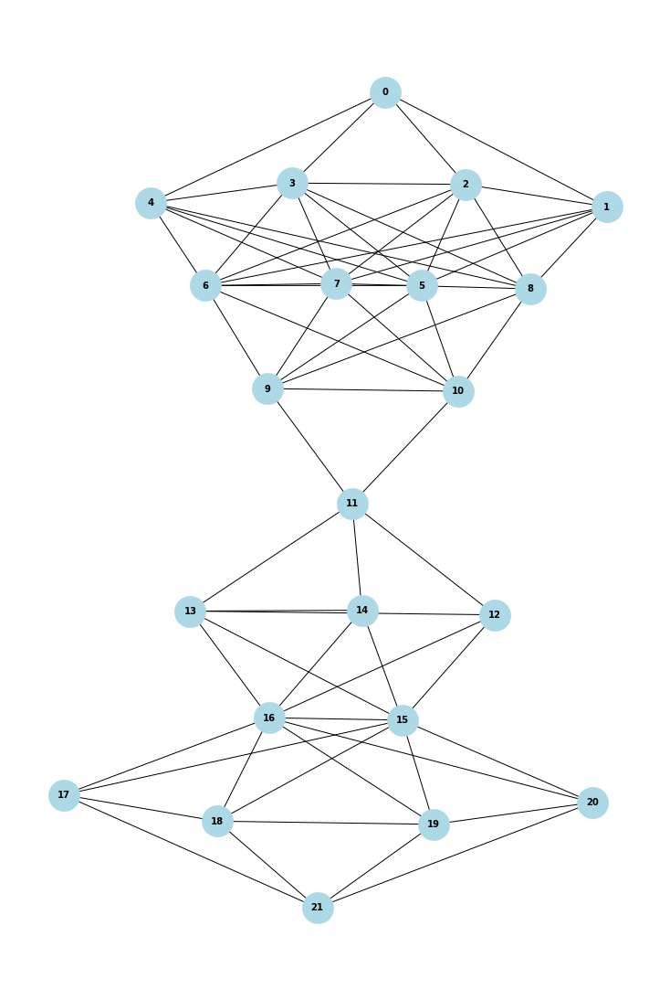

In [33]:
import networkx as nx
from torch_geometric.utils import to_networkx  # Conversion function
import matplotlib.pyplot as plt

plt.figure(figsize=(10,15))

G = to_networkx(vis, to_undirected=True)
pos = nx.kamada_kawai_layout(G)
nx.draw(G, pos, node_size=1200, \
    node_color='lightblue', linewidths=0.25, font_size=10, \
    font_weight='bold', with_labels=True)

plt.show()

In [34]:
vis.x

tensor([[-24.,   0., 200.,  76.,   1.,  28.,  24.,  15.,  14.,  14.,  15.,  36.,
          75.,  13.,  21.,  43.,  62.,  11.,  32.,  35.,  50.,  37.,  73.,  42.,
          47.,  36.,  72.,  11.,  56.,  14.,  15.,  13.,  12.,  22.,  14.,  83.,
          79.,  81.,  75.,  84.],
        [-18.,   9., 180.,  70.,   0.,  27.,  73.,  74.,  75.,  76.,  77.,  79.,
          74.,  59.,  75.,  65.,  71.,  76.,  72.,  68.,  66.,  75.,  74.,  69.,
          73.,  68.,  76.,  73.,  63.,  49.,  59.,  69.,  61.,  45.,  43.,  13.,
          13.,   6.,  14.,   8.],
        [-20.,   3., 185.,  81.,   1.,  28.,  68.,  61.,  81.,  79.,  82.,  85.,
          79.,  43.,  82.,  65.,  78.,  59.,  74.,  73.,  55.,  69.,  82.,  53.,
          63.,  55.,  82.,  82.,  63.,  40.,  38.,  54.,  53.,  52.,  40.,   9.,
          14.,   8.,  12.,   7.],
        [-20.,  -3., 188.,  82.,   1.,  30.,  58.,  53.,  71.,  71.,  72.,  75.,
          66.,  48.,  70.,  50.,  66.,  38.,  60.,  55.,  55.,  65.,  77.,  50.,
       

In [35]:
vis.y

tensor([0])

In [5]:
vis2 = torch.load('data/backup_unnormalized/data_0.pt')

vis2.x.shape

torch.Size([22, 40])

In [6]:
import torch

torch.tensor(vis.x).shape

torch.Size([22, 40])

In [7]:
vis.edge_index

tensor([[ 0,  1,  0,  2,  0,  3,  0,  4,  1,  2,  2,  3,  3,  4,  1,  5,  1,  6,
          2,  5,  2,  6,  3,  5,  3,  6,  4,  5,  4,  6,  5,  6,  5,  7,  5,  8,
          5,  9,  6,  7,  6,  8,  6,  9,  7,  8,  8,  9,  7, 10,  8, 10,  9, 10,
         10, 11, 11, 12, 11, 13, 12, 13, 12, 14, 12, 15, 12, 16, 12, 17, 13, 14,
         13, 15, 13, 16, 13, 17, 14, 15, 15, 16, 16, 17, 14, 18, 14, 19, 14, 20,
         15, 18, 15, 19, 15, 20, 16, 18, 16, 19, 16, 20, 17, 18, 17, 19, 17, 20,
         18, 19, 19, 20, 18, 21, 19, 21, 20, 21],
        [ 1,  0,  2,  0,  3,  0,  4,  0,  2,  1,  3,  2,  4,  3,  5,  1,  6,  1,
          5,  2,  6,  2,  5,  3,  6,  3,  5,  4,  6,  4,  6,  5,  7,  5,  8,  5,
          9,  5,  7,  6,  8,  6,  9,  6,  8,  7,  9,  8, 10,  7, 10,  8, 10,  9,
         11, 10, 12, 11, 13, 11, 13, 12, 14, 12, 15, 12, 16, 12, 17, 12, 14, 13,
         15, 13, 16, 13, 17, 13, 15, 14, 16, 15, 17, 16, 18, 14, 19, 14, 20, 14,
         18, 15, 19, 15, 20, 15, 18, 16, 19, 16, 20, 16, 18

In [16]:
vis2.edge_index

tensor([[ 0,  1,  0,  2,  0,  3,  0,  4,  1,  2,  2,  3,  3,  4,  1,  5,  1,  6,
          2,  5,  2,  6,  3,  5,  3,  6,  4,  5,  4,  6,  5,  6,  5,  7,  5,  8,
          5,  9,  6,  7,  6,  8,  6,  9,  7,  8,  8,  9,  7, 10,  8, 10,  9, 10,
         10, 11, 10, 12, 10, 13, 11, 12, 12, 13, 11, 14, 11, 15, 11, 16, 11, 17,
         12, 14, 12, 15, 12, 16, 12, 17, 13, 14, 13, 15, 13, 16, 13, 17, 14, 15,
         15, 16, 16, 17, 14, 18, 14, 19, 14, 20, 15, 18, 15, 19, 15, 20, 16, 18,
         16, 19, 16, 20, 17, 18, 17, 19, 17, 20, 18, 19, 19, 20, 18, 21, 19, 21,
         20, 21],
        [ 1,  0,  2,  0,  3,  0,  4,  0,  2,  1,  3,  2,  4,  3,  5,  1,  6,  1,
          5,  2,  6,  2,  5,  3,  6,  3,  5,  4,  6,  4,  6,  5,  7,  5,  8,  5,
          9,  5,  7,  6,  8,  6,  9,  6,  8,  7,  9,  8, 10,  7, 10,  8, 10,  9,
         11, 10, 12, 10, 13, 10, 12, 11, 13, 12, 14, 11, 15, 11, 16, 11, 17, 11,
         14, 12, 15, 12, 16, 12, 17, 12, 14, 13, 15, 13, 16, 13, 17, 13, 15, 14,
         1

In [14]:
vis.y

tensor([0])

In [17]:
vis2.y

tensor([0])